In [109]:
import os
import sys
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
import numpy as np
from nltk.tokenize import RegexpTokenizer
import heapq
import math
import copy
import re
from num2words import num2words
from collections import OrderedDict
import pandas as pd
from itertools import permutations

## Read all the files

In [110]:
path = r'/media/rohit/New Volume/codes/IR/20_newsgroups'
files = []
print(path)
for r, d, f in os.walk(path):
    for file in sorted(f):
        print(file.split('/')[-1])
        files.append(os.path.join(r, file))
print(len(files))

/media/rohit/New Volume/codes/IR/20_newsgroups
49960
51060
51119
51120
51121
51122
51123
51124
51125
51126
51127
51128
51129
51130
51131
51132
51133
51134
51135
51136
51137
51138
51139
51140
51141
51142
51143
51144
51145
51146
51147
51148
51149
51150
51151
51152
51153
51154
51155
51156
51157
51158
51159
51160
51161
51162
51163
51164
51165
51166
51167
51168
51169
51170
51171
51172
51173
51174
51175
51176
51177
51178
51179
51180
51181
51182
51183
51184
51185
51186
51187
51188
51189
51190
51191
51192
51193
51194
51195
51196
51197
51198
51199
51200
51201
51202
51203
51204
51205
51206
51207
51208
51209
51210
51211
51212
51213
51214
51215
51216
51217
51218
51219
51220
51221
51222
51223
51224
51225
51226
51227
51228
51229
51230
51231
51232
51233
51234
51235
51236
51237
51238
51239
51240
51241
51242
51243
51244
51245
51246
51247
51248
51249
51250
51251
51252
51253
51254
51255
51256
51257
51258
51259
51260
51261
51262
51264
51265
51266
51267
51268
51269
51270
51271
51272
51273
51274
51275
51276

50418
50419
50420
50421
50422
50423
50424
50425
50426
50427
50428
50430
50431
50432
50433
50434
50435
50436
50437
50439
50440
50441
50442
50443
50444
50445
50446
50447
50448
50449
50450
50451
50452
50453
50454
50455
50456
50457
50458
50459
50460
50461
50462
50463
50464
50465
50466
50467
50468
50469
50470
50471
50472
50473
50474
50475
50476
50477
50478
50479
50480
50482
50483
50484
50485
50486
50487
50488
50489
50490
50491
50492
50493
50494
50495
50496
50497
50498
50499
50500
50501
50502
50503
50504
50505
50506
50507
50508
50509
50510
50511
50512
50513
50514
50515
50516
50517
50518
50519
50520
50521
50522
50523
50524
50525
50526
50527
50528
50529
50530
50531
50532
50533
50534
50535
50536
50537
50538
50539
50540
50541
50542
50543
50544
50545
50546
50547
50548
50549
50550
50551
50552
51084
51492
51493
51494
51495
51496
51497
51498
51499
51500
51501
51502
51503
51504
51505
51506
51507
51508
51509
51510
51511
51512
51513
51514
51515
51516
51517
51518
51519
51520
51521
51522
51523
51524
5152

101551
101552
101553
101554
101555
101556
101557
101558
101559
101560
101561
101562
101563
101564
101565
101566
101567
101568
101569
101570
101571
101572
101573
101574
101575
101576
101577
101578
101579
101580
101581
101582
101583
101584
101585
101586
101587
101588
101589
101590
101591
101592
101593
101594
101595
101596
101597
101598
101599
101600
101601
101602
101603
101604
101605
101606
101607
101608
101609
101610
101611
101612
101613
101614
101615
101616
101617
101618
101619
101620
101621
101622
101623
101624
101625
101626
101627
101628
101629
101630
101631
101632
101633
101634
101635
101636
101637
101638
101639
101640
101641
101642
101643
101644
101645
101646
101647
101648
101650
101651
101652
101653
101654
101655
101656
101657
101658
101659
101660
101661
101662
101663
101664
101665
101666
101667
101668
101669
101670
101671
101672
101673
101674
101675
101676
101677
101678
101679
101680
101681
102717
102732
102733
102734
102735
102736
102737
102738
102739
102740
102741
102742
102743

104617
104618
104619
104620
104621
104622
104623
104624
104625
104626
104627
104628
104629
104630
104631
104632
104633
104634
104635
104636
104637
104638
104639
104640
104641
104642
104643
104644
104645
104646
104647
104648
104649
104650
104651
104652
104653
104654
104655
104656
104657
104658
104659
104660
104661
104662
104663
104664
104665
104666
104667
104668
104669
104670
104671
104672
104673
104674
104675
104676
104677
104678
104679
104680
104681
104682
104683
104684
104685
104686
104687
104688
104689
104690
104691
104692
104693
104694
104695
104696
104697
104698
104699
104700
104701
104702
104703
104704
104705
104706
104707
104708
104709
104710
104711
104712
104713
104714
104715
104716
104717
104718
104719
104720
104721
104723
104724
104725
104726
104727
104728
104729
104730
104731
104732
104733
104734
104735
104736
104737
104738
104739
104740
104741
104742
104743
104744
104745
104746
104747
104748
104749
104750
104751
104752
104753
104754
104755
104756
104757
104758
104759
104760

53581
53582
53583
53584
53585
53586
53587
53588
53589
53590
53591
53592
53593
53594
53595
53596
53597
53598
53599
53600
53601
53602
53603
53604
53605
53606
53607
53608
53609
53610
53611
53612
53613
53614
53615
53616
53617
53618
53619
53620
53621
53622
53623
53624
53625
53626
53627
53628
53629
53630
53631
53632
53633
53634
53635
53636
53637
53638
53639
53640
53641
53642
53643
53644
53645
53646
53647
53648
53649
53650
53651
53652
53653
53654
53655
53656
53657
53658
53659
53660
53661
53662
53663
53664
53665
53666
53667
53668
53669
53670
53671
53672
53673
53674
53675
53676
53677
53678
53679
53680
53681
53682
53683
53684
53685
53686
53687
53688
53689
53690
53691
53692
53693
53694
53695
53696
53697
53698
53699
53700
53701
53702
53703
53704
53705
53706
53707
53708
53709
53710
53711
53712
53713
53714
53715
53716
53717
53718
53719
53720
53721
53722
53723
53724
53725
53726
53727
53728
53729
53730
53731
53732
53733
53734
53735
53736
53737
53738
53739
53740
53741
53742
53743
53744
53745
53746
5374

60231
60232
60233
60234
60235
60236
60237
60238
60239
60240
60241
60242
60243
60244
60245
60246
60247
60248
60249
60250
60251
60252
60253
60770
60771
60772
60773
60774
60775
60777
60778
60779
60780
60781
60782
60783
60784
60785
60786
60787
60788
60789
60790
60791
60792
60793
60794
60795
60796
60797
60798
60799
60800
60801
60802
60803
60804
60806
60807
60808
60809
60810
60811
60812
60813
60814
60815
60816
60817
60818
60819
60820
60821
60822
60823
60824
60825
60826
60827
60828
60829
60830
60831
60832
60833
60834
60835
60836
60837
60838
60839
60840
60841
60842
60843
60844
60845
60846
60847
60848
60849
60850
60851
60852
60853
60854
60855
60856
60857
60858
60859
60860
60861
60862
60863
60864
60865
60866
60867
60868
60869
60870
60871
60872
60873
60874
60875
60876
60877
60878
60879
60880
60881
60882
60883
60884
60885
60886
60887
60888
60889
60890
60891
60892
60893
60894
60895
60896
60897
60898
60899
60900
60901
60902
60903
60904
60905
60906
60907
60908
60909
60910
60911
60912
60913
60914
6091

55069
55070
55071
55072
55073
55074
55075
55076
55077
55078
55079
55080
55081
55082
55083
55084
55085
55086
55087
55088
55089
55090
55091
55092
55093
55094
55095
55096
55097
55098
55099
55100
55101
55102
55103
55104
55105
55106
55107
55108
55109
55110
55111
55112
55113
55114
55115
55116
55117
55118
55119
55120
55121
55122
55123
55124
55125
55126
55231
55232
55233
55234
55235
55236
55238
55239
55240
55241
55246
55247
55248
55249
55250
55251
55252
55253
55254
55255
55256
55257
55258
55259
55260
55261
55262
55263
55264
55265
55266
55267
55268
55269
55270
55271
55272
55273
55274
55275
55276
55277
55278
55279
55280
55425
55426
55467
55468
55469
55470
55471
55472
55473
55474
55475
55476
55482
55483
55484
55485
55486
55487
55488
55489
55490
75364
75365
75366
75367
75369
75370
75371
75372
75373
75374
75375
75376
75377
75378
75379
75381
75382
75383
75384
75385
75386
75387
75388
75389
75390
75391
75392
75393
75394
75395
75396
75397
75398
75399
75400
75401
75402
75403
75404
75405
75406
75407
7540

84189
84190
84191
84192
84193
84194
84195
84196
84197
84198
84199
84200
84201
84202
84203
84204
84205
84206
84207
84208
84209
84210
84211
84212
84213
84214
84215
84216
84217
84218
84219
84220
84221
84222
84223
84224
84225
84226
84227
84228
84229
84230
84231
84232
84233
84234
84235
84236
84237
84238
84239
84240
84241
84242
84243
84244
84245
84246
84247
84248
84249
84250
84251
84252
84253
84254
84255
84256
84257
84258
84259
84260
84261
84262
84263
84264
84265
84266
84267
84268
84269
84270
84271
84272
84273
84274
84275
84276
84277
84278
84279
84280
84281
84282
84283
84284
84285
84286
84287
84288
84289
84290
84291
84292
84293
84294
84295
84296
84297
84298
84299
84300
84301
84302
84303
84304
84305
84306
84307
84308
84309
84310
84311
84312
84313
84314
84315
84316
84317
84318
84319
84320
84321
84322
84323
84324
84325
84326
84327
84328
84329
84330
84331
84332
84333
84334
84335
84336
84337
84338
84339
84340
84341
84342
84343
84344
84345
84346
84347
84348
84349
84350
84351
84352
84353
84354
8435

In [111]:
def process_query(query):
    punctuations = '''!()-[]{};:"\,<>./?@#$=+%^&*_~'''
    table = str.maketrans({key:" " for key in punctuations})
    query = query.translate(table)
    table = str.maketrans({key:None for key in "'"})
    query = query.translate(table)
    query = query.lower()
    st = PorterStemmer()
    stemm_list = []
    stop = stopwords.words('english')
    tokenizer = RegexpTokenizer(r'\w+')
    query_list = tokenizer.tokenize(query)
    for j in query_list:
        if j.isnumeric():
            j = num2words(j)
        elif j in stop:
            j = ''
        stemm_list.append(st.stem(j))
    return stemm_list

## Process query function

In [112]:
data_dict = {}
data = []
count = 0
for f in files:
#     print(f)
#     sys.exit()
    if '.htm' in f:
        continue
    else:
        filehandle = open(f,errors='ignore')
        # read a single line
        file = (filehandle.read().replace('\n',' '))
        data_dict[f.split('/')[-1]] = set(process_query(file))
        count = count + 1
        print(count)
# close the pointer to that file
filehandle.close()

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062


3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705


5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340
5341
5342
5343
5344
5345
5346


6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978
6979
6980
6981
6982
6983
6984
6985
6986
6987
6988


8428
8429
8430
8431
8432
8433
8434
8435
8436
8437
8438
8439
8440
8441
8442
8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616
8617
8618
8619
8620
8621
8622
8623
8624
8625
8626
8627


10063
10064
10065
10066
10067
10068
10069
10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
10213
10214
10215
10216
10217
10218
10219
10220
10221
10222
10223
10224
10225
10226
10227
10228
1022

11429
11430
11431
11432
11433
11434
11435
11436
11437
11438
11439
11440
11441
11442
11443
11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
11579
11580
11581
11582
11583
11584
11585
11586
11587
11588
11589
11590
11591
11592
11593
11594
1159

12800
12801
12802
12803
12804
12805
12806
12807
12808
12809
12810
12811
12812
12813
12814
12815
12816
12817
12818
12819
12820
12821
12822
12823
12824
12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
12934
12935
12936
12937
12938
12939
12940
12941
12942
12943
12944
12945
12946
12947
12948
12949
12950
12951
12952
12953
12954
12955
12956
12957
12958
12959
12960
12961
12962
12963
12964
12965
1296

14176
14177
14178
14179
14180
14181
14182
14183
14184
14185
14186
14187
14188
14189
14190
14191
14192
14193
14194
14195
14196
14197
14198
14199
14200
14201
14202
14203
14204
14205
14206
14207
14208
14209
14210
14211
14212
14213
14214
14215
14216
14217
14218
14219
14220
14221
14222
14223
14224
14225
14226
14227
14228
14229
14230
14231
14232
14233
14234
14235
14236
14237
14238
14239
14240
14241
14242
14243
14244
14245
14246
14247
14248
14249
14250
14251
14252
14253
14254
14255
14256
14257
14258
14259
14260
14261
14262
14263
14264
14265
14266
14267
14268
14269
14270
14271
14272
14273
14274
14275
14276
14277
14278
14279
14280
14281
14282
14283
14284
14285
14286
14287
14288
14289
14290
14291
14292
14293
14294
14295
14296
14297
14298
14299
14300
14301
14302
14303
14304
14305
14306
14307
14308
14309
14310
14311
14312
14313
14314
14315
14316
14317
14318
14319
14320
14321
14322
14323
14324
14325
14326
14327
14328
14329
14330
14331
14332
14333
14334
14335
14336
14337
14338
14339
14340
14341
1434

15548
15549
15550
15551
15552
15553
15554
15555
15556
15557
15558
15559
15560
15561
15562
15563
15564
15565
15566
15567
15568
15569
15570
15571
15572
15573
15574
15575
15576
15577
15578
15579
15580
15581
15582
15583
15584
15585
15586
15587
15588
15589
15590
15591
15592
15593
15594
15595
15596
15597
15598
15599
15600
15601
15602
15603
15604
15605
15606
15607
15608
15609
15610
15611
15612
15613
15614
15615
15616
15617
15618
15619
15620
15621
15622
15623
15624
15625
15626
15627
15628
15629
15630
15631
15632
15633
15634
15635
15636
15637
15638
15639
15640
15641
15642
15643
15644
15645
15646
15647
15648
15649
15650
15651
15652
15653
15654
15655
15656
15657
15658
15659
15660
15661
15662
15663
15664
15665
15666
15667
15668
15669
15670
15671
15672
15673
15674
15675
15676
15677
15678
15679
15680
15681
15682
15683
15684
15685
15686
15687
15688
15689
15690
15691
15692
15693
15694
15695
15696
15697
15698
15699
15700
15701
15702
15703
15704
15705
15706
15707
15708
15709
15710
15711
15712
15713
1571

16915
16916
16917
16918
16919
16920
16921
16922
16923
16924
16925
16926
16927
16928
16929
16930
16931
16932
16933
16934
16935
16936
16937
16938
16939
16940
16941
16942
16943
16944
16945
16946
16947
16948
16949
16950
16951
16952
16953
16954
16955
16956
16957
16958
16959
16960
16961
16962
16963
16964
16965
16966
16967
16968
16969
16970
16971
16972
16973
16974
16975
16976
16977
16978
16979
16980
16981
16982
16983
16984
16985
16986
16987
16988
16989
16990
16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17023
17024
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
17043
17044
17045
17046
17047
17048
17049
17050
17051
17052
17053
17054
17055
17056
17057
17058
17059
17060
17061
17062
17063
17064
17065
17066
17067
17068
17069
17070
17071
17072
17073
17074
17075
17076
17077
17078
17079
17080
1708

18283
18284
18285
18286
18287
18288
18289
18290
18291
18292
18293
18294
18295
18296
18297
18298
18299
18300
18301
18302
18303
18304
18305
18306
18307
18308
18309
18310
18311
18312
18313
18314
18315
18316
18317
18318
18319
18320
18321
18322
18323
18324
18325
18326
18327
18328
18329
18330
18331
18332
18333
18334
18335
18336
18337
18338
18339
18340
18341
18342
18343
18344
18345
18346
18347
18348
18349
18350
18351
18352
18353
18354
18355
18356
18357
18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18386
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
18409
18410
18411
18412
18413
18414
18415
18416
18417
18418
18419
18420
18421
18422
18423
18424
18425
18426
18427
18428
18429
18430
18431
18432
18433
18434
18435
18436
18437
18438
18439
18440
18441
18442
18443
18444
18445
18446
18447
18448
1844

19651
19652
19653
19654
19655
19656
19657
19658
19659
19660
19661
19662
19663
19664
19665
19666
19667
19668
19669
19670
19671
19672
19673
19674
19675
19676
19677
19678
19679
19680
19681
19682
19683
19684
19685
19686
19687
19688
19689
19690
19691
19692
19693
19694
19695
19696
19697
19698
19699
19700
19701
19702
19703
19704
19705
19706
19707
19708
19709
19710
19711
19712
19713
19714
19715
19716
19717
19718
19719
19720
19721
19722
19723
19724
19725
19726
19727
19728
19729
19730
19731
19732
19733
19734
19735
19736
19737
19738
19739
19740
19741
19742
19743
19744
19745
19746
19747
19748
19749
19750
19751
19752
19753
19754
19755
19756
19757
19758
19759
19760
19761
19762
19763
19764
19765
19766
19767
19768
19769
19770
19771
19772
19773
19774
19775
19776
19777
19778
19779
19780
19781
19782
19783
19784
19785
19786
19787
19788
19789
19790
19791
19792
19793
19794
19795
19796
19797
19798
19799
19800
19801
19802
19803
19804
19805
19806
19807
19808
19809
19810
19811
19812
19813
19814
19815
19816
1981

## Term count and document query Dictionary

In [113]:
term_count_dict = {}
term_doc_freq = {}
count = 0
for f in files:
    if '.htm' in f:
        continue
    else:
        filehandle = open(f,errors='ignore')
            # read a single line
        file = (filehandle.read().replace('\n',' '))
        docid = f.split('/')[-1]
        file = process_query(file)
        length = len(file)
        for term in file:
            if term not in term_count_dict.keys():
                term_count_dict[term] =  {}
            if docid not in term_count_dict[term].keys(): 
                term_count_dict[term][docid] = [1, length] 
            elif docid in term_count_dict[term].keys():
                term_count_dict[term][docid][0] = term_count_dict[term][docid][0] + 1
        for term in set(file):
            if term not in term_doc_freq.keys():
                term_doc_freq[term] = 1
            elif term in term_doc_freq.keys():
                term_doc_freq[term] = term_doc_freq[term] + 1
            

## Normalized Term Frequency

In [114]:
term_freq_dict = copy.deepcopy(term_count_dict)
for i in term_freq_dict.keys():
    for j in term_freq_dict[i].keys():
        term_freq_dict[i][j] = term_freq_dict[i][j][0]/term_freq_dict[i][j][1]

## Sorted term frequency dictionary

In [115]:
sorted_term_freq_dict = {}
for i in term_freq_dict.keys():
    sorted_term_freq_dict[i] = OrderedDict(sorted(term_freq_dict[i].items(), key=lambda x: x[1],reverse =True))

## High and low dictionary divided based on mean value

In [150]:
high_dict_mean = {}
low_dict_mean = {}
for i in sorted_term_freq_dict.keys():
    mean = np.array([val for val in sorted_term_freq_dict[i].values()]).mean()
    high_dict_mean[i] = {key:val for key, val in sorted_term_freq_dict[i].items() if val >= mean}
    print(i," ",len(high_dict_mean[i].keys()))
    low_dict_mean[i] = {key:val for key, val in sorted_term_freq_dict[i].items() if val < mean }
    print(i," ",len(low_dict_mean[i].keys()))

xref   2496
xref   3333
cantaloup   6311
cantaloup   10019
srv   6116
srv   10214
cs   5627
cs   10703
cmu   6039
cmu   10291
edu   6300
edu   10030
alt   1166
alt   2126
atheism   575
atheism   781
forty-nine thousand, nine hundred and sixti   1
forty-nine thousand, nine hundred and sixti   0
moder   81
moder   119
seven hundred and thirteen   44
seven hundred and thirteen   80
news   4933
news   9060
answer   526
answer   847
seven thousand and fifty-four   1
seven thousand and fifty-four   1
one hundred and twenty-six   21
one hundred and twenty-six   35
path   6152
path   10178
crabappl   2352
crabappl   3431
bb3   1022
bb3   1337
andrew   804
andrew   2175
sei   2228
sei   3396
ci   1829
ci   3046
ohio   2863
ohio   5077
state   3193
state   5887
magnu   163
magnu   508
ac   820
ac   1477
usenet   1951
usenet   3402
in   405
in   869
cwru   401
cwru   924
agat   570
agat   962
spool   247
spool   327
mu   228
mu   391
uunet   1937
uunet   2759
pipex   315
pipex   436
ibmpcug   31


make   1705
make   2843
young   186
young   340
woman   100
woman   158
pregnant   25
pregnant   25
return   303
return   449
anoth   887
anoth   1267
star   123
star   248
system   1552
system   2764
unfortun   243
unfortun   321
termin   122
termin   237
ill   549
ill   783
must   715
must   1242
assist   123
assist   189
man   480
man   853
whose   192
whose   276
wire   77
wire   172
twenty-four   870
twenty-four   1548
hour   222
hour   353
easi   306
easi   416
listen   187
listen   263
margaret   5
margaret   9
atwood   2
atwood   2
handmaid   1
handmaid   1
tale   28
tale   40
premis   47
premis   60
congress   114
congress   161
assassin   21
assassin   44
fundamentalist   21
fundamentalist   62
quickli   111
quickli   170
take   1179
take   1934
charg   187
charg   342
right   1158
right   2120
diari   9
diari   15
life   544
life   854
theocraci   1
theocraci   2
properti   129
properti   171
revok   12
revok   19
bank   128
bank   248
account   403
account   518
close   441

introduct   69
pleas   1231
pleas   1747
nineteen trillion, nine hundred and thirty billion, four hundred and five million, one hundred and twenty-two thousand, two hundred and forty-f   1
nineteen trillion, nine hundred and thirty billion, four hundred and five million, one hundred and twenty-two thousand, two hundred and forty-f   1
twelv   1185
twelv   1689
twenty-two   1439
twenty-two   2298
forty-f   449
forty-f   633
six   1562
six   2707
nineteen trillion, nine hundred and thirty billion, three hundred and eight million, one hundred and thirty-four thousand, four hundred and thirty-nin   1
nineteen trillion, nine hundred and thirty billion, three hundred and eight million, one hundred and thirty-four thousand, four hundred and thirty-nin   0
six hundred and forty-six   4
six hundred and forty-six   10
april   228
april   438
two   2147
two   5323
pgp   95
pgp   187
sign   214
sign   315
provid   516
provid   758
gener   786
gener   1338
whilst   7
whilst   10
neutral   37
neutra

happi   339
prayer   36
prayer   95
school   325
school   534
care   560
care   788
pray   70
pray   140
voter   15
voter   30
lawmak   6
lawmak   8
ignor   270
ignor   448
intimid   25
intimid   27
told   378
told   515
join   126
join   175
divers   27
divers   49
formul   26
formul   38
public   596
public   977
famili   193
famili   296
wast   159
wast   239
motiv   88
motiv   160
arent   283
arent   384
chariti   23
chariti   27
hospit   96
hospit   143
purpos   298
purpos   409
contribut   114
contribut   175
sake   60
sake   90
good   1427
good   2443
voluntari   25
voluntari   34
theistic   23
theistic   18
shout   45
shout   48
connect   316
connect   463
obviou   193
obviou   231
everyday   24
everyday   29
cheap   189
cheap   306
righteou   31
righteou   59
excus   125
excus   174
plug   106
plug   183
build   374
build   578
strang   114
strang   153
hold   374
hold   519
parti   152
parti   292
birthday   8
birthday   28
rare   117
rare   143
evangel   24
evangel   27
back

codifi   6
codifi   7
matthew   104
matthew   214
knowledg   230
knowledg   372
sourc   408
sourc   806
knew   168
knew   246
tradit   136
tradit   226
attribut   85
attribut   128
elder   10
elder   16
span   38
span   40
lifetim   33
lifetim   50
text   223
text   431
age   162
age   280
overwhelm   36
overwhelm   48
admittedli   25
admittedli   33
earlier   172
earlier   225
manuscript   13
manuscript   24
discov   138
discov   176
interest   952
interest   1377
got   858
got   1215
info   454
info   667
70   37
70   48
earli   267
earli   406
80   23
80   39
ce   31
ce   58
two hundr   202
two hundr   315
shed   43
shed   50
rest   357
rest   457
exactli   346
exactli   474
felder   4
felder   5
paul   271
paul   510
genuin   36
genuin   51
wouldnt   420
wouldnt   547
togeth   235
togeth   330
fine   350
fine   478
what   303
what   411
miss   281
miss   393
step   183
step   287
remov   251
remov   354
bad   522
bad   803
learn   303
learn   428
dicipl   1
dicipl   2
transform   4

two hundred and five thousand, nine hundred and nineteen   1
two hundred and five thousand, nine hundred and nineteen   1
twenty-six thousand, three hundred and nineti   2
twenty-six thousand, three hundred and nineti   1
1pcnp3innpom   1
1pcnp3innpom   1
1pdjip   1
1pdjip   1
jsi   3
jsi   2
stay   221
stay   289
where   20
where   26
cutoff   5
cutoff   11
exact   117
exact   160
notion   75
notion   126
makeup   4
makeup   5
portion   67
portion   100
ago   504
ago   633
stealth   38
stealth   61
poster   269
poster   344
1pia4einnqjg   1
1pia4einnqjg   0
ten   1382
ten   2143
thirty-eight   446
thirty-eight   735
mam   8
mam   10
03kh   1
03kh   2
mous   96
mous   182
cmhnet   17
cmhnet   18
1p6s0cinnhg6   1
1p6s0cinnhg6   1
1993mar29   20
1993mar29   31
one hundred and ninety-five thousand, nine hundred and fifty-eight   1
one hundred and ninety-five thousand, nine hundred and fifty-eight   0
thirteen thousand, nine hundred and fifteen   1
thirteen thousand, nine hundred and fifte

beauti   76
beauti   109
newsserv   245
newsserv   394
jvnc   194
jvnc   294
louie   37
louie   46
udel   1051
udel   2276
bnrgate   92
bnrgate   110
bmers30   5
bmers30   9
dgraham   5
dgraham   9
two hundred and eleven thousand, nine hundred and twenty-four   1
two hundred and eleven thousand, nine hundred and twenty-four   0
eighteen thousand, four hundred and fifty-nin   5
eighteen thousand, four hundred and fifty-nin   4
dougla   83
dougla   131
graham   64
graham   85
1993apr1   32
1993apr1   63
one hundred and ninety thousand, two hundred and thirti   1
one hundred and ninety thousand, two hundred and thirti   0
eighteen thousand, four hundred and eighty-f   1
eighteen thousand, four hundred and eighty-f   0
proxima   3
proxima   8
za   45
za   78
ufjelcg00vp3e7i6vo   1
ufjelcg00vp3e7i6vo   0
one hundred and seventy-two thousand, nine hundred and thre   1
one hundred and seventy-two thousand, nine hundred and thre   2
4w6   2
4w6   2
bell   124
bell   241
northern   75
northern 

bgsu   24
bgsu   46
twenty-four thousand, one hundred and fifti   1
twenty-four thousand, one hundred and fifti   1
ten thousand, one hundred and ninety-thre   1
ten thousand, one hundred and ninety-thre   0
wam   38
wam   84
po2   15
po2   22
west   157
west   310
next02cvil   3
next02cvil   5
stilgar   3
stilgar   4
crichton   1
crichton   1
jurras   1
jurras   0
park   177
park   276
billion   82
billion   144
blink   14
blink   30
eye   150
eye   318
gone   166
gone   228
tomorrow   66
tomorrow   75
humbl   23
humbl   40
master   99
master   201
cool   84
cool   188
happili   26
happili   29
jump   87
jump   154
brian   171
brian   347
sig   96
sig   151
jurass   1
jurass   1
diclaim   1
diclaim   1
uwm   637
uwm   1046
daffi   19
daffi   34
snake2   9
snake2   17
wisc   197
wisc   459
mccullou   13
mccullou   20
mccullough   14
mccullough   17
two hundred and three thousand, four hundred and twenty-eight   1
two hundred and three thousand, four hundred and twenty-eight   1
twenty 

two billion, nine hundred and forty-two million, thirty-five thousand, five hundred and eighty-nin   1
two billion, nine hundred and forty-two million, thirty-five thousand, five hundred and eighty-nin   0
1993mar26   14
1993mar26   18
eighty-five thousand, one hundred and f   1
eighty-five thousand, one hundred and f   0
ten thousand and ninety-six   1
ten thousand and ninety-six   4
cadenc   5
cadenc   11
c4qav2   1
c4qav2   1
24wg   1
24wg   1
one hundred and three thousand, two hundred and thirty-seven   1
one hundred and three thousand, two hundred and thirty-seven   1
four thousand, six hundred and twenty-seven   1
four thousand, six hundred and twenty-seven   2
workstat   81
workstat   116
ma   7
ma   17
masud   3
masud   6
khan   23
khan   29
offici   234
offici   323
conveni   67
conveni   117
move   412
move   629
lover   15
lover   32
scrupl   2
scrupl   1
contract   85
contract   104
loophol   4
loophol   6
complain   99
complain   133
alert   25
alert   31
imam   5
imam   

glean   17
sidetrack   2
sidetrack   2
intim   7
intim   13
fellowship   11
fellowship   17
dominion   7
dominion   13
longer   280
longer   405
feat   9
feat   10
degener   11
degener   15
offset   20
offset   30
evolutionari   10
evolutionari   14
biologist   14
biologist   11
adapt   83
adapt   147
envion   1
envion   0
accumul   18
accumul   22
bacteria   15
bacteria   22
virus   9
virus   17
effici   59
effici   112
infect   41
infect   73
umm   6
umm   11
nah   13
nah   13
percentag   99
percentag   137
microlif   1
microlif   0
reasonalbi   1
reasonalbi   0
constant   64
constant   89
size   245
size   391
rank   48
rank   63
bubon   1
bubon   0
plagu   28
plagu   38
nasti   51
nasti   57
pop   72
pop   132
damag   133
damag   202
sanit   3
sanit   2
symptom   55
symptom   75
partli   31
partli   31
suscept   15
suscept   13
variant   18
variant   23
overgraz   1
overgraz   0
gather   76
gather   103
acn   98
acn   205
nastier   1
nastier   0
newborn   4
newborn   6
inbuilt   1


easter   43
bunni   9
bunni   8
simplest   14
simplest   21
midelfort   12
midelfort   11
clinic   58
clinic   86
frighten   30
frighten   41
bertrand   13
bertrand   15
russel   62
russel   81
gatekeep   28
gatekeep   29
oracl   48
oracl   89
1pm6gpinnm4v   1
1pm6gpinnm4v   0
1pa7aeinnsa9   1
1pa7aeinnsa9   0
03o7   1
03o7   0
mike   295
mike   599
mcangu   3
mcangu   5
exempt   20
exempt   41
beef   14
beef   22
lobbi   47
lobbi   63
tulan   19
tulan   44
1pm6miinnm52   1
1pm6miinnm52   0
1pa0f4innpit   1
1pa0f4innpit   1
03od   1
03od   0
immers   3
immers   6
threaten   76
threaten   125
tool   139
tool   273
misus   20
misus   25
1pm6u0innm5o   1
1pm6u0innm5o   0
ninety thousand, nine hundred and f   1
ninety thousand, nine hundred and f   0
thirteen thousand, seven hundred and forty-two   2
thirteen thousand, seven hundred and forty-two   1
nuscc   17
nuscc   21
nu   29
nu   50
sg   49
sg   95
cmtan   3
cmtan   6
iss   5
iss   12
tan   11
tan   29
chade   4
chade   5
meng   5
men

frozen   15
frozen   27
bodi   255
bodi   469
idolat   1
idolat   7
fu   75
fu   119
16ba8d6cc   1
16ba8d6cc   0
ontolog   4
ontolog   9
tut   16
tut   33
lehtori   6
lehtori   10
a137490   3
a137490   3
aario   3
aario   3
sami   4
sami   5
three hundr   174
three hundr   236
tamper   19
tamper   28
centr   90
centr   136
sfnet   3
sfnet   3
1ps177   1
1ps177   0
b5b   3
b5b   1
thirteen thousand and thirty-four   1
thirteen thousand and thirty-four   1
twenty-seven thousand and seventi   1
twenty-seven thousand and seventi   0
poverti   17
poverti   30
low   282
low   491
distrust   9
distrust   8
explod   25
explod   43
sunlight   17
sunlight   17
compris   27
compris   29
stupid   215
stupid   320
ero   5
ero   6
outer   22
outer   41
eighty-two thousand, eight hundred and nin   2
eighty-two thousand, eight hundred and nin   0
fifty-one thousand, two hundred and sixty-four   2
fifty-one thousand, two hundred and sixty-four   0
twenty-nine thousand, one hundred and eight   2
twenty-

herm   38
herm   52
chpc   18
chpc   40
utdalla   18
utdalla   51
corpgat   18
corpgat   20
crchh327   8
crchh327   10
crchh410   5
crchh410   5
bcash   5
bcash   5
nosubdomain   22
nosubdomain   26
nodomain   19
nodomain   30
cash   49
cash   93
c50x67   1
c50x67   0
c4twso   1
c4twso   0
8m2   1
8m2   0
hq   56
hq   89
ileaf   4
ileaf   10
mukesh   1
mukesh   0
prasad   2
prasad   2
strat   1
strat   1
steve   320
steve   508
trick   88
trick   110
contradictari   1
contradictari   0
glorifi   10
glorifi   15
therebi   25
therebi   34
whi   2
whi   4
wherefor   3
wherefor   4
highest   75
highest   107
exalt   4
exalt   6
bow   22
bow   28
devot   45
devot   73
snake   15
snake   21
kick   79
kick   124
fruit   25
fruit   44
c50yfe   1
c50yfe   0
bnb   1
bnb   1
declin   36
declin   54
emot   66
emot   115
bond   43
bond   86
16ba8f98a   1
16ba8f98a   0
qm   19
qm   26
hassl   28
hassl   24
flourish   10
flourish   12
falsifi   21
falsifi   29
bogu   605
bogu   751
acheiv   5
acheiv 

one thousand, eight hundred and thirteen   5
one thousand, eight hundred and thirteen   6
benjamin   26
benjamin   30
franklin   27
franklin   42
nov   24
nov   43
one thousand, seven hundred and twenty-eight   2
one thousand, seven hundred and twenty-eight   3
washington   232
washington   655
xi   6
xi   18
one thousand, seven hundred and ninety-seven   4
one thousand, seven hundred and ninety-seven   5
treati   19
treati   38
tripoli   5
tripoli   9
stat   86
stat   187
three hundred and fifty-eight   44
three hundred and fifty-eight   41
enmiti   3
enmiti   6
tranquil   10
tranquil   17
musselmen   1
musselmen   0
mehomitan   1
mehomitan   0
pretext   5
pretext   10
aris   44
aris   64
charl   135
charl   212
agreement   81
agreement   120
one thousand, seven hundred and seventy-six   7
one thousand, seven hundred and seventy-six   9
one thousand, nine hundred and forty-nin   10
one thousand, nine hundred and forty-nin   15
vol   36
vol   61
one thousand and seventi   3
one thousan

one hundred and ninety-two thousand, one hundred and eighteen   1
one hundred and ninety-two thousand, one hundred and eighteen   0
twenty-seven thousand, nine hundred and ten   1
twenty-seven thousand, nine hundred and ten   0
bissel   8
bissel   14
twentieth   6
twentieth   7
bissda   9
bissda   20
seven hundred and thirty-four million, eight hundred and forty-nine thousand, six hundred and seventy-eight   9
seven hundred and thirty-four million, eight hundred and forty-nine thousand, six hundred and seventy-eight   15
niether   4
niether   8
lunat   20
lunat   28
crazi   70
crazi   104
encyclopedia   14
encyclopedia   22
enamour   1
enamour   2
moorcockpratchettdenislearydelasoulu2iainmbanksneworderheathersbatmanpjorourk   2
moorcockpratchettdenislearydelasoulu2iainmbanksneworderheathersbatmanpjorourk   3
clive   6
clive   6
foreskin   4
foreskin   8
triniti   27
triniti   40
dublin   11
dublin   12
brush   20
brush   22
geoffm   3
geoffm   3
brownbladerunnersugarcubeselectronicblay

quarrel   9
broke   60
broke   79
kitchen   20
kitchen   24
slain   6
slain   11
quebec   40
quebec   73
domest   28
domest   68
ommit   3
ommit   2
maximu   7
maximu   9
01wb   6
01wb   8
kmagnacca   5
kmagnacca   3
one hundred and ninety-one thousand and forty-eight   1
one hundred and ninety-one thousand and forty-eight   2
thirty thousand, three hundred and thirty-four   1
thirty thousand, three hundred and thirty-four   0
eight thousand, six hundred and fifti   1
eight thousand, six hundred and fifti   0
1993apr11   18
1993apr11   24
one hundred and forty-five thousand, five hundred and nineteen   1
one hundred and forty-five thousand, five hundred and nineteen   0
silenc   38
silenc   71
actaulli   1
actaulli   1
lastli   16
lastli   15
touch   103
touch   145
lifelong   6
lifelong   8
ambit   11
ambit   13
floyd   9
floyd   11
fifty-three thousand, one hundred and fifteen   2
fifty-three thousand, one hundred and fifteen   0
eighty-three thousand, five hundred and seventy-thre  

0fnuq5i00vp3aeeupz   1
0fnuq5i00vp3aeeupz   0
1qjb9q   1
1qjb9q   0
bc9   1
bc9   0
one thousand, five hundred and eighty-two   1
one thousand, five hundred and eighty-two   2
seven hundred and thirty-four million, eight hundred and eighty-two thousand, three hundred and ninety-four   1
seven hundred and thirty-four million, eight hundred and eighty-two thousand, three hundred and ninety-four   0
coward   17
coward   25
sec108   1
sec108   0
205312sec108   1
205312sec108   0
thumper   5
thumper   9
duller   1
duller   0
delud   9
delud   12
athiest   16
athiest   23
tidbit   10
tidbit   9
plausabl   2
plausabl   2
boot   75
boot   151
rome   22
rome   36
streetcorn   1
streetcorn   0
robot   36
robot   71
clayton   64
clayton   92
forest   29
forest   28
1ql1avinn38a   1
1ql1avinn38a   1
1q8p05innka   1
1q8p05innka   0
one hundred and forty-five thousand, four hundred and eight   1
one hundred and forty-five thousand, four hundred and eight   0
twenty-nine thousand, seven hundred and n

pal   16
pal   29
lend   18
lend   25
havnt   2
havnt   5
quantifi   10
quantifi   13
specialis   2
specialis   3
theyll   102
theyll   105
reinvent   4
reinvent   7
riiiight   1
riiiight   0
sugar   25
sugar   48
1qli2g   1
1qli2g   0
bahaviour   1
bahaviour   0
preciou   19
preciou   25
fifty-three thousand, two hundred and twenty-seven   2
fifty-three thousand, two hundred and twenty-seven   0
eighty-three thousand, six hundred and twenty-six   2
eighty-three thousand, six hundred and twenty-six   0
forty thousand, nine hundred and twelv   2
forty thousand, nine hundred and twelv   0
eleven thousand, eight hundred and twenty-seven   2
eleven thousand, eight hundred and twenty-seven   0
shoddi   5
shoddi   8
workmanship   6
workmanship   5
calvari   2
calvari   2
eleven thousand, eight hundred and twenty-eight   1
eleven thousand, eight hundred and twenty-eight   1
smell   30
smell   37
eleven thousand, eight hundred and twenty-nin   1
eleven thousand, eight hundred and twenty-nin   

seven hundred and thirty-five million, two hundred and sixty-seven thousand, five hundred and sixty-f   1
1qvn1pinnj90   1
1qvn1pinnj90   0
shoulder   34
shoulder   68
teas   4
teas   4
artist   33
artist   35
newbi   14
newbi   25
lifespan   2
lifespan   6
occass   9
occass   6
caustic   1
caustic   3
boob   2
boob   1
breath   47
breath   82
excretori   1
excretori   0
eleven thousand, eight hundred and sixty-four   3
eleven thousand, eight hundred and sixty-four   1
daft   1
daft   4
testicl   1
testicl   1
goddamn   14
goddamn   14
necrophiliac   1
necrophiliac   0
assess   36
assess   55
quip   4
quip   8
sleev   4
sleev   27
meager   2
meager   4
jimmi   44
jimmi   65
dispel   4
dispel   4
bummin   1
bummin   0
delusion   3
delusion   7
bye   24
bye   27
slim   6
slim   8
flintston   2
flintston   2
chewabl   1
chewabl   1
uchdcc   3
uchdcc   2
enkidu   2
enkidu   3
agrino   2
agrino   2
mic   9
mic   24
cl   59
cl   138
andr   42
andr   56
grino   2
grino   2
brandt   12
brandt 

1993apr08   3
1993apr08   3
one hundred and seventy-four thousand, nine hundred and forty-two   1
one hundred and seventy-four thousand, nine hundred and forty-two   0
forty-five thousand, one hundred and twenty-four   1
forty-five thousand, one hundred and twenty-four   0
fell   52
fell   74
bucket   6
bucket   7
rabbi   7
rabbi   14
schism   4
schism   11
influenti   8
influenti   14
stabil   17
stabil   26
savag   7
savag   31
strongest   16
strongest   17
tent   25
tent   30
idolatri   3
idolatri   8
barbar   18
barbar   27
rend   1
rend   1
dehuman   2
dehuman   3
dwell   10
dwell   20
hammurabi   1
hammurabi   1
retribut   5
retribut   9
mose   23
mose   43
parochi   3
parochi   4
musician   12
musician   11
humanitarian   16
humanitarian   33
significantli   63
significantli   78
belittl   4
belittl   7
closest   24
closest   48
romani   1
romani   1
one thousand, nine hundred and forty-thre   8
one thousand, nine hundred and forty-thre   9
captain   19
captain   61
comic   29
c

bid   27
one hundred and twenty thousand, seven hundred and seventy-two   2
one hundred and twenty thousand, seven hundred and seventy-two   0
fifty-three thousand, three hundred and seventy-nin   2
fifty-three thousand, three hundred and seventy-nin   0
eighty-three thousand, seven hundred and eighty-f   2
eighty-three thousand, seven hundred and eighty-f   0
one hundred and forty thousand, five hundred and twenty-nin   3
one hundred and forty thousand, five hundred and twenty-nin   1
9m1   3
9m1   1
dobb   14
dobb   12
one hundred and forty-one thousand, five hundred and twenti   1
one hundred and forty-one thousand, five hundred and twenti   2
7h1   3
7h1   2
1q4m27   1
1q4m27   1
17p   1
17p   2
070358tan102   1
070358tan102   1
93apr16093325   1
93apr16093325   0
hook   76
hook   135
one thousand, nine hundred and eighty-seven   59
one thousand, nine hundred and eighty-seven   80
honeywel   8
honeywel   11
one hundred and ninety-three thousand, three hundred and twenty-f   1
one h

c49   2
c49   2
1qvu33   4
1qvu33   1
jk3   4
jk3   1
1r0m89   3
1r0m89   2
r0o   3
r0o   2
yourgrav   3
yourgrav   2
mygrav   3
mygrav   2
dial   33
dial   79
cruddi   5
cruddi   5
modif   30
modif   45
supermajor   3
supermajor   7
predictor   6
predictor   6
cf   28
cf   67
rtech   15
rtech   21
snip   10
snip   16
reel   4
reel   9
two hundred billion, four hundred and ninety-three million, two hundred and thirty-three thousand and twenty-on   1
two hundred billion, four hundred and ninety-three million, two hundred and thirty-three thousand and twenty-on   0
ouch   14
ouch   10
two hundred billion, four hundred and ninety-three million, two hundred and thirty-three thousand, two hundred and fifty-eight   1
two hundred billion, four hundred and ninety-three million, two hundred and thirty-three thousand, two hundred and fifty-eight   0
two hundred billion, four hundred and ninety-three million, two hundred and thirty-three thousand, four hundred and thirty-four   1
two hundred bill

schroeding   1
reduct   34
reduct   51
scene   48
scene   66
superposit   1
superposit   1
aeon   5
aeon   6
linear   34
linear   58
wadsworth   1
wadsworth   2
belmont   6
belmont   6
two hundred and two   52
two hundred and two   72
one hundred and seventy-thre   6
one hundred and seventy-thre   18
eleven thousand and four   3
eleven thousand and four   3
five thousand, five hundred and eighti   2
five thousand, five hundred and eighti   1
one hundred and ninety thousand, six hundred and fifty-six   1
one hundred and ninety thousand, six hundred and fifty-six   0
nine hundred and eighty-six   9
nine hundred and eighty-six   14
crossword   4
crossword   1
dualism   2
dualism   3
dennett   1
dennett   0
one hundred and ten thousand, three hundred and fourteen   1
one hundred and ten thousand, three hundred and fourteen   0
twenty-six thousand, nine hundred and eighty-four   1
twenty-six thousand, nine hundred and eighty-four   0
forty-five thousand, five hundred and fifty-nin   1
forty

jennif   8
jennif   15
fakult   4
fakult   4
cycnic   4
cycnic   4
responsibl   7
responsibl   4
one hundred and fourteen thousand, five hundred and thre   1
one hundred and fourteen thousand, five hundred and thre   0
five thousand and fifty-f   1
five thousand and fifty-f   0
one hundred and forty thousand, six hundred and forty-nin   3
one hundred and forty thousand, six hundred and forty-nin   2
five thousand, six hundred and sixti   2
five thousand, six hundred and sixti   1
argumet   1
argumet   1
one hundred and twenty thousand, four hundred and forty-two   1
one hundred and twenty thousand, four hundred and forty-two   1
five thousand and fifty-six   1
five thousand and fifty-six   1
one hundred and seven   37
one hundred and seven   50
wy   5
wy   11
nerver   1
nerver   0
scantili   1
scantili   0
malarki   1
malarki   0
autmoat   2
autmoat   1
philolog   2
philolog   4
snub   1
snub   0
enkephalin   1
enkephalin   0
religos   1
religos   0
suchg   1
suchg   0
ninety-three tho

projector   6
projector   8
1r9mi9   1
1r9mi9   0
c5ws1   1
c5ws1   0
7n   1
7n   8
1r4ioh   1
1r4ioh   1
44t   2
44t   2
one hundred and twenty thousand, nine hundred and forty-f   1
one hundred and twenty thousand, nine hundred and forty-f   2
fifty-three thousand, five hundred and eighty-four   2
fifty-three thousand, five hundred and eighty-four   0
eighty-three thousand, nine hundred and forty-f   2
eighty-three thousand, nine hundred and forty-f   0
1r9mbp   2
1r9mbp   3
3lv   2
3lv   5
nine hundred and thirty thousand, four hundred and twenty-two   5
nine hundred and thirty thousand, four hundred and twenty-two   5
one hundred and thirteen thousand, eight hundred and seven   2
one hundred and thirteen thousand, eight hundred and seven   4
7q9   11
7q9   9
snail   38
snail   65
grin   25
grin   24
outrun   4
outrun   8
unreal   5
unreal   10
upsid   7
upsid   11
one hundred and twenty thousand, nine hundred and forty-six   2
one hundred and twenty thousand, nine hundred and forty

fifty-three thousand, six hundred and fifty-nin   2
fifty-three thousand, six hundred and fifty-nin   0
eighty-four thousand   2
eighty-four thousand   0
fifty-one thousand, eight hundred and twenty-seven   2
fifty-one thousand, eight hundred and twenty-seven   0
mozart   24
mozart   34
c5yu0n   2
c5yu0n   0
jkd   2
jkd   1
doh   13
doh   13
one hundred and fifty-three thousand, two hundred and seven   1
one hundred and fifty-three thousand, two hundred and seven   0
eight hundred and sixty-six   8
eight hundred and sixty-six   9
eleven thousand, six hundred and ninety-on   1
eleven thousand, six hundred and ninety-on   0
one hundred and forty-three thousand, eight hundred and thirty-four   1
one hundred and forty-three thousand, eight hundred and thirty-four   0
twenty-six thousand, eight hundred and thre   1
twenty-six thousand, eight hundred and thre   0
overrid   18
overrid   24
ludicr   25
ludicr   45
condus   1
condus   1
planner   4
planner   7
laudabl   1
laudabl   3
unarm   18

stunt   12
scandal   11
scandal   21
sandhedrin   1
sandhedrin   0
1r6sq0   1
1r6sq0   0
4it   1
4it   0
beauchin   1
beauchin   0
one hundred and twenty-one thousand, five hundred and twenty-thre   2
one hundred and twenty-one thousand, five hundred and twenty-thre   1
fifty-four thousand, one hundred and forti   2
fifty-four thousand, one hundred and forti   0
eighty-four thousand, three hundred and thirty-seven   2
eighty-four thousand, three hundred and thirty-seven   0
1r6te1innrp2   2
1r6te1innrp2   0
1r6srdinnro5   1
1r6srdinnro5   0
foundament   1
foundament   0
homer   29
homer   53
1r6u5r   1
1r6u5r   0
5df   1
5df   0
1r5cmninnb8   1
1r5cmninnb8   0
implementor   3
implementor   5
tailor   7
tailor   10
aero   10
aero   37
gck   1
gck   1
gregori   31
gregori   60
kozlowski   1
kozlowski   0
aerospac   23
aerospac   27
segundo   2
segundo   5
1rgrcuinnp0i   1
1rgrcuinnp0i   0
1rbt9f   1
1rbt9f   0
mdv   1
mdv   2
one hundred and eighty-two thousand, five hundred and fifty-se

preclu   0
blure   1
blure   1
subservi   4
subservi   3
reconcili   4
reconcili   8
certian   4
certian   7
gerer   1
gerer   0
confur   1
confur   0
provision   3
provision   5
disolv   1
disolv   3
sixty-six thousand, eight hundred and thirty-thre   1
sixty-six thousand, eight hundred and thirty-thre   0
exactingli   1
exactingli   0
molehil   1
molehil   0
transmit   71
transmit   95
aa00435   1
aa00435   0
two hundred and seventy-f   46
two hundred and seventy-f   54
br   44
br   58
assens   1
assens   0
iniqu   9
iniqu   8
headlong   1
headlong   2
burst   28
burst   74
asund   2
asund   1
bowel   5
bowel   8
gush   4
gush   3
cock   8
cock   16
crew   41
crew   54
thrice   3
thrice   5
thereon   1
thereon   4
wept   3
wept   4
luk   1
luk   0
sayest   1
sayest   0
spake   2
spake   4
joh   7
joh   4
wilt   4
wilt   5
scarlet   4
scarlet   5
purpl   10
purpl   10
crucifict   1
crucifict   0
inscript   3
inscript   5
myrrh   1
myrrh   0
magdalin   1
magdalin   0
zebede   1
zebede 

tekn   1
tekn   1
falk   1
falk   2
vesa   32
vesa   69
speedstar   16
speedstar   27
seven hundred and thirty-four million, ninety-four thousand, nine hundred and thirty-six   1
seven hundred and thirty-four million, ninety-four thousand, nine hundred and thirty-six   0
gskolan   1
gskolan   1
nk   4
nk   12
kjb   3
kjb   3
mgl   3
mgl   4
uvesa32   1
uvesa32   2
chipset   19
chipset   29
24x   17
24x   27
terri   41
terri   57
autodesk   8
autodesk   21
univesa   2
univesa   3
announcementof   1
announcementof   0
ebenezum   1
ebenezum   0
wizard   26
wizard   34
d91fad   1
d91fad   0
hjds90   1
hjds90   0
mega   20
mega   34
jkpg   1
jkpg   1
sweeeeeden   1
sweeeeeden   0
leinad   1
leinad   0
bham   5
bham   4
ibm3090   5
ibm3090   2
situnaya   4
situnaya   2
nine hundred and thirty-five billion, nine hundred and six million, one hundred and forty-five thousand, nine hundred and thirti   1
nine hundred and thirty-five billion, nine hundred and six million, one hundred and forty-fiv

rokn   1
three hundred and thirty-on   7
three hundred and thirty-on   17
three hundred and thirty-four   5
three hundred and thirty-four   10
ellips   3
ellips   9
ieee   77
ieee   96
ei   22
ei   39
calstat   16
calstat   22
gmontem   1
gmontem   0
abrash   1
abrash   0
c5g6bl   1
c5g6bl   1
c1d   1
c1d   1
montemayor   1
montemayor   0
calif   26
calif   34
dmssyd   7
dmssyd   8
syd   8
syd   15
dm   30
dm   51
uow   7
uow   13
g9134255   2
g9134255   3
wampyr   6
wampyr   4
coronado   2
coronado   3
emmanuel   2
emmanuel   4
abad   2
abad   3
font   79
font   120
wollongong   6
wollongong   14
nsw   16
nsw   24
1qg9fc   2
1qg9fc   2
et9   2
et9   3
mtv   10
mtv   24
rayshad   4
rayshad   8
noel   10
noel   22
gmd   11
gmd   40
rrz   4
rrz   7
koeln   4
koeln   11
lm001   1
lm001   1
erwin   6
erwin   7
keev   1
keev   1
cologn   2
cologn   7
1qgfe2inn1kj7   1
1qgfe2inn1kj7   0
rs1   3
rs1   2
midic   1
midic   0
visualis   9
visualis   9
iam   6
iam   10
ooo   12
ooo   18
welter   

scg   5
scg   20
twenty-nine thousand, five hundred and forty-two   2
twenty-nine thousand, five hundred and forty-two   3
one hundred and fifteen thousand and seventy-two   1
one hundred and fifteen thousand and seventy-two   3
culver   2
culver   2
kiki   1
kiki   2
baccki   1
baccki   1
obiwan   1
obiwan   1
6xx0   1
6xx0   0
66x0   1
66x0   0
decstat   11
decstat   16
cisc   4
cisc   6
mainfram   17
mainfram   18
r4400   1
r4400   1
tfp   1
tfp   1
r5   24
r5   44
williams4000   1
williams4000   0
kell   2
kell   2
two hundred and twenty-one thousand, four hundr   1
two hundred and twenty-one thousand, four hundr   0
twelve thousand, three hundred and seventy-six   1
twelve thousand, three hundred and seventy-six   0
aparantli   1
aparantli   0
mistyp   1
mistyp   0
unb   24
unb   48
jxl9011   1
jxl9011   0
twenty-two thousand and fifteen   1
twenty-two thousand and fifteen   1
twenty-five thousand, eight hundred and seventeen   1
twenty-five thousand, eight hundred and seventeen  

xsz32b1w165w   1
xsz32b1w165w   0
nine hundred and sixty-nin   12
nine hundred and sixty-nin   14
eight thousand, two hundred and thirty-eight   5
eight thousand, two hundred and thirty-eight   6
cga   13
cga   21
slot   53
slot   114
usuali   2
usuali   2
jele   2
jele   1
gilligan   2
gilligan   3
thetech   1
thetech   0
seunet   10
seunet   10
piraya   1
piraya   0
overdos   2
overdos   5
jorgensen   1
jorgensen   0
externel   1
externel   0
oa92   1
oa92   0
nine hundred and ten   11
nine hundred and ten   8
0p7   1
0p7   1
2bce279   1
2bce279   0
badnet   1
badnet   0
natr   1
natr   0
mabe   1
mabe   1
som   3
som   5
hp4at   7
hp4at   8
sk2eu   1
sk2eu   0
cvtstu   1
cvtstu   0
cvt   1
cvt   2
stuba   1
stuba   0
valo   1
valo   0
slovak   1
slovak   2
bratislava   1
bratislava   3
slovakia   3
slovakia   7
c4uco   1
c4uco   0
8r   3
8r   12
one hundred and twenty-five thousand, four hundred and nin   1
one hundred and twenty-five thousand, four hundred and nin   0
eighteen thou

lib   26
lib   84
mb   90
mb   198
pgplot   1
pgplot   1
copyright   60
copyright   94
tjp   1
tjp   1
deimo   4
deimo   5
ggraph   1
ggraph   1
shorti   1
shorti   3
one hundred and f   32
one hundred and f   56
dvj   2
dvj   1
lab2   1
lab2   2
lgu   1
lgu   5
spb   2
spb   1
vladimir   16
vladimir   24
dmitriev   1
dmitriev   1
budapest   1
budapest   3
posta   1
posta   1
fiok   1
fiok   1
hungari   4
hungari   6
one million, seven hundred and fifty-three thousand, six hundred and ninety-six   1
one million, seven hundred and fifty-three thousand, six hundred and ninety-six   1
two million, seventeen thousand, seven hundred and sixti   1
two million, seventeen thousand, seven hundred and sixti   1
multiplot   1
multiplot   1
xln   1
xln   1
aust   3
aust   5
baxter   1
baxter   3
agb16   1
agb16   1
mbuc   1
mbuc   1
tenni   8
tenni   12
cb2   3
cb2   4
1qp   2
1qp   1
v6   30
v6   66
v5   16
v5   23
scalabl   6
scalabl   8
lineplot   1
lineplot   2
subgrid   1
subgrid   1
subtic  

8500w   1
headtrack   1
headtrack   1
one thousand, nine hundred and twenty-on   4
one thousand, nine hundred and twenty-on   13
holdom   1
holdom   1
v5b   1
v5b   1
3w4   2
3w4   1
two hundred and ninety-eight   4
two hundred and ninety-eight   9
eight thousand, five hundred and seventy-four   1
eight thousand, five hundred and seventy-four   2
eight thousand, five hundred and eighti   1
eight thousand, five hundred and eighti   1
spacebal   2
spacebal   2
suffolk   1
suffolk   1
nine hundred and seventi   3
nine hundred and seventi   11
one hundred and ninety-nin   27
one hundred and ninety-nin   36
eight thousand, one hundred and twenty-thre   2
eight thousand, one hundred and twenty-thre   2
transfinit   1
transfinit   1
brick   17
brick   31
two thousand, one hundred and thirty-nin   14
two thousand, one hundred and thirty-nin   21
nine hundred and thre   3
nine hundred and thre   10
six hundred and seventeen   68
six hundred and seventeen   102
nine thousand, five hundred and se

jef   5
poskanz   2
poskanz   4
delling   1
delling   2
nurb   2
nurb   2
jpegsrc   1
jpegsrc   5
magick   29
magick   27
r5untar   1
r5untar   2
gpc   1
gpc   2
ncga   1
ncga   2
pawl   2
pawl   2
stochast   2
stochast   3
jami   17
jami   33
painter   2
painter   2
randi   36
randi   109
rost   1
rost   2
hubcap   22
hubcap   58
clemson   18
clemson   27
argiro   1
argiro   1
bullwinkl   5
bullwinkl   5
expo   72
expo   111
poskbitmaptar   1
poskbitmaptar   1
ravel   19
ravel   22
venera   6
venera   10
castlab   1
castlab   1
spychalla   1
spychalla   1
leffler   2
leffler   4
okeeff   1
okeeff   2
surya   4
surya   6
sdscpub   1
sdscpub   2
brl   2
brl   2
cicero   3
cicero   3
512x512   1
512x512   5
brodatz   1
brodatz   1
julien   2
julien   2
flack   3
flack   3
leed   3
leed   8
karazm   2
karazm   1
rtab   1
rtab   2
shar   7
shar   18
two hundred and fifty-thre   25
two hundred and fifty-thre   41
qralston   1
qralston   1
ralston   1
ralston   1
crawford   5
crawford   8
ar

restor   91
adriaansen   1
adriaansen   0
ryde   3
ryde   4
25th   10
25th   10
notifi   27
notifi   33
27th   5
27th   9
15th   14
15th   22
dinner   17
dinner   28
9th   14
9th   12
harbour   2
harbour   1
opera   3
opera   7
landmark   4
landmark   8
tour   26
tour   56
accommod   11
accommod   27
30th   12
30th   13
two hundred and twenti   38
two hundred and twenti   50
chequ   1
chequ   1
payabl   5
payabl   14
athula   1
athula   0
ginigi   1
ginigi   0
two thousand, three hundred and ninety-thre   1
two thousand, three hundred and ninety-thre   0
dicta93   1
dicta93   0
iapp   1
iapp   0
texsun   7
texsun   8
exucom   5
exucom   10
exu   11
exu   12
ericsson   40
ericsson   62
ebuhcb   1
ebuhcb   1
ebu   3
ebu   2
cuyler   3
cuyler   6
buckwalt   1
buckwalt   0
sixty-six thousand, six hundred and seventy-eight   1
sixty-six thousand, six hundred and seventy-eight   0
fifty-four thousand, six hundr   2
fifty-four thousand, six hundr   2
twenty-four thousand, nine hundred and sev

akron   4
akron   4
nnr   13
nnr   20
akronvm   2
akronvm   0
forty-four thousand, three hundred and twenty-f   2
forty-four thousand, three hundred and twenty-f   0
somth   4
somth   7
six thousand, five hundred and seventy-thre   1
six thousand, five hundred and seventy-thre   3
thirty-eight thousand, four hundred and fifty-two   1
thirty-eight thousand, four hundred and fifty-two   0
one hundred and forty-two thousand, two hundred and thirty-two   2
one hundred and forty-two thousand, two hundred and thirty-two   2
one thousand, three hundred and forty-six   8
one thousand, three hundred and forty-six   6
a7f81fd2f801023c   1
a7f81fd2f801023c   0
one hundred and sixty-three thousand, one hundred and f   1
one hundred and sixty-three thousand, one hundred and f   0
fifteen thousand, five hundred and ninety-thre   1
fifteen thousand, five hundred and ninety-thre   0
rashli   2
rashli   1
9x   4
9x   11
1x   4
1x   11
timecod   1
timecod   0
vanilla   8
vanilla   7
thirty-eight thousan

jfreund   0
freund   1
freund   2
twenty-four thousand, two hundred and fifty-four   1
twenty-four thousand, two hundred and fifty-four   0
syma   6
syma   5
tristant   1
tristant   0
sussex   6
sussex   8
tristan   1
tristan   0
tarrant   3
tarrant   3
one hundred and forty-two thousand, six hundr   1
one hundred and forty-two thousand, six hundr   0
thirteen thousand, two hundred and thirteen   1
thirteen thousand, two hundred and thirteen   3
1mb   24
1mb   36
90c030   1
90c030   0
640x480x32k   1
640x480x32k   1
800x600x32k   2
800x600x32k   1
ramdac   3
ramdac   4
newsflash   83
newsflash   109
concordia   42
concordia   161
mizar   20
mizar   57
ccu   33
ccu   42
helmut   2
helmut   3
two hundred billion, four hundred and ninety-three million, ninety-four thousand, four hundred and fifti   1
two hundred billion, four hundred and ninety-three million, ninety-four thousand, four hundred and fifti   0
manitoba   25
manitoba   37
skip   32
skip   47
winnipeg   60
winnipeg   83
four t

asel   2
asel   6
refund   12
refund   15
eight thousand, eight hundred and sixti   1
eight thousand, eight hundred and sixti   1
three thousand, one hundred and eighty-two   1
three thousand, one hundred and eighty-two   1
thirty-eight thousand, five hundred and ninety-thre   1
thirty-eight thousand, five hundred and ninety-thre   0
leafusa   2
leafusa   3
buchholz   1
buchholz   1
x3252   1
x3252   1
wmf   2
wmf   1
c5ut8   1
c5ut8   1
windowsmetafil   1
windowsmetafil   1
couloir   1
couloir   0
four thousand, nine hundred and nineti   1
four thousand, nine hundred and nineti   1
three thousand, two hundred and fifty-two   1
three thousand, two hundred and fifty-two   0
kimd   1
kimd   1
rs6401   1
rs6401   1
chungwan   1
chungwan   1
8mm   10
8mm   9
34y5ccb   1
34y5ccb   0
1r4gmginn8fm   2
1r4gmginn8fm   1
revb   1
revb   1
filmpak   1
filmpak   1
b11   3
b11   5
billj   1
billj   0
one hundred and fifty-five thousand, three hundred and thirty-six   1
one hundred and fifty-five th

two hundred and five thousand, four hundred and eighteen   2
two hundred and five thousand, four hundred and eighteen   1
twenty-seven thousand, four hundred and eleven   2
twenty-seven thousand, four hundred and eleven   2
two thousand, one hundred and forty-two   4
two thousand, one hundred and forty-two   8
tristero   1
tristero   0
fsmarc   1
fsmarc   0
1r7gh5   1
1r7gh5   0
bpi   1
bpi   1
parad   6
parad   13
wrigley   8
wrigley   11
eight thousand, eight hundred and ninety-eight   1
eight thousand, eight hundred and ninety-eight   0
cowgirl   1
cowgirl   0
thirty-eight thousand, six hundred and sixty-on   1
thirty-eight thousand, six hundred and sixty-on   0
three thousand and seventy-eight   1
three thousand and seventy-eight   1
chumphr   1
chumphr   2
1r7hl1   1
1r7hl1   1
humphrey   6
humphrey   9
wellington   13
wellington   12
laterish   1
laterish   1
seven hundred and thirty-five million, five hundred and eight thousand, six hundred and f   1
seven hundred and thirty-fiv

two hundred and twenty thousand, seven hundred and on   1
two hundred and twenty thousand, seven hundred and on   2
twenty-six thousand, one hundred and thirty-nin   2
twenty-six thousand, one hundred and thirty-nin   3
merlot   1
merlot   1
bibliograph   2
bibliograph   5
grpahic   1
grpahic   0
mapgen   1
mapgen   0
plotgen   1
plotgen   0
seismic   1
seismic   1
isdr   1
isdr   0
lansd   1
lansd   0
lansdal   1
lansdal   0
two hundred and twenty-four thousand, four hundred and seventeen   1
two hundred and twenty-four thousand, four hundred and seventeen   0
fifteen thousand, one hundred and eighty-two   1
fifteen thousand, one hundred and eighty-two   0
truetyp   11
truetyp   20
descib   1
descib   1
interior   33
interior   44
trapezoid   1
trapezoid   0
decomposit   5
decomposit   3
polgyon   1
polgyon   0
decompos   3
decompos   2
m5   16
m5   24
1a4   13
1a4   12
twenty-four thousand, three hundred and twenty-thre   1
twenty-four thousand, three hundred and twenty-thre   0
nine

paglieroni   0
sidney   4
sidney   5
petersen   4
petersen   4
mace   5
mace   13
golman   1
golman   0
p0   3
p0   13
pn   1
pn   13
summat   2
summat   1
trot   5
trot   7
yearli   8
yearli   9
surcharg   1
surcharg   1
oversea   15
oversea   19
airmail   5
airmail   6
acmhelp   1
acmhelp   0
acmvm   1
acmvm   0
six hundred and twenty-six   4
six hundred and twenty-six   13
one thousand, three hundred and eighteen   3
one thousand, three hundred and eighteen   3
snailmail   2
snailmail   3
twelve thousand, one hundred and fourteen   1
twelve thousand, one hundred and fourteen   1
ten thousand, two hundred and fifty-seven   1
ten thousand, two hundred and fifty-seven   1
anaheim   5
anaheim   10
disneyland   3
disneyland   3
hipip   1
hipip   0
superoxid   1
superoxid   2
dismutas   1
dismutas   2
cadav   1
cadav   0
staphylococcu   1
staphylococcu   0
aureu   1
aureu   0
ribonucleas   1
ribonucleas   0
samet   1
samet   0
fifty thousand, two hundred and fifty-f   1
fifty thousand, tw

vrc   1
vrc   1
sixty-five thousand, five hundred and thirty-f   3
sixty-five thousand, five hundred and thirty-f   4
sixteen million, seven hundred and seventy-seven thousand, two hundred and fifteen   1
sixteen million, seven hundred and seventy-seven thousand, two hundred and fifteen   1
wantonli   1
wantonli   1
hlhsr   1
hlhsr   1
aaaca1   1
aaaca1   0
sinet   2
sinet   3
sharkey   1
sharkey   0
applga   1
applga   0
ewinterr   1
ewinterr   0
ewe   2
ewe   1
raytriac   1
raytriac   0
1rkgl1   1
1rkgl1   0
rne   1
rne   0
kinko   1
kinko   0
bigboot   31
bigboot   55
bigwpi   11
bigwpi   17
rtaraz   4
rtaraz   5
ramin   2
ramin   5
taraz   2
taraz   4
worcest   20
worcest   27
1rkjm5   1
1rkjm5   1
i2q   1
i2q   3
holmes7000   1
holmes7000   1
one hundred and ninety-three thousand, five hundred and fifti   1
one hundred and ninety-three thousand, five hundred and fifti   0
twelve thousand, seven hundred and thirty-on   1
twelve thousand, seven hundred and thirty-on   0
shrink   14


fourteen thousand, five hundred and thirteen   1
photgraph   1
photgraph   1
1rmb94innnq3   1
1rmb94innnq3   0
quadrupl   5
quadrupl   2
novavax   1
novavax   2
alford   1
alford   1
wpg   3
wpg   9
fort   40
fort   54
three thousand, three hundred and on   1
three thousand, three hundred and on   3
thirty-three thousand, three hundred and fourteen   1
thirty-three thousand, three hundred and fourteen   0
uflorida   1
uflorida   1
thirty-eight thousand, nine hundred and twenty-six   1
thirty-eight thousand, nine hundred and twenty-six   0
two thousand, seven hundred and ninety-on   1
two thousand, seven hundred and ninety-on   0
crosfield   1
crosfield   3
rak   1
rak   1
one hundred and sixty-four thousand, seven hundred and forty-on   1
one hundred and sixty-four thousand, seven hundred and forty-on   1
fifteen thousand, six hundred and thirty-thre   2
fifteen thousand, six hundred and thirty-thre   1
hempstead   1
hempstead   0
centiped   3
centiped   5
two hundred and thirty thousa

one hundred and fifty-five thousand, one hundred and fifti   1
one hundred and fifty-five thousand, one hundred and fifti   0
ten thousand, four hundred and sixty-on   2
ten thousand, four hundred and sixty-on   4
vyasa   1
vyasa   0
kknudsen   1
kknudsen   0
knudsen   1
knudsen   1
forty thousand, six hundred and nin   1
forty thousand, six hundred and nin   0
one thousand, six hundred and thre   4
one thousand, six hundred and thre   4
uit   9
uit   14
mack   9
mack   23
torb   1
torb   0
8th   15
8th   20
scia   1
scia   0
one hundred and thirty thousand, three hundred and f   1
one hundred and thirty thousand, three hundred and f   0
seventeen thousand, eight hundred and forty-f   1
seventeen thousand, eight hundred and forty-f   1
tromso   3
tromso   3
scandinavian   4
scandinavian   9
nobim   1
nobim   0
iapr   1
iapr   0
28th   13
28th   22
watersh   1
watersh   1
anil   1
anil   1
jain   3
jain   1
ramstad   1
ramstad   0
kittler   1
kittler   0
sanfeliu   1
sanfeliu   0
catalo

q0   3
q0   11
q1   8
q1   18
q2   6
q2   12
q3   6
q3   7
q4   10
q4   14
q5   4
q5   12
q6   3
q6   20
q7   3
q7   7
veronica   1
veronica   2
q8   4
q8   7
a0   3
a0   10
vehicl   130
vehicl   206
a1   11
a1   21
boombox   1
boombox   1
a2   9
a2   17
gopher1   1
gopher1   0
xgopher1   1
xgopher1   0
moog   12
moog   20
xvgopher   1
xvgopher   0
turbogoph   1
turbogoph   0
cm   22
cm   55
viegoph   1
viegoph   0
winsock   4
winsock   5
goph   1
goph   0
tbk   1
tbk   0
macgoph   1
macgoph   0
gopherapp   1
gopherapp   0
hsc   14
hsc   31
uth   5
uth   13
dosgoph   1
dosgoph   0
workplac   10
workplac   12
decwindow   6
decwindow   7
ucx   2
ucx   3
mactcp   2
mactcp   3
a3   1
a3   10
lag   8
lag   13
hostnam   4
hostnam   11
panda   6
panda   15
sunet   1
sunet   0
ecnet   1
ecnet   0
ecuador   1
ecuador   3
ncc   1
ncc   5
one hundred and nineti   15
one hundred and nineti   24
a4   6
a4   11
fledg   6
fledg   5
fifty-five thousand, four hundred and fifty-f   1
fifty-five thousand

apprici   4
kaz   1
kaz   3
seven thousand, four hundred and twenty-f   3
seven thousand, four hundred and twenty-f   1
vereskova   1
vereskova   0
elena   1
elena   0
f0   3
f0   17
n23   1
n23   0
z22   1
z22   1
zenonet   1
zenonet   0
asa   2
asa   5
zenon   1
zenon   1
2bf5b940   1
2bf5b940   0
mister   3
mister   5
2vul4b1w165w   1
2vul4b1w165w   0
indescrib   4
indescrib   4
seventeen thousand and fifty-f   2
seventeen thousand and fifty-f   1
thirty-nine thousand, six hundred and twenty-nin   1
thirty-nine thousand, six hundred and twenty-nin   0
cvill   10
cvill   10
xavier   9
xavier   12
hourihan   1
hourihan   0
1t3kpm   1
1t3kpm   0
nti   4
nti   7
two hundred and thirty-five thousand, four hundred and four   1
two hundred and thirty-five thousand, four hundred and four   1
twenty-two thousand, five hundred and nineti   1
twenty-two thousand, five hundred and nineti   2
poni   22
poni   33
one hundred and ninety-three thousand, four hundred and fifty-four   1
one hundred a

anoy   0
unmount   1
unmount   0
kernal   4
kernal   4
pcies2   1
pcies2   0
gellert   1
gellert   1
jumpi   6
jumpi   10
one hundred and forty thousand, one hundred and twenty-thre   3
one hundred and forty thousand, one hundred and twenty-thre   2
five thousand and eighteen   2
five thousand and eighteen   1
cti   4
cti   5
rlister   1
rlister   2
lister   3
lister   5
eckton   5
eckton   8
smoothli   14
smoothli   18
vent   13
vent   28
roller   11
roller   18
grime   4
grime   1
schlatter   3
schlatter   9
c65yqc   1
c65yqc   0
fgi   1
fgi   1
c65gkq   2
c65gkq   1
1tb   2
1tb   3
two hundred thousand, six hundred and fifty-on   1
two hundred thousand, six hundred and fifty-on   1
eleven thousand, five hundred and twenti   1
eleven thousand, five hundred and twenti   2
herrod   2
herrod   1
superkey   1
superkey   0
ez003045   1
ez003045   0
c661c2   1
c661c2   0
2ha   2
2ha   2
progman   8
progman   15
galt   1
galt   1
shrug   4
shrug   7
sixty-one thousand, six hundred and thirt

two thousand, two hundred and eighty-eight   5
dlss2   4
dlss2   5
dun   3
dun   6
bradstreet   1
bradstreet   0
smu   5
smu   13
dalnet   2
dalnet   3
redrock   2
redrock   2
one thousand and twenty-on   3
one thousand and twenty-on   6
rwang   2
rwang   5
wd4fsu   1
wd4fsu   0
uupsi5   1
uupsi5   0
three thousand, six hundred and nineti   1
three thousand, six hundred and nineti   0
isluga   2
isluga   4
acifu   1
acifu   2
alejandro   2
alejandro   2
cifuent   1
cifuent   2
one hundred and fifty-five thousand, one hundred and forty-two   1
one hundred and fifty-five thousand, one hundred and forty-two   2
goudswaa   3
goudswaa   5
seven hundred and thirty-five million, five hundred and six thousand and sixty-eight   2
seven hundred and thirty-five million, five hundred and six thousand and sixty-eight   2
ps2   4
ps2   7
sjsumc   3
sjsumc   3
sundanc   5
sundanc   11
sjsu   3
sjsu   3
warner   9
warner   13
seven hundred and thirty-six million, eight thousand, eight hundred and sixt

ten thousand, one hundred and twenty-eight   1
ten thousand, one hundred and twenty-eight   1
pc134   1
pc134   0
thomasez   1
thomasez   1
lundquist   1
lundquist   2
seven hundred and thirty-six million, two hundred and two thousand, five hundred and seventy-on   1
seven hundred and thirty-six million, two hundred and two thousand, five hundred and seventy-on   1
billg   6
billg   9
shavethewhalesshavethewhalesshavethewhalesshavethewhalesshavethewhalessha   1
shavethewhalesshavethewhalesshavethewhalesshavethewhalesshavethewhalessha   0
vethewhalesshavethewhalesshavethewhalesshavethewhalesshavethewhalesshavet   1
vethewhalesshavethewhalesshavethewhalesshavethewhalesshavethewhalesshavet   0
hewhalesshavethewhalesshavethewhalesshavebillgatesshavethewhalesshavethew   1
hewhalesshavethewhalesshavethewhalesshavebillgatesshavethewhalesshavethew   1
halesshavethewhalesshavethewhalesshavethewhalesshavethewhalesshavethewh   1
halesshavethewhalesshavethewhalesshavethewhalesshavethewhalesshaveth

m8   19
xlgh7   1
xlgh7   0
two hundred and forty-seven   8
two hundred and forty-seven   12
67q   1
67q   1
usj   1
usj   0
fojlu3   1
fojlu3   0
t3   3
t3   11
tco   1
tco   1
8pq   2
8pq   1
dpmf   1
dpmf   0
57yoqk   1
57yoqk   0
6qu1s1hhp5nzpth09   1
6qu1s1hhp5nzpth09   0
m5o4u2   1
m5o4u2   0
5o24ax9   1
5o24ax9   0
5pne2n4g   1
5pne2n4g   0
exg   1
exg   0
r8bt   1
r8bt   0
0kk   1
0kk   1
lcdn   1
lcdn   0
4bh   1
4bh   0
sux   1
sux   2
e38a   1
e38a   0
x9   2
x9   13
mwvxrr   1
mwvxrr   0
yemo   1
yemo   0
d4   4
d4   5
k7   3
k7   11
k60   1
k60   0
mq   25
mq   37
ywuni   1
ywuni   0
yg   5
yg   5
g19   1
g19   0
mec   3
mec   3
6su   1
6su   0
8hz   1
8hz   0
uu15l   1
uu15l   0
1q1p   1
1q1p   0
fl68   1
fl68   0
fz   4
fz   5
rx8e   1
rx8e   0
o9h6   1
o9h6   0
h2   5
h2   13
s3oq   1
s3oq   0
fav   4
fav   5
4l20   1
4l20   0
0j8i   1
0j8i   0
txl   1
txl   0
4jdkc1   1
4jdkc1   0
gfhmb   1
gfhmb   0
9lz   1
9lz   0
c4csic   1
c4csic   0
m61   1
m61   1
xh   6
xh   4
f

6j3   2
6j3   3
mqnr3uo   1
mqnr3uo   0
49avd   1
49avd   0
ct9   1
ct9   0
z8   2
z8   9
3azzq   1
3azzq   0
w2m   1
w2m   0
ehg   1
ehg   0
icjv   1
icjv   0
rdh   1
rdh   1
khio0   1
khio0   0
uuu   2
uuu   1
7384ptdd   1
7384ptdd   0
s4v98a   1
s4v98a   0
ixm   1
ixm   0
a0dc   1
a0dc   0
h59   1
h59   1
ewb   1
ewb   1
h9   1
h9   13
f5c   1
f5c   0
rh8t3   1
rh8t3   0
zd   4
zd   11
ngw   2
ngw   2
nr8   1
nr8   1
ok9   1
ok9   0
0l   12
0l   19
zlg3   1
zlg3   0
dmyi   1
dmyi   0
3g   4
3g   10
jll   2
jll   1
hfxi   1
hfxi   0
jha   2
jha   4
3xhp   1
3xhp   0
l5273   1
l5273   0
y8   3
y8   8
taz85a   1
taz85a   0
p2lcx   1
p2lcx   0
n8   2
n8   10
tnh   1
tnh   0
vz   4
vz   9
mj3   1
mj3   1
d0975   1
d0975   0
64k2   1
64k2   0
flr   2
flr   2
a4tln   1
a4tln   0
8j   3
8j   5
6eyi   1
6eyi   0
557ej   1
557ej   0
mbl   2
mbl   2
f2p   1
f2p   0
xq   3
xq   5
z38   1
z38   0
g7   2
g7   8
lnxc   1
lnxc   0
km7   1
km7   0
5oo2   1
5oo2   0
32m   4
32m   3
3e   4
3e   14
1r 

zwv   1
zwv   0
0yl6r   1
0yl6r   0
four thousand, six hundred and sixty-nin   1
four thousand, six hundred and sixty-nin   2
4iq5q   1
4iq5q   0
wl66if2pb   1
wl66if2pb   0
mtx5   1
mtx5   1
mgsier8   1
mgsier8   0
5u   7
5u   14
7pv   1
7pv   0
8qw   1
8qw   1
a0i   1
a0i   1
hh4fcfxa   1
hh4fcfxa   0
l7gk   1
l7gk   0
g7l   1
g7l   0
jjo1yoci   1
jjo1yoci   0
u0   1
u0   11
hzt   1
hzt   0
cb1   1
cb1   1
q9b   1
q9b   0
7f2   1
7f2   1
f4i   1
f4i   3
yh8g4   1
yh8g4   0
r2g   1
r2g   1
3ndx   1
3ndx   0
fc5   1
fc5   2
iph   1
iph   0
qhn   1
qhn   1
9sd6   1
9sd6   0
qa   8
qa   12
vitq   1
vitq   0
sdf   7
sdf   10
8nq   1
8nq   0
3ljak5   1
3ljak5   0
hor   3
hor   3
z17   1
z17   0
ts3oknhl   1
ts3oknhl   0
t6tj   1
t6tj   0
6ca8   1
6ca8   0
86136o   1
86136o   0
kxp   2
kxp   1
h691   1
h691   0
l93   2
l93   3
diyv9on   1
diyv9on   0
mmf2   1
mmf2   0
m2sc   1
m2sc   0
qdh   1
qdh   0
6e   9
6e   21
8ji   1
8ji   0
5anjso   1
5anjso   0
qf   1
qf   5
mpav   1
mpav   0
qwi28

il7w   1
il7w   0
3dw   1
3dw   2
sqc0   1
sqc0   0
x8prx   1
x8prx   0
p1c8   1
p1c8   0
rnca   1
rnca   0
zmxk   1
zmxk   0
ajxa5l   1
ajxa5l   0
et2d   1
et2d   0
bj18z   1
bj18z   0
yvk   1
yvk   0
l50   1
l50   1
ofh   1
ofh   0
g1c   1
g1c   0
awzi   1
awzi   0
o47   1
o47   0
mr5   1
mr5   1
mup   1
mup   1
65zn   1
65zn   0
gks6   1
gks6   0
2m8kd   1
2m8kd   0
sf9   1
sf9   0
wrie37p96   1
wrie37p96   0
7vhwkrwa   1
7vhwkrwa   0
d5ke3   1
d5ke3   0
4fo2r23u5uf   1
4fo2r23u5uf   0
mkt9   1
mkt9   0
v9tv7   1
v9tv7   0
5838r9   1
5838r9   0
ju4wodx   1
ju4wodx   0
18aa   1
18aa   0
cx8f   1
cx8f   0
five thousand, eight hundred and forty-thre   1
five thousand, eight hundred and forty-thre   0
7or   1
7or   0
jdep2l   1
jdep2l   0
m0c   1
m0c   1
zhea4hcn5   1
zhea4hcn5   0
rhn   1
rhn   2
mwc   1
mwc   0
oaq   1
oaq   0
0ng   1
0ng   0
keb   1
keb   1
y10   1
y10   0
0vz0   1
0vz0   0
w71   1
w71   0
j5rjm   1
j5rjm   0
z1h1so   1
z1h1so   0
op5m   1
op5m   0
nkq   1
nkq   0
1n

1z   10
uuw7ksxru   1
uuw7ksxru   0
oa14   1
oa14   0
5tisw   1
5tisw   0
vpr2c   1
vpr2c   0
016j   1
016j   0
nm0f7   1
nm0f7   0
vyt   1
vyt   1
0f   9
0f   11
cedq   1
cedq   0
33qct   1
33qct   0
61g   1
61g   0
s6t   1
s6t   0
pcu   1
pcu   0
ka7   1
ka7   1
d2qq   1
d2qq   0
xindt   1
xindt   0
18x   1
18x   1
h65   1
h65   0
yvu   1
yvu   0
icl   4
icl   7
mtbvj   1
mtbvj   0
3id   1
3id   0
ule   1
ule   0
u5l   1
u5l   0
78q   1
78q   0
19t   1
19t   0
7crt0   1
7crt0   0
jn8   2
jn8   2
i   1
i   3
5c   2
5c   13
3iv   1
3iv   0
99a   1
99a   3
z9b   1
z9b   0
x0f   1
x0f   0
dvht   1
dvht   0
msrb   1
msrb   0
71s1ikh   1
71s1ikh   0
c1206vx1do   1
c1206vx1do   0
rc3w   1
rc3w   0
0buu7u   1
0buu7u   0
bu8k   1
bu8k   0
ihv   1
ihv   1
f23   4
f23   3
9d1gx   1
9d1gx   0
frol   1
frol   0
9mk   2
9mk   1
98hh   1
98hh   0
u37   1
u37   0
48a   2
48a   1
9rw   2
9rw   3
87rve   1
87rve   0
5qw8   1
5qw8   0
3u2   1
3u2   0
0pqme   1
0pqme   0
kdi   2
kdi   1
sjbi   1
sjbi   

3x5bz   0
qoziu   1
qoziu   0
ovx   1
ovx   0
gozziw   1
gozziw   0
tbn   1
tbn   1
n57   1
n57   0
0l0   1
0l0   1
jbb   1
jbb   0
k689   1
k689   0
okb   1
okb   0
k6l   1
k6l   0
qa0pu4   1
qa0pu4   0
m3vx8   1
m3vx8   0
yimo   1
yimo   0
frnw0   1
frnw0   0
c949   1
c949   0
jl284   1
jl284   0
540c   1
540c   0
08c   1
08c   0
ngtgg   1
ngtgg   0
1gt   1
1gt   0
3f4c6   1
3f4c6   0
j1v   2
j1v   1
hfk7   1
hfk7   0
9csej   1
9csej   0
zc3   1
zc3   1
ol7   1
ol7   0
70nedpn   1
70nedpn   0
j06   1
j06   0
gkw   1
gkw   0
f6c42   1
f6c42   0
s0p   1
s0p   0
3zr9   1
3zr9   0
r5zn   1
r5zn   0
4q3   1
4q3   1
67t   1
67t   0
7n6hm   1
7n6hm   0
5g   5
5g   15
ew7w   1
ew7w   0
pgk4   1
pgk4   0
jy2   3
jy2   1
w52   1
w52   0
j6   5
j6   9
rgf   1
rgf   0
3w5no4i   1
3w5no4i   0
b8wmj2m09   1
b8wmj2m09   0
52i   2
52i   1
4w1   1
4w1   0
my9   1
my9   0
kc   8
kc   23
6hii   1
6hii   0
j510qwjmmr   1
j510qwjmmr   0
om4f   1
om4f   0
1n133nn   1
1n133nn   0
x1v   3
x1v   1
0iz   1
0i

yh88   0
je5   1
je5   0
ugwd   1
ugwd   0
cjo   5
cjo   4
6o   4
6o   4
0lt   1
0lt   0
y84   1
y84   0
m1859   1
m1859   0
newp   1
newp   0
m5bz7   1
m5bz7   0
qn5   1
qn5   0
0p6   1
0p6   1
zpk3y4   1
zpk3y4   0
g3t   1
g3t   2
wrn   1
wrn   0
2fk   1
2fk   2
vgsm5fe   1
vgsm5fe   0
wz1   1
wz1   0
iekuax   1
iekuax   0
wr   16
wr   32
x7vp8fi   1
x7vp8fi   0
m8w   1
m8w   0
5f138ndiv   1
5f138ndiv   0
i1ld   1
i1ld   0
fvp   1
fvp   0
my   1
my   2
j36   1
j36   0
3eej   1
3eej   0
aamk   1
aamk   0
v9z   1
v9z   1
4u94   1
4u94   0
7xg3fw   1
7xg3fw   0
bi4l   1
bi4l   0
yp5jn   1
yp5jn   0
pjkq7   1
pjkq7   0
vun   1
vun   0
27tt   1
27tt   0
hrn   1
hrn   1
ogp   1
ogp   1
5ki045q   1
5ki045q   0
vt5bk5   1
vt5bk5   0
8lc10   1
8lc10   0
taa   1
taa   1
41eao   1
41eao   0
3jkt   1
3jkt   0
x80   1
x80   0
cgw   2
cgw   1
k1f   1
k1f   0
64o   1
64o   1
4co5   1
4co5   0
wn1   1
wn1   1
fqo9   1
fqo9   0
h2n   1
h2n   0
9ljn   1
9ljn   0
8h9   1
8h9   0
mfg2z   1
mfg2z   0
wub

qz0   1
ka0xc   1
ka0xc   0
6zx   1
6zx   0
cbh6   1
cbh6   0
vwnpy3   1
vwnpy3   0
s2ghn9p   1
s2ghn9p   0
um8   1
um8   0
gah1ey   1
gah1ey   0
0x4y5   1
0x4y5   0
9xo   1
9xo   0
w9p6   1
w9p6   0
a5c2   1
a5c2   0
julh   1
julh   0
w5e   1
w5e   1
cjwvx   1
cjwvx   0
wcx   1
wcx   0
0y1f   1
0y1f   0
rw0   1
rw0   0
7a3dkg   1
7a3dkg   0
mcz   1
mcz   2
r94   1
r94   0
4gj9i0   1
4gj9i0   0
lj   8
lj   21
fifty-two thousand, nine hundred and ninety-thre   1
fifty-two thousand, nine hundred and ninety-thre   0
xdd   1
xdd   0
74lzmkk   1
74lzmkk   0
kouh   1
kouh   0
4n9sk   1
4n9sk   0
m1m7   1
m1m7   0
wq7   1
wq7   0
30p   1
30p   1
c8r   1
c8r   0
onh2h4bk   1
onh2h4bk   0
o8ex   1
o8ex   0
od07   1
od07   0
wme   1
wme   0
7l09   1
7l09   0
wap   1
wap   0
ckl7o2o0c   1
ckl7o2o0c   0
owa   1
owa   0
8uvf   1
8uvf   0
4fg   6
4fg   3
5br   1
5br   0
07mb   1
07mb   0
mxr   1
mxr   1
p8co   1
p8co   0
n7wiutii   1
n7wiutii   0
p7uu4xj1   1
p7uu4xj1   0
dp9bo   1
dp9bo   0
530c   

arkv   1
arkv   0
148u   1
148u   0
tbc5   1
tbc5   0
4rxmhp   1
4rxmhp   0
l0ow   1
l0ow   0
7vj7i5k   1
7vj7i5k   0
fgo   1
fgo   1
rv1i   1
rv1i   0
v7mmb   1
v7mmb   0
lwe   1
lwe   0
qqp   1
qqp   0
ejg   1
ejg   0
a8ix   1
a8ix   0
cpf   1
cpf   2
bk   10
bk   17
i6c   1
i6c   1
oo   10
oo   30
tfef   1
tfef   0
m1hv   1
m1hv   0
ije   1
ije   0
lae   1
lae   0
amd   20
amd   28
xb6rb   1
xb6rb   0
zjw6   1
zjw6   0
1ppwm   1
1ppwm   0
otv   2
otv   3
mq4   1
mq4   0
3aa   2
3aa   1
0ss   1
0ss   0
d47w8zfqmxc   1
d47w8zfqmxc   0
hjz   5
hjz   3
bm8   1
bm8   0
9rq   1
9rq   0
hpx   1
hpx   0
gis8nh   1
gis8nh   0
96n   1
96n   0
dj9yd   1
dj9yd   0
oxk   1
oxk   1
6yrei   1
6yrei   0
8hp   1
8hp   1
t6i   1
t6i   1
v8s6gpce0khz   1
v8s6gpce0khz   0
mfn6   1
mfn6   0
fk38lij   1
fk38lij   0
3udo   1
3udo   0
p153jo   1
p153jo   0
wbx   1
wbx   0
ituzvj   1
ituzvj   0
2iaw   1
2iaw   0
mo6m   1
mo6m   0
mk55l   1
mk55l   0
su1a   1
su1a   0
mpes6   1
mpes6   0
2neysxm   1
2neysxm 

bwv1st   1
bwv1st   0
oxwi   1
oxwi   0
7bjrdx   1
7bjrdx   0
mw7   2
mw7   3
3crav   1
3crav   0
93e   1
93e   1
c90q   1
c90q   0
mkn   3
mkn   1
v86n   1
v86n   0
mln5x   1
mln5x   0
15c6   1
15c6   0
fbg5b   1
fbg5b   0
ct6   1
ct6   0
1nx   1
1nx   0
z7r   1
z7r   1
ftave   1
ftave   0
wgunl   1
wgunl   0
re0   1
re0   0
jx4ai   1
jx4ai   0
4d1j   1
4d1j   0
mqa   4
mqa   4
cq1t   1
cq1t   0
d0x   1
d0x   0
0vss   1
0vss   0
qdoml   1
qdoml   0
ma7   2
ma7   5
xfn   1
xfn   0
07jt   1
07jt   0
s5v   1
s5v   0
rmj   1
rmj   0
gu2   1
gu2   0
mvz9   1
mvz9   0
ym8dlmac   1
ym8dlmac   0
pph   1
pph   1
fkb   1
fkb   0
oh6   1
oh6   0
4xfj   1
4xfj   0
l4u   1
l4u   0
4mls4   1
4mls4   0
dgxc   1
dgxc   0
sfyg   1
sfyg   0
1nhi   1
1nhi   0
ulcx3   1
ulcx3   0
ek7   1
ek7   0
5sza   1
5sza   0
vryw   1
vryw   0
8vvrl   1
8vvrl   0
zgrwey   1
zgrwey   0
vuc   1
vuc   0
bvmk   1
bvmk   0
hzuc90czxf   1
hzuc90czxf   0
zok   3
zok   1
m2ke   1
m2ke   0
x08eo   1
x08eo   0
2x3ywq   1
2x3yw

hm6irw   1
hm6irw   0
040ifpr5f   1
040ifpr5f   0
ivt   1
ivt   0
qe9h   1
qe9h   0
hqgx34vc3j0   1
hqgx34vc3j0   0
qsh   1
qsh   1
tljby4   1
tljby4   0
x667ni   1
x667ni   0
c6zn   1
c6zn   0
zjw   1
zjw   0
8uuk   1
8uuk   0
8h1   1
8h1   0
f8a   1
f8a   0
ma8   1
ma8   1
zvk   1
zvk   0
fse   1
fse   0
m1l48e   1
m1l48e   0
kuj8   1
kuj8   0
wwd   1
wwd   0
470x   1
470x   0
mp4hww   1
mp4hww   0
svn   1
svn   2
8pdai   1
8pdai   0
qgl5k   1
qgl5k   0
y4lxpc   1
y4lxpc   0
1f4   1
1f4   2
tftg   1
tftg   0
ii4   2
ii4   1
a8edqa   1
a8edqa   0
4m8b4   1
4m8b4   0
8uc   1
8uc   1
yefxb1htb   1
yefxb1htb   0
bef8   1
bef8   0
jdzcjt   1
jdzcjt   0
tw3aa   1
tw3aa   0
1toknja   1
1toknja   0
jfz   2
jfz   1
43fe   1
43fe   0
sv8ttrg   1
sv8ttrg   0
h0a2upk2pd   1
h0a2upk2pd   0
5zqm   1
5zqm   0
m4p   1
m4p   1
yyjd   1
yyjd   0
1w9   3
1w9   5
qauy4   1
qauy4   0
rmn2   1
rmn2   0
m30   1
m30   3
tk2   2
tk2   1
stj6   1
stj6   0
e9mu   1
e9mu   0
kj93   1
kj93   0
6u9hiysh   1
6u9hi

66hc   1
66hc   0
k7ea8u   1
k7ea8u   0
uhm   2
uhm   2
2gj   1
2gj   0
pyab46o5p   1
pyab46o5p   0
ubpt7   1
ubpt7   0
0wr   1
0wr   0
gbe   1
gbe   1
rqe   1
rqe   0
jgc   3
jgc   3
48f8   1
48f8   0
wml   1
wml   1
ladgp   1
ladgp   0
9rob   1
9rob   0
sm8   1
sm8   1
fl3   1
fl3   1
udjab   1
udjab   0
rn6   1
rn6   0
l6d   1
l6d   1
wgj5zia   1
wgj5zia   0
fuq7   1
fuq7   0
8s   5
8s   10
ub9y7   1
ub9y7   0
b27z6   1
b27z6   0
qgf1   1
qgf1   0
s8jb   1
s8jb   0
m2m1   1
m2m1   0
lyy   1
lyy   1
d8o8e   1
d8o8e   0
b0j   1
b0j   1
set7vb   1
set7vb   0
h902   1
h902   0
lnh   1
lnh   1
awl   1
awl   2
xtm   1
xtm   2
ejh9k   1
ejh9k   0
hdel8   1
hdel8   0
d8lu   1
d8lu   0
2zcc   1
2zcc   0
ju3e   1
ju3e   0
vq26   1
vq26   0
vcv3   1
vcv3   0
qo6   1
qo6   0
jvdn   1
jvdn   0
0iiwv   1
0iiwv   0
4y0j4   1
4y0j4   0
olr   1
olr   0
mrri   1
mrri   0
c5ditg   1
c5ditg   0
dfky19du   1
dfky19du   0
n2y9   1
n2y9   0
bo2og   1
bo2og   0
apt7   1
apt7   0
nn0   1
nn0   0
12sj   1
12

cvsn3   0
jk0mnl8   1
jk0mnl8   0
m4ydaq   1
m4ydaq   0
75u0032   1
75u0032   0
fio   1
fio   0
9m6w   1
9m6w   0
dnz   1
dnz   0
hab3at   1
hab3at   0
kvhohs7   1
kvhohs7   0
fyve   1
fyve   0
pmd3   1
pmd3   0
g0i   1
g0i   3
gw7   1
gw7   0
q6dp   1
q6dp   0
rj4iiw   1
rj4iiw   0
e86   2
e86   1
eatwndi   1
eatwndi   0
ehr   1
ehr   0
llk   1
llk   0
aq11   1
aq11   0
jbf   2
jbf   1
m02   1
m02   0
0dbeav   1
0dbeav   0
62f   1
62f   0
i4r   1
i4r   1
nlgj   1
nlgj   0
a48   1
a48   0
272f4ze   1
272f4ze   0
4mjauoku   1
4mjauoku   0
l7p8   1
l7p8   0
gd5m   1
gd5m   0
gyu   1
gyu   2
dchzdb2   1
dchzdb2   0
k2u   3
k2u   4
6cp88gn4v1v   1
6cp88gn4v1v   0
9p4iyqt   1
9p4iyqt   0
55v   1
55v   0
t5c   1
t5c   0
ae82   1
ae82   0
w824q8g0   1
w824q8g0   0
q47c   1
q47c   1
a4erj3hun   1
a4erj3hun   0
tpx   1
tpx   1
tl9e   1
tl9e   0
rqnz   1
rqnz   0
3f1kf   1
3f1kf   0
5zd048   1
5zd048   0
4yf   1
4yf   0
mubnq6kbb   1
mubnq6kbb   0
i317za0l   1
i317za0l   0
n2smyw467o   1
n2smyw4

hxam2   0
5a7n   1
5a7n   0
hj6   1
hj6   0
qwc   1
qwc   0
b70   2
b70   3
u8p   1
u8p   0
mosnru8   1
mosnru8   0
dch   1
dch   1
rql   1
rql   1
anaa9   1
anaa9   0
82qf   1
82qf   0
ppx   1
ppx   0
3tgl   1
3tgl   0
mnbmf   1
mnbmf   0
pkk1s7   1
pkk1s7   0
3dhz   1
3dhz   0
f07t   1
f07t   0
3iolmg7l   1
3iolmg7l   0
gbpa   1
gbpa   0
j9di   1
j9di   0
lu8p   1
lu8p   0
tna   1
tna   1
rf4   1
rf4   1
oasn   1
oasn   0
1thz   1
1thz   0
bm5b   1
bm5b   0
67kh   1
67kh   0
7ld   1
7ld   0
0lxt4d   1
0lxt4d   0
nu8n   1
nu8n   0
rf5vw   1
rf5vw   0
7a6j   1
7a6j   0
p5bam   1
p5bam   0
1yd   2
1yd   1
f12k   1
f12k   0
r0z8   1
r0z8   0
1u7   1
1u7   0
pn0d   1
pn0d   0
m3u3xh   1
m3u3xh   0
1rhqh   1
1rhqh   0
oc8vg   1
oc8vg   0
9blq   1
9blq   0
09u   1
09u   0
r06i   1
r06i   0
m948   1
m948   0
m89   1
m89   3
f9i   1
f9i   0
rrm   1
rrm   0
msfgr   1
msfgr   0
u68   1
u68   1
e03o   1
e03o   0
0ipj   1
0ipj   0
gltf   1
gltf   0
6xf   1
6xf   0
tygv   1
tygv   0
grh0temab   1


j6dtaz   0
tm9   1
tm9   0
aec7yh0   1
aec7yh0   0
gh9   1
gh9   1
mor2   1
mor2   0
m1z4   2
m1z4   2
wrh   1
wrh   0
utnq   1
utnq   0
m7p   2
m7p   1
dw111699v9   1
dw111699v9   0
ipub   1
ipub   0
i3s3n8a   1
i3s3n8a   0
ydb   1
ydb   0
wbx1p   1
wbx1p   0
tkv   1
tkv   0
nt5wize   1
nt5wize   0
amw   1
amw   1
u85   1
u85   0
ugajxxnu6   1
ugajxxnu6   0
4tm   2
4tm   4
m48   1
m48   1
wq6nz   1
wq6nz   0
8om7   1
8om7   0
ddmc   1
ddmc   0
o1fkv9   1
o1fkv9   0
2oe   1
2oe   0
scv   1
scv   1
f2h   1
f2h   0
j71   1
j71   0
5re   5
5re   4
4n046   1
4n046   0
9qp   1
9qp   0
tw6   1
tw6   0
huek   1
huek   0
mwr   4
mwr   5
rxe   1
rxe   1
wyix   1
wyix   0
l92a3t   1
l92a3t   0
razob   1
razob   0
l177kps0   1
l177kps0   0
6m9o   1
6m9o   0
h7ax   1
h7ax   0
4t8za   1
4t8za   0
lkq   1
lkq   0
q1l   1
q1l   0
d25   1
d25   0
5ffvnb   1
5ffvnb   0
ivz   1
ivz   0
4fh05   1
4fh05   0
akz   1
akz   0
b5c   1
b5c   1
wix   1
wix   2
cjxt   1
cjxt   0
tzf   1
tzf   2
7h3i2   1
7h3i2  

nfvo   0
13t   1
13t   0
tto   1
tto   1
yw84   1
yw84   0
nwzrz4ot5   1
nwzrz4ot5   0
vdrgn4zar   1
vdrgn4zar   0
9riz9   1
9riz9   0
mbbl4   1
mbbl4   0
ufu   1
ufu   0
pqv8r1   1
pqv8r1   0
qb4   1
qb4   0
9r2   1
9r2   1
yqv   1
yqv   0
xve   1
xve   0
q6r   1
q6r   0
crxp   1
crxp   0
80i   1
80i   0
mq9   1
mq9   2
kzieuup5   1
kzieuup5   0
qgh   1
qgh   0
yeg84   1
yeg84   0
wwmgx   1
wwmgx   0
5vn   1
5vn   0
sm1   1
sm1   0
sze   1
sze   1
wlgz   1
wlgz   0
otrslg   1
otrslg   0
tej4w   1
tej4w   0
vq9kr   1
vq9kr   0
9gv   1
9gv   0
gju   1
gju   0
z46e   1
z46e   0
mqmu   1
mqmu   0
1ysq   1
1ysq   0
gkm   1
gkm   2
0mh   1
0mh   0
20schj2n   1
20schj2n   0
faakt   1
faakt   0
wjvspc   1
wjvspc   0
x5s7   1
x5s7   0
pxn   1
pxn   0
j1wt   1
j1wt   0
xy0ugp   1
xy0ugp   0
hny16   1
hny16   0
803qx   1
803qx   0
j3u   1
j3u   1
bvc   2
bvc   2
2vt   1
2vt   0
o49f   1
o49f   0
nf3x   1
nf3x   0
mak   3
mak   8
xgbri   1
xgbri   0
0g1c   1
0g1c   0
bl3   1
bl3   1
5s1   2
5s1  

v9cqh   1
v9cqh   0
3kh4   1
3kh4   0
zcgp   1
zcgp   0
4zk   1
4zk   1
zl5   1
zl5   0
k5m   1
k5m   0
wsqmc1e   1
wsqmc1e   0
m5q   1
m5q   2
gr61p   1
gr61p   0
mg8   1
mg8   1
z3iu   1
z3iu   0
b8u   1
b8u   0
0tc90z   1
0tc90z   0
eji   1
eji   1
jnsfb   1
jnsfb   0
itf   1
itf   0
o0u   1
o0u   0
u0ixh6k   1
u0ixh6k   0
2vw   1
2vw   0
bnzmj7wge   1
bnzmj7wge   0
l1e5n   1
l1e5n   0
nir   1
nir   1
hsunt2zwm   1
hsunt2zwm   0
748jx   1
748jx   0
mgq   1
mgq   1
ovq   1
ovq   2
nf0   1
nf0   0
ub7m5c51gx7   1
ub7m5c51gx7   0
pt71   1
pt71   0
i5er   1
i5er   0
08ujebw   1
08ujebw   0
nnmb   1
nnmb   0
pq6j8   1
pq6j8   0
mn8zjyn   1
mn8zjyn   0
hqo   2
hqo   2
d08mn7l   1
d08mn7l   0
5fye   1
5fye   0
4xv5   1
4xv5   0
t11q   1
t11q   0
ei1   1
ei1   1
rbt2v   1
rbt2v   0
h0fqp2x   1
h0fqp2x   0
uz2   1
uz2   0
ulmu   1
ulmu   0
vnjsh   1
vnjsh   0
81l   1
81l   0
qh51   1
qh51   0
u1yf   1
u1yf   0
hul   1
hul   1
xsr   1
xsr   0
sdcl   1
sdcl   0
tfe1   1
tfe1   0
b3fdlz   1
b3f

lm246q   0
flbx   1
flbx   0
f4z   1
f4z   0
57l3m   1
57l3m   0
79tq   1
79tq   0
oyhfhk6   1
oyhfhk6   0
znz   1
znz   0
2u8o   1
2u8o   0
rmvlg8   1
rmvlg8   0
mzpw   1
mzpw   0
ewv   1
ewv   0
n2a   1
n2a   0
vgr   1
vgr   0
0hfx   1
0hfx   0
pml   1
pml   0
2umwyml   1
2umwyml   0
22euyjk   1
22euyjk   0
z4vrvrtv   1
z4vrvrtv   0
hpsa   1
hpsa   0
smd0m   1
smd0m   0
1xxo   1
1xxo   0
sw92jk   1
sw92jk   0
0kx   1
0kx   0
9oa   1
9oa   0
bh0f   1
bh0f   0
k4m   1
k4m   1
v6vti   1
v6vti   0
kyx   1
kyx   0
t7p1wh   1
t7p1wh   0
uxsb   1
uxsb   0
5czb   1
5czb   0
yqc   1
yqc   1
ose   3
ose   2
cka   1
cka   1
fgj   1
fgj   1
ns56ob   1
ns56ob   0
sp5   1
sp5   0
yk3n   1
yk3n   0
g7mau   1
g7mau   0
irbg   1
irbg   0
mqkl3   1
mqkl3   0
cev8   1
cev8   0
ru20   1
ru20   0
ip2md   1
ip2md   0
fbo   1
fbo   1
xbb0t67   1
xbb0t67   0
m2f1   1
m2f1   0
enx   1
enx   0
2av   1
2av   1
9qmzje   1
9qmzje   0
nno   1
nno   1
zwrk5   1
zwrk5   0
styzk   1
styzk   0
hqb   1
hqb   0
2ok   1

rtmessag   0
c6by3j   1
c6by3j   0
l6m   1
l6m   0
moricon   1
moricon   0
iconpow   1
iconpow   0
univeristi   2
univeristi   5
wynaps   1
wynaps   1
seven hundred and thirty-six million, two hundred and thirty thousand, three hundred and seven   1
seven hundred and thirty-six million, two hundred and thirty thousand, three hundred and seven   0
toolbar   2
toolbar   1
n2d   1
n2d   0
dbwin   1
dbwin   0
opa   1
opa   0
sthong   1
sthong   0
eniac   10
eniac   12
93may1072833   1
93may1072833   0
calend   2
calend   1
tedm   2
tedm   3
matsumura   1
matsumura   4
c6btyr   1
c6btyr   0
taso   1
taso   0
hatzi   1
hatzi   0
wfworkgroup   1
wfworkgroup   0
deaf   5
deaf   10
1rtomi   1
1rtomi   0
wfw   4
wfw   4
workstaton   1
workstaton   0
smc   2
smc   9
mdtancsa   1
mdtancsa   3
tancsa   2
tancsa   2
watart   3
watart   5
mach8   1
mach8   1
c6c5za   1
c6c5za   1
j7i   2
j7i   1
7bit   4
7bit   2
elm   18
elm   18
pl21   2
pl21   1
tvga9000   2
tvga9000   2
ninety-four thousand, eigh

csee   3
csee   3
corbesero   1
corbesero   0
seven hundred and thirty-seven million, one hundred and sixty-six thousand, one hundred and twenty-two   1
seven hundred and thirty-seven million, one hundred and sixty-six thousand, one hundred and twenty-two   0
scorpion   6
scorpion   10
univis   1
univis   1
adjucnt   1
adjucnt   0
sgc0   1
sgc0   0
eighteen thousand and fifteen   1
eighteen thousand and fifteen   2
six thousand, two hundred and seventy-nin   1
six thousand, two hundred and seventy-nin   1
rhea   4
rhea   9
yjj   1
yjj   0
thirty-four thousand, seven hundred and fifty-eight   1
thirty-four thousand, seven hundred and fifty-eight   0
nine thousand, three hundred and forti   1
nine thousand, three hundred and forti   2
seven thousand, six hundred and thirti   1
seven thousand, six hundred and thirti   1
ten thousand, six hundred and eleven   1
ten thousand, six hundred and eleven   0
dialin1   1
dialin1   1
mfischer   2
mfischer   1
seven hundred and thirty-seven million,

ten thousand, seven hundred and forty-on   1
ten thousand, seven hundred and forty-on   1
one hundred and eighty thousand, seven hundred and twenty-nin   2
one hundred and eighty thousand, seven hundred and twenty-nin   3
twenty-eight thousand and seventy-thre   2
twenty-eight thousand and seventy-thre   3
auck   2
auck   2
one hundred and eighty-one thousand, eight hundred and f   1
one hundred and eighty-one thousand, eight hundred and f   0
nine thousand and fifty-two   1
nine thousand and fifty-two   0
4dx2   2
4dx2   3
duse   1
duse   0
iplmail   1
iplmail   2
wwilliam   1
wwilliam   0
orl   2
orl   5
four thousand, two hundred and eighty-nin   1
four thousand, two hundred and eighty-nin   0
floorplan   1
floorplan   0
one hundred and sixty-five thousand, eight hundred and thirty-two   1
one hundred and sixty-five thousand, eight hundred and thirty-two   0
fourteen thousand, one hundred and seventy-seven   1
fourteen thousand, one hundred and seventy-seven   0
seven hundred and th

seven thousand, eight hundred and ten   1
seven thousand, eight hundred and ten   0
ten thousand, eight hundred and fifty-nin   1
ten thousand, eight hundred and fifty-nin   0
thirteen thousand and twenty-eight   1
thirteen thousand and twenty-eight   0
stlombo   1
stlombo   3
lombardi   2
lombardi   8
1t9ada   2
1t9ada   2
og0   2
og0   2
ker   1
ker   1
ween   1
ween   1
ten thousand, eight hundred and sixty-two   2
ten thousand, eight hundred and sixty-two   2
nineteen thousand, seven hundred and fourteen   1
nineteen thousand, seven hundred and fourteen   1
eight thousand, eight hundred and fifty-on   1
eight thousand, eight hundred and fifty-on   0
rhiannonc776ut   1
rhiannonc776ut   0
seven thousand, eight hundred and twelv   1
seven thousand, eight hundred and twelv   0
ten thousand, eight hundred and sixty-thre   1
ten thousand, eight hundred and sixty-thre   0
thirteen thousand and thirty-thre   2
thirteen thousand and thirty-thre   2
nectar   2
nectar   5
nirvana   2
nirvana 

daytonoh   3
mcgloin   1
mcgloin   0
saysit   1
saysit   0
miamisburg   1
miamisburg   2
forty-five thousand, three hundred and forty-two   1
forty-five thousand, three hundred and forty-two   1
rappare   1
rappare   0
ten thousand, nine hundred and seventy-thre   1
ten thousand, nine hundred and seventy-thre   0
nine thousand, one hundred and seventy-four   1
nine thousand, one hundred and seventy-four   0
ten thousand, four hundred and sixty-eight   1
ten thousand, four hundred and sixty-eight   0
hamish   1
hamish   1
moffatt   3
moffatt   7
pcjl2b9w165w   1
pcjl2b9w165w   0
irq4   4
irq4   5
com4irq   1
com4irq   0
maxcomport   1
maxcomport   0
amstrad   1
amstrad   1
maestro   3
maestro   4
five billion, one hundred and six million, eight hundred and thirty thousand, six hundred and seventeen   1
five billion, one hundred and six million, eight hundred and thirty thousand, six hundred and seventeen   0
irq7   2
irq7   6
irq10   1
irq10   0
five hundred and fifty-two   8
five hundr

oterhwis   1
oterhwis   0
twenty-one million, three hundred and twelve thousand, six hundred and twenty-f   1
twenty-one million, three hundred and twelve thousand, six hundred and twenty-f   0
concatin   1
concatin   1
concaton   1
concaton   0
mywin   1
mywin   0
anotehr   1
anotehr   0
mindedli   1
mindedli   1
bootstrap   1
bootstrap   0
joker   2
joker   8
yoru   1
yoru   0
rpal   1
rpal   1
two hundred and one thousand, three hundred and sixteen   1
two hundred and one thousand, three hundred and sixteen   0
fifteen thousand, seven hundred and eighty-six   2
fifteen thousand, seven hundred and eighty-six   2
eleven thousand, five hundred and seventy-thre   2
eleven thousand, five hundred and seventy-thre   1
nine thousand, five hundred and thirty-on   1
nine thousand, five hundred and thirty-on   0
uclink   8
uclink   16
bret   7
bret   9
mogilefski   1
mogilefski   0
1qn6qb   1
1qn6qb   0
sl7   1
sl7   0
edd392h   1
edd392h   0
seven hundred and thirty-three million, seven hundr

czjd   1
czjd   0
mn1k   1
mn1k   0
be0   1
be0   1
pj0   2
pj0   1
u08   1
u08   1
mg00   1
mg00   0
ux8   1
ux8   0
uh5fc   1
uh5fc   0
4x0m   1
4x0m   0
j5eh   1
j5eh   0
3ne   1
3ne   0
gjcki   1
gjcki   0
i3ksf   1
i3ksf   0
znl   2
znl   2
bw7jl   1
bw7jl   0
ltk   1
ltk   0
bzubvejz   1
bzubvejz   0
25u   1
25u   3
4nv   1
4nv   1
3upp7   1
3upp7   0
d4c1   1
d4c1   0
uybsd   1
uybsd   0
e733b   1
e733b   0
0gi   1
0gi   0
zgfr   1
zgfr   0
h90eq   1
h90eq   0
gz0cux   1
gz0cux   0
2gx   1
2gx   0
l44b   1
l44b   0
1z62zy1   1
1z62zy1   0
n0a   1
n0a   0
f7b   1
f7b   0
h4ir   1
h4ir   0
ey1x   1
ey1x   0
5a2   1
5a2   0
6c1   1
6c1   0
g6e7   1
g6e7   0
ztbilal   1
ztbilal   0
uh7   1
uh7   0
j18d   1
j18d   0
1hw0   1
1hw0   0
j09   1
j09   2
ubr8   1
ubr8   0
sq8   1
sq8   0
ukp   1
ukp   1
qhwjh   1
qhwjh   0
zwrf   1
zwrf   0
wr6p   1
wr6p   0
i27   2
i27   1
akg   2
akg   1
x5t   1
x5t   1
l0mqc   1
l0mqc   0
ztx   1
ztx   0
crk5   1
crk5   0
qq1sq   1
qq1sq   0
uu9   1
uu

3cwjpv0lu29   1
3cwjpv0lu29   0
b7i   1
b7i   1
ir1   1
ir1   1
juzww330   1
juzww330   0
xju   1
xju   0
edtg   1
edtg   0
oei   1
oei   1
klzfq   1
klzfq   0
gwc7   1
gwc7   0
n5u   1
n5u   2
unpd   1
unpd   0
yhj   1
yhj   0
mz8   1
mz8   1
icz   1
icz   0
r52k5   1
r52k5   0
ns9ln8   1
ns9ln8   0
p4p   1
p4p   0
qe4   1
qe4   0
b48   1
b48   0
diy   3
diy   3
l8pl   1
l8pl   0
aavb4   1
aavb4   0
hp03   1
hp03   0
pp07   1
pp07   0
ukq   1
ukq   0
ypp   1
ypp   0
av54q   1
av54q   0
mpkde   1
mpkde   0
7nggw   1
7nggw   0
s43   1
s43   0
rbmf   1
rbmf   0
2zmni   1
2zmni   0
e9l6   1
e9l6   0
zl7   1
zl7   0
mvncn   1
mvncn   0
zfi   1
zfi   1
1vr   1
1vr   0
qw0wm4   1
qw0wm4   0
he6t   1
he6t   0
yht   1
yht   0
51zs20mmpl   1
51zs20mmpl   0
ktp   1
ktp   0
zkef   1
zkef   1
nux5l   1
nux5l   0
lzq   1
lzq   0
r91k0w0f5   1
r91k0w0f5   0
9nn   1
9nn   1
7z0   1
7z0   0
zcnfde7   1
zcnfde7   0
4vu0   1
4vu0   0
e4vhs8   1
e4vhs8   0
2k0   1
2k0   0
nkefte0   1
nkefte0   0
xrt   1


h9idb   1
h9idb   0
m50hv   1
m50hv   0
kxi   1
kxi   1
ubyp   1
ubyp   0
qqsgv   1
qqsgv   0
n0bu   1
n0bu   0
mgscv2   1
mgscv2   0
xmb9i   1
xmb9i   0
l2lx   1
l2lx   0
bscfyho   1
bscfyho   0
jyv   1
jyv   1
xvauv   1
xvauv   0
ter   3
ter   7
hix   4
hix   7
m0v   1
m0v   1
5lo   1
5lo   0
fdyd   1
fdyd   0
ewy0   1
ewy0   0
llkave9g   1
llkave9g   0
qo86   1
qo86   0
3q3   1
3q3   0
zdabjox   1
zdabjox   0
xwq   1
xwq   1
mbgq0pc4yefi   1
mbgq0pc4yefi   0
saj   1
saj   0
7hu   1
7hu   0
9ntt   1
9ntt   0
zvg   1
zvg   0
a6j   1
a6j   0
hxia   1
hxia   0
531t   1
531t   0
abnt   1
abnt   0
thth   1
thth   0
pfze   1
pfze   0
v4me   1
v4me   0
9l43   1
9l43   0
a125   1
a125   0
6d8   1
6d8   0
pghf   1
pghf   0
hrhu3   1
hrhu3   0
gdo   1
gdo   0
zo8   1
zo8   0
mn8   1
mn8   1
kkjjb2   1
kkjjb2   0
npq   1
npq   1
eihyr   1
eihyr   0
fz9   1
fz9   0
waqw   1
waqw   0
mnh   1
mnh   1
brjgb   1
brjgb   0
fpmokr   1
fpmokr   0
vj7j   1
vj7j   0
e4v   1
e4v   0
xd1x   1
xd1x   0
nbo 

wbp   0
vzt4   1
vzt4   0
onb   1
onb   2
g46v   1
g46v   0
iaa   1
iaa   0
2a6   1
2a6   0
l3ql   1
l3ql   0
eq7pl   1
eq7pl   0
sa8di   1
sa8di   0
rb8c7o   1
rb8c7o   0
mur7m   1
mur7m   0
lqqc0k   1
lqqc0k   0
x50b   1
x50b   0
0rq   1
0rq   0
o5ki   1
o5ki   0
edkd   1
edkd   0
f8ogzl6   1
f8ogzl6   0
v7j   1
v7j   0
0ih   1
0ih   0
96ql4ti   1
96ql4ti   0
mici   1
mici   0
l53c3   1
l53c3   0
jy0   1
jy0   1
466   1
466   0
mxdf   1
mxdf   0
t2rq   1
t2rq   0
s9c   1
s9c   0
07220yfz   1
07220yfz   0
twenty-two thousand, seven hundred and thirty-on   1
twenty-two thousand, seven hundred and thirty-on   0
3qj   1
3qj   0
g3b   1
g3b   0
u4umog5n   1
u4umog5n   0
fsgvi7ej   1
fsgvi7ej   0
9n1   1
9n1   0
vvvham   1
vvvham   0
duwqj7   1
duwqj7   0
unf   2
unf   2
yyoa3ac   1
yyoa3ac   0
guwmo   1
guwmo   0
udvn   1
udvn   0
ur1   1
ur1   0
p831   1
p831   0
lzvtzcsi320   1
lzvtzcsi320   0
mn3   1
mn3   0
0qqiyay6   1
0qqiyay6   0
t58   1
t58   0
4s5   1
4s5   1
7j1fkdn   1
7j1fkdn 

i0d   1
i0d   0
efo52   1
efo52   0
84cl   1
84cl   0
cnfu   1
cnfu   0
gu51   1
gu51   0
u0h0   1
u0h0   0
kyi   1
kyi   0
3htzh   1
3htzh   0
mp6   1
mp6   0
xok   1
xok   0
09c   1
09c   0
cka3   1
cka3   0
nru   1
nru   0
yum   1
yum   1
4r9   1
4r9   0
64x   1
64x   1
x8vp5   1
x8vp5   0
2bt   1
2bt   3
01h0   1
01h0   0
ft0eybsr   1
ft0eybsr   0
m2q   1
m2q   0
c2t   1
c2t   0
evb   1
evb   1
zgp   1
zgp   0
1ok   1
1ok   0
de2   1
de2   0
cp3   1
cp3   1
tj81   1
tj81   0
wp0   1
wp0   0
bt5tn5   1
bt5tn5   0
6cl9hh   1
6cl9hh   0
dw4go   1
dw4go   0
xucq   1
xucq   0
2poo0   1
2poo0   0
9vsq   1
9vsq   0
ny1cw   1
ny1cw   0
hxn   1
hxn   0
qs0p   1
qs0p   0
3o3   1
3o3   0
0hxcqw   1
0hxcqw   0
98ym   1
98ym   0
mjd   1
mjd   0
kxqwl8   1
kxqwl8   0
1qdc2   1
1qdc2   0
kcu   1
kcu   1
nf7e   1
nf7e   0
agh   1
agh   0
fkpr4   1
fkpr4   0
patl7a   1
patl7a   0
mfr   1
mfr   1
0opco   1
0opco   0
e6q8ddwv7   1
e6q8ddwv7   0
p6z   1
p6z   0
ty00   1
ty00   0
twsw   1
twsw   0
cpv3

oaw   1
oaw   0
shb1   1
shb1   0
u4gn3gd   1
u4gn3gd   0
9kk   1
9kk   1
w9sl   1
w9sl   0
t85g   1
t85g   0
vcgth   1
vcgth   0
r40i9qg   1
r40i9qg   0
h2yt7wp   1
h2yt7wp   0
aeqb   1
aeqb   0
439o3f1x   1
439o3f1x   0
0b6er   1
0b6er   0
373h   1
373h   0
n63eb   1
n63eb   0
pe7   1
pe7   0
h1w   1
h1w   0
1o4   1
1o4   0
ep2y0   1
ep2y0   0
4dio   1
4dio   0
p14xw0s8   1
p14xw0s8   0
m66z   1
m66z   0
7bmg9h   1
7bmg9h   0
4mlb   1
4mlb   0
9gnj2iwu0stc   1
9gnj2iwu0stc   0
cf3x   1
cf3x   0
mjthhmf   1
mjthhmf   0
blb   1
blb   0
ps7   1
ps7   2
lsu   1
lsu   2
sp4   1
sp4   1
822w2b1ttn   1
822w2b1ttn   0
ikv   1
ikv   0
j3n0   1
j3n0   0
1yd6h   1
1yd6h   0
zxyiss   1
zxyiss   0
tskcff   1
tskcff   0
tuigf   1
tuigf   0
c53   1
c53   0
48u   1
48u   1
8b8   1
8b8   0
3nuoua   1
3nuoua   0
v3c   1
v3c   0
hgyw   1
hgyw   0
ord3hh9   1
ord3hh9   0
mypeu   1
mypeu   0
0bla   1
0bla   0
fd6   1
fd6   0
sh4   1
sh4   0
d7m   1
d7m   0
1u3zvi   1
1u3zvi   0
ndg   1
ndg   0
g4oo   1
g

20zg   0
mk3   3
mk3   5
aj3vx6   1
aj3vx6   0
sje   1
sje   0
uyc   1
uyc   1
m15e   1
m15e   0
x0dwlj   1
x0dwlj   0
tj4   1
tj4   0
ekn78   1
ekn78   0
g3n29z   1
g3n29z   0
aen   1
aen   1
ghz   5
ghz   6
mnl   1
mnl   2
r5l   1
r5l   0
5cd0cn0ku   1
5cd0cn0ku   0
xmciw   1
xmciw   0
ecj6i1d   1
ecj6i1d   0
nat09bj   1
nat09bj   0
3y6   1
3y6   0
4e8w9b   1
4e8w9b   0
uxq   1
uxq   0
5hltw   1
5hltw   0
lim2g   1
lim2g   0
zcfx2   1
zcfx2   0
mxsqf2o   1
mxsqf2o   0
a77t2   1
a77t2   0
s9j73   1
s9j73   0
es5a8j   1
es5a8j   0
dzrn31p   1
dzrn31p   0
pfh   1
pfh   0
7okb   1
7okb   0
x5k   1
x5k   0
gy5   1
gy5   0
grgpi   1
grgpi   0
fpupp   1
fpupp   0
6bci   1
6bci   0
6hqi   1
6hqi   0
v21mpt   1
v21mpt   0
mijg4w   1
mijg4w   0
s9wyr   1
s9wyr   0
p7b   1
p7b   0
ici   3
ici   4
hgt   1
hgt   1
d4h8   1
d4h8   0
qca   1
qca   0
s4p   1
s4p   0
5la   1
5la   0
v260   1
v260   0
4p2   2
4p2   1
mhi   1
mhi   2
isd   1
isd   2
0ir6d5bm   1
0ir6d5bm   0
xw8   1
xw8   0
awh   1
awh

hzb   1
hzb   0
lmm   1
lmm   0
05i420   1
05i420   0
yunp   1
yunp   0
83i   1
83i   0
tvym   1
tvym   0
bxvlo   1
bxvlo   0
pjzvex   1
pjzvex   0
zyv   1
zyv   0
qhz   1
qhz   0
7iiw   1
7iiw   0
hhg   1
hhg   0
b6v   1
b6v   3
2j9p6   1
2j9p6   0
eaodn   1
eaodn   0
do7x   1
do7x   0
m84f   1
m84f   0
r9av   1
r9av   0
r0c   1
r0c   0
6qjg01g3g   1
6qjg01g3g   0
ai3   1
ai3   1
jwk   1
jwk   0
mwq6q   1
mwq6q   0
zs7f   1
zs7f   0
9ukr   1
9ukr   0
0sbi   1
0sbi   0
1w5   5
1w5   2
ttfg   1
ttfg   0
g4q   1
g4q   0
peq   1
peq   0
aec   1
aec   2
6hx   1
6hx   0
f3zy0a   1
f3zy0a   0
gpz   5
gpz   4
gqx3t   1
gqx3t   0
0iy4bn   1
0iy4bn   0
sjw31gu29sm5   1
sjw31gu29sm5   0
q0qo   1
q0qo   0
f77pz   1
f77pz   0
w2w   1
w2w   0
mhg0rc   1
mhg0rc   0
4a73ga   1
4a73ga   0
ssahf   1
ssahf   0
ngwt   1
ngwt   0
t6sr   1
t6sr   0
0ul   1
0ul   0
0t5   1
0t5   0
uzm4   1
uzm4   0
wa1cjq   1
wa1cjq   0
mle   4
mle   5
l1gm   1
l1gm   0
ujh   1
ujh   0
z1s5   1
z1s5   0
44yu   1
44yu   0
zp

n4qq   1
n4qq   0
0loz   1
0loz   0
ckzd   1
ckzd   0
n7o   2
n7o   2
wp3x   1
wp3x   0
mhsd   1
mhsd   0
cuv   1
cuv   0
jnqgc   1
jnqgc   0
9k68tu   1
9k68tu   0
8nxj5l   1
8nxj5l   0
vqg   1
vqg   1
fzz   1
fzz   1
ox0   1
ox0   0
3u7   1
3u7   0
6wx   1
6wx   0
67h   2
67h   2
t2hder0   1
t2hder0   0
r3xp   1
r3xp   0
ckc   1
ckc   0
86v   1
86v   0
blo82suj   1
blo82suj   0
0dki   1
0dki   0
xn05a1h   1
xn05a1h   0
sud   2
sud   3
t0v   1
t0v   0
akl   1
akl   1
8ohzp5   1
8ohzp5   0
moan8   1
moan8   0
15t   1
15t   0
tx4r   1
tx4r   0
c3h3gigpqh0g5o88   1
c3h3gigpqh0g5o88   0
vh8   1
vh8   0
lvark   1
lvark   0
2lp   1
2lp   1
0pxptb   1
0pxptb   0
t5m0im8   1
t5m0im8   0
nhe   1
nhe   0
fxj   1
fxj   0
kaz5   1
kaz5   0
mya4   1
mya4   0
owwhb   1
owwhb   0
w68ux   1
w68ux   0
gnr   1
gnr   2
6u56   1
6u56   0
vg4   1
vg4   0
n3d   1
n3d   0
nzh4   1
nzh4   0
ptkr   1
ptkr   0
3s0j   1
3s0j   0
lkl2   1
lkl2   0
r6ovi   1
r6ovi   0
xmk8   1
xmk8   0
lw9   1
lw9   0
e1713op14   

87tb07vd19f   1
87tb07vd19f   0
f2i   2
f2i   2
dcg   1
dcg   0
oir   1
oir   1
8q1p   1
8q1p   0
h81   1
h81   0
26wc4   1
26wc4   0
l455   1
l455   0
3cm   1
3cm   2
tcq   1
tcq   0
9t3   1
9t3   2
in8   1
in8   1
pla   3
pla   4
tbgu   1
tbgu   0
qqi   1
qqi   2
3uc   1
3uc   0
8do   1
8do   1
nobw   1
nobw   0
zjfazx   1
zjfazx   0
mx4   1
mx4   0
9ifi0   1
9ifi0   0
v8w   1
v8w   0
3hj   2
3hj   1
zqsn   1
zqsn   0
0xv   1
0xv   0
9h7i   1
9h7i   0
wf1   1
wf1   1
12ze   1
12ze   0
lxb89   1
lxb89   0
o0w   1
o0w   1
mecr   1
mecr   0
emk   1
emk   3
loni   1
loni   0
iu0   1
iu0   2
h4s5   1
h4s5   0
cwsn78uqq   1
cwsn78uqq   0
meec3   1
meec3   0
8pl   1
8pl   1
l6uq   1
l6uq   0
h1d   2
h1d   2
rzh5   1
rzh5   0
ms04   1
ms04   0
iwbw   1
iwbw   0
jx1x6   1
jx1x6   0
o3stw   1
o3stw   0
f2yk   1
f2yk   0
3je   2
3je   1
e0o7   1
e0o7   0
ew0   1
ew0   1
pmz3a8   1
pmz3a8   0
1h1   1
1h1   0
q7ptr5   1
q7ptr5   0
ll1   1
ll1   1
39   1
39   0
50n   1
50n   0
gvf   1
gvf   0
fax9

zb2   1
zb2   1
u69i   1
u69i   0
mnxio1k6   1
mnxio1k6   0
dmq2b   1
dmq2b   0
4wx   1
4wx   0
hvk   1
hvk   0
lgi   6
lgi   6
3n73j   1
3n73j   0
3gp   1
3gp   1
39r7   1
39r7   0
1deq4mza   1
1deq4mza   0
6ae6d6rpd   1
6ae6d6rpd   0
5jj   1
5jj   0
zufp86   1
zufp86   0
p1ymv   1
p1ymv   0
ybn0fi   1
ybn0fi   0
r2q   1
r2q   0
ydp   1
ydp   0
0c8h   1
0c8h   0
lb9   1
lb9   0
2s3mf   1
2s3mf   0
3a3i   1
3a3i   0
5a11j   1
5a11j   0
w6xepk   1
w6xepk   0
ug49ipb   1
ug49ipb   0
34fu   1
34fu   0
zt9h   1
zt9h   0
k9i6   1
k9i6   0
sr0   1
sr0   0
5de3dpt   1
5de3dpt   0
ti4   1
ti4   0
m61e   1
m61e   0
8zkzcp   1
8zkzcp   0
s1n   1
s1n   0
qirt   1
qirt   0
nb0   1
nb0   0
m5fi   1
m5fi   0
gi0y42d   1
gi0y42d   0
3mo   3
3mo   1
f1f   1
f1f   1
2hpq   1
2hpq   0
ojlp7   1
ojlp7   0
wllz   1
wllz   2
gta   1
gta   0
xmi   1
xmi   0
faq4   1
faq4   0
rramw7   1
rramw7   0
ft96fxp   1
ft96fxp   0
wnv   1
wnv   0
yjb   1
yjb   1
bnj7iz   1
bnj7iz   0
psr91m   1
psr91m   0
w9ln6   1
w9

iqf8   1
iqf8   0
s0gu   1
s0gu   0
w7t   1
w7t   0
mm2e   1
mm2e   0
pmgnd   1
pmgnd   0
a00l   1
a00l   0
y3cp7g   1
y3cp7g   0
fax8   1
fax8   0
my6u   1
my6u   0
j0hft3   1
j0hft3   0
251k   1
251k   0
w0f5h   1
w0f5h   0
e2fu   1
e2fu   0
gt0   3
gt0   4
l04qm0k   1
l04qm0k   0
rqd0   1
rqd0   0
laih   1
laih   0
rxg7sp   1
rxg7sp   0
6k9b36w8   1
6k9b36w8   0
fle   1
fle   0
2hylqt   1
2hylqt   0
ywl9nm   1
ywl9nm   0
evum   1
evum   0
f5h   1
f5h   1
jnf52u   1
jnf52u   0
of0   1
of0   1
p380j1l   1
p380j1l   0
bnf2r5   1
bnf2r5   0
dutr20am   1
dutr20am   0
2pe   1
2pe   1
b409   1
b409   0
qnh1   1
qnh1   0
xfi   1
xfi   0
pzb   1
pzb   0
7pt   1
7pt   1
i3a   1
i3a   1
ejbf0w   1
ejbf0w   0
mm4   1
mm4   0
e3o   1
e3o   0
puhj88h   1
puhj88h   0
iax   1
iax   3
sfv   1
sfv   1
g8c   1
g8c   0
6b9   1
6b9   0
qhi   1
qhi   0
zjc   1
zjc   1
orm40   1
orm40   0
8bx0   1
8bx0   0
1t7   2
1t7   3
xvlf   1
xvlf   0
qr8   1
qr8   0
adwr   1
adwr   0
t6g9nt   1
t6g9nt   0
ht40q2   1

f6tol   1
f6tol   0
uei96   1
uei96   0
zrlu5u   1
zrlu5u   0
q6eyb   1
q6eyb   0
wnbu   1
wnbu   0
5fo   1
5fo   0
5nl2nuji69   1
5nl2nuji69   0
p4i6   1
p4i6   0
gmj   1
gmj   0
7zg9   1
7zg9   0
mt5   1
mt5   0
w7zgyke   1
w7zgyke   0
z5f2u   1
z5f2u   0
ubu6   1
ubu6   0
6z34   1
6z34   0
a2vt   1
a2vt   0
lat   5
lat   11
knz8clmnu7   1
knz8clmnu7   0
u0t363j   1
u0t363j   0
5qn4p   1
5qn4p   0
ds0i   1
ds0i   0
jv8u   1
jv8u   0
xy0he2fp   1
xy0he2fp   0
h91   1
h91   0
e0fl   1
e0fl   0
i71nbt   1
i71nbt   0
atru   1
atru   0
mmx   1
mmx   0
nine hundred and thirty-f   1
nine hundred and thirty-f   4
anj   1
anj   0
mg46   1
mg46   0
dqmv   1
dqmv   0
3i6j   1
3i6j   0
zjl   1
zjl   0
10n   1
10n   0
ee9   1
ee9   0
588xp   1
588xp   0
djf8   1
djf8   0
mruez4s7wifkn3   1
mruez4s7wifkn3   0
4s0b   1
4s0b   0
u1r   1
u1r   0
mjcdv57   1
mjcdv57   0
jf8tvx   1
jf8tvx   0
395z   1
395z   0
jp9qdv57n   1
jp9qdv57n   0
7vi6h   1
7vi6h   0
zhv   1
zhv   0
hr53   1
hr53   0
ye81   1
ye

bgg6   1
bgg6   0
lem5   1
lem5   0
s3u4578   1
s3u4578   0
t2f   1
t2f   0
525u   1
525u   0
pr1yhn   1
pr1yhn   0
fabh   1
fabh   0
bm0w   1
bm0w   0
m7p50   1
m7p50   0
s63n7x5   1
s63n7x5   0
9rb   1
9rb   0
hsnpa   1
hsnpa   0
w0u   1
w0u   0
yyg   1
yyg   0
mm0fbd   1
mm0fbd   0
m31   1
m31   1
ih0f   1
ih0f   0
17dgbi   1
17dgbi   0
i35   1
i35   0
py3   1
py3   0
jdf   1
jdf   0
r2e9   1
r2e9   0
mrt   1
mrt   0
mew1d   1
mew1d   0
0d1   1
0d1   0
abcpv   1
abcpv   0
mr0i1   1
mr0i1   0
1pd   1
1pd   1
f5ve   1
f5ve   0
261p   1
261p   0
zb3d   1
zb3d   0
d75   1
d75   0
kyfd   1
kyfd   0
2cdn   1
2cdn   0
b203   1
b203   0
hvb   1
hvb   0
z07   1
z07   1
qqk   1
qqk   2
nr6   1
nr6   0
pxev   1
pxev   0
l6vo   1
l6vo   0
6jnz6jb6   1
6jnz6jb6   0
vc456   1
vc456   0
n8pn   1
n8pn   0
9ow0c   1
9ow0c   0
zavzi   1
zavzi   0
up97   1
up97   0
mse7   1
mse7   0
bv7   1
bv7   0
elr   1
elr   2
bv5d   1
bv5d   0
9z05lp   1
9z05lp   0
e3422i   1
e3422i   0
jpv   1
jpv   4
il8x3i   1

p5w8jwqs8f5fe   1
p5w8jwqs8f5fe   0
n74sbh59   1
n74sbh59   0
m66l4i   1
m66l4i   0
a6hp   1
a6hp   0
qytm   1
qytm   0
w29u   1
w29u   0
j92w5ve   1
j92w5ve   0
3j60db   1
3j60db   0
m52ryy   1
m52ryy   0
ezmlru   1
ezmlru   0
eje6fm   1
eje6fm   0
r3j6xk   1
r3j6xk   0
m4xeo   1
m4xeo   0
ve4ru1jwx8m4   1
ve4ru1jwx8m4   0
nw9i   1
nw9i   0
m4j42l   1
m4j42l   0
i1zi4mu6i3   1
i1zi4mu6i3   0
j51g4krwxe4   1
j51g4krwxe4   0
mgf79lrad   1
mgf79lrad   0
u2ku   1
u2ku   0
5csu5j3zi4ov   1
5csu5j3zi4ov   0
2b6   1
2b6   0
vjfu3u   1
vjfu3u   0
ejti   1
ejti   0
fr9vk   1
fr9vk   0
v6j   1
v6j   1
gggli4h   1
gggli4h   0
sk4   1
sk4   1
3z8zntru   1
3z8zntru   0
9yejzs9lf0jrddr   1
9yejzs9lf0jrddr   0
uiv   1
uiv   0
y5e0   1
y5e0   0
mj8   1
mj8   0
u30   1
u30   1
ox5   1
ox5   0
xav   1
xav   0
y2qn   1
y2qn   0
q56   1
q56   0
hdil   1
hdil   0
c4om   1
c4om   0
rp4jhkz   1
rp4jhkz   0
fnx   1
fnx   1
jmf   1
jmf   0
ykwgdm   1
ykwgdm   0
x93m   1
x93m   0
52eutwr   1
52eutwr   0
qyp   

hv9f   1
hv9f   0
93z5   1
93z5   0
j9t69f   1
j9t69f   0
xbw   1
xbw   0
w0vmg3   1
w0vmg3   0
8d6qhk4l   1
8d6qhk4l   0
fgx2   1
fgx2   0
4s4   2
4s4   1
0oa   1
0oa   0
5jkdg5   1
5jkdg5   0
2jf   1
2jf   1
nxnwmve   1
nxnwmve   0
6c3   1
6c3   0
s976yvkp   1
s976yvkp   0
uyr   1
uyr   1
u8r   1
u8r   0
y6i   1
y6i   0
2y7lzl   1
2y7lzl   0
ufnyoy   1
ufnyoy   0
vyfk   1
vyfk   0
s97fyrk   1
s97fyrk   0
fhn   1
fhn   0
hien   1
hien   0
ejn   1
ejn   1
7n9h   1
7n9h   0
c7wyvjnr   1
c7wyvjnr   0
hwf   1
hwf   0
2w6yv   1
2w6yv   0
mzw   1
mzw   0
ls5   1
ls5   1
2m7   1
2m7   1
w80s8   1
w80s8   0
yfffjw   1
yfffjw   0
spt0   1
spt0   0
hax8   1
hax8   0
m46i   1
m46i   0
e5j9k1p   1
e5j9k1p   0
qud   1
qud   1
xo5l   1
xo5l   0
eyn1   1
eyn1   0
r4q92   1
r4q92   0
8qfv4e   1
8qfv4e   0
baz   4
baz   2
6jdi   1
6jdi   0
fxrc   1
fxrc   0
939j4   1
939j4   0
eye1d9g4vj   1
eye1d9g4vj   0
fe2i   1
fe2i   0
9o3j   1
9o3j   0
dp2j   1
dp2j   0
4vhdj4   1
4vhdj4   0
cp5bib0vv   1
cp5bib

kpyx   0
n09   1
n09   1
fup   1
fup   0
vrft   1
vrft   0
86z   1
86z   0
cg7po   1
cg7po   0
6tcyq8   1
6tcyq8   0
0qwa   1
0qwa   0
43tb   1
43tb   0
t04   1
t04   0
zhxov   1
zhxov   0
7jlr   1
7jlr   0
lzgk   1
lzgk   0
n04   1
n04   1
4baxx   1
4baxx   0
n02   1
n02   0
hzn   1
hzn   0
zcwoy7   1
zcwoy7   0
2mz   1
2mz   0
eg5   1
eg5   1
aubdfq   1
aubdfq   0
z3h   1
z3h   0
4fvk   1
4fvk   0
5bi   1
5bi   1
k2lg   1
k2lg   0
icv53   1
icv53   0
9fwgg   1
9fwgg   0
y26cn   1
y26cn   0
nyn   1
nyn   1
y59m   1
y59m   0
zubri   1
zubri   0
2b4   1
2b4   1
c34   1
c34   0
qyl   1
qyl   0
c9hm   1
c9hm   0
l02l0   1
l02l0   0
36ec   1
36ec   0
01o   1
01o   0
3ak   1
3ak   0
siu   1
siu   2
s5qslpq34zm   1
s5qslpq34zm   0
iyj   1
iyj   0
0o2   1
0o2   0
br1av   1
br1av   0
6m74   1
6m74   0
pljdd   1
pljdd   0
0p5f   1
0p5f   0
h6kqer4   1
h6kqer4   0
af6kijm   1
af6kijm   0
6rt5rc54   1
6rt5rc54   0
93p2b   1
93p2b   0
2hp1r   1
2hp1r   0
hgd   1
hgd   0
bf8   1
bf8   0
9d3wc   1
9

jr90   0
pck   1
pck   0
feu   1
feu   0
9xrr   1
9xrr   0
ao39rwd   1
ao39rwd   0
y17   1
y17   0
66e   3
66e   1
prq   1
prq   1
1uacq   1
1uacq   0
wv5d4k   1
wv5d4k   0
x0h95   1
x0h95   0
mh2r4f   1
mh2r4f   0
fkw7   1
fkw7   0
rd2c   1
rd2c   0
3zi1   1
3zi1   0
tpfbgz   1
tpfbgz   0
vzx   1
vzx   0
mll   2
mll   2
4trt   1
4trt   0
dvdj   1
dvdj   0
68e0   1
68e0   0
bo3   1
bo3   0
luhnxva4   1
luhnxva4   0
zjt   1
zjt   0
vvh   1
vvh   0
l6y1xgt   1
l6y1xgt   0
fl81q8ct   1
fl81q8ct   0
yi8   1
yi8   0
ilzf   1
ilzf   0
9wdrroeszq   1
9wdrroeszq   0
mc4   2
mc4   2
lkk0lg   1
lkk0lg   0
rl8y3v3   1
rl8y3v3   0
dypc9hlbr   1
dypc9hlbr   0
lv9   1
lv9   0
5e8olm1   1
5e8olm1   0
51   5
51   7
b6k6u   1
b6k6u   0
6eqp   1
6eqp   0
zycg   1
zycg   0
z8id6   1
z8id6   0
o0e   1
o0e   1
riub   1
riub   0
crl6z6   1
crl6z6   0
k4o39p   1
k4o39p   0
ydvi   1
ydvi   0
1vw   1
1vw   1
j9h   1
j9h   0
9bh   3
9bh   1
ulv   1
ulv   1
msh8   1
msh8   0
cxhh   1
cxhh   0
xrn   2
xrn   1
v8v

cyen   4
seven hundred and thirty-five million, one hundred and thirty-nine thousand, nine hundred and thirty-four   3
seven hundred and thirty-five million, one hundred and thirty-nine thousand, nine hundred and thirty-four   2
uncomplet   1
uncomplet   2
mutipl   1
mutipl   1
ic43   1
ic43   1
one hundred and twenty-five thousand, one hundred and ten   1
one hundred and twenty-five thousand, one hundred and ten   0
twenty-seven thousand, seven hundred and ninety-thre   1
twenty-seven thousand, seven hundred and ninety-thre   0
gs252gui   1
gs252gui   0
anter   1
anter   0
constantino   2
constantino   4
ninety-three thousand, five hundred and twenty-eight   1
ninety-three thousand, five hundred and twenty-eight   0
bossi   2
bossi   2
nine thousand, five hundred and eighty-on   2
nine thousand, five hundred and eighty-on   1
eleven thousand, six hundred and eight   1
eleven thousand, six hundred and eight   1
ldr   2
ldr   2
rothstein   1
rothstein   0
c5ot1m   1
c5ot1m   0
7oj   1
7

fl2g   0
suikat   1
suikat   0
cyril   1
cyril   5
insitut   6
insitut   6
four thousand, six hundred and ninety-eight   1
four thousand, six hundred and ninety-eight   1
aruit   1
aruit   1
ruiter   1
ruiter   1
apeldoorn   2
apeldoorn   1
objectwork   1
objectwork   1
obw   1
obw   1
mba   6
mba   6
apeldoornseweg   1
apeldoornseweg   1
dtn   1
dtn   1
eight hundred and twenty-nin   7
eight hundred and twenty-nin   5
four thousand, three hundred and fifty-nin   1
four thousand, three hundred and fifty-nin   2
apd   2
apd   5
a22   1
a22   1
four hundred and thirty-four thousand, three hundred and fifty-nin   1
four hundred and thirty-four thousand, three hundred and fifty-nin   1
four hundred and thirty-two thousand, one hundred and ninety-nin   1
four hundred and thirty-two thousand, one hundred and ninety-nin   1
biomac1n   1
biomac1n   0
c5s94   1
c5s94   0
e05   1
e05   0
recur   9
recur   13
minder   1
minder   0
stepsun   4
stepsun   6
rhrk   3
rhrk   5
lengen   1
lengen   0
vi

ffbf   0
nhj   1
nhj   0
6jl   1
6jl   1
2hj   1
2hj   1
bhmh2   1
bhmh2   0
1eu3t   1
1eu3t   0
3uy   1
3uy   0
1eu   1
1eu   1
rlb   1
rlb   2
z6ei   2
z6ei   7
74rj74i   1
74rj74i   0
nei   4
nei   4
z6ej   1
z6ej   0
54yp   1
54yp   0
5ir   1
5ir   0
4k5   1
4k5   0
u3gi   1
u3gi   0
um53g   1
um53g   0
ucqq2gyu0kyucgq   1
ucqq2gyu0kyucgq   0
umecmc4   1
umecmc4   0
ga30t   1
ga30t   0
640d   1
640d   0
ma87p   1
ma87p   0
tdg   1
tdg   0
5pa7   1
5pa7   0
tdo1t   1
tdo1t   0
o25   1
o25   0
p0b   1
p0b   2
145qc   1
145qc   0
9hifbhfei   1
9hifbhfei   0
6f9hj   1
6f9hj   0
f9fbf   1
f9fbf   0
9ei   1
9ei   0
h8nch8nch8f   1
h8nch8nch8f   0
6f9vov   1
6f9vov   0
mrj8qrj6h   1
mrj8qrj6h   0
c9yf   1
c9yf   0
krlk   1
krlk   0
vlkeyk   1
vlkeyk   0
36g6l   1
36g6l   0
cuay   1
cuay   0
qu0s5   1
qu0s5   0
4qu0   1
4qu0   0
8qttu   1
8qttu   0
a2v6   1
a2v6   0
gyrnvqq04   1
gyrnvqq04   0
mmejv5   1
mmejv5   0
4tkqq3   1
4tkqq3   0
ga85   1
ga85   0
a85p086   1
a85p086   0
z85   1
z85

s11i   1
s11i   0
k4rm34u   1
k4rm34u   0
4rm2f   1
4rm2f   0
34rjc4j   1
34rjc4j   0
m086   1
m086   0
a33pa86   1
a33pa86   0
34a87p   1
34a87p   0
a32   2
a32   3
a87wa4   1
a87wa4   0
p45x2   1
p45x2   0
g370   1
g370   0
34u6g   1
34u6g   0
rqrog5   1
rqrog5   0
me2ufp   1
me2ufp   0
m2nv   1
m2nv   0
8iw   1
8iw   0
8qu0k   1
8qu0k   0
rlkyq2v6   1
rlkyq2v6   0
gyu18q   1
gyu18q   0
vw0   1
vw0   0
itum   1
itum   0
24g   2
24g   2
pa84g   1
pa84g   0
4e144   1
4e144   0
1tdo25   1
1tdo25   0
0ga4   1
0ga4   0
9hig   1
9hig   0
9hifb   1
9hifb   0
r8nch8nab8n   1
r8nch8nab8n   0
9fbf9f9f9f9   1
9fbf9f9f9f9   0
wc4u   1
wc4u   0
a85pa7   1
a85pa7   0
mju   5
mju   3
rxt   1
rxt   0
1krt   1
1krt   0
0do0   1
0do0   0
0dq3   1
0dq3   0
m4zbhi   1
m4zbhi   0
6eim34im34u   1
6eim34im34u   0
4im34u   1
4im34u   0
jerj7   1
jerj7   0
2erd   1
2erd   0
3pa   1
3pa   0
pta86   1
pta86   0
a30ta32   1
a30ta32   0
cxuay   1
cxuay   0
mmbogyqx   1
mmbogyqx   0
dwtiw   1
dwtiw   0
lu6g   1
l

wqodi   1
wqodi   0
0dte94ta5   1
0dte94ta5   0
g9s25   1
g9s25   0
ga86   1
ga86   0
te2   1
te2   0
x2oa   1
x2oa   0
5h46   1
5h46   0
x2m9   1
x2m9   0
s44mn   1
s44mn   0
8mn   1
8mn   0
1k2   1
1k2   1
1a87   1
1a87   0
im3   1
im3   0
te4   1
te4   0
124e124   1
124e124   0
5ichxb   1
5ichxb   0
noka   1
noka   0
hxb   1
hxb   0
kzuok   1
kzuok   0
m6um   1
m6um   1
nwmx   1
nwmx   0
36g6ei   1
36g6ei   0
mt7   1
mt7   3
34tuiw   1
34tuiw   0
xggiw   1
xggiw   0
84mea45   1
84mea45   0
ei8   2
ei8   1
ugv5   1
ugv5   0
gg6   1
gg6   0
m8qw   1
m8qw   0
ge2   1
ge2   0
p44d   1
p44d   0
m44e1   1
m44e1   0
odwqodi   1
odwqodi   0
mwzc   1
mwzc   0
jrlbxnlbzrl   1
jrlbxnlbzrl   0
bzrlo   1
bzrlo   0
p24e   1
p24e   0
ctea   1
ctea   0
s0ge30t   1
s0ge30t   0
me2   1
me2   2
7ame   1
7ame   0
m8965   1
m8965   0
cx2oa   1
cx2oa   0
6ocx   1
6ocx   0
35rmbm8uo   1
35rmbm8uo   0
tui   1
tui   1
g0d   1
g0d   1
qg9v   1
qg9v   0
mz5   1
mz5   0
4gm   1
4gm   0
zxz   1
zxz   0
bzx3kzum

meltz   1
meltz   0
taybh   3
taybh   2
hpsgm2   3
hpsgm2   2
sgp   5
sgp   6
beng   3
beng   6
tay   4
tay   8
sixty-four million, five hundred and fifty thousand and four   1
sixty-four million, five hundred and fifty thousand and four   0
hpsgl1   1
hpsgl1   1
ciaca   1
ciaca   0
cunixa   15
cunixa   16
ls116   1
ls116   1
lei   3
lei   5
shao   2
shao   2
ten thousand, two hundred and thirty-eight   1
ten thousand, two hundred and thirty-eight   0
v108   1
v108   0
55t1rapabh107h   1
55t1rapabh107h   0
pycon   1
pycon   0
winjet   3
winjet   2
74hz   1
74hz   0
microchannel   2
microchannel   4
nine thousand, seven hundred and forty-two   1
nine thousand, seven hundred and forty-two   1
yaturn   1
yaturn   0
darc   1
darc   0
yowza   1
yowza   0
sloooowwww   1
sloooowwww   0
yaturnerc5ubtj   1
yaturnerc5ubtj   0
d9o   1
d9o   0
one hundred and sixty-five thousand, six hundred and six   1
one hundred and sixty-five thousand, six hundred and six   0
eighteen thousand, three hundred a

nok61mxk   1
nok61mxk   0
lslo   1
lslo   0
mszl   1
mszl   0
wroyh   1
wroyh   0
al1qago   1
al1qago   0
16tg   1
16tg   0
at0z   1
at0z   0
maq   1
maq   2
4zi0   1
4zi0   0
jtbl4   1
jtbl4   0
zjnjkjn   1
zjnjkjn   0
4mlp   1
4mlp   0
ee4o   1
ee4o   0
4iubk   1
4iubk   0
swjze   1
swjze   0
zoz   1
zoz   0
iohu   1
iohu   0
68ji   1
68ji   0
pv9uj   1
pv9uj   0
0o6kgm   1
0o6kgm   0
0ni4   1
0ni4   0
1w8   1
1w8   0
rgv   3
rgv   2
7zc   1
7zc   1
h7j   1
h7j   0
02p   1
02p   0
vxi   1
vxi   2
68i   1
68i   0
f1g   1
f1g   0
7cmwl   1
7cmwl   0
4hhnwc   1
4hhnwc   0
gbhghxh   1
gbhghxh   0
etujx   1
etujx   0
r79o   1
r79o   0
obrg4wzq   1
obrg4wzq   0
l7ym   1
l7ym   0
nv927si07   1
nv927si07   0
qusi   1
qusi   0
1go   1
1go   0
zfmg   1
zfmg   0
yr0n   1
yr0n   0
sx6acpp   1
sx6acpp   0
b3fx   1
b3fx   0
r8bx82i   1
r8bx82i   0
6v8z6   1
6v8z6   0
v8bxb   1
v8bxb   0
r6al   1
r6al   0
57yswj   1
57yswj   0
zjji   1
zjji   0
t7u   1
t7u   0
4wv   1
4wv   0
m7i   1
m7i   3
ijb   

u1jl   1
u1jl   0
91o   1
91o   0
u3w   1
u3w   0
nnzi   1
nnzi   0
hdv   1
hdv   0
nduv   1
nduv   0
knk   1
knk   1
vpnxz40   1
vpnxz40   0
40oh   1
40oh   0
nleudnlvzq   1
nleudnlvzq   0
63   1
63   0
03k   1
03k   3
nosj   1
nosj   0
iivi   2
iivi   2
2gw   1
2gw   0
7zf   1
7zf   0
mkm   1
mkm   0
gytj6fk   1
gytj6fk   0
4m8   1
4m8   0
lmx   1
lmx   1
c5f   1
c5f   0
wue6   1
wue6   0
kya   2
kya   1
m18u   1
m18u   0
0h9   1
0h9   2
m084ta1   1
m084ta1   0
26x   1
26x   0
5sicc7   1
5sicc7   0
4zf1b   1
4zf1b   0
3t4v   1
3t4v   0
mpjq1   1
mpjq1   0
we5   1
we5   0
ko2eqr   1
ko2eqr   0
z3pspfr   1
z3pspfr   0
i8ujpi   1
i8ujpi   0
p9ea3   1
p9ea3   0
rdrt   1
rdrt   0
mv23i   1
mv23i   0
jgqbe35   1
jgqbe35   0
zn6r3   1
zn6r3   0
6gto   1
6gto   0
31c   3
31c   2
eight hundred and forti   7
eight hundred and forti   7
zszcmti   1
zszcmti   0
7od7f   1
7od7f   0
jat   1
jat   1
x96   1
x96   0
mk1nw20   1
mk1nw20   0
vguw   1
vguw   0
vxu9cdp   1
vxu9cdp   0
yw23tl   1
yw23tl 

mae1   0
bcu   1
bcu   0
1kj3   1
1kj3   0
iaiyzf   1
iaiyzf   0
7w11   1
7w11   0
fcz   1
fcz   1
03u0   1
03u0   0
s2m4   1
s2m4   0
zag   1
zag   0
phc7   1
phc7   0
fgj9nh4   1
fgj9nh4   0
jbg0   1
jbg0   0
rzdv   1
rzdv   0
nc8me1   1
nc8me1   0
6o9mzcj   1
6o9mzcj   0
znwp   1
znwp   0
p2b   1
p2b   0
474oum   1
474oum   0
13vc   1
13vc   0
mipot   1
mipot   0
7ku   3
7ku   7
yco5   1
yco5   0
3un   1
3un   0
9tv   1
9tv   0
6reu   1
6reu   0
b34   1
b34   0
23u   1
23u   0
9cz   1
9cz   2
7fw8   1
7fw8   0
8gfn   1
8gfn   0
sq3h   1
sq3h   0
4wou   1
4wou   0
mzj6   1
mzj6   0
f7g0   1
f7g0   0
2ymq   1
2ymq   0
18m0ng2k   1
18m0ng2k   0
m7hu9w   1
m7hu9w   0
gbxn   1
gbxn   0
b8e   4
b8e   7
e67   1
e67   0
6cl   2
6cl   2
oa13   1
oa13   0
6gi   1
6gi   2
g2d8   1
g2d8   0
xxi   2
xxi   3
tmsbjo   1
tmsbjo   0
mja   1
mja   0
awj   1
awj   0
ycv   1
ycv   0
13oj   1
13oj   0
uvbvz   1
uvbvz   0
8a5z   1
8a5z   0
t5x   1
t5x   0
h0i96   1
h0i96   0
fnjo   1
fnjo   0
o5xt   1
o5

behild   1
thirty-seven thousand, eight hundred and fifteen   1
thirty-seven thousand, eight hundred and fifteen   0
turbocomm   1
turbocomm   0
elemin   1
elemin   0
ad060   1
ad060   0
waschkowski   1
waschkowski   0
two hundred and twenty-one thousand, nine hundred and forty-on   1
two hundred and twenty-one thousand, nine hundred and forty-on   0
thirteen thousand, six hundred and forty-seven   1
thirteen thousand, six hundred and forty-seven   0
seven thousand, three hundred and fifty-seven   1
seven thousand, three hundred and fifty-seven   0
eleven thousand, nine hundred and eighti   1
eleven thousand, nine hundred and eighti   0
nine thousand, eight hundred and seventi   1
nine thousand, eight hundred and seventi   1
ten thousand, seven hundred and ninety-f   1
ten thousand, seven hundred and ninety-f   0
thirteen thousand, one hundred and seventy-f   1
thirteen thousand, one hundred and seventy-f   0
c60eki   3
c60eki   4
nine thousand, eight hundred and seventy-on   1
nine th

ten thousand, eight hundred and thirty-two   0
thirteen thousand, two hundred and forty-nin   1
thirteen thousand, two hundred and forty-nin   0
twenty-three thousand, four hundred and eighty-thre   1
twenty-three thousand, four hundred and eighty-thre   0
thirty-four thousand, five hundred and eighty-thre   1
thirty-four thousand, five hundred and eighty-thre   0
cfdeb01   1
cfdeb01   0
one hundred and forty-five thousand, eight hundred and thirty-eight   1
one hundred and forty-five thousand, eight hundred and thirty-eight   0
thirty thousand, one hundred and seventy-four   2
thirty thousand, one hundred and seventy-four   2
seven thousand, three hundred and seventy-f   1
seven thousand, three hundred and seventy-f   0
twelve thousand and nineti   1
twelve thousand and nineti   0
nine thousand, nine hundred and sixty-f   1
nine thousand, nine hundred and sixty-f   1
thirteen thousand, two hundred and fifti   2
thirteen thousand, two hundred and fifti   1
c65dkx   1
c65dkx   0
jl7   1

id88z   1
id88z   0
chod4   1
chod4   0
mrlhzd   1
mrlhzd   0
shzrlhzv   1
shzrlhzv   0
rck8v   1
rck8v   0
hzrfw   1
hzrfw   1
masv   1
masv   1
fto   1
fto   0
orlho   1
orlho   0
1rlhzri   1
1rlhzri   0
j1d   1
j1d   4
z02   1
z02   2
mrmamrb   1
mrmamrb   0
chormc   1
chormc   1
zrmc8048   1
zrmc8048   0
k8rck8   1
k8rck8   0
amrd   1
amrd   0
imrlk   1
imrlk   0
tzrmc8   1
tzrmc8   0
6emasri   1
6emasri   0
8ri8   1
8ri8   0
mema   1
mema   0
meft   1
meft   0
s144   1
s144   1
mt3q   2
mt3q   1
ecs11   1
ecs11   0
w113   1
w113   1
wa85w0   1
wa85w0   1
uww   1
uww   2
24f   1
24f   2
xtf   1
xtf   1
7c0   3
7c0   3
c24f   1
c24f   1
cxwocbhkcx   1
cxwocbhkcx   0
3hhr   1
3hhr   0
hi8   2
hi8   2
rbdy8   1
rbdy8   0
8bhj   1
8bhj   0
83dxr6   1
83dxr6   0
ksbdz   1
ksbdz   0
s3d   1
s3d   2
s3dz   1
s3dz   0
syty8   1
syty8   0
ucgcx   1
ucgcx   0
ctz   1
ctz   1
ytz   1
ytz   1
scub   1
scub   1
id6eiab   1
id6eiab   0
6eiqvdzd3k   1
6eiqvdzd3k   0
89id9   1
89id9   1
3ho   1
3h

1w47   2
xtgcxtf   1
xtgcxtf   0
bea8bn   1
bea8bn   0
wm83hi   1
wm83hi   0
gbdi   1
gbdi   0
bhi8bn   1
bhi8bn   0
gyxi8   1
gyxi8   0
s3dy8c   1
s3dy8c   0
syucg   1
syucg   0
cua8cx   1
cua8cx   0
iqr   2
iqr   2
zqvf1   1
zqvf1   0
md6dzd89iqyqvf   1
md6dzd89iqyqvf   0
qx9iqvdzqsii   1
qx9iqvdzqsii   0
zqi   1
zqi   2
chzal   1
chzal   0
3iiqshzd6dzd3j1   1
3iiqshzd6dzd3j1   0
x8zqsho   1
x8zqsho   0
3j1qshz   1
3j1qshz   0
chzqvf   1
chzqvf   0
feid6f1d8   1
feid6f1d8   0
id9d9   1
id9d9   0
88zd3hod9   1
88zd3hod9   0
ciid3kachzd6f1   1
ciid3kachzd6f1   0
md3hz   1
md3hz   2
zrli   1
zrli   0
zrlhzrck8d   1
zrlhzrck8d   0
k8rmc8v   1
k8rmc8v   0
vusrfumv   1
vusrfumv   0
y9mv   1
y9mv   1
6v6v   1
6v6v   0
sqm17   1
sqm17   1
s146613qsecp   1
s146613qsecp   0
t5st3qst3p   1
t5st3qst3p   0
m13s1144   1
m13s1144   0
1471t   1
1471t   1
66em   1
66em   0
st45   1
st45   1
ecqs17   1
ecqs17   0
1ecp   1
1ecp   0
ecs1t3p   1
ecs1t3p   0
t45s19   1
t45s19   0
5sem   1
5sem   0
s16u   

w3qwt   1
w3qwt   0
t471t   1
t471t   0
ed5st47   1
ed5st47   0
mt471   1
mt471   0
t3qm17   1
t3qm17   0
8efu   1
8efu   1
ed5s17   1
ed5s17   0
t45w17   1
t45w17   0
1w87   1
1w87   0
wa87   1
wa87   1
w24ew27   1
w24ew27   0
c24gcxte   1
c24gcxte   0
24gcx   1
24gcx   2
cbhkcxxj   1
cbhkcxxj   0
xxhr3goc   1
xxhr3goc   0
a83ea   1
a83ea   0
yty8i   1
yty8i   0
txri   1
txri   0
8yua   1
8yua   0
scucsi   1
scucsi   0
cj1rh   1
cj1rh   0
mrlhorcho09   1
mrlhorcho09   0
lj1rlk   1
lj1rlk   0
horb   1
horb   1
sj1d   1
sj1d   2
1d6gd   1
1d6gd   0
md9d   1
md9d   0
d88u   1
d88u   0
qs7al   1
qs7al   0
mqi   1
mqi   4
x9iachz   1
x9iachz   0
lk8rm   1
lk8rm   0
lis0   1
lis0   0
6w8ecs8   1
6w8ecs8   0
t45s1   1
t45s1   0
t3s11   1
t3s11   1
t3qwt44   1
t3qwt44   0
ecs1emt   1
ecs1emt   0
emw1   1
emw1   0
efw1   1
efw1   0
ss8ecs8   1
ss8ecs8   0
6w8   1
6w8   1
sqs145   1
sqs145   1
wt86   1
wt86   1
wt85ww87   1
wt85ww87   0
tgc0   1
tgc0   2
cxtgc   1
cxtgc   1
27ocx   1
27ocx   1


limrb   1
limrb   0
6tzrftzv   1
6tzrftzv   0
zrlj607   1
zrlj607   0
elh   1
elh   1
sr6t   1
sr6t   0
us198   1
us198   0
qst3r6w   1
qst3r6w   0
mt471w   1
mt471w   0
m145w   1
m145w   0
uww471t   1
uww471t   0
sqwt   1
sqwt   0
w471t3q   1
w471t3q   0
mw3qw1   1
mw3qw1   0
w1w87   1
w1w87   0
x5ww   1
x5ww   0
7cx   1
7cx   0
7ca   1
7ca   0
xkcxwocx   1
xkcxwocx   0
6m8bgm86   1
6m8bgm86   0
myti   1
myti   0
g3di   1
g3di   0
shzd3j   1
shzd3j   1
d3hzd2   1
d3hzd2   1
8rftzrchz   1
8rftzrchz   0
lhz04   1
lhz04   0
orcho   1
orcho   0
c809   1
c809   0
rlhzri   1
rlhzri   0
3hoai   1
3hoai   0
zaff   1
zaff   0
cj103i   1
cj103i   0
lhorfdz   1
lhorfdz   0
mrfdzachz   1
mrfdzachz   0
acj1d9   1
acj1d9   0
fdzd3hz03ii   1
fdzd3hz03ii   0
machz   1
machz   0
1rchzd2   1
1rchzd2   0
1d3i   1
1d3i   0
zd3k8   1
zd3k8   0
shzrck8rm   1
shzrck8rm   0
ck803hzrli   1
ck803hzrli   0
mrcise   1
mrcise   0
imrmc   1
imrmc   0
r6rfw8   1
r6rfw8   0
mem1   1
mem1   0
qs145   1
qs145   0
ss1t

fus0   0
3r617   1
3r617   0
24ewa7   1
24ewa7   0
m287   1
m287   0
w85w0   1
w85w0   0
t85wa7   1
t85wa7   0
ww84cw   1
ww84cw   0
m285   1
m285   0
287cx   1
287cx   0
xhlqqxl   1
xhlqqxl   0
sowtl   1
sowtl   0
owtu   1
owtu   1
2qt77u   1
2qt77u   0
734l   2
734l   1
2qt77tl77tl   1
2qt77tl77tl   0
etu   1
etu   3
35t   1
35t   3
lqrsos7os4uor   1
lqrsos7os4uor   0
mqvduq   1
mqvduq   0
lqs5i   1
lqs5i   1
qs7   1
qs7   2
oqyqi   1
oqyqi   0
lk8rmc   1
lk8rmc   0
s8ecs8   1
s8ecs8   0
asrlisv   1
asrlisv   0
umrlk   1
umrlk   0
rlimrlk   1
rlimrlk   0
3j1d3ho   1
3j1d3ho   0
6dzd3hzd3j1   1
6dzd3hzd3j1   0
shzal   1
shzal   1
3kd3hz   1
3kd3hz   0
zri8   1
zri8   0
ck8rchzv   1
ck8rchzv   0
c8rlhz   1
c8rlhz   0
qsec   1
qsec   0
66t   1
66t   0
a4ewa86   1
a4ewa86   0
a4ew2   1
a4ew2   0
c24ew   1
c24ew   0
285wa7   1
285wa7   0
w1a87   1
w1a87   0
uwa86   1
uwa86   0
uww4f   1
uww4f   0
m24ew2   1
m24ew2   0
xtgc287ca86   1
xtgc287ca86   0
c27ocx   1
c27ocx   1
2plo   1
2plo   1

l77u   1
l77u   0
itpkh   1
itpkh   0
fnkk   1
fnkk   0
evznkh   1
evznkh   1
pajr   1
pajr   0
airlb   1
airlb   0
rnahfnkh   1
rnahfnkh   0
ahfnkjz   1
ahfnkjz   0
lb8f77vz7   1
lb8f77vz7   0
rnkh   1
rnkh   2
pl75u   1
pl75u   0
4lqs6   1
4lqs6   0
qx8o   1
qx8o   0
lhzd2   1
lhzd2   1
lhorlk8v   1
lhorlk8v   0
isrcqm   1
isrcqm   0
rfw8rlh   1
rfw8rlh   0
melj6   1
melj6   0
okjznkj   1
okjznkj   0
okg   2
okg   2
rftz0   1
rftz0   0
imrg   1
imrg   0
fsznb   1
fsznb   1
mkcx   1
mkcx   0
fpj   2
fpj   1
7gx   1
7gx   1
fsx   1
fsx   5
nkhb   1
nkhb   2
kjznkhb   1
kjznkhb   0
wa4g   1
wa4g   0
uww85wa7   1
uww85wa7   0
1w45ww   1
1w45ww   0
t66eg   1
t66eg   1
145s145s17   1
145s145s17   0
3ii06dz   1
3ii06dz   0
103hzachz0   1
103hzachz0   0
b1rcj1rchz   1
b1rcj1rchz   0
iqshz   1
iqshz   1
1oyak   1
1oyak   0
ovgorr   1
ovgorr   0
0letl77t   1
0letl77t   0
nbp   1
nbp   1
m71zznkjrlb8fngvz   1
m71zznkjrlb8fngvz   0
nahfnajz   1
nahfnajz   1
najznkhf   1
najznkhf   0
khf   2
khf 

mng2znki   1
mng2znki   0
71x   1
71x   2
7tu770l   1
7tu770l   0
7wgtuq   1
7wgtuq   0
6duqvg   1
6duqvg   0
89id   1
89id   0
3kal   1
3kal   0
1ovg   1
1ovg   0
vo4u   1
vo4u   0
165gppfijlk   1
165gppfijlk   0
mfij   1
mfij   0
aff1   1
aff1   1
7axgh2   1
7axgh2   0
zpwu   1
zpwu   0
yfj2   1
yfj2   0
k32m   1
k32m   0
j1d6do   1
j1d6do   0
1afdz   1
1afdz   0
i80   1
i80   1
65gn1ni   1
65gn1ni   0
any7   1
any7   0
frlyz   1
frlyz   0
5vjr   1
5vjr   0
h9skz   1
h9skz   0
vv6v   1
vv6v   0
rmasv   1
rmasv   0
ecr613s8   1
ecr613s8   0
8geyw   1
8geyw   0
fgq6   1
fgq6   0
65er   1
65er   0
fwr   1
fwr   1
fym65e96fwr   1
fym65e96fwr   0
w1ecq   1
w1ecq   0
6t9   1
6t9   1
w84cw4   1
w84cw4   0
t4ew0   1
t4ew0   0
ma4gc0   1
ma4gc0   0
28kcxtgcx   1
28kcxtgcx   0
w1w45w17   1
w1w45w17   0
mnkhf   1
mnkhf   0
ahfng   1
ahfng   1
rng   4
rng   6
kirlah   1
kirlah   0
jz77tf   1
jz77tf   0
nkit72q   1
nkit72q   0
71xl   1
71xl   1
pbpl77u   1
pbpl77u   0
2puo   1
2puo   0
6gqi   1
6

lkqrqio   0
iac6   1
iac6   0
1xuqww   1
1xuqww   0
morplbpuc5   1
morplbpuc5   0
hl77u   1
hl77u   0
lg2znkitneu   1
lg2znkitneu   0
znajznb   1
znajznb   0
flb9   1
flb9   0
hfpkjrnkhfnb8f   1
hfpkjrnkhfnb8f   0
vzneut   1
vzneut   0
2z77u   1
2z77u   0
aa86   1
aa86   0
245eq   1
245eq   0
2topiima   1
2topiima   0
5i16x59   1
5i16x59   0
pp7   1
pp7   1
uorplk   1
uorplk   0
2puqwt   1
2puqwt   0
lqrsqrsorqi   1
lqrsqrsorqi   0
los7orsq   1
los7orsq   0
mos6   1
mos6   0
id792   1
id792   0
hh8z   1
hh8z   0
c99n   1
c99n   0
lhzacj102   1
lhzacj102   0
iackd   1
iackd   0
1ovf1   1
1ovf1   0
qveiqvei   1
qveiqvei   0
35k   1
35k   2
c9nd   1
c9nd   1
nzpwu   1
nzpwu   0
lz2jy4b   1
lz2jy4b   0
m99m   1
m99m   1
afdz   1
afdz   0
rl11j   1
rl11j   0
0h1   1
0h1   0
gdx9n   1
gdx9n   0
acab   1
acab   0
mchz   1
mchz   1
ocl   1
ocl   2
puqs4lqqxlorq   1
puqs4lqqxlorq   0
qt72q   1
qt72q   0
jzgutkjz75vz   1
jzgutkjz75vz   0
75vznk   1
75vznk   0
nevr771   1
nevr771   0
5utbrz   1
5

nax   2
nax   4
4g9v   1
4g9v   1
plqqx   1
plqqx   0
ssf6   1
ssf6   0
fiidoj2l   1
fiidoj2l   0
auh   1
auh   1
iqs6   1
iqs6   0
os6   1
os6   1
34uor   1
34uor   0
qrpuq   1
qrpuq   0
flkk   1
flkk   0
kjrnevz   1
kjrnevz   0
qx9i   1
qx9i   0
irck   1
irck   0
fusri   1
fusri   0
njidb   1
njidb   0
8yzr   1
8yzr   0
rkz   1
rkz   0
7u45   1
7u45   0
grlhzrmc   1
grlhzrmc   0
h8z06f1qsii   1
h8z06f1qsii   0
afgqvdzqi   1
afgqvdzqi   0
pge3   1
pge3   0
lyi   1
lyi   1
84mn   1
84mn   0
96e   1
96e   1
uiwx   1
uiwx   1
c0qh   1
c0qh   0
9med5sed5secq   1
9med5sed5secq   0
w1ed66   1
w1ed66   0
id3iid6dz   1
id3iid6dz   0
fgd   1
fgd   1
od3hzri   1
od3hzri   0
znahfnk   1
znahfnk   0
lair   2
lair   3
rnkhf   1
rnkhf   0
nb8fnevz   1
nb8fnevz   0
wtu   1
wtu   0
5epp8v6   1
5epp8v6   0
jrnf   1
jrnf   0
1y7   1
1y7   1
nl6c   1
nl6c   1
ml2   2
ml2   1
jyr   1
jyr   1
b9rlb9r   1
b9rlb9r   0
os7qrqiqs61q   1
os7qrqiqs61q   0
3jp3nnkdnjiki   1
3jp3nnkdnjiki   0
horchzack   1
horchz

uovgo   1
uovgo   0
4lqvf   1
4lqvf   0
qvgal   1
qvgal   0
vgqveiqi   1
vgqveiqi   0
kjr7   1
kjr7   0
fnahf   1
fnahf   0
jzpb9t   1
jzpb9t   0
mk0   1
mk0   1
zlahflajznl   1
zlahflajznl   0
m72lkd   1
m72lkd   0
002d   1
002d   0
4n00   1
4n00   0
sok   1
sok   0
evznki   1
evznki   0
t75vznkjz   1
t75vznkjz   0
7vzneutpeut   1
7vzneutpeut   0
m72pl   1
m72pl   0
y5vjpwuo   1
y5vjpwuo   0
fjrslyn   1
fjrslyn   0
1alhz0   1
1alhz0   0
iv4i6   1
iv4i6   0
jpt7e   1
jpt7e   0
ff2j33nn   1
ff2j33nn   0
uqrsq   1
uqrsq   0
iia   2
iia   1
7h8i   1
7h8i   0
puc4l   1
puc4l   0
iqvgd6f1   1
iqvgd6f1   0
uos5i   1
uos5i   0
34uos4l   1
34uos4l   0
plqrsorp   1
plqrsorp   0
uos4lqrp   1
uos4lqrp   0
xuqs4u   1
xuqs4u   0
34lqqxu   1
34lqqxu   0
uos7qs7   1
uos7qs7   0
34uqvf   1
34uqvf   0
qvduqveiq   1
qvduqveiq   0
od6er   1
od6er   0
rk1ir   1
rk1ir   1
jvmmqir   1
jvmmqir   0
a6w   1
a6w   0
bma2tmn   1
bma2tmn   0
u2czl   1
u2czl   0
b0wzu   1
b0wzu   0
n48   1
n48   0
2znl   1
2znl   

jpi   2
rlhx9o01f6   1
rlhx9o01f6   0
lykp   1
lykp   0
ng2zngt   1
ng2zngt   0
pgvz   1
pgvz   0
5vznkitpg1   1
5vznkitpg1   0
734l72qt   1
734l72qt   0
7tu71yt   1
7tu71yt   0
75vr75u   1
75vr75u   0
ng2zngu   1
ng2zngu   0
jrngu   1
jrngu   0
pu72pl75u   1
pu72pl75u   0
ajz71jz   1
ajz71jz   0
khfnak   1
khfnak   0
mnb8fnajr   1
mnb8fnajr   0
omzt   1
omzt   0
n2r5a   1
n2r5a   0
rlst   1
rlst   1
5q6m   1
5q6m   0
lyhpez   1
lyhpez   0
jpt75e8   1
jpt75e8   0
khfnb8   1
khfnb8   0
y4bs5lpfngw   1
y4bs5lpfngw   0
71zzlc   1
71zzlc   0
se99lp   1
se99lp   0
65i0h   1
65i0h   0
mnpvz082n5   1
mnpvz082n5   0
itpgvz71i   1
itpgvz71i   0
75vzngu   1
75vzngu   0
ng2z   1
ng2z   0
l4k   1
l4k   0
l8b   2
l8b   1
nkjzmv   1
nkjzmv   0
fim65i1   1
fim65i1   0
t5mq45mw   1
t5mq45mw   0
wk7   1
wk7   1
vace965   1
vace965   0
rm0x9ma1f6   1
rm0x9ma1f6   0
fikpim8pl   1
fikpim8pl   0
m77w   1
m77w   0
pg0lng0l72q   1
pg0lng0l72q   0
bpuk   1
bpuk   0
4lqs4u   1
4lqs4u   0
xuqqxl   1
xuqqxl   0


plngu   0
jvwq5r   1
jvwq5r   0
r3zur   1
r3zur   0
jurw   1
jurw   0
145mq45   1
145mq45   0
ajmk7   1
ajmk7   0
m3q6m   1
m3q6m   0
t5mzuok6   1
t5mzuok6   0
q5oj   1
q5oj   0
ajrnki   1
ajrnki   0
729tngu   1
729tngu   0
tn082lk   1
tn082lk   0
w83   2
w83   1
mo87zi   1
mo87zi   0
bmmq5   1
bmmq5   0
5hr   1
5hr   1
jznkh   1
jznkh   0
lg2zlb9   1
lg2zlb9   0
jznkjz71h   1
jznkjz71h   0
q6n   1
q6n   0
1tbl   1
1tbl   0
q45k1   1
q45k1   0
5k145   1
5k145   0
d83mh6b   1
d83mh6b   0
d2dk   1
d2dk   0
nkkn   1
nkkn   0
mded   1
mded   0
6j34j   1
6j34j   0
zjp3n   1
zjp3n   0
k82418   1
k82418   0
jzlb8   1
jzlb8   0
airnb8   1
airnb8   0
f86   1
f86   1
aex   1
aex   0
pjr   1
pjr   0
5ut770fnki   1
5ut770fnki   0
qir   1
qir   0
rk16w3   1
rk16w3   0
mmq45k7   1
mmq45k7   0
rmr9r   1
rmr9r   0
iqs5i   1
iqs5i   0
id6eiqyd   1
id6eiqyd   0
vznkhf   1
vznkhf   0
znajzlkjznb8   1
znajzlkjznb8   0
t5mzvmmzuomq45k15o   1
t5mzvmmzuomq45k15o   0
q5ok16m   1
q5ok16m   0
uok145   1
uok145 

6ei4   4
6ei4   6
wwhj   4
wwhj   5
mnuy   4
mnuy   3
5g9tq   2
5g9tq   1
e14dm75u   2
e14dm75u   2
mg9v   2
mg9v   3
62di   1
62di   2
q30t   3
q30t   5
wm4   4
wm4   4
1eq   4
1eq   6
k1ir   1
k1ir   0
b6ulx   1
b6ulx   0
0t4k   1
0t4k   0
bmu89   1
bmu89   0
f3qoij   1
f3qoij   0
3zt5k   1
3zt5k   0
5k0   1
5k0   0
1djf4   1
1djf4   0
0msd   1
0msd   0
9hsm96   1
9hsm96   0
do4   1
do4   0
fkzsx16mk   1
fkzsx16mk   0
c0ri   1
c0ri   0
yjvbwe2   1
yjvbwe2   0
228c   1
228c   0
lajr   1
lajr   0
6j2m0x23t7   1
6j2m0x23t7   0
hk1f4   1
hk1f4   0
5hqj1   1
5hqj1   0
five thousand, one hundred and forty-nin   1
five thousand, one hundred and forty-nin   0
x145   1
x145   0
145mq6mmq6wk6   1
145mq6mmq6wk6   0
16mmzuo   1
16mmzuo   0
ghj   6
ghj   4
nrhj   5
nrhj   5
5wwhj7ig2   1
5wwhj7ig2   0
1fp4   3
1fp4   4
ttq6   3
ttq6   1
e22u   2
e22u   1
750d   3
750d   2
g9u   1
g9u   3
75di   2
75di   5
mb8e   1
mb8e   4
4tbxom   3
4tbxom   3
u34u   4
u34u   6
qtm   4
qtm   5
f9f9f0   2
f9f9f0 

04hlal   0
itxco6n   1
itxco6n   0
m1z6ei   1
m1z6ei   0
v9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f   1
v9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f9f   0
9f9f9f9f9f9fq   1
9f9f9f9f9f9fq   0
v9f9f9f9f8   1
v9f9f9f9f8   1
v9f9f8   1
v9f9f8   2
pnei   4
pnei   5
1z6ei   2
1z6ei   6
aul4   1
aul4   1
byyk9   1
byyk9   1
17r   4
17r   3
co0   1
co0   0
n2k   1
n2k   0
d8ymd9   1
d8ymd9   0
1lykehl0   1
1lykehl0   0
se99otc   1
se99otc   0
bo5x   1
bo5x   0
mocv9   1
mocv9   0
lqnr   1
lqnr   0
rq6j   1
rq6j   0
b7ez   1
b7ez   0
m1po   1
m1po   0
geex   1
geex   0
a7r   1
a7r   0
345z   1
345z   0
eof3q   1
eof3q   0
col0rvo   1
col0rvo   0
vvo5jax   1
vvo5jax   0
nz3n   1
nz3n   0
l6citxbq   1
l6citxbq   0
1f9f9f9f9f9f9f9f9f9f9fq   1
1f9f9f9f9f9f9f9f9f9f9fq   0
1f9f8   2
1f9f8   3
9f9f9f9f   1
9f9f9f9f   3
9f9f9f9f9fq   1
9f9f9f9f9fq   0
9f9f9f   2
9f9f9f   5
maq046um   1
maq046um   0
lbyyk9   1
lbyyk9   1
hpubdp   1
hpubdp   0
avpv2o   1
avpv2o   0
d8ynlk   1
d8ynlk   0
lykfql0   1
lykfql0

o5ih   3
08m9   1
08m9   0
q0x   1
q0x   1
6gl1v   1
6gl1v   0
33ndk   1
33ndk   0
q1ax   1
q1ax   0
6q1   1
6q1   0
jjjjjjjh   1
jjjjjjjh   1
74xjd2   1
74xjd2   0
0qwol6s3   1
0qwol6s3   0
de5   1
de5   1
maue9   1
maue9   0
t4xp   1
t4xp   0
hla7r   1
hla7r   0
i7u   1
i7u   0
8pdax   1
8pdax   0
ci2cxej   1
ci2cxej   0
1475u   1
1475u   0
rnax   1
rnax   0
6hwhp4u   1
6hwhp4u   0
aq3   1
aq3   1
zpu1   1
zpu1   0
ho5i   1
ho5i   0
jqd9   1
jqd9   0
m6ej   1
m6ej   1
qm8   1
qm8   0
p3md   1
p3md   0
175z   1
175z   1
75ujd2   1
75ujd2   0
sol6s3b   1
sol6s3b   0
fi65   1
fi65   0
zqnz4j   1
zqnz4j   0
si2j   1
si2j   0
zi83c   1
zi83c   0
a17r   1
a17r   0
a7u   1
a7u   0
uwf   1
uwf   0
475uj9yx   1
475uj9yx   0
ugg   1
ugg   1
s63l   1
s63l   0
yzpu1   1
yzpu1   0
x20p   1
x20p   0
o5j   1
o5j   0
jrlax   1
jrlax   0
6ejq   1
6ejq   2
vum8   1
vum8   0
8pwe   1
8pwe   0
gau   2
gau   2
6k6vo   1
6k6vo   0
qo9v   1
qo9v   0
sp1   3
sp1   2
jslk   1
jslk   0
l8co0x   1
l8co0x   0
j

gq6   1
q175u   1
q175u   0
npvyut   1
npvyut   0
aa9   1
aa9   0
dix0   1
dix0   0
iukozdj   1
iukozdj   0
yy0h   1
yy0h   0
aq0n5smdt   1
aq0n5smdt   0
y140u14   1
y140u14   0
bjp3nn9   1
bjp3nn9   0
p8pax   1
p8pax   0
q2a   1
q2a   1
2l9   1
2l9   2
o1takjrl   1
o1takjrl   0
ictc   1
ictc   0
9a175   1
9a175   0
npvyu   1
npvyu   0
7h9   1
7h9   1
2j3lsj   1
2j3lsj   0
3nq   1
3nq   1
auy7   1
auy7   0
x0hh   1
x0hh   0
n5slm   1
n5slm   0
mj76ax   1
mj76ax   0
0u140w   1
0u140w   0
l7e   1
l7e   0
8pk   1
8pk   0
bjp2   1
bjp2   0
jia   1
jia   0
rkh9   1
rkh9   0
u8pax   1
u8pax   0
q24a   1
q24a   0
ha0   1
ha0   0
omhmvaaj   1
omhmvaaj   0
bkgxpgf   1
bkgxpgf   0
f9f9f9f9f9f9   2
f9f9f9f9f9f9   1
aum75   1
aum75   0
npvzi   1
npvzi   0
qn2j3lsj   1
qn2j3lsj   0
6w5uy   1
6w5uy   0
s8hh   1
s8hh   0
y145   1
y145   0
gg6ax   1
gg6ax   0
zm1   1
zm1   0
hi9   1
hi9   0
bjz   1
bjz   0
jiab8c   1
jiab8c   0
8yzpt7   1
8yzpt7   0
3kh8   1
3kh8   0
y0pax   1
y0pax   0
q24kq2   1
q24

giyx   1
giyx   0
4h0   1
4h0   0
fynpvey   1
fynpvey   0
rj34b8vmkd   1
rj34b8vmkd   0
lq145   1
lq145   1
wo7u   1
wo7u   2
2r5   1
2r5   0
2ul4jdi   1
2ul4jdi   0
2vax   1
2vax   0
ax6ub0d   1
ax6ub0d   0
0m8b   1
0m8b   2
p5uj9z   1
p5uj9z   0
74e2tm   1
74e2tm   0
2ljd0   1
2ljd0   0
rlsdajvjdkj9xk   1
rlsdajvjdkj9xk   0
rlax   1
rlax   0
mg965   1
mg965   0
75q2ax   1
75q2ax   0
62j34b8vmj   1
62j34b8vmj   0
x0j   1
x0j   0
g9hs9   1
g9hs9   0
vnb   1
vnb   0
m2tmnr   1
m2tmnr   0
jdj   1
jdj   0
fs3knsl   1
fs3knsl   0
max6ub0d   1
max6ub0d   0
0df   1
0df   2
giyu   1
giyu   2
m2tm   1
m2tm   0
j76b6r7i1   1
j76b6r7i1   0
mjd2   1
mjd2   0
qsdajvjdk   1
qsdajvjdk   0
yxk   1
yxk   0
aw83   1
aw83   0
giyxg   1
giyxg   0
7i1   1
7i1   0
6ejb5u   1
6ejb5u   0
m5pek   1
m5pek   0
5ulxp   1
5ulxp   0
eight thousand, one hundred and twenty-four   1
eight thousand, one hundred and twenty-four   2
ulvv   1
ulvv   0
34b8vbf   1
34b8vbf   0
x0j4   1
x0j4   0
y65e5   1
y65e5   0
zfiv77  

3txv   1
3txv   0
b0dui   1
b0dui   0
345q1   1
345q1   0
uj9x   1
uj9x   0
2li   1
2li   0
oq9   1
oq9   1
jsertm   1
jsertm   0
lqnsl   1
lqnsl   0
giyxgjeup   1
giyxgjeup   0
mgga2a   1
mgga2a   0
rq6kv   1
rq6kv   1
6fcl   1
6fcl   0
rq6ei7   1
rq6ei7   0
9yu   1
9yu   1
045u   1
045u   1
2gg5up   1
2gg5up   0
17gg   1
17gg   0
mkjznb   1
mkjznb   1
0wkg   1
0wkg   0
7ey4u   1
7ey4u   0
2fnj   1
2fnj   0
91d   1
91d   0
nesd   1
nesd   0
0ivmhm   1
0ivmhm   0
6fij   1
6fij   1
b0dum   1
b0dum   0
mf3w2tg   2
mf3w2tg   1
mf9f9f9f9f0   2
mf9f9f9f9f0   1
uggc   1
uggc   0
3e1   1
3e1   1
plrtmi   1
plrtmi   0
jlfij   1
jlfij   0
tmvmk   1
tmvmk   0
63qk   1
63qk   0
5ugg   1
5ugg   0
36ql   1
36ql   0
mvbgt   1
mvbgt   0
n6q04he   1
n6q04he   0
12a   4
12a   5
34wey4u   1
34wey4u   0
2a0   1
2a0   0
2mu   2
2mu   1
b36g   1
b36g   0
3v9f9f9f9d   1
3v9f9f9f9d   1
mi0mf9l0q   1
mi0mf9l0q   1
q18   1
q18   3
5559j   1
5559j   0
divbud9   1
divbud9   0
m4h2   1
m4h2   0
34t2l5klk   1
34t2

pmf9l0q   2
pmf9l0q   2
znkjznkjznj   1
znkjznkjznj   0
b7esdi   1
b7esdi   0
2fih   1
2fih   0
skzysdh8   1
skzysdh8   0
f941   1
f941   0
m2d1   1
m2d1   0
967ax   1
967ax   0
um1   1
um1   1
gqawl   1
gqawl   0
vf2l   1
vf2l   0
mjjjjn   1
mjjjjn   0
b7ey   1
b7ey   0
7erc   1
7erc   0
u0d   1
u0d   1
8nt   1
8nt   0
vql8   1
vql8   0
45u4   1
45u4   0
i0mf9l0q   1
i0mf9l0q   2
jjjjjkc   1
jjjjjkc   0
u0di   1
u0di   0
z9e1   1
z9e1   0
ftti   1
ftti   0
5ex8   1
5ex8   0
ax86um   1
ax86um   0
6um8bnkjz   1
6um8bnkjz   0
7ugx   1
7ugx   0
2tmvbdi   1
2tmvbdi   0
mqfbq   1
mqfbq   0
8r48   1
8r48   0
z5wri   1
z5wri   2
1z6ei0mf9l0q   1
1z6ei0mf9l0q   0
1kbxey   1
1kbxey   0
m966   1
m966   0
mokz   1
mokz   0
6ukz   1
6ukz   0
47gphdf   1
47gphdf   0
vml8   1
vml8   0
2tmvc   1
2tmvc   0
z5i   1
z5i   0
wwhjnp   1
wwhjnp   0
mtif9f9d   1
mtif9f9d   0
yesd   1
yesd   0
p4vfij   1
p4vfij   0
32d1   1
32d1   0
6okx   1
6okx   0
0hdf   1
0hdf   0
jdkhbymn   1
jdkhbymn   0
stvbudk   1
st

xgm   1
xgm   0
vbvl   1
vbvl   0
8w46   1
8w46   0
dvhpw4   1
dvhpw4   0
nv1   1
nv1   1
65e965e9e952   1
65e965e9e952   0
3f7et   1
3f7et   0
jjo   1
jjo   0
wax0t   1
wax0t   0
vo965e94ef5e965o   1
vo965e94ef5e965o   0
24i65e965   1
24i65e965   0
ms3d   1
ms3d   0
4wey   1
4wey   0
4i4   1
4i4   2
c44   1
c44   2
2t554   1
2t554   0
ax12   1
ax12   0
mvbdi   1
mvbdi   0
2divmhm   1
2divmhm   0
ll5j   1
ll5j   0
nx65e24g9v   1
nx65e24g9v   0
5e94i   1
5e94i   0
jjjjjjjjjjjjjjj   1
jjjjjjjjjjjjjjj   0
6ei0mf9l0q   1
6ei0mf9l0q   0
fo9e9594ef54   1
fo9e9594ef54   0
5e965e94   1
5e965e94   0
ejjjj   1
ejjjj   0
0smpax   1
0smpax   0
6ub2   1
6ub2   0
wo47   1
wo47   0
e1f2lk   1
e1f2lk   0
divmhm   1
divmhm   0
o5jqqnqdvo0   1
o5jqqnqdvo0   0
rq60   1
rq60   0
w924ee965e963di   1
w924ee965e963di   0
mjjjjjjjjjjjjjjj   1
mjjjjjjjjjjjjjjj   0
0wax0t   1
0wax0t   0
bxombxn   1
bxombxn   0
1fp4xn   1
1fp4xn   0
fnc65   1
fnc65   0
565f54i65   1
565f54i65   0
9v24   1
9v24   0
r79jjj   1
r79

c51b2l   3
c51b2l   0
660mb   1
660mb   3
ninety-seven thousand, five hundred and forty-eight   3
ninety-seven thousand, five hundred and forty-eight   0
790mb   3
790mb   0
unformat   4
unformat   2
mtbf   1
mtbf   4
jpw0   1
jpw0   0
gw2000   3
gw2000   5
one hundred and ninety thousand, three hundred and f   1
one hundred and ninety thousand, three hundred and f   0
thirty-six thousand, four hundred and twenty-on   1
thirty-six thousand, four hundred and twenty-on   0
one hundred and thirteen thousand, nine hundred and fifty-six   1
one hundred and thirteen thousand, nine hundred and fifty-six   1
nshah   1
nshah   2
acs2   4
acs2   10
gateway2000   2
gateway2000   3
four hundred and eighty-thre   15
four hundred and eighty-thre   18
4x9   1
4x9   1
70n   6
70n   10
flill   1
flill   1
1x36   1
1x36   0
4x36   1
4x36   0
4byte   1
4byte   0
4bit   1
4bit   1
undoubtedli   19
undoubtedli   24
pl122   1
pl122   1
metter   2
metter   1
openag   1
openag   1
gryphon   2
gryphon   1
one 

n5wvr   3
n5wvr   2
powder   11
powder   19
sixty-seven thousand, two hundred and seventy-four   1
sixty-seven thousand, two hundred and seventy-four   1
thirty-three thousand, six hundred and twenty-two   1
thirty-three thousand, six hundred and twenty-two   1
fifty-eight thousand, nine hundred and ninety-thre   1
fifty-eight thousand, nine hundred and ninety-thre   0
tbdrude   1
tbdrude   0
drude   1
drude   0
two hundred and fifteen thousand, six hundred and fifty-on   1
two hundred and fifteen thousand, six hundred and fifty-on   0
fifteen thousand, five hundred and eighteen   2
fifteen thousand, five hundred and eighteen   1
forty-three thousand, two hundred and eighteen   1
forty-three thousand, two hundred and eighteen   0
four thousand, six hundred and twenty-eight   1
four thousand, six hundred and twenty-eight   0
tread   11
tread   13
turnov   3
turnov   2
courteous   1
courteous   0
computerland   1
computerland   1
franchis   21
franchis   25
scam   11
scam   21
consistenl

rgammon   1
rgammon   0
rgam   1
rgam   0
gartler   1
gartler   0
hermann   1
hermann   1
garzik   1
garzik   0
gtd543a   1
gtd543a   0
gershman   1
gershman   1
giller   1
giller   0
rafetmad   1
rafetmad   0
cheshir   10
cheshir   11
gnassi   1
gnassi   1
jgnassi   1
jgnassi   1
hstbme   1
hstbme   1
roboco   1
roboco   0
grupenhoff   1
grupenhoff   0
kashmir   3
kashmir   1
youren   1
youren   0
yguo   1
yguo   0
sparc0a   1
sparc0a   0
haggerti   1
haggerti   0
mrhagger   1
mrhagger   0
hargrav   1
hargrav   0
fattir   1
fattir   0
spr   1
spr   0
hartzman   2
hartzman   2
hassa   1
hassa   0
hassag   1
hassag   0
nevo   1
nevo   1
nyh   1
nyh   0
heederik   1
heederik   0
robbert   1
robbert   0
hellerhoff   1
hellerhoff   0
torsten   1
torsten   0
hendel   1
hendel   0
bernd   2
bernd   2
bhendel   1
bhendel   0
estec   1
estec   0
esa   14
esa   35
henriksen   2
henriksen   2
one thousand and thirty-f   2
one thousand and thirty-f   3
herbison   2
herbison   2
lassi   1
lassi   

flexscan   1
flexscan   1
1360x1024   1
1360x1024   0
monxxxx   1
monxxxx   0
xgasetup   1
xgasetup   0
reto   1
reto   1
seventy-one thousand and forty-nin   1
seventy-one thousand and forty-nin   0
twenty-eight thousand, five hundred and ninety-seven   4
twenty-eight thousand, five hundred and ninety-seven   4
lillian   1
lillian   0
initdisplay   1
initdisplay   0
4f02h   1
4f02h   0
105h   1
105h   0
cr38   1
cr38   0
cr39   1
cr39   0
cr40   1
cr40   0
0ffh   1
0ffh   0
computersystem   1
computersystem   0
zuerich   1
zuerich   1
seventy-four thousand, eight hundred and thirty-six   1
seventy-four thousand, eight hundred and thirty-six   3
six thousand, eight hundred and nineteen   2
six thousand, eight hundred and nineteen   4
212mb   4
212mb   2
5mhz   4
5mhz   6
sixty thousand, two hundred and twenty-on   1
sixty thousand, two hundred and twenty-on   0
modula2   1
modula2   0
seven thousand and seventy-f   1
seven thousand and seventy-f   0
ellhw   1
ellhw   1
eight thousand a

jvc   3
01f0rafkbh107h   1
01f0rafkbh107h   0
zwl   1
zwl   0
jd3824r00   1
jd3824r00   0
sixty thousand, three hundred and sixty-four   1
sixty thousand, three hundred and sixty-four   0
one thousand, eight hundred and fifty-six   2
one thousand, eight hundred and fifty-six   2
c5myzn   1
c5myzn   1
pue   1
pue   1
0x2e8   1
0x2e8   2
turbomodem   1
turbomodem   0
one hundred and seventy-three thousand, four hundred and thirty-four   1
one hundred and seventy-three thousand, four hundred and thirty-four   0
eighteen thousand, two hundred and forty-nin   1
eighteen thousand, two hundred and forty-nin   1
56k   2
56k   1
19k2   1
19k2   0
56kbp   2
56kbp   1
dx48633   1
dx48633   0
mnp5   3
mnp5   2
14k4   1
14k4   0
orphanag   1
orphanag   2
rostov   1
rostov   1
inod   2
inod   1
apoyli   1
apoyli   1
cyrix   8
cyrix   9
486dlc   4
486dlc   4
three billion, fifty-five million, two hundred and sixty thousand, five hundred and twenty-two   1
three billion, fifty-five million, two hundre

ka9wgn   1
gooder   1
gooder   1
forty-two thousand, seven hundred and nineteen   1
forty-two thousand, seven hundred and nineteen   0
eight thousand, six hundred and f   1
eight thousand, six hundred and f   0
amout   1
amout   0
berserk   1
berserk   1
forty-one thousand, two hundred and forti   1
forty-one thousand, two hundred and forti   0
fourteen thousand, three hundred and sixty-six   1
fourteen thousand, three hundred and sixty-six   0
cliu   1
cliu   3
c5ps8c   1
c5ps8c   0
64c   1
64c   0
one thousand, three hundred and four   5
one thousand, three hundred and four   8
hussl   1
hussl   1
twelve thousand, nine hundred and sixty-f   1
twelve thousand, nine hundred and sixty-f   0
sixty thousand, four hundred and seventy-two   1
sixty thousand, four hundred and seventy-two   0
phys169   1
phys169   0
one hundred and sixty-four thousand, four hundred and eleven   1
one hundred and sixty-four thousand, four hundred and eleven   0
aitchison   1
aitchison   1
forty-one thousand, n

fingerprint   5
fingerprint   5
tmccn   1
tmccn   0
mccracken   1
mccracken   0
twenty-five thousand, five hundred and thre   1
twenty-five thousand, five hundred and thre   0
unseen3   2
unseen3   0
allist   1
allist   0
seven hundred and forty-thre   6
seven hundred and forty-thre   7
five thousand, six hundred and thre   1
five thousand, six hundred and thre   0
csulb   3
csulb   3
stevela   1
stevela   0
93apr19180310   1
93apr19180310   0
four thousand, seven hundred and fifti   1
four thousand, seven hundred and fifti   0
one thousand, two hundred and fifti   5
one thousand, two hundred and fifti   5
bellflow   1
bellflow   0
ninety thousand, eight hundred and forti   1
ninety thousand, eight hundred and forti   0
one hundred and twelve thousand, seven hundred and eight   1
one hundred and twelve thousand, seven hundred and eight   0
eleven thousand, six hundred and twenti   1
eleven thousand, six hundred and twenti   1
3mhz   1
3mhz   1
sixty thousand, six hundred and fifty-two 

st1102a   0
st1186a   1
st1186a   0
st1480a   1
st1480a   0
st3096a   1
st3096a   0
st9077a   1
st9077a   0
st1111a   1
st1111a   0
st1201a   1
st1201a   0
st157a   1
st157a   0
st3120a   1
st3120a   0
st9096a   1
st9096a   0
st1126a   1
st1126a   0
st1239a   1
st1239a   0
st2274a   1
st2274a   0
st9144a   1
st9144a   0
st1133a   1
st1133a   0
st125a   1
st125a   0
st2383a   1
st2383a   0
st325ax   1
st325ax   0
three thousand, one hundred and f   1
three thousand, one hundred and f   3
precmp   1
precmp   0
one thousand, two hundred and eighty-two   1
one thousand, two hundred and eighty-two   2
one hundred and five million, twenty-one thousand, four hundred and forti   1
one hundred and five million, twenty-one thousand, four hundred and forti   0
one hundred and four million, seven hundred and seventy-eight thousand, seven hundred and fifty-two   1
one hundred and four million, seven hundred and seventy-eight thousand, seven hundred and fifty-two   0
one hundred and four million, ei

six thousand, six hundred and twenty-seven   2
six thousand, six hundred and twenty-seven   2
twelve thousand and fifti   2
twelve thousand and fifti   1
sixty thousand, eight hundred and seventi   1
sixty thousand, eight hundred and seventi   0
manast   1
manast   0
yu1   1
yu1   0
chaim   3
chaim   2
yeshiva   1
yeshiva   0
1r507tinn42j   1
1r507tinn42j   0
reflector   3
reflector   11
abstent   1
abstent   0
footnot   10
footnot   13
fora   1
fora   0
cdpub   1
cdpub   0
focal   3
focal   4
fulltext   1
fulltext   0
purvu   1
purvu   0
nonhardwar   1
nonhardwar   0
premast   1
premast   0
cdromlan   1
cdromlan   0
cleanup   5
cleanup   10
two hundred and thirty-five thousand, nine hundred and thirty-thre   1
two hundred and thirty-five thousand, nine hundred and thirty-thre   0
seven thousand, three hundred and nineteen   1
seven thousand, three hundred and nineteen   0
hotshot   1
hotshot   3
seven hundred and thirty-five million, four hundred and forty-four thousand, six hundred a

tibl   0
to   4
to   5
supradr   1
supradr   0
megamax   1
megamax   0
cardfil   1
cardfil   0
migraph   1
migraph   0
neodesk   1
neodesk   0
selector   8
selector   6
uniterm   1
uniterm   0
stravinski   1
stravinski   0
pablo   7
pablo   6
comtrad   2
comtrad   2
22apr93   7
22apr93   10
twenty million, four hundred and ninety-one thousand and twenty-eight   1
twenty million, four hundred and ninety-one thousand and twenty-eight   1
1r6ujj   1
1r6ujj   0
ct5   1
ct5   0
twelve thousand, six hundred and sixti   1
twelve thousand, six hundred and sixti   0
sixty thousand, nine hundred and eighty-f   1
sixty thousand, nine hundred and eighty-f   0
two hundred thousand, two hundr   1
two hundred thousand, two hundr   2
twenty-six thousand, one hundred and twenty-eight   1
twenty-six thousand, one hundred and twenty-eight   1
twenty-one thousand, three hundred and seventy-on   1
twenty-one thousand, three hundred and seventy-on   2
irq8   1
irq8   0
seven hundred and thirty-five million,

one hundred and seventy-one thousand, three hundred and fifti   1
one hundred and seventy-one thousand, three hundred and fifti   0
fifteen thousand and eighty-nin   1
fifteen thousand and eighty-nin   0
poepl   5
poepl   5
bistat   1
bistat   0
tristat   1
tristat   0
plural   8
plural   15
sixty-one thousand and seventy-seven   1
sixty-one thousand and seventy-seven   0
forty-one thousand, nine hundred and sixty-four   1
forty-one thousand, nine hundred and sixty-four   0
eight thousand, nine hundred and forty-f   1
eight thousand, nine hundred and forty-f   0
1r8uko   1
1r8uko   0
munber   1
munber   1
thirty-four thousand, nine hundred and thirty-two   1
thirty-four thousand, nine hundred and thirty-two   1
gisi   1
gisi   0
bt445   1
bt445   0
bt545   1
bt545   0
mc2105   1
mc2105   0
560mb   1
560mb   0
five thousand, two hundr   4
five thousand, two hundr   7
swart   1
swart   0
nine thousand, six hundred and forty-seven   1
nine thousand, six hundred and forty-seven   0
c5xw6x 

brite   1
brite   0
shenton   1
shenton   0
hstx   2
hstx   2
93apr22175427   1
93apr22175427   0
f560   1
f560   0
jitter   3
jitter   3
shadowmask   1
shadowmask   0
13w3   1
13w3   0
4xrgb   1
4xrgb   0
thirteen thousand, one hundred and fifty-seven   1
thirteen thousand, one hundred and fifty-seven   0
sixty-one thousand, one hundred and sixty-nin   1
sixty-one thousand, one hundred and sixty-nin   1
bsardisc5yqlt   1
bsardisc5yqlt   0
fi1   1
fi1   1
larrieu   1
larrieu   0
c5ypkf   1
c5ypkf   0
simgl   1
simgl   0
two thousand, five hundred and fifty-seven   2
two thousand, five hundred and fifty-seven   2
sixty-one thousand, one hundred and seventy-on   1
sixty-one thousand, one hundred and seventy-on   0
tecslm1   1
tecslm1   0
shamu   1
shamu   3
bride   5
bride   8
bcsaic   1
bcsaic   2
ebraeden   1
ebraeden   1
braeden   1
braeden   1
twenty-four thousand, nine hundred and twenty-on   1
twenty-four thousand, nine hundred and twenty-on   1
three thousand, one hundred and ten 

loutaouai   0
ovkc   1
ovkc   0
ncmc   1
ncmc   0
babillard   2
babillard   1
mhc   2
mhc   1
dmaluso   1
dmaluso   0
maluso   1
maluso   0
1ps093   1
1ps093   0
holyok   2
holyok   3
hadley   2
hadley   3
one thousand and seventy-f   3
one thousand and seventy-f   3
dickg   1
dickg   0
16ba68761   1
16ba68761   0
fifty thousand, four hundred and seventy-seven   1
fifty thousand, four hundred and seventy-seven   0
twenty-one thousand, two hundred and fifty-eight   1
twenty-one thousand, two hundred and fifty-eight   1
chrism   4
chrism   4
magnuson   1
magnuson   0
1ps2eiinnc09   1
1ps2eiinnc09   0
hpcsrc13   1
hpcsrc13   0
viralbu   1
viralbu   2
widmann   1
widmann   2
one hundred and thirty-four thousand, seven hundred and forty-six   2
one hundred and thirty-four thousand, seven hundred and forty-six   2
ergonom   12
ergonom   17
lernu   1
lernu   0
esperanton   1
esperanton   0
solidvm   1
solidvm   0
lingvi   1
lingvi   0
fifty thousand, four hundred and seventy-nin   1
fifty tho

c5fhl9   1
c5fhl9   0
jau   1
jau   1
misspel   8
misspel   8
q900   2
q900   2
c5jfgb   1
c5jfgb   0
etm   1
etm   0
apr10   2
apr10   1
one hundred and seventy-three thousand, three hundred and twenty-six   2
one hundred and seventy-three thousand, three hundred and twenty-six   1
thirty-six thousand, six hundred and thirty-two   2
thirty-six thousand, six hundred and thirty-two   1
fourteen thousand, six hundred and forty-six   1
fourteen thousand, six hundred and forty-six   5
thirty thousand, eight hundred and seventy-two   1
thirty thousand, eight hundred and seventy-two   2
sixteen thousand, six hundred and forty-thre   1
sixteen thousand, six hundred and forty-thre   3
wuecl   17
wuecl   29
c5fed3   1
c5fed3   0
bqr   1
bqr   0
jagubox   4
jagubox   10
jagielski   2
jagielski   3
rdk2   1
rdk2   1
cec2   1
cec2   4
klapper   1
klapper   1
lubarski   1
lubarski   0
stiff   16
stiff   21
c5jfnp   1
c5jfnp   1
c5fel7   1
c5fel7   2
cdl   1
cdl   2
1qhdqminnrk8   1
1qhdqminnrk8   1

carsona   1
seven hundred and thirty-four million, eight hundred and eighty thousand, nine hundred and ninety-eight   1
seven hundred and thirty-four million, eight hundred and eighty thousand, nine hundred and ninety-eight   1
debra   10
debra   14
one hundred and twenty thousand, two hundred and fifty-six   1
one hundred and twenty thousand, two hundred and fifty-six   1
twenty-six thousand, five hundred and sixty-seven   1
twenty-six thousand, five hundred and sixty-seven   1
1085350200f   1
1085350200f   2
versaterm   1
versaterm   2
132mb   2
132mb   1
one hundred and thirty-two thousand, eight hundred and twenty-two   1
one hundred and thirty-two thousand, eight hundred and twenty-two   0
twenty-six thousand, one hundred and seventy-f   1
twenty-six thousand, one hundred and seventy-f   1
127mb   1
127mb   0
othern   1
othern   0
petrack   2
petrack   3
nineteen million, nine hundred and thirty thousand, four hundred and sixteen   1
nineteen million, nine hundred and thirty thous

twelve thousand, eight hundred and forty-six   1
twelve thousand, eight hundred and forty-six   0
eighteen thousand and forty-seven   1
eighteen thousand and forty-seven   0
jbotz   3
jbotz   5
jurgen   5
jurgen   4
botz   4
botz   4
1qpir1   1
1qpir1   1
orixa   1
orixa   2
vend   2
vend   2
rfc1288   1
rfc1288   1
c5n46q   2
c5n46q   1
bbz   2
bbz   1
indispens   3
indispens   4
pilon   3
pilon   9
aix02   2
aix02   3
vv58kl   1
vv58kl   2
lhots   1
lhots   1
one hundred and eighty-five thousand, eight hundred and six   1
one hundred and eighty-five thousand, eight hundred and six   1
seven thousand, two hundred and sixteen   1
seven thousand, two hundred and sixteen   1
170   2
170   2
c5n64p   1
c5n64p   0
1bq   1
1bq   0
ramcheck   1
ramcheck   0
guevara   1
guevara   1
seventy-nine thousand, seven hundred and thirty-on   1
seventy-nine thousand, seven hundred and thirty-on   1
jtrascap   1
jtrascap   2
trascapoulo   1
trascapoulo   2
one hundred and eighty-four thousand, four hun

1qutla   2
91m   2
91m   2
horsefeath   1
horsefeath   1
cerebu   1
cerebu   1
is1   4
is1   4
gmich   1
gmich   2
93apr19145538   1
93apr19145538   0
idt114   1
idt114   2
93apr19151007   1
93apr19151007   1
sitcom   1
sitcom   1
micahel   1
micahel   1
fifty-one thousand, eight hundred and forty-on   1
fifty-one thousand, eight hundred and forty-on   0
five thousand, seven hundred and seventi   1
five thousand, seven hundred and seventi   0
jbs5g   1
jbs5g   0
sheir   1
sheir   0
c5quoq   1
c5quoq   0
one hundred and twenty-four thousand, one hundred and twenty-on   1
one hundred and twenty-four thousand, one hundred and twenty-on   0
nautili   1
nautili   0
treke   1
treke   0
austrailia   2
austrailia   2
cinderella   3
cinderella   8
encyclocpedia   1
encyclocpedia   0
astalk   1
astalk   0
altan   1
altan   0
stalker   2
stalker   4
c5qxej   1
c5qxej   0
28q   1
28q   0
one thousand, one hundred and sixty-on   3
one thousand, one hundred and sixty-on   3
seven hundred and thirty-

softarch   1
softarch   0
casa   3
casa   1
cbwork   1
cbwork   0
fifty-one thousand, nine hundred and thirty-on   1
fifty-one thousand, nine hundred and thirty-on   0
twenty-one thousand, nine hundred and thirty-two   2
twenty-one thousand, nine hundred and thirty-two   1
93apr20023956   1
93apr20023956   0
elenay   2
elenay   1
seventy-three thousand and thre   1
seventy-three thousand and thre   0
fifty-six thousand and fifty-nin   1
fifty-six thousand and fifty-nin   0
sanctum   1
sanctum   2
two thousand, one hundred and seventy-nin   2
two thousand, one hundred and seventy-nin   2
1024x1024x8   1
1024x1024x8   0
kampman   1
kampman   0
eighty-five thousand, seven hundred and twenty-two   1
eighty-five thousand, seven hundred and twenty-two   0
three hundred and eighty-one thousand, six hundred and twenty-f   1
three hundred and eighty-one thousand, six hundred and twenty-f   0
adaptort   1
adaptort   0
one hundred and seventy-three thousand, six hundred and eight   1
one hundred 

a67b45   1
a67b45   0
sfgetfil   1
sfgetfil   0
mauv   1
mauv   0
supercdevblast   1
supercdevblast   0
maccompress   1
maccompress   0
daryl   16
daryl   28
spitzer   1
spitzer   0
irregularli   1
irregularli   1
netiquett   1
netiquett   2
rotten   9
rotten   11
mispost   1
mispost   0
dweller   2
dweller   2
aleut   1
aleut   0
maco   1
maco   2
writenow   1
writenow   0
provinci   8
provinci   8
brillianc   2
brillianc   2
pwfaq   1
pwfaq   0
ezinfo   1
ezinfo   0
ricevm1   1
ricevm1   1
macarch   1
macarch   0
disinfect   1
disinfect   2
substr   1
substr   2
disi   1
disi   0
dross   1
dross   0
yyy   1
yyy   1
clickabl   1
clickabl   0
extractor   1
extractor   0
uutool   1
uutool   0
suntar   1
suntar   0
macutil   1
macutil   0
unstuff   1
unstuff   0
unstuffit   1
unstuffit   0
dik   5
dik   4
debinhex   1
debinhex   0
mountimag   1
mountimag   0
paywar   1
paywar   0
superdisk   1
superdisk   0
mcmurdo   1
mcmurdo   0
quiver   3
quiver   7
protoplasm   1
protoplasm   0
jelli

heliac   3
gsager   1
gsager   3
sager   3
sager   1
ltdpedinnrsj   3
ltdpedinnrsj   3
fifty-two thousand, one hundred and forty-two   1
fifty-two thousand, one hundred and forty-two   0
fifty-eight thousand, three hundred and seventy-eight   1
fifty-eight thousand, three hundred and seventy-eight   0
handley   2
handley   1
ninety thousand and twenty-f   1
ninety thousand and twenty-f   2
twenty thousand, seven hundred and fifty-eight   1
twenty thousand, seven hundred and fifty-eight   3
sixty thousand, one hundred and fifteen   1
sixty thousand, one hundred and fifteen   0
sixteen thousand and eighty-f   1
sixteen thousand and eighty-f   1
one hundred and three thousand, two hundred and thirty-on   1
one hundred and three thousand, two hundred and thirty-on   0
twenty-two thousand, six hundred and forti   3
twenty-two thousand, six hundred and forti   2
1qcjuu   1
1qcjuu   1
2bca4874   1
2bca4874   2
fourteen thousand, four hundred and fifty-four   1
fourteen thousand, four hundred 

twenty-five thousand, one hundred and sixty-f   1
twenty-five thousand, one hundred and sixty-f   2
desc   1
desc   7
rmwbb   1
rmwbb   0
two hundred and thirty-two thousand, three hundred and thirty-four   1
two hundred and thirty-two thousand, three hundred and thirty-four   0
delema   1
delema   0
disect   1
disect   0
follwo   1
follwo   0
towrd   1
towrd   0
tektron   2
tektron   4
200e   1
200e   0
200i   1
200i   0
sublim   2
sublim   8
noraml   1
noraml   0
fornt   1
fornt   0
runner   23
runner   59
pro650   1
pro650   0
one thousand, six hundred and fifti   2
one thousand, six hundred and fifti   2
cartidg   2
cartidg   2
intelect   1
intelect   0
shameless   2
shameless   5
empow   7
empow   10
illict   1
illict   0
anyinfo   1
anyinfo   0
probali   1
probali   1
ned   2
ned   6
sauer   2
sauer   3
mac183   1
mac183   1
schreiber   4
schreiber   5
160   1
160   0
two hundred and forty billion, four hundred and ninety-three million, one hundred and eighty-three thousand, one 

trackman   2
x386keybd   1
x386keybd   1
changelog   1
changelog   1
xdm   19
xdm   26
wexelblat   4
wexelblat   2
microport   1
microport   3
esix   3
esix   4
uhc   1
uhc   3
lehey   1
lehey   1
grog   1
grog   1
lemi   1
lemi   1
et3000   2
et3000   1
pvga1   1
pvga1   2
wd90c00   1
wd90c00   2
wd90c10   1
wd90c10   1
wd90c11   2
wd90c11   1
eighteen thousand, eight hundr   1
eighteen thousand, eight hundr   3
clkprog   1
clkprog   1
untest   3
untest   5
pl22   1
pl22   1
ferkel   1
ferkel   1
stasi   1
stasi   2
blancmang   1
blancmang   1
prz   3
prz   3
tsx   2
tsx   1
projectroot   2
projectroot   5
alongsid   7
alongsid   7
manpag   1
manpag   2
dwex   1
dwex   2
mtgzfs3   1
mtgzfs3   2
modedb   1
modedb   1
ddx   3
ddx   5
suid   2
suid   1
consem   1
consem   1
setenv   6
setenv   10
four hundred and three thousand and nineteen   1
four hundred and three thousand and nineteen   1
keymap   2
keymap   9
xmodmap   5
xmodmap   8
murphey   1
murphey   1
mirrors4   1
mirrors4   2


plotmtv   0
tanqueray   1
tanqueray   0
plotmtv1   1
plotmtv1   0
emv   1
emv   2
vielmetti   2
vielmetti   2
verita   1
verita   1
leach   4
leach   6
uk1   1
uk1   0
beno   1
beno   0
vernam   1
vernam   1
xspread2   1
xspread2   0
oleo   1
oleo   1
rendit   2
rendit   1
nine thousand, one hundred and ninety-on   1
nine thousand, one hundred and ninety-on   2
wingz   1
wingz   1
one thousand, seven hundred and sixty-thre   1
one thousand, seven hundred and sixty-thre   0
exclaim   7
exclaim   7
three thousand, nine hundred and ninety-nin   1
three thousand, nine hundred and ninety-nin   2
unipress   1
unipress   1
uniplex   1
uniplex   0
decdecis   1
decdecis   0
applix   1
applix   2
8applix   1
8applix   1
xess   1
xess   0
seven thousand, eight hundred and on   1
seven thousand, eight hundred and on   0
elsid   1
elsid   0
ripcam   1
ripcam   0
nine thousand, four hundred and sixty-eight   1
nine thousand, four hundred and sixty-eight   0
masterplan   1
masterplan   1
qsp   1
qsp 

rxcmd   1
rxcmd   0
boyer   2
boyer   1
rcmd   1
rcmd   0
esac   1
esac   3
joness   1
joness   0
xfed   1
xfed   0
sourcen   1
sourcen   1
xfedor   1
xfedor   0
xpm1   1
xpm1   0
metafont   1
metafont   2
fontutil   1
fontutil   0
xbfe   1
xbfe   0
kagotani   1
kagotani   0
bdfresiz   1
bdfresiz   0
bldfamili   1
bldfamili   1
opcod   3
opcod   4
setfontpath   1
setfontpath   0
metacharact   1
metacharact   1
myfont   1
myfont   1
x11rn   1
x11rn   0
snftobdf   1
snftobdf   0
bdftool   1
bdftool   0
getbdf   1
getbdf   1
fstobdf   1
fstobdf   1
dxfc   1
dxfc   0
rootweav   1
rootweav   0
wangnick   1
wangnick   0
basti   1
basti   1
olpixmap   1
olpixmap   1
thyssen   1
thyssen   2
kurango   1
kurango   2
aicon   2
aicon   1
xchron   1
xchron   0
pst8pdt   1
pst8pdt   0
est5edt   1
est5edt   0
prussia   1
prussia   2
cron   1
cron   1
unreferenc   1
unreferenc   0
forssen   1
forssen   1
sunkbd1216   1
sunkbd1216   0
dbgwab   1
dbgwab   0
arco   3
arco   3
gnuemac   1
gnuemac   1
iuva

cadsi   0
x11r6   2
x11r6   2
one hundred and sixty-five thousand, nine hundred and fifti   1
one hundred and sixty-five thousand, nine hundred and fifti   0
fifteen thousand, three hundred and forty-eight   1
fifteen thousand, three hundred and forty-eight   2
newsdaemon   2
newsdaemon   2
landau   3
landau   4
fresco   2
fresco   1
1psd64   1
1psd64   0
41f   1
41f   0
armori   25
armori   38
one hundred and fifty-one thousand, seven hundred and twenty-eight   1
one hundred and fifty-one thousand, seven hundred and twenty-eight   0
two thousand, four hundred and forty-two   1
two thousand, four hundred and forty-two   0
nemesi   4
nemesi   3
muppet   1
muppet   5
mugwump   1
mugwump   0
carlj   1
carlj   0
1prvbh   1
1prvbh   0
forground   1
forground   0
cur   3
cur   3
sor   2
sor   1
cursorcolor   1
cursorcolor   0
sixty-six thousand, four hundred and fifty-thre   1
sixty-six thousand, four hundred and fifty-thre   0
turnbul   1
turnbul   0
c52l8n   1
c52l8n   0
9p0   3
9p0   1
bo

yukawa   1
yukawa   0
three thousand, one hundred and fifti   2
three thousand, one hundred and fifti   3
sixty-six thousand, nine hundred and twenty-four   1
sixty-six thousand, nine hundred and twenty-four   0
airgun   3
airgun   5
ep130   3
ep130   6
wg2   5
wg2   4
waii   5
waii   5
se05   3
se05   5
1qmt3i   1
1qmt3i   1
66io   1
66io   1
se01   2
se01   1
x11r5patch23   1
x11r5patch23   1
deftwmrc   1
deftwmrc   1
iconmgr   1
iconmgr   1
wgep   3
wgep   2
sos5   3
sos5   2
lsocket   3
lsocket   3
lnsl   2
lnsl   3
xtismanag   1
xtismanag   0
xtownselect   1
xtownselect   0
xtstringconversionwarn   1
xtstringconversionwarn   0
xtdisplaytoapplicationcontext   1
xtdisplaytoapplicationcontext   3
xtgetresourcelist   1
xtgetresourcelist   0
xtcvtstringtofont   1
xtcvtstringtofont   2
xtcreatewidget   1
xtcreatewidget   1
xtvasetvalu   1
xtvasetvalu   5
xtgetselectionvalu   1
xtgetselectionvalu   0
litton   3
litton   5
six thousand, one hundred and twenty-eight   3
six thousand, one h

callingwidget   0
xmtextverifyptr   1
xmtextverifyptr   0
callbackdata   1
callbackdata   0
toolfac   1
toolfac   0
xmmainwindowwidgetclass   1
xmmainwindowwidgetclass   0
xmrowcolumnwidgetclass   1
xmrowcolumnwidgetclass   0
xmtextwidgetclass   1
xmtextwidgetclass   0
xmntopattach   1
xmntopattach   0
xmattach   1
xmattach   0
xmnrightattach   1
xmnrightattach   0
xmncolumn   1
xmncolumn   2
modifyverifycallback   1
modifyverifycallback   0
xmnmodifyverifycallback   1
xmnmodifyverifycallback   0
xtcallbackproc   1
xtcallbackproc   0
sixteen thousand, six hundred and fifteen   1
sixteen thousand, six hundred and fifteen   0
sixty-seven thousand and thirteen   1
sixty-seven thousand and thirteen   0
swat   2
swat   6
three thousand, seven hundred and fifty-six   2
three thousand, seven hundred and fifty-six   1
eleven thousand, three hundred and fifty-four   1
eleven thousand, three hundred and fifty-four   0
mobydick   1
mobydick   1
demarco   1
demarco   1
four thousand, one hundred a

zpixmap   1
zpixmap   1
xwid   1
xwid   1
ywid   1
ywid   1
mygc   1
mygc   1
xpo   1
xpo   1
rosemanow   1
rosemanow   2
herniss   1
herniss   2
penryn   1
penryn   2
cornwal   3
cornwal   2
stithian   1
stithian   2
eight hundred and sixty thousand, one hundred and forty-on   1
eight hundred and sixty thousand, one hundred and forty-on   2
eight hundred and sixty-one thousand and thirteen   1
eight hundred and sixty-one thousand and thirteen   2
sixty-seven thousand, one hundred and f   1
sixty-seven thousand, one hundred and f   0
techbook   8
techbook   12
1r2noj   1
1r2noj   1
emmigr   1
emmigr   1
libphig   1
libphig   1
grafik   1
grafik   0
xswa   1
xswa   0
notus   1
notus   0
displaywidth   1
displaywidth   0
displayheight   1
displayheight   0
cweventmask   1
cweventmask   0
cwbackingstor   1
cwbackingstor   0
cwbackpixel   1
cwbackpixel   0
xwindowev   1
xwindowev   0
exposureev   1
exposureev   0
conn   5
conn   11
xinfo   1
xinfo   1
popen   1
popen   1
xphig   1
xphig   

complianc   17
complianc   20
extendchar   1
extendchar   1
nine billion, three hundred and four million, two hundred and twenty-one thousand, five hundred and thirty-on   1
nine billion, three hundred and four million, two hundred and twenty-one thousand, five hundred and thirty-on   1
aa21890   1
aa21890   1
xkeyev   1
xkeyev   1
lockmask   1
lockmask   1
mod1mask   1
mod1mask   1
mod2mask   1
mod2mask   1
mod3mask   1
mod3mask   1
mod4mask   1
mod4mask   1
mod5mask   1
mod5mask   1
davesimp   1
davesimp   0
1r7k7o   1
1r7k7o   0
feh   2
feh   2
seven hundred and thirty-five million, five hundred and sixteen thousand and forty-f   1
seven hundred and thirty-five million, five hundred and sixteen thousand and forty-f   1
one thousand, five hundred and seven   2
one thousand, five hundred and seven   4
wmtimeout   2
wmtimeout   2
difficuti   1
difficuti   1
cauldron   3
cauldron   3
bshaw   1
bshaw   1
seven hundred and thirty-five million, five hundred and thirty-two thousand, nine hu

beatl   4
beatl   6
gmh   1
gmh   2
seven million, three hundred and twenty thousand and sixty-four   1
seven million, three hundred and twenty thousand and sixty-four   0
wldelft   1
wldelft   0
duijnda   1
duijnda   0
arnoduijndam   1
arnoduijndam   0
seven hundred and thirty-five million, eight hundred and thirty-eight thousand, six hundred and two   1
seven hundred and thirty-five million, eight hundred and thirty-eight thousand, six hundred and two   0
hydraul   4
hydraul   7
duijndam   1
duijndam   0
1rh0r0inn50b   1
1rh0r0inn50b   0
immer   4
immer   3
richtig   4
richtig   2
beraten   4
beraten   2
five hundred thousand, five hundr   4
five hundred thousand, five hundr   2
four thousand, six hundred and sixty-thre   4
four thousand, six hundred and sixty-thre   2
w4600   4
w4600   2
two thousand, three hundred and eighty-six   5
two thousand, three hundred and eighty-six   2
forty-four thousand, two hundred and twenty-on   4
forty-four thousand, two hundred and twenty-on   2
on

copt   3
copt   7
1rovufinnd4v   4
1rovufinnd4v   3
browni   1
browni   0
spiffo   1
spiffo   0
fireplac   2
fireplac   2
forty-seven thousand, nine hundred and seven   1
forty-seven thousand, nine hundred and seven   1
one thousand, three hundred and ninety-eight   2
one thousand, three hundred and ninety-eight   3
germanicu   1
germanicu   0
a93xaep   1
a93xaep   0
gsd   1
gsd   0
1rmb79   1
1rmb79   1
p95   1
p95   1
xaddeventhandl   1
xaddeventhandl   0
motionmask   1
motionmask   0
mattf   1
mattf   0
1rmgleinna0g   1
1rmgleinna0g   0
idiograph   1
idiograph   0
four thousand, five hundred and forty-f   1
four thousand, five hundred and forty-f   0
1rmijfinnnhh   1
1rmijfinnnhh   0
eep   2
eep   1
compfac   1
compfac   1
ricxjo   2
ricxjo   4
muelisto   2
muelisto   4
enposxtigu   2
enposxtigu   4
bildkarton   2
bildkarton   4
ricevo   2
ricevo   4
alion   2
alion   4
sixteen thousand, two hundred and thre   2
sixteen thousand, two hundred and thre   3
muskego   2
muskego   3
fift

dsysv386   1
dsco   1
dsco   1
svid   1
svid   1
lcurs   1
lcurs   1
ldoptlib   1
ldoptlib   1
sharedlib   1
sharedlib   2
slibdir   1
slibdir   0
oldload   1
oldload   0
bsd4   1
bsd4   0
mhrc   1
mhrc   1
sys5dir   1
sys5dir   1
tzname   1
tzname   0
whatnow   1
whatnow   0
paw   6
paw   17
c6axn9   1
c6axn9   0
m08   1
m08   0
northstar   1
northstar   0
one hundred and sixty thousand, seven hundred and twenti   1
one hundred and sixty thousand, seven hundred and twenti   0
cgsix1   1
cgsix1   0
ninety-five thousand, one hundred and twenty-eight   1
ninety-five thousand, one hundred and twenty-eight   0
two thousand, three hundred and six   2
two thousand, three hundred and six   2
vvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvv   1
vvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvv   0
nenuphar   2
nenuphar   1
saclay   2
saclay   1
cea   3
cea   3
semt1   1
semt1   0
verpeaux   1
verpeaux   0
one hundred and seventy-three thousand, four hundred and twenty-seven 

sideshow   0
climax   1
climax   1
twenty-five thousand and nineti   1
twenty-five thousand and nineti   0
sixty-seven thousand, nine hundred and seventy-six   1
sixty-seven thousand, nine hundred and seventy-six   0
strickland   1
strickland   0
one hundred and eighty-three thousand and thirteen   1
one hundred and eighty-three thousand and thirteen   0
three thousand, two hundred and thirty-seven   1
three thousand, two hundred and thirty-seven   0
daixv3   1
daixv3   0
dmalloc   1
dmalloc   0
seven thousand, four hundred and thirty-seven   1
seven thousand, four hundred and thirty-seven   0
five hundred and fifty-five thousand, eight hundred and thirty-seven   1
five hundred and fifty-five thousand, eight hundred and thirty-seven   0
five thousand, four hundred and eighty-two   1
five thousand, four hundred and eighty-two   1
thirty-two thousand, eight hundred and fifty-f   1
thirty-two thousand, eight hundred and fifty-f   0
five thousand, eight hundred and thirty-seven   1
five th

tx1j   1
tx1j   0
m0a2d3   1
m0a2d3   0
ozd   1
ozd   0
kn4   1
kn4   0
7h6   1
7h6   0
j1t93   1
j1t93   0
mtuq   1
mtuq   0
5k9   1
5k9   0
cxg8w   1
cxg8w   0
dnbv   1
dnbv   0
b4v   1
b4v   0
6ft30v   1
6ft30v   0
eon0   1
eon0   0
oyep   1
oyep   0
dlewt4   1
dlewt4   0
qew   1
qew   0
rltb6   1
rltb6   0
nld9   1
nld9   0
pdf3   1
pdf3   0
8ajc58yyt   1
8ajc58yyt   0
raf4   1
raf4   0
lfbz   1
lfbz   0
3hctbs3l   1
3hctbs3l   0
my5p   1
my5p   0
c833   1
c833   0
50yi0   1
50yi0   0
gqpvo   1
gqpvo   0
r0b   1
r0b   1
pn2wa   1
pn2wa   0
mry7q   1
mry7q   0
18e   1
18e   0
vt7   1
vt7   0
2w39   1
2w39   0
e2d   1
e2d   0
c02   1
c02   0
fvo1w   1
fvo1w   0
aan8   1
aan8   0
2lv   1
2lv   0
0x5i   1
0x5i   0
m11o   1
m11o   0
04trtcp   1
04trtcp   0
mw7i   1
mw7i   0
acx   1
acx   1
63q2   1
63q2   0
5sq   3
5sq   1
f0r   1
f0r   0
xsd   1
xsd   0
dnbl   1
dnbl   0
w0r   1
w0r   0
2a5   1
2a5   0
2o7   1
2o7   0
0doh7   1
0doh7   0
epdu   1
epdu   0
csf   1
csf   0
tb6z   1
tb6z 

keya8ugib   1
keya8ugib   0
g2y8   1
g2y8   0
9awn   1
9awn   0
zeboi3   1
zeboi3   0
fp48h   1
fp48h   0
sab91f   1
sab91f   0
dae4e9   1
dae4e9   0
4y12   1
4y12   0
f6f   1
f6f   0
ee7ec   1
ee7ec   0
aavi81n   1
aavi81n   0
f6uf92   1
f6uf92   0
ni2   1
ni2   0
wsyvph69   1
wsyvph69   0
mf6rf   1
mf6rf   0
wfd7   1
wfd7   0
2f8   1
2f8   0
gedc6t   1
gedc6t   0
r8sx7vsemu   1
r8sx7vsemu   0
ftyx   1
ftyx   0
2v8   1
2v8   0
d8k   1
d8k   2
ilof   1
ilof   0
fiwe4   1
fiwe4   0
1dhfp   1
1dhfp   0
np02   1
np02   0
iwqn5tj8   1
iwqn5tj8   0
1lan   1
1lan   0
1jhr76t9   1
1jhr76t9   0
78mffvamkf3   1
78mffvamkf3   0
0kqi   1
0kqi   0
o0d1   1
o0d1   0
6mo   1
6mo   1
44d   1
44d   0
xnf1   1
xnf1   0
3cx   1
3cx   0
g62ysec   1
g62ysec   0
tl2   1
tl2   0
zdot   1
zdot   0
8ome   1
8ome   0
dxej   1
dxej   0
9oo9k   1
9oo9k   0
izv   2
izv   1
cfe   1
cfe   0
pfh5rfx   1
pfh5rfx   0
i4ni   1
i4ni   0
qyt   1
qyt   0
p4euce88   1
p4euce88   0
l47   1
l47   0
tr0   1
tr0   0
yjk7zjf   

6u1m   1
6u1m   0
4akwspwq   1
4akwspwq   0
mvwvdomv   1
mvwvdomv   0
95k72   1
95k72   0
tzq   1
tzq   0
m736   1
m736   0
7vwp   1
7vwp   0
1a2i   1
1a2i   0
e9ue2p   1
e9ue2p   0
c3v   1
c3v   0
068p   1
068p   0
q4to   1
q4to   0
74cuxsvzeuw   1
74cuxsvzeuw   0
18stt   1
18stt   0
0776ov   1
0776ov   0
wfgwn   1
wfgwn   0
ky1l   1
ky1l   0
dgz   1
dgz   0
kw9hw   1
kw9hw   0
kyar   1
kyar   0
gsas37dgxea   1
gsas37dgxea   0
4sqk   1
4sqk   0
uo0   1
uo0   0
mchf   1
mchf   0
tmw   1
tmw   0
ws12   1
ws12   0
t28cm   1
t28cm   0
2xno4t1   1
2xno4t1   0
24rw5   1
24rw5   0
fmt   1
fmt   0
rxx   1
rxx   0
zx1b   1
zx1b   0
tos4   1
tos4   0
iqt0   1
iqt0   0
rul7c6   1
rul7c6   0
c2f   1
c2f   0
2j9r4   1
2j9r4   0
ap1isu   1
ap1isu   0
34i1   1
34i1   0
w8f   1
w8f   0
m91g3   1
m91g3   0
qgc   1
qgc   0
ykg   1
ykg   0
61i   1
61i   2
xku   1
xku   0
eh2yd   1
eh2yd   0
z76ah   1
z76ah   0
avvasp   1
avvasp   0
6awrif   1
6awrif   0
tb8   1
tb8   0
scp   1
scp   0
wbot   1
wbot   0


3z9fdn   0
3rn3i   1
3rn3i   0
mhgag   1
mhgag   0
tpv   1
tpv   0
sn6cfmm   1
sn6cfmm   0
vc0   1
vc0   0
rv2qx1v   1
rv2qx1v   0
crhdi   1
crhdi   0
1mk4   1
1mk4   0
tozpw   1
tozpw   0
d1wd   1
d1wd   0
o6ebro   1
o6ebro   0
t2t1acq5   1
t2t1acq5   0
ti80fw   1
ti80fw   0
el5r   1
el5r   0
minaft9h   1
minaft9h   0
lgyl   1
lgyl   0
ca6   2
ca6   1
v5n   1
v5n   0
drqr   1
drqr   0
fmdw   1
fmdw   0
ymw   1
ymw   0
0h6xl   1
0h6xl   0
qxycszq   1
qxycszq   0
mtq1j3z8lva   1
mtq1j3z8lva   0
mr52a   1
mr52a   0
dqflip   1
dqflip   0
8qd   1
8qd   0
7hj8   1
7hj8   0
hbr   2
hbr   1
dx6li   1
dx6li   0
paqv   1
paqv   0
u88   1
u88   0
ubj9   1
ubj9   0
1slp8kpic   1
1slp8kpic   0
rfn   1
rfn   0
3t1   1
3t1   1
tmaob   1
tmaob   0
e6v   1
e6v   0
dmbr6me   1
dmbr6me   0
afz   1
afz   0
mg03   1
mg03   0
owhz   1
owhz   0
z4l   1
z4l   1
l231a1   1
l231a1   0
7grjpsu   1
7grjpsu   0
pqi6   1
pqi6   0
1sbhpp7   1
1sbhpp7   0
d0x6b   1
d0x6b   0
dp7   1
dp7   0
ae4qk   1
ae4qk   0
zi5rg

ckxig07   0
xl264squqtecup   1
xl264squqtecup   0
xa3d1   1
xa3d1   0
dfv9   1
dfv9   0
l1b4   1
l1b4   0
72m   1
72m   0
yi3   1
yi3   0
nb2   1
nb2   0
jbtg3   1
jbtg3   0
my4   4
my4   4
eko3p   1
eko3p   0
lq33hj0u6   1
lq33hj0u6   0
sl57   1
sl57   0
w7te   1
w7te   0
m9hvwr   1
m9hvwr   0
i50   2
i50   1
tgxgt   1
tgxgt   0
nwb   1
nwb   0
97j   3
97j   1
0ol63   1
0ol63   0
jzl0   1
jzl0   0
iv3cn   1
iv3cn   0
edpdb   1
edpdb   0
8p9   1
8p9   0
5ii6   1
5ii6   0
9zn4   1
9zn4   0
wwic   1
wwic   0
jct2dk   1
jct2dk   0
d57   1
d57   0
3q32   1
3q32   0
uthq   1
uthq   0
9a4   1
9a4   0
zfv6   1
zfv6   0
uk5   1
uk5   0
xz98fui   1
xz98fui   0
opl   3
opl   4
x6iur   1
x6iur   0
h2cul   1
h2cul   0
0vuimj   1
0vuimj   0
b0tkk6   1
b0tkk6   0
6tcehn   1
6tcehn   0
nllo   1
nllo   0
xg5n   1
xg5n   0
1lq5   1
1lq5   0
5lth   1
5lth   0
55n   1
55n   0
u2h   1
u2h   0
uq0   1
uq0   0
6v7   1
6v7   0
wtuop   1
wtuop   0
2mn   1
2mn   0
1fu   1
1fu   0
jv0   1
jv0   0
9nt   3
9nt   

gvy2d   0
mhog   1
mhog   0
gexg7rcf9k1lvn   1
gexg7rcf9k1lvn   0
y56k   1
y56k   0
1yk   1
1yk   0
7azd   1
7azd   0
qju   1
qju   0
m7f   1
m7f   0
r41e   1
r41e   0
vrg4b   1
vrg4b   0
nqor   1
nqor   0
4ntg   1
4ntg   0
2cd   1
2cd   1
ip2mn   1
ip2mn   0
83u0rgi   1
83u0rgi   0
aea   1
aea   0
tmb   1
tmb   0
ghp3   1
ghp3   0
i5t   1
i5t   1
2opb   1
2opb   0
025k   1
025k   0
009i   1
009i   0
b5vz   1
b5vz   0
6p8mav   1
6p8mav   0
5xxxqe5   1
5xxxqe5   0
8hq   1
8hq   0
w8b   1
w8b   0
5bo3hai   1
5bo3hai   0
i5n7   1
i5n7   0
qjh1   1
qjh1   0
5e6   1
5e6   0
38vi   1
38vi   0
x7eg93h0   1
x7eg93h0   0
7s19   1
7s19   0
u1t   1
u1t   0
l88k8axpj   1
l88k8axpj   0
rrag3   1
rrag3   0
ulbb   1
ulbb   0
eeru   1
eeru   0
36sc9   1
36sc9   0
k9x0   1
k9x0   0
m00k   1
m00k   0
q6c8   1
q6c8   0
rejl   1
rejl   0
pz7s6a   1
pz7s6a   0
f2kq   1
f2kq   0
cia8l   1
cia8l   0
epf1   1
epf1   0
b2w   1
b2w   0
unsd   1
unsd   0
4ni8xfeud3   1
4ni8xfeud3   0
thk   1
thk   0
97nt   1
97n

yx7xc8vi   0
en9   1
en9   0
e7djx   1
e7djx   0
cp1q   1
cp1q   0
oh4   1
oh4   0
7gz   1
7gz   0
4fq   1
4fq   0
zsqc   1
zsqc   0
o57b4   1
o57b4   0
y7d   1
y7d   0
e64sk   1
e64sk   0
pmq   1
pmq   1
3ba7   1
3ba7   0
dn6w   1
dn6w   0
a0sl   1
a0sl   0
zabpp   1
zabpp   0
qkm6   1
qkm6   0
0ev8   1
0ev8   0
wree   1
wree   0
j3x9pul   1
j3x9pul   0
dmrw   1
dmrw   0
5l3n   1
5l3n   0
ofwg   1
ofwg   0
a01   1
a01   1
mmbp   1
mmbp   0
u9zq   1
u9zq   0
hze   1
hze   0
vxr8   1
vxr8   0
15hlsh   1
15hlsh   0
i3yyw   1
i3yyw   0
5bd   2
5bd   1
m16   3
m16   2
g3x   1
g3x   0
lju   1
lju   0
yun   2
yun   1
xqeo1t   1
xqeo1t   0
yk1zu3   1
yk1zu3   0
1b82   1
1b82   0
h0r   6
h0r   4
3a3e   1
3a3e   0
fpmm2   1
fpmm2   0
xm8sr   1
xm8sr   0
e45   1
e45   0
5i20   1
5i20   0
z6d   1
z6d   0
cp4   1
cp4   0
nhrag   1
nhrag   0
m5v703k   1
m5v703k   0
tqhb0   1
tqhb0   0
h8tdx   1
h8tdx   0
lqc6nt   1
lqc6nt   0
38ke8   1
38ke8   0
klbp   1
klbp   0
fcc7t   1
fcc7t   0
s8c   1
s8c   0

inglewood   1
inglewood   0
ninety thousand, three hundred and on   1
ninety thousand, three hundred and on   0
six thousand, two hundred and eighty-seven   1
six thousand, two hundred and eighty-seven   0
eighty-nine thousand, nine hundred and eleven   1
eighty-nine thousand, nine hundred and eleven   0
excelan   1
excelan   0
205t   1
205t   0
ni5210   1
ni5210   0
five thousand, two hundred and twenti   1
five thousand, two hundred and twenti   1
forty-six thousand, five hundred and on   1
forty-six thousand, five hundred and on   0
seventeen thousand, one hundred and twenty-four   1
seventeen thousand, one hundred and twenty-four   1
nine thousand, three hundred and fifteen   1
nine thousand, three hundred and fifteen   0
twenty thousand, seven hundred and eighty-f   1
twenty thousand, seven hundred and eighty-f   0
8514a   1
8514a   0
wallongong   1
wallongong   0
bwnf   1
bwnf   0
giovanni   1
giovanni   1
novelli   1
novelli   0
xtreme   1
xtreme   0
livorno   1
livorno   0
five

one hundred and forty-two thousand, one hundred and thirty-two   1
one hundred and forty-two thousand, one hundred and thirty-two   0
twenty-one thousand, one hundred and seven   1
twenty-one thousand, one hundred and seven   0
dosemu   1
dosemu   0
xkeypressedev   1
xkeypressedev   0
eighteen thousand, five hundred and twenty-eight   1
eighteen thousand, five hundred and twenty-eight   0
sixty-eight thousand, one hundred and eighty-nin   1
sixty-eight thousand, one hundred and eighty-nin   0
two thousand, seven hundred and thirty-nin   1
two thousand, seven hundred and thirty-nin   2
eleven thousand, three hundred and forty-on   1
eleven thousand, three hundred and forty-on   1
1t5q0v   1
1t5q0v   0
crono   3
crono   2
dple   1
dple   0
lungta   1
lungta   0
infor   1
infor   3
subdirmakefil   1
subdirmakefil   0
aat   1
aat   0
gnumak   1
gnumak   0
naccarat   1
naccarat   0
naccarato   1
naccarato   0
c74sox   1
c74sox   0
8o0   1
8o0   0
sixty-eight thousand, one hundred and ninety

osfselectal   0
1004ff71   1
1004ff71   0
lambda   12
lambda   24
xod   1
xod   0
one hundred and sixty-two thousand, seven hundred and forty-nin   1
one hundred and sixty-two thousand, seven hundred and forty-nin   0
bama   1
bama   0
oblongbutt   1
oblongbutt   0
noticeshel   1
noticeshel   0
clientmessag   1
clientmessag   0
comand   1
comand   1
cmdline   1
cmdline   0
strcat   1
strcat   0
oliniti   1
oliniti   0
stext   1
stext   0
statictextwidgetclass   1
statictextwidgetclass   0
noeventmask   1
noeventmask   0
xchangeproperti   1
xchangeproperti   0
propmodeappend   1
propmodeappend   0
propmodereplac   1
propmodereplac   0
quitbutton   1
quitbutton   0
oblongbuttonwidgetclass   1
oblongbuttonwidgetclass   0
xtnselect   1
xtnselect   0
xtvacreatepopupshel   1
xtvacreatepopupshel   0
quitnotic   1
quitnotic   0
noticeshellwidgetclass   1
noticeshellwidgetclass   0
xtvagetvalu   1
xtvagetvalu   0
xtntextarea   1
xtntextarea   0
xtncontrolarea   1
xtncontrolarea   0
noticeexit  

one thousand, nine hundred and fifti   10
one thousand, nine hundred and fifti   16
one thousand, nine hundred and fifty-two   9
one thousand, nine hundred and fifty-two   17
downbeat   1
downbeat   0
one thousand, nine hundred and sixty-two   8
one thousand, nine hundred and sixty-two   26
one thousand, nine hundred and sixty-six   9
one thousand, nine hundred and sixty-six   16
one thousand, nine hundred and seventi   24
one thousand, nine hundred and seventi   35
four thousand, four hundred and eight   2
four thousand, four hundred and eight   1
seventy-four thousand, seven hundred and ninety-two   1
seventy-four thousand, seven hundred and ninety-two   0
agrgb   1
agrgb   0
004253agrgb   1
004253agrgb   0
133703agrgb   1
133703agrgb   0
gowan   1
gowan   0
brotherhood   4
brotherhood   7
katrina   1
katrina   0
cocker   1
cocker   0
seventy-four thousand, seven hundred and ninety-thre   1
seventy-four thousand, seven hundred and ninety-thre   0
st1g9   1
st1g9   0
preimesberg   1
p

laundri   2
laundri   4
acheron   3
acheron   2
hemant   1
hemant   0
betrabet   1
betrabet   0
one hundred and ninety-three thousand, four hundred and forty-eight   1
one hundred and ninety-three thousand, four hundred and forty-eight   1
one thousand, two hundred and f   1
one thousand, two hundred and f   4
manor   4
manor   9
wooden   12
wooden   14
six thousand, four hundred and thirty-on   1
six thousand, four hundred and thirty-on   0
rsiatl   6
rsiatl   11
aboyko   1
aboyko   1
boyko   1
boyko   1
kmfv5   1
kmfv5   1
ecsd   1
ecsd   0
kawai   1
kawai   0
seven hundred and thirty-four million, eight hundred and fifty-six thousand, one hundred and sixty-two   1
seven hundred and thirty-four million, eight hundred and fifty-six thousand, one hundred and sixty-two   0
lectron   7
lectron   12
five thousand, seven hundred and thirty-seven   1
five thousand, seven hundred and thirty-seven   1
feast   5
feast   12
wheez   2
wheez   2
seventy-five thousand, eight hundred and seventy-f 

scooter   4
scooter   5
kidnapp   1
kidnapp   1
sheen   3
sheen   1
transylvania   1
transylvania   0
begley   1
begley   0
goldblum   1
goldblum   0
hollowhead   1
hollowhead   0
babysitt   2
babysitt   1
curfew   3
curfew   4
christina   1
christina   1
appleg   1
appleg   0
popey   1
popey   0
toyland   1
toyland   3
bolger   1
bolger   0
wynn   2
wynn   3
wrestl   6
wrestl   9
voigt   1
voigt   0
margret   1
margret   0
drama   3
drama   5
playboy   6
playboy   8
lynda   1
lynda   1
mcelhiney   1
mcelhiney   1
five thousand, eight hundred and fifty-eight   1
five thousand, eight hundred and fifty-eight   2
x358   1
x358   0
mchome   1
mchome   0
wargam   1
wargam   0
1qst6einnho   1
1qst6einnho   0
unpunch   1
unpunch   0
tito   1
tito   2
partisan   11
partisan   17
one thousand, nine hundred and eighteen   12
one thousand, nine hundred and eighteen   23
grenad   47
grenad   68
rhineland   1
rhineland   0
one thousand, nine hundred and forty-f   5
one thousand, nine hundred and fo

eje   1
eje   0
potni   1
potni   0
burner   5
burner   8
stove   22
stove   32
fryer   1
fryer   0
shelv   3
shelv   4
nsc   13
nsc   35
voder   9
voder   16
jamesl   1
jamesl   2
x3702   1
x3702   2
c5jq7b   1
c5jq7b   0
three thousand, seven hundred and two   3
three thousand, seven hundred and two   3
two hundred and twelve thousand, five hundred and twenty-nin   1
two hundred and twelve thousand, five hundred and twenty-nin   0
four thousand, one hundred and nineti   1
four thousand, one hundred and nineti   1
enamel   1
enamel   0
elton   1
elton   2
gloria   2
gloria   1
estefan   1
estefan   1
mariah   1
mariah   0
carey   4
carey   4
bolton   3
bolton   4
mageor   1
mageor   0
c5i6cw   1
c5i6cw   1
normali   1
normali   1
seven thousand, three hundred and twenti   1
seven thousand, three hundred and twenti   0
seventy-six thousand and nin   1
seventy-six thousand and nin   1
twenty-two thousand and thirty-two   1
twenty-two thousand and thirty-two   1
five thousand, five hundr

sunbeam   2
sunbeam   2
farberwar   2
farberwar   0
norelco   2
norelco   2
curler   2
curler   2
x6361   2
x6361   2
six thousand, three hundred and sixty-on   2
six thousand, three hundred and sixty-on   1
fifty-eight thousand, two hundred and thirty-thre   1
fifty-eight thousand, two hundred and thirty-thre   0
thirty-one thousand, one hundred and seventy-seven   1
thirty-one thousand, one hundred and seventy-seven   0
seventy-six thousand, one hundred and thre   1
seventy-six thousand, one hundred and thre   0
pxi   1
pxi   1
eclx   1
eclx   1
yen   3
yen   1
1r1vjj   1
1r1vjj   0
fid   1
fid   1
autofocu   2
autofocu   4
carousel   1
carousel   1
accessari   1
accessari   0
caram   1
caram   1
caramet   1
caramet   0
unremov   1
unremov   0
cwilliam   1
cwilliam   0
93apr20165942   1
93apr20165942   0
t921   1
t921   0
10017a   1
10017a   0
greggc5sybl   1
greggc5sybl   0
one hundred and three thousand and two   2
one hundred and three thousand and two   0
seventy-six thousand, on

60watt   1
60watt   0
intereset   1
intereset   0
balli   3
balli   7
memership   1
memership   1
1r3v9j   1
1r3v9j   1
t6f   1
t6f   1
c5j5k1   1
c5j5k1   1
visgraph   1
visgraph   1
forri   1
forri   1
aldrich   1
aldrich   1
raquetbal   1
raquetbal   1
espre   1
espre   1
three thousand, nine hundred and ninety-seven   1
three thousand, nine hundred and ninety-seven   1
seventy-six thousand, one hundred and ninety-four   1
seventy-six thousand, one hundred and ninety-four   0
jbr1   1
jbr1   0
jarryl   1
jarryl   0
cannondal   1
cannondal   0
dura   1
dura   1
seven hundred and thirty-five million, four hundred and twelve thousand and forty-eight   1
seven hundred and thirty-five million, four hundred and twelve thousand and forty-eight   0
wheelset   1
wheelset   0
seventy-six thousand, one hundred and ninety-f   1
seventy-six thousand, one hundred and ninety-f   0
fourteen thousand, three hundred and twenti   1
fourteen thousand, three hundred and twenti   1
1r4pkrinn62u   1
1r4pk

five thousand, seven hundred and twenti   1
five thousand, seven hundred and twenti   1
dinsmor   1
dinsmor   0
spreader   1
spreader   0
c5u58l   1
c5u58l   0
42e   1
42e   1
vr2610   1
vr2610   0
f900   1
f900   0
manufact   1
manufact   0
eico   1
eico   1
seventy-six thousand, two hundred and ninety-six   1
seventy-six thousand, two hundred and ninety-six   0
one thousand, four hundred and f   1
one thousand, four hundred and f   1
one hundred and thirty thousand, seven hundred and four   1
one hundred and thirty thousand, seven hundred and four   0
eight thousand, five hundred and ninety-nin   1
eight thousand, five hundred and ninety-nin   1
excellect   1
excellect   0
iterest   1
iterest   0
efq6few00wbl08hlia   1
efq6few00wbl08hlia   0
rs6312   1
rs6312   0
dzx5bqm   1
dzx5bqm   0
one hundred and thirty-five thousand, eight hundred and fifty-nin   1
one hundred and thirty-five thousand, eight hundred and fifty-nin   0
twenty-seven thousand, four hundred and four   1
twenty-seve

one thousand, eight hundred and eighti   2
one thousand, eight hundred and eighti   2
gaudi   1
gaudi   1
gew   16
gew   29
gaw   1
gaw   1
pricier   1
pricier   3
uofr   2
uofr   1
seventy-six thousand, four hundred and thirty-eight   1
seventy-six thousand, four hundred and thirty-eight   0
one thousand, seven hundred and twenti   8
one thousand, seven hundred and twenti   4
five thousand, three hundred and seventi   1
five thousand, three hundred and seventi   0
t89djo   1
t89djo   0
jonsson   1
jonsson   2
one hundred and ninety-one thousand, six hundred and thirty-six   1
one hundred and ninety-one thousand, six hundred and thirty-six   0
seven thousand, four hundred and eleven   1
seven thousand, four hundred and eleven   0
one hundred and seventy-five thousand, eight hundred and fifty-four   1
one hundred and seventy-five thousand, eight hundred and fifty-four   0
two thousand, seven hundred and forty-seven   2
two thousand, seven hundred and forty-seven   1
orlendo   1
orlendo 

leonid   1
eight hundred and fifty-eight   2
eight hundred and fifty-eight   7
one thousand, three hundred and six   2
one thousand, three hundred and six   2
fifty-five thousand, seven hundred and forty-four   1
fifty-five thousand, seven hundred and forty-four   1
twenty-four thousand and sixty-six   2
twenty-four thousand and sixty-six   1
wergo   1
wergo   1
foolishli   1
foolishli   1
c5x8nc   1
c5x8nc   0
8nw   1
8nw   0
seagatei   1
seagatei   0
fourteen thousand, six hundred and thirteen   1
fourteen thousand, six hundred and thirteen   0
packer   3
packer   5
st138n   1
st138n   0
seventy-six thousand, five hundred and seventy-f   1
seventy-six thousand, five hundred and seventy-f   0
zmed16   1
zmed16   1
eighty-four thousand, two hundred and fifty-two   1
eighty-four thousand, two hundred and fifty-two   0
zircon   1
zircon   1
dupre   1
dupre   1
fostex   1
fostex   2
seventy-six thousand, five hundred and seventy-six   1
seventy-six thousand, five hundred and seventy-six  

drumset   0
aftertouch   1
aftertouch   0
esq   2
esq   2
fluoresc   6
fluoresc   9
upwardli   1
upwardli   0
abli   1
abli   3
wincak   1
wincak   0
multitimbr   1
multitimbr   0
dcf   1
dcf   0
lowpass   1
lowpass   0
vanderborgh   1
vanderborgh   0
thirty-one thousand, six hundred and f   1
thirty-one thousand, six hundred and f   0
one hundred and twenty thousand, six hundred and on   1
one hundred and twenty thousand, six hundred and on   0
twenty-five thousand, seven hundred and fourteen   1
twenty-five thousand, seven hundred and fourteen   0
seventy-six thousand, eight hundred and two   1
seventy-six thousand, eight hundred and two   0
emd9882   1
emd9882   0
one hundred and ninety-two thousand, three hundred and fifty-two   1
one hundred and ninety-two thousand, three hundred and fifty-two   0
interset   1
interset   0
seventy-six thousand, eight hundred and thre   1
seventy-six thousand, eight hundred and thre   0
five thousand, five hundred and thirty-on   2
five thousand, f

zell   1
zell   0
sworddanc   1
sworddanc   0
fifty-two thousand, four hundred and eighty-thre   1
fifty-two thousand, four hundred and eighty-thre   0
six thousand, one hundred and eighty-thre   1
six thousand, one hundred and eighty-thre   0
seventy-six thousand, nine hundred and forty-f   1
seventy-six thousand, nine hundred and forty-f   0
three thousand, nine hundred and thirti   4
three thousand, nine hundred and thirti   4
nine thousand, four hundred and seventy-thre   2
nine thousand, four hundred and seventy-thre   1
x9779   1
x9779   0
bourman   1
bourman   0
sixty-eight million, seven hundred and fifty thousand and fourteen   1
sixty-eight million, seven hundred and fifty thousand and fourteen   0
12kbp   1
12kbp   0
dtla   1
dtla   0
mnp10   1
mnp10   0
000bp   1
000bp   0
eight thousand, four hundred and nin   1
eight thousand, four hundred and nin   0
sixty-one thousand, seven hundred and thirty-two   1
sixty-one thousand, seven hundred and thirty-two   0
eight thousand, 

1prno8innrri   1
bnsgd245   1
bnsgd245   2
124mph   1
124mph   1
jdmooney   1
jdmooney   0
mooney   2
mooney   2
one hundred and thirty-four thousand, three hundred and twenty-seven   1
one hundred and thirty-four thousand, three hundred and twenty-seven   0
one hundred and seventy-three thousand, eight hundred and fourteen   1
one hundred and seventy-three thousand, eight hundred and fourteen   0
ninety-nine thousand, nine hundred and forty-eight   1
ninety-nine thousand, nine hundred and forty-eight   0
koinsv02   1
koinsv02   0
rhaar   1
rhaar   0
haar   1
haar   1
junkyard   2
junkyard   3
c23st   7
c23st   4
triantafyllopoulo   6
triantafyllopoulo   5
one hundred and thirty-five thousand, six hundred and fifty-f   1
one hundred and thirty-five thousand, six hundred and fifty-f   0
ten thousand, six hundred and fifty-six   1
ten thousand, six hundred and fifty-six   0
1pnigoinn5in   1
1pnigoinn5in   0
chsu   1
chsu   0
perf   3
perf   4
capric   4
capric   5
wuz   1
wuz   1
drivin 

seventy-five thousand and eighty-two   1
seventy-five thousand and eighty-two   1
priv   1
priv   1
one hundred and two thousand, seven hundred and fifty-two   1
one hundred and two thousand, seven hundred and fifty-two   0
fifty-three thousand, nine hundred and fifty-thre   1
fifty-three thousand, nine hundred and fifty-thre   0
sorlin   6
sorlin   6
orlin   6
orlin   6
one hundred and sixty thousand, nine hundred and twenty-two   3
one hundred and sixty thousand, nine hundred and twenty-two   7
eight thousand, seven hundred and ninety-seven   12
eight thousand, seven hundred and ninety-seven   9
dilmor   1
dilmor   0
one hundred and one thousand, nine hundred and fourteen   1
one hundred and one thousand, nine hundred and fourteen   0
six thousand and twenty-f   1
six thousand and twenty-f   0
techop   1
techop   2
seven hundred and thirty-four million, seven hundred and fifty-five thousand, two hundred and ninety-seven   1
seven hundred and thirty-four million, seven hundred and fif

c5pm74   1
c5pm74   0
nine hundred and thirty thousand, four hundred and eleven   1
nine hundred and thirty thousand, four hundred and eleven   0
one hundred and fifty-three thousand, one hundred and fifty-two   1
one hundred and fifty-three thousand, one hundred and fifty-two   0
caravan   4
caravan   4
seven hundred and thirty-five million, one hundred and eighty-six thousand, six hundred and seventy-two   1
seven hundred and thirty-five million, one hundred and eighty-six thousand, six hundred and seventy-two   1
oldsmobil   4
oldsmobil   4
achieva   1
achieva   2
300zx   3
300zx   4
fifty-three thousand, two hundred and twenty-nin   2
fifty-three thousand, two hundred and twenty-nin   2
opnion   3
opnion   2
mst6   1
mst6   1
ucsbuxa   1
ucsbuxa   0
6500alh   1
6500alh   0
lloke   1
lloke   0
lsi   5
lsi   8
lteratur   1
lteratur   0
mac178   1
mac178   0
one hundred and eighty billion, four hundred and ninety-three million, two hundred and thirty thousand, seven hundred and twenty

immd3   0
faui00g   1
faui00g   0
ressiv   1
ressiv   0
nuernberg   1
nuernberg   0
swore   5
swore   6
bahnen   1
bahnen   0
plank   1
plank   2
timid   1
timid   1
linit   1
linit   1
peugeot   1
peugeot   1
yourr   1
yourr   0
parapsychologist   1
parapsychologist   1
metzger   23
metzger   30
pmetzger   20
pmetzger   34
two thousand and seventy-four   2
two thousand and seventy-four   4
1r0vk6innaft   1
1r0vk6innaft   1
two hundred and twenty-two thousand, five hundred and twenty-nin   2
two hundred and twenty-two thousand, five hundred and twenty-nin   2
three thousand, four hundred and sixty-two   2
three thousand, four hundred and sixty-two   2
untruth   3
untruth   6
namelpl   1
namelpl   2
verbatim   7
verbatim   6
iaccoca   1
iaccoca   2
c5scli   1
c5scli   0
1qvgg3innl0r   2
1qvgg3innl0r   2
narc   1
narc   1
jackd   1
jackd   0
dauler   1
dauler   0
c5sdmc   1
c5sdmc   0
8aa   1
8aa   0
two hundred and thirty-three thousand, five hundred and on   1
two hundred and thirty-th

hydrocarbon   6
nox   3
nox   3
particul   5
particul   5
scrubber   3
scrubber   4
catylit   4
catylit   3
foxtail   1
foxtail   2
blkhole   3
blkhole   2
hydc3b1w165w   1
hydc3b1w165w   0
1r1tth   2
1r1tth   2
b9i   2
b9i   2
encas   2
encas   3
usus   2
usus   2
soltrain   1
soltrain   0
puvvala   1
puvvala   0
one hundred and eighty-five thousand, six hundred and twenty-f   1
one hundred and eighty-five thousand, six hundred and twenty-f   0
eighteen thousand, seven hundred and ninety-on   1
eighteen thousand, seven hundred and ninety-on   0
thirteen thousand, five hundr   1
thirteen thousand, five hundr   0
assimil   9
assimil   16
fifty-three thousand, three hundred and thirty-seven   1
fifty-three thousand, three hundred and thirty-seven   0
twenty-eight thousand, five hundred and eighty-six   1
twenty-eight thousand, five hundred and eighty-six   0
ascona   1
ascona   1
twenty-eight thousand, eight hundred and forty-six   1
twenty-eight thousand, eight hundred and forty-six   1

one hundred and three thousand, one hundred and seventy-seven   0
rfelixc5yeh4   1
rfelixc5yeh4   0
8s6   1
8s6   1
capita   5
capita   14
one hundred and thirty-three thousand, eight hundred and forty-six   1
one hundred and thirty-three thousand, eight hundred and forty-six   1
twenty-five thousand, five hundred and on   1
twenty-five thousand, five hundred and on   0
one hundred and eighty thousand, one hundred and fifti   2
one hundred and eighty thousand, one hundred and fifti   1
twelve thousand, three hundred and seventy-seven   2
twelve thousand, three hundred and seventy-seven   4
c5wphp   1
c5wphp   0
5kl   2
5kl   2
indianapoli   12
indianapoli   15
one thousand, nine hundred and fourteen   25
one thousand, nine hundred and fourteen   35
armm   4
armm   4
two hundred and thirteen thousand, one hundred and twenty-f   1
two hundred and thirteen thousand, one hundred and twenty-f   0
twenty-seven thousand, seven hundred and ninety-two   1
twenty-seven thousand, seven hundred an

70mph   3
70mph   3
21apr199315170832   1
21apr199315170832   0
morooon   1
morooon   0
apprasi   1
apprasi   0
lacquer   1
lacquer   0
seven hundred and thirty-five million, seven hundred and eight thousand, three hundred and ninety-nin   1
seven hundred and thirty-five million, seven hundred and eight thousand, three hundred and ninety-nin   0
thirty-four thousand, six hundred and sixty-four   1
thirty-four thousand, six hundred and sixty-four   1
c5v3w5   1
c5v3w5   1
c5lyyx   1
c5lyyx   0
jr1   1
jr1   0
mboenig   1
mboenig   0
boenig   1
boenig   0
1rd7lkinnaui   1
1rd7lkinnaui   0
one thousand, nine hundred and thirti   4
one thousand, nine hundred and thirti   5
mainstay   2
mainstay   1
wittier   1
wittier   0
c60zbm   1
c60zbm   0
92k   1
92k   0
refit   4
refit   3
devoid   11
devoid   14
shogun   1
shogun   0
unremark   1
unremark   1
hyde   1
hyde   2
sweetest   1
sweetest   0
inexplic   2
inexplic   3
clumsili   2
clumsili   1
muff   1
muff   1
smoothest   1
smoothest   0


vly5rb   0
sixty-eight thousand, one hundred and thirty-f   1
sixty-eight thousand, one hundred and thirty-f   0
fourteen thousand and seventy-two   1
fourteen thousand and seventy-two   2
sixty-one thousand, four hundred and ninety-thre   1
sixty-one thousand, four hundred and ninety-thre   1
one hundred and three thousand, six hundred and fifty-six   1
one hundred and three thousand, six hundred and fifty-six   0
twenty thousand, one hundred and thirty-nin   1
twenty thousand, one hundred and thirty-nin   0
carjack   1
carjack   1
fifty-five thousand and twenty-nin   2
fifty-five thousand and twenty-nin   2
fifteen thousand, three hundred and forty-six   1
fifteen thousand, three hundred and forty-six   0
thirteen thousand, eight hundred and two   1
thirteen thousand, eight hundred and two   1
four thousand, one hundred and fifty-seven   1
four thousand, one hundred and fifty-seven   1
ae446   1
ae446   1
blotter   1
blotter   0
hangn   1
hangn   0
2bd0bdc3   1
2bd0bdc3   1
twenty-fi

fudgeo   1
fudgeo   0
nahhhh   1
nahhhh   0
heritick   1
heritick   0
ratatnack   1
ratatnack   0
intercorruptor   1
intercorruptor   0
woosh   1
woosh   0
waddya   1
waddya   0
yehh   1
yehh   0
arlow   1
arlow   0
burley   5
burley   1
thumpison   4
thumpison   1
villi   1
villi   1
ogl   1
ogl   0
coaster   1
coaster   3
dill   1
dill   1
snorkssi   1
snorkssi   0
garnish   1
garnish   1
rassel   1
rassel   0
pereni   1
pereni   0
boobin   1
boobin   0
hoot   7
hoot   4
howd   2
howd   5
carbujector   1
carbujector   0
alumican   1
alumican   0
tilloslert   1
tilloslert   0
sourkraut   1
sourkraut   0
nahhhhh   1
nahhhhh   0
yesss   3
yesss   1
yessssss   1
yessssss   0
cohort   1
cohort   0
polyanna   1
polyanna   0
stirrup   1
stirrup   0
booster   18
booster   21
robiksen   1
robiksen   0
cavortin   1
cavortin   0
ventral   1
ventral   0
sumariki   1
sumariki   0
kersnapi   1
kersnapi   0
guzler   4
guzler   1
lepurra   1
lepurra   0
nawwwwww   1
nawwwwww   0
tridump   4
tridump 

c51k13   0
lautrec   1
lautrec   0
goldw   3
goldw   4
three million, eight hundred and eighty thousand, two hundred and six   1
three million, eight hundred and eighty thousand, two hundred and six   1
095640tlt101   1
095640tlt101   1
1pf2h   1
1pf2h   0
b4d   1
b4d   0
cdodson   1
cdodson   0
winnebago   1
winnebago   0
gl1200a   1
gl1200a   0
gl1200i   1
gl1200i   1
onnit   2
onnit   1
gl1500i   1
gl1500i   0
pillion   10
pillion   20
120lb   1
120lb   1
defec   1
defec   3
misti   5
misti   3
capadona   1
capadona   0
ninety-five million, six hundred and fifty thousand and two   1
ninety-five million, six hundred and fifty thousand and two   0
lvdt   1
lvdt   0
gpz750   2
gpz750   4
gs1100   1
gs1100   1
wmrra   1
wmrra   0
omrra   1
omrra   2
c514ut   1
c514ut   1
a5i   1
a5i   1
dwi   12
dwi   11
hyperventil   1
hyperventil   0
psgi   1
psgi   1
doolittl   2
doolittl   1
03m2   1
03m2   0
ex500   2
ex500   2
clymer   1
clymer   3
fifty-seven thousand and on   1
fifty-seven thous

pbwasoh   8
pbwasoh   11
one hundred and fifty-three thousand, three hundred and twelv   3
one hundred and fifty-three thousand, three hundred and twelv   2
1qf5g8   2
1qf5g8   2
32l   2
32l   3
one hundred and twenty-five thousand, two hundred and nin   1
one hundred and twenty-five thousand, two hundred and nin   4
twenty-one thousand, two hundred and forty-seven   1
twenty-one thousand, two hundred and forty-seven   4
one hundred and forty billion, four hundred and ninety-three million, one hundred and fifty-five thousand, six hundred and twenti   2
one hundred and forty billion, four hundred and ninety-three million, one hundred and fifty-five thousand, six hundred and twenti   2
subrog   1
subrog   1
one hundred and fifty thousand, four hundred and thirteen   1
one hundred and fifty thousand, four hundred and thirteen   0
twenty thousand, two hundred and thirty-thre   2
twenty thousand, two hundred and thirty-thre   1
seven hundred and thirty-four million, eight hundred and eighty

4speed   1
4speed   0
buckhorn   1
buckhorn   0
saddlebag   4
saddlebag   5
sissi   2
sissi   2
one thousand, one hundred and thre   2
one thousand, one hundred and thre   3
xlyx   5
xlyx   13
one hundred and ninety-two thousand and twenty-nin   1
one hundred and ninety-two thousand and twenty-nin   1
fetcher   1
fetcher   0
payer   3
payer   4
antifreez   1
antifreez   3
one hundred and ninety-three thousand, nine hundred and thirty-eight   1
one hundred and ninety-three thousand, nine hundred and thirty-eight   2
phosphat   3
phosphat   3
usuri   2
usuri   2
lsrfs9inn9v0   1
lsrfs9inn9v0   1
two hundred thousand, four hundred and twenty-nin   1
two hundred thousand, four hundred and twenty-nin   0
twenty-one thousand, four hundred and twenty-four   1
twenty-one thousand, four hundred and twenty-four   0
motosport   1
motosport   1
one hundred and ninety-two thousand, nine hundred and thre   1
one hundred and ninety-two thousand, nine hundred and thre   0
five thousand, seven hundred 

c1p   4
c1p   3
vidaro   3
vidaro   3
seven hundred and thirty-five million, three hundred and ten thousand, seven hundred and thirty-two   1
seven hundred and thirty-five million, three hundred and ten thousand, seven hundred and thirty-two   5
vidar   1
vidar   3
solberg   1
solberg   2
vs750glp   1
vs750glp   1
steet   2
steet   2
twenty-four thousand, five hundred and sixteen   1
twenty-four thousand, five hundred and sixteen   0
two hundred and seventeen thousand, seven hundred and sixty-six   1
two hundred and seventeen thousand, seven hundred and sixty-six   1
thirty-five thousand, one hundred and twenty-f   1
thirty-five thousand, one hundred and twenty-f   0
twenty-nine thousand, nine hundred and thirti   1
twenty-nine thousand, nine hundred and thirti   1
aa963   2
aa963   2
nondamag   1
nondamag   1
getoff   1
getoff   0
delamin   1
delamin   1
crushabl   1
crushabl   1
four thousand, four hundred and thirty-four   5
four thousand, four hundred and thirty-four   3
jnmoyn   6

2by6   1
2by6   0
overcharg   1
overcharg   2
toasti   1
toasti   0
underspecifi   1
underspecifi   0
seventy thousand, five hundred and forty-thre   1
seventy thousand, five hundred and forty-thre   0
five thousand, four hundred and eighty-nin   1
five thousand, four hundred and eighty-nin   0
two hundred and four thousand, nine hundred and thirty-nin   1
two hundred and four thousand, nine hundred and thirty-nin   1
c5swox   1
c5swox   1
os048   1
os048   0
fifty thousand, two hundred and fourteen   1
fifty thousand, two hundred and fourteen   0
thirteen thousand, four hundred and twenty-nin   1
thirteen thousand, four hundred and twenty-nin   0
unnerv   1
unnerv   1
sicken   15
sicken   26
unsteadi   1
unsteadi   1
confession   6
confession   7
fifty-three thousand, seven hundred and twenty-on   2
fifty-three thousand, seven hundred and twenty-on   2
pre80   2
pre80   2
precipic   2
precipic   1
maytag   1
maytag   1
refridger   1
refridger   1
jwright   1
jwright   1
one hundred an

one hundred and thirty-one thousand, five hundred and fifti   1
one hundred and thirty-one thousand, five hundred and fifti   1
robinhoodlik   1
robinhoodlik   0
seabrook   1
seabrook   0
1r74p0innapf   1
1r74p0innapf   0
foucault   1
foucault   2
gsx600   1
gsx600   0
slimlin   1
slimlin   0
6200x118   1
6200x118   0
six thousand, one hundred and twenty-on   1
six thousand, one hundred and twenty-on   1
ninety-four thousand, six hundred and eight   1
ninety-four thousand, six hundred and eight   0
saltir   1
saltir   0
gule   1
gule   0
counterchang   1
counterchang   0
three thousand, six hundred and fifty-two   1
three thousand, six hundred and fifty-two   1
gunfight   3
gunfight   2
fasten   3
fasten   3
dixvil   1
dixvil   0
pinkham   1
pinkham   0
smuggler   4
smuggler   9
one hundred and thirty thousand, five hundred and twelv   2
one hundred and thirty thousand, five hundred and twelv   2
shafti   2
shafti   6
000rpm   2
000rpm   2
1r9lkl   1
1r9lkl   0
one hundred and fifty-fi

ve3osq   1
c60itu   3
c60itu   2
4dn   5
4dn   4
c60g3a   1
c60g3a   0
g14   1
g14   0
c60gpe   1
c60gpe   0
gxx   1
gxx   0
vadlamani   1
vadlamani   0
seven hundred and thirty-five million, seven hundred and nineteen thousand, four hundred and twenty-nin   1
seven hundred and thirty-five million, seven hundred and nineteen thousand, four hundred and twenty-nin   0
93apr22180958   1
93apr22180958   0
dowalibi   2
dowalibi   4
93apr21150156   1
93apr21150156   0
lebanon   45
lebanon   53
93apr21150317   1
93apr21150317   0
v058l789   1
v058l789   1
c5uxcw   1
c5uxcw   0
74h   1
74h   2
degress   1
degress   1
bowerman   1
bowerman   1
cb650sc   1
cb650sc   1
cheech   1
cheech   1
idjit   1
idjit   0
c5m06o   1
c5m06o   0
l7l   1
l7l   0
kx80   1
kx80   0
two hundred and thirty-two thousand, nine hundred and twenti   1
two hundred and thirty-two thousand, nine hundred and twenti   0
twelve thousand, six hundred and seventy-four   1
twelve thousand, six hundred and seventy-four   0
apath

rightfield   1
rightfield   1
uncork   1
uncork   0
thf2   20
thf2   32
two hundred and thirty-one thousand, three hundred and forty-thre   1
two hundred and thirty-one thousand, three hundred and forty-thre   1
seventeen thousand, eight hundred and ninety-four   1
seventeen thousand, eight hundred and ninety-four   1
underpaid   2
underpaid   1
pennant   9
pennant   23
splurg   1
splurg   1
900k   1
900k   0
lofton   4
lofton   2
hoil   2
hoil   2
bagwel   2
bagwel   4
sorrento   1
sorrento   1
guzman   5
guzman   7
castillo   2
castillo   3
eldr   2
eldr   6
militello   3
militello   5
roja   1
roja   2
melendez   1
melendez   1
nie   2
nie   3
rodriguez   2
rodriguez   5
knoblauch   3
knoblauch   1
barberi   2
barberi   2
listach   3
listach   2
lankford   7
lankford   12
plantier   3
plantier   6
teel   10
teel   13
tedward   25
tedward   32
one hundred and eighty-two thousand, eight hundred and thirty-thre   1
one hundred and eighty-two thousand, eight hundred and thirty-thre   0


mota   3
one thousand, one hundred and thirti   1
one thousand, one hundred and thirti   3
aqua   3
aqua   3
fibr   2
fibr   4
cwamsley   1
cwamsley   0
wamsley   6
wamsley   4
one hundred and twenty-one thousand, seven hundred and six   1
one hundred and twenty-one thousand, seven hundred and six   0
eight thousand, five hundred and thirty-thre   1
eight thousand, five hundred and thirty-thre   0
avlin10   1
avlin10   1
avlin8   1
avlin8   1
hagin   2
hagin   2
openr   1
openr   0
two hundred and three thousand, three hundred and fifty-four   1
two hundred and three thousand, three hundred and fifty-four   1
linthicum   1
linthicum   1
one hundred and two thousand, six hundred and sixty-f   1
one hundred and two thousand, six hundred and sixty-f   0
reinig   1
reinig   3
c52eiv   1
c52eiv   0
7yz   1
7yz   1
arishem   2
arishem   2
b17d   2
b17d   3
three thousand, five hundred and eighty-eight   1
three thousand, five hundred and eighty-eight   2
devareaux   1
devareaux   0
fryman   

boski   2
boski   1
st1rp   2
st1rp   1
schwam   1
schwam   2
15apr199311534452   1
15apr199311534452   1
two hundred and two thousand, eight hundred and ten   1
two hundred and two thousand, eight hundred and ten   1
four thousand and ninety-on   2
four thousand and ninety-on   3
c5hhwv   1
c5hhwv   1
cvk   1
cvk   1
abysm   2
abysm   1
changeup   1
changeup   1
passabl   1
passabl   2
boever   1
boever   1
lousey   1
lousey   0
taubense   1
taubense   1
cedeno   2
cedeno   4
loopiest   1
loopiest   0
biggio   2
biggio   2
finley   5
finley   4
mclane   1
mclane   2
1980   13
1980   20
precid   4
precid   3
aspromont   1
aspromont   0
dierker   1
dierker   0
ausvmq   1
ausvmq   2
tomassi   3
tomassi   4
ninety-three thousand, two hundred and thirty-on   6
ninety-three thousand, two hundred and thirty-on   6
yount   7
yount   8
famer   5
famer   5
twenty-one thousand, four hundred and on   1
twenty-one thousand, four hundred and on   2
14apr93   1
14apr93   0
nineteen million, sixty-on

ten thousand, six hundred and ten   1
ten thousand, six hundred and ten   2
172841rvesterm   3
172841rvesterm   2
mcweekli   3
mcweekli   3
franjion   12
franjion   10
seven hundred and thirty-four million, nine hundred and ninety-six thousand and forty-nin   2
seven hundred and thirty-four million, nine hundred and ninety-six thousand and forty-nin   3
192125rvesterm   1
192125rvesterm   0
c5pu9k   1
c5pu9k   0
d5m   1
d5m   0
scanlan   1
scanlan   1
bloch   2
bloch   4
cmeyer   1
cmeyer   1
fifty-three thousand and ten   2
fifty-three thousand and ten   1
sixteen thousand, two hundred and seventy-on   1
sixteen thousand, two hundred and seventy-on   1
lefthand   2
lefthand   2
postseason   3
postseason   4
fifty-three thousand, two hundred and twenty-on   2
fifty-three thousand, two hundred and twenty-on   3
eleven thousand, two hundred and forti   2
eleven thousand, two hundred and forti   3
henk   2
henk   3
lavish   2
lavish   1
fifty-four thousand, five hundred and fifteen   1
fi

postoffice1   2
five thousand, seven hundr   5
five thousand, seven hundr   2
theat   1
theat   0
iain   1
iain   0
six thousand, nine hundred and fifty-nin   1
six thousand, nine hundred and fifty-nin   0
two hundred and fourteen thousand, four hundred and twenty-on   1
two hundred and fourteen thousand, four hundred and twenty-on   5
mssc5k3zt   1
mssc5k3zt   0
reinjur   1
reinjur   0
one hundred and four thousand, five hundred and seventy-eight   1
one hundred and four thousand, five hundred and seventy-eight   0
sixty-three thousand and fifty-f   1
sixty-three thousand and fifty-f   0
thirty-three thousand, three hundr   1
thirty-three thousand, three hundr   0
fifteen thousand, five hundred and twenty-on   1
fifteen thousand, five hundred and twenty-on   0
rosenberg   1
rosenberg   2
two thousand, five hundred and ninety-two   2
two thousand, five hundred and ninety-two   1
mssc5k47z   1
mssc5k47z   1
mssc5k4gi   1
mssc5k4gi   1
g64   1
g64   1
preponder   4
preponder   4
flora   

three thousand, six hundred and eighty-on   1
three thousand, six hundred and eighty-on   2
hpcvusc   1
hpcvusc   0
thein   1
thein   1
seven hundred and thirty-five million, two hundred and ninety-six thousand, one hundred and ninety-nin   1
seven hundred and thirty-five million, two hundred and ninety-six thousand, one hundred and ninety-nin   1
damabu   1
damabu   1
theiner   1
theiner   1
equivel   1
equivel   1
unearn   2
unearn   3
eran   1
eran   2
seven hundred and thirty-five million, three hundred and thirty-five thousand, four hundred and eighti   1
seven hundred and thirty-five million, three hundred and thirty-five thousand, four hundred and eighti   0
seven hundred and thirty-five million, three hundred and thirty-six thousand, one hundred and thre   1
seven hundred and thirty-five million, three hundred and thirty-six thousand, one hundred and thre   0
edsger   1
edsger   0
dijkstra   1
dijkstra   0
c5su54   1
c5su54   1
regath   1
regath   0
stieb   1
stieb   1
pinhead 

savi   1
savi   0
savastan   1
savastan   0
savastano   1
savastano   0
usop   1
usop   0
1r8vq6   1
1r8vq6   0
7in   1
7in   0
00x   2
00x   1
bosio   4
bosio   9
voltaggio   1
voltaggio   0
mckean   2
mckean   3
thagerma   1
thagerma   0
teresa   2
teresa   7
hagerman   1
hagerman   0
one hundred and fifty-three thousand, one hundred and twenty-seven   1
one hundred and fifty-three thousand, one hundred and twenty-seven   0
nineteen thousand, six hundred and ninety-thre   1
nineteen thousand, six hundred and ninety-thre   0
one hundred and seventy-two thousand, three hundred and fifty-nin   1
one hundred and seventy-two thousand, three hundred and fifty-nin   1
sixteen thousand, three hundred and eighty-seven   1
sixteen thousand, three hundred and eighty-seven   0
nittmo   2
nittmo   2
seven hundred and thirty-four million, nine hundred and eighty-one thousand, one hundred and seventy-thre   2
seven hundred and thirty-four million, nine hundred and eighty-one thousand, one hundred a

cordova   1
cordova   0
one hundred and thirty-four thousand, three hundred and fifty-thre   1
one hundred and thirty-four thousand, three hundred and fifty-thre   0
twenty-seven thousand, six hundred and ninety-nin   1
twenty-seven thousand, six hundred and ninety-nin   0
carpool   1
carpool   0
c5u61d   1
c5u61d   0
9wu   1
9wu   0
facad   4
facad   6
mm36   1
mm36   0
minardi   1
minardi   0
favorita   1
favorita   0
one hundred and forty thousand and forty-two   1
one hundred and forty thousand and forty-two   0
worrel   1
worrel   0
1r9p2e   1
1r9p2e   0
a0q   1
a0q   0
seven hundred and thirty-five million, six hundred thousand, four hundred and nineteen   1
seven hundred and thirty-five million, six hundred thousand, four hundred and nineteen   0
c5w8ff   1
c5w8ff   0
hitless   1
hitless   0
1r9pna   1
1r9pna   0
fvc   1
fvc   0
qfpkiib0bwxdrig3y9   1
qfpkiib0bwxdrig3y9   0
transarc   7
transarc   10
ziolkowski   1
ziolkowski   0
one hundred and eighty-six thousand, two hundred 

one hundred and fifty thousand, four hundred and fifty-two   2
one hundred and fifty thousand, four hundred and fifty-two   2
jmd   31
jmd   39
dake   2
dake   2
1ppdccinnbe1   1
1ppdccinnbe1   1
c4wxnf   1
c4wxnf   1
bx1   1
bx1   1
mfoster   1
mfoster   4
backbo   1
backbo   1
vezina   7
vezina   9
calder   18
calder   17
mac18   2
mac18   1
1pqvti   1
1pqvti   0
one hundred and forty-one thousand, one hundred and twenty-thre   1
one hundred and forty-one thousand, one hundred and twenty-thre   0
eight thousand, one hundred and on   1
eight thousand, one hundred and on   2
16ba3a61c   1
16ba3a61c   0
bahay   1
bahay   0
one hundred and seventy-five thousand and fifty-two   1
one hundred and seventy-five thousand and fifty-two   1
twenty-two thousand, eight hundred and ten   1
twenty-two thousand, eight hundred and ten   3
c5155p   1
c5155p   3
seven hundred and thirty-three million, nine hundred and fifty-seven thousand, three hundred and seventy-seven   1
seven hundred and thirty-th

judikael   3
judikael   1
ayari   2
ayari   2
iskand   1
iskand   3
nhlpa93   1
nhlpa93   0
one thousand, seven hundred and thirty-two   4
one thousand, seven hundred and thirty-two   5
one hundred and ninety thousand, seven hundred and twenty-two   1
one hundred and ninety thousand, seven hundred and twenty-two   0
four thousand, eight hundred and seventy-two   1
four thousand, eight hundred and seventy-two   1
1p96vjinnie5   1
1p96vjinnie5   0
nhlpa   4
nhlpa   4
joe13   5
joe13   7
stiehm   4
stiehm   8
seven thousand, nine hundred and ninety-f   1
seven thousand, nine hundred and ninety-f   0
twelve thousand, three hundred and fourteen   1
twelve thousand, three hundred and fourteen   1
scairn   1
scairn   1
fsg   1
fsg   1
cairn   2
cairn   3
warlik   1
warlik   1
one hundred and ninety-five thousand and twenty-two   1
one hundred and ninety-five thousand and twenty-two   1
six thousand, three hundred and sixty-two   1
six thousand, three hundred and sixty-two   1
one hundred and 

93apr14154548   1
brittenson   4
brittenson   8
backcheck   1
backcheck   0
shg   1
shg   2
ppg   2
ppg   2
c5jabd   1
c5jabd   1
iflyr6y00wb4a6f60a   1
iflyr6y00wb4a6f60a   1
1q9noa   1
1q9noa   1
d90   2
d90   1
shneyder   7
shneyder   11
four thousand, two hundred and nineteen   7
four thousand, two hundred and nineteen   12
advetis   1
advetis   1
partick   1
partick   0
c5jai4   1
c5jai4   0
gfmod2e00iv1892owc   1
gfmod2e00iv1892owc   1
ninety-two thousand, eight hundred and twenty-on   1
ninety-two thousand, eight hundred and twenty-on   0
patalski   1
patalski   0
1qk3ml   1
1qk3ml   0
pigsburg   1
pigsburg   0
diehard   2
diehard   3
pummel   1
pummel   1
overdu   3
overdu   3
gballent   11
gballent   14
ballentin   6
ballentin   13
one hundred and sixty thousand, four hundred and fifti   1
one hundred and sixty thousand, four hundred and fifti   4
twenty-seven thousand, seven hundred and ninety-nin   1
twenty-seven thousand, seven hundred and ninety-nin   4
thirty thousand, fo

apr15   18
twelve thousand, seven hundred and twenty-f   1
twelve thousand, seven hundred and twenty-f   0
vielen   1
vielen   1
c00525   1
c00525   0
prediciton   1
prediciton   0
two hundred and fourteen thousand, one hundred and twenty-nin   1
two hundred and fourteen thousand, one hundred and twenty-nin   1
offen   1
offen   1
sive   2
sive   2
sincerest   1
sincerest   3
flatteri   1
flatteri   3
brifre1   3
brifre1   5
one hundred and seventy-two thousand, five hundred and nineteen   1
one hundred and seventy-two thousand, five hundred and nineteen   1
twelve thousand, eight hundred and eighty-six   1
twelve thousand, eight hundred and eighty-six   2
duffus   1
duffus   1
formeza   1
formeza   1
c5j7ti   1
c5j7ti   0
h6m   1
h6m   0
c5gnn6   1
c5gnn6   0
mu0   1
mu0   0
one hundred and twenty thousand, three hundred and sixty-f   1
one hundred and twenty thousand, three hundred and sixty-f   2
pravda   1
pravda   1
two hundred and eleven thousand, three hundred and thirty-six   1

portara   1
portara   1
siempr   1
siempr   1
continuara   1
continuara   1
sonido   1
sonido   1
electronico   1
electronico   1
sintetico   1
sintetico   1
musiqu   2
musiqu   1
one hundred and eighty thousand, five hundred and twenty-f   1
one hundred and eighty thousand, five hundred and twenty-f   1
twenty-four thousand, seven hundr   1
twenty-four thousand, seven hundr   0
csissun11   2
csissun11   2
cal2d   2
cal2d   2
c5smke   1
c5smke   0
thirty-six thousand, two hundred and ninety-on   1
thirty-six thousand, two hundred and ninety-on   0
nine thousand, four hundred and eighty-seven   1
nine thousand, four hundred and eighty-seven   1
nucleu   4
nucleu   7
one hundred and eighty-one thousand, five hundred and forty-nin   1
one hundred and eighty-one thousand, five hundred and forty-nin   1
16bb6cad0   1
16bb6cad0   0
seven hundred and thirty-five million, three hundred and twenty-nine thousand, seven hundred and forty-f   1
seven hundred and thirty-five million, three hundred 

krywulak   0
danyluk   1
danyluk   0
mather   1
mather   1
girard   1
girard   0
langkow   1
langkow   0
hnilicka   1
hnilicka   0
passmor   1
passmor   0
1r3smf   1
1r3smf   1
dafo   2
dafo   1
four thousand, one hundred and six   2
four thousand, one hundred and six   1
one thousand, eight hundred and seventy-nin   2
one thousand, eight hundred and seventy-nin   4
one thousand, three hundred and twenty-two   2
one thousand, three hundred and twenty-two   3
one thousand, eight hundred and eighty-nin   2
one thousand, eight hundred and eighty-nin   2
three thousand, eight hundred and eighti   2
three thousand, eight hundred and eighti   2
one thousand, eight hundred and ninety-eight   4
one thousand, eight hundred and ninety-eight   2
one thousand, eight hundred and f   5
one thousand, eight hundred and f   5
one thousand, seven hundred and twenty-six   1
one thousand, seven hundred and twenty-six   2
one thousand, five hundred and nineteen   1
one thousand, five hundred and nineteen  

vilka   1
kvartsfinalisterna   1
kvartsfinalisterna   0
allsvenskan   1
allsvenskan   1
stra   1
stra   1
lunda   1
lunda   0
hudding   1
hudding   1
rkl   1
rkl   0
boden   1
boden   1
194718jold   1
194718jold   0
bimidgi   1
bimidgi   0
one hundred and forty-two thousand, nine hundred and fifty-six   1
one hundred and forty-two thousand, nine hundred and fifty-six   0
fourteen thousand, nine hundr   1
fourteen thousand, nine hundr   0
ltgfnrinna68   2
ltgfnrinna68   1
lte43kinn7ul   1
lte43kinn7ul   2
sixty-three thousand, seven hundred and thirty-seven   1
sixty-three thousand, seven hundred and thirty-seven   2
twenty-six thousand, two hundred and eighty-six   1
twenty-six thousand, two hundred and eighty-six   2
genius   15
genius   10
bottomlin   1
bottomlin   0
ferierra   1
ferierra   0
timet   3
timet   6
two hundred and five thousand, nine hundred and thirteen   1
two hundred and five thousand, nine hundred and thirteen   1
barto   2
barto   1
nait   1
nait   1
ifq7syq00wb4m 

eberl   1
eberl   0
karpov   1
karpov   0
raimond   1
raimond   0
hilger   1
hilger   1
gerd   1
gerd   1
truntschka   1
truntschka   1
kopf   1
kopf   2
rumrich   1
rumrich   0
hegen   1
hegen   1
c5w917   1
c5w917   0
seven hundred and thirty-five million, eight hundred and nine thousand, one hundred and six   1
seven hundred and thirty-five million, eight hundred and nine thousand, one hundred and six   0
stompkin   1
stompkin   0
stauer   1
stauer   0
seventy-two thousand, five hundred and sixteen   1
seventy-two thousand, five hundred and sixteen   0
one hundred and seventy thousand, two hundred and seventy-nin   1
one hundred and seventy thousand, two hundred and seventy-nin   0
1rfbldinn1q   1
1rfbldinn1q   0
refe   1
refe   0
exibit   1
exibit   2
alexi   2
alexi   6
partway   1
partway   1
pariod   1
pariod   0
flagrant   1
flagrant   3
ticki   1
ticki   0
firswt   1
firswt   0
robatail   1
robatail   0
etxmarr   1
etxmarr   0
ettan   1
ettan   0
indeln   1
indeln   0
one hund

untrust   0
eavesdropp   3
eavesdropp   3
cleartext   4
cleartext   9
quaint   2
quaint   3
1ppvai   1
1ppvai   0
bilbo   2
bilbo   3
nimrod   3
nimrod   2
c445585   13
c445585   18
16ba613dff   1
16ba613dff   0
c4tnm5   1
c4tnm5   1
4oa   1
4oa   1
1pfq7p   1
1pfq7p   2
c4u3a6   2
c4u3a6   2
6b7   2
6b7   2
fifty thousand, four hundred and fifty-on   3
fifty thousand, four hundred and fifty-on   1
seven thousand, eight hundred and sixty-six   3
seven thousand, eight hundred and sixty-six   2
one hundred and fifty-two thousand, eight hundred and thirty-four   2
one hundred and fifty-two thousand, eight hundred and thirty-four   4
three thousand, five hundred and sixty-nin   1
three thousand, five hundred and sixty-nin   1
declassifi   1
declassifi   7
gradyc513sa   1
gradyc513sa   0
ntiss   1
ntiss   0
memorandum   2
memorandum   2
ntissam   1
ntissam   0
compusec   1
compusec   0
declassif   1
declassif   0
reman   1
reman   0
twenty thousand, seven hundred and fifty-f   3
twenty thou

sours   1
sours   0
scanonemiddlelin   1
scanonemiddlelin   0
warparound   1
warparound   0
sol1   12
sol1   9
scanfirstlin   1
scanfirstlin   0
sfl1   1
sfl1   0
scanlastlin   1
scanlastlin   0
sll1   1
sll1   0
invertal   1
invertal   0
ia1   1
ia1   0
ia2   1
ia2   0
iterateonc   1
iterateonc   0
iterateuntil   1
iterateuntil   0
iu3   1
iu3   0
iu00   1
iu00   0
iu1   1
iu1   0
msgptr   1
msgptr   0
completelli   1
completelli   0
equilibr   1
equilibr   0
0600h   1
0600h   0
jne   1
jne   0
begin0   1
begin0   0
4c00h   1
4c00h   0
fourteen thousand, nine hundred and ninety-two   1
fourteen thousand, nine hundred and ninety-two   1
sixteen thousand, five hundred and fifty-four   1
sixteen thousand, five hundred and fifty-four   0
kubo   2
kubo   5
twenty-two thousand, five hundred and thirty-nin   1
twenty-two thousand, five hundred and thirty-nin   0
one hundred and ninety-one thousand, three hundred and nineteen   1
one hundred and ninety-one thousand, three hundred and nineteen

informatio   0
bemisunderstood   1
bemisunderstood   0
dynamit   4
dynamit   7
innocul   3
innocul   4
shockiong   1
shockiong   0
congressperson   4
congressperson   11
fifteen thousand, two hundred and seven   1
fifteen thousand, two hundred and seven   0
sixteen thousand, eight hundred and fifty-eight   1
sixteen thousand, eight hundred and fifty-eight   0
two hundred and fourteen thousand, six hundred and thirty-seven   1
two hundred and fourteen thousand, six hundred and thirty-seven   0
twenty-eight thousand, eight hundred and twenty-nin   1
twenty-eight thousand, eight hundred and twenty-nin   1
a7f4a1214f01ac81   1
a7f4a1214f01ac81   1
foia   7
foia   6
three thousand, seven hundred and seventy-eight   2
three thousand, seven hundred and seventy-eight   1
six thousand, five hundred and seventy-four   1
six thousand, five hundred and seventy-four   1
sixteen thousand, eight hundred and fifty-nin   1
sixteen thousand, eight hundred and fifty-nin   0
nine thousand, nine hundred an

siberia   4
parabol   2
parabol   5
mismanag   2
mismanag   3
melodramat   3
melodramat   3
two thousand, five hundred and thirti   1
two thousand, five hundred and thirti   0
fifteen thousand, two hundred and eighty-on   1
fifteen thousand, two hundred and eighty-on   0
sixteen thousand, nine hundred and on   1
sixteen thousand, nine hundred and on   0
six thousand, five hundred and eighty-four   1
six thousand, five hundred and eighty-four   0
gradyc5n33m   1
gradyc5n33m   1
5ta   4
5ta   5
agrep   1
agrep   1
qimwe7l   1
qimwe7l   0
bigwordandphraselist   1
bigwordandphraselist   0
imsel   1
imsel   0
unexcel   1
unexcel   0
necromanc   1
necromanc   0
sublinear   1
sublinear   0
tagalog   1
tagalog   0
nsecag   1
nsecag   0
xyz123   1
xyz123   0
licenseplatedatabas   1
licenseplatedatabas   0
substiut   1
substiut   0
nucelotid   1
nucelotid   0
steg   1
steg   0
eograp   1
eograp   0
reqest   1
reqest   0
fifteen thousand, two hundred and eighty-two   1
fifteen thousand, two hundr

cwireport   0
coverpag   1
coverpag   0
spender   1
spender   0
kruislaan   1
kruislaan   1
five million, nine hundred and twenty-four thousand, one hundred and thre   1
five million, nine hundred and twenty-four thousand, one hundred and thre   0
c5qf4a   1
c5qf4a   0
9ag   1
9ag   0
extropi   3
extropi   1
extropian   1
extropian   1
1qufsg   1
1qufsg   3
seven hundred and thirty-five million, two hundred and thirty-two thousand, seven hundred and twenty-nin   1
seven hundred and thirty-five million, two hundred and thirty-two thousand, seven hundred and twenty-nin   2
seven hundred and thirty-five million, two hundred and thirty-two thousand, six hundred and seventy-nin   1
seven hundred and thirty-five million, two hundred and thirty-two thousand, six hundred and seventy-nin   0
skt   1
skt   0
c5qlju   1
c5qlju   0
gamv25   1
gamv25   0
udcf   1
udcf   0
1quhao   1
1quhao   0
ek3   1
ek3   1
crytograph   1
crytograph   0
embolden   1
embolden   2
1quheo   1
1quheo   0
ek4   1
ek4 

850w   1
850w   1
electrolux   1
electrolux   1
fifteen thousand, five hundred and thirty-f   1
fifteen thousand, five hundred and thirty-f   0
ten thousand and thirty-f   2
ten thousand and thirty-f   2
seventeen thousand and ten   1
seventeen thousand and ten   0
1r1r3ninnebn   1
1r1r3ninnebn   1
nocsun   1
nocsun   0
two hundred and thirty thousand, five hundred and twenti   1
two hundred and thirty thousand, five hundred and twenti   0
two thousand, nine hundred and seventy-four   1
two thousand, nine hundred and seventy-four   0
meand   1
meand   0
fifteen thousand, five hundred and thirty-seven   2
fifteen thousand, five hundred and thirty-seven   2
c5sy1z   5
c5sy1z   5
cmsc   2
cmsc   1
1r20f7innji2   1
1r20f7innji2   0
fifteen thousand, five hundred and thirty-nin   1
fifteen thousand, five hundred and thirty-nin   1
1r20j   1
1r20j   0
fifteen thousand, five hundred and forti   1
fifteen thousand, five hundred and forti   1
seventeen thousand and twelv   1
seventeen thousand 

oeh   4
oeh   6
93apr20205717   1
93apr20205717   0
blatt   1
blatt   0
snarfblatt   1
snarfblatt   0
macchiavelli   1
macchiavelli   0
animos   4
animos   3
thoat   1
thoat   0
16bb61049a   1
16bb61049a   0
fifteen thousand, five hundred and forty-nin   1
fifteen thousand, five hundred and forty-nin   1
ten thousand and forty-four   1
ten thousand and forty-four   2
three thousand, four hundred and eighty-seven   1
three thousand, four hundred and eighty-seven   0
doesent   1
doesent   3
innaugur   1
innaugur   3
grandchildren   6
grandchildren   3
fifteen thousand, five hundred and fifti   1
fifteen thousand, five hundred and fifti   0
strnlghtc5t3k6   3
strnlghtc5t3k6   2
pernici   6
pernici   8
fifteen thousand, five hundred and fifty-on   1
fifteen thousand, five hundred and fifty-on   1
strnlghtc5t3nh   2
strnlghtc5t3nh   2
8aoeuej024n   1
8aoeuej024n   0
deathless   1
deathless   2
landlin   1
landlin   0
apposit   1
apposit   0
squidqi   1
squidqi   0
turgid   1
turgid   0
iqcv

seven hundred and thirty-five million, four hundred and six thousand, eight hundred and sixty-four   1
seven hundred and thirty-five million, four hundred and six thousand, eight hundred and sixty-four   0
stopbit   1
stopbit   0
fifteen thousand, six hundred and forty-six   1
fifteen thousand, six hundred and forty-six   0
ten thousand and sixty-two   1
ten thousand and sixty-two   1
three thousand, five hundred and fourteen   1
three thousand, five hundred and fourteen   0
1r3u00inn17q   1
1r3u00inn17q   0
one hundred and seventy-one thousand, two hundred and sixteen   1
one hundred and seventy-one thousand, two hundred and sixteen   1
nine thousand, three hundred and forty-two   1
nine thousand, three hundred and forty-two   1
decrupt   1
decrupt   0
gummit   1
gummit   0
tallk   1
tallk   0
cryptist   1
cryptist   0
seven hundred and thirty-five million, four hundred and thirty-two thousand, one hundred and forti   1
seven hundred and thirty-five million, four hundred and thirty-tw

fba   1
fba   0
doubleplusgoodnot   1
doubleplusgoodnot   0
fifteen thousand, seven hundred and eighty-four   1
fifteen thousand, seven hundred and eighty-four   0
two thousand, six hundred and twenty-nin   1
two thousand, six hundred and twenty-nin   0
c5wsa5   1
c5wsa5   0
2qdz   1
2qdz   0
programat   1
programat   0
backend   1
backend   0
moderatli   1
moderatli   0
inord   1
inord   0
fifteen thousand, seven hundred and eighty-f   1
fifteen thousand, seven hundred and eighty-f   0
ten thousand and eighty-nin   1
ten thousand and eighty-nin   2
seventeen thousand, one hundred and thirty-f   1
seventeen thousand, one hundred and thirty-f   0
three thousand, five hundred and forty-on   1
three thousand, five hundred and forty-on   2
imsi   2
imsi   2
troost   2
troost   1
93apr22153654   2
93apr22153654   2
precondit   3
precondit   3
subtext   3
subtext   2
lauren   4
lauren   7
49th   2
49th   2
ten thousand and nineti   1
ten thousand and nineti   0
seventeen thousand, one hundre

11034134aej7d   1
11034134aej7d   1
watchdog   12
watchdog   6
nine billion, three hundred and four million, two hundred and forty-one thousand, five hundred and thirty-eight   1
nine billion, three hundred and four million, two hundred and forty-one thousand, five hundred and thirty-eight   1
aa10342   1
aa10342   1
aristophan   1
aristophan   1
43rd   1
43rd   1
19o9   1
19o9   0
dorsen   1
dorsen   0
glasser   1
glasser   0
eleanor   1
eleanor   1
judic   1
judic   0
lawt   1
lawt   0
undereduc   1
undereduc   1
printn   1
printn   0
direrector   1
direrector   0
1rbn9tinnjfl   1
1rbn9tinnjfl   0
injc   1
injc   0
czeranski   1
czeranski   0
one hundred and fifty-two thousand, seven hundred and thirteen   1
one hundred and fifty-two thousand, seven hundred and thirteen   0
techn   1
techn   0
one hundred and four thousand, two hundred and fifti   1
one hundred and four thousand, two hundred and fifti   0
osteroed   1
osteroed   0
zellerfeld   1
zellerfeld   0
three thousand, eight h

organomet   1
cryonic   2
cryonic   1
c65vtk   1
c65vtk   0
11m   1
11m   0
ling   4
ling   5
refrigr   1
refrigr   0
ourself   1
ourself   2
seventeen thousand, two hundred and eighty-on   1
seventeen thousand, two hundred and eighty-on   1
sixteen thousand and eighty-nin   1
sixteen thousand and eighty-nin   0
two hundred and twenty-one thousand, three hundred and twenty-seven   1
two hundred and twenty-one thousand, three hundred and twenty-seven   0
fourteen thousand, four hundred and eighty-thre   1
fourteen thousand, four hundred and eighty-thre   0
niemol   3
niemol   1
two hundred and fourteen thousand, three hundred and forty-seven   1
two hundred and fourteen thousand, three hundred and forty-seven   0
16bbe10492   1
16bbe10492   0
privt   1
privt   0
16bbe106b2   1
16bbe106b2   0
1rndqhinn6sp   1
1rndqhinn6sp   1
strnlghtc67or8   1
strnlghtc67or8   1
bt7   1
bt7   1
kolo   1
kolo   1
gradyc68aj   1
gradyc68aj   0
hlf   1
hlf   0
1rni9i   1
1rni9i   0
r4q   1
r4q   0
3h4902d 

overshoot   1
overshoot   0
tds320   1
tds320   0
500m   1
500m   1
eight thousand, nine hundred and fifty-nin   3
eight thousand, nine hundred and fifty-nin   3
c51f71   1
c51f71   0
ocsilloscop   1
ocsilloscop   0
ten thousand, two hundred and fifti   2
ten thousand, two hundred and fifti   2
reputedli   1
reputedli   1
computeris   2
computeris   1
hpib   1
hpib   1
1pqk9b   1
1pqk9b   1
eighty-three thousand, three hundred and twenty-four   4
eighty-three thousand, three hundred and twenty-four   2
forty-eight thousand, eight hundred and twenty-six   4
forty-eight thousand, eight hundred and twenty-six   2
droop   1
droop   5
antart   1
antart   2
selonoid   1
selonoid   2
two thousand, two hundred and four   1
two thousand, two hundred and four   4
ne556   1
ne556   2
selonid   1
selonid   1
2f2   1
2f2   0
micropow   1
micropow   0
110hz   1
110hz   1
battrey   1
battrey   0
inhospit   1
inhospit   0
engp2254   1
engp2254   1
soh   1
soh   1
twelve thousand, three hundred and for

lancer   2
lancer   2
foskett   1
foskett   3
93apr15150228   2
93apr15150228   2
anderton   2
anderton   1
modimidofrsaso   1
modimidofrsaso   1
labyrinth   1
labyrinth   1
leben   1
leben   1
minenfeld   1
minenfeld   1
skaro   1
skaro   2
fulbright   1
fulbright   5
seven hundred and thirty-four million, nine hundred thousand, one hundred and thirty-nin   1
seven hundred and thirty-four million, nine hundred thousand, one hundred and thirty-nin   0
seven hundred and thirty-four million, eight hundred and thirty-two thousand, four hundred and ninety-four   2
seven hundred and thirty-four million, eight hundred and thirty-two thousand, four hundred and ninety-four   1
twenty-one thousand, nine hundred and fifty-four   1
twenty-one thousand, nine hundred and fifty-four   0
three thousand, three hundred and two   1
three thousand, three hundred and two   0
caadam   1
caadam   0
15vdc   1
15vdc   0
1qkm8iinn92t   1
1qkm8iinn92t   0
crichmon   1
crichmon   1
fusebox   3
fusebox   3
thirty

two hundred and twenty-five thousand, five hundred and thirty-f   1
two hundred and twenty-five thousand, five hundred and thirty-f   0
six thousand, seven hundred and thirty-two   1
six thousand, seven hundred and thirty-two   0
one thousand, eight hundred and fifteen   3
one thousand, eight hundred and fifteen   2
ducvax   1
ducvax   1
shanlp   1
shanlp   0
heelllppp   1
heelllppp   1
one hundred and seventy-three thousand, five hundred and fifty-eight   1
one hundred and seventy-three thousand, five hundred and fifty-eight   1
colombu   1
colombu   0
goergia   1
goergia   0
pshanley   1
pshanley   0
humsci   1
humsci   0
seven thousand, four hundred and forti   1
seven thousand, four hundred and forti   0
thirty-seven thousand, four hundred and eighty-four   1
thirty-seven thousand, four hundred and eighty-four   0
ddr   1
ddr   0
two hundred and twenty-four thousand, four hundred and fifty-eight   1
two hundred and twenty-four thousand, four hundred and fifty-eight   0
twelve thous

four thousand, five hundred and eighty-four   2
four thousand, five hundred and eighty-four   1
wfoks6s00iv0m7vo1a   1
wfoks6s00iv0m7vo1a   2
jkaidor   1
jkaidor   0
kaidor   1
kaidor   0
c5qz4m   1
c5qz4m   0
debounc   1
debounc   0
deglitch   1
deglitch   0
200mph   1
200mph   1
tr2   1
tr2   0
2575brooksr   1
2575brooksr   0
0096b450   1
0096b450   0
b1086860   1
b1086860   0
horz   1
horz   0
c5qvmb   1
c5qvmb   0
38b   1
38b   0
muson   1
muson   2
c5r1h2   2
c5r1h2   1
7zm   2
7zm   1
twwo   2
twwo   1
abuot   1
abuot   1
cicruit   1
cicruit   1
sbl   2
sbl   1
couold   1
couold   1
d87c51fb   1
d87c51fb   0
otp   1
otp   0
jott   1
jott   1
one hundred and seventy-three thousand, six hundred and nineteen   1
one hundred and seventy-three thousand, six hundred and nineteen   0
twenty-seven thousand, three hundred and twenty-nin   1
twenty-seven thousand, three hundred and twenty-nin   1
veg   1
veg   1
termnal   1
termnal   0
c5r43e   1
c5r43e   0
squarewav   1
squarewav   0
93ap

3k7   1
3k7   0
inst0027   1
inst0027   0
veterinari   2
veterinari   2
seven hundred and thirty-five million, four hundred and twenty-three thousand, three hundred and sixty-two   1
seven hundred and thirty-five million, four hundred and twenty-three thousand, three hundred and sixty-two   0
hcb   1
hcb   4
hcbc5un9l   2
hcbc5un9l   3
russellvil   1
russellvil   0
seventy-two thousand, eight hundred and eleven   1
seventy-two thousand, eight hundred and eleven   0
n5tju   1
n5tju   0
sixteen thousand, seven hundred and eleven   1
sixteen thousand, seven hundred and eleven   1
sepulveda   1
sepulveda   0
fireflar   1
fireflar   0
mosquera   1
mosquera   0
two hundred and two thousand, five hundred and forty-two   1
two hundred and two thousand, five hundred and forty-two   0
c5ge69   1
c5ge69   0
lo0   1
lo0   0
martyj   1
martyj   1
c5ufig   1
c5ufig   2
1dv   1
1dv   2
200uf   1
200uf   0
max641   1
max641   0
1r487b   3
1r487b   1
9g7   3
9g7   3
1r4clkinngpo   1
1r4clkinngpo   1
th

twenty-five thousand, three hundred and fifty-four   1
twenty-five thousand, three hundred and fifty-four   0
clickless   1
clickless   0
claro   1
claro   0
optisol   1
optisol   0
cd4066   1
cd4066   0
four thousand and sixteen   1
four thousand and sixteen   1
jfet   1
jfet   0
risetim   1
risetim   0
twenty-three thousand, three hundred and thirti   1
twenty-three thousand, three hundred and thirti   0
fifty-four thousand and eighty-nin   1
fifty-four thousand and eighty-nin   0
nextsrv   2
nextsrv   2
sjmadsen   2
sjmadsen   2
one hundred and two thousand, nine hundred and thirty-f   1
one hundred and two thousand, nine hundred and thirty-f   3
seventeen thousand, three hundred and nineti   1
seventeen thousand, three hundred and nineti   3
commpani   1
commpani   2
pklite   1
pklite   2
fifty-four thousand and nineti   1
fifty-four thousand and nineti   1
one hundred and seventy-one thousand and twenti   4
one hundred and seventy-one thousand and twenti   3
twenty-three thousand,

adventu   1
adventu   0
hermet   3
hermet   2
ten thousand, four hundred and fifteen   1
ten thousand, four hundred and fifteen   0
desket   1
desket   0
dekjet   1
dekjet   0
pcl4   1
pcl4   0
incrment   1
incrment   0
cyle   1
cyle   0
c63ky1   1
c63ky1   0
53p   1
53p   0
bomr   1
bomr   0
nussbaum   1
nussbaum   1
26apr199309050492   1
26apr199309050492   0
comun   2
comun   1
triumfer   1
triumfer   0
eighteen thousand, five hundred and forty-eight   1
eighteen thousand, five hundred and forty-eight   0
eighteen thousand, five hundred and sixty-six   1
eighteen thousand, five hundred and sixty-six   0
nineteen thousand, eight hundred and fifty-six   1
nineteen thousand, eight hundred and fifty-six   0
fifty-four thousand, two hundred and forty-seven   1
fifty-four thousand, two hundred and forty-seven   0
kniha   1
kniha   4
dagmar   1
dagmar   3
amtmann   3
amtmann   1
1rh22einnfc   2
1rh22einnfc   5
sixty-eight thousand, one hundred and seven   1
sixty-eight thousand, one hundre

seventy-eight thousand, eight hundred and forty-six   1
seventy-eight thousand, eight hundred and forty-six   0
chigger   1
chigger   1
thirty-six thousand, eight hundred and ninety-on   2
thirty-six thousand, eight hundred and ninety-on   0
twenty-three thousand and thirty-nin   2
twenty-three thousand and thirty-nin   3
thirty-four thousand, one hundred and twenty-thre   2
thirty-four thousand, one hundred and twenty-thre   0
sixteen thousand, two hundred and twenty-six   2
sixteen thousand, two hundred and twenty-six   0
fifty-eight thousand and forty-four   2
fifty-eight thousand and forty-four   0
sixty thousand, one hundred and fifty-two   2
sixty thousand, one hundred and fifty-two   0
twenty-two thousand, nine hundred and sixty-on   1
twenty-two thousand, nine hundred and sixty-on   5
waldrop   5
waldrop   14
f418   6
f418   13
n104   6
n104   15
two hundred and one thousand, two hundred and thirty-f   3
two hundred and one thousand, two hundred and thirty-f   4
fifteen thousan

wageman   1
wageman   0
premarin   1
premarin   0
nineteen thousand, four hundr   1
nineteen thousand, four hundr   0
c4iozx   1
c4iozx   0
7wx   1
7wx   2
vascular   1
vascular   2
puffi   2
puffi   1
sclerosi   2
sclerosi   3
nineteen thousand, four hundred and on   1
nineteen thousand, four hundred and on   0
1od3t9inns5c   1
1od3t9inns5c   0
fifteen thousand and thre   1
fifteen thousand and thre   0
2ba9bf18   1
2ba9bf18   0
cpva   6
cpva   3
twelve thousand, two hundred and fifty-two   1
twelve thousand, two hundred and fifty-two   0
nineteen thousand, four hundred and two   1
nineteen thousand, four hundred and two   1
rmtc   1
rmtc   0
eighty-five thousand, five hundred and twenty-six   1
eighty-five thousand, five hundred and twenty-six   2
salmonella   1
salmonella   0
opps   1
opps   1
nineteen thousand, four hundred and thre   1
nineteen thousand, four hundred and thre   0
four thousand, seven hundred and sixty-seven   1
four thousand, seven hundred and sixty-seven   0
ten 

vilok   0
kusumakar   1
kusumakar   0
one hundred and eighty-three thousand, three hundred and fifty-nin   1
one hundred and eighty-three thousand, three hundred and fifty-nin   0
seven thousand, four hundred and thirteen   1
seven thousand, four hundred and thirteen   0
methanex   1
methanex   0
four thousand, seven hundred and seventy-seven   1
four thousand, seven hundred and seventy-seven   1
fifty-eight thousand, seven hundred and eighty-thre   1
fifty-eight thousand, seven hundred and eighty-thre   0
c5jg2m   1
c5jg2m   0
sixty-seven thousand, seven hundred and fifteen   1
sixty-seven thousand, seven hundred and fifteen   0
fifty-eight thousand, seven hundred and eighty-four   1
fifty-eight thousand, seven hundred and eighty-four   0
sixty-five thousand, two hundred and fifty-thre   1
sixty-five thousand, two hundred and fifty-thre   0
twenty-nine thousand, four hundred and two   1
twenty-nine thousand, four hundred and two   0
one hundred and ninety thousand, seven hundred and e

unreport   2
unreport   1
stalem   2
stalem   1
bloodlet   1
bloodlet   0
ayurveda   1
ayurveda   0
homeo   1
homeo   0
pathi   1
pathi   0
nosod   1
nosod   0
satisfac   1
satisfac   0
uncivil   5
uncivil   4
one hundred and thirty thousand, one hundred and thirty-f   1
one hundred and thirty thousand, one hundred and thirty-f   0
twenty-two thousand, six hundred and fifteen   1
twenty-two thousand, six hundred and fifteen   0
fifty-eight thousand, eight hundred and eighty-four   1
fifty-eight thousand, eight hundred and eighty-four   0
nineteen thousand, six hundred and thirty-on   1
nineteen thousand, six hundred and thirty-on   0
lt03aninnm6n   1
lt03aninnm6n   1
lt03lfinnm7n   1
lt03lfinnm7n   0
fifty-eight thousand, eight hundred and eighty-six   1
fifty-eight thousand, eight hundred and eighty-six   0
sixty-five thousand, two hundred and seventy-thre   1
sixty-five thousand, two hundred and seventy-thre   0
c5mv3v   7
c5mv3v   5
one hundred and twelve thousand, six hundred and t

sixty-five thousand, three hundred and thirty-f   0
twenty-nine thousand, five hundred and thirty-f   1
twenty-nine thousand, five hundred and thirty-f   0
menon   3
menon   5
deantha   3
deantha   3
seven hundred and thirty-five million, two hundred and sixty thousand and twenty-two   1
seven hundred and thirty-five million, two hundred and sixty thousand and twenty-two   0
two hundred and thirty-one thousand, six hundred and f   1
two hundred and thirty-one thousand, six hundred and f   0
five thousand, nine hundred and ninety-on   1
five thousand, nine hundred and ninety-on   0
clasp   1
clasp   2
fifty-eight thousand, nine hundred and ninety-four   1
fifty-eight thousand, nine hundred and ninety-four   0
sixty-seven thousand, seven hundred and eighti   1
sixty-seven thousand, seven hundred and eighti   0
two thousand, six hundred and sixty-two   2
two thousand, six hundred and sixty-two   2
three thousand, three hundred and twenty-six   1
three thousand, three hundred and twenty-si

ununsu   2
ununsu   1
icemt   1
icemt   0
forty-three thousand, two hundred and forty-eight   1
forty-three thousand, two hundred and forty-eight   0
fifty-nine thousand and twenty-nin   1
fifty-nine thousand and twenty-nin   0
fifteen thousand, five hundred and eleven   1
fifteen thousand, five hundred and eleven   3
1r19e2inn2n1   1
1r19e2inn2n1   0
dwovax   3
dwovax   2
iiir   1
iiir   1
1r1djeinnmj8   1
1r1djeinnmj8   1
c5r3n6   1
c5r3n6   1
fg4   1
fg4   1
sharynk   1
sharynk   0
obesss   1
obesss   0
ritualist   2
ritualist   1
psychotherapi   1
psychotherapi   2
one thousand, two hundred and seventy-thre   3
one thousand, two hundred and seventy-thre   3
olliv   1
olliv   2
sixty-five thousand, four hundred and on   1
sixty-five thousand, four hundred and on   1
fifty-nine thousand and thirty-on   1
fifty-nine thousand and thirty-on   0
one hundred and seventy-three thousand and nineteen   2
one hundred and seventy-three thousand and nineteen   3
spici   2
spici   5
jhoskin   1


underserv   0
kunin   1
kunin   0
lederberg   1
lederberg   0
shope   1
shope   0
foodborn   1
foodborn   0
multist   1
multist   0
hemolyt   1
hemolyt   0
urem   1
urem   0
postdiarrh   1
postdiarrh   0
casepati   1
casepati   0
diarrheal   1
diarrheal   0
sorbitol   1
sorbitol   0
macconkey   1
macconkey   0
smac   1
smac   0
snohomish   1
snohomish   0
mottram   1
mottram   0
winegar   1
winegar   0
avner   1
avner   0
tarr   1
tarr   0
jardin   1
jardin   1
goldoft   1
goldoft   0
bartleson   1
bartleson   0
billman   1
billman   0
chehey   1
chehey   0
maxson   1
maxson   0
empey   1
empey   1
ravenholt   1
ravenholt   0
ueckart   1
ueckart   0
disalvo   1
disalvo   0
kwalick   1
kwalick   0
salcido   1
salcido   0
mycot   1
mycot   1
bacterium   3
bacterium   1
undercook   1
undercook   0
multicent   1
multicent   0
clinician   1
clinician   1
thrombocytopenia   1
thrombocytopenia   0
remi   1
remi   0
helgerson   1
helgerson   0
serotyp   1
serotyp   0
engl   8
engl   9
taux   1

bbenowit   2
bbenowit   1
benowitz   2
benowitz   1
keratostomi   1
keratostomi   1
one hundred and ninety thousand, two hundred and fifti   1
one hundred and ninety thousand, two hundred and fifti   0
twenty-two thousand, eight hundred and ninety-on   1
twenty-two thousand, eight hundred and ninety-on   1
diopter   1
diopter   0
excim   1
excim   0
pyrnj   1
pyrnj   1
x354   1
x354   1
moorestown   1
moorestown   1
etxmow   1
etxmow   2
winberg   1
winberg   2
seven hundred and thirty-five million, five hundred and sixty-one thousand, six hundred and ninety-f   2
seven hundred and thirty-five million, five hundred and sixty-one thousand, six hundred and ninety-f   1
garboc29   1
garboc29   2
chrusher   1
chrusher   1
fifty-nine thousand, one hundred and ninety-two   1
fifty-nine thousand, one hundred and ninety-two   0
kullmar   1
kullmar   0
pkmab   1
pkmab   0
ske   1
ske   0
kristoff   1
kristoff   0
eight thousand and twenti   1
eight thousand and twenti   0
peridot   1
peridot   

kickbal   0
machet   1
machet   0
pinto   1
pinto   0
tortilla   1
tortilla   0
pinol   1
pinol   0
gath   1
gath   0
mcmurri   1
mcmurri   0
coinvestig   1
coinvestig   0
lipoprotein   1
lipoprotein   0
dietitian   1
dietitian   0
cerqueira   1
cerqueira   0
sisoguichi   1
sisoguichi   0
tricep   1
tricep   0
tarahumaran   1
tarahumaran   0
calor   1
calor   1
afluenc   1
afluenc   0
termend   1
termend   0
anticanc   1
anticanc   1
pharmacopei   1
pharmacopei   1
videocassett   1
videocassett   2
pharmacolog   3
pharmacolog   4
three thousand, one hundred and ninety-on   1
three thousand, one hundred and ninety-on   0
hygienist   1
hygienist   0
three thousand, one hundred and four   1
three thousand, one hundred and four   0
worksit   1
worksit   0
mammographi   2
mammographi   1
hagalo   1
hagalo   1
one thousand, four hundred and ninety-thre   1
one thousand, four hundred and ninety-thre   2
pretest   1
pretest   0
vez   1
vez   1
toda   1
toda   1
olmo   1
olmo   0
cristina   1
c

symptomalog   1
symptomalog   0
75pt   1
75pt   0
75iu   1
75iu   0
150iu   1
150iu   0
300iu   1
300iu   0
itracellular   1
itracellular   0
perimenstru   1
perimenstru   0
pyrrolidon   1
pyrrolidon   0
carboxyl   1
carboxyl   0
menstruat   2
menstruat   3
assocoi   1
assocoi   0
pretreat   1
pretreat   0
polymorphonuclear   1
polymorphonuclear   1
32pt   1
32pt   0
360mg   1
360mg   0
supplemen   1
supplemen   0
multivitamin   1
multivitamin   0
beri   1
beri   0
pellagra   1
pellagra   0
scruvi   1
scruvi   0
200pt   1
200pt   0
optivit   1
optivit   0
midlutel   1
midlutel   0
119pt   1
119pt   0
104pt   1
104pt   0
fifty-nine thousand, three hundred and twenty-four   1
fifty-nine thousand, three hundred and twenty-four   0
c63ygd   1
c63ygd   0
mikeq   4
mikeq   4
quigley   6
quigley   7
ohboy   1
ohboy   1
scheiber   1
scheiber   2
c63zf3   1
c63zf3   1
fifteen thousand, eight hundred and eighteen   1
fifteen thousand, eight hundred and eighteen   2
two thousand, five hundred and

hayfev   1
hayfev   0
c670lv   1
c670lv   2
c670zi   2
c670zi   2
one hundred and twenty-four thousand, eight hundred and six   1
one hundred and twenty-four thousand, eight hundred and six   3
ibma   1
ibma   1
fifty-nine thousand, four hundred and fifty-thre   1
fifty-nine thousand, four hundred and fifty-thre   0
pkhalsa   1
pkhalsa   0
partap   1
partap   0
1roj8h   1
1roj8h   0
rrj   1
rrj   0
szivek   1
szivek   0
faco   1
faco   0
c6731g   1
c6731g   0
noringc675n   1
noringc675n   0
postnas   1
postnas   0
one hundred thousand, one hundred and thirty-on   1
one hundred thousand, one hundred and thirty-on   2
one hundred and fifty-seven thousand, nine hundred and twenty-six   1
one hundred and fifty-seven thousand, nine hundred and twenty-six   0
statim   1
statim   0
fifty-nine thousand, four hundred and fifty-eight   1
fifty-nine thousand, four hundred and fifty-eight   0
twenty-three thousand, seven hundred and forty-nin   2
twenty-three thousand, seven hundred and forty-nin 

1rs1t   0
nineteen thousand, two hundred and four   1
nineteen thousand, two hundred and four   1
1rrv7i   1
1rrv7i   2
7m7   1
7m7   2
ritalin   1
ritalin   2
lithuim   1
lithuim   2
causeway   2
causeway   1
thirty-three thousand, six hundred and seven   1
thirty-three thousand, six hundred and seven   0
1rs2u9   1
1rs2u9   0
ejf   9
ejf   14
1rs2oq   1
1rs2oq   0
ure   1
ure   1
claustrophob   1
claustrophob   0
1rs406inn2dq   2
1rs406inn2dq   1
one hundred and ninety-four thousand, eight hundred and six   1
one hundred and ninety-four thousand, eight hundred and six   1
hairlik   1
hairlik   1
two thousand, eight hundred and ninety-on   1
two thousand, eight hundred and ninety-on   0
thirty-eight thousand, one hundred and ninety-four   1
thirty-eight thousand, one hundred and ninety-four   0
bitn   1
bitn   1
eleri   1
eleri   0
bitner   1
bitner   0
nyquil   1
nyquil   2
two hundred and two thousand, nine hundred and thirty-six   1
two hundred and two thousand, nine hundred and th

lander   3
lander   5
four million, eight hundred and forty-seven thousand, five hundred and forty-six   1
four million, eight hundred and forty-seven thousand, five hundred and forty-six   0
ad038   1
ad038   0
alweigel   1
alweigel   0
weigel   1
weigel   0
aoab314   1
aoab314   0
sriniva   2
sriniva   5
bettadpur   1
bettadpur   2
sherzer   20
sherzer   15
bankst   1
bankst   1
trier   1
trier   1
bschlesing   1
bschlesing   0
schlesing   1
schlesing   0
cunnida   1
cunnida   0
cyamamot   1
cyamamot   0
sjc   2
sjc   2
rickel   2
rickel   1
dlbres10   1
dlbres10   0
grandi   1
grandi   0
utd201   1
utd201   0
spysat   1
spysat   1
hmueller   1
hmueller   0
cssun   1
cssun   0
jbh55289   18
jbh55289   20
boweri   1
boweri   1
jnhead   1
jnhead   0
pirl   1
pirl   0
jscotti   1
jscotti   1
kcarrol   1
kcarrol   0
kjenk   10
kjenk   14
manuev   8
manuev   7
klae   1
klae   3
verga   1
verga   3
lfa   1
lfa   0
adornato   1
adornato   0
egsgat   1
egsgat   0
mbellon   1
mbellon   0
mcdu

costar   2
axial   3
axial   4
crre   1
crre   0
cstc   1
cstc   0
ctio   1
ctio   0
tololo   1
tololo   0
interamerican   1
interamerican   0
ddcu   1
ddcu   0
dmsp   1
dmsp   0
nro   1
nro   0
eafb   1
eafb   0
ejasa   1
ejasa   2
extravehicular   1
extravehicular   1
etla   1
etla   0
fhst   1
fhst   0
spectrograph   1
spectrograph   2
frr   1
frr   0
telerobot   1
telerobot   0
spectroscop   1
spectroscop   0
fwhm   1
fwhm   0
gbt   1
gbt   1
gcv   1
gcv   0
giotto   1
giotto   2
glomr   1
glomr   0
gmrt   1
gmrt   0
gox   1
gox   0
heao   1
heao   0
hmc   1
hmc   0
multicolor   1
multicolor   0
hertzsprung   1
hertzsprung   0
rosat   1
rosat   1
photomet   2
photomet   3
iappp   1
iappp   0
photoelectr   2
photoelectr   1
iauc   1
iauc   1
igi   1
igi   0
iota   2
iota   6
inerti   2
inerti   1
ispm   1
ispm   0
ssf   11
ssf   12
jgr   1
jgr   0
jila   1
jila   0
kpno   1
kpno   0
cretac   1
cretac   1
ldef   2
ldef   2
lfsa   1
lfsa   0
lgm   1
lgm   0
lh2   1
lh2   1
ln2   1
ln2

stelt   1
stelt   0
beluisteren   1
beluisteren   0
deelnam   1
deelnam   0
kost   1
kost   0
exclusief   1
exclusief   0
inclusief   1
inclusief   0
inschrijv   1
inschrijv   0
geschiedt   1
geschiedt   0
verschuldigd   1
verschuldigd   0
bedrag   1
bedrag   0
reken   1
reken   0
sticht   1
sticht   0
gironumm   1
gironumm   0
dient   1
dient   0
aangegeven   1
aangegeven   0
symposiummap   1
symposiummap   0
toegestuurd   1
toegestuurd   0
maart   1
maart   0
vervalt   1
vervalt   0
mogelijkheid   1
mogelijkheid   0
reserveren   1
reserveren   0
vindt   1
vindt   0
plaat   1
plaat   0
transitorium   1
transitorium   0
informati   1
informati   1
terecht   1
terecht   0
sorbonnelaan   1
sorbonnelaan   0
three thousand, five hundred and eighty-four   1
three thousand, five hundred and eighty-four   0
five hundred and thirty-five thousand, seven hundred and twenty-two   1
five hundred and thirty-five thousand, seven hundred and twenty-two   0
sron   1
sron   0
ontvangst   1
ontvangst   

1q4lpvinn683   1
1q4lpvinn683   0
c5dl4i   1
c5dl4i   0
mzj   1
mzj   0
c5dy8c   1
c5dy8c   0
bp5   1
bp5   0
one hundred and thirty-three thousand, three hundred and forty-seven   1
one hundred and thirty-three thousand, three hundred and forty-seven   0
eleven thousand, four hundred and sixty-six   1
eleven thousand, four hundred and sixty-six   0
seven hundred and thirty-four million, seven hundred and ninety-two thousand, nine hundred and thirty-thre   1
seven hundred and thirty-four million, seven hundred and ninety-two thousand, nine hundred and thirty-thre   0
c5hat   1
c5hat   0
h3z   1
h3z   0
flamste   1
flamste   0
impoort   1
impoort   0
daysi   1
daysi   0
crustal   1
crustal   1
purturb   1
purturb   0
geodet   1
geodet   1
8725157m   1
8725157m   0
one hundred and forty-one thousand, one hundred and fifty-thre   1
one hundred and forty-one thousand, one hundred and fifty-thre   0
twenty thousand, one hundred and seventy-eight   1
twenty thousand, one hundred and seventy-

ten thousand, two hundred and eighty-on   1
ten thousand, two hundred and eighty-on   0
koppel   1
koppel   3
weta   1
weta   0
desal   1
desal   0
c5sb3p   2
c5sb3p   1
ldaddari   1
ldaddari   1
daddario   1
daddario   0
93apr20095416   1
93apr20095416   1
ikimail   1
ikimail   0
esoc1   1
esoc1   0
sovam   1
sovam   0
fian   1
fian   0
transliter   1
transliter   2
frivil   3
frivil   2
twenty-two thousand, nine hundred and thre   8
twenty-two thousand, nine hundred and thre   7
four thousand, nine hundred and eighty-thre   1
four thousand, nine hundred and eighty-thre   1
mailrp   1
mailrp   1
c5sgzl   1
c5sgzl   0
frascati   1
frascati   0
francophon   1
francophon   1
esrin   1
esrin   0
sixty thousand, nine hundred and forty-four   1
sixty thousand, nine hundred and forty-four   1
thirty-four thousand, seven hundred and seventi   1
thirty-four thousand, seven hundred and seventi   0
20apr199316113601   1
20apr199316113601   0
one hundred and eleven thousand, nine hundred and twen

two hundred and four thousand, seven hundred and forty-two   1
two hundred and four thousand, seven hundred and forty-two   1
ten thousand, six hundred and seventy-on   1
ten thousand, six hundred and seventy-on   1
thirty-four thousand, eight hundred and eighty-on   1
thirty-four thousand, eight hundred and eighty-on   0
two hundred and thirteen thousand, eight hundred and fifteen   1
two hundred and thirteen thousand, eight hundred and fifteen   2
perew   1
perew   0
p201   1
p201   0
f208   1
f208   0
n103   1
n103   0
three hundred and fifty-two million, two hundred and forty-one thousand, seven hundred and seventy-nin   1
three hundred and fifty-two million, two hundred and forty-one thousand, seven hundred and seventy-nin   0
msged   1
msged   0
3hgf3b3w165w   1
3hgf3b3w165w   1
one hundred and sixty-two thousand, five hundred and on   3
one hundred and sixty-two thousand, five hundred and on   4
appelquist   1
appelquist   1
c5wf77   1
c5wf77   0
trippi   1
trippi   0
sixty-one 

93apr23164704   1
93apr23164704   0
c5dz7c   1
c5dz7c   0
sistema   1
sistema   0
informacao   1
informacao   0
thirty-five thousand and seven   1
thirty-five thousand and seven   0
sixty-one thousand, two hundred and nineteen   1
sixty-one thousand, two hundred and nineteen   0
1rfrf1   1
1rfrf1   0
ytou   1
ytou   2
emcon   1
emcon   2
c62sw6   1
c62sw6   0
eoc   1
eoc   0
two hundred and fourteen thousand, six hundred and fifty-thre   1
two hundred and fourteen thousand, six hundred and fifty-thre   0
unvk3b4w165w   1
unvk3b4w165w   0
eight thousand, one hundred and sixty-four   1
eight thousand, one hundred and sixty-four   0
sixty-one thousand, two hundred and twenty-thre   1
sixty-one thousand, two hundred and twenty-thre   0
1r4539elvp   1
1r4539elvp   0
aladin   1
aladin   0
six thousand, five hundred and forti   1
six thousand, five hundred and forti   0
1r46o9in   2
1r46o9in   0
dfj   2
dfj   0
biosphere2   2
biosphere2   0
vermicultur   2
vermicultur   0
atmpospher   2
atmpo

one hundred and sixty-five thousand, eight hundred and thirty-eight   0
bristl   1
bristl   0
sixty-one thousand, three hundred and thirty-thre   1
sixty-one thousand, three hundred and thirty-thre   0
thirty-five thousand, one hundred and twenty-six   1
thirty-five thousand, one hundred and twenty-six   0
expendit   1
expendit   0
sixty-one thousand, three hundred and thirty-four   1
sixty-one thousand, three hundred and thirty-four   0
thirty-five thousand, one hundred and twenty-seven   1
thirty-five thousand, one hundred and twenty-seven   0
27apr199320210230   3
27apr199320210230   7
learnin   1
learnin   0
arcmin   2
arcmin   1
measurin   1
measurin   0
two hundred thousand, eight hundred and forty-thre   2
two hundred thousand, eight hundred and forty-thre   1
eighty-three thousand, four hundred and thirteen   2
eighty-three thousand, four hundred and thirteen   1
sixty-one thousand, three hundred and thirty-six   1
sixty-one thousand, three hundred and thirty-six   0
c66e1g   1

one hundred and one thousand and fifty-four   3
one hundred and one thousand and fifty-four   6
one hundred and fifty-two thousand and thirti   1
one hundred and fifty-two thousand and thirti   0
yanoff   1
yanoff   0
1rremiinnjt8   1
1rremiinnjt8   0
ayer   1
ayer   0
figurel   1
figurel   0
c63ryr   1
c63ryr   0
technolgi   5
technolgi   4
one hundred and fifty-one thousand and thirty-thre   1
one hundred and fifty-one thousand and thirty-thre   2
thirteen thousand, seven hundred and seventy-six   1
thirteen thousand, seven hundred and seventy-six   3
subis   1
subis   1
gantt   1
gantt   1
glegg   1
glegg   0
sixty-one thousand, four hundred and fifty-seven   1
sixty-one thousand, four hundred and fifty-seven   0
twelve thousand, nine hundred and fifty-eight   1
twelve thousand, nine hundred and fifty-eight   0
thirty-five thousand, two hundred and ninety-thre   1
thirty-five thousand, two hundred and ninety-thre   0
1rrgu7   3
1rrgu7   2
9lp   3
9lp   2
retunr   2
retunr   3
c6az8z

1t48j6   0
two hundred thousand, two hundred and seventeen   1
two hundred thousand, two hundred and seventeen   1
1t491o   1
1t491o   0
1sstkc   1
1sstkc   0
h58   1
h58   0
seven hundred and thirty-seven million, three hundred and twenty-nine thousand, nine hundred and sixty-six   1
seven hundred and thirty-seven million, three hundred and twenty-nine thousand, nine hundred and sixty-six   0
c6zyue   1
c6zyue   0
cgc   1
cgc   0
130   1
130   1
93may15193645   1
93may15193645   0
104   1
104   0
pennicillin   1
pennicillin   0
1t49pn   1
1t49pn   0
myco   1
myco   0
bacterio   1
bacterio   0
cidal   1
cidal   0
centoxin   1
centoxin   0
1t48no   1
1t48no   0
gip   1
gip   0
c72hso   1
c72hso   1
7c9   1
7c9   1
unschedul   1
unschedul   0
1t48pm   1
1t48pm   0
gl2   1
gl2   0
shoran   1
shoran   0
c73kel   1
c73kel   0
spaceport   1
spaceport   0
thirty thousand, six hundred and eighty-two   1
thirty thousand, six hundred and eighty-two   0
sixty-nine thousand and ninety-seven   1
si

spritual   1
spritual   3
neuter   1
neuter   0
dleonar   3
dleonar   6
twenty-two thousand, seven hundred and seventy-on   2
twenty-two thousand, seven hundred and seventy-on   2
r2d2   1
r2d2   12
virgilio   6
virgilio   7
unfaith   3
unfaith   3
fourteen thousand, three hundred and ninety-on   2
fourteen thousand, three hundred and ninety-on   3
chariot   6
chariot   3
thirty-seven thousand, six hundred and ninety-six   1
thirty-seven thousand, six hundred and ninety-six   1
69ad   1
69ad   1
caralv   6
caralv   4
fourteen thousand, three hundred and eighty-eight   2
fourteen thousand, three hundred and eighty-eight   3
whheydt   1
whheydt   1
pbhya   1
pbhya   1
fourteen thousand, three hundred and ninety-six   1
fourteen thousand, three hundred and ninety-six   1
five thousand, four hundred and forty-seven   1
five thousand, four hundred and forty-seven   0
teama   1
teama   0
sturm   1
sturm   1
fourteen thousand, three hundred and ninety-nin   1
fourteen thousand, three hundred 

impenit   1
kiefer   16
kiefer   19
alastair   2
alastair   2
gen0n   1
gen0n   0
substati   1
substati   1
poram   3
poram   4
exempleri   1
exempleri   1
christianis   1
christianis   0
praiseworthi   5
praiseworthi   7
reproach   2
reproach   5
underdevelop   1
underdevelop   1
resson   2
resson   3
sliew   1
sliew   0
selbyn   1
selbyn   0
liew   1
liew   0
two thousand, two hundred and sixty-f   1
two thousand, two hundred and sixty-f   2
jdt   1
jdt   2
undiscuss   1
undiscuss   1
three million, four hundred and forty-six thousand, six hundred and seventy-eight   1
three million, four hundred and forty-six thousand, six hundred and seventy-eight   0
fraseraj   2
fraseraj   2
niblick   2
niblick   5
rrrrrrrrrrrrrrrabbit   2
rrrrrrrrrrrrrrrabbit   5
three thousand, seven hundred and ninety-on   1
three thousand, seven hundred and ninety-on   1
pharisit   1
pharisit   1
carcs1   2
carcs1   2
mserv   12
mserv   12
imperialist   6
imperialist   7
tzotzil   1
tzotzil   0
secta   1
sect

briefcas   2
briefcas   2
raunchi   1
raunchi   0
obsen   1
obsen   0
lewdli   1
lewdli   0
catapault   1
catapault   0
kitto   1
kitto   0
aghast   1
aghast   0
zilch   4
zilch   1
campo   1
campo   0
catech   3
catech   7
modernist   1
modernist   1
magisterieum   1
magisterieum   1
scorebook   1
scorebook   0
psalmist   2
psalmist   2
glorif   2
glorif   3
siegbert   1
siegbert   0
three thousand and eighty-on   2
three thousand and eighty-on   1
mchamberland   1
mchamberland   0
chamberland   1
chamberland   0
three thousand, eight hundred and forty-f   1
three thousand, eight hundred and forty-f   1
collosian   1
collosian   0
allign   1
allign   0
mnhcc   1
mnhcc   2
thulcandra   1
thulcandra   0
thulcanra   1
thulcanra   0
fanzin   1
fanzin   0
littlej   1
littlej   0
harlot   2
harlot   2
three thousand and ninety-nin   1
three thousand and ninety-nin   0
reconstitut   1
reconstitut   1
cmgrawbu   1
cmgrawbu   1
grawburg   1
grawburg   1
helphelp   1
helphelp   0
wanr   1
wanr 

twenty-seven thousand, four hundred and forty-seven   1
twenty-seven thousand, four hundred and forty-seven   0
partaken   1
partaken   0
celeb   1
celeb   1
saw8712   1
saw8712   1
twenty-seven thousand, four hundred and fifty-on   1
twenty-seven thousand, four hundred and fifty-on   0
twenty-seven thousand, four hundred and fifty-six   3
twenty-seven thousand, four hundred and fifty-six   2
jblanken   1
jblanken   2
ccat   1
ccat   2
twenty-seven thousand, four hundred and fifty-nin   1
twenty-seven thousand, four hundred and fifty-nin   0
acknosledg   1
acknosledg   1
reallli   1
reallli   1
twenty-seven thousand, four hundred and sixty-two   1
twenty-seven thousand, four hundred and sixty-two   0
whoo   1
whoo   0
croatian   9
croatian   7
foreknown   1
foreknown   0
twenty-seven thousand, four hundred and sixty-f   1
twenty-seven thousand, four hundred and sixty-f   0
62johnson   1
62johnson   0
yusef   1
yusef   0
tariq   1
tariq   0
agree   1
agree   0
jwindley   1
jwindley   2


hammerslag   2
hammerslag   5
twenty-eight thousand, three hundred and thirty-four   2
twenty-eight thousand, three hundred and thirty-four   2
brh54   1
brh54   1
haderli   1
haderli   1
chapt   3
chapt   4
twenty-eight thousand, two hundred and seventy-six   1
twenty-eight thousand, two hundred and seventy-six   0
eleven thousand, eight hundred and seven   1
eleven thousand, eight hundred and seven   0
predilect   1
predilect   0
jainism   1
jainism   0
theravadin   1
theravadin   0
prestigi   2
prestigi   3
twenty-eight thousand, two hundred and ninety-thre   1
twenty-eight thousand, two hundred and ninety-thre   0
televeis   1
televeis   0
twenty-eight thousand, three hundred and thre   1
twenty-eight thousand, three hundred and thre   0
elim   1
elim   1
twenty-eight thousand, three hundred and thirteen   1
twenty-eight thousand, three hundred and thirteen   1
sepak   1
sepak   1
orthodontist   1
orthodontist   1
underbit   1
underbit   1
kinsey   14
kinsey   16
wardel   1
wardel 

libri   1
libri   0
quattuor   1
quattuor   0
homilia   1
homilia   0
diversa   1
diversa   0
sybillin   1
sybillin   0
oravl   1
oravl   0
disipl   1
disipl   0
pornoi   1
pornoi   1
paedogogu   1
paedogogu   0
sromata   1
sromata   0
demonstraioni   1
demonstraioni   0
evangelica   1
evangelica   0
identicl   1
identicl   1
arsenokoito   1
arsenokoito   0
masculorum   1
masculorum   0
concubitor   1
concubitor   0
twenty-one thousand, six hundred and sixti   1
twenty-one thousand, six hundred and sixti   1
nine thousand, five hundred and forty-eight   1
nine thousand, five hundred and forty-eight   0
twenty-one thousand, six hundred and sixty-on   1
twenty-one thousand, six hundred and sixty-on   0
whoso   1
whoso   0
hearkeneth   1
hearkeneth   0
twenty-one thousand, six hundred and sixty-two   1
twenty-one thousand, six hundred and sixty-two   1
facn34b   1
facn34b   0
saupm00   1
saupm00   0
dhahan   1
dhahan   0
swaggart   1
swaggart   1
cic   1
cic   0
reassum   1
reassum   0
sw

hanuman   1
anselmo   1
anselmo   0
ninety-four thousand, nine hundred and sixti   1
ninety-four thousand, nine hundred and sixti   0
cristobel   1
cristobel   0
grist   6
grist   3
twenty-one thousand, seven hundred and ninety-thre   1
twenty-one thousand, seven hundred and ninety-thre   0
nineteen thousand, nine hundred and ninety-f   1
nineteen thousand, nine hundred and ninety-f   0
twenty-one thousand, seven hundred and ninety-four   1
twenty-one thousand, seven hundred and ninety-four   0
twenty-one thousand, seven hundred and ninety-six   1
twenty-one thousand, seven hundred and ninety-six   1
twenty-one thousand, seven hundred and ninety-seven   1
twenty-one thousand, seven hundred and ninety-seven   0
errantem   1
errantem   0
interficer   1
interficer   0
errorem   1
errorem   0
aphor   2
aphor   1
twenty-one thousand, seven hundred and ninety-eight   1
twenty-one thousand, seven hundred and ninety-eight   0
p57   1
p57   1
f714   1
f714   1
n7102   1
n7102   1
twenty thousan

bakal   0
eleventh   4
eleventh   3
twelfth   1
twelfth   2
ancillari   1
ancillari   0
yawp   1
yawp   0
metzenbaum   3
metzenbaum   4
palla   2
palla   1
one hundred and eighty-four thousand, four hundred and forty-eight   3
one hundred and eighty-four thousand, four hundred and forty-eight   5
thirteen thousand, six hundred and seventeen   5
thirteen thousand, six hundred and seventeen   2
two thousand, three hundred and sixteen   4
two thousand, three hundred and sixteen   2
1q9lbe   2
1q9lbe   2
c5d42c   3
c5d42c   6
one hundred and eighty-three thousand and twenty-f   3
one hundred and eighty-three thousand and twenty-f   6
allanh   3
allanh   5
uneconom   2
uneconom   1
reefer   2
reefer   1
showi   2
showi   1
sixty thousand, six hundred and fifty-four   1
sixty thousand, six hundred and fifty-four   0
nine thousand and eighty-f   1
nine thousand and eighty-f   0
iamac   2
iamac   6
dml   2
dml   6
scottj   4
scottj   4
one hundred and fifty billion, four hundred and ninety-thr

one hundred and forty thousand, six hundred and forty-seven   1
six thousand, two hundred and seventy-four   1
six thousand, two hundred and seventy-four   1
sora   4
sora   3
slickster   1
slickster   0
seventy-five thousand, three hundr   6
seventy-five thousand, three hundr   8
bensen   1
bensen   1
thirty thousand, nine hundred and eight   1
thirty thousand, nine hundred and eight   0
twenty-eight thousand, eight hundred and six   1
twenty-eight thousand, eight hundred and six   3
misreport   1
misreport   0
c5jatz   1
c5jatz   1
pyle   2
pyle   1
1qk3jm   1
1qk3jm   2
constabulari   1
constabulari   0
diddlysquat   1
diddlysquat   0
flue   1
flue   0
epaulet   1
epaulet   0
stratagem   1
stratagem   0
unannounc   1
unannounc   0
kukla   1
kukla   0
bemus   1
bemus   1
twenty-three thousand, five hundred and thirti   1
twenty-three thousand, five hundred and thirti   1
two hundred and one thousand, seven hundred and fifty-six   1
two hundred and one thousand, seven hundred and fift

sharpshoot   1
isil   1
isil   2
ninety-four thousand, one hundred and two   3
ninety-four thousand, one hundred and two   3
seventy-one thousand and thirty-four   1
seventy-one thousand and thirty-four   2
selfishli   1
selfishli   2
c5kif0   1
c5kif0   0
cyo   1
cyo   0
c5d4hv   1
c5d4hv   0
8dp   1
8dp   0
16baece99   1
16baece99   0
shpleigh   1
shpleigh   0
100x   1
100x   0
canucklehead   1
canucklehead   0
cratophil   1
cratophil   0
snobbish   1
snobbish   0
c5khs6   1
c5khs6   0
one hundred and twenty-three thousand, three hundred and thirty-two   1
one hundred and twenty-three thousand, three hundred and thirty-two   0
wellspr   1
wellspr   0
wherewith   1
wherewith   1
teeter   1
teeter   0
one hundred and thirteen thousand, four hundred and fifti   1
one hundred and thirteen thousand, four hundred and fifti   0
twenty-one thousand, nine hundred and sixty-f   1
twenty-one thousand, nine hundred and sixty-f   1
servent   1
servent   0
soveriegn   1
soveriegn   0
v2s5tbc   1
v

xpknxekf5   0
fedy3yd3   1
fedy3yd3   0
bxv   1
bxv   0
s0l   1
s0l   0
ulj4v   1
ulj4v   0
u9o6   1
u9o6   0
wo88vgcj   1
wo88vgcj   0
i8g   1
i8g   0
k8wjkf   1
k8wjkf   0
p740m   1
p740m   0
gre6azir   1
gre6azir   0
1yx4nmjn1laj3   1
1yx4nmjn1laj3   0
d6wiwf   1
d6wiwf   0
o92v   1
o92v   0
w7ebc   1
w7ebc   0
yenasn   1
yenasn   0
g2mrv   1
g2mrv   0
wft7n4   1
wft7n4   0
krh82sai   1
krh82sai   0
exhab   1
exhab   0
97y4   1
97y4   0
91fv   1
91fv   0
m7hexp   1
m7hexp   0
d3lre2e0xm   1
d3lre2e0xm   0
600f   1
600f   0
vht4f   1
vht4f   0
tvo4a   1
tvo4a   0
k97   1
k97   0
o81p4x   1
o81p4x   0
li7sj   1
li7sj   0
pod6f   1
pod6f   0
7dicw2   1
7dicw2   0
mls5   1
mls5   0
hn4   1
hn4   0
cg1lr   1
cg1lr   0
zti5   1
zti5   0
1jx3   1
1jx3   0
wrr   1
wrr   0
ryw8   1
ryw8   0
bm5az   1
bm5az   0
vcvcbz   1
vcvcbz   0
wyk   1
wyk   0
yvz   1
yvz   0
ybm   1
ybm   0
lx8xxip   1
lx8xxip   0
633t5   1
633t5   0
g30m5x   1
g30m5x   0
f5p4   1
f5p4   0
s2z   1
s2z   0
wvk   1
wvk   

r5cw   0
qt5   1
qt5   0
dsh654u6ycj5i   1
dsh654u6ycj5i   0
avui   1
avui   0
s7hg0u   1
s7hg0u   0
eo3u6   1
eo3u6   0
6ujha   1
6ujha   0
gyev   1
gyev   0
a2du6   1
a2du6   0
zfct   1
zfct   0
84m6   1
84m6   0
bm7   1
bm7   0
7q1   1
7q1   1
z71xgh   1
z71xgh   0
56pvv   1
56pvv   0
2b5d3   1
2b5d3   0
88wj4l   1
88wj4l   0
eight thousand, two hundred and four   1
eight thousand, two hundred and four   0
8qkou   1
8qkou   0
hsqqcg   1
hsqqcg   0
n3lu   1
n3lu   0
f6f70641   1
f6f70641   0
to66   1
to66   0
vakz   1
vakz   0
f5j   1
f5j   0
mcu74g   1
mcu74g   0
how3   1
how3   0
k2d4o07pp   1
k2d4o07pp   0
kdk8j   1
kdk8j   0
hzw4t   1
hzw4t   0
eyt   1
eyt   0
fn7   1
fn7   0
8p4v   1
8p4v   0
0m6   1
0m6   0
vstsk   1
vstsk   0
3fxf3id   1
3fxf3id   0
t9r6   1
t9r6   0
y3k   1
y3k   0
j3s62   1
j3s62   0
huys4t   1
huys4t   0
90hig   1
90hig   0
gzj5mm4   1
gzj5mm4   0
mdcuhb   1
mdcuhb   0
415q   1
415q   0
g3rcb   1
g3rcb   0
ztv   1
ztv   0
lesb   1
lesb   0
v3e   1
v3e   0
8

zqe1   1
zqe1   0
urtfi   1
urtfi   0
mqxt   1
mqxt   0
aw7ko80oy   1
aw7ko80oy   0
n9ok   1
n9ok   0
opeb   1
opeb   0
cd35t874z   1
cd35t874z   0
iz2xm5h   1
iz2xm5h   0
rdoe   1
rdoe   0
mw9vdxt   1
mw9vdxt   0
j4o   1
j4o   0
pwr6   1
pwr6   0
xlprj   1
xlprj   0
ilfqwlkf   1
ilfqwlkf   0
lf72   1
lf72   0
hsm   1
hsm   0
f5k   1
f5k   0
ianno   1
ianno   0
anyv   1
anyv   0
c1lo   1
c1lo   0
i0r   1
i0r   0
tskao   1
tskao   0
s0f   1
s0f   0
cgp6d   1
cgp6d   0
s3yfbk   1
s3yfbk   0
re4i   1
re4i   0
o1m0v   1
o1m0v   0
3b4   1
3b4   0
130o8kp3j   1
130o8kp3j   0
zhb   1
zhb   0
lp0   1
lp0   0
pio   1
pio   0
ij5wyo1u   1
ij5wyo1u   0
y0u7   1
y0u7   0
pedo   1
pedo   0
lc05ak   1
lc05ak   0
mlp93e   1
mlp93e   0
94o   1
94o   0
dzc   1
dzc   0
sxk   1
sxk   0
sxp   1
sxp   0
3tpm   1
3tpm   0
l2b   1
l2b   0
m6srf   1
m6srf   0
48o0   1
48o0   0
pncp   1
pncp   0
zd00bb   1
zd00bb   0
rqpp4db   1
rqpp4db   0
beb3   1
beb3   0
l41m   1
l41m   0
y1t   1
y1t   0
hcyer   1
hcyer   

two thousand and twenty-two   0
nine thousand and ninety-nin   1
nine thousand and ninety-nin   0
fifty-four thousand, four hundred and forty-eight   1
fifty-four thousand, four hundred and forty-eight   0
one hundred and forty-one thousand, eight hundred and thirti   2
one hundred and forty-one thousand, eight hundred and thirti   1
guardsmen   1
guardsmen   0
sixty thousand, eight hundred and sixty-f   1
sixty thousand, eight hundred and sixty-f   0
fifty-four thousand, four hundred and forty-nin   1
fifty-four thousand, four hundred and forty-nin   0
one hundred and sixty billion, four hundred and ninety-three million, one hundred and four thousand, eight hundred and fifty-nin   1
one hundred and sixty billion, four hundred and ninety-three million, one hundred and four thousand, eight hundred and fifty-nin   0
forty-two thousand, eight hundred and eighty-nin   1
forty-two thousand, eight hundred and eighty-nin   0
fifty-four thousand, four hundred and fifti   1
fifty-four thousand,

kazak   2
kazak   1
snooz   1
snooz   1
gunsot   1
gunsot   1
incresas   1
incresas   1
taylordf   4
taylordf   2
mqcnaitfksqaaaeeakceejwi9f5kmjykp0logc5dghrpbmy2xhoo8kpehmdyuf8a   4
mqcnaitfksqaaaeeakceejwi9f5kmjykp0logc5dghrpbmy2xhoo8kpehmdyuf8a   2
1bfdqsj53kostz6hroshsdzlvul1   4
1bfdqsj53kostz6hroshsdzlvul1   2
40vpjmmntfr   4
40vpjmmntfr   2
vyz4jvd3rl4iuq2ummmex3m   4
vyz4jvd3rl4iuq2ummmex3m   2
itf3ult8xn   4
itf3ult8xn   2
qabsvhcfshvjvk4lf6wosucmo03m2tix31ai7vb0uzo4yxjaaux   4
qabsvhcfshvjvk4lf6wosucmo03m2tix31ai7vb0uzo4yxjaaux   2
tcreyw5pzwwgribuyxlsb3igpexva2laywnjys5ubxn1lmvkdt4   4
tcreyw5pzwwgribuyxlsb3igpexva2laywnjys5ubxn1lmvkdt4   2
s5ib   4
s5ib   2
twenty-one thousand, eight hundred and seventy-eight   1
twenty-one thousand, eight hundred and seventy-eight   1
forty-two thousand, nine hundred and forty-four   1
forty-two thousand, nine hundred and forty-four   0
fifty-four thousand, five hundred and seventi   1
fifty-four thousand, five hundred and seventi   0
sixt

conphon   0
billofright   1
billofright   0
decl   1
decl   0
indp   1
indp   0
uzitruth   1
uzitruth   0
maketheirday   1
maketheirday   0
terrel   1
terrel   0
gunssputt   1
gunssputt   0
dcstudi   1
dcstudi   0
kassir   1
kassir   0
loftin   1
loftin   0
mcdowal   1
mcdowal   0
cottey   1
cottey   0
stolinski   1
stolinski   0
tirer   1
tirer   0
gryder   1
gryder   0
kuziak   1
kuziak   0
kellermann   1
kellermann   0
koepsel   1
koepsel   0
totc   1
totc   0
feder11   1
feder11   0
munday   1
munday   0
wimmershoff   1
wimmershoff   0
hcikkk   1
hcikkk   0
thompsoncent   1
thompsoncent   0
ccp   1
ccp   0
killeen   1
killeen   0
alix   1
alix   0
skoler   1
skoler   0
awca89   1
awca89   0
roberti   1
roberti   1
lp92   1
lp92   0
july91   1
july91   0
nacp   1
nacp   0
goldwin   1
goldwin   0
edtori   1
edtori   0
thrusday   1
thrusday   0
anniston   1
anniston   0
hennard   1
hennard   0
volkmer   1
volkmer   0
sensenbrenn   1
sensenbrenn   0
equiti   1
equiti   2
rushforth   1


fifty-four thousand, eight hundred and fifty-two   0
one hundred and seventy-nine thousand, two hundred and fifty-nin   1
one hundred and seventy-nine thousand, two hundred and fifty-nin   0
sixty-three thousand, four hundred and ninety-nin   1
sixty-three thousand, four hundred and ninety-nin   0
gdnikoli   1
gdnikoli   1
nikol   1
nikol   1
c605h2   1
c605h2   0
armenia   65
armenia   154
laibach   1
laibach   1
ninety-four thousand, six hundred and sixteen   1
ninety-four thousand, six hundred and sixteen   0
flimsili   1
flimsili   0
fifty-four thousand, eight hundred and fifty-four   1
fifty-four thousand, eight hundred and fifty-four   0
one hundred and seventy-nine thousand, two hundred and sixty-on   1
one hundred and seventy-nine thousand, two hundred and sixty-on   0
c59bie   1
c59bie   0
speechifi   1
speechifi   0
fifty-four thousand, eight hundred and fifty-f   1
fifty-four thousand, eight hundred and fifty-f   0
twenty-three thousand, eight hundred and eighty-four   1
twe

two hundred and fifteen thousand, four hundred and thirteen   1
two hundred and fifteen thousand, four hundred and thirteen   0
sixteen thousand, nine hundred and f   1
sixteen thousand, nine hundred and f   0
two hundred and twenty-one thousand, one hundred and fifty-nin   1
two hundred and twenty-one thousand, one hundred and fifty-nin   0
seven hundred and thirty-five million, eight hundred and fifty-two thousand and seventy-four   1
seven hundred and thirty-five million, eight hundred and fifty-two thousand and seventy-four   0
16bb9120d   1
16bb9120d   0
acus05   5
acus05   0
one hundred and ninety-three thousand, one hundred and fifteen   1
one hundred and ninety-three thousand, one hundred and fifteen   0
twenty-eight thousand, seven hundred and nin   1
twenty-eight thousand, seven hundred and nin   0
somehwer   5
somehwer   0
scap   5
scap   0
twenty-eight thousand, eight hundred and eleven   1
twenty-eight thousand, eight hundred and eleven   1
one hundred and ninety-three tho

isgali   0
altina   1
altina   0
giren   1
giren   0
koylerindeki   1
koylerindeki   0
silahli   1
silahli   0
halk   1
halk   0
koylerin   1
koylerin   0
hucum   1
hucum   0
ederek   1
ederek   0
koyleri   1
koyleri   0
yakip   1
yakip   0
yikmislar   1
yikmislar   0
halkini   1
halkini   0
hatira   1
hatira   0
gelmeyen   1
gelmeyen   0
mezalim   4
mezalim   5
oldurmulerdir   1
oldurmulerdir   0
suretl   1
suretl   0
sehird   1
sehird   0
cok   1
cok   0
kanli   1
kanli   0
olaylar   1
olaylar   0
cereyan   1
cereyan   0
etti   1
etti   0
sonunda   1
sonunda   0
tarafindan   1
tarafindan   0
olundu   1
olundu   0
kacabilen   1
kacabilen   0
turklerin   1
turklerin   0
davranislari   1
davranislari   0
hakkinda   5
hakkinda   4
verdikleri   1
verdikleri   0
haberl   1
haberl   0
tuyler   1
tuyler   0
urpertici   1
urpertici   0
cunku   1
cunku   0
isyancilar   1
isyancilar   0
halkin   1
halkin   0
cogunu   1
cogunu   0
oldurmu   1
oldurmu   0
kadinlarin   1
kadinlarin   0
irzina   1


or9   2
yoni   2
yoni   2
bibi   2
bibi   2
natanyahu   2
natanyahu   2
nstramer   9
nstramer   4
superga   7
superga   5
naftali   7
naftali   6
stramer   7
stramer   5
twenty-three thousand, nine hundred and eighty-seven   1
twenty-three thousand, nine hundred and eighty-seven   0
israelin   3
israelin   2
maariv   7
maariv   7
hosni   1
hosni   2
mubarak   4
mubarak   4
husseini   1
husseini   6
ashrawi   1
ashrawi   1
thirty-three thousand, four hundred and twenty-seven   1
thirty-three thousand, four hundred and twenty-seven   0
twenty-three thousand, three hundred and thirty-thre   1
twenty-three thousand, three hundred and thirty-thre   0
seventy-five thousand, eight hundred and eighty-on   1
seventy-five thousand, eight hundred and eighty-on   0
fourteen thousand, two hundred and thirti   1
fourteen thousand, two hundred and thirti   0
one hundred and sixty-four thousand, four hundred and forty-f   1
one hundred and sixty-four thousand, four hundred and forty-f   0
ten thousand

tarihin   1
tarihin   5
soyledikleri   1
soyledikleri   5
turkiyenin   1
turkiyenin   5
meselesi   1
meselesi   5
hulb   1
hulb   5
basim   1
basim   5
yayin   1
yayin   5
veysel   1
veysel   5
eroglu   1
eroglu   5
sebil   1
sebil   5
yayinevi   1
yayinevi   5
kirzioglu   1
kirzioglu   5
fahrettin   1
fahrettin   5
cevresind   1
cevresind   5
kard   1
kard   5
matbaasi   1
matbaasi   5
chingiz   1
chingiz   1
iskandarov   1
iskandarov   1
iskenderov   1
iskenderov   1
azarbaijani   1
azarbaijani   1
seventy-five thousand, nine hundred and forty-thre   1
seventy-five thousand, nine hundred and forty-thre   0
twenty thousand, eight hundred and ninety-thre   1
twenty thousand, eight hundred and ninety-thre   0
eighteen thousand, four hundred and nineteen   1
eighteen thousand, four hundred and nineteen   0
thirty-three thousand, five hundred and thirty-eight   1
thirty-three thousand, five hundred and thirty-eight   0
sixty-two thousand, nine hundred and eighty-eight   1
sixty-two thousa

twenty-three thousand and seventy-thre   2
2bca3dc0   3
2bca3dc0   2
negioti   1
negioti   1
isga   1
isga   2
territoriesd   1
territoriesd   1
counterpropos   1
counterpropos   1
pisga   2
pisga   2
admini   1
admini   0
tration   1
tration   0
withput   1
withput   0
coopera   1
coopera   0
jruisdict   1
jruisdict   0
peacekeep   3
peacekeep   3
maximalist   1
maximalist   1
two hundred and four thousand, nine hundred and thirti   3
two hundred and four thousand, nine hundred and thirti   2
bf3833   3
bf3833   5
one hundred and twenty-one thousand, three hundred and fifty-six   1
one hundred and twenty-one thousand, three hundred and fifty-six   2
twenty-eight thousand, four hundred and seventeen   1
twenty-eight thousand, four hundred and seventeen   2
seventy-five thousand, nine hundred and ninety-seven   1
seventy-five thousand, nine hundred and ninety-seven   0
farzin   2
farzin   2
apollo3   2
apollo3   2
mokhtarian   2
mokhtarian   2
seven hundred and thirty-five million, thre

konferansi   2
tutanaklar   3
tutanaklar   2
belgel   3
belgel   2
imparatorlugunun   3
imparatorlugunun   2
coku   3
coku   2
mondro   3
mondro   2
birakismasi   3
birakismasi   2
sevr   2
sevr   7
andlasmasi   3
andlasmasi   2
ilgili   3
ilgili   2
devleti   3
devleti   2
agiss   3
agiss   2
revolutionnair   3
revolutionnair   2
komitelerinin   3
komitelerinin   2
hareket   3
hareket   2
ihtilaliyesi   3
ihtilaliyesi   2
mesrutiyetten   3
mesrutiyetten   2
evvel   3
evvel   2
umumiy   3
umumiy   2
kanunu   3
kanunu   2
muharrerat   3
muharrerat   2
mecmuasi   3
mecmuasi   2
hariciy   3
hariciy   2
imtiyazat   3
imtiyazat   2
ecnebiyyenin   3
ecnebiyyenin   2
lagvindan   3
lagvindan   2
dolayi   3
dolayi   2
memurin   3
memurin   2
teblig   3
teblig   2
olunacak   3
olunacak   2
talimatnam   3
talimatnam   2
harbiy   3
harbiy   2
aliy   3
aliy   2
divan   3
divan   2
harbi   3
harbi   2
orfisind   3
orfisind   2
tedkik   3
tedkik   2
olunan   3
olunan   2
mesel   3
mesel   2
siyasiy  

twenty-three thousand, four hundred and eighti   1
twenty-three thousand, four hundred and eighti   0
colect   1
colect   0
sixty-three thousand, three hundred and sixty-four   2
sixty-three thousand, three hundred and sixty-four   0
one hundred and seventy-nine thousand and thirty-two   2
one hundred and seventy-nine thousand and thirty-two   0
khalid   3
khalid   4
rashe   2
rashe   1
one hundred and sixteen thousand, six hundred and sixty-nin   2
one hundred and sixteen thousand, six hundred and sixty-nin   0
thirty-three thousand, seven hundred and seventy-eight   1
thirty-three thousand, seven hundred and seventy-eight   0
twenty-three thousand, four hundred and eighty-four   1
twenty-three thousand, four hundred and eighty-four   1
fourteen thousand, two hundred and fifty-on   1
fourteen thousand, two hundred and fifty-on   0
twenty-one thousand and f   1
twenty-one thousand and f   0
two hundred and eleven thousand, one hundred and twenty-two   1
two hundred and eleven thousand,

seventy-six thousand, two hundred and twenty-two   0
sixty-three thousand, five hundred and eighty-nin   1
sixty-three thousand, five hundred and eighty-nin   0
2bdad779   2
2bdad779   3
twenty-four thousand, nine hundred and ten   3
twenty-four thousand, nine hundred and ten   3
feinberg   1
feinberg   1
seventy-six thousand, two hundred and twenty-thre   1
seventy-six thousand, two hundred and twenty-thre   0
one hundred and seventy-nine thousand, four hundred and twenty-two   1
one hundred and seventy-nine thousand, four hundred and twenty-two   0
sixty-three thousand, five hundred and nineti   1
sixty-three thousand, five hundred and nineti   0
liberterian   3
liberterian   4
eighteen thousand, seven hundred and twelv   1
eighteen thousand, seven hundred and twelv   0
seventy-six thousand, two hundred and twenty-four   1
seventy-six thousand, two hundred and twenty-four   0
sixty-three thousand, five hundred and ninety-on   1
sixty-three thousand, five hundred and ninety-on   0
one

c63r8f   6
76   4
76   6
2bdc2931   2
2bdc2931   2
seventeen thousand, four hundred and ninety-eight   2
seventeen thousand, four hundred and ninety-eight   2
absurb   1
absurb   0
93apr26143210   1
93apr26143210   1
semnat   1
semnat   0
destrcut   1
destrcut   0
2bdc2b73   1
2bdc2b73   1
one hundred and eighty-four thousand, one hundred and f   1
one hundred and eighty-four thousand, one hundred and f   0
nineteen thousand, nine hundred and thirty-seven   1
nineteen thousand, nine hundred and thirty-seven   1
1rhapfinn7uu   1
1rhapfinn7uu   0
aretz   1
aretz   0
93apr26151018   1
93apr26151018   0
eighteen thousand, seven hundred and seventeen   1
eighteen thousand, seven hundred and seventeen   0
twenty-one thousand, nine hundred and sixteen   1
twenty-one thousand, nine hundred and sixteen   1
thirty-four thousand, one hundred and thirty-seven   1
thirty-four thousand, one hundred and thirty-seven   0
twenty-one thousand, two hundred and fifteen   1
twenty-one thousand, two hundred

forty-one thousand, three hundred and forty-nin   0
twenty-two thousand, six hundred and eighty-seven   1
twenty-two thousand, six hundred and eighty-seven   0
ofranko   1
ofranko   0
caucasia   1
caucasia   2
seventy-six thousand, four hundred and sixty-six   1
seventy-six thousand, four hundred and sixty-six   0
fourteen thousand, two hundred and ninety-four   1
fourteen thousand, two hundred and ninety-four   0
nine billion, three hundred and four million, two hundred and seventy-one thousand, nine hundred and twenty-thre   1
nine billion, three hundred and four million, two hundred and seventy-one thousand, nine hundred and twenty-thre   0
c6470d   1
c6470d   0
seventy-six thousand, four hundred and sixty-seven   1
seventy-six thousand, four hundred and sixty-seven   0
twenty-one thousand, two hundred and eighty-on   1
twenty-one thousand, two hundred and eighty-on   0
sixty-three thousand, nine hundred and ninety-f   1
sixty-three thousand, nine hundred and ninety-f   0
nine billi

colonialismo   1
colonialismo   1
pakistani   1
pakistani   0
seventy-seven thousand, one hundred and eighty-f   1
seventy-seven thousand, one hundred and eighty-f   0
one hundred and twenty-eight thousand, five hundred and ninety-f   1
one hundred and twenty-eight thousand, five hundred and ninety-f   0
thirty-nine thousand, nine hundred and twenty-thre   1
thirty-nine thousand, nine hundred and twenty-thre   0
twenty-two thousand, two hundred and fifty-on   1
twenty-two thousand, two hundred and fifty-on   0
grusin   1
grusin   1
sunder   1
sunder   1
1slsh3inn6rr   2
1slsh3inn6rr   1
noo   1
noo   1
trusteeship   1
trusteeship   0
1sm3h7   3
1sm3h7   3
qek   3
qek   3
one hundred and sixty-two thousand and thirty-two   2
one hundred and sixty-two thousand and thirty-two   3
pinochet   2
pinochet   1
thereund   1
thereund   1
differenci   2
differenci   3
emal   2
emal   1
jewsh   2
jewsh   1
patrilin   1
patrilin   1
seconf   1
seconf   0
seventy-seven thousand, one hundred and eigh

seventeen thousand, eight hundred and seventy-thre   2
incompon   1
incompon   1
bosnnian   1
bosnnian   1
minorti   1
minorti   2
adolph   2
adolph   2
cshi   2
cshi   2
godada   2
godada   2
peas   1
peas   2
c6xknc   2
c6xknc   2
eighty-three thousand, three hundred and forty-f   1
eighty-three thousand, three hundred and forty-f   2
eng10511   1
eng10511   1
vikash   1
vikash   1
tiwari   1
tiwari   1
erstwhil   1
erstwhil   0
rece   1
rece   1
tenou   1
tenou   0
deternim   1
deternim   1
forty-four thousand, one hundred and seventy-six   1
forty-four thousand, one hundred and seventy-six   0
seventy-seven thousand, two hundred and sixty-two   1
seventy-seven thousand, two hundred and sixty-two   0
one hundred and eighty-three thousand, four hundred and eighti   1
one hundred and eighty-three thousand, four hundred and eighti   0
c6xl4p   1
c6xl4p   0
2ev   1
2ev   0
kellner   1
kellner   1
partss   1
partss   0
consistli   1
consistli   0
c6xqjz   1
c6xqjz   1
nineteen thousand, 

thirty-five thousand, five hundred and fifteen   1
thirty-five thousand, five hundred and fifteen   0
seventy-seven thousand, three hundred and twenty-nin   1
seventy-seven thousand, three hundred and twenty-nin   0
93may14105016   1
93may14105016   0
seventy-seven thousand, three hundred and thirti   1
seventy-seven thousand, three hundred and thirti   0
forty-two thousand, two hundred and eighty-six   1
forty-two thousand, two hundred and eighty-six   0
one hundred and thirty-one thousand, six hundred and fifty-seven   1
one hundred and thirty-one thousand, six hundred and fifty-seven   1
twenty-four thousand, five hundred and fifti   1
twenty-four thousand, five hundred and fifti   1
congtatualt   1
congtatualt   0
1t0l7ainnekv   1
1t0l7ainnekv   0
privi   1
privi   1
c712qa   1
c712qa   2
c713di   1
c713di   0
mulsim   1
mulsim   0
seven hundred and thirty-seven million, four hundred and three thousand, two hundred and seventy-seven   1
seven hundred and thirty-seven million, four 

qadi   1
qadi   0
shahr   1
shahr   0
hennel   1
hennel   0
ufaisan   1
ufaisan   0
duwaish   1
duwaish   0
cartoonish   1
cartoonish   0
sixty-six thousand, three hundred and two   1
sixty-six thousand, three hundred and two   0
seventy-seven thousand, eight hundred and thre   1
seventy-seven thousand, eight hundred and thre   0
c7jv1b   1
c7jv1b   0
1t9624   1
1t9624   0
csp   1
csp   0
c78b1w   1
c78b1w   0
ten thousand, one hundred and ninety-eight   1
ten thousand, one hundred and ninety-eight   0
eqat   1
eqat   0
sixty-six thousand, three hundred and thre   1
sixty-six thousand, three hundred and thre   0
thirty-six thousand, two hundred and two   1
thirty-six thousand, two hundred and two   0
twenty thousand, five hundred and forty-on   1
twenty thousand, five hundred and forty-on   0
seventy-seven thousand, eight hundred and four   1
seventy-seven thousand, eight hundred and four   0
c7jvih   1
c7jvih   0
9oy   1
9oy   0
1tfcv0innnqh   1
1tfcv0innnqh   0
c7c14z   1
c7c14z   0


c4z3xw   1
docudrama   3
docudrama   3
ehsn21   4
ehsn21   4
slake   1
slake   0
treshman   1
treshman   0
klansman   1
klansman   0
one hundred and eighteen thousand, six hundred and thirteen   1
one hundred and eighteen thousand, six hundred and thirteen   0
one hundred and seventy-six thousand, eight hundred and eighty-two   1
one hundred and seventy-six thousand, eight hundred and eighty-two   0
nadja   2
nadja   1
prolif   2
prolif   1
two hundred and four thousand, five hundred and thirty-on   1
two hundred and four thousand, five hundred and thirty-on   1
1pamhpinn7d3   1
1pamhpinn7d3   1
c4za0h   1
c4za0h   1
ihd   1
ihd   1
one hundred and seventy-six thousand, eight hundred and eighty-thre   1
one hundred and seventy-six thousand, eight hundred and eighty-thre   0
two thousand, six hundred and sixty-seven   1
two thousand, six hundred and sixty-seven   0
twenty-eight thousand, seven hundred and ninety-seven   1
twenty-eight thousand, seven hundred and ninety-seven   0
eightee

four thousand, six hundred and thirty-four   0
c52c8   1
c52c8   0
one hundred and seventy-six thousand, nine hundred and seventy-nin   1
one hundred and seventy-six thousand, nine hundred and seventy-nin   0
one hundred and ten thousand, five hundred and twelv   1
one hundred and ten thousand, five hundred and twelv   0
sixty thousand and nin   1
sixty thousand and nin   0
1ps1ckinn35v   1
1ps1ckinn35v   0
two hundred and thirty-five thousand, five hundred and forty-six   1
two hundred and thirty-five thousand, five hundred and forty-six   0
six thousand, four hundred and fifti   1
six thousand, four hundred and fifti   0
scalia   1
scalia   1
stevenss   1
stevenss   0
valueabl   1
valueabl   0
tacitli   1
tacitli   1
gemmellj   1
gemmellj   0
one hundred thousand, five hundred and thirty-on   1
one hundred thousand, five hundred and thirty-on   0
three thousand and eighteen   1
three thousand and eighteen   0
regualar   1
regualar   0
newsgrouop   1
newsgrouop   0
one hundred and sev

c5hfr2   1
c5hfr2   2
one hundred and seventy-eight thousand, three hundred and forty-nin   1
one hundred and seventy-eight thousand, three hundred and forty-nin   0
sixty thousand, six hundred and seventy-eight   1
sixty thousand, six hundred and seventy-eight   0
c5jh23   1
c5jh23   2
eu8   2
eu8   2
marrou   1
marrou   0
one hundred and twenty thousand, three hundred and eighty-eight   2
one hundred and twenty thousand, three hundred and eighty-eight   0
one hundred and seventy-eight thousand, three hundred and fifty-two   2
one hundred and seventy-eight thousand, three hundred and fifty-two   0
eighty-three thousand, four hundred and seventy-four   2
eighty-three thousand, four hundred and seventy-four   0
c5n2xm   1
c5n2xm   2
vsd   1
vsd   2
seventeen thousand, eight hundred and fifty-eight   3
seventeen thousand, eight hundred and fifty-eight   2
one hundred and seventy-eight thousand, three hundred and fifty-thre   1
one hundred and seventy-eight thousand, three hundred and fif

twenty-two thousand, nine hundred and sixteen   1
twenty-two thousand, nine hundred and sixteen   0
one hundred and seventy-eight thousand, four hundred and forty-eight   1
one hundred and seventy-eight thousand, four hundred and forty-eight   0
mvpc5pfu9   1
mvpc5pfu9   0
cu0   1
cu0   0
mvpc5mc50   1
mvpc5mc50   0
8qa   1
8qa   0
one hundred and seventy-eight thousand, four hundred and forty-nin   1
one hundred and seventy-eight thousand, four hundred and forty-nin   0
sixty thousand, seven hundred and fifteen   1
sixty thousand, seven hundred and fifteen   0
18apr199320091677   2
18apr199320091677   1
pricipl   1
pricipl   1
coersiv   1
coersiv   1
questionar   1
questionar   1
one hundred and forty-one thousand, eight hundred and two   1
one hundred and forty-one thousand, eight hundred and two   0
one hundred and seventy-eight thousand, four hundred and fifti   1
one hundred and seventy-eight thousand, four hundred and fifti   0
chloupek   1
chloupek   2
2bd1c239   1
2bd1c239   0


lss7k6innioc   1
lss7k6innioc   0
one hundred and fifty thousand, seven hundred and forti   1
one hundred and fifty thousand, seven hundred and forti   0
one hundred and seventy-eight thousand, five hundred and fifty-eight   1
one hundred and seventy-eight thousand, five hundred and fifty-eight   0
twenty-nine thousand, three hundred and nineteen   1
twenty-nine thousand, three hundred and nineteen   0
eighteen thousand, nine hundred and eighty-f   1
eighteen thousand, nine hundred and eighty-f   0
eight thousand and sixty-on   1
eight thousand and sixty-on   0
grata   1
grata   0
professori   1
professori   0
innefici   1
innefici   0
polut   1
polut   0
globabl   1
globabl   0
one hundred and seventy-eight thousand, five hundred and fifty-nin   1
one hundred and seventy-eight thousand, five hundred and fifty-nin   0
thirty thousand, seven hundred and thre   1
thirty thousand, seven hundred and thre   1
one hundred and seventy-eight thousand, five hundred and sixti   1
one hundred and

one hundred and seventy-eight thousand, six hundred and sixty-two   2
one hundred and seventy-eight thousand, six hundred and sixty-two   0
eighty-three thousand, six hundred and eighty-two   2
eighty-three thousand, six hundred and eighty-two   0
aucun   7
aucun   11
ceux   7
ceux   11
croir   7
croir   11
netr   7
netr   11
autr   7
autr   11
one hundred and seventy-eight thousand, six hundred and sixty-thre   1
one hundred and seventy-eight thousand, six hundred and sixty-thre   0
twenty-nine thousand, three hundred and fifti   1
twenty-nine thousand, three hundred and fifti   0
twenty-three thousand and twenty-two   1
twenty-three thousand and twenty-two   0
1r19hvinnb39   1
1r19hvinnb39   0
seventy-three thousand, three hundred and twenty-six   1
seventy-three thousand, three hundred and twenty-six   0
two hundred billion, four hundred and ninety-three million, one hundred and one thousand and twenti   1
two hundred billion, four hundred and ninety-three million, one hundred and o

twenty-nine thousand, three hundred and ninety-four   0
one hundred and seventy-eight thousand, seven hundred and eighty-nin   1
one hundred and seventy-eight thousand, seven hundred and eighty-nin   0
c5t39g   1
c5t39g   1
twenty-nine thousand, three hundred and ninety-f   1
twenty-nine thousand, three hundred and ninety-f   0
one hundred and seventy-eight thousand, seven hundred and nineti   1
one hundred and seventy-eight thousand, seven hundred and nineti   0
1r281k   1
1r281k   0
r6l   1
r6l   0
forty-two thousand, eight hundred and seventy-f   1
forty-two thousand, eight hundred and seventy-f   0
one hundred and seventy-eight thousand, seven hundred and ninety-on   1
one hundred and seventy-eight thousand, seven hundred and ninety-on   0
1r26g8innbut   1
1r26g8innbut   0
one hundred and seventy-eight thousand, seven hundred and ninety-two   2
one hundred and seventy-eight thousand, seven hundred and ninety-two   0
eighty-three thousand, seven hundred and fifty-on   2
eighty-three

forty-two thousand, nine hundred and fifteen   1
forty-two thousand, nine hundred and fifteen   0
one hundred and thirty thousand, six hundred and fifty-six   1
one hundred and thirty thousand, six hundred and fifty-six   0
one hundred and seventy-eight thousand, nine hundred and ten   1
one hundred and seventy-eight thousand, nine hundred and ten   0
one hundred and eleven thousand, seven hundred and twenty-thre   1
one hundred and eleven thousand, seven hundred and twenty-thre   0
sixty-eight thousand, seven hundred and nineteen   1
sixty-eight thousand, seven hundred and nineteen   0
sixty thousand, nine hundred and twenty-seven   1
sixty thousand, nine hundred and twenty-seven   0
one hundred and two thousand, seven hundred and twenty-eight   1
one hundred and two thousand, seven hundred and twenty-eight   0
twelve thousand, two hundred and eighty-four   1
twelve thousand, two hundred and eighty-four   0
93apr20153250   1
93apr20153250   0
arran   1
arran   0
volent   1
volent   0


c5u3nz   0
wove   1
wove   1
1820   1
1820   0
muniti   1
muniti   0
c5soqd   1
c5soqd   1
20apr199308471949   2
20apr199308471949   2
folow   2
folow   1
yearss   2
yearss   1
dorr   1
dorr   0
one hundred and seventy-nine thousand and forty-on   1
one hundred and seventy-nine thousand and forty-on   0
sixty-one thousand and thre   1
sixty-one thousand and thre   0
six thousand, six hundred and fifty-thre   1
six thousand, six hundred and fifty-thre   0
one hundred and thirty-one thousand, four hundred and twenty-f   1
one hundred and thirty-one thousand, four hundred and twenty-f   0
twenty-two thousand, six hundred and fifty-seven   1
twenty-two thousand, six hundred and fifty-seven   0
1r2qafinn62   1
1r2qafinn62   0
end5   1
end5   0
1r3htp   1
1r3htp   0
1r3i4j   1
1r3i4j   0
nason   1
nason   2
c5u66a   1
c5u66a   2
accusatori   1
accusatori   0
03myd0f600   1
03myd0f600   0
1r7cftinnrbt   1
1r7cftinnrbt   0
boorstin   1
boorstin   0
seven thousand, one hundred and fifty-on   1


n11   0
1hb   1
1hb   0
x2135   1
x2135   0
nine billion, three hundred and four million, sixty-one thousand, six hundred and twenty-f   1
nine billion, three hundred and four million, sixty-one thousand, six hundred and twenty-f   0
aa02225   1
aa02225   0
dangermous   8
dangermous   15
nine billion, three hundred and four million, fifty-one thousand, six hundred and thirty-two   1
nine billion, three hundred and four million, fifty-one thousand, six hundred and thirty-two   0
aa00778   1
aa00778   0
perisheth   1
perisheth   0
layeth   1
layeth   1
one hundred and eighteen thousand, seven hundred and seventy-four   1
one hundred and eighteen thousand, seven hundred and seventy-four   0
eighty-two thousand, eight hundred and nineteen   1
eighty-two thousand, eight hundred and nineteen   0
one hundred and seventy-two thousand, two hundred and seven   1
one hundred and seventy-two thousand, two hundred and seven   0
1p9quoinn69j   1
1p9quoinn69j   0
griffen   1
griffen   0
backslidden  

faf   1
c5jupx   1
c5jupx   0
blechhhh   1
blechhhh   0
c5jzz7   1
c5jzz7   1
c554f5   1
c554f5   1
lsjc8cinnmc1   1
lsjc8cinnmc1   0
blechhh   1
blechhh   0
unshak   1
unshak   0
disestablishmentarian   1
disestablishmentarian   0
construal   1
construal   0
undemonstr   1
undemonstr   1
inqisitori   1
inqisitori   0
ghostli   1
ghostli   0
extravag   1
extravag   0
39ff   1
39ff   0
profer   1
profer   1
agap   1
agap   2
c5k966   1
c5k966   0
one hundred and thirty thousand, eight hundred and twelv   1
one hundred and thirty thousand, eight hundred and twelv   0
thirteen thousand, nine hundred and eighty-f   1
thirteen thousand, nine hundred and eighty-f   0
phamphlet   1
phamphlet   0
c5kdzk   1
c5kdzk   1
subtilti   1
subtilti   0
worketh   1
worketh   0
doeth   1
doeth   0
firstfruit   1
firstfruit   0
beareth   1
beareth   0
snotti   1
snotti   0
paradoctrin   1
paradoctrin   0
eighty-three thousand, six hundred and thirti   1
eighty-three thousand, six hundred and thirti   0
ni

straightforwardli   1
straightforwardli   0
moreso   2
moreso   1
two thousand, eight hundred and fifty-f   2
two thousand, eight hundred and fifty-f   3
nine billion, three hundred and four million, two hundred and thirty-one thousand, seven hundred and two   1
nine billion, three hundred and four million, two hundred and thirty-one thousand, seven hundred and two   0
aa06259   1
aa06259   0
exhault   1
exhault   0
thyself   1
thyself   1
tyru   1
tyru   0
sealest   1
sealest   0
ciou   1
ciou   0
sardiu   1
sardiu   0
erald   1
erald   0
carbuncl   1
carbuncl   0
cherub   1
cherub   0
covereth   1
covereth   0
tonish   1
tonish   0
wmoor   2
wmoor   1
one hundred and sixty-three thousand, eight hundred and twenty-thre   1
one hundred and sixty-three thousand, eight hundred and twenty-thre   1
twenty-four thousand, two hundred and twenty-six   1
twenty-four thousand, two hundred and twenty-six   1
twenty-four thousand, seven hundred and thirty-nin   1
twenty-four thousand, seven hundr

transsexu   1
eighty-four thousand, one hundred and fifty-seven   1
eighty-four thousand, one hundred and fifty-seven   0
edmahood   1
edmahood   1
mahood   1
mahood   1
765422d6347700t48   1
765422d6347700t48   1
1993feb16   1
1993feb16   0
one hundred and thirteen thousand, two hundred and twenty-two   1
one hundred and thirteen thousand, two hundred and twenty-two   0
f0uxelu   1
f0uxelu   1
one hundred and thirty billion, three hundred and ninety-three million, one hundred and twenty-four thousand, three hundred and twenty-eight   1
one hundred and thirty billion, three hundred and ninety-three million, one hundred and twenty-four thousand, three hundred and twenty-eight   1
ewbrandt   1
ewbrandt   1
anthorpolog   1
anthorpolog   1
hammand   1
hammand   1
cutur   1
cutur   1
macmillion   1
macmillion   1
fibber   1
fibber   0
gleen   1
gleen   0
pheno   1
pheno   0
fifty-three thousand, eight hundred and forty-two   1
fifty-three thousand, eight hundred and forty-two   0
twenty-nin

spentamainyu   0
vokukhshathra   1
vokukhshathra   0
vashishtoishti   1
vashishtoishti   0
eudoxu   1
eudoxu   0
cnidu   1
cnidu   0
laertiu   1
laertiu   0
shabazi   1
shabazi   0
humbach   1
humbach   0
millenarian   1
millenarian   0
chrono   1
chrono   0
logi   1
logi   0
vishtaspa   1
vishtaspa   0
cambys   1
cambys   0
thushtra   1
thushtra   0
chorasmia   1
chorasmia   0
khorezm   1
khorezm   0
chorasmian   1
chorasmian   0
oas   1
oas   0
herat   1
herat   0
kush   1
kush   0
bactria   1
bactria   0
arachosia   1
arachosia   0
qandahar   1
qandahar   0
drangiana   1
drangiana   0
zaotar   1
zaotar   0
hotr   1
hotr   0
ashavan   1
ashavan   0
rtavan   1
rtavan   0
dualist   1
dualist   0
frashgird   1
frashgird   0
tradi   1
tradi   0
religios   1
religios   0
amesha   1
amesha   0
bounteou   1
bounteou   0
pourushaspa   1
pourushaspa   0
dughdova   1
dughdova   0
maidhyoimah   1
maidhyoimah   0
kavi   1
kavi   0
karapan   1
karapan   0
usij   1
usij   0
hutaosa   1
hutaosa   0

## High and low dictionary divided based on median value

In [152]:
high_dict_median = {}
low_dict_median = {}
for i in sorted_term_freq_dict.keys():
    median = np.median([val for val in sorted_term_freq_dict[i].values()])
    high_dict_median[i] = {key:val for key, val in sorted_term_freq_dict[i].items() if val >= median}
    print(i," ",len(high_dict_median[i].keys()))
    low_dict_median[i] = {key:val for key, val in sorted_term_freq_dict[i].items() if val < median }
    print(i," ",len(low_dict_median[i].keys()))

xref   2917
xref   2912
cantaloup   8192
cantaloup   8138
srv   8166
srv   8164
cs   8179
cs   8151
cmu   8165
cmu   8165
edu   8170
edu   8160
alt   1651
alt   1641
atheism   682
atheism   674
forty-nine thousand, nine hundred and sixti   1
forty-nine thousand, nine hundred and sixti   0
moder   100
moder   100
seven hundred and thirteen   62
seven hundred and thirteen   62
news   7029
news   6964
answer   687
answer   686
seven thousand and fifty-four   1
seven thousand and fifty-four   1
one hundred and twenty-six   28
one hundred and twenty-six   28
path   8195
path   8135
crabappl   2894
crabappl   2889
bb3   1181
bb3   1178
andrew   1490
andrew   1489
sei   2820
sei   2804
ci   2438
ci   2437
ohio   3972
ohio   3968
state   4559
state   4521
magnu   336
magnu   335
ac   1149
ac   1148
usenet   2683
usenet   2670
in   639
in   635
cwru   666
cwru   659
agat   769
agat   763
spool   287
spool   287
mu   310
mu   309
uunet   2348
uunet   2348
pipex   376
pipex   375
ibmpcug   46
ibm

provok   26
bizarr   32
bizarr   31
time   2359
time   2348
approach   233
approach   233
mainli   83
mainli   83
sf   106
sf   105
truth   336
truth   334
rather   769
rather   761
technolog   692
technolog   691
although   441
although   440
often   451
often   440
believ   1319
believ   1303
met   143
met   142
sort   496
sort   493
remain   287
remain   287
sceptic   21
sceptic   21
amongst   39
amongst   39
follow   1096
follow   1095
relev   149
relev   149
galact   15
galact   14
pot   38
pot   38
healer   9
healer   8
fallibl   6
fallibl   5
alien   78
alien   76
deiti   25
deiti   24
summon   10
summon   10
group   931
group   929
earth   357
earth   353
craftsmen   2
craftsmen   1
women   250
women   248
remot   134
remot   133
planet   138
planet   138
rais   241
rais   240
giant   78
giant   77
cathedr   4
cathedr   3
beneath   16
beneath   15
ocean   31
ocean   30
begin   388
begin   387
demand   164
demand   164
faith   265
faith   265
earther   5
earther   4
joe   201
jo

reason   1181
reason   1176
one thousand, nine hundred and eighty-on   43
one thousand, nine hundred and eighty-on   42
attempt   390
attempt   389
construct   133
construct   132
seri   279
seri   279
induct   18
induct   17
reli   107
reli   107
upon   342
upon   342
imput   9
imput   8
late   274
late   273
20th   32
20th   31
western   339
western   334
valu   410
valu   405
aesthet   15
aesthet   14
supposedli   97
supposedli   92
simpl   398
simpl   396
conceiv   54
conceiv   53
decis   228
decis   227
reject   148
reject   145
macki   10
macki   10
miracl   63
miracl   63
rebut   7
rebut   6
j   638
j   637
l   493
l   493
posthum   1
posthum   1
review   169
review   168
princip   38
princip   37
rang   227
rang   225
classic   99
classic   99
descart   25
descart   25
anselm   3
anselm   3
berkeley   229
berkeley   228
hume   3
hume   2
et   131
et   131
al   278
al   278
moral   412
moral   410
newman   14
newman   14
kant   3
kant   3
sidgwick   1
sidgwick   1
recent   568
r

survey   74
survey   73
conduct   127
conduct   126
roper   1
roper   0
behavior   164
behavior   164
deterior   11
deterior   11
born   155
born   154
respond   291
respond   291
driven   102
driven   102
intox   8
intox   7
done   696
done   695
illeg   212
illeg   211
drug   266
drug   264
nine   1388
nine   1380
percent   95
percent   93
admit   235
admit   234
engag   110
engag   110
illicit   6
illicit   5
sex   195
sex   195
salvat   54
salvat   54
septemb   45
septemb   45
one thousand, nine hundred and ninety-on   139
one thousand, nine hundred and ninety-on   138
monopoli   19
monopoli   19
ye   749
ye   748
explain   435
explain   434
least   890
least   889
held   204
held   203
characterist   57
characterist   57
code   444
code   442
impli   202
impli   202
ought   72
ought   72
decre   13
decre   12
supernatur   28
supernatur   28
deni   191
deni   188
nineti   266
nineti   266
fundament   109
fundament   104
incompat   42
incompat   42
unbeliev   40
unbeliev   39
choic 

ce   45
ce   44
two hundr   259
two hundr   258
shed   47
shed   46
rest   407
rest   407
exactli   410
exactli   410
felder   5
felder   4
paul   391
paul   390
genuin   44
genuin   43
wouldnt   484
wouldnt   483
togeth   284
togeth   281
fine   414
fine   414
what   358
what   356
miss   337
miss   337
step   236
step   234
remov   306
remov   299
bad   663
bad   662
learn   366
learn   365
dicipl   2
dicipl   1
transform   60
transform   59
report   542
report   541
discipl   37
discipl   36
counterargu   2
counterargu   1
illiter   12
illiter   11
oldest   16
oldest   16
antiqu   35
antiqu   34
estim   93
estim   93
hopeless   7
hopeless   7
mess   76
mess   75
incomplet   20
incomplet   19
shortest   7
shortest   5
break   299
break   294
midsent   1
midsent   0
solut   281
solut   280
lost   299
lost   298
materi   217
materi   216
vers   95
vers   95
pretti   562
pretti   556
clearli   263
clearli   263
later   413
later   410
synopsi   6
synopsi   6
redat   1
redat   0
fifty-on

golen   1
pillar   4
pillar   3
current   635
current   634
manner   113
manner   112
approxim   82
approxim   81
arbitrari   46
arbitrari   46
kuweit   1
kuweit   1
saudi   23
saudi   22
arabia   24
arabia   24
prc   8
prc   8
whit   12
whit   12
arbitari   2
arbitari   2
centerlin   70
centerlin   70
pompou   11
pompou   11
ass   85
ass   85
1pi9btinnqa5   1
1pi9btinnqa5   1
thirty-thre   675
thirty-thre   669
1ou4koinne67   3
1ou4koinne67   2
1p72bkinnjt7   3
1p72bkinnjt7   2
ninety-three thousand and eighty-nin   5
ninety-three thousand and eighty-nin   3
050046mvs104   3
050046mvs104   2
psuvm   104
psuvm   104
psu   115
psu   115
1pa6ntinns5d   3
1pa6ntinns5d   2
two hundred and ten thousand, four hundred and twenty-thre   1
two hundred and ten thousand, four hundred and twenty-thre   1
one thousand, three hundred and two   4
one thousand, three hundred and two   4
bmerh85   17
bmerh85   14
bnr   227
bnr   226
1pcnqjinnpon   1
1pcnqjinnpon   1
kmr4   67
kmr4   66
one thousand, th

apart   127
apart   127
chri   223
chri   223
colbi   6
colbi   5
paleontolog   5
paleontolog   5
geolog   29
geolog   28
flame   319
flame   319
idiot   98
idiot   98
chemistri   92
chemistri   92
minded   3
minded   3
worst   136
worst   134
accus   102
accus   102
unclear   26
unclear   25
prose   4
prose   4
eighty-two thousand, seven hundred and sixty-four   2
eighty-two thousand, seven hundred and sixty-four   0
fifty-one thousand, one hundred and thirty-eight   2
fifty-one thousand, one hundred and thirty-eight   0
pitt   424
pitt   424
pogo   16
pogo   16
isp   12
isp   11
joslin   10
joslin   10
seven thousand, nine hundred and twelv   3
seven thousand, nine hundred and twelv   3
david   848
david   845
bskendigc50tnu   4
bskendigc50tnu   3
ino   4
ino   4
intellig   213
intellig   212
clean   180
clean   179
curiou   133
curiou   133
quantiti   56
quantiti   56
qualiti   233
qualiti   233
poorer   10
poorer   10
inaccur   24
inaccur   23
transmiss   89
transmiss   88
solomon 

improv   221
improv   220
steward   5
steward   5
condit   356
condit   353
user   664
user   661
accomplish   78
accomplish   77
seek   147
seek   147
catalyst   9
catalyst   9
focus   30
focus   29
environment   58
environment   56
focu   75
focu   73
participatori   2
participatori   2
appropri   207
appropri   207
branch   152
branch   151
complement   8
complement   8
suitabl   65
suitabl   65
uniform   48
uniform   48
insignia   3
insignia   3
badg   13
badg   12
syllabi   1
syllabi   0
literatur   86
literatur   86
item   163
item   162
hous   422
hous   421
exchang   105
exchang   104
among   329
among   328
recruit   16
recruit   16
train   182
train   181
leadership   52
leadership   52
divis   322
divis   321
elementari   17
elementari   16
middl   209
middl   207
grade   55
grade   54
format   264
format   264
team   455
team   452
charter   44
charter   43
impos   61
impos   60
obstacl   15
obstacl   14
membership   50
membership   50
statu   145
statu   144
improp   10
im

insan   50
insan   48
pcb   13
pcb   12
navi   125
navi   124
tatoo   7
tatoo   6
mom   29
mom   28
viril   6
viril   6
two hundred and five thousand, three hundred and fifty-seven   1
two hundred and five thousand, three hundred and fifty-seven   0
twenty thousand, seven hundred and fourteen   1
twenty thousand, seven hundred and fourteen   0
fifty-thre   467
fifty-thre   467
slight   47
slight   46
shift   116
shift   113
weekend   71
weekend   71
week   534
week   534
crutch   6
crutch   6
guid   117
guid   117
fascin   30
fascin   30
extreemist   1
extreemist   1
belt   42
belt   41
anybodi   458
anybodi   457
inferior   30
inferior   30
mode   268
mode   267
idic   1
idic   0
combin   169
combin   166
soda   18
soda   18
inflat   43
inflat   42
unomaha   27
unomaha   27
cwi   27
cwi   27
trajan   8
trajan   7
stephen   206
stephen   203
mcintyr   11
mcintyr   10
satan   81
satan   80
two hundred and five thousand, three hundred and fifty-on   1
two hundred and five thousand, three

antisemit   12
antisemit   9
luther   26
luther   25
racial   33
racial   33
wagnmer   1
wagnmer   0
blanket   21
blanket   20
analysi   140
analysi   140
bigot   44
bigot   43
intrigu   9
intrigu   9
remark   103
remark   103
rushdi   40
rushdi   40
1pqf97   1
1pqf97   1
1p78iuinn6dp   1
1p78iuinn6dp   0
dsi   41
dsi   38
dsinc   66
dsinc   65
c4nvev   1
c4nvev   0
3ck   1
3ck   0
1p8aih   1
1p8aih   0
c4oo5c   1
c4oo5c   0
f6n   1
f6n   0
1p8ivt   2
1p8ivt   1
cfj   2
cfj   2
one hundred thousand and thirty-nin   1
one hundred thousand and thirty-nin   1
fifteen thousand, eight hundred and seventy-nin   2
fifteen thousand, eight hundred and seventy-nin   2
blow   123
blow   123
skyscrap   2
skyscrap   1
wtc   7
wtc   6
disingenu   3
disingenu   3
dishonest   26
dishonest   26
dig   41
dig   40
thirty-two   727
thirty-two   727
1pqfic   1
1pqfic   1
incorrect   64
incorrect   62
vtserf   30
vtserf   29
vt   60
vt   59
csugrad   13
csugrad   13
marshal   39
marshal   38
kevin   121
kev

plagu   33
nasti   54
nasti   54
pop   102
pop   102
damag   168
damag   167
sanit   3
sanit   2
symptom   65
symptom   65
partli   31
partli   31
suscept   14
suscept   14
variant   21
variant   20
overgraz   1
overgraz   0
gather   90
gather   89
acn   152
acn   151
nastier   1
nastier   0
newborn   5
newborn   5
inbuilt   2
inbuilt   2
abiliy   1
abiliy   0
gift   56
gift   56
survivor   111
survivor   110
immun   32
immun   31
imperfect   13
imperfect   13
mystic   21
mystic   20
puzzl   37
puzzl   37
degrad   25
degrad   25
intervent   39
intervent   38
imho   131
imho   131
masterpiec   6
masterpiec   5
gum   11
gum   11
wrapper   7
wrapper   7
elmer   6
elmer   5
glue   31
glue   31
nitpick   6
nitpick   5
1pqs9jinnktk   1
1pqs9jinnktk   0
seventh   28
seventh   28
secret   214
secret   213
amino   10
amino   10
lab   325
lab   323
curl   5
curl   4
helix   5
helix   5
wow   60
wow   58
art   181
art   180
equip   236
equip   235
block   185
block   184
simul   61
simul   61
tor

cae   54
cae   53
uwec   33
uwec   32
nyeda   18
nyeda   17
cnsvax   33
cnsvax   32
nye   22
nye   22
thirteen thousand, six hundred and fifty-seven   1
thirteen thousand, six hundred and fifty-seven   1
five thousand, six hundred and ninety-on   1
five thousand, six hundred and ninety-on   1
eau   23
eau   23
clair   25
clair   24
secondari   41
secondari   41
empir   78
empir   78
theologian   19
theologian   18
defens   255
defens   255
easter   29
easter   29
bunni   9
bunni   8
simplest   18
simplest   17
midelfort   12
midelfort   11
clinic   72
clinic   72
frighten   36
frighten   35
bertrand   14
bertrand   14
russel   72
russel   71
gatekeep   30
gatekeep   27
oracl   69
oracl   68
1pm6gpinnm4v   1
1pm6gpinnm4v   0
1pa7aeinnsa9   1
1pa7aeinnsa9   0
03o7   1
03o7   0
mike   448
mike   446
mcangu   4
mcangu   4
exempt   31
exempt   30
beef   18
beef   18
lobbi   55
lobbi   55
tulan   32
tulan   31
1pm6miinnm52   1
1pm6miinnm52   0
1pa0f4innpit   1
1pa0f4innpit   1
03od   1
03od 

mtholyok   27
mtholyok   26
twpierc   1
twpierc   1
pierc   15
pierc   15
c52cw7   1
c52cw7   0
i6t   2
i6t   1
blasni   1
blasni   0
consolid   7
consolid   7
terrifi   18
terrifi   18
indoctrin   9
indoctrin   8
lifestyl   24
lifestyl   23
sent   250
sent   250
calm   29
calm   28
inflammatori   15
inflammatori   14
indefens   2
indefens   1
ust   4
ust   3
es   87
es   84
la   207
la   201
tele   19
tele   19
madr   1
madr   1
del   21
del   20
asesino   1
asesino   0
ay   9
ay   9
que   45
que   44
graciosa   1
graciosa   0
pedro   3
pedro   3
almodovar   1
almodovar   0
one hundred and fifty-four   16
one hundred and fifty-four   16
bluelobst   3
bluelobst   2
narrow   57
narrow   57
wherebi   23
wherebi   23
command   277
command   277
transcend   6
transcend   6
specualt   1
specualt   0
shackl   3
shackl   3
reprehens   6
reprehens   5
repuls   9
repuls   8
foul   25
foul   25
loos   72
loos   72
scholar   51
scholar   50
sodom   8
sodom   7
gomorrha   1
gomorrha   0
riddl   21

deuteronomi   9
deuteronomi   8
disguis   31
disguis   30
reactionari   4
reactionari   4
deviat   18
deviat   18
incumb   6
incumb   6
ensur   104
ensur   104
normal   343
normal   342
puma   2
puma   1
basebal   561
basebal   561
cap   113
cap   112
meat   27
meat   27
poison   46
poison   45
sail   45
sail   44
mikec   4
mikec   3
fluid   34
fluid   33
thirteen thousand, five hundred and ninety-seven   1
thirteen thousand, five hundred and ninety-seven   0
micheal   7
micheal   6
cranford   3
cranford   3
seven hundred and thirty-three million, seven hundred and eight thousand, one hundred and seventy-eight   1
seven hundred and thirty-three million, seven hundred and eight thousand, one hundred and seventy-eight   0
twenty-five thousand, one hundred and forty-seven   1
twenty-five thousand, one hundred and forty-seven   0
ten thousand, eight hundred and sixty-eight   1
ten thousand, eight hundred and sixty-eight   0
glass   57
glass   57
teacher   64
teacher   63
flow   75
flow   7

standpoint   15
standpoint   14
sunnah   1
sunnah   1
proce   11
proce   11
bottl   39
bottl   38
beer   61
beer   61
socio   7
socio   7
paradigm   9
paradigm   8
one thousand, four hundr   18
one thousand, four hundr   18
feudal   3
feudal   3
commerc   30
commerc   30
miseri   14
miseri   14
heathen   7
heathen   5
uncomprimis   1
uncomprimis   0
pyramid   69
pyramid   68
conquer   23
conquer   23
capitalist   20
capitalist   19
maximis   2
maximis   1
market   317
market   317
bare   57
bare   54
emperialist   1
emperialist   0
devour   4
devour   3
lowest   33
lowest   33
health   214
health   207
postul   17
postul   15
secularist   1
secularist   1
foremost   13
foremost   13
utopia   8
utopia   7
forefront   3
forefront   3
overlook   29
overlook   28
revers   104
revers   104
one thousand, three hundr   20
one thousand, three hundr   19
till   75
till   73
slow   195
slow   190
three thousand, eight hundred and forty-six   2
three thousand, eight hundred and forty-six   1
twen

relax   25
bankrupt   12
bankrupt   11
joke   110
joke   109
skateboard   2
skateboard   2
tangent   7
tangent   6
uvaarpa   122
uvaarpa   119
ecsgat   3
ecsgat   3
tlcslip   1
tlcslip   0
uncec   10
uncec   10
tclark   2
tclark   2
1993apr19   471
1993apr19   471
thirty-three thousand, seven hundred and ten   1
thirty-three thousand, seven hundred and ten   1
twenty-seven thousand, six hundred and seventy-two   1
twenty-seven thousand, six hundred and seventy-two   1
ecsvax   10
ecsvax   10
med   562
med   562
unc   77
unc   76
solemnli   7
solemnli   7
swear   32
swear   32
greensboro   3
greensboro   2
routin   120
routin   119
courtroom   2
courtroom   2
session   111
session   111
terribl   92
terribl   91
anxiou   6
anxiou   6
jail   53
jail   52
mumbo   56
mumbo   54
gallant   53
gallant   53
nicknam   23
nicknam   20
one hundred and eighty billion, four hundred and ninety-three million, two hundred and four thousand, two hundred and nineteen   1
one hundred and eighty billion, 

seven hundred and thirty-four million, eight hundred and forty-seven thousand and fifti   10
seven hundred and thirty-four million, eight hundred and forty-seven thousand and fifti   10
1qjbn0   14
1qjbn0   11
na4   16
na4   15
1qk1md   6
1qk1md   5
6g   14
6g   13
ekr   23
ekr   21
rescorla   22
rescorla   22
luckili   19
luckili   18
paramet   55
paramet   54
infinitesm   4
infinitesm   4
valuat   10
valuat   8
eleven thousand, eight hundred and twenty-on   1
eleven thousand, eight hundred and twenty-on   0
1qi20n   1
1qi20n   1
ciu   2
ciu   2
eleven thousand, eight hundred and thirteen   1
eleven thousand, eight hundred and thirteen   0
1qid04   1
1qid04   0
fct   2
fct   1
hazard   29
hazard   29
anarchi   20
anarchi   18
entail   15
entail   14
canaanit   4
canaanit   3
eleven thousand, eight hundred and twenty-two   1
eleven thousand, eight hundred and twenty-two   0
eleven thousand, eight hundred and eleven   1
eleven thousand, eight hundred and eleven   0
one hundred and forty

bcars267   28
bcars267   28
newswatch   21
newswatch   21
rashid   9
rashid   8
two hundred and twelve thousand, nine hundred and forty-thre   3
two hundred and twelve thousand, nine hundred and forty-thre   3
fifteen thousand, one hundred and eighteen   3
fifteen thousand, one hundred and eighteen   3
two hundred and fifty-two   22
two hundred and fifty-two   22
one hundred and seventy-nin   18
one hundred and seventy-nin   18
nh   67
nh   66
1pvn7c   1
1pvn7c   1
six hundred and seventy-nin   8
six hundred and seventy-nin   7
one hundred and fourteen thousand, six hundred and six   2
one hundred and fourteen thousand, six hundred and six   2
two hundred and two thousand, four hundred and twelv   2
two hundred and two thousand, four hundred and twelv   1
fifteen thousand, eight hundred and seventy-seven   2
fifteen thousand, eight hundred and seventy-seven   2
1qaosfinn2dq   3
1qaosfinn2dq   2
mot   159
mot   158
one hundred and thirty-one thousand and thirty-two   2
one hundred and t

bvicker   8
bvicker   6
net1   6
net1   4
brett   61
brett   60
vicker   10
vicker   8
classroom   11
classroom   11
pseudoscientif   2
pseudoscientif   0
mixtur   27
mixtur   26
eighty-f   141
eighty-f   141
fifty-three thousand, one hundred and fifty-six   2
fifty-three thousand, one hundred and fifty-six   0
eighty-three thousand, six hundr   2
eighty-three thousand, six hundr   0
forty thousand, eight hundred and ninety-seven   3
forty thousand, eight hundred and ninety-seven   0
two hundred and twenty-five thousand, six hundred and fifty-seven   7
two hundred and twenty-five thousand, six hundred and fifty-seven   5
seventeen thousand, eight hundred and four   6
seventeen thousand, eight hundred and four   6
one hundred and sixty-two thousand, nine hundred and thirty-six   8
one hundred and sixty-two thousand, nine hundred and thirty-six   5
eighteen thousand, seven hundred and thirty-four   6
eighteen thousand, seven hundred and thirty-four   3
three hundred and one million, eigh

eighty-three thousand, six hundred and thirteen   2
eighty-three thousand, six hundred and thirteen   0
forty thousand, nine hundred and seven   2
forty thousand, nine hundred and seven   0
one thousand, five hundred and ninety-thre   5
one thousand, five hundred and ninety-thre   3
seven hundred and thirty-four million, nine hundred and thirty-three thousand, seven hundred and eleven   2
seven hundred and thirty-four million, nine hundred and thirty-three thousand, seven hundred and eleven   2
one thousand, five hundred and ninety-four   2
one thousand, five hundred and ninety-four   2
seven hundred and thirty-four million, nine hundred and thirty-three thousand, eight hundred and forti   1
seven hundred and thirty-four million, nine hundred and thirty-three thousand, eight hundred and forti   0
one hundred and twenty thousand, six hundred and forty-f   2
one hundred and twenty thousand, six hundred and forty-f   0
fifty-three thousand, two hundred and four   2
fifty-three thousand, t

one hundred and eighty-four thousand, nine hundred and forty-eight   2
one hundred and eighty-four thousand, nine hundred and forty-eight   2
four thousand, eight hundred and forty-seven   8
four thousand, eight hundred and forty-seven   8
microsoft   171
microsoft   170
russpj   3
russpj   1
russ   38
russ   38
predicit   4
predicit   3
nonrepeat   3
nonrepeat   2
ofexperi   2
ofexperi   2
unobserv   4
unobserv   3
fifty-three thousand, two hundred and sixty-four   2
fifty-three thousand, two hundred and sixty-four   0
eighty-three thousand, six hundred and fifty-seven   2
eighty-three thousand, six hundred and fifty-seven   0
forty thousand, nine hundred and twenty-thre   2
forty thousand, nine hundred and twenty-thre   0
1r15rvinnh8p   20
1r15rvinnh8p   18
inadequ   22
inadequ   22
hitch   22
hitch   21
ofp1qp600vpdinppwh   1
ofp1qp600vpdinppwh   1
po4   18
po4   17
hypocrisi   26
hypocrisi   26
dude   24
dude   23
beaten   30
beaten   29
rude   18
rude   17
babbl   11
babbl   10
bo

emin   13
emin   13
eurocentr   1
eurocentr   1
eighty-three thousand, six hundred and ninety-two   2
eighty-three thousand, six hundred and ninety-two   0
one hundred and twenty thousand, seven hundred and sixteen   3
one hundred and twenty thousand, seven hundred and sixteen   0
fifty-three thousand, two hundred and ninety-nin   1
fifty-three thousand, two hundred and ninety-nin   1
c5sli3   2
c5sli3   0
bc5   2
bc5   1
1qcq3f   3
1qcq3f   0
one hundred and eleven thousand, three hundred and sixteen   4
one hundred and eleven thousand, three hundred and sixteen   3
6p9   4
6p9   3
c5qs67   4
c5qs67   2
m44   6
m44   3
fifty-three thousand, three hundred and fifty-f   2
fifty-three thousand, three hundred and fifty-f   0
nineteen thousand, one hundred and eighty-f   2
nineteen thousand, one hundred and eighty-f   0
spheric   10
spheric   10
truelov   13
truelov   11
leftov   16
leftov   16
turkey   82
turkey   82
casserol   13
casserol   10
commerci   193
commerci   192
tlu   13
tlu  

eov   2
eov   2
ee02   2
ee02   1
pl8   171
pl8   170
bail   10
bail   9
discomfort   18
discomfort   17
elijah   8
elijah   7
forthcom   9
forthcom   6
swift   12
swift   12
seizur   35
seizur   35
fifty-three thousand, three hundred and forty-f   1
fifty-three thousand, three hundred and forty-f   1
eighty-three thousand, seven hundred and thirty-f   2
eighty-three thousand, seven hundred and thirty-f   0
forty thousand, nine hundred and forty-six   2
forty thousand, nine hundred and forty-six   2
2bd48315   2
2bd48315   0
nineteen thousand, eight hundred and sixty-on   3
nineteen thousand, eight hundred and sixty-on   0
wee   12
wee   12
sap   6
sap   5
neck   43
neck   43
giraff   9
giraff   9
one hundred and sixteen thousand, two hundred and f   1
one hundred and sixteen thousand, two hundred and f   0
c5r5c9   1
c5r5c9   0
69b   1
69b   0
smili   3
smili   3
one thousand, six hundred and forty-on   6
one thousand, six hundred and forty-on   6
seven hundred and thirty-five million

conscienti   2
conscienti   2
peacenik   1
peacenik   1
zealot   11
zealot   11
jonestown   12
jonestown   11
1r2gk4   1
1r2gk4   0
ka5   1
ka5   1
three hundred and forty-one million, nine hundred and forty-one thousand, seven hundred and thirty-nin   1
three hundred and forty-one million, nine hundred and forty-one thousand, seven hundred and thirty-nin   0
1q7kc3   1
1q7kc3   0
2dj   2
2dj   1
km   46
km   43
overthrow   13
overthrow   11
lavey   1
lavey   1
sucker   13
sucker   13
anton   9
anton   8
arthur   52
arthur   52
lyon   5
lyon   5
interview   89
interview   89
mishmash   2
mishmash   1
rural   23
rural   22
witchcraft   3
witchcraft   3
slap   24
slap   24
barnum   2
barnum   1
christen   6
christen   5
heyday   2
heyday   1
sammi   4
sammi   3
jayn   14
jayn   14
mansfield   3
mansfield   3
heritag   25
heritag   24
eleven thousand, eight hundred and sixty-seven   3
eleven thousand, eight hundred and sixty-seven   2
93apr20145436   3
93apr20145436   3
esteem   9
esteem 

winter   52
winter   52
eighty-thre   72
eighty-thre   72
smith   225
smith   224
worldwid   23
worldwid   22
fastest   40
fastest   40
converst   1
converst   1
puritan   2
puritan   2
outlook   11
outlook   11
preachment   1
preachment   0
authoritarian   9
authoritarian   6
orthodoxi   8
orthodoxi   7
tobacco   24
tobacco   24
alcohol   58
alcohol   55
wealthi   22
wealthi   22
utal   1
utal   0
ezra   6
ezra   5
taft   2
taft   1
benson   11
benson   10
secretari   60
secretari   60
agricultur   26
agricultur   26
osmond   1
osmond   0
mariott   1
mariott   0
hotel   35
hotel   30
one thousand, eight hundred and thirti   4
one thousand, eight hundred and thirti   3
hieroglyph   1
hieroglyph   0
buri   41
buri   40
moroni   1
moroni   1
settl   74
settl   74
baptiz   17
baptiz   16
reunit   4
reunit   4
deceas   9
deceas   9
proxi   12
proxi   11
hereaft   4
hereaft   4
outcast   3
outcast   3
mainlin   1
mainlin   0
band   101
band   101
palmyra   1
palmyra   0
westward   3
westwar

dualism   4
dualism   1
dennett   1
dennett   0
one hundred and ten thousand, three hundred and fourteen   1
one hundred and ten thousand, three hundred and fourteen   0
twenty-six thousand, nine hundred and eighty-four   1
twenty-six thousand, nine hundred and eighty-four   0
forty-five thousand, five hundred and fifty-nin   1
forty-five thousand, five hundred and fifty-nin   0
twelve thousand, nine hundr   1
twelve thousand, nine hundr   1
nonsolut   2
nonsolut   1
envisag   3
envisag   2
imaginit   4
imaginit   3
two hundred and ten billion, four hundred and ninety-three million, one hundred and eighty-five thousand, three hundred and ten   1
two hundred and ten billion, four hundred and ninety-three million, one hundred and eighty-five thousand, three hundred and ten   0
fond   11
fond   10
fortold   2
fortold   2
looni   8
looni   5
tirad   6
tirad   6
two hundred and ten billion, four hundred and ninety-three million, one hundred and ninety thousand, two hundred and fifti   1
two

uuserv   1
uuserv   1
vaughan   4
vaughan   3
seven hundred and thirty-four million, nine hundred and eighty-four thousand, seven hundred and twenty-thre   1
seven hundred and thirty-four million, nine hundred and eighty-four thousand, seven hundred and twenty-thre   0
ninety-three thousand, one hundr   1
ninety-three thousand, one hundr   0
222019mvs104   1
222019mvs104   0
1q87erinnfqq   1
1q87erinnfqq   0
one hundred and ten billion, four hundred and ninety-three million, one hundred and sixty-two thousand, nine hundred and fifty-seven   1
one hundred and ten billion, four hundred and ninety-three million, one hundred and sixty-two thousand, nine hundred and fifty-seven   0
1qaqi1inngj   1
1qaqi1inngj   0
one hundred and twenty billion, four hundred and ninety-three million, twenty thousand, one hundred and seven   1
one hundred and twenty billion, four hundred and ninety-three million, twenty thousand, one hundred and seven   0
riorgan   1
riorgan   0
one hundred and eighty-five th

symmetri   5
symmetri   4
posibl   4
posibl   4
miricl   1
miricl   0
recov   51
recov   49
raptur   4
raptur   4
one hundred and twenty thousand, nine hundred and twenty-two   2
one hundred and twenty thousand, nine hundred and twenty-two   2
fifty-three thousand, five hundred and sixty-f   2
fifty-three thousand, five hundred and sixty-f   0
eighty-three thousand, nine hundred and twenty-thre   2
eighty-three thousand, nine hundred and twenty-thre   0
thirty thousand, one hundred and eighty-six   2
thirty thousand, one hundred and eighty-six   0
c5wj82   2
c5wj82   0
1yy   2
1yy   0
one hundred and twenty thousand, nine hundred and twenty-thre   2
one hundred and twenty thousand, nine hundred and twenty-thre   0
fifty-three thousand, five hundred and sixty-six   2
fifty-three thousand, five hundred and sixty-six   0
eighty-three thousand, nine hundred and twenty-four   2
eighty-three thousand, nine hundred and twenty-four   0
thirty thousand, one hundred and eighty-f   3
thirty thous

1r3nt0   2
1r3nt0   1
nev   3
nev   2
16bb512da2   1
16bb512da2   0
1qv6at   1
1qv6at   0
fb4   1
fb4   0
16bb6bd9d   1
16bb6bd9d   1
roseneau   1
roseneau   1
hs   17
hs   17
caricatur   4
caricatur   4
needless   30
needless   29
outing   5
outing   4
feasibl   39
feasibl   38
dicuss   2
dicuss   1
uptight   2
uptight   1
idealis   1
idealis   0
compartmentalis   1
compartmentalis   0
rival   13
rival   13
mislead   29
mislead   29
malahid   1
malahid   0
gimmick   6
gimmick   6
1r3mbpinnn6l   1
1r3mbpinnn6l   0
aggressor   10
aggressor   10
scarc   10
scarc   10
infantri   4
infantri   3
bulldoz   6
bulldoz   5
trench   12
trench   12
thrill   17
thrill   17
kuwaiti   9
kuwaiti   8
pigeon   4
pigeon   4
abet   2
abet   2
mold   10
mold   10
derogatori   5
derogatori   5
pinko   5
pinko   5
mightili   3
mightili   2
one hundred and thirty-two thousand, one hundred and eleven   1
one hundred and thirty-two thousand, one hundred and eleven   0
twenty-five thousand and fifty-thre   1
tw

seven hundred and thirty-five million, seventeen thousand, two hundred and eighteen   1
seven hundred and thirty-five million, seventeen thousand, two hundred and eighteen   0
gop   4
gop   4
reprehensit   3
reprehensit   2
extol   6
extol   5
scri   8
scri   8
dekort   1
dekort   1
16bb710ac0   2
16bb710ac0   1
supercomput   19
supercomput   18
c60a0   2
c60a0   1
dvi   4
dvi   4
pb   44
pb   43
cursad   1
cursad   1
agianst   2
agianst   1
muslilam   1
muslilam   1
persiecut   1
persiecut   1
sd   40
sd   40
c60cnx   1
c60cnx   0
77i   2
77i   1
two hundred and four thousand, five hundred and forty-nin   1
two hundred and four thousand, five hundred and forty-nin   0
six thousand, four hundred and thre   3
six thousand, four hundred and thre   2
c5zu3k   1
c5zu3k   0
fzd   1
fzd   0
totalitarian   12
totalitarian   11
forty-five thousand, nine hundred and eighty-on   1
forty-five thousand, nine hundred and eighty-on   0
fifty-three thousand, seven hundred and eighty-thre   1
fifty-th

forty-one thousand, one hundred and sixty-seven   0
c63iw4   2
c63iw4   0
k49   2
k49   2
ooooop   2
ooooop   0
expung   2
expung   0
sharpen   6
sharpen   5
anth   2
anth   1
opolog   2
opolog   1
one hundred and twenty-one thousand, five hundred and sixty-thre   1
one hundred and twenty-one thousand, five hundred and sixty-thre   0
fifty-four thousand, one hundred and seventy-eight   1
fifty-four thousand, one hundred and seventy-eight   1
eighty-four thousand, three hundred and sixty-four   1
eighty-four thousand, three hundred and sixty-four   0
rayc5mu2j   1
rayc5mu2j   0
k8h   1
k8h   1
agress   13
agress   12
unduli   3
unduli   2
friedrich   11
friedrich   10
one hundred and forty thousand, one hundred and eighteen   1
one hundred and forty thousand, one hundred and eighteen   0
fifteen thousand, seven hundred and twenty-two   1
fifteen thousand, seven hundred and twenty-two   1
forty thousand, eight hundred and fifty-six   1
forty thousand, eight hundred and fifty-six   0
twen

supremaci   5
fifty-four thousand, two hundred and fifty-six   1
fifty-four thousand, two hundred and fifty-six   0
forty-one thousand, one hundred and ninety-nin   1
forty-one thousand, one hundred and ninety-nin   0
ten thousand, nine hundred and fifty-two   1
ten thousand, nine hundred and fifty-two   0
1r7k5b   1
1r7k5b   0
7s0   1
7s0   1
heresay   1
heresay   0
preclu   1
preclu   0
blure   1
blure   1
subservi   4
subservi   3
reconcili   6
reconcili   6
certian   6
certian   5
gerer   1
gerer   0
confur   1
confur   0
provision   4
provision   4
disolv   2
disolv   2
sixty-six thousand, eight hundred and thirty-thre   1
sixty-six thousand, eight hundred and thirty-thre   0
exactingli   1
exactingli   0
molehil   1
molehil   0
transmit   83
transmit   83
aa00435   1
aa00435   0
two hundred and seventy-f   50
two hundred and seventy-f   50
br   51
br   51
assens   1
assens   0
iniqu   9
iniqu   8
headlong   2
headlong   1
burst   51
burst   51
asund   2
asund   1
bowel   7
bowel 

two hundred and forty-on   140
two hundred and forty-on   140
nine thousand, seven hundred and sixti   125
nine thousand, seven hundred and sixti   125
login   99
login   98
rep   43
rep   42
phillip   25
phillip   25
headquart   31
headquart   30
imparti   10
imparti   10
sixty-eight thousand and sixty-on   1
sixty-eight thousand and sixty-on   0
forty thousand, seven hundred and thirty-eight   1
forty thousand, seven hundred and thirty-eight   1
thirty-seven thousand, nine hundred and twenty-eight   1
thirty-seven thousand, nine hundred and twenty-eight   0
eehp22   1
eehp22   0
hl7204   1
hl7204   0
c51vot   1
c51vot   0
c5d   2
c5d   1
uniwa   27
uniwa   27
dialix   5
dialix   5
steveq   1
steveq   0
quartli   1
quartli   0
amgia   1
amgia   0
sird   1
sird   0
alogorythmn   1
alogorythmn   0
1praaa   1
1praaa   0
pqv   1
pqv   0
perth   8
perth   7
localhost   15
localhost   15
stereogram   1
stereogram   0
sndcrft   1
sndcrft   0
thirty-seven thousand, nine hundred and thirti   1

itll   54
itll   53
troy   30
troy   30
larc   54
larc   54
thrasher   1
thrasher   1
ccmail   5
ccmail   5
qc   17
qc   16
msc   38
msc   37
seven hundred and thirty-four million, one hundred and thirty-three thousand, four hundred and forty-f   1
seven hundred and thirty-four million, one hundred and thirty-three thousand, four hundred and forty-f   0
newser   1
newser   0
tiff   43
tiff   42
scour   1
scour   0
seuss   2
seuss   1
checker   12
checker   11
tsr   15
tsr   14
vmsb   5
vmsb   4
csupomona   5
csupomona   4
cvadrmaz   1
cvadrmaz   0
autocad   14
autocad   13
one hundred and fifty thousand, two hundred and eight   1
one hundred and fifty thousand, two hundred and eight   0
pomona   10
pomona   10
acvax2   1
acvax2   0
georgi   3
georgi   2
mojo   55
mojo   54
amjad   1
amjad   0
soomro   1
soomro   0
1q462ginndh   1
1q462ginndh   0
ntsc   19
ntsc   18
circuitri   17
circuitri   17
errror   1
errror   1
ucsnew   13
ucsnew   13
mlee   28
mlee   27
lee   152
lee   149
mono  

thirty-four thousand, two hundred and ninety-on   1
thirty-four thousand, two hundred and ninety-on   0
dtmb   2
dtmb   1
div   67
div   62
one thousand, three hundred and forti   3
one thousand, three hundred and forti   2
amber   10
amber   10
1qh44d   1
1qh44d   1
bf2   1
bf2   1
wdl1   11
wdl1   11
kreyl   1
kreyl   0
ld   54
ld   51
loral   25
loral   25
six thousand, nine hundred and sixty-six   1
six thousand, nine hundred and sixty-six   0
8bit   26
8bit   25
one hundred and thirty-three thousand and twenty-seven   1
one hundred and thirty-three thousand and twenty-seven   0
twenty-eight thousand, one hundred and eight   2
twenty-eight thousand, one hundred and eight   2
upper   54
upper   51
fortran   22
fortran   21
two hundred and eighteen   13
two hundred and eighteen   12
one hundred and ninety-six   19
one hundred and ninety-six   18
one hundred and ninety-seven   14
one hundred and ninety-seven   13
mccarthi   19
mccarthi   18
khun   1
khun   0
yee   12
yee   12
fung   3

r4400   1
r4400   1
tfp   1
tfp   1
r5   34
r5   34
williams4000   1
williams4000   0
kell   2
kell   2
two hundred and twenty-one thousand, four hundr   1
two hundred and twenty-one thousand, four hundr   0
twelve thousand, three hundred and seventy-six   1
twelve thousand, three hundred and seventy-six   0
aparantli   1
aparantli   0
mistyp   1
mistyp   0
unb   36
unb   36
jxl9011   1
jxl9011   0
twenty-two thousand and fifteen   1
twenty-two thousand and fifteen   1
twenty-five thousand, eight hundred and seventeen   1
twenty-five thousand, eight hundred and seventeen   0
kist   1
kist   0
6th   26
6th   26
floor   85
floor   82
yousung   1
yousung   0
eoeun   1
eoeun   0
dong   4
dong   3
daejon   1
daejon   0
three hundred and f   27
three hundred and f   27
chul   1
chul   1
lim   12
lim   12
eighty-two   101
eighty-two   100
eight hundred and sixty-nin   3
eight hundred and sixty-nin   2
one thousand, six hundred and eighty-on   3
one thousand, six hundred and eighty-on   1
eigh

110826nt3qc   1
110826nt3qc   0
tracer   10
tracer   10
steep   12
steep   11
reali   12
reali   11
avid   5
avid   4
worley   4
worley   3
recommen   1
recommen   0
spencer   90
spencer   90
hsitn   1
hsitn   0
93apr15162336   1
93apr15162336   0
guraldi   1
guraldi   0
itn   1
itn   1
parameter   1
parameter   0
t0   7
t0   6
t1   9
t1   8
interv   19
interv   19
b1911   1
b1911   0
cfob   1
cfob   0
genom   6
genom   5
informatician   1
informatician   0
forty-eight thousand, one hundred and nin   3
forty-eight thousand, one hundred and nin   2
seven hundred and sixty-four   7
seven hundred and sixty-four   6
eight thousand and sixty-f   1
eight thousand and sixty-f   0
four thousand, one hundred and thirty-thre   2
four thousand, one hundred and thirty-thre   1
bolson   5
bolson   4
1qkgbuinns9n   5
1qkgbuinns9n   5
coplanar   5
coplanar   4
farin   3
farin   3
cardiovascular   2
cardiovascular   2
two hundred and six   53
two hundred and six   53
five hundred and forty-thre   11
f

cliberbuiten   1
cliberbuiten   0
krommenoord   1
krommenoord   0
three thousand and seventy-nin   3
three thousand and seventy-nin   2
zt   6
zt   5
rotterdam   1
rotterdam   1
four million, eight hundred and twenty-six thousand, three hundred and ninety-four   1
four million, eight hundred and twenty-six thousand, three hundred and ninety-four   0
thirty-eight thousand, three hundred and fifty-six   1
thirty-eight thousand, three hundred and fifty-six   0
dfegan   1
dfegan   1
lescss   1
lescss   1
jsc   47
jsc   47
egan   5
egan   4
seven hundred and thirty-four million, nine hundred and eighty-eight thousand, seven hundred and thirty-eight   1
seven hundred and thirty-four million, nine hundred and eighty-eight thousand, seven hundred and thirty-eight   0
2c62f   1
2c62f   0
lesc   2
lesc   2
one hundred and twenty-two thousand and thirty-seven   1
one hundred and twenty-two thousand and thirty-seven   0
nineteen thousand, two hundred and sixti   1
nineteen thousand, two hundred an

barrier   21
reef   5
reef   4
anaysi   1
anaysi   1
mpa   3
mpa   2
lusher   1
lusher   1
croydon   1
croydon   1
seven hundred and twenty-four   7
seven hundred and twenty-four   6
four thousand, four hundred and eighty-eight   2
four thousand, four hundred and eighty-eight   2
four thousand, four hundred and fifty-f   1
four thousand, four hundred and fifty-f   1
a10k   1
a10k   1
licenc   22
licenc   21
cheaper   125
cheaper   125
anu   21
anu   21
microimag   1
microimag   1
terra   7
terra   7
one thousand, nine hundred and thirty-seven   9
one thousand, nine hundred and thirty-seven   8
ninety-four thousand and forty-thre   4
ninety-four thousand and forty-thre   4
six thousand, nine hundr   5
six thousand, nine hundr   4
five thousand, four hundred and thirti   2
five thousand, four hundred and thirti   1
iraf   4
iraf   4
kitt   3
kitt   3
peak   37
peak   37
tucana   2
tucana   2
stsda   1
stsda   1
stsci   27
stsci   27
saoimag   1
saoimag   1
alv   3
alv   3
11dec89   2
11d

hibbard   2
hibbard   2
whibbard   1
whibbard   1
macc   18
macc   17
bpaul   1
bpaul   1
dataexplor   1
dataexplor   1
simd   2
simd   2
i860   2
i860   2
mhz   88
mhz   87
kilgor   2
kilgor   2
yktvmh   1
yktvmh   1
kilcor   1
kilcor   1
nine hundred and eighty-on   8
nine hundred and eighty-on   7
four thousand, five hundred and ten   2
four thousand, five hundred and ten   2
wavefront   6
wavefront   5
wti   6
wti   5
montecito   1
montecito   1
nine hundred and sixty-two   10
nine hundred and sixty-two   9
eight thousand, one hundred and seventeen   2
eight thousand, one hundred and seventeen   2
nine hundred and sixty-thre   7
nine hundred and sixty-thre   6
guldenspoorstraat   1
guldenspoorstraat   1
gent   2
gent   2
belgium   13
belgium   13
17f   2
17f   1
shinjuku   1
shinjuku   1
sumitomo   2
sumitomo   1
bldg   14
bldg   13
nishi   2
nishi   1
shunjuku   1
shunjuku   1
seven thousand, three hundred and thirti   2
seven thousand, three hundred and thirti   1
seven thousand,

superconductor   1
ruskin   1
ruskin   1
spacelink   4
spacelink   4
pubinfo   3
pubinfo   3
one thousand, three hundred and thirty-thre   7
one thousand, three hundred and thirty-thre   7
newsdesk   2
newsdesk   2
jplpost   3
jplpost   2
seven thousand, one hundred and seventi   2
seven thousand, one hundred and seventi   1
msfc   26
msfc   25
passwd   4
passwd   4
hubbl   11
hubbl   11
nine thousand, six hundr   34
nine thousand, six hundr   33
reppert   2
reppert   1
odea   2
odea   1
avatar   2
avatar   2
kori   1
kori   1
hamzeh   1
hamzeh   1
worldmap   1
worldmap   1
dasun2   1
dasun2   1
on   8
on   8
two hundred and thirty-six   14
two hundred and thirty-six   13
irisa   3
irisa   2
ipsc2   1
ipsc2   1
didier   1
didier   1
badouel   1
badouel   1
rayscen   1
rayscen   1
jari   6
jari   5
kahkonen   1
kahkonen   1
jyu   3
jyu   3
toivanen   1
toivanen   1
asterix   4
asterix   4
inescn   6
inescn   6
two hundred and forty-six   21
two hundred and forty-six   20
nffutil   1
nff

airhead   3
balki   3
balki   3
bartokoma   2
bartokoma   2
eleven thousand, five hundred and ninety-seven   1
eleven thousand, five hundred and ninety-seven   0
thirty-eight thousand, three hundred and ninety-eight   1
thirty-eight thousand, three hundred and ninety-eight   0
five thousand, three hundred and fourteen   3
five thousand, three hundred and fourteen   2
eleven thousand, two hundred and twenty-six   2
eleven thousand, two hundred and twenty-six   2
one thousand, eight hundred and sixti   2
one thousand, eight hundred and sixti   1
six thousand, five hundred and fifty-on   2
six thousand, five hundred and fifty-on   2
thirty-eight thousand, three hundred and ninety-nin   1
thirty-eight thousand, three hundred and ninety-nin   0
pavo   14
pavo   13
mjw19   1
mjw19   0
fourteen thousand, four hundred and forty-f   1
fourteen thousand, four hundred and forty-f   0
nineteen thousand and ninety-four   1
nineteen thousand and ninety-four   0
infodev   29
infodev   29
cuddli   1
c

computersci   1
computersci   1
six thousand, five hundred and sixty-f   3
six thousand, five hundred and sixty-f   3
thirty-eight thousand, four hundred and thirty-on   1
thirty-eight thousand, four hundred and thirty-on   0
1qtm8ginnogq   1
1qtm8ginnogq   0
edna   5
edna   2
swin   3
swin   2
christiansen   6
christiansen   6
1qtit4inn9cm   1
1qtit4inn9cm   1
colinear   1
colinear   0
neatli   10
neatli   10
afil   1
afil   0
colini   1
colini   0
thirty-eight thousand, four hundred and thirty-thre   1
thirty-eight thousand, four hundred and thirty-thre   0
fourteen thousand and two   11
fourteen thousand and two   11
three thousand and thre   1
three thousand and thre   1
hawnew   31
hawnew   30
daneburi   2
daneburi   2
ricki   6
ricki   6
c5q0hk   8
c5q0hk   6
kod   9
kod   8
hursley   2
hursley   2
four thousand, one hundred and eighty-six   1
four thousand, one hundred and eighty-six   0
thirty-eight thousand, four hundred and thirty-four   1
thirty-eight thousand, four hundred 

ryou   1
ryou   1
seong   1
seong   1
joon   1
joon   1
fifty-three thousand, two hundred and fifti   1
fifty-three thousand, two hundred and fifti   1
twenty-four thousand, eight hundred and fifty-four   1
twenty-four thousand, eight hundred and fifty-four   1
eapu207   1
eapu207   1
kondi   1
kondi   1
seven hundred and thirty-five million, two hundred and ninety-four thousand, six hundred and eighty-eight   1
seven hundred and thirty-five million, two hundred and ninety-four thousand, six hundred and eighty-eight   0
68h   1
68h   1
soooo   5
soooo   4
hug   9
hug   8
kewageshig   1
kewageshig   0
twenty-four thousand, two hundred and forti   1
twenty-four thousand, two hundred and forti   0
boid   1
boid   0
unin   3
unin   2
eicn   4
eicn   3
etna   4
etna   3
perret   2
perret   1
eighty-three thousand, seven hundred and thirty-on   3
eighty-three thousand, seven hundred and thirty-on   3
two hundred and sixti   19
two hundred and sixti   19
gnuish   2
gnuish   1
copro   2
copro 

three thousand, three hundred and thirty-six   4
three thousand, three hundred and thirty-six   3
nine thousand, seven hundr   2
nine thousand, seven hundr   0
thirty-eight thousand, five hundred and forty-four   2
thirty-eight thousand, five hundred and forty-four   0
two hundred and thirty-four thousand, two hundred and fifteen   2
two hundred and thirty-four thousand, two hundred and fifteen   0
twenty-four thousand, five hundred and twenty-eight   2
twenty-four thousand, five hundred and twenty-eight   0
1280x1024   18
1280x1024   18
thirty-eight thousand, five hundred and forty-f   1
thirty-eight thousand, five hundred and forty-f   0
two thousand, six hundred and eighty-seven   2
two thousand, six hundred and eighty-seven   1
kaufman   25
kaufman   25
seven hundred and thirty-five million, three hundred and fifty thousand, two hundred and forty-eight   2
seven hundred and thirty-five million, three hundred and fifty thousand, two hundred and forty-eight   2
busili   1
busili   1


watkin   4
watkin   4
photor   1
photor   0
finlay   1
finlay   1
glanc   16
glanc   15
r2   10
r2   9
phew   3
phew   2
hew   6
hew   5
1r5aj6   1
1r5aj6   0
4a6   1
4a6   1
1pupdiinn7ck   1
1pupdiinn7ck   0
lester   3
lester   2
appstat   1
appstat   1
estop07   1
estop07   0
conrad   6
conrad   6
cruse   1
cruse   0
sysem   1
sysem   0
beem   1
beem   0
tartaru   8
tartaru   8
kask   1
kask   1
tkelder   1
tkelder   1
cornerston   7
cornerston   6
dualpag   2
dualpag   1
ninety-three thousand, one hundred and thirty-nin   1
ninety-three thousand, one hundred and thirty-nin   0
kelder   1
kelder   1
estonian   2
estonian   1
biocentr   1
biocentr   1
thirty-eight thousand, six hundred and seventeen   1
thirty-eight thousand, six hundred and seventeen   0
fourteen thousand, one hundred and twenty-eight   1
fourteen thousand, one hundred and twenty-eight   0
three thousand and sixty-eight   2
three thousand and sixty-eight   1
jmcocker   4
jmcocker   3
mitch   17
mitch   17
sixty-two t

untag   1
untag   1
f6   6
f6   5
f8   7
f8   6
mki   3
mki   2
lbm   2
lbm   1
pct   12
pct   11
vik   2
vik   1
vic   10
vic   10
usenix   4
usenix   3
fac   12
fac   11
whthin   1
whthin   1
beep   19
beep   19
write2   1
write2   1
lzw   4
lzw   4
thoes   1
thoes   1
grx   2
grx   1
0xc010   1
0xc010   1
0xc018   1
0xc018   1
thirty-eight thousand, six hundred and eighty-thre   1
thirty-eight thousand, six hundred and eighty-thre   0
three thousand and eighty-two   1
three thousand and eighty-two   0
eighty-two thousand, nine hundred and thirty-four   1
eighty-two thousand, nine hundred and thirty-four   0
two thousand, seven hundred and nineti   3
two thousand, seven hundred and nineti   2
postet   1
postet   0
vine   2
vine   2
tp892275   1
tp892275   0
mierzanowski   1
mierzanowski   0
seven hundred and thirty-five million, five hundred and thirty-four thousand, one hundred and sixti   1
seven hundred and thirty-five million, five hundred and thirty-four thousand, one hundred an

mcdougald   2
mcdougald   2
wordperfect   21
wordperfect   21
photographi   34
photographi   33
tenn   21
tenn   21
thirty-seven thousand, nine hundred and ninety-six   1
thirty-seven thousand, nine hundred and ninety-six   1
nine hundred and seventy-four   6
nine hundred and seventy-four   5
three thousand, four hundred and forty-nin   2
three thousand, four hundred and forty-nin   1
six thousand, four hundred and thirty-f   1
six thousand, four hundred and thirty-f   1
mor   4
mor   3
seven hundred and thirty-five million, seven hundred and fifty-eight thousand, four hundred and eleven   1
seven hundred and thirty-five million, seven hundred and fifty-eight thousand, four hundred and eleven   0
consortium   19
consortium   19
predefin   3
predefin   2
one hundred and eighty-two thousand, three hundred and twenty-six   1
one hundred and eighty-two thousand, three hundred and twenty-six   0
twenty-seven thousand, nine hundred and thirty-two   1
twenty-seven thousand, nine hundred and t

cinema   2
cinema   2
luxo   2
luxo   2
knickknack   1
knickknack   0
three hundred and ninety-six   8
three hundred and ninety-six   7
four thousand, seven hundred and seventy-four   1
four thousand, seven hundred and seventy-four   0
three thousand, two hundred and thirty-thre   1
three thousand, two hundred and thirty-thre   1
one thousand, seven hundred and forty-nin   4
one thousand, seven hundred and forty-nin   4
ninety thousand, four hundred and four   1
ninety thousand, four hundred and four   0
four thousand, three hundred and forty-two   2
four thousand, three hundred and forty-two   1
braunsdorf   1
braunsdorf   0
ninety-four thousand, eight hundred and four   1
ninety-four thousand, eight hundred and four   0
three hundred and eighty-eight   12
three hundred and eighty-eight   12
knicknack   1
knicknack   0
menageri   1
menageri   0
lesli   13
lesli   12
piegl   1
piegl   0
tiller   2
tiller   1
faux   1
faux   0
pratt   3
pratt   3
horwood   1
horwood   1
halst   3
halst 

diagnost   27
diagnost   27
three thousand, seven hundred and fifty-nin   2
three thousand, seven hundred and fifty-nin   2
kraemer   1
kraemer   1
three hundred and sixty-on   11
three hundred and sixty-on   10
brea   8
brea   8
ninety-two thousand, six hundred and twenty-on   1
ninety-two thousand, six hundred and twenty-on   1
gsusgi1   9
gsusgi1   8
gsu   11
gsu   10
matess   2
matess   1
eliza   4
eliza   4
strickler   2
strickler   1
donwload   2
donwload   1
seven hundred and thirty-five million, nine hundred and thirty-four thousand, seven hundred and ninety-thre   2
seven hundred and thirty-five million, nine hundred and thirty-four thousand, seven hundred and ninety-thre   1
elizabeth   36
elizabeth   35
c65md4   1
c65md4   0
gotsman   1
gotsman   0
csa   11
csa   11
sixty-two thousand, six hundred and fifty-six   1
sixty-two thousand, six hundred and fifty-six   0
sixteen thousand, nine hundred and eighty-f   1
sixteen thousand, nine hundred and eighty-f   1
discu   6
discu 

fleckenstein   1
fleckenstein   0
jedi   3
jedi   3
fifty-two thousand, seven hundred and sixteen   1
fifty-two thousand, seven hundred and sixteen   0
twenty-seven thousand, one hundred and fourteen   1
twenty-seven thousand, one hundred and fourteen   0
1rmhip   1
1rmhip   1
jqv   1
jqv   1
shitload   3
shitload   2
ritcsh   1
ritcsh   0
paf3580   1
paf3580   0
ritvax   16
ritvax   16
pafleck   1
pafleck   0
macroscop   1
macroscop   0
heisenbergish   1
heisenbergish   0
bultman   3
bultman   2
dgw   3
dgw   2
hl   13
hl   13
nine billion, three hundred and four million, two hundred and eighty thousand, nine hundred and twenty-thre   1
nine billion, three hundred and four million, two hundred and eighty thousand, nine hundred and twenty-thre   1
aa26702   1
aa26702   1
hexcon   1
hexcon   1
three million, seven hundred and forty-four thousand, nine hundred and fifty-six   1
three million, seven hundred and forty-four thousand, nine hundred and fifty-six   0
rijkswaterstaat   1
rijksw

five thousand, three hundred and ninety-two   1
five thousand, three hundred and ninety-two   0
dws012   2
dws012   2
menchett   4
menchett   3
menchetti   4
menchetti   3
one hundred and seventy-one thousand, six hundred and twenty-f   1
one hundred and seventy-one thousand, six hundred and twenty-f   0
seventeen thousand, four hundred and thirty-two   1
seventeen thousand, four hundred and thirty-two   0
one hundred and seventy-one thousand and thirty-f   1
one hundred and seventy-one thousand and thirty-f   0
seventeen thousand, three hundred and thirti   1
seventeen thousand, three hundred and thirti   0
yknow   16
yknow   13
one hundred and seventy-three thousand, four hundred and forty-f   1
one hundred and seventy-three thousand, four hundred and forty-f   1
seventeen thousand, seven hundred and ninety-nin   2
seventeen thousand, seven hundred and ninety-nin   2
seven hundred and thirty-six million, thirty-eight thousand, five hundred and seventy-nin   1
seven hundred and thirty

ami1   1
ami1   0
bwi   1
bwi   1
wec   2
wec   2
hotopp   1
hotopp   0
viper   20
viper   19
westinghous   2
westinghous   1
antenna   42
antenna   42
microwav   34
microwav   34
seven hundred and sixty-f   7
seven hundred and sixty-f   7
two thousand, nine hundred and thirty-on   1
two thousand, nine hundred and thirty-on   0
thirty-nine thousand and f   1
thirty-nine thousand and f   0
twenty thousand, four hundred and seventy-thre   1
twenty thousand, four hundred and seventy-thre   0
six thousand, six hundred and four   2
six thousand, six hundred and four   2
ten thousand, two hundred and forty-eight   1
ten thousand, two hundred and forty-eight   0
pcd   24
pcd   24
vcd   20
vcd   19
edmoor   4
edmoor   4
c6bab1   1
c6bab1   1
llt   1
llt   1
toshiba   24
toshiba   22
t1100   1
t1100   1
rol   1
rol   1
1rs08vinn1ep   1
1rs08vinn1ep   0
five thousand, three hundred and ninety-nin   2
five thousand, three hundred and ninety-nin   1
thirty-nine thousand and seven   1
thirty-nine t

web   18
web   18
http   2
http   1
a6   6
a6   6
kroll   1
kroll   0
passport   22
passport   21
northwestnet   1
northwestnet   0
kochmer   1
kochmer   0
bellevu   4
bellevu   4
nine million, six hundred and thirty-five thousand, two hundred and eighty-on   1
nine million, six hundred and thirty-five thousand, two hundred and eighty-on   0
harley   43
harley   42
hahn   7
hahn   7
twenty-five thousand, five hundred and eleven   1
twenty-five thousand, five hundred and eleven   0
interop   1
interop   1
gopherspac   1
gopherspac   0
v1n2   1
v1n2   0
isoc   1
isoc   1
nri   1
nri   0
ietf   2
ietf   2
cnri   1
cnri   1
treasur   15
treasur   15
computerworld   1
computerworld   1
balakrishan   1
balakrishan   0
oct   22
oct   22
spigoph   1
spigoph   0
spire   1
spire   0
tomer   1
tomer   0
five hundred and seventi   6
five hundred and seventi   6
sept   22
sept   21
a7   8
a7   7
rodent   4
rodent   4
futiqu   1
futiqu   0
a8   8
a8   7
availbl   2
availbl   2
bdt   1
bdt   1
tropic

1t3kpm   1
1t3kpm   0
nti   6
nti   5
two hundred and thirty-five thousand, four hundred and four   1
two hundred and thirty-five thousand, four hundred and four   1
twenty-two thousand, five hundred and nineti   2
twenty-two thousand, five hundred and nineti   1
poni   28
poni   27
one hundred and ninety-three thousand, four hundred and fifty-four   1
one hundred and ninety-three thousand, four hundred and fifty-four   1
twenty-nine thousand, eight hundred and twenty-thre   2
twenty-nine thousand, eight hundred and twenty-thre   1
12may199322394641   1
12may199322394641   1
vxcrna   10
vxcrna   10
filip   5
filip   5
vinci   5
vinci   5
eurpo   1
eurpo   0
golfer   2
golfer   1
thief   17
thief   17
fodder   8
fodder   7
bestow   6
bestow   5
nahh   2
nahh   1
santo   9
santo   8
plse   1
plse   0
kxh   1
kxh   0
qwert   1
qwert   0
qwertmeist   1
qwertmeist   0
1t3nmsinngi4   1
1t3nmsinngi4   0
1t443ninn74l   1
1t443ninn74l   0
txc   3
txc   2
1993may16   22
1993may16   21
seventy-fi

1tvg6b   1
1tvg6b   0
o5   5
o5   4
93may28133222   1
93may28133222   0
ibsen   1
ibsen   0
geomat   1
geomat   0
harald   1
harald   0
marten   5
marten   4
bono   1
bono   0
eighteen thousand, nine hundred and fifti   1
eighteen thousand, nine hundred and fifti   0
gplot   1
gplot   0
calp   1
calp   0
nake   23
nake   22
lettuc   2
lettuc   2
ginsberg   1
ginsberg   1
forty thousand and sixty-two   1
forty thousand and sixty-two   1
zw10   1
zw10   1
zheng   2
zheng   1
ag2drbg00vpb01seoq   1
ag2drbg00vpb01seoq   0
decor   9
decor   9
two thousand, two hundred and fifty-eight   2
two thousand, two hundred and fifty-eight   1
twelve thousand, one hundred and six   2
twelve thousand, one hundred and six   1
ten thousand   6
ten thousand   6
yeoy   1
yeoy   0
yeo   1
yeo   0
yek   1
yek   0
chong   6
chong   5
a4fm3b1w165w   1
a4fm3b1w165w   1
vicuna   1
vicuna   1
ocunix   8
ocunix   8
one hundred and seventy thousand, three hundred and twenty-seven   1
one hundred and seventy thousan

one hundred and three thousand, seven hundred and forti   1
one hundred and three thousand, seven hundred and forti   1
ohm   24
ohm   24
two hundred and eleven thousand and forty-four   2
two hundred and eleven thousand and forty-four   1
twenty-eight thousand, seven hundred and sixty-thre   2
twenty-eight thousand, seven hundred and sixty-thre   1
guin   16
guin   13
idbsu   21
idbsu   20
765461d518325t9   2
765461d518325t9   1
infoserv   11
infoserv   11
1rfdkqinn8s2   1
1rfdkqinn8s2   1
maystonr   2
maystonr   1
mayston   2
mayston   1
rmayston   2
rmayston   1
hfeldman   2
hfeldman   1
lhighley   2
lhighley   2
gozer   17
gozer   16
highley   2
highley   2
wordprocessor   7
wordprocessor   6
wildstrom   5
wildstrom   5
1rmjm3   1
1rmjm3   0
f16   4
f16   3
cserv   1
cserv   1
emmexclud   2
emmexclud   2
config   47
config   46
pk64380   1
pk64380   1
kaarn   3
kaarn   3
kuusisto   1
kuusisto   1
pasi   4
pasi   3
sixty-four thousand, three hundred and eighti   1
sixty-four thousan

1rq13rinnpi   1
1rq13rinnpi   0
allocat   1
allocat   1
mongwa   3
mongwa   2
kan   12
kan   12
c69ybv   2
c69ybv   1
8wi   3
8wi   2
autarch   7
autarch   7
suni   18
suni   18
v143wxkp   1
v143wxkp   1
c143wxkp   1
c143wxkp   1
seven thousand, four hundred and twenty-nin   1
seven thousand, four hundred and twenty-nin   0
twelve thousand, two hundred and twenty-nin   1
twelve thousand, two hundred and twenty-nin   0
ten thousand and ninety-two   1
ten thousand and ninety-two   1
ten thousand, eight hundred and eighty-six   2
ten thousand, eight hundred and eighty-six   1
thirteen thousand, three hundred and fifty-six   1
thirteen thousand, three hundred and fifty-six   0
hppad   8
hppad   8
rypma   1
rypma   0
c6a0bv   1
c6a0bv   0
it9   1
it9   1
fellrath   4
fellrath   4
hppadan   2
hppadan   1
panacom   2
panacom   1
bippi   1
bippi   1
thunderstorm   2
thunderstorm   1
outlet   29
outlet   28
aluminum   21
aluminum   21
solidifi   3
solidifi   2
slag   2
slag   1
drip   8
drip   

gxu   1
gxu   0
mu5   2
mu5   1
g1o   1
g1o   1
9e   8
9e   8
t8   5
t8   4
oe   6
oe   5
l7j   1
l7j   0
zpv   1
zpv   0
gwqm   1
gwqm   0
9gr   1
9gr   1
yoq   1
yoq   1
w2   6
w2   6
72i   1
72i   1
2x   13
2x   12
hqg   1
hqg   0
m6   10
m6   10
ioqg   1
ioqg   0
wli   1
wli   0
qre8   1
qre8   0
2r   6
2r   5
kou   9
kou   8
uzw   1
uzw   0
7s   8
7s   7
aykxt   1
aykxt   0
7lh   1
7lh   0
jq   5
jq   4
zj5   1
zj5   0
0w   7
0w   6
y6   6
y6   6
1a5ok   1
1a5ok   0
0bw   1
0bw   0
peb   1
peb   0
7w   6
7w   6
gn   27
gn   27
jj   10
jj   10
3pt   4
3pt   4
ls9c   1
ls9c   0
8ct   1
8ct   1
j4d8npg   1
j4d8npg   0
c5uya1   1
c5uya1   0
czb9x   1
czb9x   0
a5qrw   1
a5qrw   0
b1i   1
b1i   1
lm   12
lm   12
g23   1
g23   0
cjvnwbj   1
cjvnwbj   0
xsk   1
xsk   0
gxr   1
gxr   0
ex33   1
ex33   0
4s   18
4s   18
gsi   4
gsi   3
plqiw   1
plqiw   0
iwu   1
iwu   0
mixlk   1
mixlk   0
cjmskq   1
cjmskq   0
npi   1
npi   0
wsoh   1
wsoh   0
7mb   1
7mb   0
bl   10
bl   10
akq9v5   1
a

mbet   1
mbet   0
23w55   1
23w55   0
uy2   1
uy2   1
4p12   1
4p12   0
g4   7
g4   7
n4h   1
n4h   0
c0z9   1
c0z9   0
9r   7
9r   6
ebw   1
ebw   1
4ik   1
4ik   1
o0cl6304o   1
o0cl6304o   0
j9   5
j9   4
m4h   2
m4h   1
2htf   1
2htf   0
dbe2   1
dbe2   0
ln2m   1
ln2m   0
zq   7
zq   6
i4   18
i4   17
hvpt   1
hvpt   0
vnkf   1
vnkf   0
ydtr   1
ydtr   0
6atpiiivzz   1
6atpiiivzz   0
f9   6
f9   6
y7   6
y7   5
9f   13
9f   12
kx   11
kx   11
m6km   1
m6km   0
xxh   1
xxh   1
zwww   1
zwww   0
v1x   1
v1x   1
o8   5
o8   5
7j   4
7j   3
eh0   1
eh0   0
1gj   1
1gj   1
zp3tq   1
zp3tq   0
spo2e   1
spo2e   0
3fxyhz9   1
3fxyhz9   0
za7   1
za7   0
4w7   1
4w7   0
5zxe   1
5zxe   0
g2   6
g2   6
ibf   1
ibf   0
mde   2
mde   1
ed9a   1
ed9a   0
3p   6
3p   6
kk9   1
kk9   0
oa44o   1
oa44o   0
ak   21
ak   20
l12   1
l12   1
m7e   1
m7e   0
2n   7
2n   7
elmdw   1
elmdw   0
sbj5j55   1
sbj5j55   0
ebm   3
ebm   3
jd   14
jd   14
p5x8   1
p5x8   0
r7g0   1
r7g0   0
zok0oi   1
zok0oi 

jha   3
jha   3
3xhp   1
3xhp   0
l5273   1
l5273   0
y8   6
y8   5
taz85a   1
taz85a   0
p2lcx   1
p2lcx   0
n8   6
n8   6
tnh   1
tnh   0
vz   7
vz   6
mj3   1
mj3   1
d0975   1
d0975   0
64k2   1
64k2   0
flr   2
flr   2
a4tln   1
a4tln   0
8j   4
8j   4
6eyi   1
6eyi   0
557ej   1
557ej   0
mbl   2
mbl   2
f2p   1
f2p   0
xq   4
xq   4
z38   1
z38   0
g7   5
g7   5
lnxc   1
lnxc   0
km7   1
km7   0
5oo2   1
5oo2   0
32m   4
32m   3
3e   9
3e   9
1r   5
1r   5
x15q   1
x15q   0
v9   7
v9   6
8awh   1
8awh   0
4t   48
4t   43
4i   5
4i   5
7l   5
7l   5
0bz   1
0bz   1
z3   9
z3   9
1guj   1
1guj   0
m4w   3
m4w   3
8i   5
8i   5
w2uw21sqv9   1
w2uw21sqv9   0
0yp   1
0yp   0
9v   12
9v   11
b0   8
b0   7
mx1i   1
mx1i   0
lp2ht   1
lp2ht   0
zs1   2
zs1   1
27g48   1
27g48   0
0odw   1
0odw   0
c89   1
c89   0
5ga5   1
5ga5   0
m9   11
m9   10
r9lx72ya   1
r9lx72ya   0
h4   8
h4   8
2b   31
2b   30
5xt   1
5xt   0
cyjrzi   1
cyjrzi   0
0m2d   1
0m2d   0
icubif5   1
icubif5   0
2mc9  

1g   15
1g   15
me7   1
me7   1
pzhpl   1
pzhpl   0
2u0o   1
2u0o   0
cwwt   1
cwwt   0
mhulw   1
mhulw   0
pz   4
pz   3
m3j21rh   1
m3j21rh   0
xik   1
xik   0
t4f6   1
t4f6   0
znq   1
znq   0
c4   8
c4   8
gbj   1
gbj   1
7ro   1
7ro   0
wbv7   1
wbv7   0
8kac   1
8kac   0
y3d5   1
y3d5   0
p5   15
p5   14
rs2f   1
rs2f   0
f229r   1
f229r   0
r9   4
r9   4
8or   1
8or   0
9ug   1
9ug   0
ctgm   1
ctgm   0
dz6ey   1
dz6ey   0
f4c   1
f4c   1
5yj   1
5yj   0
hw0   1
hw0   1
6ih743   1
6ih743   0
nfm   1
nfm   0
cyds383b   1
cyds383b   0
drgey96i   1
drgey96i   0
1na   1
1na   0
0mq   1
0mq   0
oagdi4z1   1
oagdi4z1   0
a41   1
a41   1
oo2   1
oo2   0
w62   1
w62   0
9y2ou   1
9y2ou   0
inyg2   1
inyg2   0
gfq4   1
gfq4   0
47qd   1
47qd   0
o6h   1
o6h   0
gqc   1
gqc   0
8q   5
8q   5
44qgjyz   1
44qgjyz   0
1r9   1
1r9   1
1l0dtq   1
1l0dtq   0
js7r   1
js7r   0
m9v   6
m9v   5
sz2h   1
sz2h   0
8lr   4
8lr   3
f8j   1
f8j   0
zwv   1
zwv   0
0yl6r   1
0yl6r   0
four thousand, six

2tqk0t   1
2tqk0t   0
iew   1
iew   0
4nd   1
4nd   1
6q7fp7whu5   1
6q7fp7whu5   0
mxq   1
mxq   0
psd   1
psd   0
ka2   1
ka2   0
a2z7   1
a2z7   0
ssn   5
ssn   4
x9q   1
x9q   0
6bbl9   1
6bbl9   0
r53x   1
r53x   0
8xr   1
8xr   1
4o3zt   1
4o3zt   0
0ztb   1
0ztb   0
xv3   1
xv3   0
zjyq2k5bi   1
zjyq2k5bi   0
23j   1
23j   0
jueg   1
jueg   0
wxu32   1
wxu32   0
8wimt   1
8wimt   0
5kz   1
5kz   1
16u   2
16u   2
a9r   1
a9r   0
49fdqtvmk   1
49fdqtvmk   0
4lknw   1
4lknw   0
a9plh   1
a9plh   0
mjz   1
mjz   1
6fj   1
6fj   0
ape3nbgh5dj   1
ape3nbgh5dj   0
yw   6
yw   6
yv6   1
yv6   0
vcd6   1
vcd6   0
cyx   1
cyx   0
xtr   1
xtr   0
tgwg   1
tgwg   0
scx   2
scx   1
o1lv   1
o1lv   0
mjoz1   1
mjoz1   0
tip59   1
tip59   0
rbh   1
rbh   0
p9q3p   1
p9q3p   0
ubr   1
ubr   0
e2dn   1
e2dn   0
b0mxr9qr4   1
b0mxr9qr4   0
q9m   1
q9m   0
q7w   1
q7w   0
7c   5
7c   5
fv6   2
fv6   1
qhuv   1
qhuv   0
jd8w   1
jd8w   0
i4a   1
i4a   1
rdu   1
rdu   0
uyw4   1
uyw4   0
597i   1
5

40n   1
40n   1
lnslqrz11myvw   1
lnslqrz11myvw   0
z8mxl   1
z8mxl   0
6lv06   1
6lv06   0
bxzs7   1
bxzs7   0
kf   5
kf   4
at73o   1
at73o   0
89f   1
89f   0
2yu   1
2yu   0
mcuc   1
mcuc   1
52m   1
52m   0
tyx   1
tyx   0
yckct81ha   1
yckct81ha   0
4je   2
4je   1
oye   1
oye   0
pibq   1
pibq   0
t4cf   1
t4cf   0
qomw   1
qomw   0
o6db   1
o6db   0
91qr   1
91qr   0
z8m   1
z8m   1
lxio   1
lxio   0
dsfpvq   1
dsfpvq   0
m7nasup   1
m7nasup   0
62wx   1
62wx   0
3f   9
3f   8
0z5g   1
0z5g   0
7c7   1
7c7   1
3w3fo   1
3w3fo   0
pxfx   1
pxfx   0
pvv   2
pvv   1
voww6   1
voww6   0
mwm   25
mwm   24
ps6v   1
ps6v   0
s1uo   1
s1uo   0
53gr   1
53gr   0
1jm   1
1jm   0
45u   4
45u   3
4vc2f   1
4vc2f   0
uzjzm   1
uzjzm   0
n8ujqs6   1
n8ujqs6   0
vx   27
vx   25
bjh   1
bjh   0
4v09st2x7   1
4v09st2x7   0
zj   5
zj   5
44l   1
44l   0
mhffkl   1
mhffkl   0
6u7   1
6u7   1
j2lo   1
j2lo   0
591xbp144   1
591xbp144   0
0gg   1
0gg   1
m5gaq   1
m5gaq   0
elw   1
elw   1
yka   1


ywp4   0
a5f1   1
a5f1   0
tn5tez4p   1
tn5tez4p   0
m4o   1
m4o   0
o89   1
o89   0
jzx   1
jzx   0
od8   1
od8   1
98p   1
98p   0
y7g   1
y7g   0
qwkn0t   1
qwkn0t   0
nxwt   1
nxwt   0
neqh   1
neqh   0
nv9   1
nv9   0
mila   1
mila   0
w3vj   1
w3vj   0
6oherkl   1
6oherkl   0
m78j7   1
m78j7   0
muz7n   1
muz7n   0
m4q14k   1
m4q14k   0
2p5   1
2p5   0
hzho   1
hzho   0
oufmi   1
oufmi   0
mcxv1p   1
mcxv1p   0
3bh   1
3bh   0
0j8   1
0j8   1
xdx   1
xdx   0
xypdzjvhi   1
xypdzjvhi   0
qslb7   1
qslb7   0
hmp   1
hmp   0
qqrv   1
qqrv   0
mfqnu   1
mfqnu   0
cwh4   1
cwh4   0
02xs5   1
02xs5   0
20ez9na0   1
20ez9na0   0
s41oy   1
s41oy   0
1af   1
1af   0
44edi   1
44edi   0
jg4y2e   1
jg4y2e   0
nbf   1
nbf   0
wsm   2
wsm   1
7pq   1
7pq   0
6ua8   1
6ua8   0
ks9   1
ks9   0
ajuiu   1
ajuiu   0
qji4   1
qji4   0
5sp   2
5sp   1
0vf   1
0vf   0
uz   10
uz   9
5foo   1
5foo   0
ynr   2
ynr   1
jx1   1
jx1   0
l9zw   1
l9zw   0
s98pk   1
s98pk   0
u0w5   1
u0w5   0
n7i   1
n7i   

ynq   1
ynq   0
9lqwz   1
9lqwz   0
kp871   1
kp871   0
1uis5k4   1
1uis5k4   0
phe   1
phe   0
ha5   1
ha5   0
fkp   1
fkp   1
z46g   1
z46g   0
p2a   1
p2a   0
mean6b5   1
mean6b5   0
t0q   1
t0q   0
gcye   1
gcye   0
6ftmd   1
6ftmd   0
n6m   1
n6m   0
9yc   1
9yc   0
muy1i   1
muy1i   0
8n   10
8n   10
jgu   2
jgu   1
xshb   1
xshb   0
zdsn0   1
zdsn0   0
0tcf   1
0tcf   0
dsln   1
dsln   0
vhn   1
vhn   0
y2liao   1
y2liao   0
c0t   2
c0t   2
cqgsu   1
cqgsu   0
qwk   31
qwk   29
1ystg   1
1ystg   0
irmfh   1
irmfh   0
rhp4mea64   1
rhp4mea64   0
szd   1
szd   0
154czh   1
154czh   0
j3e   1
j3e   0
44e   1
44e   1
820vfref9w1   1
820vfref9w1   0
r98ni   1
r98ni   0
v08   1
v08   0
mnvwiba   1
mnvwiba   0
m2t   1
m2t   0
z0o   1
z0o   1
69o   1
69o   0
ct93z   1
ct93z   0
mxl   1
mxl   0
h6nzn   1
h6nzn   0
kk3   1
kk3   0
um5rr7b   1
um5rr7b   0
1s2lg   1
1s2lg   0
38n   3
38n   2
hrbal6   1
hrbal6   0
slo8   1
slo8   0
b6xiy   1
b6xiy   0
d39   1
d39   0
nwxrxe   1
nwxrxe   0
vw

up1jlh   1
up1jlh   0
9aw3hjn   1
9aw3hjn   0
789me52j   1
789me52j   0
gk3nk   1
gk3nk   0
vok94v   1
vok94v   0
zu0   1
zu0   0
te3m   1
te3m   0
z71   1
z71   0
p9p   1
p9p   1
6y   6
6y   5
mx1   1
mx1   0
fkp0   1
fkp0   0
k2vok2ctm   1
k2vok2ctm   0
tmk   1
tmk   0
tok   1
tok   0
n5h   1
n5h   0
yfl8w5d   1
yfl8w5d   0
gsr   4
gsr   4
1n7   1
1n7   0
ki6h   1
ki6h   0
sf609   1
sf609   0
y5w   1
y5w   0
rcqim1z   1
rcqim1z   0
gqfn3vv524n   1
gqfn3vv524n   0
23xz   1
23xz   0
juab0h   1
juab0h   0
e1m   1
e1m   1
5h5az   1
5h5az   0
h3gh   1
h3gh   0
yslb   1
yslb   0
3z0rj   1
3z0rj   0
1v4   2
1v4   1
3gg8   1
3gg8   0
gd7cj   1
gd7cj   0
21qbp   1
21qbp   0
n341   1
n341   0
dfd   1
dfd   0
twedb   1
twedb   0
4uw8nnq   1
4uw8nnq   0
r3t   1
r3t   1
qvv   1
qvv   0
ntx   7
ntx   7
xaf0   1
xaf0   0
7qaof   1
7qaof   0
7w2uho   1
7w2uho   0
mk4c   1
mk4c   0
a48cg   1
a48cg   0
n2h   1
n2h   0
0f3   1
0f3   1
reqp   1
reqp   0
2z   6
2z   5
bl0   1
bl0   0
nuywwfzx   1
nuywwfz

4fg   5
4fg   4
5br   1
5br   0
07mb   1
07mb   0
mxr   1
mxr   1
p8co   1
p8co   0
n7wiutii   1
n7wiutii   0
p7uu4xj1   1
p7uu4xj1   0
dp9bo   1
dp9bo   0
530c   1
530c   0
x3oa   1
x3oa   0
opk0   1
opk0   0
m9qf   1
m9qf   0
rz7   1
rz7   0
w95   1
w95   1
08f8   1
08f8   0
1k5   1
1k5   1
sop   2
sop   1
ucpvjj6n   1
ucpvjj6n   0
mdk   3
mdk   2
4rvxbe   1
4rvxbe   0
r2au   1
r2au   0
d7w   1
d7w   0
2tp   1
2tp   1
zoy   1
zoy   0
k78   1
k78   0
k0nvz   1
k0nvz   0
um41   1
um41   0
y6jk   1
y6jk   0
j8g   1
j8g   0
b9tgqpmdx   1
b9tgqpmdx   0
w6fu8   1
w6fu8   0
mzl   2
mzl   1
xw0q   1
xw0q   0
cjuu0   1
cjuu0   0
24kgt   1
24kgt   0
1pl   1
1pl   0
5do6nfg   1
5do6nfg   0
9c2   1
9c2   1
pl59mw   1
pl59mw   0
ty   8
ty   8
mv84   1
mv84   0
fkmw   1
fkmw   0
pg77x   1
pg77x   0
7t6   4
7t6   3
ch1   2
ch1   1
lxs0   1
lxs0   0
w9dweav   1
w9dweav   0
m9gr   1
m9gr   0
b07   1
b07   0
l9w   1
l9w   0
cbod   1
cbod   0
p47q   1
p47q   0
w1ss   1
w1ss   0
6w7   1
6w7   0
1jnh   1

mn3qr6x   1
mn3qr6x   0
3a2aj   1
3a2aj   0
wcn   2
wcn   1
1d9   16
1d9   15
2ft   1
2ft   0
v0b3   1
v0b3   0
pled   1
pled   1
mh41   1
mh41   0
l5d   1
l5d   0
asj   2
asj   2
54g7si   1
54g7si   0
kus6   1
kus6   0
mjm   3
mjm   2
81a   1
81a   0
ioc   2
ioc   2
glr06   1
glr06   0
bra   5
bra   4
hyrmugw   1
hyrmugw   0
b755   1
b755   0
88q   2
88q   2
8vjnz5w   1
8vjnz5w   0
yoej   1
yoej   0
63e   1
63e   0
9z1   1
9z1   1
7nx4   1
7nx4   0
ye5spk   1
ye5spk   0
rhp   2
rhp   2
a1l   1
a1l   1
3g0e   1
3g0e   0
4c3z   1
4c3z   0
0u5   1
0u5   1
foc   2
foc   1
owz8   1
owz8   0
gp66   1
gp66   0
x4nt   1
x4nt   0
88a   1
88a   0
0jq   1
0jq   0
8bwve   1
8bwve   0
6tx   1
6tx   0
y6cu   1
y6cu   0
ccg   1
ccg   0
arkv   1
arkv   0
148u   1
148u   0
tbc5   1
tbc5   0
4rxmhp   1
4rxmhp   0
l0ow   1
l0ow   0
7vj7i5k   1
7vj7i5k   0
fgo   1
fgo   1
rv1i   1
rv1i   0
v7mmb   1
v7mmb   0
lwe   1
lwe   0
qqp   1
qqp   0
ejg   1
ejg   0
a8ix   1
a8ix   0
cpf   2
cpf   1
bk   14
bk   1

sm9vti   1
sm9vti   0
9q2p2z   1
9q2p2z   0
6gw   1
6gw   0
y6d   1
y6d   1
ntyy   1
ntyy   0
2c0o   1
2c0o   0
2moz79l4t   1
2moz79l4t   0
17rxi   1
17rxi   0
26tn52n50vv2ki   1
26tn52n50vv2ki   0
m03wl   1
m03wl   0
5f55   1
5f55   0
t88d   1
t88d   0
0zq   1
0zq   0
dq3   1
dq3   1
g41mk   1
g41mk   0
a63i   1
a63i   0
xy3   1
xy3   0
gtqmj   1
gtqmj   0
ye4   1
ye4   1
63d37u   1
63d37u   0
9sq9   1
9sq9   0
edvn   1
edvn   0
vthi   1
vthi   0
xvnek   1
xvnek   0
50l   1
50l   1
p23xi   1
p23xi   0
4t8hm   1
4t8hm   0
wzo5   1
wzo5   0
1ca   1
1ca   0
myd   1
myd   0
k8wtoem   1
k8wtoem   0
bl84   1
bl84   0
lnc1p7w   1
lnc1p7w   0
953i   1
953i   0
umg   1
umg   0
7c6   1
7c6   1
mo2f8   1
mo2f8   0
kpgv   1
kpgv   0
f7c   1
f7c   0
uxerowvv   1
uxerowvv   0
mdi   5
mdi   5
nw   19
nw   19
093w   1
093w   0
tkwn   1
tkwn   0
jh   11
jh   10
b1ai2kf   1
b1ai2kf   0
28n   1
28n   1
mxb   1
mxb   0
a375zf   1
a375zf   0
8y6   1
8y6   0
atibn   1
atibn   0
u68r1   1
u68r1   0
k8o   1


nxyt   1
nxyt   0
1iy   1
1iy   1
uam7pl   1
uam7pl   0
ojj   1
ojj   1
k0n   1
k0n   0
mjw6i0h   1
mjw6i0h   0
3st   1
3st   0
cth   2
cth   2
s2bipo   1
s2bipo   0
9p75   1
9p75   0
vkoq   1
vkoq   0
y06   1
y06   0
feyxf   1
feyxf   0
7fl   1
7fl   1
gb1x68   1
gb1x68   0
j9v4   1
j9v4   0
9lwe   1
9lwe   0
v32801un   1
v32801un   0
o4ja   1
o4ja   0
cz3   1
cz3   1
fxk   1
fxk   0
xfdj   1
xfdj   0
j0e   1
j0e   1
4zi   2
4zi   1
nou   3
nou   1
2on   1
2on   1
tq4   1
tq4   0
1otn   1
1otn   0
1uw   1
1uw   0
624i   1
624i   0
0zt8   1
0zt8   0
5pb   2
5pb   1
m321ge   1
m321ge   0
0f0   1
0f0   0
goufv   1
goufv   0
tzt   1
tzt   0
xwn   2
xwn   2
a4cv   1
a4cv   0
dyqw   1
dyqw   0
gmf   1
gmf   1
kraocgti   1
kraocgti   0
exwr   1
exwr   0
zudk   1
zudk   0
3s6   1
3s6   0
lso7v5qw   1
lso7v5qw   0
1e5b   1
1e5b   0
dyvja6   1
dyvja6   0
1e5   1
1e5   0
10tw   1
10tw   0
d2ikf   1
d2ikf   0
nyc79   1
nyc79   0
6h1   1
6h1   0
m2rw5   1
m2rw5   0
ppi   4
ppi   3
g9nx   1
g9nx   

xf   4
xf   3
xdl7i2uy   1
xdl7i2uy   0
k7a   1
k7a   0
b8tw   1
b8tw   0
dx6   1
dx6   1
3lt88l8   1
3lt88l8   0
c9lnrm67q   1
c9lnrm67q   0
eat2   1
eat2   0
l8w   1
l8w   0
bqbb   1
bqbb   0
dbp   6
dbp   5
33r83um4   1
33r83um4   0
0713a   1
0713a   0
5yg   1
5yg   1
hwzr2   1
hwzr2   0
2agog   1
2agog   0
q8k   1
q8k   1
lcy6er   1
lcy6er   0
un6ok   1
un6ok   0
k7ttp   1
k7ttp   0
suvjp   1
suvjp   0
m5jdh   1
m5jdh   0
svnuq   1
svnuq   0
c5d3   1
c5d3   0
7txo   1
7txo   0
rwi   1
rwi   1
mglet   1
mglet   0
l94   1
l94   0
8jsg6   1
8jsg6   0
htbq1lm80   1
htbq1lm80   0
poix   1
poix   0
kn9   1
kn9   0
oku   1
oku   0
or8app1d   1
or8app1d   0
90dh   1
90dh   0
ki   8
ki   8
lxqr   1
lxqr   0
abtbof   1
abtbof   0
yq4   1
yq4   0
88n   1
88n   0
m52ng0oq   1
m52ng0oq   0
28db   1
28db   0
7yv   2
7yv   1
g2dlu2   1
g2dlu2   0
e9zh   1
e9zh   0
zz5co   1
zz5co   0
mka   1
mka   1
2cm   2
2cm   1
sbk7   1
sbk7   0
6p4   1
6p4   1
7il   1
7il   0
ct93   1
ct93   0
mv6paf   1
mv6

2y0t   1
2y0t   0
mfm   22
mfm   22
04kazi   1
04kazi   0
t62   1
t62   0
rx3   1
rx3   0
qpqi   1
qpqi   0
kh6c   1
kh6c   0
18g   1
18g   1
h5g   1
h5g   1
ls12vg   1
ls12vg   0
2ho   1
2ho   0
s2io   1
s2io   0
yqa   1
yqa   0
ko   8
ko   7
68a   1
68a   0
50m5   1
50m5   0
ptr   3
ptr   3
1htd1   1
1htd1   0
58qf   1
58qf   0
ylx6   1
ylx6   0
4nr   1
4nr   0
fsab8   1
fsab8   0
rjjo   1
rjjo   0
v60   1
v60   0
s2n   1
s2n   0
sib   1
sib   1
mzqv   1
mzqv   0
qah   1
qah   0
otqr   1
otqr   0
80xa   1
80xa   0
4iga   1
4iga   0
adw   1
adw   1
vuy   1
vuy   1
8v15   1
8v15   0
qjr   1
qjr   0
mmehfv6   1
mmehfv6   0
msds9n   1
msds9n   0
6k1   1
6k1   1
cen19   1
cen19   0
qq312   1
qq312   0
xh9   1
xh9   0
19b   2
19b   1
2h4   1
2h4   0
4iccri62d8r   1
4iccri62d8r   0
mquf   1
mquf   0
pfre4   1
pfre4   0
rck   3
rck   2
vo1z   1
vo1z   0
8jpi   1
8jpi   0
fc88hd6   1
fc88hd6   0
qs1xf   1
qs1xf   0
0ckgh   1
0ckgh   0
kqa9   1
kqa9   0
nine hundred and ninety-two   3
nine hun

ae82   1
ae82   0
w824q8g0   1
w824q8g0   0
q47c   1
q47c   1
a4erj3hun   1
a4erj3hun   0
tpx   1
tpx   1
tl9e   1
tl9e   0
rqnz   1
rqnz   0
3f1kf   1
3f1kf   0
5zd048   1
5zd048   0
4yf   1
4yf   0
mubnq6kbb   1
mubnq6kbb   0
i317za0l   1
i317za0l   0
n2smyw467o   1
n2smyw467o   0
oq2   1
oq2   0
nhibk33   1
nhibk33   0
8x2a   1
8x2a   0
pzqtq   1
pzqtq   0
dxaoo9u   1
dxaoo9u   0
m7z   2
m7z   2
9sju   1
9sju   0
3qnatp0   1
3qnatp0   0
r2p7w1i   1
r2p7w1i   0
lexi   1
lexi   0
203f2uu   1
203f2uu   0
z74   1
z74   1
xdj   1
xdj   1
hhx3t   1
hhx3t   0
pk0   1
pk0   0
5my2   1
5my2   0
m9d1   1
m9d1   0
a605hp   1
a605hp   0
3cj   1
3cj   0
d43   1
d43   0
01z   1
01z   0
cex   1
cex   0
femz   1
femz   0
4mn   4
4mn   3
13   3
13   2
xmb1   1
xmb1   0
spq   1
spq   0
mrj68mb1k   1
mrj68mb1k   0
j6zu   1
j6zu   0
7bp   1
7bp   0
3bl   1
3bl   0
noy6   1
noy6   0
zl8m7r   1
zl8m7r   0
a0rj9cco   1
a0rj9cco   0
a8059   1
a8059   0
v34   1
v34   1
qmupl   1
qmupl   0
el1xnl   1
el1xnl 

ipay   1
ipay   0
ps2m   1
ps2m   0
no3   1
no3   0
gfff   1
gfff   0
52p   1
52p   1
18tn   1
18tn   0
4kvq6   1
4kvq6   0
687u4   1
687u4   0
9ni   1
9ni   0
fhzy5   1
fhzy5   0
ctul1   1
ctul1   0
21cmhi   1
21cmhi   0
wn4   1
wn4   0
8gd2n   1
8gd2n   0
vhj18l   1
vhj18l   0
99jo   1
99jo   0
dcb0   1
dcb0   0
m7zm9koaao2   1
m7zm9koaao2   0
h7f   1
h7f   1
siz   2
siz   1
4khg5   1
4khg5   0
tv34   1
tv34   0
myq6wd   1
myq6wd   0
thn3p   1
thn3p   0
fai   6
fai   5
z06   1
z06   0
mfxl3   1
mfxl3   0
sfsta   1
sfsta   0
gy8   1
gy8   1
q1w   1
q1w   0
ekc   1
ekc   1
s0q   1
s0q   1
lpj3sda6   1
lpj3sda6   0
tcg   1
tcg   0
el0a3hd   1
el0a3hd   0
byj   1
byj   0
wba   1
wba   0
h0d   1
h0d   1
9dk   1
9dk   0
ik1b   1
ik1b   0
8catn   1
8catn   0
as3rw   1
as3rw   0
dth84   1
dth84   0
sxi   1
sxi   0
q8o17   1
q8o17   0
e7irh1   1
e7irh1   0
zec   1
zec   1
5rk   1
5rk   1
x1hzhk   1
x1hzhk   0
25tr   1
25tr   0
09zxh   1
09zxh   0
xfa4m   1
xfa4m   0
t9l   1
t9l   0
b301u   1


7xeg   1
7xeg   0
pxax3   1
pxax3   0
868a92q   1
868a92q   0
m9j02qb   1
m9j02qb   0
ew1   1
ew1   0
e4nhin   1
e4nhin   0
qayv2   1
qayv2   0
0bi   1
0bi   0
p60r   1
p60r   0
19eh   1
19eh   0
hb8   1
hb8   1
u72   1
u72   1
m3fp   1
m3fp   0
fcjgn   1
fcjgn   0
nf3l   1
nf3l   0
iwk5   1
iwk5   0
s4kcu   1
s4kcu   0
7r14   1
7r14   1
dhkj   1
dhkj   0
lkje2m   1
lkje2m   0
47a   1
47a   1
iqh   1
iqh   1
meh   1
meh   1
ddojcn   1
ddojcn   0
hwc   2
hwc   2
8i8   1
8i8   0
yig   1
yig   0
6dv   1
6dv   0
w8im4j7yy   1
w8im4j7yy   0
gych   1
gych   0
qyqe   1
qyqe   0
xtk   1
xtk   0
4soc   1
4soc   0
v14r   1
v14r   0
m0o   1
m0o   0
7t8ca   1
7t8ca   0
0rwt   1
0rwt   0
429yvx   1
429yvx   0
fx1k   1
fx1k   0
c0ze41bpav1   1
c0ze41bpav1   0
53m   1
53m   0
pze   1
pze   0
rcdq   1
rcdq   0
whh   2
whh   1
dh3   1
dh3   0
dlk   1
dlk   0
2b2u1   1
2b2u1   0
yhld5   1
yhld5   0
r87   1
r87   0
qjo1   1
qjo1   0
eyf   1
eyf   0
gfru0rc   1
gfru0rc   0
j0a   1
j0a   0
ijod33q   1
ijod

6pt   1
6pt   1
ryu4   1
ryu4   0
mp3uxf   1
mp3uxf   0
wci   1
wci   1
2law   1
2law   0
0ud   1
0ud   1
2g93kh   1
2g93kh   0
e3vz   1
e3vz   0
rlh   3
rlh   3
biw   1
biw   0
in3   1
in3   0
14ozlz   1
14ozlz   0
j0tg   1
j0tg   0
5gg   1
5gg   0
efkv   1
efkv   0
exhr   1
exhr   0
ovx5   1
ovx5   0
9p1   1
9p1   0
spol   1
spol   1
nyjhu   1
nyjhu   0
fmqi   1
fmqi   0
ms0   1
ms0   0
da8kr   1
da8kr   0
n3n78q6obecz   1
n3n78q6obecz   0
7u05   1
7u05   0
drqs8   1
drqs8   0
1a66   1
1a66   0
acq   1
acq   1
4d299he98   1
4d299he98   0
2h7d   1
2h7d   0
84z   1
84z   0
873tli3   1
873tli3   0
l3u   1
l3u   1
3l3j   1
3l3j   0
479qlp   1
479qlp   0
32a   1
32a   0
0in   1
0in   0
ke08fxx7u   1
ke08fxx7u   0
pfaf   1
pfaf   0
mw3   3
mw3   3
9e5   2
9e5   1
7maa   1
7maa   0
wvxo9dx   1
wvxo9dx   0
7v6lc   1
7v6lc   0
zfe   2
zfe   1
gtp   2
gtp   1
ozi3   1
ozi3   0
mnc4h   1
mnc4h   0
1io0   1
1io0   0
88fk   1
88fk   0
t8m   1
t8m   1
h0c   1
h0c   0
o899   1
o899   0
tu8   1
tu8 

yim   2
yim   2
5gpt8l   1
5gpt8l   0
le4tc   1
le4tc   0
jltx   1
jltx   0
ria   2
ria   1
sb8   1
sb8   0
85ss   1
85ss   0
ny6   1
ny6   0
1lnz   1
1lnz   0
leco   1
leco   0
6rpt   1
6rpt   0
boiu22   1
boiu22   0
hxfx   1
hxfx   0
tuol   1
tuol   0
n0n8n7   1
n0n8n7   0
qdu1u   1
qdu1u   0
azww   1
azww   0
ci1   3
ci1   2
wi0   1
wi0   0
wf27ujqs31   1
wf27ujqs31   0
erq   1
erq   0
j2b   1
j2b   0
lns93a2l1z4fmmt   1
lns93a2l1z4fmmt   0
hr3   2
hr3   1
zt690t3z   1
zt690t3z   0
kwz45h   1
kwz45h   0
4bpcl   1
4bpcl   0
6vk   1
6vk   0
ceb   1
ceb   0
mb3   2
mb3   1
d9i   1
d9i   0
w7db   1
w7db   0
jox0n   1
jox0n   0
49gi   1
49gi   0
xvu   1
xvu   0
fyq3teob   1
fyq3teob   0
vy2   1
vy2   1
sadk   1
sadk   0
mivh930   1
mivh930   0
h577fc   1
h577fc   0
51c0   1
51c0   0
joha   1
joha   0
l3j   1
l3j   0
0dtp6   1
0dtp6   0
bpwtc   1
bpwtc   0
zd87   1
zd87   0
mqwxx   1
mqwxx   0
25czr   1
25czr   0
8p40   1
8p40   0
m32   1
m32   1
nk0   1
nk0   0
2kkd6   1
2kkd6   0
ktv   

ub7m5c51gx7   1
ub7m5c51gx7   0
pt71   1
pt71   0
i5er   1
i5er   0
08ujebw   1
08ujebw   0
nnmb   1
nnmb   0
pq6j8   1
pq6j8   0
mn8zjyn   1
mn8zjyn   0
hqo   2
hqo   2
d08mn7l   1
d08mn7l   0
5fye   1
5fye   0
4xv5   1
4xv5   0
t11q   1
t11q   0
ei1   1
ei1   1
rbt2v   1
rbt2v   0
h0fqp2x   1
h0fqp2x   0
uz2   1
uz2   0
ulmu   1
ulmu   0
vnjsh   1
vnjsh   0
81l   1
81l   0
qh51   1
qh51   0
u1yf   1
u1yf   0
hul   1
hul   1
xsr   1
xsr   0
sdcl   1
sdcl   0
tfe1   1
tfe1   0
b3fdlz   1
b3fdlz   0
nfd   1
nfd   0
wpcm   1
wpcm   0
uyh   1
uyh   1
ssr   7
ssr   6
qge   1
qge   0
190suznw   1
190suznw   0
tcl8   1
tcl8   0
wq9   1
wq9   1
oyxol   1
oyxol   0
hpv   2
hpv   1
7famex   1
7famex   0
agizc4z4   1
agizc4z4   0
fqwmumg   1
fqwmumg   0
8nd   1
8nd   0
oap   1
oap   0
6xr   1
6xr   1
udh   1
udh   1
8pi   1
8pi   0
4i5b3d9228   1
4i5b3d9228   0
yfg   1
yfg   0
0tycc   1
0tycc   0
2si   1
2si   1
7tzq   1
7tzq   0
ur5   1
ur5   1
ofx9   1
ofx9   0
828vq   1
828vq   0
cz8   1
cz8 

19zu   1
19zu   0
sxqb   1
sxqb   0
mxg   1
mxg   1
k25   1
k25   1
ou9   1
ou9   0
9sn6   1
9sn6   0
obd   1
obd   0
one thousand, seven hundred and thirty-eight   3
one thousand, seven hundred and thirty-eight   2
five thousand, seven hundred and twenty-nin   2
five thousand, seven hundred and twenty-nin   1
frw   1
frw   0
mc5   2
mc5   2
ehi0   1
ehi0   0
fz5   1
fz5   0
zbzl3fl   1
zbzl3fl   0
uau3kp   1
uau3kp   0
n0p   1
n0p   0
3ttc   1
3ttc   0
mf3   1
mf3   0
m6q   1
m6q   1
zpn4l   1
zpn4l   0
75r   1
75r   1
5r7   2
5r7   1
nd4   1
nd4   0
7jicgnz   1
7jicgnz   0
j629   1
j629   0
a5kr   1
a5kr   0
4fdqso   1
4fdqso   0
my8   1
my8   0
evp   1
evp   0
zyw1n   1
zyw1n   0
m4ht80   1
m4ht80   0
d2giy824si13   1
d2giy824si13   0
28bg   1
28bg   0
2nr   2
2nr   1
9em3   1
9em3   0
e6nzi   1
e6nzi   0
4j2e   1
4j2e   0
7ydcniw   1
7ydcniw   0
e0jbr   1
e0jbr   0
pgjz   1
pgjz   0
yb5   1
yb5   1
1s8   1
1s8   1
cf8   1
cf8   0
f7hg   1
f7hg   0
slu   1
slu   0
ccxn   1
ccxn   0


gj2v775   0
zdpl   1
zdpl   0
3s5w7z   1
3s5w7z   0
dlt55hq6u5mf   1
dlt55hq6u5mf   0
1sk   2
1sk   1
ye8   1
ye8   0
kjsg   1
kjsg   0
efjg   1
efjg   0
zy84   1
zy84   0
v2dw5   1
v2dw5   0
qae0dbvz   1
qae0dbvz   0
m7af1d   1
m7af1d   0
4anraubk   1
4anraubk   0
v3o   1
v3o   0
kb4wz   1
kb4wz   0
mla   2
mla   2
3a5   1
3a5   1
k55sz5   1
k55sz5   0
4ydnc5   1
4ydnc5   0
5oao2cz   1
5oao2cz   0
h9o   1
h9o   1
n031c5   1
n031c5   0
97m   1
97m   0
pfqg6   1
pfqg6   0
ysq   1
ysq   0
qaq   1
qaq   0
mw53   1
mw53   0
coru   1
coru   0
1dclnj   1
1dclnj   0
9og0gb801r   1
9og0gb801r   0
4idl8   1
4idl8   0
ibi7c9w   1
ibi7c9w   0
nyl5   1
nyl5   0
vzw   1
vzw   0
6s3   1
6s3   0
pctv   1
pctv   0
hwb   1
hwb   0
sr1   1
sr1   1
31p   1
31p   0
7wmw1   1
7wmw1   0
f7vv   1
f7vv   0
44n3bw   1
44n3bw   0
poi4   1
poi4   0
f8h   1
f8h   1
dci   1
dci   1
71m   1
71m   1
8eoo05   1
8eoo05   0
8xva   1
8xva   0
5wh   1
5wh   0
b3093   1
b3093   0
6jku   1
6jku   0
w4wvf1   1
w4wvf1   0
zk

matox   0
joliv   1
joliv   0
mousestrok   1
mousestrok   0
1s07pl   1
1s07pl   0
c8e   1
c8e   0
wprocess   1
wprocess   0
sess   2
sess   2
postgrad   1
postgrad   0
wor   3
wor   3
esl   2
esl   1
edith   2
edith   2
cowan   1
cowan   1
wordprocess   1
wordprocess   0
macrorecord   1
macrorecord   0
commenc   9
commenc   8
johnoliv   1
johnoliv   0
dearn   9
dearn   9
barilvm   13
barilvm   12
f40109   1
f40109   0
ilan   5
ilan   4
sefi   1
sefi   0
biu   1
biu   0
ninety-three thousand, one hundred and twenty-two   7
ninety-three thousand, one hundred and twenty-two   6
191139f40109   1
191139f40109   0
postcript   3
postcript   2
aplic   2
aplic   1
appreshi   1
appreshi   0
kobi   1
kobi   1
elimelech   1
elimelech   0
messg   3
messg   2
hacktic   1
hacktic   0
134439zhao   2
134439zhao   2
four hundred and twenty-nin   16
four hundred and twenty-nin   15
seven thousand, three hundred and eighty-six   1
seven thousand, three hundred and eighty-six   0
campber   1
campber   1
c6

six hundred and seventy-seven   11
six hundred and seventy-seven   10
eight thousand and on   1
eight thousand and on   1
ten thousand, six hundred and forty-two   1
ten thousand, six hundred and forty-two   1
nine thousand, eight hundred and thirteen   1
nine thousand, eight hundred and thirteen   0
wiseb   2
wiseb   1
colossu   4
colossu   3
1srgne   1
1srgne   1
hashtabl   1
hashtabl   0
hashentri   1
hashentri   1
classtyp   1
classtyp   0
hashentryclass   1
hashentryclass   0
pchar   1
pchar   0
nameof   1
nameof   0
hashvaluetyp   1
hashvaluetyp   0
hashvalu   1
hashvalu   0
hwindow   1
hwindow   1
isequ   1
isequ   1
printon   1
printon   1
rostream   1
rostream   1
ten thousand, six hundred and forty-thre   1
ten thousand, six hundred and forty-thre   0
four thousand, seven hundred and ten   1
four thousand, seven hundred and ten   1
leopard   3
leopard   3
steev   1
steev   1
vawter   1
vawter   0
1srg8c   1
1srg8c   1
i54   1
i54   1
116m   1
116m   1
412m   1
412m   1
filesy

healthier   4
healthier   3
one hundred and seventy-five thousand, three hundred and twelv   2
one hundred and seventy-five thousand, three hundred and twelv   1
twenty-two thousand, three hundred and seven   2
twenty-two thousand, three hundred and seven   2
ole2   1
ole2   1
seven thousand, seven hundred and fifty-seven   1
seven thousand, seven hundred and fifty-seven   0
ten thousand, seven hundred and eighty-four   1
ten thousand, seven hundred and eighty-four   0
c7315q   2
c7315q   1
5cc   2
5cc   1
ten thousand and forty-eight   4
ten thousand and forty-eight   3
twenty-two thousand, four hundred and four   4
twenty-two thousand, four hundred and four   4
one hundred and seventy-four thousand, three hundred and nin   2
one hundred and seventy-four thousand, three hundred and nin   1
eight thousand, four hundred and sixty-six   3
eight thousand, four hundred and sixty-six   3
c716ra   2
c716ra   1
hudler   10
hudler   5
deadbeat   1
deadbeat   1
thirteen thousand, eight hundred 

seven thousand, seven hundred and ninety-seven   1
seven thousand, seven hundred and ninety-seven   0
ten thousand, eight hundred and forty-seven   6
ten thousand, eight hundred and forty-seven   5
c76nqv   1
c76nqv   0
k62   1
k62   0
1t8nvf   1
1t8nvf   0
seven thousand, seven hundred and ninety-eight   1
seven thousand, seven hundred and ninety-eight   0
ntaib   5
ntaib   5
iskandar   5
iskandar   5
taib   5
taib   5
c76s2m   1
c76s2m   0
ku2   3
ku2   3
peach   8
peach   7
iubac   6
iubac   6
nine hundred and ninety-four   5
nine hundred and ninety-four   5
seven thousand, seven hundred and ninety-nin   1
seven thousand, seven hundred and ninety-nin   0
ten thousand, eight hundred and fifti   1
ten thousand, eight hundred and fifti   0
seven hundred and thirty-seven million, six hundred and sixty-five thousand, seven hundred and fifty-on   1
seven hundred and thirty-seven million, six hundred and sixty-five thousand, seven hundred and fifty-on   0
glossi   3
glossi   2
ruse   2
rus

mqq   3
mqq   2
1ov6rj   2
1ov6rj   1
gev   2
gev   1
gabriel   23
gabriel   23
rjn   4
rjn   3
csd25   2
csd25   2
yearsley   2
yearsley   2
glyph   3
glyph   3
fontograph   1
fontograph   0
richer   13
richer   13
wingd   1
wingd   0
fontpack   1
fontpack   1
niland   2
niland   2
seventy-one thousand and forty-four   2
seventy-one thousand and forty-four   1
two thousand, one hundred and twenty-four   3
two thousand, one hundred and twenty-four   2
five thousand, two hundred and nin   2
five thousand, two hundred and nin   2
seventy-two thousand, four hundred and twenti   1
seventy-two thousand, four hundred and twenti   0
one thousand and sixty-seven   4
one thousand and sixty-seven   3
seven hundred and thirty-four million, ninety-seven thousand, nine hundred and thirty-thre   1
seven hundred and thirty-four million, ninety-seven thousand, nine hundred and thirty-thre   0
fastback   3
fastback   3
three thousand, two hundred and thre   1
three thousand, two hundred and thre   0
tw

rdm09   2
rdm09   2
lipsi   2
lipsi   2
mpu   5
mpu   4
mikel   5
mikel   4
dosbear   2
dosbear   2
eleven thousand, five hundred and forti   1
eleven thousand, five hundred and forti   0
nine thousand, four hundred and eighty-eight   1
nine thousand, four hundred and eighty-eight   0
jmeyer   1
jmeyer   1
1qljv3inn6o7   1
1qljv3inn6o7   1
39x43n   1
39x43n   0
121x48w   1
121x48w   0
ninety-five thousand, nine hundred and twenty-six   3
ninety-five thousand, nine hundred and twenty-six   2
kd6di   1
kd6di   0
ke6lw   1
ke6lw   0
nocal   3
nocal   2
cn80   1
cn80   0
cm99   1
cm99   0
regload   1
regload   0
seven hundred and thirty-four million, nine hundred and forty-four thousand, two hundred and sixty-on   1
seven hundred and thirty-four million, nine hundred and forty-four thousand, two hundred and sixty-on   0
regedit   3
regedit   2
jach   2
jach   2
aycock   1
aycock   1
cbnewsh   24
cbnewsh   24
c5kdur   1
c5kdur   1
ha7   1
ha7   1
two hundred thousand, five hundred and eight

7xz   1
7xz   0
eh3   2
eh3   2
2xv   1
2xv   0
c0j   1
c0j   1
0a3   1
0a3   0
gpi   2
gpi   1
uxp   1
uxp   1
o7q   1
o7q   0
xex   1
xex   1
foq   2
foq   1
t6z   1
t6z   0
ggqi   1
ggqi   0
vxf   2
vxf   2
xzx   1
xzx   0
tzh   1
tzh   0
fta   1
fta   1
1ih   2
1ih   1
xdy9   1
xdy9   0
cox7   1
cox7   0
x3h   1
x3h   0
jhch   1
jhch   0
h4g   1
h4g   0
m4jyz   1
m4jyz   0
sfzo   1
sfzo   0
m23   1
m23   1
auhpfk   1
auhpfk   0
j8z   1
j8z   0
y8tay   1
y8tay   0
j33   1
j33   0
l05nz   1
l05nz   0
b3cf   1
b3cf   0
l24gxd   1
l24gxd   0
j4tel   1
j4tel   0
l2m   1
l2m   1
znx   1
znx   0
f2mwk   1
f2mwk   0
qd0   1
qd0   0
do0   1
do0   1
9pq   1
9pq   1
mi0   1
mi0   1
igaw95mhw2   1
igaw95mhw2   0
cxp   1
cxp   0
boxsqm4   1
boxsqm4   0
vn0z   1
vn0z   0
0sk   1
0sk   1
24c   1
24c   1
5d2   1
5d2   0
bxjp   1
bxjp   0
dxta   1
dxta   0
74ht   1
74ht   0
7c1oe   1
7c1oe   0
kuotwnmwo   1
kuotwnmwo   0
a9w   1
a9w   0
tww   1
tww   0
yp1h   1
yp1h   0
aztv88x   1
aztv88x   0
thrq

3od   1
3od   0
xzi   1
xzi   1
y0i   1
y0i   0
axr   1
axr   0
dcq   1
dcq   1
r1u1   1
r1u1   0
mp1   1
mp1   1
qna2n32rrol   1
qna2n32rrol   0
x0m   1
x0m   0
16e7p   1
16e7p   0
jqk   1
jqk   1
f0z   1
f0z   1
m5ru   1
m5ru   0
n7p   1
n7p   0
d90g   1
d90g   0
aav   1
aav   0
7dqlf   1
7dqlf   0
4w3   1
4w3   0
e80m   1
e80m   0
8lh   1
8lh   0
4zjm   1
4zjm   0
mpo   3
mpo   2
4jp   2
4jp   1
qgg   1
qgg   0
0ieo2el   1
0ieo2el   0
rko   1
rko   0
7w4n   1
7w4n   0
acp   1
acp   0
cqn   1
cqn   0
4c76n   1
4c76n   0
ov4   1
ov4   0
ps21aj   1
ps21aj   0
7ukwr   1
7ukwr   0
25p3   1
25p3   0
c3m   1
c3m   0
x7z6   1
x7z6   0
vwt   1
vwt   0
o5v   1
o5v   0
kuku   1
kuku   0
g6wgmz   1
g6wgmz   0
zmo   1
zmo   0
6rx   1
6rx   0
5dq   1
5dq   0
9a1u1   1
9a1u1   0
i58   2
i58   1
xof   1
xof   1
oan   1
oan   1
gwb   1
gwb   1
bqh   1
bqh   0
wrg   1
wrg   0
kcrn   1
kcrn   0
m6x   1
m6x   1
ex7ps8   1
ex7ps8   0
x65   1
x65   0
cm2   1
cm2   0
zavb   1
zavb   0
o0i   2
o0i   2
9tl 

qw0wm4   1
qw0wm4   0
he6t   1
he6t   0
yht   1
yht   0
51zs20mmpl   1
51zs20mmpl   0
ktp   1
ktp   0
zkef   1
zkef   1
nux5l   1
nux5l   0
lzq   1
lzq   0
r91k0w0f5   1
r91k0w0f5   0
9nn   1
9nn   1
7z0   1
7z0   0
zcnfde7   1
zcnfde7   0
4vu0   1
4vu0   0
e4vhs8   1
e4vhs8   0
2k0   1
2k0   0
nkefte0   1
nkefte0   0
xrt   2
xrt   1
ff1m   1
ff1m   0
6c4   2
6c4   1
3jd   1
3jd   1
9m4   1
9m4   0
rvlf9   1
rvlf9   0
qlp6siae3cf   1
qlp6siae3cf   0
yrx3   1
yrx3   0
oavzx   1
oavzx   0
kyg   1
kyg   1
wtw   1
wtw   1
hp4rh   1
hp4rh   1
r9yv0w   1
r9yv0w   1
2h0   1
2h0   0
1xm6   1
1xm6   0
fnmnq   1
fnmnq   0
m8jx   1
m8jx   0
a5x2   1
a5x2   0
daj   1
daj   0
p1k   1
p1k   0
7t0v   1
7t0v   0
z9k   1
z9k   1
523v   1
523v   0
kc4   1
kc4   0
5xv   1
5xv   1
xaz8   1
xaz8   0
0d6   1
0d6   0
8hga   1
8hga   0
t0ll   1
t0ll   0
ncy0   1
ncy0   0
gejwc   1
gejwc   0
px8b9   1
px8b9   0
ihxl   1
ihxl   0
9yd   2
9yd   2
hdm   1
hdm   0
iifu   1
iifu   0
58b4   1
58b4   0
6vdwx   1
6vdw

95m   2
95m   1
700o   1
700o   0
jmde   1
jmde   0
1ol   1
1ol   1
yelm   1
yelm   0
hyz   1
hyz   0
cec8   1
cec8   0
36sz3   1
36sz3   0
7ilh   1
7ilh   0
4sp3ma   1
4sp3ma   0
8lmz1   1
8lmz1   0
yji   1
yji   1
4ez7z   1
4ez7z   0
c1lqw3   1
c1lqw3   0
vtl   1
vtl   0
bsz   1
bsz   1
tkojz   1
tkojz   0
1tm6   1
1tm6   0
mv7c713   1
mv7c713   0
rek   3
rek   3
9bmnx4r4   1
9bmnx4r4   0
ekxa6a   1
ekxa6a   0
gst0   1
gst0   0
tz1   1
tz1   0
qa2   1
qa2   0
h9idb   1
h9idb   0
m50hv   1
m50hv   0
kxi   1
kxi   1
ubyp   1
ubyp   0
qqsgv   1
qqsgv   0
n0bu   1
n0bu   0
mgscv2   1
mgscv2   0
xmb9i   1
xmb9i   0
l2lx   1
l2lx   0
bscfyho   1
bscfyho   0
jyv   1
jyv   1
xvauv   1
xvauv   0
ter   5
ter   5
hix   7
hix   4
m0v   1
m0v   1
5lo   1
5lo   0
fdyd   1
fdyd   0
ewy0   1
ewy0   0
llkave9g   1
llkave9g   0
qo86   1
qo86   0
3q3   1
3q3   0
zdabjox   1
zdabjox   0
xwq   1
xwq   1
mbgq0pc4yefi   1
mbgq0pc4yefi   0
saj   1
saj   0
7hu   1
7hu   0
9ntt   1
9ntt   0
zvg   1
zvg   0
a6

istby6t   1
istby6t   0
rnbmv   1
rnbmv   0
os67xi   1
os67xi   0
m79   1
m79   0
x9dbek   1
x9dbek   0
5vw   1
5vw   0
mutp   1
mutp   0
ng9   1
ng9   1
z5d   1
z5d   0
15ja   1
15ja   0
qi7l   1
qi7l   0
mkz   1
mkz   0
aoe4p   1
aoe4p   0
d2g   1
d2g   1
sc2   4
sc2   4
8pt41   1
8pt41   0
kwzwx   1
kwzwx   0
wwyu8t   1
wwyu8t   0
6mc   1
6mc   0
ir31gng   1
ir31gng   0
g3ie9   1
g3ie9   0
qt7rm   1
qt7rm   0
1de076v5   1
1de076v5   0
3yw14   1
3yw14   0
0ntmrn   1
0ntmrn   0
ej60d   1
ej60d   0
f1a   1
f1a   1
trv   1
trv   0
g505   1
g505   0
tzb   1
tzb   0
z0h8gl9t   1
z0h8gl9t   0
1cc5   1
1cc5   0
kz4   1
kz4   0
c0xa2   1
c0xa2   0
p5bp   1
p5bp   0
z80h6   1
z80h6   0
bcvio7   1
bcvio7   0
zou8   1
zou8   0
hka   1
hka   0
1hz   1
1hz   0
90i   2
90i   1
fg6   1
fg6   0
bhy0   1
bhy0   0
3yqv   1
3yqv   0
0psynxqq   1
0psynxqq   0
ek1qk   1
ek1qk   0
myql   1
myql   0
fxja   1
fxja   0
yne2   1
yne2   0
mc9j   1
mc9j   0
c7f   1
c7f   0
tgb4p   1
tgb4p   0
w0d3   1
w0d3   0


yml   1
yml   0
zkiv   1
zkiv   0
mnxrx   1
mnxrx   0
8oa   1
8oa   0
mpm9pv   1
mpm9pv   0
iiq   1
iiq   0
xego0xm   1
xego0xm   0
l7a   1
l7a   0
hhva   1
hhva   0
5eur2   1
5eur2   0
1iiixl   1
1iiixl   0
7aa   1
7aa   0
g2k   6
g2k   5
c2k   1
c2k   0
x9fef   1
x9fef   0
s3ot   1
s3ot   0
s8r   1
s8r   0
dm5   1
dm5   0
3lkxez   1
3lkxez   0
demmxq   1
demmxq   0
y78f   1
y78f   0
s240pj   1
s240pj   0
vtz   2
vtz   2
gon   1
gon   1
ebvi   1
ebvi   0
ysq4   1
ysq4   0
9zqv   1
9zqv   0
wmg   1
wmg   0
0bnw   1
0bnw   0
cva2   1
cva2   0
lc4   2
lc4   2
lkw   1
lkw   0
wn5   1
wn5   0
fv2   1
fv2   0
x8p   1
x8p   0
eum   1
eum   0
t0x   1
t0x   1
75wmw   1
75wmw   0
9tt0   1
9tt0   0
7gk   1
7gk   0
6qqscvu   1
6qqscvu   0
n9o   1
n9o   0
qcfv   1
qcfv   0
mnybcg6   1
mnybcg6   0
y85   2
y85   1
nymgw   1
nymgw   0
6si   1
6si   0
d6og56   1
d6og56   0
ss1s1r   1
ss1s1r   0
m2g   1
m2g   0
qqw   1
qqw   0
78qu   1
78qu   0
x7lnq   1
x7lnq   0
kyv   2
kyv   2
fsb   1
fsb   0
fv3uj 

zg3   1
zg3   0
8ej   1
8ej   0
5ili   1
5ili   0
92clghuq3vp   1
92clghuq3vp   0
mu3   1
mu3   0
e0zm0   1
e0zm0   0
itv   2
itv   1
8esbu   1
8esbu   0
h1m   1
h1m   1
j45   1
j45   0
56zmgg   1
56zmgg   0
ccpi   1
ccpi   0
g0kpp   1
g0kpp   0
3zh   1
3zh   1
xhab   1
xhab   0
nhw6   1
nhw6   0
ujq   2
ujq   2
qod   2
qod   1
uj2   1
uj2   0
wqlf   1
wqlf   0
zfxz8   1
zfxz8   0
ha9   1
ha9   0
9ao   2
9ao   1
b1l5uhd4   1
b1l5uhd4   0
59i   1
59i   1
t579   1
t579   0
uzqzyez   1
uzqzyez   0
4ed   1
4ed   0
yzk4g   1
yzk4g   0
rua   1
rua   0
zgvo   1
zgvo   0
mjoai   1
mjoai   0
3m972   1
3m972   0
qel66uq   1
qel66uq   0
4yb5v   1
4yb5v   0
rfjzi   1
rfjzi   0
ep7i   1
ep7i   0
mffc1ja   1
mffc1ja   0
rkb   1
rkb   0
7gpe4   1
7gpe4   0
k2fu   1
k2fu   0
qbquy6n7z   1
qbquy6n7z   0
8bu9qf   1
8bu9qf   0
xyg   1
xyg   1
7b3   3
7b3   3
1cp   1
1cp   0
y74   1
y74   0
xck43   1
xck43   0
vlpezp   1
vlpezp   0
j7t6   1
j7t6   0
srql   1
srql   0
rkp   1
rkp   0
w3d   1
w3d   0
7n4   

k4tkzh   1
k4tkzh   0
hsho   1
hsho   0
ef9   1
ef9   0
bi3ho   1
bi3ho   0
cqp6   1
cqp6   0
j15   1
j15   1
m9o   1
m9o   0
pxzbt2   1
pxzbt2   0
usf77p   1
usf77p   0
8t9   1
8t9   0
93hz   1
93hz   0
qp9a0   1
qp9a0   0
ma4   3
ma4   2
iori2   1
iori2   0
n9r   1
n9r   0
pqj   1
pqj   1
9yp3k   1
9yp3k   0
javl   1
javl   0
bfyq   1
bfyq   0
pve   1
pve   0
pf6   1
pf6   1
3galal   1
3galal   0
sc3t   1
sc3t   0
iztgzqb   1
iztgzqb   0
4wt   1
4wt   0
gqhl   1
gqhl   0
t0fh   1
t0fh   0
swn   1
swn   0
2l9uggc2z   1
2l9uggc2z   0
6wsav   1
6wsav   0
g81   1
g81   0
qh3   1
qh3   0
fij   5
fij   4
d0dlmd   1
d0dlmd   0
5oh51   1
5oh51   0
3xcp   1
3xcp   0
d5qok   1
d5qok   0
imkmkl   1
imkmkl   0
vgvz   1
vgvz   0
4u9fi   1
4u9fi   0
mfj   2
mfj   1
6ecl   1
6ecl   0
wrnv5   1
wrnv5   0
9eu   1
9eu   0
57jk1te   1
57jk1te   0
mxthucbo7up7wn   1
mxthucbo7up7wn   0
937o   1
937o   0
95w   1
95w   1
s4g   1
s4g   1
ldevi   1
ldevi   0
63q   2
63q   2
eo9   1
eo9   0
f0u   2
f0u   2
ef

6b03   0
19   1
19   0
8uw   1
8uw   0
sc3   1
sc3   1
ip9   1
ip9   0
p9i   1
p9i   0
eke   1
eke   0
s3tm   1
s3tm   0
t72   1
t72   0
th3t   1
th3t   0
qmi   1
qmi   0
m8lulwfd   1
m8lulwfd   0
tf5he   1
tf5he   0
97o   1
97o   0
w44   2
w44   2
hhv   1
hhv   0
m9z6   1
m9z6   0
n0k   1
n0k   0
hbi   1
hbi   0
ih2t   1
ih2t   0
tzx   3
tzx   2
mj4b   1
mj4b   0
ggvlp   1
ggvlp   0
n5n88   1
n5n88   0
k85qd   1
k85qd   0
xyp4   1
xyp4   0
ghcvt   1
ghcvt   0
wbt   4
wbt   4
wa2   2
wa2   2
3s1t   1
3s1t   0
jxbf   1
jxbf   0
4tp8vmu   1
4tp8vmu   0
mxf   1
mxf   0
gki0   1
gki0   0
4y2   1
4y2   0
pp2oc   1
pp2oc   0
2eck   1
2eck   0
qmycshez   1
qmycshez   0
6vha   1
6vha   0
ofq   1
ofq   0
ycz   1
ycz   0
yrwb   1
yrwb   0
rcft   1
rcft   0
swayqf   1
swayqf   0
8po   1
8po   0
2i3bv   1
2i3bv   0
qh94u9   1
qh94u9   0
g9t   2
g9t   1
78h   1
78h   0
xaz3   1
xaz3   0
toy1k   1
toy1k   0
ciihcghn   1
ciihcghn   0
1vp   2
1vp   1
hagw   1
hagw   0
56i   3
56i   3
oc3   1
oc3   1
o

bai5   1
bai5   0
f8kp0   1
f8kp0   0
5jbc   1
5jbc   0
1k3jh   1
1k3jh   0
ez4k   1
ez4k   0
3niipav   1
3niipav   0
ii4w39z   1
ii4w39z   0
mf0v   1
mf0v   0
07fi   1
07fi   0
7bx   1
7bx   0
3riz   1
3riz   0
m13b   1
m13b   0
bf9   1
bf9   0
lna   1
lna   1
w47   3
w47   2
q3uq   1
q3uq   0
w8l   1
w8l   1
j2me   1
j2me   0
ls0jaf   1
ls0jaf   0
k5c87v   1
k5c87v   0
ljp8p   1
ljp8p   0
ozkq   1
ozkq   0
uiy   1
uiy   1
47r   1
47r   0
99m   3
99m   3
lvffw333   1
lvffw333   0
ttg   1
ttg   0
miyfftts343   1
miyfftts343   0
5lv   1
5lv   0
y2md   1
y2md   0
9n41   1
9n41   0
b8i   2
b8i   2
4gde   1
4gde   0
sz2e9q   1
sz2e9q   0
3tjj   1
3tjj   0
fl24m   1
fl24m   0
ceejz   1
ceejz   0
lde   1
lde   0
lhf05   1
lhf05   0
zidd1bhn3ihf   1
zidd1bhn3ihf   0
du60w5l   1
du60w5l   0
wgmf2lfg   1
wgmf2lfg   0
9mv5   1
9mv5   0
cyqt5   1
cyqt5   0
yn4ezwtldeyv4hofs0x   1
yn4ezwtldeyv4hofs0x   0
hzmf   1
hzmf   0
nrbk2u   1
nrbk2u   0
djf   3
djf   2
2u3   1
2u3   0
mzie4   1
mzie4   0
4r

8ohzp5   1
8ohzp5   0
moan8   1
moan8   0
15t   1
15t   0
tx4r   1
tx4r   0
c3h3gigpqh0g5o88   1
c3h3gigpqh0g5o88   0
vh8   1
vh8   0
lvark   1
lvark   0
2lp   1
2lp   1
0pxptb   1
0pxptb   0
t5m0im8   1
t5m0im8   0
nhe   1
nhe   0
fxj   1
fxj   0
kaz5   1
kaz5   0
mya4   1
mya4   0
owwhb   1
owwhb   0
w68ux   1
w68ux   0
gnr   2
gnr   1
6u56   1
6u56   0
vg4   1
vg4   0
n3d   1
n3d   0
nzh4   1
nzh4   0
ptkr   1
ptkr   0
3s0j   1
3s0j   0
lkl2   1
lkl2   0
r6ovi   1
r6ovi   0
xmk8   1
xmk8   0
lw9   1
lw9   0
e1713op14   1
e1713op14   0
e7e   1
e7e   0
q4qt   1
q4qt   0
o1e   1
o1e   0
dtrt   1
dtrt   0
udy5q   1
udy5q   0
w91   1
w91   0
sfee   1
sfee   0
i17   1
i17   0
vxj   1
vxj   0
pqm   1
pqm   0
v0go   1
v0go   0
h3c3   1
h3c3   0
tabg   1
tabg   0
vnzs6jd   1
vnzs6jd   0
p3zd1aa3p   1
p3zd1aa3p   0
fdcxpul   1
fdcxpul   0
9ifa6   1
9ifa6   0
7ai   1
7ai   0
xi5   1
xi5   0
l3z   1
l3z   0
0cy3   1
0cy3   0
en5   1
en5   0
wft   1
wft   0
f6l   1
f6l   0
djz   1
djz   0
2u1   

myuz01   1
myuz01   0
srgn   1
srgn   0
dosoeenoz0   1
dosoeenoz0   0
tg2qh033sb26q   1
tg2qh033sb26q   0
mneh   1
mneh   0
v2aw   1
v2aw   0
f06ylv39oh   1
f06ylv39oh   0
3vwia   1
3vwia   0
lmo   3
lmo   3
n3l   1
n3l   0
raf8md9   1
raf8md9   0
1b22   1
1b22   0
64   2
64   1
p8ea   1
p8ea   0
6dg35   1
6dg35   0
lj714   1
lj714   0
kyw   2
kyw   2
orh   1
orh   1
v1o   1
v1o   0
ax66jx   1
ax66jx   0
0cgy2   1
0cgy2   0
2zi   1
2zi   0
0z4yb   1
0z4yb   0
8b9   1
8b9   0
ftax   1
ftax   0
y30   1
y30   1
hwnv   1
hwnv   0
jrb25f   1
jrb25f   0
ti4a   1
ti4a   0
l2p   1
l2p   0
ktlbnk56u9   1
ktlbnk56u9   0
5x5   1
5x5   0
u13   1
u13   0
tb8a   1
tb8a   0
a08   1
a08   0
es2   1
es2   1
96g2   1
96g2   0
qt0   1
qt0   1
7iunb   1
7iunb   0
bsm   1
bsm   0
h44   2
h44   1
7tr50req   1
7tr50req   0
wj5   1
wj5   0
2bug4   1
2bug4   0
pd9a   1
pd9a   0
xob   1
xob   0
u7pjm   1
u7pjm   0
bfz   1
bfz   0
65u   1
65u   0
vlo2   1
vlo2   0
nyjvlc5co3   1
nyjvlc5co3   0
5pv   1
5pv   0
x9

09fz   1
09fz   0
mj34i   1
mj34i   0
p5y3   1
p5y3   0
mnx1   1
mnx1   0
uru0w   1
uru0w   0
3fb   1
3fb   0
n895   1
n895   0
11mcpn   1
11mcpn   0
65h   1
65h   1
t0zx   1
t0zx   0
e3ausuw   1
e3ausuw   0
l1r   1
l1r   1
oqj   1
oqj   1
4fc   1
4fc   0
kvi   1
kvi   0
2l6w   1
2l6w   0
1p7hez   1
1p7hez   0
cx4   1
cx4   0
dtgn   1
dtgn   0
mnf   1
mnf   1
x1x3w   1
x1x3w   0
47pav   1
47pav   0
ed3tgi   1
ed3tgi   0
ine6i   1
ine6i   0
z2f   1
z2f   0
zimvmu3kn   1
zimvmu3kn   0
7pcu   1
7pcu   0
zb2   1
zb2   1
u69i   1
u69i   0
mnxio1k6   1
mnxio1k6   0
dmq2b   1
dmq2b   0
4wx   1
4wx   0
hvk   1
hvk   0
lgi   6
lgi   6
3n73j   1
3n73j   0
3gp   1
3gp   1
39r7   1
39r7   0
1deq4mza   1
1deq4mza   0
6ae6d6rpd   1
6ae6d6rpd   0
5jj   1
5jj   0
zufp86   1
zufp86   0
p1ymv   1
p1ymv   0
ybn0fi   1
ybn0fi   0
r2q   1
r2q   0
ydp   1
ydp   0
0c8h   1
0c8h   0
lb9   1
lb9   0
2s3mf   1
2s3mf   0
3a3i   1
3a3i   0
5a11j   1
5a11j   0
w6xepk   1
w6xepk   0
ug49ipb   1
ug49ipb   0
34fu   1

5jfal   1
5jfal   0
5lq38p   1
5lq38p   0
60qf07l   1
60qf07l   0
1f0   1
1f0   1
w73   1
w73   0
1lw0rx   1
1lw0rx   0
yn2   1
yn2   1
at8w   1
at8w   0
voa   1
voa   0
n8qn0   1
n8qn0   0
ujf   1
ujf   1
021lh2u   1
021lh2u   0
a93   1
a93   0
khx   1
khx   1
1zd   1
1zd   0
bhzi   1
bhzi   0
8dl   1
8dl   0
iivy8y0   1
iivy8y0   0
mbqyhb   1
mbqyhb   0
rrt   1
rrt   0
d1rs20im   1
d1rs20im   0
6xpu   1
6xpu   0
7sf0   1
7sf0   0
wiy   1
wiy   0
t891m2z0   1
t891m2z0   0
qc0   1
qc0   0
hh07b   1
hh07b   0
dnn   1
dnn   0
2d2u   1
2d2u   0
moor6hfx0x   1
moor6hfx0x   0
m6m5i   1
m6m5i   0
x5iq   1
x5iq   0
j40x   1
j40x   0
qfv   1
qfv   0
ptq0   1
ptq0   0
nkm   2
nkm   1
81d0   1
81d0   0
ibp4g   1
ibp4g   0
yv4   1
yv4   0
mbp   3
mbp   3
3mv   2
3mv   1
5mi   1
5mi   0
no7   1
no7   0
8f5h4   1
8f5h4   0
ynu   1
ynu   1
2fvh   1
2fvh   0
m2d   2
m2d   1
81m4kl   1
81m4kl   0
rfde9   1
rfde9   0
pwax   1
pwax   0
mp5p1   1
mp5p1   0
3qw   1
3qw   1
9zhr4rx   1
9zhr4rx   0
s6l   1


kku   1
kku   1
snvcj   1
snvcj   0
6s7   1
6s7   1
kr0a4vx   1
kr0a4vx   0
gpknhx   1
gpknhx   0
1jh   1
1jh   1
m00z   1
m00z   0
02ixl   1
02ixl   0
u6rwc   1
u6rwc   0
cku4t   1
cku4t   0
vr2rk   1
vr2rk   0
jba   1
jba   1
d2j   1
d2j   0
u1ji   1
u1ji   0
mlrw   1
mlrw   0
j1jc   1
j1jc   0
8ze   1
8ze   1
e3aq8   1
e3aq8   0
mzm   1
mzm   1
b2tt   1
b2tt   0
hqjb   1
hqjb   0
uer6   1
uer6   0
dvj4   1
dvj4   0
np42i   1
np42i   0
l2hu3pxb   1
l2hu3pxb   0
4fabedo   1
4fabedo   0
51jd   1
51jd   0
rp5   1
rp5   0
d9be   1
d9be   0
9netm   1
9netm   0
le11w4teb   1
le11w4teb   0
y44   1
y44   0
c53d   1
c53d   0
5nw8   1
5nw8   0
4akw   1
4akw   0
b7bji3u   1
b7bji3u   0
2jue   1
2jue   0
cc7   1
cc7   0
4te1   1
4te1   0
w4ked   1
w4ked   0
ij6iw9mffj   1
ij6iw9mffj   0
m2ffjk   1
m2ffjk   0
1y6c35   1
1y6c35   0
0p9pa   1
0p9pa   0
57   1
57   0
bge4   1
bge4   0
bee4   1
bee4   0
f10   3
f10   2
e2ruj   1
e2ruj   0
fc86h   1
fc86h   0
rgm4   1
rgm4   0
8c3rj32ju   1
8c3rj32ju 

egdu2   0
1ev   1
1ev   0
mpr0c   1
mpr0c   0
uh97   1
uh97   0
jx5   1
jx5   0
ry9   1
ry9   0
ffu   1
ffu   1
tvy9ba   1
tvy9ba   0
5lr   1
5lr   0
xmg   1
xmg   0
56   1
56   0
na9   1
na9   0
wtho   1
wtho   0
z9v   1
z9v   0
u4f   1
u4f   1
kff   1
kff   0
khqc   1
khqc   0
rcgv   1
rcgv   0
jydc   1
jydc   0
23   3
23   2
pcmd   1
pcmd   0
4rc2   1
4rc2   0
mibw   1
mibw   0
s2vhfa5   1
s2vhfa5   0
d36   1
d36   1
opc   1
opc   1
5f04c   1
5f04c   0
p29   1
p29   0
np2p8az   1
np2p8az   0
llli   1
llli   0
kll   1
kll   0
izld4   1
izld4   0
mu9   1
mu9   1
mwg   1
mwg   0
lrr   1
lrr   0
nxmz   1
nxmz   0
2y5qu   1
2y5qu   0
nyv4o   1
nyv4o   0
mcf   1
mcf   0
ggw   3
ggw   3
h9bd   1
h9bd   0
jpk   1
jpk   1
zly3w9   1
zly3w9   0
gvg   17
gvg   17
fz8v   1
fz8v   0
hgtu1   1
hgtu1   0
f269   1
f269   0
aao8p7wl80   1
aao8p7wl80   0
hnq   1
hnq   0
s0og   1
s0og   0
siumv   1
siumv   0
fstn   1
fstn   0
mukwn   1
mukwn   0
y9qm8n   1
y9qm8n   0
ymv   1
ymv   0
3flf   1
3flf   0


n5p   1
n5p   0
mgjw   1
mgjw   0
q0vqb5   1
q0vqb5   0
j9ecj   1
j9ecj   0
8d4z   1
8d4z   0
dtv51hcf5   1
dtv51hcf5   0
ss8   3
ss8   2
5g4c   1
5g4c   0
bfw3   1
bfw3   0
mrbk   1
mrbk   0
z53   1
z53   1
a7g   1
a7g   0
6rz1   1
6rz1   0
v30t9u   1
v30t9u   0
lw3b   1
lw3b   0
wm0t   1
wm0t   0
lvce   1
lvce   0
qhxx65q   1
qhxx65q   0
t68   2
t68   1
q0rhe   1
q0rhe   0
hhrx   1
hhrx   1
a2r89n   1
a2r89n   0
jp7   1
jp7   0
p22   1
p22   0
q68   1
q68   1
4h9jc   1
4h9jc   0
xjt   1
xjt   0
l56   1
l56   0
nq9edu0   1
nq9edu0   0
xhh   1
xhh   0
r5h   1
r5h   0
y0d   1
y0d   1
8imbp   1
8imbp   0
0i0   1
0i0   0
a37   1
a37   0
m9ba   1
m9ba   0
x9bryy   1
x9bryy   0
q4x   1
q4x   0
bveruf   1
bveruf   0
pz0sf   1
pz0sf   0
91b   1
91b   0
wu0   1
wu0   0
9qf   1
9qf   0
d46   1
d46   1
lu0w   1
lu0w   0
0khp   1
0khp   0
unaf   1
unaf   0
zzg6c   1
zzg6c   0
8j3   1
8j3   0
ws1f   1
ws1f   0
47v   1
47v   0
hofxb   1
hofxb   0
45qb   1
45qb   0
4tm1   1
4tm1   0
z3p   1
z3p   0


7uenq   0
9ml5   1
9ml5   0
mjo   2
mjo   2
ujl2   1
ujl2   0
niqd   1
niqd   0
hpq   3
hpq   3
0j5   1
0j5   1
6y5   1
6y5   1
x578   1
x578   0
z6w7v   1
z6w7v   0
mjn   1
mjn   0
ivjkbitj   1
ivjkbitj   0
y4p9   1
y4p9   0
z551   1
z551   0
yv6vo   1
yv6vo   0
mpu93no8spx   1
mpu93no8spx   0
f5f4m3   1
f5f4m3   0
w7n6   1
w7n6   0
cn4   1
cn4   1
hmrld7a   1
hmrld7a   0
ntl   3
ntl   3
dfnz0wv   1
dfnz0wv   0
mrepva8   1
mrepva8   0
ayxyx6d   1
ayxyx6d   0
fx9l   1
fx9l   0
dvgx   1
dvgx   0
99f   1
99f   0
l2t   1
l2t   0
7a8rs4   1
7a8rs4   0
dtahzli   1
dtahzli   0
i40   1
i40   0
61d   3
61d   2
yrg0o   1
yrg0o   0
7khi   1
7khi   0
4bf   1
4bf   0
dxtg24v4   1
dxtg24v4   0
m4q5   1
m4q5   0
odf   1
odf   0
f0kdx   1
f0kdx   0
npyqdv4veou   1
npyqdv4veou   0
4jghr   1
4jghr   0
v9he   1
v9he   0
4yr8kyli   1
4yr8kyli   0
5i2k   1
5i2k   1
9jf0j   1
9jf0j   0
mvlu4g   1
mvlu4g   0
y20j   1
y20j   0
nuqlmeu   1
nuqlmeu   0
8hg   1
8hg   0
w6no   1
w6no   0
gwni   2
gwni   1
cbwo  

3fq   1
czgu   1
czgu   0
q1j3f   1
q1j3f   0
2lwie   1
2lwie   0
bdu   1
bdu   0
jgjc4o   1
jgjc4o   0
eyg   1
eyg   0
5fc   1
5fc   0
three hundred and thirty-eight   17
three hundred and thirty-eight   16
s4em   1
s4em   0
m2lume9k   1
m2lume9k   0
7fltk   1
7fltk   0
prhu   1
prhu   0
u5jkj   1
u5jkj   0
w6e9m   1
w6e9m   0
e5bid85   1
e5bid85   0
ms4   1
ms4   1
ik94j1g   1
ik94j1g   0
2lu5e9jo   1
2lu5e9jo   0
s575vj   1
s575vj   0
jm0   1
jm0   0
fyl5   1
fyl5   0
wm9   1
wm9   0
mqrb   1
mqrb   0
nyhxu   1
nyhxu   0
e9c   2
e9c   2
w62zou55   1
w62zou55   0
azju   1
azju   0
ouu7   1
ouu7   0
ezhu   1
ezhu   0
s9xvsm   1
s9xvsm   0
kzju   1
kzju   0
xyd5   1
xyd5   0
jdgu   1
jdgu   0
j7fj   1
j7fj   0
jy6   1
jy6   1
v48rnu496   1
v48rnu496   0
vxnbp08   1
vxnbp08   0
rcah0   1
rcah0   0
m9wlu8   1
m9wlu8   0
z3n   1
z3n   0
py4   1
py4   0
mubs7   1
mubs7   0
cerypt   1
cerypt   0
3a6xz   1
3a6xz   0
wh2caw   1
wh2caw   0
km4   1
km4   0
hw2i   1
hw2i   0
u7uc   1
u7uc   0
cq

zmhi   1
zmhi   0
e4x   1
e4x   0
ek6   1
ek6   0
jv1i7   1
jv1i7   0
pj32   1
pj32   0
icxg6   1
icxg6   0
10po   1
10po   0
e1w2   1
e1w2   0
mfiy   1
mfiy   0
w4sxjizsg   1
w4sxjizsg   0
2pqzkv   1
2pqzkv   0
i07n   1
i07n   0
pn49yd1   1
pn49yd1   0
kpyx   1
kpyx   0
n09   1
n09   1
fup   1
fup   0
vrft   1
vrft   0
86z   1
86z   0
cg7po   1
cg7po   0
6tcyq8   1
6tcyq8   0
0qwa   1
0qwa   0
43tb   1
43tb   0
t04   1
t04   0
zhxov   1
zhxov   0
7jlr   1
7jlr   0
lzgk   1
lzgk   0
n04   1
n04   1
4baxx   1
4baxx   0
n02   1
n02   0
hzn   1
hzn   0
zcwoy7   1
zcwoy7   0
2mz   1
2mz   0
eg5   1
eg5   1
aubdfq   1
aubdfq   0
z3h   1
z3h   0
4fvk   1
4fvk   0
5bi   1
5bi   1
k2lg   1
k2lg   0
icv53   1
icv53   0
9fwgg   1
9fwgg   0
y26cn   1
y26cn   0
nyn   1
nyn   1
y59m   1
y59m   0
zubri   1
zubri   0
2b4   1
2b4   1
c34   1
c34   0
qyl   1
qyl   0
c9hm   1
c9hm   0
l02l0   1
l02l0   0
36ec   1
36ec   0
01o   1
01o   0
3ak   1
3ak   0
siu   2
siu   1
s5qslpq34zm   1
s5qslpq34zm   0
iy

8cx   2
8cx   1
rjvkad8ya   1
rjvkad8ya   0
72gv6   1
72gv6   0
kg2a   1
kg2a   0
8d9   1
8d9   0
3ltdjd81   1
3ltdjd81   0
yj3mbez   1
yj3mbez   0
qjvl   1
qjvl   0
mu4rzz4   1
mu4rzz4   0
o8o   1
o8o   0
5zh9ysi   1
5zh9ysi   0
lz4l   1
lz4l   0
q8ri   1
q8ri   0
opwbd   1
opwbd   0
dvl   1
dvl   0
zab6kxglxe6dex   1
zab6kxglxe6dex   0
im0x   1
im0x   0
yd5bar   1
yd5bar   0
mmd4   1
mmd4   0
b5h   1
b5h   0
xp1dh   1
xp1dh   0
x6u   1
x6u   0
lmf   1
lmf   1
0f8   1
0f8   0
55s49   1
55s49   0
itw   2
itw   1
kc6ha   1
kc6ha   0
1bcu4g   1
1bcu4g   0
qdx2   1
qdx2   0
id1rk4lnlrg   1
id1rk4lnlrg   0
8x4   1
8x4   0
lno   1
lno   0
zmz   1
zmz   0
r48   2
r48   1
f48   1
f48   1
bii1   1
bii1   0
lrgdfs9   1
lrgdfs9   0
h5c2z   1
h5c2z   0
m98rak   1
m98rak   0
jr9x   1
jr9x   0
q4k   1
q4k   0
6wr   1
6wr   1
1q1b0   1
1q1b0   0
q13   1
q13   0
s0j   1
s0j   0
h75   1
h75   0
jecrc   1
jecrc   0
mifx   1
mifx   0
p0o   1
p0o   1
ci1u3   1
ci1u3   0
af9   1
af9   0
la6ln   1
la6ln   

ws9   1
ws9   0
r77   1
r77   0
ba46   1
ba46   0
ghd3   1
ghd3   0
hrw   1
hrw   0
kq8i   1
kq8i   0
db9   2
db9   1
30u   1
30u   0
0n1   1
0n1   1
4ydi   1
4ydi   0
twenty-one thousand, six hundred and twenty-two   1
twenty-one thousand, six hundred and twenty-two   1
eleven thousand, one hundred and forti   1
eleven thousand, one hundred and forti   0
eleven thousand, five hundred and eighti   1
eleven thousand, five hundred and eighti   0
nine thousand, five hundred and forty-six   1
nine thousand, five hundred and forty-six   0
eight thousand, four hundred and forty-four   1
eight thousand, four hundred and forty-four   1
newbold   1
newbold   0
c5l3e   1
c5l3e   0
czechprod   1
czechprod   0
one hundred and forty-one thousand, six hundred and fifteen   1
one hundred and forty-one thousand, six hundred and fifteen   0
one hundred and seventy-one thousand, three hundred and forty-nin   1
one hundred and seventy-one thousand, three hundred and forty-nin   1
hmcvax   1
hmcvax   1
th

phoni   10
phoni   10
checkl   1
checkl   1
four hundred and forty-f   7
four hundred and forty-f   6
thirty-four thousand, two hundr   1
thirty-four thousand, two hundr   0
eleven thousand, six hundred and seventy-on   1
eleven thousand, six hundred and seventy-on   1
nine thousand, six hundred and twenty-two   1
nine thousand, six hundred and twenty-two   0
one thousand, one hundred and fifty-nin   3
one thousand, one hundred and fifty-nin   2
twenty thousand, three hundred and eighty-two   1
twenty thousand, three hundred and eighty-two   0
two thousand, nine hundred and twenty-on   1
two thousand, nine hundred and twenty-on   0
thirty-seven thousand, three hundred and sixty-two   1
thirty-seven thousand, three hundred and sixty-two   0
n210485   1
n210485   0
steffi   2
steffi   1
beckhau   1
beckhau   0
c5qtqt   1
c5qtqt   0
4gn   1
4gn   0
one hundred and sixty-four thousand, five hundred and twenty-nin   1
one hundred and sixty-four thousand, five hundred and twenty-nin   0
thre

eotvo   0
zsolt   1
zsolt   0
eltenet   1
eltenet   0
1r1jq4   3
1r1jq4   3
atmanag   3
atmanag   2
bonu   19
bonu   19
hp4   5
hp4   4
one hundred and ninety-five thousand, eight hundred and fifty-thre   3
one hundred and ninety-five thousand, eight hundred and fifty-thre   3
sixteen thousand, one hundred and seventy-nin   2
sixteen thousand, one hundred and seventy-nin   2
wspdpsf   4
wspdpsf   3
one hundred and ninety-four thousand, seven hundred and fifty-four   1
one hundred and ninety-four thousand, seven hundred and fifty-four   1
fifteen thousand, seven hundred and twenty-thre   4
fifteen thousand, seven hundred and twenty-thre   3
pmw0   1
pmw0   0
one hundred and ninety-two thousand, five hundred and twenty-f   1
one hundred and ninety-two thousand, five hundred and twenty-f   1
one hundred thousand, five hundred and twenty-four   2
one hundred thousand, five hundred and twenty-four   1
deskview   2
deskview   1
thirty-four thousand, two hundred and seventy-seven   1
thirty-f

nhj   1
nhj   0
6jl   1
6jl   1
2hj   1
2hj   1
bhmh2   1
bhmh2   0
1eu3t   1
1eu3t   0
3uy   1
3uy   0
1eu   1
1eu   1
rlb   2
rlb   1
z6ei   5
z6ei   4
74rj74i   1
74rj74i   0
nei   4
nei   4
z6ej   1
z6ej   0
54yp   1
54yp   0
5ir   1
5ir   0
4k5   1
4k5   0
u3gi   1
u3gi   0
um53g   1
um53g   0
ucqq2gyu0kyucgq   1
ucqq2gyu0kyucgq   0
umecmc4   1
umecmc4   0
ga30t   1
ga30t   0
640d   1
640d   0
ma87p   1
ma87p   0
tdg   1
tdg   0
5pa7   1
5pa7   0
tdo1t   1
tdo1t   0
o25   1
o25   0
p0b   2
p0b   1
145qc   1
145qc   0
9hifbhfei   1
9hifbhfei   0
6f9hj   1
6f9hj   0
f9fbf   1
f9fbf   0
9ei   1
9ei   0
h8nch8nch8f   1
h8nch8nch8f   0
6f9vov   1
6f9vov   0
mrj8qrj6h   1
mrj8qrj6h   0
c9yf   1
c9yf   0
krlk   1
krlk   0
vlkeyk   1
vlkeyk   0
36g6l   1
36g6l   0
cuay   1
cuay   0
qu0s5   1
qu0s5   0
4qu0   1
4qu0   0
8qttu   1
8qttu   0
a2v6   1
a2v6   0
gyrnvqq04   1
gyrnvqq04   0
mmejv5   1
mmejv5   0
4tkqq3   1
4tkqq3   0
ga85   1
ga85   0
a85p086   1
a85p086   0
z85   1
z85   0
q24e

pa86   1
pa86   0
ga5   1
ga5   0
ma2   2
ma2   1
t830t   1
t830t   0
1g0   1
1g0   0
j4091a   1
j4091a   0
bwg   1
bwg   0
v95yg   1
v95yg   0
vif9   1
vif9   0
h8nab   1
h8nab   0
nab8c   1
nab8c   0
0tx   1
0tx   0
7wa7   1
7wa7   0
6ijo   1
6ijo   0
pdc7   1
pdc7   0
p3r   1
p3r   0
rxug   1
rxug   0
r0dq   1
r0dq   0
ysr   1
ysr   0
r0d   2
r0d   2
rppd   1
rppd   0
1odwvpgi   1
1odwvpgi   0
34rm3   1
34rm3   0
5mu   1
5mu   0
pa87pa31m   1
pa87pa31m   0
6tg   1
6tg   0
lwu   1
lwu   0
c6du   1
c6du   0
ur3   1
ur3   0
4qrm45   1
4qrm45   0
rma046   1
rma046   0
bvm53g5   1
bvm53g5   0
7g6   1
7g6   0
mbm4   1
mbm4   0
myu186   1
myu186   0
iynum2m8   1
iynum2m8   0
0g5   1
0g5   0
1r6j   1
1r6j   0
m24do24   1
m24do24   0
pa84t   1
pa84t   0
te30t   1
te30t   0
q44e124   1
q44e124   0
q44e   1
q44e   0
u1a86   1
u1a86   0
0t9t   1
0t9t   0
y0g0   1
y0g0   0
mvif9b   1
mvif9b   0
vifbhj   1
vifbhj   0
nchz   2
nchz   1
feihj   1
feihj   0
6fbhifbf9g   1
6fbhifbf9g   0
a87w   1
a87

qsde   1
qsde   0
p44g   1
p44g   0
6pgx   1
6pgx   0
2g6a   1
2g6a   0
a0kyo   1
a0kyo   0
e14   2
e14   1
ea4   2
ea4   2
4qq1r   1
4qq1r   0
4itt   1
4itt   0
p0em   1
p0em   0
144fx1r   1
144fx1r   0
d24e145   1
d24e145   0
fourteen thousand, eight hundred and fifty-on   1
fourteen thousand, eight hundred and fifty-on   0
u147   1
u147   0
0h5pa7   1
0h5pa7   0
ma84   1
ma84   0
9hmjbf   1
9hmjbf   0
f9f9vifbf9g   1
f9f9vifbf9g   0
vmj9f   1
vmj9f   0
s4uc4   1
s4uc4   0
x65e1i   1
x65e1i   0
ffrlk   1
ffrlk   0
frlk   1
frlk   0
im1l   1
im1l   0
o1x   1
o1x   0
5r6   1
5r6   0
4xc60   1
4xc60   0
372m8   1
372m8   0
3yl   1
3yl   0
74rm34im0   1
74rm34im0   0
ift   1
ift   0
prbpj9f9f   1
prbpj9f9f   0
h4g0   1
h4g0   0
ge7   1
ge7   0
m1yf9   1
m1yf9   0
a84   1
a84   1
ta85144e144   1
ta85144e144   0
g9p   5
g9p   5
4dox9f   1
4dox9f   0
6v4   1
6v4   0
sx2   1
sx2   1
360w104mea4   1
360w104mea4   0
ylu34t   1
ylu34t   0
kyrogqua8   1
kyrogqua8   0
r6g   1
r6g   0
q186   1
q18

abz   1
abz   0
gocx   1
gocx   1
mme14   1
mme14   0
0yt   1
0yt   0
syrl   1
syrl   0
a3qu   1
a3qu   0
4yu1r   1
4yu1r   0
34rdnfu   1
34rdnfu   0
e30g   1
e30g   0
e124e1   1
e124e1   0
bzx3k6ul   1
bzx3k6ul   0
plx   2
plx   2
okpl   1
okpl   0
nokz   1
nokz   0
lb0   1
lb0   0
l3ka   1
l3ka   0
6uokz   1
6uokz   0
k986   1
k986   0
a3mea8fud   1
a3mea8fud   0
a3qu0   1
a3qu0   0
a8mec5   1
a8mec5   0
uyrlk   1
uyrlk   0
ucqw   1
ucqw   0
hn9bvpge   1
hn9bvpge   0
3dywdi   1
3dywdi   0
wzcdww   1
wzcdww   0
p086   1
p086   0
s0ge4   1
s0ge4   0
pa85p486   1
pa85p486   0
m44e   1
m44e   0
9b1d9c   1
9b1d9c   0
vsp   1
vsp   0
cx2ocx2ocx   1
cx2ocx2ocx   0
ttumc   1
ttumc   0
vyxfc2   1
vyxfc2   0
gys4   1
gys4   0
kys4u6k   1
kys4u6k   0
gyua4   1
gyua4   0
v95pjex   1
v95pjex   0
bx1te   1
bx1te   0
nok0   1
nok0   0
9xz   1
9xz   0
mzum   1
mzum   0
gchxb   1
gchxb   0
h3k6um   1
h3k6um   0
kta   1
kta   1
6ulb   1
6ulb   0
dwt   1
dwt   1
8ys4u   1
8ys4u   0
kyrm8q   1
kyrm8q   

mscha   1
mscha   0
schaap   1
schaap   0
one hundred and thirty-five thousand and fifty-f   1
one hundred and thirty-five thousand and fifty-f   0
twelve thousand, one hundred and sixty-on   1
twelve thousand, one hundred and sixty-on   1
groeten   1
groeten   0
nederland   1
nederland   1
sherrif   3
sherrif   3
tmail   7
tmail   6
nine thousand, seven hundred and eighty-thre   1
nine thousand, seven hundred and eighty-thre   0
five thousand, five hundred and fifty-thre   1
five thousand, five hundred and fifty-thre   1
four thousand, three hundred and eighty-two   1
four thousand, three hundred and eighty-two   1
gonzal   7
gonzal   7
lgv   2
lgv   1
one hundred and fifty-three thousand, nine hundred and fifty-nin   2
one hundred and fifty-three thousand, nine hundred and fifty-nin   1
twelve thousand, three hundred and twenty-eight   2
twelve thousand, three hundred and twenty-eight   2
400dpi   2
400dpi   2
cac2g   1
cac2g   0
one hundred and fifty-five thousand, six hundred and f

o6wtd   1
o6wtd   0
71g   1
71g   0
qu02p   1
qu02p   0
vxp   1
vxp   0
381c   1
381c   0
rxmj   1
rxmj   0
b82q   1
b82q   0
sb8l   1
sb8l   0
gbyl2   1
gbyl2   0
r3u   1
r3u   0
7klydzzdl   1
7klydzzdl   0
z0ru   1
z0ru   0
b5e87e5   1
b5e87e5   0
c8hoz   1
c8hoz   0
slv   2
slv   2
9n7khw   1
9n7khw   0
4eer   1
4eer   0
yz7n   1
yz7n   0
qj7   1
qj7   0
3tf   1
3tf   0
h4gpi1   1
h4gpi1   0
tz0   1
tz0   0
3aidn   1
3aidn   0
lfhqui   1
lfhqui   0
l2q6va   1
l2q6va   0
5ki   3
5ki   3
cufnhuu6   1
cufnhuu6   0
5mu1o   1
5mu1o   0
em4   1
em4   0
55u   1
55u   1
gwi   2
gwi   2
syw4   1
syw4   0
ighr   1
ighr   0
yr8t   1
yr8t   0
r0zg   1
r0zg   0
zdnj   1
zdnj   0
idrv   1
idrv   0
3j9t   1
3j9t   0
eif   1
eif   0
275ig9ofm9   1
275ig9ofm9   0
aoo   1
aoo   0
p3f   1
p3f   0
5cu7   1
5cu7   0
v8l   3
v8l   2
f8p   1
f8p   1
8n9   1
8n9   1
4qb   2
4qb   1
dhi   1
dhi   0
s9c942   1
s9c942   0
2u3q41   1
2u3q41   0
t0bivlg   1
t0bivlg   0
29z   1
29z   0
98gx   1
98gx   0
d97du   

85dakr   1
85dakr   0
ohs3   1
ohs3   0
qt3zp   1
qt3zp   0
b5a4w   1
b5a4w   0
ze51   1
ze51   0
ygvl2   1
ygvl2   0
npvvw   1
npvvw   0
gj9   1
gj9   0
n06nu   1
n06nu   0
usi   1
usi   1
ydo   1
ydo   0
zaq3p0   1
zaq3p0   0
44zv   1
44zv   0
89v0h   1
89v0h   0
gyrk6ek   1
gyrk6ek   0
3sl   1
3sl   0
jg83wh   1
jg83wh   0
ks5ok   1
ks5ok   0
c5f9c   1
c5f9c   0
m5bch   1
m5bch   0
ajb   5
ajb   4
2qv   1
2qv   0
afos2kz56   1
afos2kz56   0
m5diw   1
m5diw   0
zu45k   1
zu45k   0
wrp95   1
wrp95   0
vzzu   1
vzzu   0
jkg   1
jkg   1
sv61   1
sv61   0
lri   1
lri   1
02l   1
02l   0
1pfj   1
1pfj   0
42y6   1
42y6   0
37ug6   1
37ug6   0
jxbi   1
jxbi   0
042xm   1
042xm   0
pgx   1
pgx   0
dmf35up   1
dmf35up   0
gly4   1
gly4   0
72sg   1
72sg   0
g5b62z   1
g5b62z   0
i68gba   1
i68gba   0
shm   7
shm   6
m4i85t   1
m4i85t   0
x4lek5hr   1
x4lek5hr   0
gjg   1
gjg   1
39eo   1
39eo   0
rru6   1
rru6   0
pkme4z   1
pkme4z   0
jx04x1   1
jx04x1   0
06x   1
06x   0
di9   2
di9   1
du

7w11   0
fcz   1
fcz   1
03u0   1
03u0   0
s2m4   1
s2m4   0
zag   1
zag   0
phc7   1
phc7   0
fgj9nh4   1
fgj9nh4   0
jbg0   1
jbg0   0
rzdv   1
rzdv   0
nc8me1   1
nc8me1   0
6o9mzcj   1
6o9mzcj   0
znwp   1
znwp   0
p2b   1
p2b   0
474oum   1
474oum   0
13vc   1
13vc   0
mipot   1
mipot   0
7ku   5
7ku   5
yco5   1
yco5   0
3un   1
3un   0
9tv   1
9tv   0
6reu   1
6reu   0
b34   1
b34   0
23u   1
23u   0
9cz   2
9cz   1
7fw8   1
7fw8   0
8gfn   1
8gfn   0
sq3h   1
sq3h   0
4wou   1
4wou   0
mzj6   1
mzj6   0
f7g0   1
f7g0   0
2ymq   1
2ymq   0
18m0ng2k   1
18m0ng2k   0
m7hu9w   1
m7hu9w   0
gbxn   1
gbxn   0
b8e   6
b8e   5
e67   1
e67   0
6cl   2
6cl   2
oa13   1
oa13   0
6gi   2
6gi   1
g2d8   1
g2d8   0
xxi   3
xxi   2
tmsbjo   1
tmsbjo   0
mja   1
mja   0
awj   1
awj   0
ycv   1
ycv   0
13oj   1
13oj   0
uvbvz   1
uvbvz   0
8a5z   1
8a5z   0
t5x   1
t5x   0
h0i96   1
h0i96   0
fnjo   1
fnjo   0
o5xt   1
o5xt   0
zwo2bz   1
zwo2bz   0
l2g3itq   1
l2g3itq   0
yti   2
yti   1
8sid5

156q   1
156q   0
goach   1
goach   0
aod   1
aod   1
c5yg7o   1
c5yg7o   0
ksk   1
ksk   0
mewin   1
mewin   0
two hundred and thirteen thousand, seven hundred and twenty-four   1
two hundred and thirteen thousand, seven hundred and twenty-four   0
seven thousand, two hundred and fifty-nin   1
seven thousand, two hundred and fifty-nin   0
latexhlp   1
latexhlp   0
vms2hlp   1
vms2hlp   0
cti1   1
cti1   0
systen   2
systen   1
rbarclay   1
rbarclay   0
23apr199318052598   1
23apr199318052598   0
bcsystem   6
bcsystem   5
bcsc02   2
bcsc02   1
hadam   1
hadam   1
speach   9
speach   8
16bb9d790   1
16bb9d790   0
two hundred and fourteen thousand, one hundred and ten   1
two hundred and fourteen thousand, one hundred and ten   1
fifteen thousand, three hundred and fifteen   1
fifteen thousand, three hundred and fifteen   1
relav   1
relav   1
nine thousand, eight hundred and fifty-two   1
nine thousand, eight hundred and fifty-two   0
eleven thousand, nine hundred and forty-four   1
ele

fencer   1
fencer   0
pittam   1
pittam   0
one hundred and twenty thousand, six hundred and twenty-seven   3
one hundred and twenty thousand, six hundred and twenty-seven   0
wexler   2
wexler   2
five hundred and six   6
five hundred and six   5
lorim   2
lorim   1
fishermen   4
fishermen   3
seven thousand, eight hundred and eighty-on   1
seven thousand, eight hundred and eighty-on   0
six thousand and sixty-on   1
six thousand and sixty-on   0
nine thousand, nine hundred and forty-seven   1
nine thousand, nine hundred and forty-seven   1
five thousand, six hundred and seventy-thre   1
five thousand, six hundred and seventy-thre   0
sixty-one thousand, four hundred and ninety-four   1
sixty-one thousand, four hundred and ninety-four   0
1ri32hinn3pc   1
1ri32hinn3pc   1
tycho   1
tycho   1
nanao   16
nanao   15
550i   2
550i   2
three thousand, four hundred and twenty-thre   2
three thousand, four hundred and twenty-thre   1
nine thousand, nine hundred and forty-eight   1
nine thous

cxte   2
cxte   1
cxtf   2
cxtf   1
cbn   3
cbn   2
xxkcx   1
xxkcx   1
cxwoc   1
cxwoc   1
wlrbgm   1
wlrbgm   0
hhr3hhr   1
hhr3hhr   0
83hi   1
83hi   0
3dxrbea   1
3dxrbea   0
hi8i   1
hi8i   0
kgbc   1
kgbc   0
8bo   1
8bo   0
r3o   1
r3o   0
syx   1
syx   1
ucsi   1
ucsi   0
cua83eb   1
cua83eb   0
yucg   1
yucg   0
cty8   1
cty8   0
mcub   1
mcub   0
yucsc   1
yucsc   0
3hzd2   2
3hzd2   1
6f1   3
6f1   2
88z   2
88z   1
cj1ai   2
cj1ai   1
1rck   2
1rck   1
mrlj1d3hz   1
mrlj1d3hz   0
hzrm   1
hzrm   1
3hzv   1
3hzv   1
mrfw   2
mrfw   2
rcim   1
rcim   1
k8rg   2
k8rg   1
vusrlj6v   1
vusrlj6v   0
6eg   1
6eg   1
8rmasrg   1
8rmasrg   0
k8rmc   2
k8rmc   1
mrlk   2
mrlk   1
lk8rck   1
lk8rck   1
fw8rlhzrma   1
fw8rlhzrma   0
k8rck   1
k8rck   1
c8rb   1
c8rb   0
mc8rmc   1
mc8rmc   0
zrm   2
zrm   2
orlim   1
orlim   0
lk8v   2
lk8v   1
rmb1   1
rmb1   1
d3k   3
d3k   2
ck8v   2
ck8v   1
rfw   2
rfw   1
mrchz   2
mrchz   1
masrci   1
masrci   0
isrmc   1
isrmc   1
lisrlk   1
l

w87   2
w87   2
c24gc24e   1
c24gc24e   1
cxtgcbn   1
cxtgcbn   0
c27n   1
c27n   0
xxkc   1
xxkc   1
woc   1
woc   1
glr6   1
glr6   0
yxj   1
yxj   0
myub   1
myub   0
ucs6   1
ucs6   1
ucg6   1
ucg6   0
sctz   1
sctz   0
d6dod   1
d6dod   0
1d3hz   2
1d3hz   2
6g0   3
6g0   2
hod6dzd88zrh9   1
hod6dzd88zrh9   0
mab   2
mab   2
rcho   1
rcho   1
hormc   1
hormc   0
rchori   1
rchori   0
lk8d3k   1
lk8d3k   0
orlhod   1
orlhod   0
hzrlk   1
hzrlk   1
zrcj1rd   1
zrcj1rd   0
1rlk   2
1rlk   1
zd3hzrmb1d9   1
zd3hzrmb1d9   0
1rb   3
1rb   2
hzrci   2
hzrci   1
i8rlk8   1
i8rlk8   0
lhz03k   1
lhz03k   1
ftz06tz   1
ftz06tz   0
ck8rlhzrmam   1
ck8rlhzrmam   0
vw8rlk   1
vw8rlk   0
rfv6rg   1
rfv6rg   0
k8ri   2
k8ri   1
mrcp   1
mrcp   0
sqmv   2
sqmv   2
umeg   1
umeg   0
vuseg   1
vuseg   1
3qmt45   1
3qmt45   0
st3p   1
st3p   1
t45sei   1
t45sei   1
s1t   1
s1t   1
one thousand, four hundred and seventy-on   5
one thousand, four hundred and seventy-on   4
13qw1   1
13qw1   1
w4ew27  

zqi   2
zqi   1
chzal   1
chzal   0
3iiqshzd6dzd3j1   1
3iiqshzd6dzd3j1   0
x8zqsho   1
x8zqsho   0
3j1qshz   1
3j1qshz   0
chzqvf   1
chzqvf   0
feid6f1d8   1
feid6f1d8   0
id9d9   1
id9d9   0
88zd3hod9   1
88zd3hod9   0
ciid3kachzd6f1   1
ciid3kachzd6f1   0
md3hz   2
md3hz   1
zrli   1
zrli   0
zrlhzrck8d   1
zrlhzrck8d   0
k8rmc8v   1
k8rmc8v   0
vusrfumv   1
vusrfumv   0
y9mv   1
y9mv   1
6v6v   1
6v6v   0
sqm17   1
sqm17   1
s146613qsecp   1
s146613qsecp   0
t5st3qst3p   1
t5st3qst3p   0
m13s1144   1
m13s1144   0
1471t   1
1471t   1
66em   1
66em   0
st45   1
st45   1
ecqs17   1
ecqs17   0
1ecp   1
1ecp   0
ecs1t3p   1
ecs1t3p   0
t45s19   1
t45s19   0
5sem   1
5sem   0
s16u   1
s16u   0
6t3q   1
6t3q   0
1ecr6   1
1ecr6   0
m145s13p   1
m145s13p   0
qst3q   1
qst3q   0
r6ecp   1
r6ecp   0
t3s1w   1
t3s1w   0
m13q   2
m13q   1
w1t45   1
w1t45   0
cw4   1
cw4   0
wxt   1
wxt   0
a85w24f   1
a85w24f   0
27m   2
27m   1
bgocbhi   1
bgocbhi   0
becg   1
becg   0
y8yub   1
y8yub   0
g3

9ai   1
9ai   0
6eid6gd   1
6eid6gd   0
qsho   1
qsho   0
chzrlhz   1
chzrlhz   1
lk8rck8   1
lk8rck8   0
k8rfusv   1
k8rfusv   0
asrcq   1
asrcq   0
st471   1
st471   0
w1w47   2
w1w47   1
t471w3   1
t471w3   0
1w3s1   1
1w3s1   0
s1ed71145   1
s1ed71145   0
m13qs1   1
m13qs1   0
m1478   1
m1478   0
vusv   2
vusv   1
m24ewa   1
m24ewa   0
cxxkcx   1
cxxkcx   1
hhrbn   1
hhrbn   0
xhrxxkcbhj   1
xhrxxkcbhj   0
r6m   1
r6m   0
hhr3c   1
hhr3c   0
xr3o   1
xr3o   0
gbeb   1
gbeb   0
bhi86   1
bhi86   0
3j1d9   1
3j1d9   0
id4   1
id4   1
3hzad   1
3hzad   0
cj1rd   1
cj1rd   0
j1ai   1
j1ai   1
hzd3j1d3iiri   1
hzd3j1d3iiri   0
hzrcj1rh8z   1
hzrcj1rh8z   0
3hzack   1
3hzack   0
h9id2   1
h9id2   0
yd9   1
yd9   0
oai   4
oai   4
movdu   1
movdu   0
ovei   2
ovei   1
ah8ual   1
ah8ual   1
mqx9iqveiq   1
mqx9iqveiq   0
ah9iac6   1
ah9iac6   0
qyqyd6gqi   1
qyqyd6gqi   0
skacho   1
skacho   0
rchzrlhzrchz   1
rchzrlhzrchz   0
j1rck   1
j1rck   1
s16um   1
s16um   0
3qs13q   1
3qs13q   0
ss

chzrci   0
06w8   1
06w8   0
w8rm   1
w8rm   0
rlhzrlk   1
rlhzrlk   0
orchzv   1
orchzv   0
1afdzah   1
1afdzah   0
1qvdo   1
1qvdo   1
sj1qvei   1
sj1qvei   0
6gd89iqx   1
6gd89iqx   0
88o02   1
88o02   0
cimrm   1
cimrm   0
lisrlk8v   1
lisrlk8v   0
rcr6v   1
rcr6v   0
6ed5   1
6ed5   0
ust3p   1
ust3p   0
mt3s1w3p   1
mt3s1w3p   0
7113   1
7113   0
71w47   1
71w47   0
t3r6t471   1
t3r6t471   0
13s1emt   1
13s1emt   0
1t47   1
1t47   1
4cw86   1
4cw86   0
w85wa4f   1
w85wa4f   1
x5wa85   1
x5wa85   0
a87ca   1
a87ca   0
gc24   1
gc24   0
27oc27oc27m   1
27oc27oc27m   0
m28j   1
m28j   0
cbgocbhj   1
cbgocbhj   0
xua86   1
xua86   0
ea83n   1
ea83n   0
yucgc   1
yucgc   0
chzab   1
chzab   0
shzrftzrftz   1
shzrftzrftz   0
3k8rci   1
3k8rci   0
shzrcho   1
shzrcho   0
03ii   1
03ii   0
fdzqx   1
fdzqx   0
fdod   1
fdod   0
1qskd   1
1qskd   0
3iial   1
3iial   0
iachod6ei   1
iachod6ei   0
skafdoq   1
skafdoq   0
mqvdz   1
mqvdz   0
fdzai   1
fdzai   0
zd3j1   1
zd3j1   0
3hod3hoah  

34lorpuq   1
34lorpuq   0
37q   2
37q   1
uak   1
uak   1
md6f1o   1
md6f1o   0
veiq   1
veiq   0
d88o   2
d88o   1
fdzqr   1
fdzqr   0
6dzd9   1
6dzd9   0
zack   4
zack   3
lhzrcj   1
lhzrcj   0
rlj1rck   1
rlj1rck   0
rcj1rchzrb   1
rcj1rchzrb   0
rfto   1
rfto   0
lk8rlhzrlk8v   1
lk8rlhzrlk8v   0
8rlhzrck   1
8rlhzrck   0
rfw8rck8   1
rfw8rck8   0
chzrcim   1
chzrcim   0
ck80   1
ck80   0
orchzrm   1
orchzrm   0
chod   1
chod   1
1rlhzv   1
1rlhzv   1
zrcimv   1
zrcimv   0
imrlisrg   1
imrlisrg   0
3s813s8   1
3s813s8   0
3qmeg   1
3qmeg   0
sem1   2
sem1   1
mw471w   1
mw471w   0
ww45wt471   1
ww45wt471   0
w1w4   1
w1w4   0
x5ww4g   1
x5ww4g   0
ma4f   1
ma4f   0
a85ww87   1
a85ww87   0
wt45w1   1
wt45w1   1
x5ww47   1
x5ww47   0
a85w24ew285   1
a85w24ew285   0
ca4e   1
ca4e   1
xxkcxxkcbgocbgm   1
xxkcxxkcbgocbgm   0
mbdz   1
mbdz   0
3hkc3c   1
3hkc3c   0
xhryxj   1
xhryxj   0
3hkgbn   1
3hkgbn   0
rbec   1
rbec   0
qs4u   2
qs4u   1
ios4uq   1
ios4uq   0
afgovduq   1
afgovduq 

t71w47   1
t71w47   0
113r61   1
113r61   0
iqx8uq   1
iqx8uq   0
6duqr   1
6duqr   0
lovgo   1
lovgo   0
37orpu   1
37orpu   0
plowu   1
plowu   0
770l   1
770l   1
5vzg1   1
5vzg1   0
5vz   2
5vz   2
ng0fpkhf7   1
ng0fpkhf7   0
jzlevz   1
jzlevz   0
gvz   2
gvz   1
mnajr   1
mnajr   0
2rlb   1
2rlb   0
znkk   1
znkk   1
ajrpkjznb8   1
ajrpkjznb8   0
nkjz75u   1
nkjz75u   0
pkk   3
pkk   2
nb8f75u   1
nb8f75u   0
m71i   1
m71i   0
7tl77u   1
7tl77u   0
37qs4lqr   1
37qs4lqr   0
sqvduo   1
sqvduo   0
x8zd3hz   1
x8zd3hz   0
w8rg   1
w8rg   1
qs199   1
qs199   1
uselh   1
uselh   0
hod3hz   1
hod3hz   0
1d3j1qi   1
1d3j1qi   0
x8zd3ii   1
x8zd3ii   0
shzd3k   1
shzd3k   0
088z   1
088z   0
d3k8d4   1
d3k8d4   0
iselh   1
iselh   0
mt87   1
mt87   0
x5w285   1
x5w285   0
ewa4   1
ewa4   0
mw4e   1
mw4e   0
5ww4   1
5ww4   0
mt44   1
mt44   1
m1471   1
m1471   0
2qi   2
2qi   1
qrso   1
qrso   0
34uc4lgt   1
34uc4lgt   0
gtl   2
gtl   2
772z   1
772z   1
znk   3
znk   2
mleut   1
mleut   

lqrpuqs7   0
d3kqx   1
d3kqx   0
lj1d9   1
lj1d9   0
6tzrg   1
6tzrg   0
ri9srg   1
ri9srg   0
c65g67   1
c65g67   0
1no   1
1no   0
3dg   2
3dg   1
okzznkjzokzysdi   1
okzznkjzokzysdi   0
ij9   1
ij9   1
lisrg   1
lisrg   0
mafyn   1
mafyn   0
uw147117   1
uw147117   0
x710   1
x710   0
w45ww45   1
w45ww45   0
1145w   1
1145w   0
w471t3qw   1
w471t3qw   0
199sei   1
199sei   0
b6emb6ec   1
b6emb6ec   0
iid89i   1
iid89i   0
1d88od6f1ri   1
1d88od6f1ri   0
hzrcj1   1
hzrcj1   0
qvdzd   1
qvdzd   0
1d34uq   1
1d34uq   0
qs4uq   1
qs4uq   0
ng1tll   1
ng1tll   0
nevzpl   1
nevzpl   0
pkirnair   1
pkirnair   0
kjznl   1
kjznl   1
znb8f   1
znb8f   0
mnb9   1
mnb9   0
jznb   1
jznb   1
zng1tnk   1
zng1tnk   0
znkjr71i   1
znkjr71i   0
5tl77t   1
5tl77t   0
34lq   1
34lq   1
uovei   1
uovei   0
afgqsj   1
afgqsj   0
z06umrmc80   1
z06umrmc80   0
3im07   1
3im07   0
j6eg   1
j6eg   0
06t   1
06t   0
sdi   5
sdi   5
okjznkjzokzysdi   1
okjznkjzokzysdi   0
0kj   1
0kj   1
nrli   1
nrli   0
sel

k32m   0
j1d6do   1
j1d6do   0
1afdz   1
1afdz   0
i80   1
i80   1
65gn1ni   1
65gn1ni   0
any7   1
any7   0
frlyz   1
frlyz   0
5vjr   1
5vjr   0
h9skz   1
h9skz   0
vv6v   1
vv6v   0
rmasv   1
rmasv   0
ecr613s8   1
ecr613s8   0
8geyw   1
8geyw   0
fgq6   1
fgq6   0
65er   1
65er   0
fwr   1
fwr   1
fym65e96fwr   1
fym65e96fwr   0
w1ecq   1
w1ecq   0
6t9   1
6t9   1
w84cw4   1
w84cw4   0
t4ew0   1
t4ew0   0
ma4gc0   1
ma4gc0   0
28kcxtgcx   1
28kcxtgcx   0
w1w45w17   1
w1w45w17   0
mnkhf   1
mnkhf   0
ahfng   1
ahfng   1
rng   5
rng   5
kirlah   1
kirlah   0
jz77tf   1
jz77tf   0
nkit72q   1
nkit72q   0
71xl   1
71xl   1
pbpl77u   1
pbpl77u   0
2puo   1
2puo   0
6gqi   1
6gqi   1
x9id2   1
x9id2   0
chz03hz   1
chz03hz   0
hzrchzrfum   1
hzrchzrfum   0
lhzrm   1
lhzrm   0
rcj1d3j1d3hzrfdz   1
rcj1d3j1d3hzrfdz   0
u965eppfij   1
u965eppfij   0
2lk   3
2lk   3
sfij   1
sfij   0
fiidpto   1
fiidpto   0
ox9i   1
ox9i   0
6gqx   1
6gqx   0
783o   1
783o   0
qvjpwu   1
qvjpwu   0
mzpwu   1

qwtu   1
qwtu   0
qk2   1
qk2   0
2m9zpwu   1
2m9zpwu   0
nsfim   1
nsfim   0
plqqxu   1
plqqxu   0
47e   1
47e   0
5e8g4   1
5e8g4   0
x8x2   1
x8x2   0
achx8ckz   1
achx8ckz   0
0prum0q   1
0prum0q   0
0vkjsj1   1
0vkjsj1   0
id3j1qx9i   1
id3j1qx9i   0
6eiak   1
6eiak   0
eiq   1
eiq   0
tu75tl   1
tu75tl   0
34lbpu   1
34lbpu   0
mos5   1
mos5   0
h9id89   1
h9id89   0
hzefw   1
hzefw   0
6eft   1
6eft   0
sisrfw8rmc   1
sisrfw8rmc   0
iiqvg   1
iiqvg   0
qs5id9   1
qs5id9   0
6f1qs6   1
6f1qs6   0
mqs7qvf   1
mqs7qvf   0
lc4lqwtl   1
lc4lqwtl   0
ng1tnk   1
ng1tnk   0
itlevz   1
itlevz   1
b8flb   1
b8flb   1
znb8   1
znb8   1
lkir   1
lkir   1
mlki   1
mlki   0
zevzgw   1
zevzgw   0
65eq   1
65eq   0
an2topiima   1
an2topiima   0
9pg   1
9pg   0
5e964   1
5e964   0
pi6   1
pi6   1
5bpu   1
5bpu   0
tlqs7o   1
tlqs7o   0
duqx   1
duqx   0
oveiq   1
oveiq   0
6gqw9ve3   1
6gqw9ve3   0
xzsk   1
xzsk   0
vdzd2   1
vdzd2   0
oqvf1aff1   1
oqvf1aff1   0
361o   1
361o   0
6gqvf   1
6gqv

w1t44   1
w1t44   0
w3qw13s1t3   1
w3qw13s1t3   0
13rj   1
13rj   0
pg4   1
pg4   1
31b   1
31b   0
jpt745   1
jpt745   0
4745u   1
4745u   0
qshz   1
qshz   0
3j103hod9   1
3j103hod9   0
ch8   1
ch8   0
2fok   1
2fok   1
6bu8   1
6bu8   0
ikjjhv   1
ikjjhv   0
c9ltxc   1
c9ltxc   0
z4i   1
z4i   0
awjz   1
awjz   0
h9skg   1
h9skg   0
if5   1
if5   1
orh8o   1
orh8o   0
orh8zd4   1
orh8zd4   0
ff1d2   1
ff1d2   0
fdzafdz   1
fdzafdz   0
id3j   1
id3j   0
vdzqi   1
vdzqi   0
feial   1
feial   0
feid6dzd9   1
feid6dzd9   0
1rff1   1
1rff1   0
shod6dz   1
shod6dz   0
imrcjr   1
imrcjr   0
mnah   1
mnah   0
pajznkjz   1
pajznkjz   0
b8fnajrlevz7   1
b8fnajrlevz7   0
zletf   1
zletf   0
lgvz   2
lgvz   1
lgutlgutnl   1
lgutlgutnl   0
pgvznazz   1
pgvznazz   0
77tl   1
77tl   1
it72q   1
it72q   0
peut   1
peut   1
nbqt   1
nbqt   1
pl72p   1
pl72p   0
mjjjjht   1
mjjjjht   0
nggb   1
nggb   0
2plorplq   1
2plorplq   0
ypg   1
ypg   1
p87   1
p87   0
p8x   1
p8x   0
ojxb   1
ojxb   0
m1uh  

cisrmc8rg   0
srlisrg   1
srlisrg   0
imrck   1
imrck   0
shzrchorci   1
shzrchorci   0
veid6gqi   1
veid6gqi   0
uqs7qs7al   1
uqs7qs7al   0
orsos4lqvf   1
orsos4lqvf   0
mqveior   1
mqveior   0
qs5iqs6   1
qs5iqs6   0
6eiqx9iq   1
6eiqx9iq   0
uorpuorpu   1
uorpuorpu   0
bpf   1
bpf   0
airmqhf3   1
airmqhf3   0
ajw   2
ajw   1
hfnkjr   1
hfnkjr   0
6yn   1
6yn   1
a83   1
a83   0
0sla0t   1
0sla0t   0
s2r   1
s2r   0
dfgqrk   1
dfgqrk   0
mk14   1
mk14   1
mq5o   1
mq5o   0
15oj   1
15oj   1
zao   1
zao   1
aoj   1
aoj   1
ok145   1
ok145   1
j33nnmm3jz   1
j33nnmm3jz   0
jjy4   1
jjy4   0
fike   1
fike   0
1afgq   1
1afgq   0
6f1qyqi   1
6f1qyqi   0
9d9   1
9d9   0
1qvdoq   1
1qvdoq   0
x0i   1
x0i   0
lk8rlj1d3k8rmc   1
lk8rlj1d3k8rmc   0
rcj1v   1
rcj1v   0
d3j1d9   1
d3j1d9   0
1qx8z   1
1qx8z   0
6eial   1
6eial   0
d6f1qveial   1
d6f1qveial   0
qqx   1
qqx   0
xlorr   1
xlorr   0
1ak   1
1ak   1
mqrsoqxuqrp   1
mqrsoqxuqrp   0
pg0l   1
pg0l   0
ahflb8fmqir   1
ahflb8fmqir   0


jz77tfnkk   1
jz77tfnkk   0
fletf   1
fletf   0
hflkhfngvz   1
hflkhfngvz   0
kp3jpv   1
kp3jpv   0
fijslwpuqs6   1
fijslwpuqs6   0
lovf   1
lovf   0
od6do   1
od6do   0
cj1achoacj   1
cj1achoacj   0
feid3ive3   1
feid3ive3   0
pl2p4   1
pl2p4   0
5141sk   1
5141sk   0
pi65lva   1
pi65lva   0
mce9   1
mce9   0
2zet86   1
2zet86   0
l75e   1
l75e   0
0qvqn   1
0qvqn   0
boay   1
boay   0
361oy   1
361oy   0
chzrcj1rd   1
chzrcj1rd   0
ovg   1
ovg   0
6go   1
6go   1
70u75u   1
70u75u   0
tlgtl   1
tlgtl   0
plos7q   1
plos7q   0
d9aff1   1
d9aff1   0
vgd9qr   1
vgd9qr   0
iqsii   1
iqsii   0
iqs45k   1
iqs45k   0
mk16w   1
mk16w   1
5mp   1
5mp   0
145k16m   1
145k16m   0
5k1   1
5k1   1
rl12p   1
rl12p   0
lk81   1
lk81   0
mjzm   1
mjzm   0
lci2d   1
lci2d   0
lyhp   1
lyhp   0
z75vz   1
z75vz   0
jznevznetf72   1
jznevznetf72   0
zsfkh   1
zsfkh   0
khflkh   1
khflkh   0
qvzr   1
qvzr   0
ml8   1
ml8   0
vzneutpaxl   1
vzneutpaxl   0
lqvdl   1
lqvdl   0
sqp   1
sqp   0
2p4   1
2p4   

lqqz   1
lqqz   0
lorsl   1
lorsl   0
70l77ut   1
70l77ut   0
pl772z   1
pl772z   0
rzngtl   1
rzngtl   0
2zay   1
2zay   0
qt72pu   1
qt72pu   0
znkjr75vrnkjr728   1
znkjr75vrnkjr728   0
rk0   1
rk0   0
7vzpg3   1
7vzpg3   0
jz72   1
jz72   0
wmq6w   1
wmq6w   0
tmn2r41   1
tmn2r41   0
2m2   1
2m2   0
5lsujpv   1
5lsujpv   0
nkjzpgvzlki   1
nkjzpgvzlki   0
ml4j   1
ml4j   0
zng1   1
zng1   0
ngvzngvz77t   1
ngvzngvz77t   0
5hl   1
5hl   1
mlur   1
mlur   0
mnptmat   1
mnptmat   0
w9va   1
w9va   0
357kzu   1
357kzu   0
kxb   1
kxb   0
l4ji   1
l4ji   1
ey555554   1
ey555554   0
5boni   1
5boni   0
m2j   2
m2j   2
rmqiru   1
rmqiru   0
dx59   1
dx59   0
wdce965m   1
wdce965m   0
jpi   2
jpi   1
rlhx9o01f6   1
rlhx9o01f6   0
lykp   1
lykp   0
ng2zngt   1
ng2zngt   0
pgvz   1
pgvz   0
5vznkitpg1   1
5vznkitpg1   0
734l72qt   1
734l72qt   0
7tu71yt   1
7tu71yt   0
75vr75u   1
75vr75u   0
ng2zngu   1
ng2zngu   0
jrngu   1
jrngu   0
pu72pl75u   1
pu72pl75u   0
ajz71jz   1
ajz71jz   0
khfnak

5jao   0
pbhj   1
pbhj   1
6qkc   1
6qkc   0
02vi   1
02vi   0
tpqh   1
tpqh   0
l7zq   1
l7zq   0
16mmq45k15rk   1
16mmq45k15rk   0
t5mq   1
t5mq   0
cnl2   1
cnl2   0
lym65   1
lym65   0
q6h   1
q6h   1
vmk16mw   1
vmk16mw   0
w81   1
w81   1
1eza   1
1eza   0
141skwf   1
141skwf   0
jp3   1
jp3   0
l746   1
l746   0
xw5eqefyjlkh   1
xw5eqefyjlkh   0
pevz7   1
pevz7   0
kjrlb8   1
kjrlb8   0
q5ok6   1
q5ok6   0
rmqir   1
rmqir   1
vmmzt5k   1
vmmzt5k   0
vmmzt53w   1
vmmzt53w   0
15r   2
15r   1
16wk   1
16wk   1
mk15r   1
mk15r   0
jvwk7   1
jvwk7   1
rk1jm   1
rk1jm   0
jvwm   1
jvwm   1
3zur   1
3zur   1
rnahf   1
rnahf   1
jzpg2zn   1
jzpg2zn   0
965a   1
965a   0
02v   1
02v   1
tbjj   1
tbjj   1
5e8w   1
5e8w   0
5jvwk145   1
5jvwk145   0
vqkc   1
vqkc   0
2vi   1
2vi   1
37op   1
37op   0
vmk7   1
vmk7   0
jzl   1
jzl   0
lym   1
lym   0
jvmmzur   1
jvmmzur   0
8241eza   1
8241eza   0
gkwlpw   1
gkwlpw   0
2vzffyj   1
2vzffyj   0
o8i   1
o8i   0
jpu   1
jpu   1
5eqefyjlkhahl  

4bl   1
4bl   1
hl8vi   1
hl8vi   0
u1u   1
u1u   0
airlb9r   1
airlb9r   0
kjr8   1
kjr8   0
rlb9ro   1
rlb9ro   0
x0i67   1
x0i67   0
rmzvmmv   1
rmzvmmv   0
hiimd   1
hiimd   0
ahkcz   1
ahkcz   0
4wjt5mq6mk4   1
4wjt5mq6mk4   0
r3qirmw   1
r3qirmw   0
t5j   1
t5j   1
ozt5mzt5k7   1
ozt5mzt5k7   0
kirnkjz   1
kirnkjz   0
a5rk7   1
a5rk7   0
mzvm   1
mzvm   0
rk145   1
rk145   0
15ok16w   1
15ok16w   0
145k6   1
145k6   0
m3qjw3w   1
m3qjw3w   0
6mmq5r   1
6mmq5r   0
5k16m   1
5k16m   0
16mq5o   1
16mq5o   0
vmq45mq45k   1
vmq45mq45k   0
e96x7r   1
e96x7r   0
itt   2
itt   1
lyjs   1
lyjs   0
1wa   1
1wa   1
m45965   1
m45965   0
heik   1
heik   0
lscmdfkz   1
lscmdfkz   0
ff1r   1
ff1r   0
m2czl   1
m2czl   0
4oi1   1
4oi1   0
jurmrna   1
jurmrna   0
xvy6k   1
xvy6k   0
cnv6z0   1
cnv6z0   0
dnj3   1
dnj3   0
f80   1
f80   0
562ma   1
562ma   0
2qhf   1
2qhf   0
1xlorr   1
1xlorr   0
o8hh9   1
o8hh9   0
vacgpp   1
vacgpp   0
rwm   1
rwm   0
x9o0ex   1
x9o0ex   0
p93   1
p93   0
m1tb

a865   4
a865   4
14di   4
14di   3
mdm75u   1
mdm75u   1
0m75u   3
0m75u   2
om4   4
om4   3
72tm   5
72tm   4
2tcw2tg   1
2tcw2tg   0
9zit   1
9zit   0
1z6ei0m75   1
1z6ei0m75   0
0m8w   1
0m8w   0
24x90w   1
24x90w   0
mau791   1
mau791   0
sm8p7   1
sm8p7   0
3byk6g6ek   1
3byk6g6ek   0
k6g6n   1
k6g6n   0
rax   3
rax   2
r6ax   1
r6ax   0
5n0w   1
5n0w   0
zj33n   1
zj33n   0
ajvmhpax   1
ajvmhpax   0
4bo0   1
4bo0   0
4o4sx   1
4o4sx   0
ev6   1
ev6   0
8cl   2
8cl   1
s3m   1
s3m   1
2m02   1
2m02   0
bzv6ki2cyd   1
bzv6ki2cyd   0
bhjnux   3
bhjnux   2
yf9f9d   4
yf9f9d   4
p4u   5
p4u   5
bxlt   4
bxlt   4
mb8f   5
mb8f   4
r186   4
r186   4
22dm75u   2
22dm75u   1
gq32   2
gq32   2
wm4u   5
wm4u   4
0tbxn   4
0tbxn   4
14a   1
14a   0
t6j   1
t6j   0
69f9f   1
69f9f   0
qax   5
qax   5
au791   1
au791   1
azdx6q17z   1
azdx6q17z   0
3byk6g6ekhx   1
3byk6g6ekhx   0
oo5ju   1
oo5ju   0
myvo   1
myvo   0
qv4m   1
qv4m   0
42w6ax   1
42w6ax   0
pu67   1
pu67   0
mwh   1
mwh   0
7p

avqnt   1
avqnt   0
2ykfql0   1
2ykfql0   0
8pg   1
8pg   1
9tad94yy   1
9tad94yy   0
cmhl   1
cmhl   0
bli   2
bli   2
hx2   1
hx2   1
1np79   1
1np79   0
1f4d   1
1f4d   0
g5c2   1
g5c2   0
dok   1
dok   0
6ejax   1
6ejax   1
6tm5oj1   1
6tm5oj1   0
witxbq   1
witxbq   0
0rhj   1
0rhj   1
v9f9f9f   2
v9f9f9f   1
m9f9f9f9f9l3   1
m9f9f9f9f9l3   1
pnax   1
pnax   0
maq04p   1
maq04p   0
pum   1
pum   0
knrq0   1
knrq0   0
xegipg   1
xegipg   0
vbtpx0   1
vbtpx0   0
avs9v   1
avs9v   0
2ikl   1
2ikl   0
kfql0   1
kfql0   0
mvhpg   1
mvhpg   0
gae2snlpsmh   1
gae2snlpsmh   0
xbyo1   1
xbyo1   0
aho0pb2   1
aho0pb2   0
3j7t   1
3j7t   0
mtxcl   1
mtxcl   0
slqnqdq   1
slqnqdq   0
bbr   2
bbr   2
779j8   1
779j8   0
1f6   1
1f6   0
duk   1
duk   0
7ckgxq   1
7ckgxq   0
m6tm5of1   1
m6tm5of1   0
mke   5
mke   4
m9l3   3
m9l3   2
aum   2
aum   1
pw5u   1
pw5u   0
pul4   1
pul4   0
i921agno   1
i921agno   0
r44   1
r44   0
8vf0px8r   1
8vf0px8r   0
mau4ev   1
mau4ev   0
42j   1
42j   0
ql4   

8s6ax   1
8s6ax   0
45ujpwu46   1
45ujpwu46   0
pwe   4
pwe   4
9e94h   1
9e94h   0
l6bql   1
l6bql   0
vclk   2
vclk   1
biy   1
biy   0
pyz   1
pyz   0
xwc   1
xwc   0
nqei   1
nqei   0
o5hp1en   1
o5hp1en   0
jjj   3
jjj   2
vf3q   1
vf3q   0
mdxp   1
mdxp   0
wex23t   1
wex23t   0
q1q   1
q1q   0
8083c   1
8083c   0
jjjjj   2
jjjjj   1
xjd2   1
xjd2   0
ol0rvo   1
ol0rvo   0
m4efax   1
m4efax   0
qhl8b   1
qhl8b   0
ay654   1
ay654   0
jin6ul   1
jin6ul   0
5u45   1
5u45   0
5ugix   1
5ugix   0
dy4   1
dy4   0
aq1   2
aq1   1
hse   1
hse   1
0mk   2
0mk   1
rn5koo5hp   1
rn5koo5hp   0
o5ih   2
o5ih   2
08m9   1
08m9   0
q0x   1
q0x   1
6gl1v   1
6gl1v   0
33ndk   1
33ndk   0
q1ax   1
q1ax   0
6q1   1
6q1   0
jjjjjjjh   1
jjjjjjjh   1
74xjd2   1
74xjd2   0
0qwol6s3   1
0qwol6s3   0
de5   1
de5   1
maue9   1
maue9   0
t4xp   1
t4xp   0
hla7r   1
hla7r   0
i7u   1
i7u   0
8pdax   1
8pdax   0
ci2cxej   1
ci2cxej   0
1475u   1
1475u   0
rnax   1
rnax   0
6hwhp4u   1
6hwhp4u   0
aq3   1


6zi   1
6zi   0
zbx05x   1
zbx05x   0
6nkhm   1
6nkhm   0
rv6kvul   1
rv6kvul   0
wi1   1
wi1   0
ljwt   1
ljwt   1
v9f9f9f9f9f9f9f9f9f9l3   1
v9f9f9f9f9f9f9f9f9f9l3   0
d9tm   1
d9tm   0
ps9u   1
ps9u   0
yzi   1
yzi   1
zpwu4   1
zpwu4   0
aqr   1
aqr   0
ltz   1
ltz   1
l6x   1
l6x   0
2czd9   1
2czd9   0
0ivbg6   1
0ivbg6   0
m5prqr   1
m5prqr   0
5uj   1
5uj   1
gjfax   1
gjfax   0
g68   1
g68   0
zj34ajc   1
zj34ajc   0
v9f9l0qax   2
v9f9l0qax   1
rv6kt06j   1
rv6kt06j   0
hgf   1
hgf   0
ci2cxm   1
ci2cxm   0
5sa   1
5sa   0
3w2tg   4
3w2tg   3
m7ex   3
m7ex   2
i0mf9f9fq   1
i0mf9f9fq   0
maq175u   1
maq175u   0
hstc   1
hstc   0
1f9f9fq   2
1f9f9fq   1
aravi   1
aravi   0
jax   3
jax   2
36f   1
36f   0
aq0n5t   1
aq0n5t   0
a2abax   1
a2abax   0
azg6   1
azg6   0
zj3   1
zj3   0
rs4u   1
rs4u   0
24v   3
24v   2
gj5f   1
gj5f   0
m9l2ax   1
m9l2ax   0
tohc4   1
tohc4   0
vl6ci2czlk   1
vl6ci2czlk   0
gq30t   2
gq30t   1
mbxom4   1
mbxom4   0
9f9f9f9f9f9f0   1
9f9f9f9f9f9f0   

e783a   1
e783a   0
6nj   1
6nj   1
3p1   1
3p1   1
6k5h0x   1
6k5h0x   0
9f3w2tm   2
9f3w2tm   1
4e2sc   1
4e2sc   0
x8s6ax   1
x8s6ax   0
1p7   1
1p7   0
mfbg   1
mfbg   0
4tzslsimd   1
4tzslsimd   0
ctc   1
ctc   0
zdpsbt1   1
zdpsbt1   0
70g   1
70g   0
zfax   1
zfax   0
fi7i   1
fi7i   0
94xo   1
94xo   0
ipwc   1
ipwc   0
2dm4i   1
2dm4i   0
cjc0rg6eh   1
cjc0rg6eh   0
pr5ug   1
pr5ug   0
6fsf   1
6fsf   0
7cd   1
7cd   0
020qw   1
020qw   0
am5j   1
am5j   0
z5wwiz   2
z5wwiz   2
maw5u   1
maw5u   0
36ax   1
36ax   0
2tmobud9   1
2tmobud9   0
42ikqsilm   1
42ikqsilm   0
33mdp   1
33mdp   0
ak6tl   1
ak6tl   0
ggb   4
ggb   4
znp   1
znp   0
2u80   1
2u80   0
7rll   1
7rll   0
3jc0rv6eh   1
3jc0rv6eh   0
ukh   1
ukh   0
go6j   1
go6j   0
giyk   1
giyk   0
fm6bq   1
fm6bq   0
gizfh   1
gizfh   0
6k6q0x   1
6k6q0x   0
4e2   1
4e2   0
2ddax   1
2ddax   0
dvf1dof2l   1
dvf1dof2l   0
2ijl8ylm   1
2ijl8ylm   0
0433nl   1
0433nl   0
m2cxmvm   1
m2cxmvm   0
2kh9   1
2kh9   0
45zi7u   1
4

dvbf   1
dvbf   0
ha1   1
ha1   1
m5q046   1
m5q046   0
6q17xn   1
6q17xn   0
o5jq   2
o5jq   1
0tn   1
0tn   0
xdax   1
xdax   0
2b5ui   1
2b5ui   0
nx1   1
nx1   0
qdl   1
qdl   0
8w8   2
8w8   1
m95u   1
m95u   0
v5e1   1
v5e1   1
965e   1
965e   0
m965e1   1
m965e1   0
bniq   1
bniq   0
04hj   1
04hj   0
75q1   1
75q1   0
l5j   1
l5j   1
vcl   1
vcl   1
qdgiz   1
qdgiz   0
ptle825a   1
ptle825a   0
ivcl   1
ivcl   0
r4c   2
r4c   1
pivbudk   1
pivbudk   1
dhs03   1
dhs03   0
mslyl   1
mslyl   0
ql25   1
ql25   0
b0dax   1
b0dax   1
75a824e2tlv6ul4   1
75a824e2tlv6ul4   0
175wi   1
175wi   0
75uj74x6q04ha046uo   1
75uj74x6q04ha046uo   0
gzq   1
gzq   0
62lk   2
62lk   1
okj   1
okj   1
z9e965e98   1
z9e965e98   0
jrln   1
jrln   0
rniq   1
rniq   0
giy24   1
giy24   0
pplv3q   1
pplv3q   0
l0g   1
l0g   0
gizi   1
gizi   0
2tle   1
2tle   1
24epp   1
24epp   0
m6ejgi   1
m6ejgi   0
46um   1
46um   0
6q2b5u   2
6q2b5u   1
aph   2
aph   1
o6kv   1
o6kv   1
o5kol24   1
o5kol24   0
b2ax

pmf9f9f9l3   2
pmf9f9f9l3   2
z6e1   3
z6e1   2
1z6ei0o   1
1z6ei0o   0
xj0   1
xj0   0
mp4u   1
mp4u   0
34wq9   1
34wq9   0
f446   1
f446   0
6ukx   1
6ukx   1
9tcv9   1
9tcv9   1
m7bk   1
m7bk   0
mkjznkhb   1
mkjznkhb   0
kj1d9   1
kj1d9   0
2b5z   1
2b5z   0
svmk   1
svmk   0
mg9j0   1
mg9j0   0
sdu   1
sdu   0
7gr0d   1
7gr0d   1
q30tb   1
q30tb   1
wm4qd9   1
wm4qd9   0
z51t   3
z51t   3
ei0o   2
ei0o   1
a75u   1
a75u   0
py6   1
py6   0
59m6   1
59m6   0
m5e96   1
m5e96   0
y51   1
y51   0
vg6ax   1
vg6ax   0
34udvhq   1
34udvhq   0
sne   8
sne   7
mbs0tq6   2
mbs0tq6   1
4h1a   1
4h1a   0
kj1d   1
kj1d   0
2tmax   1
2tmax   0
mg9v0   1
mg9v0   1
me5d65   1
me5d65   0
sfql34u   1
sfql34u   0
34v   1
34v   0
20d   2
20d   1
om4u   2
om4u   1
qtcv9f9f9   1
qtcv9f9f9   1
z6ewwiz   1
z6ewwiz   0
mr1865   1
mr1865   1
hencv   1
hencv   0
mg94mdv   1
mg94mdv   0
mg9v38v   1
mg9v38v   1
c8v6ul4   1
c8v6ul4   0
jjjfmk   1
jjjfmk   0
uds4g9v4i5960   1
uds4g9v4i5960   0
7f3dv   1
7f3dv 

6nh   1
6nh   0
0du   1
0du   0
qdi   1
qdi   1
vbvax   1
vbvax   0
u34qeq   1
u34qeq   0
t505l31   1
t505l31   0
mzzokzyr   1
mzzokzyr   0
f965e1   1
f965e1   0
36uh   1
36uh   0
gph   2
gph   1
fvmn   1
fvmn   0
vqnsq   1
vqnsq   0
rdi   3
rdi   2
9hl5i   1
9hl5i   0
w5h   1
w5h   0
5wwhj   2
5wwhj   1
3dzzokzysdi   1
3dzzokzysdi   0
zpvah   1
zpvah   0
vmnpb   1
vmnpb   0
slz2di   1
slz2di   0
vbgt   1
vbgt   0
2divbudk   1
2divbudk   1
yf9f9f9   2
yf9f9f9   2
72tcw2tct   1
72tcw2tct   0
wmbs3   1
wmbs3   1
mf5z   1
mf5z   1
khz   23
khz   22
nkzysdi   1
nkzysdi   0
mmatb   1
mmatb   0
2gtf   1
2gtf   0
o5kol6c   1
o5kol6c   0
slz8   1
slz8   0
3v9f3t   1
3v9f3t   1
eqti   1
eqti   0
ah9skzz   1
ah9skzz   0
vmatb   1
vmatb   0
yg2   1
yg2   1
1fp4xltq6   1
1fp4xltq6   0
wmbs0tq   2
wmbs0tq   1
9f9f9f9f9f   2
9f9f9f9f9f   1
gjjij   1
gjjij   0
o32di   1
o32di   0
vmawl   1
vmawl   0
4tbxom4u   1
4tbxom4u   0
tbu   2
tbu   1
7bizw   1
7bizw   0
0tq33   1
0tq33   1
v9f9f9f9   1
v9f9f9f

dpvbud   1
dpvbud   0
0ivmk   1
0ivmk   0
fynv1   1
fynv1   0
yey   1
yey   0
0wa   1
0wa   1
pwah8   1
pwah8   0
wmbxltq   1
wmbxltq   0
svlv   1
svlv   0
vnc696565e2   1
vnc696565e2   0
w92e3   1
w92e3   0
wf3   1
wf3   0
p6x   1
p6x   0
2tlkt   1
2tlkt   0
1phs5   1
1phs5   0
56tm   1
56tm   0
q55   1
q55   0
hesd   1
hesd   0
5a83yj   1
5a83yj   0
0erdivbud   1
0erdivbud   0
2tmvbgtc   1
2tmvbgtc   0
qdvhpw46   1
qdvhpw46   0
ue965e965f54g9v   1
ue965e965f54g9v   0
g924i5965e9   1
g924i5965e9   0
wax0tgwh   1
wax0tgwh   0
nriz1z6ei   1
nriz1z6ei   0
uo965e9e5e963f   1
uo965e9e5e963f   0
24i654i65   1
24i654i65   0
p4r   1
p4r   0
7f3ij9   1
7f3ij9   0
34te   1
34te   0
m2r5a   1
m2r5a   0
3dhs5   1
3dhs5   0
fql5   1
fql5   0
10s3dh   1
10s3dh   0
2m4   1
2m4   0
om9xax   1
om9xax   0
hesd165e9   1
hesd165e9   0
cyj   1
cyj   0
xgm   1
xgm   0
vbvl   1
vbvl   0
8w46   1
8w46   0
dvhpw4   1
dvhpw4   0
nv1   1
nv1   1
65e965e9e952   1
65e965e9e952   0
3f7et   1
3f7et   0
jjo   1
jjo 

twenty-eight thousand, four hundred and seventy-eight   1
twenty-eight thousand, four hundred and seventy-eight   0
dwoo   1
dwoo   0
81kb   1
81kb   0
unlink   2
unlink   1
bbbbbbig   1
bbbbbbig   0
81k   1
81k   0
four thousand, five hundred and thirteen   1
four thousand, five hundred and thirteen   0
iccgcc   3
iccgcc   3
seventy-two thousand, seven hundred and nineteen   1
seventy-two thousand, seven hundred and nineteen   0
ten thousand, three hundred and ninety-two   1
ten thousand, three hundred and ninety-two   1
2bdd7481   1
2bdd7481   0
6a2c   1
6a2c   0
nine thousand, nine hundred and ninety-f   13
nine thousand, nine hundred and ninety-f   12
sixty-one thousand, five hundred and eighty-six   1
sixty-one thousand, five hundred and eighty-six   0
keithj   1
keithj   0
seven hundred and thirty-five million, nine hundred and thirty-five thousand, four hundred and ninety-six   1
seven hundred and thirty-five million, nine hundred and thirty-five thousand, four hundred and ninet

six thousand, two hundred and twenty-on   2
six thousand, two hundred and twenty-on   2
four thousand, one hundred and fifti   1
four thousand, one hundred and fifti   1
six thousand, two hundred and thre   1
six thousand, two hundred and thre   1
twelve thousand, two hundred and seventy-four   2
twelve thousand, two hundred and seventy-four   2
four hundred and fifteen thousand, one hundred and on   1
four hundred and fifteen thousand, one hundred and on   1
one hundred and five thousand, three hundred and seven   1
one hundred and five thousand, three hundred and seven   1
taglin   12
taglin   12
c52d0i   1
c52d0i   0
2c8l   1
2c8l   0
ibmpa   5
ibmpa   5
awdpa   5
awdpa   5
1pifisinnhsr   1
1pifisinnhsr   0
jdier   1
jdier   0
dier   1
dier   0
7mil   1
7mil   0
10min   2
10min   1
repons   5
repons   4
2e8   2
2e8   2
misconstru   4
misconstru   3
seventy-one thousand, two hundred and twelv   1
seventy-one thousand, two hundred and twelv   1
fourteen thousand, seven hundred and f  

kampen   2
kampen   2
c5jd1j   1
c5jd1j   1
delft   7
delft   6
one hundred and one thousand, nine hundred and forty-four   1
one hundred and one thousand, nine hundred and forty-four   1
hoffmamc   1
hoffmamc   1
oomph   1
oomph   1
willem   2
willem   1
c5jdaa   1
c5jdaa   0
ieo   1
ieo   0
forty-five thousand and nineteen   1
forty-five thousand and nineteen   0
twenty-two thousand, two hundred and twenty-on   1
twenty-two thousand, two hundred and twenty-on   0
paulf   1
paulf   0
theref22   1
theref22   0
c5jdfj   1
c5jdfj   0
ijt   1
ijt   0
lsj4ruinnl7o   1
lsj4ruinnl7o   0
c5dxb   1
c5dxb   0
goolsbey   1
goolsbey   0
20meg   1
20meg   0
wsu   14
wsu   14
swood   2
swood   1
1qkb9k   2
1qkb9k   1
wd95044   1
wd95044   0
cyl   8
cyl   8
reiniti   1
reiniti   1
opossum   1
opossum   1
porcupin   1
porcupin   1
squirrel   4
squirrel   3
skunk   2
skunk   2
starl   2
starl   1
feral   3
feral   2
sparrow   2
sparrow   2
woodchuck   1
woodchuck   1
trout   4
trout   3
caton   3
cato

psyhtj   1
psyhtj   0
gt0040a   1
gt0040a   0
sriram   1
sriram   1
swknasri   1
swknasri   0
nrcphy1   1
nrcphy1   0
nrc   4
nrc   4
steinkopf   1
steinkopf   0
dirk   15
dirk   9
km21   1
km21   0
stirl   2
stirl   1
strazdu   1
strazdu   0
sstrazdu   1
sstrazdu   0
sedona   6
sedona   5
streeter   1
streeter   0
cstreet   1
cstreet   0
eva   10
eva   8
eesum00   1
eesum00   0
joey   2
joey   2
jpsum00   2
jpsum00   1
suttor   1
suttor   1
jsuttor   1
jsuttor   1
sward   2
sward   1
swt   1
swt   1
therson   1
therson   0
tiffani   1
tiffani   1
lbt   1
lbt   1
torreman   1
torreman   1
engelbert   1
engelbert   1
etorrem   1
etorrem   1
hvlpa   1
hvlpa   0
tremain   2
tremain   1
tsen   1
tsen   1
maoee   1
maoee   1
tsen0001   1
tsen0001   1
petja   1
petja   0
vanderlek   1
vanderlek   0
iwaarden   1
iwaarden   0
rvaniwaa   1
rvaniwaa   0
woerkom   1
woerkom   0
veeraraghavan   1
veeraraghavan   0
venkatesh   2
venkatesh   1
venki   1
venki   1
veldhuyzen   1
veldhuyzen   0
v91218

1qggd   1
1qggd   0
foj   1
foj   0
proscan   1
proscan   0
pincushion   1
pincushion   1
dodnt   1
dodnt   1
one hundred and eleven thousand, six hundred and forty-thre   1
one hundred and eleven thousand, six hundred and forty-thre   0
nine thousand, three hundred and seventy-six   1
nine thousand, three hundred and seventy-six   0
468dx2   1
468dx2   0
1qm5c9   2
1qm5c9   1
6on   2
6on   1
one hundred and thirty-five thousand, two hundred and fifty-on   2
one hundred and thirty-five thousand, two hundred and fifty-on   1
sixteen thousand, two hundred and twenti   2
sixteen thousand, two hundred and twenti   1
1qj1afinn6ii   2
1qj1afinn6ii   1
hernia   6
hernia   6
shaft   69
shaft   69
angelino   7
angelino   6
tpki   2
tpki   1
finbol   2
finbol   1
jschief   2
jschief   1
schlaeger   2
schlaeger   1
734874577snx   1
734874577snx   1
ninety thousand, five hundred and thirty-four   2
ninety thousand, five hundred and thirty-four   1
six thousand, eight hundred and ninety-two   2
six

fifty-four thousand, five hundred and fifty-two   1
fifty-four thousand, five hundred and fifty-two   1
fourteen thousand, five hundred and forty-eight   1
fourteen thousand, five hundred and forty-eight   1
n9110338   1
n9110338   0
predecsor   1
predecsor   1
ins8250a   1
ins8250a   0
ns16c450   1
ns16c450   1
ins82c50a   1
ins82c50a   0
ns16550af   1
ns16550af   1
ins8250   1
ins8250   0
icbm   11
icbm   10
23n   3
23n   2
32w   3
32w   2
w4zbb   3
w4zbb   2
walton   8
walton   7
amtor   3
amtor   3
selcal   3
selcal   2
nial   3
nial   2
kamterm   3
kamterm   2
kantron   3
kantron   2
tnc   3
tnc   2
xel   2
xel   1
feanor   2
feanor   1
c5lkev   1
c5lkev   1
windog   2
windog   1
handier   1
handier   1
c5lkxu   1
c5lkxu   0
85m   1
85m   1
two hundred and sixty-nin   15
two hundred and sixty-nin   15
three hundred and forty-nin   15
three hundred and forty-nin   14
three hundred and fifty-nin   14
three hundred and fifty-nin   14
one thousand, five hundred and sixty-nin   9
one t

twenty-two thousand and seventi   2
twenty-two thousand and seventi   1
cp30101g   1
cp30101g   0
one hundred and ninety-one thousand, three hundred and twenty-six   1
one hundred and ninety-one thousand, three hundred and twenty-six   0
twenty-eight thousand, three hundred and sixty-on   1
twenty-eight thousand, three hundred and sixty-on   0
substandard   1
substandard   0
seven hundred and thirty-five million, one hundred and sixty thousand, three hundred and fifty-on   1
seven hundred and thirty-five million, one hundred and sixty thousand, three hundred and fifty-on   0
tandon   1
tandon   1
p92019   1
p92019   0
cplab   1
cplab   0
nine thousand, seven hundred and sixty-four   1
nine thousand, seven hundred and sixty-four   0
seventy-four thousand, two hundred and forty-four   1
seventy-four thousand, two hundred and forty-four   0
romero   1
romero   1
eh16   1
eh16   0
finagl   1
finagl   0
1qsa97innm7b   1
1qsa97innm7b   1
deleat   1
deleat   1
divic   1
divic   0
inspit   2
i

aa03779   1
aa03779   0
fwr100   1
fwr100   0
ninety-three thousand, one hundred and nin   43
ninety-three thousand, one hundred and nin   43
130610fwr100   1
130610fwr100   0
raci   1
raci   0
eclu   1
eclu   0
wjbc   1
wjbc   0
uwovax   7
uwovax   6
thirty-five thousand and two   5
thirty-five thousand and two   4
four thousand, four hundred and on   4
four thousand, four hundred and on   3
loopback   4
loopback   4
one hundred and thirty-two thousand, six hundred and twenty-eight   2
one hundred and thirty-two thousand, six hundred and twenty-eight   2
deskpro   2
deskpro   1
one hundred and forty thousand, five hundred and sixteen   1
one hundred and forty thousand, five hundred and sixteen   0
twenty-two thousand, seven hundred and twenty-eight   1
twenty-two thousand, seven hundred and twenty-eight   0
twenty-six thousand, eight hundred and forty-eight   1
twenty-six thousand, eight hundred and forty-eight   0
steuer   1
steuer   0
kf2ek   1
kf2ek   0
n3foa   1
n3foa   0
epa   20

getter   4
getter   4
eleven thousand, six hundred and fifteen   2
eleven thousand, six hundred and fifteen   1
six thousand, six hundred and seventy-seven   4
six thousand, six hundred and seventy-seven   4
advthanks   1
advthanks   1
p24t   1
p24t   1
1r29td   1
1r29td   1
two thousand, one hundred and thirty-four   1
two thousand, one hundred and thirty-four   0
cleve   1
cleve   0
iko   2
iko   1
ikosc5t7lt   1
ikosc5t7lt   1
j5r   1
j5r   1
sez   24
sez   23
mylex   1
mylex   1
microtim   2
microtim   1
1r2a5d   1
1r2a5d   0
j1n   2
j1n   1
equinox   6
equinox   5
tomlinson   3
tomlinson   2
e84f   1
e84f   0
1r29un   1
1r29un   1
c5t7g   1
c5t7g   1
one hundred and forty-four thousand, two hundred and fifty-nin   1
one hundred and forty-four thousand, two hundred and fifty-nin   0
one thousand, four hundred and thirty-four   1
one thousand, four hundred and thirty-four   1
netxcom   1
netxcom   1
pdressn   1
pdressn   1
dressner   1
dressner   1
kissd   1
kissd   0
misalign   3
m

one hundred and fifty-five thousand, eight hundred and f   1
one hundred and fifty-five thousand, eight hundred and f   1
twelve thousand, two hundred and eighty-eight   3
twelve thousand, two hundred and eighty-eight   2
hofkin   1
hofkin   1
dx266   4
dx266   4
c5um7f   1
c5um7f   1
35ux   1
35ux   1
niktow   2
niktow   1
chugh   1
chugh   0
canisiu   2
canisiu   1
backpack   7
backpack   6
two thousand, four hundred and twenty-thre   6
two thousand, four hundred and twenty-thre   6
fourteen thousand, two hundred and eight   1
fourteen thousand, two hundred and eight   1
sps115   1
sps115   0
nine hundred and thirty billion, four hundred and twenty-one million, ninety-three thousand   1
nine hundred and thirty billion, four hundred and twenty-one million, ninety-three thousand   0
one hundred and ninety-five thousand, seven hundred and forty-four   1
one hundred and ninety-five thousand, seven hundred and forty-four   0
twenty-one thousand, six hundred and ninety-nin   2
twenty-one t

strasbg   1
strasbg   1
sc400   3
sc400   3
5945l   1
5945l   0
5945c   1
5945c   0
sixty thousand, eight hundred and eighti   1
sixty thousand, eight hundred and eighti   0
thirty-seven thousand, one hundred and six   1
thirty-seven thousand, one hundred and six   0
thirty-four thousand, eight hundred and ten   1
thirty-four thousand, eight hundred and ten   0
twenty-one thousand, seven hundred and sixty-six   2
twenty-one thousand, seven hundred and sixty-six   1
fans33   2
fans33   1
0fez   2
0fez   1
junction   11
junction   10
scoket   2
scoket   1
greas   8
greas   8
85f   8
85f   7
185f   2
185f   1
laplink   1
laplink   0
1r54f9inncld   1
1r54f9inncld   0
rcstage1   7
rcstage1   4
requiremt   1
requiremt   0
ispi   1
ispi   0
jbayer   1
jbayer   0
bayer   1
bayer   0
two thousand, six hundred and forty-f   3
two thousand, six hundred and forty-f   0
three thousand, seven hundred and thirty-thre   2
three thousand, seven hundred and thirty-thre   1
one thousand, eight hundred an

hielsch   1
hielscher   1
hielscher   1
seven hundred and thirty-five million, five hundred and two thousand, four hundred and fifti   1
seven hundred and thirty-five million, five hundred and two thousand, four hundred and fifti   0
five thousand, two hundred and two   2
five thousand, two hundred and two   1
sububurban   1
sububurban   0
dpang   1
dpang   0
pang   4
pang   4
1r6rbe   1
1r6rbe   0
gsa   2
gsa   2
one hundred and thirty-four thousand, seven hundred and eleven   2
one hundred and thirty-four thousand, seven hundred and eleven   1
twenty-five thousand, eight hundred and fifty-seven   2
twenty-five thousand, eight hundred and fifty-seven   1
thirty-seven thousand, one hundred and forty-four   1
thirty-seven thousand, one hundred and forty-four   0
sixty thousand, nine hundred and seventy-f   1
sixty thousand, nine hundred and seventy-f   1
sixty-seven thousand, eight hundred and eighti   1
sixty-seven thousand, eight hundred and eighti   0
one hundred and ninety-one thous

six thousand, six hundred and eight   1
six thousand, six hundred and eight   0
miscompar   1
miscompar   0
retens   1
retens   0
probl   1
probl   1
twelve thousand and sixty-nin   1
twelve thousand and sixty-nin   1
sixty-one thousand and seventy-thre   1
sixty-one thousand and seventy-thre   0
c5xruf   1
c5xruf   0
one hundred and twenty-two thousand, seven hundred and nineteen   1
one hundred and twenty-two thousand, seven hundred and nineteen   0
twenty-four thousand, one hundred and seventi   1
twenty-four thousand, one hundred and seventi   0
any1   1
any1   0
pgp2   5
pgp2   4
nz1c3b5w165w   1
nz1c3b5w165w   0
courrier   1
courrier   1
sixteen thousand, eight hundr   1
sixteen thousand, eight hundr   0
mbunix   17
mbunix   16
one hundred and thirty-two thousand, three hundred and twenty-on   1
one hundred and thirty-two thousand, three hundred and twenty-on   0
twenty-nine thousand, four hundred and seven   1
twenty-nine thousand, four hundred and seven   0
bedford   22
bedford

zwar   1
zwar   1
praechtig   1
praechtig   1
doch   2
doch   2
nuetzt   1
nuetzt   1
viel   2
viel   2
schill   3
schill   2
willam   1
willam   0
735484273snz   1
735484273snz   0
msfuller   1
msfuller   0
23apr199320570692   1
23apr199320570692   0
fin   12
fin   12
loligo   1
loligo   0
zuniga   1
zuniga   0
freac   1
freac   0
c5ywzh   1
c5ywzh   0
e20   1
e20   0
alermanc5yyfa   1
alermanc5yyfa   0
8nf   1
8nf   0
seduct   2
seduct   2
dsacg3   1
dsacg3   1
dsac   1
dsac   1
dla   6
dla   6
dlscg3   1
dlscg3   0
dlsc   1
dlsc   0
dsacng1   1
dsacng1   0
nbb1424   1
nbb1424   0
93044a   1
93044a   0
ispfmt   1
ispfmt   0
matilda   1
matilda   1
defianc   2
defianc   2
paull   3
paull   2
c5ywup   1
c5ywup   0
forty-two thousand, four hundred and eighty-thre   1
forty-two thousand, four hundred and eighty-thre   0
fifty thousand, four hundred and eighteen   1
fifty thousand, four hundred and eighteen   0
twenty-nine thousand, seven hundred and thirty-on   2
twenty-nine thousand, se

dissappiont   1
dissappiont   0
tojump   1
tojump   1
c52eqg   1
c52eqg   1
6h2   1
6h2   1
5apr199312491648   2
5apr199312491648   2
nwc   3
nwc   3
schizophrenia   3
schizophrenia   2
fur   7
fur   6
weld   11
weld   10
opend   3
opend   2
c52esv   1
c52esv   0
6m8   1
6m8   0
newstand   1
newstand   1
c52ean   1
c52ean   0
5r3   1
5r3   0
d2150026   1
d2150026   1
u982nu   1
u982nu   1
bostrauma   1
bostrauma   1
fifteen thousand, eight hundred and forty-four   1
fifteen thousand, eight hundred and forty-four   1
nine thousand, four hundred and ninety-on   2
nine thousand, four hundred and ninety-on   2
c50qpb   1
c50qpb   0
dj1   1
dj1   1
lecat   1
lecat   0
interanl   1
interanl   1
rig   16
rig   15
c52faf   1
c52faf   0
7da   1
7da   0
c4m33e   1
c4m33e   0
edh   1
edh   1
truesdel   1
truesdel   0
fifty billion, four hundred and ninety-three million, one hundred and three thousand, two hundred and thirti   1
fifty billion, four hundred and ninety-three million, one hundred and

c5fel7   2
c5fel7   1
cdl   2
cdl   1
1qhdqminnrk8   1
1qhdqminnrk8   1
c5hrcn   1
c5hrcn   1
undim   1
undim   1
daeron   1
daeron   1
one hundred and sixty-four thousand and fifty-thre   2
one hundred and sixty-four thousand and fifty-thre   2
twenty-nine thousand, two hundred and ninety-eight   2
twenty-nine thousand, two hundred and ninety-eight   1
c5ha0x   1
c5ha0x   1
11oq   1
11oq   1
foggi   1
foggi   1
ethertalk   2
ethertalk   1
c5jg3f   1
c5jg3f   0
gnd   4
gnd   3
gsl0   1
gsl0   0
one hundred and twenty billion, four hundred and ninety-three million, one hundred and thirteen thousand, six hundred and nineteen   1
one hundred and twenty billion, four hundred and ninety-three million, one hundred and thirteen thousand, six hundred and nineteen   0
glauer   1
glauer   0
bskendigc5h91i   1
bskendigc5h91i   0
fu3   1
fu3   0
one hundred and seventy-four thousand, five hundred and twelv   1
one hundred and seventy-four thousand, five hundred and twelv   0
fifteen thousand, four

gild   1
saloon   3
saloon   2
briar   2
briar   1
knox   14
knox   13
y6n32b3w165w   1
y6n32b3w165w   0
syn32b2w165w   1
syn32b2w165w   0
psuedostat   1
psuedostat   0
fifty-one thousand, five hundred and eighty-eight   1
fifty-one thousand, five hundred and eighty-eight   0
thirty thousand, two hundred and eight   1
thirty thousand, two hundred and eight   0
sjuphil   1
sjuphil   0
wlyle   1
wlyle   0
sju   1
sju   0
datafram   2
datafram   1
xp60   2
xp60   1
c5had   1
c5had   0
dilworth   1
dilworth   0
paxson   1
paxson   0
kalish   1
kalish   0
kauffman   2
kauffman   1
nineteen thousand, one hundred and nin   1
nineteen thousand, one hundred and nin   0
hlsw   2
hlsw   1
hollinsworth   2
hollinsworth   1
seventy-five thousand, eight hundred and twenty-two   2
seventy-five thousand, eight hundred and twenty-two   2
twenty-two thousand, one hundred and twenty-on   2
twenty-two thousand, one hundred and twenty-on   2
riff   1
riff   0
raff   1
raff   0
pinbal   3
pinbal   3
kiran  

sixty-three thousand, two hundred and thre   1
fourteen thousand, one hundred and sixty-thre   2
fourteen thousand, one hundred and sixty-thre   1
jdsiegel   3
jdsiegel   2
1qo9c6   1
1qo9c6   1
doormat   2
doormat   2
rebecca   10
rebecca   10
one thousand, nine hundred and thirteen   9
one thousand, nine hundred and thirteen   8
1qo8mc   1
1qo8mc   0
8le   1
8le   0
bmug   12
bmug   11
eighty-four thousand, three hundred and fifty-thre   1
eighty-four thousand, three hundred and fifty-thre   1
three hundred and seventy-four thousand, two hundred and fifty-nin   1
three hundred and seventy-four thousand, two hundred and fifty-nin   0
ps35   1
ps35   0
bobmeist   1
bobmeist   0
schnider   5
schnider   5
eighty-four thousand, five hundred and thre   1
eighty-four thousand, five hundred and thre   0
three hundred and seventy-four thousand, two hundred and sixty-on   1
three hundred and seventy-four thousand, two hundred and sixty-on   0
hdfd   1
hdfd   0
fifty-one thousand, six hundred a

1qcq4ginn2q7   1
1qcq4ginn2q7   0
thirty thousand, two hundred and thirty-four   10
thirty thousand, two hundred and thirty-four   8
twenty-six thousand, three hundred and fifteen   1
twenty-six thousand, three hundred and fifteen   1
fetal   5
fetal   5
maciontosh   1
maciontosh   0
95lx   1
95lx   0
handheld   62
handheld   61
penlit   1
penlit   0
five thousand, seven hundred and fifty-seven   2
five thousand, seven hundred and fifty-seven   2
seven thousand, nine hundred and thirty-f   1
seven thousand, nine hundred and thirty-f   1
rockledg   1
rockledg   0
1qt4kl   1
1qt4kl   0
8ad   1
8ad   1
groundbreak   2
groundbreak   1
98601   1
98601   0
98604   1
98604   0
behe   1
behe   1
catchup   1
catchup   0
forseeabl   3
forseeabl   3
technojunki   1
technojunki   0
unstopp   3
unstopp   3
preemin   3
preemin   3
ivgat   1
ivgat   0
axolotl   1
axolotl   1
omahug   1
omahug   1
2bd1cd0c   1
2bd1cd0c   1
uuscan   1
uuscan   0
c5pqni   1
c5pqni   0
fvw   1
fvw   1
powercach   2
power

16mhz68000   1
16mhz68000   0
vidio   1
vidio   1
keepa   1
keepa   0
mechin   2
mechin   1
idear   1
idear   1
cfor   1
cfor   0
ms00uh   1
ms00uh   0
5oax   1
5oax   0
upsat   1
upsat   0
buit   1
buit   0
techmar   1
techmar   0
beckup   1
beckup   0
fifty-one thousand, eight hundred and eighty-thre   1
fifty-one thousand, eight hundred and eighty-thre   0
five thousand, seven hundred and seventy-nin   2
five thousand, seven hundred and seventy-nin   2
b61506   1
b61506   1
1qvs9t   2
1qvs9t   1
q3f   2
q3f   1
a7f8ecc4a901f042   1
a7f8ecc4a901f042   0
cpc3   1
cpc3   1
corbo   1
corbo   1
thirty-four thousand, six hundred and fourteen   1
thirty-four thousand, six hundred and fourteen   1
twelve thousand, nine hundred and eighty-nin   5
twelve thousand, nine hundred and eighty-nin   4
powerlink   1
powerlink   0
desknet   1
desknet   0
cmwand   1
cmwand   0
forty-three thousand, six hundred and twenty-nin   1
forty-three thousand, six hundred and twenty-nin   0
twenty-one thousand,

qka   1
qka   0
pg8jk   1
pg8jk   0
fe1mcbikfqc   1
fe1mcbikfqc   0
bddt   1
bddt   0
xp3z   1
xp3z   0
v04l8d82feu01v4k   1
v04l8d82feu01v4k   0
jad   3
jad   2
fza   2
fza   1
ezr3   1
ezr3   0
egtyknxh49sjf2ei   1
egtyknxh49sjf2ei   0
5el3   1
5el3   0
vzj   1
vzj   0
btbhjlex3pe0kj8   1
btbhjlex3pe0kj8   0
zkh   1
zkh   0
9cc3   1
9cc3   0
khgzc   1
khgzc   0
bhhnv9   1
bhhnv9   0
dc6xd   1
dc6xd   0
s58dfd   1
s58dfd   0
cxhkel   1
cxhkel   0
pyyi   1
pyyi   0
1f0rg   1
1f0rg   0
jm0rjtcymi4b1kbbpubq   1
jm0rjtcymi4b1kbbpubq   0
pu9q   1
pu9q   0
m1mihg   1
m1mihg   0
eung1msap   1
eung1msap   0
dinqmqjza   1
dinqmqjza   0
4bq   1
4bq   0
mimq   1
mimq   0
f88e9u   1
f88e9u   0
fy4u5exb   1
fy4u5exb   0
6t8d   1
6t8d   0
r3ae   1
r3ae   0
10padk   1
10padk   0
ea6sthlia9hf   1
ea6sthlia9hf   0
2ba2   1
2ba2   0
2vir   1
2vir   0
m49m9idhhm2fruq2ek   1
m49m9idhhm2fruq2ek   0
rqj   1
rqj   0
0jf   1
0jf   0
yi2ql   1
yi2ql   0
0qhh   1
0qhh   0
9hy46   1
9hy46   0
zkxi   1
zkxi   0


ezinfo   1
ezinfo   0
ricevm1   1
ricevm1   1
macarch   1
macarch   0
disinfect   2
disinfect   1
substr   2
substr   1
disi   1
disi   0
dross   1
dross   0
yyy   1
yyy   1
clickabl   1
clickabl   0
extractor   1
extractor   0
uutool   1
uutool   0
suntar   1
suntar   0
macutil   1
macutil   0
unstuff   1
unstuff   0
unstuffit   1
unstuffit   0
dik   5
dik   4
debinhex   1
debinhex   0
mountimag   1
mountimag   0
paywar   1
paywar   0
superdisk   1
superdisk   0
mcmurdo   1
mcmurdo   0
quiver   5
quiver   5
protoplasm   1
protoplasm   0
jelli   3
jelli   2
quarkxpress   1
quarkxpress   0
rarer   1
rarer   1
twiddl   4
twiddl   3
disastr   7
disastr   6
boomerang   1
boomerang   1
wholl   2
wholl   2
dearchiv   1
dearchiv   0
rethink   20
rethink   19
accesspc   1
accesspc   0
bloat   4
bloat   4
volaski   1
volaski   0
commentkeep   1
commentkeep   0
bootman   1
bootman   0
suitcas   1
suitcas   1
redux   1
redux   0
diskfit   1
diskfit   0
reclaim   7
reclaim   6
elharo   2
elharo   

20454k   1
20454k   0
kwhetston   1
kwhetston   0
quicksort   1
quicksort   0
siev   3
siev   2
ffpu   1
ffpu   0
six hundred and thirty-six   11
six hundred and thirty-six   10
mult   3
mult   3
three hundred and ninety-f   9
three hundred and ninety-f   8
upperlimit   1
upperlimit   0
orign   2
orign   2
garanti   1
garanti   0
importan   1
importan   0
mutch   3
mutch   2
armani   2
armani   1
one hundred and sixty-five thousand, nine hundred and seven   2
one hundred and sixty-five thousand, nine hundred and seven   1
one hundred and eighty-nine thousand, five hundred and fifty-eight   2
one hundred and eighty-nine thousand, five hundred and fifty-eight   1
anand   2
anand   2
df432795   1
df432795   0
fagan   2
fagan   1
edc   1
edc   1
mactcp12   1
mactcp12   0
atalk101   1
atalk101   0
karen   14
karen   14
two hundred and twenty billion, four hundred and ninety-three million, one hundred and twelve thousand, four hundred and fifty-two   1
two hundred and twenty billion, four hu

hacienda   1
hacienda   1
six thousand, two hundred and forty-on   2
six thousand, two hundred and forty-on   2
sangabriel   1
sangabriel   1
benecia   1
benecia   0
berkley   2
berkley   2
eight hundred and forty-nin   4
eight hundred and forty-nin   4
two thousand, six hundred and eighty-four   1
two thousand, six hundred and eighty-four   1
five hundred and sixty-eight   5
five hundred and sixty-eight   4
allnet   1
allnet   0
eight thousand, three hundred and thirty-on   1
eight thousand, three hundred and thirty-on   0
six thousand, three hundred and sixty-thre   1
six thousand, three hundred and sixty-thre   0
nine thousand, seven hundred and thirty-nin   1
nine thousand, seven hundred and thirty-nin   0
seven hundred and twenty-six   8
seven hundred and twenty-six   7
three thousand, five hundred and eighty-seven   3
three thousand, five hundred and eighty-seven   2
nine hundred and fifty-two   6
nine hundred and fifty-two   5
six thousand, six hundred and nin   2
six thousand, 

catgw05   0
blain   17
blain   16
mull   2
mull   2
two hundred and seventy billion, four hundred and ninety-three million, one thousand, two hundred and seventeen   1
two hundred and seventy billion, four hundred and ninety-three million, one thousand, two hundred and seventeen   0
253mb   1
253mb   0
hdt1   1
hdt1   0
gbmull   1
gbmull   0
ssherman   1
ssherman   0
staci   2
staci   1
fifty-two thousand, four hundred and fifty-seven   1
fifty-two thousand, four hundred and fifty-seven   0
twenty-four thousand, nine hundred and six   1
twenty-four thousand, nine hundred and six   0
refriger   6
refriger   6
kilowatt   4
kilowatt   3
juic   6
juic   6
sixty-five thousand, nine hundred and forty-f   1
sixty-five thousand, nine hundred and forty-f   0
nine thousand and nin   1
nine thousand and nin   1
seven thousand, seven hundred and f   1
seven thousand, seven hundred and f   0
nineteen thousand, three hundred and forty-seven   1
nineteen thousand, three hundred and forty-seven   0
si

bbi   7
bbi   6
parcplac   7
parcplac   7
typdef   1
typdef   0
xtsetfloatarg   1
xtsetfloatarg   0
xtargval   1
xtargval   0
thomson   17
thomson   17
rthomson   9
rthomson   7
destructor   1
destructor   0
enumer   9
enumer   8
sprintf   3
sprintf   2
xttypeconvert   1
xttypeconvert   0
xrmvalueptr   1
xrmvalueptr   0
fromval   1
fromval   0
toval   1
toval   0
xrmvalu   1
xrmvalu   0
caddr   1
caddr   0
donestr   1
donestr   0
xtappsettypeconvert   2
xtappsettypeconvert   2
xtconvertarglist   1
xtconvertarglist   0
xtcachetyp   1
xtcachetyp   0
xtdestructor   1
xtdestructor   0
xtsettypeconvert   1
xtsettypeconvert   1
xtappaddconvert   1
xtappaddconvert   0
xtaddconvert   1
xtaddconvert   0
xtcachenon   1
xtcachenon   0
xtcacheal   1
xtcacheal   1
xtcachebydisplay   1
xtcachebydisplay   0
decrement   1
decrement   1
pext   10
pext   6
xtopendisplay   2
xtopendisplay   1
xtclosedisplay   2
xtclosedisplay   1
killclient   1
killclient   1
unrecover   2
unrecover   1
setjmp   1
setjmp

grammi   1
grammi   0
winterp   1
winterp   0
xlisp   1
xlisp   0
hplnpm   1
hplnpm   0
serpent   8
serpent   8
aset   1
aset   0
woodhaven   1
woodhaven   0
fifteen thousand, two hundred and twenty-eight   1
fifteen thousand, two hundred and twenty-eight   0
metacard   2
metacard   2
xmessag   1
xmessag   0
rlh2   3
rlh2   2
xmenu   1
xmenu   1
v08i008   1
v08i008   0
xprompt   1
xprompt   0
unauthor   17
unauthor   17
forsman   1
forsman   1
xpick   1
xpick   0
xzap   1
xzap   0
xtpanel   1
xtpanel   1
xdbx   2
xdbx   1
dbx   1
dbx   0
xxgdb   1
xxgdb   0
mxgdb   1
mxgdb   0
dbxtool   1
dbxtool   0
sun3   12
sun3   12
sdb   2
sdb   2
3b2   3
3b2   3
mvuxi   1
mvuxi   0
dbxtra   1
dbxtra   0
energ   3
energ   2
nine thousand, three hundred and twenty-two   1
nine thousand, three hundred and twenty-two   0
tee   8
tee   8
xmx   1
xmx   0
multiplexor   1
multiplexor   0
chalkboard   1
chalkboard   0
wahab   1
wahab   0
shx   1
shx   0
altenhofen   1
altenhofen   0
wysiwi   1
wysiwi   0


newcd   0
subshel   1
subshel   0
ps1   1
ps1   0
ctlseq   1
ctlseq   0
ctlseq2   1
ctlseq2   0
umlaut   1
umlaut   1
pass8   2
pass8   1
charcel   1
charcel   0
iso8859   4
iso8859   3
boldfont   1
boldfont   0
unspecifi   3
unspecifi   3
thirdi   1
thirdi   0
gildea   1
gildea   1
80x24   1
80x24   0
xselect   1
xselect   0
displaymanag   2
displaymanag   1
unrestrict   3
unrestrict   3
bourland   1
bourland   0
jayb   1
jayb   1
cauchi   1
cauchi   0
cshrc   2
cshrc   2
xrsh   2
xrsh   1
xrlogin   1
xrlogin   1
xrlogind   1
xrlogind   0
unsetenv   1
unsetenv   0
rsh   5
rsh   5
torek   1
torek   0
rxcmd   1
rxcmd   0
boyer   2
boyer   1
rcmd   1
rcmd   0
esac   2
esac   2
joness   1
joness   0
xfed   1
xfed   0
sourcen   1
sourcen   1
xfedor   1
xfedor   0
xpm1   1
xpm1   0
metafont   2
metafont   1
fontutil   1
fontutil   0
xbfe   1
xbfe   0
kagotani   1
kagotani   0
bdfresiz   1
bdfresiz   0
bldfamili   1
bldfamili   1
opcod   4
opcod   3
setfontpath   1
setfontpath   0
metacharac

gnuchessr   0
gnugo   1
gnugo   0
gprof   1
gprof   0
h2ph   1
h2ph   0
lognam   4
lognam   4
mkfifo   1
mkfifo   0
mkmodul   1
mkmodul   0
mknod   1
mknod   1
pathchk   1
pathchk   0
printenv   1
printenv   0
ranlib   2
ranlib   2
rcsdiff   1
rcsdiff   0
rcsinfo   1
rcsinfo   0
rcsmerg   1
rcsmerg   0
rcstest   1
rcstest   0
refont   1
refont   0
rlog   1
rlog   0
tac   7
tac   7
taintperl   1
taintperl   0
tput   1
tput   0
unexpand   1
unexpand   0
uniq   2
uniq   1
vdir   1
vdir   0
virec   1
virec   0
whoami   1
whoami   0
xarg   1
xarg   0
xchess   1
xchess   0
zmore   1
zmore   0
volume14   1
volume14   0
58mb   1
58mb   0
sugcd   1
sugcd   0
danieley   1
danieley   1
twelve thousand, seven hundred and sixty-nin   1
twelve thousand, seven hundred and sixty-nin   0
arrhythmia   4
arrhythmia   3
waveform   8
waveform   8
tekxpress   1
tekxpress   0
xp380   1
xp380   0
pl17   1
pl17   0
eplrx7   2
eplrx7   1
rogerskm   1
rogerskm   0
one hundred and twenty-five thousand, seven hund

dftsrv   5
dftsrv   4
eighty-five thousand, eight hundred and forti   1
eighty-five thousand, eight hundred and forti   0
disp   2
disp   1
blck   1
blck   0
pixl   1
pixl   0
allplan   1
allplan   0
subwindow   4
subwindow   3
includeinferior   2
includeinferior   1
evnt   1
evnt   0
gcplanemask   1
gcplanemask   0
gclinewidth   1
gclinewidth   0
gcfunction   1
gcfunction   0
gcsubwindowmod   1
gcsubwindowmod   0
gcon   1
gcon   0
iden   1
iden   1
tselect   1
tselect   0
delt   2
delt   1
xloc   1
xloc   0
yloc   1
yloc   0
xdrawrectangl   1
xdrawrectangl   0
sele   1
sele   1
pntr   1
pntr   0
rootx   1
rootx   0
rooti   1
rooti   0
xlnth   1
xlnth   0
ylnth   1
ylnth   0
undraw   1
undraw   0
papax   1
papax   0
papay   1
papay   0
sixty-six thousand, nine hundred and thre   1
sixty-six thousand, nine hundred and thre   0
two thousand, four hundred and seventy-nin   1
two thousand, four hundred and seventy-nin   1
one hundred and thirty-three thousand, eight hundred and fifty-six  

badpixmap   1
badpixmap   1
pushb   1
pushb   1
xtvacreatemanagedwidget   3
xtvacreatemanagedwidget   2
blaaa   1
blaaa   1
xmpushbuttonwidgetclass   2
xmpushbuttonwidgetclass   2
xmnheight   2
xmnheight   1
xmnwidth   2
xmnwidth   1
xtunrealizewidget   1
xtunrealizewidget   0
xtdestroyapplicationcontext   1
xtdestroyapplicationcontext   0
xclosedisplay   1
xclosedisplay   1
rewrot   2
rewrot   1
creategc   1
creategc   1
0xe0000d   1
0xe0000d   0
c5ppqe   1
c5ppqe   1
one thousand, seven hundred and fifti   4
one thousand, seven hundred and fifti   1
c5prwe   1
c5prwe   0
disitribut   1
disitribut   0
chineham   1
chineham   0
euro   10
euro   10
stevew   1
stevew   1
weet   1
weet   0
nine billion, three hundred and four million, one hundred and ninety thousand, seven hundred and four   1
nine billion, three hundred and four million, one hundred and ninety thousand, seven hundred and four   0
zm7881   1
zm7881   0
chimpc01   1
chimpc01   0
aa19241   1
aa19241   0
aa08122   1
aa08122 

janzen   1
janzen   1
twenty-two thousand, three hundred and fifti   1
twenty-two thousand, three hundred and fifti   0
teltech   9
teltech   8
leinen   1
leinen   0
liasun6   1
liasun6   0
liasun3   1
liasun3   0
eight thousand, nine hundred and ninety-nin   1
eight thousand, nine hundred and ninety-nin   0
v5a   1
v5a   0
pint   8
pint   5
mulligan   1
mulligan   0
nine hundred and thirty billion, four hundred and nineteen million, one hundred and seventy-five thousand and sixteen   1
nine hundred and thirty billion, four hundred and nineteen million, one hundred and seventy-five thousand and sixteen   0
one million, two hundred and twenty-eight   1
one million, two hundred and twenty-eight   0
baileyc   1
baileyc   0
sixty-two thousand and forty-on   1
sixty-two thousand and forty-on   0
eighteen thousand, five hundred and eighty-six   2
eighteen thousand, five hundred and eighty-six   1
xtngetvalu   1
xtngetvalu   0
dendrit   6
dendrit   5
seventy thousand, four hundred and thre   

cwbackingstor   1
cwbackingstor   0
cwbackpixel   1
cwbackpixel   0
xwindowev   1
xwindowev   0
exposureev   1
exposureev   0
conn   8
conn   8
xinfo   1
xinfo   1
popen   1
popen   1
xphig   1
xphig   0
pxphig   1
pxphig   0
pconnid   1
pconnid   0
unita   2
unita   1
schietk   2
schietk   1
eighty-four thousand, six hundred and thirty-thre   1
eighty-four thousand, six hundred and thirty-thre   0
twenty-four thousand, six hundred and two   1
twenty-four thousand, six hundred and two   0
dependend   1
dependend   1
six thousand, seven hundred and seventy-six   1
six thousand, seven hundred and seventy-six   1
nassestr   2
nassestr   1
seven hundred and thirty-eight thousand, seven hundred and eighty-six   2
seven hundred and thirty-eight thousand, seven hundred and eighty-six   1
nextsrv1   2
nextsrv1   1
scheck   2
scheck   1
c5tb1o   1
c5tb1o   0
hxm   1
hxm   0
contruct   2
contruct   2
sixty-seven thousand, one hundred and ten   1
sixty-seven thousand, one hundred and ten   0
sixt

ase   2
ase   2
schofield   1
schofield   1
nine billion, three hundred and four million, two hundred and twenty-one thousand, four hundred and fourteen   1
nine billion, three hundred and four million, two hundred and twenty-one thousand, four hundred and fourteen   0
aa00795   1
aa00795   0
lsaicl1   1
lsaicl1   0
1r74bcinn6ei   1
1r74bcinn6ei   1
sixty-seven thousand, one hundred and ninety-six   1
sixty-seven thousand, one hundred and ninety-six   0
sixteen thousand, seven hundred and forty-thre   1
sixteen thousand, seven hundred and forty-thre   0
c5wczo   1
c5wczo   0
absoultli   1
absoultli   0
menuitem   1
menuitem   0
two hundred and fifteen thousand, nine hundred and thirteen   1
two hundred and fifteen thousand, nine hundred and thirteen   1
twenty-three thousand, five hundred and on   1
twenty-three thousand, five hundred and on   1
osf1   1
osf1   0
twenty thousand, four hundred and twenty-two   1
twenty thousand, four hundred and twenty-two   0
sixty-seven thousand, one 

c5yz4b   1
c5yz4b   0
xdtm   1
xdtm   1
ftptool   1
ftptool   1
sixty-four thousand and two   1
sixty-four thousand and two   1
twelve thousand, eight hundred and thirti   1
twelve thousand, eight hundred and thirti   0
chlbs079   1
chlbs079   0
172134chlbs079   1
172134chlbs079   0
hp720   1
hp720   1
usun   1
usun   0
seven hundred and thirty-five million, six hundred and six thousand, one hundred and sixty-four   1
seven hundred and thirty-five million, six hundred and six thousand, one hundred and sixty-four   0
c5zl53   1
c5zl53   0
theslim   1
theslim   0
anathema   3
anathema   1
slimko   1
slimko   0
1rbq68inn1t8   1
1rbq68inn1t8   0
seven hundred and thirty-five million, six hundred and seventy-seven thousand, seven hundred and fifty-four   1
seven hundred and thirty-five million, six hundred and seventy-seven thousand, seven hundred and fifty-four   0
two hundred and five thousand, four hundred and forti   1
two hundred and five thousand, four hundred and forti   0
fifteen th

seven thousand, four hundred and sixty-two   1
seven thousand, four hundred and sixty-two   0
one thousand, six hundred and twenty-seven   3
one thousand, six hundred and twenty-seven   3
two hundred and ten thousand, two hundred and seven   1
two hundred and ten thousand, two hundred and seven   0
twenty-five thousand, three hundred and twelv   1
twenty-five thousand, three hundred and twelv   1
realtimex   1
realtimex   0
ga5000   1
ga5000   0
93apr27161024   1
93apr27161024   0
panvalka   1
panvalka   0
anay   1
anay   0
panvalkar   1
panvalkar   0
1rk81sinnif   1
1rk81sinnif   0
hattera   1
hattera   0
appos   1
appos   0
c65x2   1
c65x2   0
joz   1
joz   1
gse9k   1
gse9k   0
menubutton   2
menubutton   2
c65yw7   1
c65yw7   0
k5a   1
k5a   0
herlock   1
herlock   0
twelve thousand and four   1
twelve thousand and four   0
ninety-seven thousand, two hundred and nineteen   1
ninety-seven thousand, two hundred and nineteen   0
sol2   1
sol2   1
nine billion, three hundred and four m

ten thousand, one hundred and seventy-two   1
ten thousand, one hundred and seventy-two   0
a04196   1
a04196   0
bootstrapcflag   1
bootstrapcflag   0
sunlib   1
sunlib   0
preprocesscmd   1
preprocesscmd   0
lintlibflag   1
lintlibflag   0
lintopt   1
lintopt   0
axz   1
axz   0
ranlibinstflag   1
ranlibinstflag   0
msmacro   1
msmacro   0
sharedcodedef   1
sharedcodedef   0
dsharedcod   1
dsharedcod   0
shlibdef   1
shlibdef   0
dsunshlib   1
dsunshlib   0
instpgmflag   1
instpgmflag   0
instbinflag   1
instbinflag   0
instuidflag   1
instuidflag   0
instlibflag   1
instlibflag   0
instincflag   1
instincflag   0
instmanflag   1
instmanflag   0
instdatflag   1
instdatflag   1
instkmemflag   1
instkmemflag   0
two thousand, seven hundred and fifty-f   3
two thousand, seven hundred and fifty-f   2
incroot   1
incroot   1
cdebugflag   1
cdebugflag   0
allinclud   1
allinclud   0
alldefin   1
alldefin   0
lintflag   1
lintflag   0
dlint   1
dlint   0
ldlib   1
ldlib   0
ldoption   1
ldo

gswin   1
gswin   1
winther   1
winther   0
ccccccc   1
ccccccc   0
oester   1
oester   0
parkvej   1
parkvej   0
eighty-six million, two hundred and ninety-five thousand, five hundred and eighty-eight   1
eighty-six million, two hundred and ninety-five thousand, five hundred and eighty-eight   0
hoejbjerg   1
hoejbjerg   0
c6as6w   1
c6as6w   0
stateless   1
stateless   0
gettyss   1
gettyss   0
eighteen thousand, three hundred and on   1
eighteen thousand, three hundred and on   0
sixty-seven thousand, four hundred and ninety-eight   1
sixty-seven thousand, four hundred and ninety-eight   0
1rr85e   1
1rr85e   0
4fa   1
4fa   0
3dish   1
3dish   0
phlim   1
phlim   0
sjg   2
sjg   1
gornal   1
gornal   0
one hundred and forty thousand, eight hundred and fifty-f   1
one hundred and forty thousand, eight hundred and fifty-f   0
fourteen thousand, eight hundred and eighty-six   2
fourteen thousand, eight hundred and eighty-six   1
phlem   1
phlem   0
legit   8
legit   7
1rraqm   1
1rraq

twenty-one thousand, four hundred and forty-on   1
twenty-one thousand, four hundred and forty-on   0
adjud   3
adjud   2
guil   1
guil   0
qizeng   1
qizeng   0
zeng   1
zeng   0
c6fdmm   1
c6fdmm   0
kru   1
kru   0
reichard   1
reichard   0
qiyong   1
qiyong   0
buffulo   1
buffulo   0
c6fj05   1
c6fj05   0
lp3   1
lp3   0
unenforc   1
unenforc   1
sixty-three thousand, four hundred and twenty-on   1
sixty-three thousand, four hundred and twenty-on   0
thirteen thousand, eight hundred and ninety-eight   1
thirteen thousand, eight hundred and ninety-eight   1
one thousand, four hundred and eighty-nin   2
one thousand, four hundred and eighty-nin   1
two thousand, nine hundred and twenty-four   1
two thousand, nine hundred and twenty-four   1
thirteen thousand, five hundred and seventeen   3
thirteen thousand, five hundred and seventeen   3
sixty-seven thousand, five hundred and eighty-two   1
sixty-seven thousand, five hundred and eighty-two   0
c6gd58   1
c6gd58   0
eight thousand, 

dwdd8   1
dwdd8   0
0gij   1
0gij   0
pp60e   1
pp60e   0
bdtd   1
bdtd   0
x7an   1
x7an   0
sfizb   1
sfizb   0
blr   1
blr   0
cjpua   1
cjpua   0
w5r89   1
w5r89   0
0ry48x   1
0ry48x   0
ilcdhtd1   1
ilcdhtd1   0
v1g   1
v1g   1
k10   2
k10   1
jd4   1
jd4   0
2qh   1
2qh   0
mex   1
mex   0
tur3brz   1
tur3brz   0
sgqb4t3wv   1
sgqb4t3wv   0
7sl   1
7sl   1
j09i   1
j09i   0
16j   1
16j   0
tqxs6   1
tqxs6   0
xeac2000   1
xeac2000   0
m3j8a   1
m3j8a   0
hterhnwxvm   1
hterhnwxvm   0
b0zf   1
b0zf   0
v914w5   1
v914w5   0
1i6   1
1i6   0
263jc9w   1
263jc9w   0
shl   2
shl   1
0ksx   1
0ksx   0
at9w2   1
at9w2   0
jkbi   1
jkbi   0
c78   2
c78   1
zcwk   1
zcwk   0
pgr   1
pgr   0
x8ff   1
x8ff   0
3zc6   1
3zc6   0
smw   1
smw   1
50tf   1
50tf   0
9s3f   1
9s3f   0
s8cfz   1
s8cfz   0
pu5   1
pu5   0
o5i2l0k0   1
o5i2l0k0   0
tvdnl   1
tvdnl   0
tbjvd92   1
tbjvd92   0
k9gp8u6sa   1
k9gp8u6sa   0
8ghu9   1
8ghu9   0
sp0   1
sp0   1
m032ia   1
m032ia   0
orko   1
orko   0
no8 

dnbl   1
dnbl   0
w0r   1
w0r   0
2a5   1
2a5   0
2o7   1
2o7   0
0doh7   1
0doh7   0
epdu   1
epdu   0
csf   1
csf   0
tb6z   1
tb6z   0
m6na   1
m6na   0
exh   1
exh   0
7h0   1
7h0   0
xhf   1
xhf   0
7e1u   1
7e1u   0
ae9   1
ae9   0
q0v   1
q0v   0
sai   2
sai   2
8bd   1
8bd   0
gth0   1
gth0   0
hx1   1
hx1   1
cd6a   1
cd6a   0
3g0   1
3g0   0
34mwh   1
34mwh   0
g0p   1
g0p   0
yqo   1
yqo   0
2uo   1
2uo   0
x4e   1
x4e   0
t4o   1
t4o   0
m43   1
m43   1
aqtq   1
aqtq   0
04x1   1
04x1   0
tu24   1
tu24   0
i8olk   1
i8olk   0
honfo2   1
honfo2   0
3be   2
3be   1
sv4c   1
sv4c   0
z31   1
z31   0
k5v4i   1
k5v4i   0
lgf   1
lgf   0
0c4v   1
0c4v   0
c1a   1
c1a   0
ghsu642k5   1
ghsu642k5   0
apcrip   1
apcrip   0
fja3h   1
fja3h   0
pqd   1
pqd   0
5rru   1
5rru   0
i9h   1
i9h   0
cxt19p   1
cxt19p   0
6jtf   1
6jtf   0
zabhj   1
zabhj   0
5dzi   1
5dzi   0
6j2   1
6j2   1
0z8   1
0z8   0
0hjt   1
0hjt   0
0a34   1
0a34   0
nvi   1
nvi   0
bc5h   1
bc5h   0
k6d3p   1
k6d3

0os8is7u   1
0os8is7u   0
6lq   1
6lq   0
bihka3   1
bihka3   0
38rc   1
38rc   0
eeb   1
eeb   0
h3e8dah   1
h3e8dah   0
fz0tj1f   1
fz0tj1f   0
d9h9   1
d9h9   0
f3z   1
f3z   0
tybd   1
tybd   0
mcmz   1
mcmz   0
8d3i   1
8d3i   0
i3fs6g   1
i3fs6g   0
0echi   1
0echi   0
83z   1
83z   0
ck9   1
ck9   1
cxx   1
cxx   0
gvaw   1
gvaw   0
m59   1
m59   0
a44m3sf3   1
a44m3sf3   0
q25f   1
q25f   0
yp83o   1
yp83o   0
zzx   1
zzx   0
1am   1
1am   1
8xhhx   1
8xhhx   0
cwpt   1
cwpt   0
cz0   1
cz0   0
stch   1
stch   0
5wr   1
5wr   0
qbn   1
qbn   0
atew   1
atew   0
aybf   1
aybf   0
hbx   1
hbx   0
h00i   1
h00i   0
mrc4   1
mrc4   0
620r   1
620r   0
7la   1
7la   0
wp2   2
wp2   1
ev0   1
ev0   0
39id   1
39id   0
q8d   1
q8d   1
e0s1pdi   1
e0s1pdi   0
wesn   1
wesn   0
0d1c   1
0d1c   0
q90   1
q90   0
63n   1
63n   0
gftfi   1
gftfi   0
dhdmt   1
dhdmt   0
nl0   1
nl0   0
7uqx7   1
7uqx7   0
8985z0   1
8985z0   0
1jz0c4   1
1jz0c4   0
nd3   1
nd3   0
7lw   2
7lw   1
vny4   1
v

9kj   1
9kj   0
jtsyo   1
jtsyo   0
tn6   1
tn6   0
o5k8   1
o5k8   0
w56   1
w56   0
2fjzumbmx   1
2fjzumbmx   0
fhdk   1
fhdk   0
cqx6   1
cqx6   0
uju5   1
uju5   0
kfjko   1
kfjko   0
jhczhrrf   1
jhczhrrf   0
zump   1
zump   0
tni   7
tni   6
pdse   1
pdse   0
mbgfn   1
mbgfn   0
in7bh   1
in7bh   0
4px   1
4px   0
62jtu5zp   1
62jtu5zp   0
bm6ve   1
bm6ve   0
q1kv   1
q1kv   0
wnzl   1
wnzl   0
z1jmk   1
z1jmk   0
vo6   1
vo6   0
kk6m   1
kk6m   0
dskcj   1
dskcj   0
z5ik   1
z5ik   0
dphq   1
dphq   0
oq0d6q   1
oq0d6q   0
mnupo   1
mnupo   0
iawz   1
iawz   0
mp2n   1
mp2n   0
sjoz5l   1
sjoz5l   0
mk8l   1
mk8l   0
sg8l   1
sg8l   0
q66mr   1
q66mr   0
sboop   1
sboop   0
q9l   1
q9l   0
5vk   1
5vk   0
zc9z   1
zc9z   0
zdqppnt   1
zdqppnt   0
nsqpq   1
nsqpq   0
5vrd   1
5vrd   0
nh45   1
nh45   0
ee4xa   1
ee4xa   0
jxwj61h   1
jxwj61h   0
wiexir   1
wiexir   0
b2hm   1
b2hm   0
6nu   1
6nu   0
kq1   1
kq1   0
2io4   1
2io4   0
0hgw   1
0hgw   0
tmdn   1
tmdn   0
nqol5   1


myox   1
myox   0
itj   1
itj   1
vf4   1
vf4   0
w6owl7oa   1
w6owl7oa   0
zc6e8   1
zc6e8   0
i81   1
i81   1
azh50g   1
azh50g   0
2eou9   1
2eou9   0
47sa   1
47sa   0
wkoq5   1
wkoq5   0
l7wn   1
l7wn   0
tqi   1
tqi   0
ummosk   1
ummosk   0
mlemxu   1
mlemxu   0
iwwfx   1
iwwfx   0
q3sa   1
q3sa   0
ohpzdozenk   1
ohpzdozenk   0
m8j740   1
m8j740   0
55rvh6   1
55rvh6   0
lq3   1
lq3   0
mcnrg   1
mcnrg   0
y5xfx   1
y5xfx   0
ca8   1
ca8   0
1tcr1cse   1
1tcr1cse   0
zve   1
zve   0
8ztn   1
8ztn   0
opj   1
opj   0
ifafvd   1
ifafvd   0
38m6   1
38m6   0
zn34   1
zn34   0
77xq   1
77xq   0
ivu   1
ivu   0
jdwj   1
jdwj   0
u3jh   1
u3jh   0
mwyg   1
mwyg   0
vkccg   1
vkccg   0
2zen   1
2zen   0
mgyzm   1
mgyzm   0
1itvr   1
1itvr   0
u6x   1
u6x   0
myznytbhjsi   1
myznytbhjsi   0
rssqp   1
rssqp   0
fqod   1
fqod   0
m8k   1
m8k   1
mymi   1
mymi   0
wygwww   1
wygwww   0
tar2iz   1
tar2iz   0
7hloe   1
7hloe   0
xwfaolczi   1
xwfaolczi   0
nsy40   1
nsy40   0
pelyu   1
pely

tb54v   1
tb54v   0
m2g069   1
m2g069   0
vf9i   1
vf9i   0
lwk   1
lwk   0
bj8x   1
bj8x   0
oc4g9   1
oc4g9   0
doe2zz   1
doe2zz   0
9k25w   1
9k25w   0
bvj   1
bvj   1
1ofszi   1
1ofszi   0
8lc   2
8lc   2
3e9hqk   1
3e9hqk   0
2xi   1
2xi   0
8n1t   1
8n1t   0
4ir69a   1
4ir69a   0
uu2wq   1
uu2wq   0
nplnh3   1
nplnh3   0
x9sp   1
x9sp   0
p2qn   1
p2qn   0
1hllm979   1
1hllm979   0
ryo   1
ryo   0
ifu   1
ifu   0
a1rd1k   1
a1rd1k   0
oui3   1
oui3   0
vfx4cssr6z7   1
vfx4cssr6z7   0
3t3   1
3t3   1
cj28ig   1
cj28ig   0
llg   1
llg   0
u3syv   1
u3syv   0
mh5   1
mh5   0
4tw321   1
4tw321   0
94xk   1
94xk   0
dl6   1
dl6   0
jc1   1
jc1   0
kzcme   1
kzcme   0
ic99i   1
ic99i   0
yffi   1
yffi   0
x41b   1
x41b   0
y9d   1
y9d   0
gklfanflv   1
gklfanflv   0
b5x03xbnt   1
b5x03xbnt   0
jzpq42d   1
jzpq42d   0
fca   3
fca   2
0z00   1
0z00   0
iim0   1
iim0   0
5zt83qy0x   1
5zt83qy0x   0
yck   1
yck   0
qa9kv   1
qa9kv   0
a42qi   1
a42qi   0
o3xaye5amxeu2ui4   1
o3xaye5amxeu2

d7t2   1
d7t2   0
50e   1
50e   0
9tu01   1
9tu01   0
mixzpx559g   1
mixzpx559g   0
29m99   1
29m99   0
xwgr   1
xwgr   0
pxcv   1
pxcv   0
1jza5l   1
1jza5l   0
v8hlbpry6n72   1
v8hlbpry6n72   0
i8n   1
i8n   1
jo23   1
jo23   0
mvt9   1
mvt9   0
cn8tne8zlp   1
cn8tne8zlp   0
4nz   1
4nz   0
sh8v   1
sh8v   0
o3q0hzjwg   1
o3q0hzjwg   0
jdo2ag   1
jdo2ag   0
jtxz   1
jtxz   0
qg18   1
qg18   0
o2o   1
o2o   0
pphh   1
pphh   0
agk   1
agk   1
0vb41   1
0vb41   0
52zc4two6   1
52zc4two6   0
4dpn   1
4dpn   0
czq   1
czq   0
mwo2   1
mwo2   0
h2o6   1
h2o6   0
l33co   1
l33co   0
saah8   1
saah8   0
p01zs66   1
p01zs66   0
ejww   1
ejww   0
ipv0oy   1
ipv0oy   0
ueaov1   1
ueaov1   0
cyd   1
cyd   0
dcx   12
dcx   11
urm52   1
urm52   0
zch8uvuu   1
zch8uvuu   0
knjjl   1
knjjl   0
6c5   1
6c5   0
btc   1
btc   1
ncwj56   1
ncwj56   0
7q75i7o   1
7q75i7o   0
m94bul8   1
m94bul8   0
typm   1
typm   0
8jo68r   1
8jo68r   0
y9miq   1
y9miq   0
bhak4c   1
bhak4c   0
nlw   1
nlw   0
k6xqe6  

yuy   1
yuy   0
mfd7   1
mfd7   0
t6qj9c   1
t6qj9c   0
juk8   1
juk8   0
6t2plq   1
6t2plq   0
rsy81u   1
rsy81u   0
320gn9i   1
320gn9i   0
53dmgj0ycm   1
53dmgj0ycm   0
w8riuv   1
w8riuv   0
poq38cb   1
poq38cb   0
e65   1
e65   0
tef   1
tef   0
1eze   1
1eze   0
vuq   1
vuq   0
e1a7   1
e1a7   0
seprtpz   1
seprtpz   0
x5g0   1
x5g0   0
nqgpnc   1
nqgpnc   0
5hku28   1
5hku28   0
4ph   1
4ph   1
j03k   1
j03k   0
xprmabec   1
xprmabec   0
lhu   1
lhu   0
39x4pb0afz   1
39x4pb0afz   0
2ba   1
2ba   0
4zt   1
4zt   1
y05x   1
y05x   0
pvslw60   1
pvslw60   0
2vdtlr   1
2vdtlr   0
mg5e   1
mg5e   0
g6fbf   1
g6fbf   0
mg5   1
mg5   0
9rap   1
9rap   0
bavk   1
bavk   0
b1pgi   1
b1pgi   0
m9qd2ykg   1
m9qd2ykg   0
51rjpd660   1
51rjpd660   0
m5df   1
m5df   0
d55p   1
d55p   0
cso4on   1
cso4on   0
d3g7   1
d3g7   0
mg6   1
mg6   1
f0c   1
f0c   0
rywo   1
rywo   0
7antpu   1
7antpu   0
qi0a8   1
qi0a8   0
bzgq6yvi6a   1
bzgq6yvi6a   0
w3eob   1
w3eob   0
197j2gin   1
197j2gin   0
9c

77su   0
60hbay   1
60hbay   0
vfe   1
vfe   0
yb5zp   1
yb5zp   0
my5kbf   1
my5kbf   0
t8g   1
t8g   0
y38z0   1
y38z0   0
yuc   1
yuc   0
n8zc7760p   1
n8zc7760p   0
ldfz   1
ldfz   0
26i   1
26i   1
8oy98zo0b9xb   1
8oy98zo0b9xb   0
mmu5fj   1
mmu5fj   0
b4bk1   1
b4bk1   0
jnwm   1
jnwm   0
qamt6   1
qamt6   0
uwom   1
uwom   0
xdg   1
xdg   0
b065au   1
b065au   0
h5zbllxt0   1
h5zbllxt0   0
tx0   1
tx0   0
9g87   1
9g87   0
w5bb   1
w5bb   0
oyx   1
oyx   0
txq   1
txq   0
mli   1
mli   0
4t03   1
4t03   0
cce   1
cce   1
ghyv   1
ghyv   0
csqz   1
csqz   0
hyw   1
hyw   0
4jeu   1
4jeu   0
1eph   1
1eph   0
m1147   1
m1147   0
adf   1
adf   1
uoe   1
uoe   0
z1jn   1
z1jn   0
3hb   1
3hb   0
n2n   1
n2n   0
yhtkp   1
yhtkp   0
t2g8   1
t2g8   0
0lnnm   1
0lnnm   0
4yqro   1
4yqro   0
fbrw   1
fbrw   0
ajx   1
ajx   0
mqm4   1
mqm4   0
0tk   1
0tk   0
0std   1
0std   0
ry0   1
ry0   0
thn   2
thn   1
m8xc   1
m8xc   0
07qnjbue   1
07qnjbue   0
4yku   1
4yku   0
brv   1
brv   0
w

i5b4   1
i5b4   0
2a0e   1
2a0e   0
bpto22sn   1
bpto22sn   0
mw0   1
mw0   0
p71   1
p71   0
f4gv   1
f4gv   0
o878p   1
o878p   0
gc5   1
gc5   0
x6wh   1
x6wh   0
1id   1
1id   0
3h27   1
3h27   0
8h3   1
8h3   0
n82   1
n82   1
zdr   1
zdr   0
ox18   1
ox18   0
j0wt3v   1
j0wt3v   0
5x10az   1
5x10az   0
mwh26   1
mwh26   0
3ja   1
3ja   0
x69   1
x69   0
84m   1
84m   0
83w   1
83w   0
09m81h   1
09m81h   0
qjza   1
qjza   0
0urx   1
0urx   0
two thousand, eight hundred and seventy-on   1
two thousand, eight hundred and seventy-on   1
2h0x   1
2h0x   0
zh1ea2n   1
zh1ea2n   0
aa8   1
aa8   0
8hx   4
8hx   4
x5i   1
x5i   0
h5ha   1
h5ha   0
ud802   1
ud802   0
aht   1
aht   0
jrag   1
jrag   0
moh1   1
moh1   0
aa1v   1
aa1v   0
h69a   1
h69a   0
h77a   1
h77a   0
ya4   1
ya4   0
ec8   1
ec8   0
oa9v   1
oa9v   0
4a4r   1
4a4r   0
a0f   1
a0f   0
ma4z   1
ma4z   0
ya1   1
ya1   0
1cm   3
1cm   2
s1f8   1
s1f8   0
7oa9   1
7oa9   0
4yq9   1
4yq9   0
8ajh   1
8ajh   0
83jx0dadf   1


ht208   0
v7vga   1
v7vga   0
zymo   1
zymo   0
poach51   1
poach51   0
3c501   1
3c501   0
micom   1
micom   1
ni5010   1
ni5010   0
five thousand, two hundred and ten   1
five thousand, two hundred and ten   0
wd80003e   1
wd80003e   0
gioka   1
gioka   0
littleton   2
littleton   2
lk250   1
lk250   1
xdivis   1
xdivis   1
nine thousand, five hundred and nineti   2
nine thousand, five hundred and nineti   1
ninety-seven thousand and f   1
ninety-seven thousand and f   0
nine thousand, five hundred and ninety-nin   1
nine thousand, five hundred and ninety-nin   1
six hundred and forty-thre   9
six hundred and forty-thre   8
one thousand, seven hundred and eighti   4
one thousand, seven hundred and eighti   3
spectragraph   2
spectragraph   1
weddel   1
weddel   0
ninety-four thousand and eighty-nin   1
ninety-four thousand and eighty-nin   0
three thousand, seven hundred and thirti   4
three thousand, seven hundred and thirti   3
cienega   1
cienega   0
inglewood   1
inglewood   0
ni

nine hundred and four   6
nine hundred and four   5
three thousand, one hundred and fifty-four   1
three thousand, one hundred and fifty-four   1
646ccsg   1
646ccsg   0
scwa   1
scwa   0
addresse   1
addresse   1
vxt   1
vxt   0
vax4000   1
vax4000   0
dectermport   1
dectermport   0
decw   1
decw   0
displ   1
displ   0
vt1200   1
vt1200   0
jwhit   1
jwhit   0
wbst845e   1
wbst845e   0
whitmir   1
whitmir   0
xtmenu   1
xtmenu   0
one hundred and fifty-one thousand, eight hundred and thirti   1
one hundred and fifty-one thousand, eight hundred and thirti   0
twenty thousand and ninety-four   1
twenty thousand and ninety-four   0
xttextedit   1
xttextedit   0
xttextread   1
xttextread   0
five thousand, six hundred and forty-seven   1
five thousand, six hundred and forty-seven   0
fourteen thousand, five hundred and eighti   1
fourteen thousand, five hundred and eighti   0
unskil   2
unskil   2
wernher   2
wernher   2
seven hundred and thirty-seven million, four hundred and eighteen 

twenty-four thousand, six hundred and eighty-thre   1
twenty-four thousand, six hundred and eighty-thre   0
vga256   1
vga256   0
colout   1
colout   0
tgva9000   1
tgva9000   0
baudrat   1
baudrat   1
bitstream1   1
bitstream1   0
numclock   1
numclock   0
93may18102250   1
93may18102250   0
thneed   1
thneed   0
0f18fa5b225d03d3a401973b4318dd0   1
0f18fa5b225d03d3a401973b4318dd0   0
mkdep   1
mkdep   0
ninety thousand, one hundred and twenty-nin   1
ninety thousand, one hundred and twenty-nin   0
twenty-seven thousand, seven hundred and eight   1
twenty-seven thousand, seven hundred and eight   0
nine billion, three hundred and five million, one hundred and eighty-one thousand, three hundred and thre   1
nine billion, three hundred and five million, one hundred and eighty-one thousand, three hundred and thre   0
aa24583   1
aa24583   0
1tb6td   1
1tb6td   1
1tb05minnmrl   1
1tb05minnmrl   1
kerch   1
kerch   0
kerchev   1
kerchev   0
seven hundred and thirty-seven million, seven hund

allgeier   1
allgeier   1
ruedi   1
ruedi   0
physican   4
physican   4
pdr   5
pdr   4
46th   1
46th   0
spector   5
spector   5
weschler   1
weschler   0
forty-eight thousand, one hundred and f   1
forty-eight thousand, one hundred and f   1
jpurcel   1
jpurcel   0
1ppsqvinngeb   1
1ppsqvinngeb   0
newsitem   1
newsitem   0
appetit   6
appetit   5
destr   1
destr   0
skid   3
skid   3
bside   1
bside   0
jackyl   1
jackyl   0
jovi   1
jovi   1
hpchase   5
hpchase   5
gregh   4
gregh   3
hprnd   3
hprnd   2
holdren   1
holdren   0
rosevil   3
rosevil   2
1pq8ao   1
1pq8ao   0
seven thousand, four hundred and eighty-on   1
seven thousand, four hundred and eighty-on   1
geh   1
geh   0
rufu   1
rufu   1
srfergu   1
srfergu   1
two hundred and three thousand, two hundred and twelv   1
two hundred and three thousand, two hundred and twelv   1
twenty-eight thousand, two hundred and eighty-four   5
twenty-eight thousand, two hundred and eighty-four   4
exxon   2
exxon   1
one hundred and fi

toobin   1
toobin   1
spelunk   1
spelunk   1
five thousand, nine hundred and fifty-four   2
five thousand, nine hundred and fifty-four   1
seventy-four thousand, eight hundred and four   1
seventy-four thousand, eight hundred and four   0
sixty-three thousand, two hundred and twenty-six   1
sixty-three thousand, two hundred and twenty-six   0
cheever   4
cheever   3
preamp   7
preamp   7
sixty billion, four hundred and ninety-three million, one hundred and fourteen thousand, seven hundred and thirty-f   1
sixty billion, four hundred and ninety-three million, one hundred and fourteen thousand, seven hundred and thirty-f   0
p1100   1
p1100   0
preamplifi   1
preamplifi   1
phono   2
phono   2
subharmon   1
subharmon   0
five thousand, nine hundred and twenty-f   1
five thousand, nine hundred and twenty-f   1
seventy-four thousand, eight hundred and f   1
seventy-four thousand, eight hundred and f   0
one thousand and ninety-on   4
one thousand and ninety-on   3
seven thousand, two hund

coleco   2
coleco   1
defenseman   17
defenseman   17
attatch   2
attatch   1
cthl   1
cthl   0
seventy-five thousand, eight hundred and sixty-nin   1
seventy-five thousand, eight hundred and sixty-nin   0
fourteen thousand, one hundred and fifty-two   1
fourteen thousand, one hundred and fifty-two   0
five thousand, eight hundred and sixty-two   1
five thousand, eight hundred and sixty-two   0
midweek   1
midweek   0
aimac   1
aimac   0
fozzard   1
fozzard   0
530i   1
530i   1
one hundred and forty billion, four hundred and ninety-three million, one hundred and eighty thousand, three hundred and fifty-thre   1
one hundred and forty billion, four hundred and ninety-three million, one hundred and eighty thousand, three hundred and fifty-thre   0
colo   2
colo   2
sedan   20
sedan   19
alloy   8
alloy   7
rial   1
rial   0
goodyear   5
goodyear   5
stahl   1
stahl   1
koni   1
koni   1
byk   1
byk   0
208k   1
208k   0
meticul   3
meticul   3
coldest   2
coldest   2
seclud   5
seclud   

338meg   1
338meg   0
160meg   1
160meg   0
106meg   1
106meg   0
monit   3
monit   2
five thousand, eight hundred and six   2
five thousand, eight hundred and six   1
five thousand, one hundred and sixty-f   2
five thousand, one hundred and sixty-f   1
seventy-five thousand, nine hundred and twenty-f   1
seventy-five thousand, nine hundred and twenty-f   0
cfoley   1
cfoley   1
ciaran   1
ciaran   0
nine billion, three hundred and four million, one hundred and eighty-one thousand and fifty-eight   1
nine billion, three hundred and four million, one hundred and eighty-one thousand and fifty-eight   0
aa11705   1
aa11705   0
80386dx25mhz   1
80386dx25mhz   0
one thousand, five hundred and twenty-four   1
one thousand, five hundred and twenty-four   1
three thousand, five hundred and seventy-nin   1
three thousand, five hundred and seventy-nin   0
fquest   1
fquest   0
stettina   1
stettina   0
154m   1
154m   1
seven hundred and thirty-five million, sixty-five thousand, one hundred and 

five thousand, one hundred and eighty-f   1
five thousand, one hundred and eighty-f   1
one thousand, eight hundred and thirty-nin   3
one thousand, eight hundred and thirty-nin   3
one hundred and thirty-two thousand, five hundred and fifty-seven   1
one hundred and thirty-two thousand, five hundred and fifty-seven   0
five thousand, one hundred and eighty-two   3
five thousand, one hundred and eighty-two   0
chakan   1
chakan   0
senna   2
senna   1
onathan   2
onathan   1
x3793   2
x3793   1
one thousand, eight hundred and forti   2
one thousand, eight hundred and forti   1
seventy-five thousand, nine hundred and sixty-thre   1
seventy-five thousand, nine hundred and sixty-thre   0
one hundred and forty thousand, eight hundred and fifty-six   1
one hundred and forty thousand, eight hundred and fifty-six   0
seven thousand, five hundred and eight   1
seven thousand, five hundred and eight   1
gladiat   3
gladiat   3
crue   1
crue   0
easwarakv   1
easwarakv   1
one hundred and thirty

dcg6759   1
dcg6759   0
c5ka8e   1
c5ka8e   0
macs   1
macs   0
five thousand, seven hundred and ten   1
five thousand, seven hundred and ten   0
sono   2
sono   1
arvind   1
arvind   0
acuson   1
acuson   1
twelve thousand, four hundred and thirty-f   1
twelve thousand, four hundred and thirty-f   0
twenty-five thousand, eight hundred and ninety-nin   1
twenty-five thousand, eight hundred and ninety-nin   0
cananda   1
cananda   0
kcgl1   1
kcgl1   1
sixty-five thousand and two   1
sixty-five thousand and two   0
twenty-four thousand, six hundred and ten   1
twenty-four thousand, six hundred and ten   1
p321sl   1
p321sl   0
emulas   1
emulas   0
vertisoft   1
vertisoft   0
sixty-five thousand and fifty-thre   1
sixty-five thousand and fifty-thre   0
twenty-four thousand, six hundred and sixty-seven   1
twenty-four thousand, six hundred and sixty-seven   0
mitsbishi   1
mitsbishi   0
286l   1
286l   0
cosmet   8
cosmet   7
cag   1
cag   0
lznj   11
lznj   11
crrob   2
crrob   1
100r  

0foho3s00wbk84ujht   1
0foho3s00wbk84ujht   0
one hundred and twenty thousand, two hundred and eleven   1
one hundred and twenty thousand, two hundred and eleven   0
seventy-six thousand and eighty-nin   1
seventy-six thousand and eighty-nin   0
dchurch   1
dchurch   0
two hundred and thirteen thousand, two hundred and seventeen   1
two hundred and thirteen thousand, two hundred and seventeen   0
fifteen thousand, two hundred and fifti   1
fifteen thousand, two hundred and fifti   1
motown   1
motown   0
mobi   2
mobi   1
remix   3
remix   3
quadrophonia   1
quadrophonia   0
recoil   2
recoil   2
transvis   1
transvis   0
vamp   1
vamp   0
tranvis   1
tranvis   0
nitzer   1
nitzer   0
ebb   1
ebb   0
godhead   6
godhead   5
roxett   1
roxett   0
morissey   1
morissey   0
underworld   2
underworld   2
watley   1
watley   0
velveteen   1
velveteen   0
dreamland   1
dreamland   0
rocker   10
rocker   9
ballad   3
ballad   3
dwarf   10
dwarf   10
socorro   1
socorro   1
eighty-seven thousa

installboss   1
installboss   0
cbtree   1
cbtree   0
timeslip   1
timeslip   0
timesheet   1
timesheet   0
two hundred and twenty-one thousand, eight hundred and fifty-six   1
two hundred and twenty-one thousand, eight hundred and fifty-six   0
twelve thousand, five hundred and fifti   1
twelve thousand, five hundred and fifti   0
printhead   1
printhead   0
tenex   1
tenex   0
seventy-six thousand, one hundred and sixty-thre   1
seventy-six thousand, one hundred and sixty-thre   0
seven thousand, nine hundred and four   1
seven thousand, nine hundred and four   0
fourteen thousand, three hundred and fifteen   1
fourteen thousand, three hundred and fifteen   0
1r2hbpinnjid   1
1r2hbpinnjid   0
krism   3
krism   2
azrael   3
azrael   2
cypher   9
cypher   9
matthey   3
matthey   2
trianglehead   3
trianglehead   2
autogrph   1
autogrph   1
forty-three thousand and fifty-nin   1
forty-three thousand and fifty-nin   0
thirteen thousand, one hundred and sixty-two   1
thirteen thousand, on

lourd   6
lourd   5
soto   2
soto   1
nine thousand, eight hundred and sixteen   1
nine thousand, eight hundred and sixteen   0
10pm   4
10pm   3
x3919   1
x3919   0
aa13817   1
aa13817   0
aa25644   1
aa25644   0
vt2xx   1
vt2xx   0
vt3xx   1
vt3xx   0
vtxxx   1
vtxxx   0
pf1   1
pf1   0
pf2   1
pf2   0
cmb6   1
cmb6   0
baranowski   1
baranowski   0
1r974g   1
1r974g   0
20oz   1
20oz   0
sailor   5
sailor   3
intrepid   11
intrepid   10
airman   1
airman   0
audaci   2
audaci   2
churchil   15
churchil   14
seventy-six thousand, two hundred and forty-on   1
seventy-six thousand, two hundred and forty-on   0
mangum   1
mangum   1
c5y31f   1
c5y31f   0
virgina   2
virgina   1
hertford   1
hertford   0
four thousand, five hundred and forty-eight   1
four thousand, five hundred and forty-eight   0
herndon   12
herndon   12
seventy-six thousand, two hundred and forty-two   1
seventy-six thousand, two hundred and forty-two   0
256x4   1
256x4   0
c5y1v9   1
c5y1v9   0
st4766e   1
st4766e 

jnle   1
jnle   1
c5yl0d   1
c5yl0d   0
ap4   1
ap4   0
ihlp   2
ihlp   1
jnl   1
jnl   1
forty-six thousand, three hundred and thirty-four   1
forty-six thousand, three hundred and thirty-four   0
seventy-six thousand, three hundred and twenty-seven   1
seventy-six thousand, three hundred and twenty-seven   0
c5yl3o   1
c5yl3o   0
arq   1
arq   0
oce   3
oce   2
barksdal   1
barksdal   1
1r3odc   1
1r3odc   1
71u   3
71u   3
sparcom   1
sparcom   0
5959   1
5959   0
proseri   1
proseri   0
bronco   6
bronco   6
seven hundred and fifty-seven   8
seven hundred and fifty-seven   7
seven thousand, eight hundred and twenty-on   1
seven thousand, eight hundred and twenty-on   0
1b542b5w164w   1
1b542b5w164w   0
seventy-six thousand, three hundred and thirti   1
seventy-six thousand, three hundred and thirti   0
oct17   1
oct17   0
dfe   1
dfe   0
two hundred and three thousand, three hundred and twenty-six   1
two hundred and three thousand, three hundred and twenty-six   0
sofba2   1
sofba

ag423   0
fijalkovich   1
fijalkovich   0
machinist   1
machinist   1
1rc9ad   1
1rc9ad   0
dk5   1
dk5   0
unleash   5
unleash   5
two hundred and thirty-four thousand, one hundred and thirti   1
two hundred and thirty-four thousand, one hundred and thirti   1
twenty-nine thousand, five hundred and nineti   1
twenty-nine thousand, five hundred and nineti   0
eighty-one thousand, five hundred and forty-f   1
eighty-one thousand, five hundred and forty-f   0
four thousand, seven hundred and forty-thre   1
four thousand, seven hundred and forty-thre   0
twenty thousand, eight hundred and thirty-f   1
twenty thousand, eight hundred and thirty-f   0
2bd965d4   1
2bd965d4   0
twenty thousand, eight hundred and thirty-seven   1
twenty thousand, eight hundred and thirty-seven   0
2bd96967   1
2bd96967   0
shodapp   1
shodapp   0
hodapp   2
hodapp   1
two hundred and two thousand, eight hundred and fourteen   1
two hundred and two thousand, eight hundred and fourteen   0
one thousand, one hund

82c08   1
82c08   0
jonina   1
jonina   0
uk02657   2
uk02657   1
nx39   2
nx39   1
c5vjud   1
c5vjud   0
c5vjvv   1
c5vjvv   0
seventy-six thousand, five hundred and sixty-seven   1
seventy-six thousand, five hundred and sixty-seven   0
one hundred and sixty-five thousand, two hundred and fifty-eight   1
one hundred and sixty-five thousand, two hundred and fifty-eight   0
eight thousand and twenty-eight   1
eight thousand and twenty-eight   0
wester   1
wester   1
fifty-two thousand and thirty-thre   1
fifty-two thousand and thirty-thre   0
two thousand, eight hundred and thirty-on   1
two thousand, eight hundred and thirty-on   0
25apr199315264683   1
25apr199315264683   0
ja2f   1
ja2f   1
jinmo   1
jinmo   1
ahn   2
ahn   1
ufqjno200awmacelj4   1
ufqjno200awmacelj4   0
seven thousand, five hundred and f   1
seven thousand, five hundred and f   1
rubashev   1
rubashev   0
rubashevski   1
rubashevski   0
sparkstat   1
sparkstat   0
sixty-eight million, seven hundred and fifty thousan

seventy-six thousand, six hundred and ninety-on   1
seventy-six thousand, six hundred and ninety-on   0
segacd   1
segacd   0
one hundred and forty-two thousand, five hundred and f   1
one hundred and forty-two thousand, five hundred and f   0
four thousand and thirteen   1
four thousand and thirteen   1
fifty-eight thousand, six hundred and fifty-eight   1
fifty-eight thousand, six hundred and fifty-eight   0
seventy-six thousand, seven hundred and four   1
seventy-six thousand, seven hundred and four   0
1rh03j   1
1rh03j   0
inperfect   1
inperfect   0
760h   1
760h   0
kimman   1
kimman   0
cartrifg   1
cartrifg   0
one hundred and seventy-four thousand, nine hundred and fifty-on   1
one hundred and seventy-four thousand, nine hundred and fifty-on   0
eighteen thousand and twenty-nin   1
eighteen thousand and twenty-nin   1
yhdw   1
yhdw   0
twenty-four thousand, four hundred and eighty-six   1
twenty-four thousand, four hundred and eighty-six   0
conditioni   1
conditioni   0
ship

oi6   1
oi6   0
lmw   1
lmw   0
couch   7
couch   6
one hundred and fifty-four thousand, four hundred and thirty-four   1
one hundred and fifty-four thousand, four hundred and thirty-four   0
six thousand and forty-eight   1
six thousand and forty-eight   0
socal   6
socal   6
armrest   2
armrest   1
wurlitz   1
wurlitz   0
eight thousand, three hundred and f   1
eight thousand, three hundred and f   0
eight thousand, eight hundred and twelv   1
eight thousand, eight hundred and twelv   0
two hundred and twenty thousand, five hundred and f   1
two hundred and twenty thousand, five hundred and f   0
thirteen thousand, two hundred and f   1
thirteen thousand, two hundred and f   0
ah157   1
ah157   0
1ri4p0   1
1ri4p0   0
n64   1
n64   0
matine   1
matine   0
seventy-six thousand, eight hundred and fifty-seven   1
seventy-six thousand, eight hundred and fifty-seven   0
eight thousand, five hundred and ninety-seven   1
eight thousand, five hundred and ninety-seven   1
spreadshet   1
sprea

1911a1   1
1911a1   0
donno   1
donno   1
cheater   2
cheater   2
distruct   5
distruct   4
softer   1
softer   0
goeth   1
goeth   0
two hundred and thirteen thousand and thirty-six   1
two hundred and thirteen thousand and thirty-six   0
eighteen thousand, seven hundred and ninety-four   1
eighteen thousand, seven hundred and ninety-four   0
quotiin   1
quotiin   0
funner   1
funner   0
jmh   7
jmh   6
hoffmeist   7
hoffmeist   6
c50rci   1
c50rci   0
20v   2
20v   2
1pfbqc   1
1pfbqc   0
av3   1
av3   0
1phoi3   1
1phoi3   0
s95   1
s95   0
one hundred and ninety-two thousand, one hundred and twenty-six   1
one hundred and ninety-two thousand, one hundred and twenty-six   0
1ppg8b   1
1ppg8b   0
fvq   1
fvq   0
glovebox   1
glovebox   1
valet   2
valet   2
beign   3
beign   2
dduff   7
dduff   7
1pqtq1innj5c   1
1pqtq1innj5c   0
one hundred and thirty-two thousand, nine hundred and twenty-seven   1
one hundred and thirty-two thousand, nine hundred and twenty-seven   0
fajita19   5
f

d6n   1
d6n   0
wheelbas   2
wheelbas   2
seater   6
seater   5
renault   5
renault   4
espac   1
espac   0
aerostar   1
aerostar   1
csme   4
csme   4
16v   4
16v   3
fahrvergnugen   3
fahrvergnugen   3
one hundred and one thousand, six hundred and fifti   1
one hundred and one thousand, six hundred and fifti   0
fifty-three thousand, four hundred and sixty-eight   1
fifty-three thousand, four hundred and sixty-eight   1
ollikainen   1
ollikainen   0
1psg9cinnn86   1
1psg9cinnn86   0
jgladu   3
jgladu   2
sixty billion, four hundred and ninety-three million, one hundred and twenty-one thousand, eight hundred and fifty-on   1
sixty billion, four hundred and ninety-three million, one hundred and twenty-one thousand, eight hundred and fifty-on   0
mordor   1
mordor   0
grungi   3
grungi   3
gladu   1
gladu   1
superbeetl   1
superbeetl   0
dddpanel   1
dddpanel   0
vanagon   1
vanagon   0
90vanagon   1
90vanagon   0
62bug   1
62bug   0
porschepow   1
porschepow   0
5porsche356sc   1
5por

rapw20   5
rapw20   5
1qhs7dinnj2b   2
1qhs7dinnj2b   1
tvervaek   3
tvervaek   2
vervaek   3
vervaek   2
miscalcul   4
miscalcul   3
snatch   5
snatch   5
apologis   2
apologis   1
profus   2
profus   2
one hundred and two thousand, seven hundred and fifty-seven   1
one hundred and two thousand, seven hundred and fifty-seven   0
fifty-three thousand, nine hundred and fifty-eight   1
fifty-three thousand, nine hundred and fifty-eight   0
thirty-four thousand, three hundred and sixty-two   1
thirty-four thousand, three hundred and sixty-two   0
one hundred and seventy-two thousand, three hundred and forty-four   2
one hundred and seventy-two thousand, three hundred and forty-four   1
seventeen thousand, two hundred and sixty-seven   2
seventeen thousand, two hundred and sixty-seven   1
yiklam   3
yiklam   2
yik   3
yik   2
xassum   1
xassum   0
xyou   1
xyou   0
xhelp   1
xhelp   0
xactual   1
xactual   0
xcraig   1
xcraig   0
one hundred and two thousand, seven hundred and fifty-eight 

1dx   2
1dx   1
two thousand and two   4
two thousand and two   4
one hundred and two thousand, eight hundred and eleven   7
one hundred and two thousand, eight hundred and eleven   6
fifty-four thousand and f   1
fifty-four thousand and f   0
kastl   1
kastl   1
brouillett   1
brouillett   1
1qs4a9   2
1qs4a9   1
f87   2
f87   1
plase   2
plase   1
opec   3
opec   3
smasher   1
smasher   1
16bb4ba7e   1
16bb4ba7e   0
300hp   2
300hp   2
decut   1
decut   0
tsi   2
tsi   2
jdc   1
jdc   1
thunderbird   8
thunderbird   7
snob   1
snob   1
subcompact   1
subcompact   1
allstat   3
allstat   2
translab   2
translab   2
two thousand and twenty-eight   2
two thousand and twenty-eight   2
anisetti   1
anisetti   0
one thousand, five hundred and sixti   2
one thousand, five hundred and sixti   1
finali   1
finali   1
one hundred and two thousand, eight hundred and thirteen   1
one hundred and two thousand, eight hundred and thirteen   0
fifty-four thousand and six   2
fifty-four thousand and 

ascom   8
ascom   8
1275gt   1
1275gt   0
sportscar   2
sportscar   1
performnac   1
performnac   1
iridium   1
iridium   1
seven hundred and thirty-four million, nine hundred and nine thousand and seventy-nin   1
seven hundred and thirty-four million, nine hundred and nine thousand and seventy-nin   0
sjm1   1
sjm1   0
seven hundred and thirty-four million, two hundred and thirty-six thousand, three hundred and sixty-two   1
seven hundred and thirty-four million, two hundred and thirty-six thousand, three hundred and sixty-two   0
c58gqd   1
c58gqd   0
c58hq2   1
c58hq2   0
c58mfj   1
c58mfj   0
1qc07v   1
1qc07v   0
9pr   1
9pr   0
c5dq2n   1
c5dq2n   0
5ub   1
5ub   1
uppiti   1
uppiti   0
dlb5404   6
dlb5404   5
biberdorf   6
biberdorf   5
1ql178inn51q   1
1ql178inn51q   1
n5gjm   4
n5gjm   4
sola   9
sola   9
gratia   5
gratia   5
fide   11
fide   10
scriptura   9
scriptura   9
195602libemc   1
195602libemc   0
luo   1
luo   1
one hundred and seventy-three thousand, six hundred an

tinman2   2
tinman2   1
dspalm   2
dspalm   1
x2617   2
x2617   1
1r1a9hinn2u4   2
1r1a9hinn2u4   1
3wr62b1w165w   1
3wr62b1w165w   0
gvgpsa   2
gvgpsa   1
pequod   1
pequod   0
delwich   1
delwich   0
flamewar   4
flamewar   3
one hundred and two thousand, nine hundred and eighty-six   1
one hundred and two thousand, nine hundred and eighty-six   0
fifty-four thousand and ninety-two   1
fifty-four thousand and ninety-two   0
one thousand, six hundred and eighti   2
one thousand, six hundred and eighti   2
tspila   1
tspila   1
spila   1
spila   1
c5u5fi   3
c5u5fi   2
hvx   3
hvx   2
one hundred and ninety-two thousand, three hundred and twenti   1
one hundred and ninety-two thousand, three hundred and twenti   0
95k   1
95k   1
one hundred and seventy-four thousand, eight hundred and thirty-eight   1
one hundred and seventy-four thousand, eight hundred and thirty-eight   0
forty-three thousand, three hundred and thirty-f   1
forty-three thousand, three hundred and thirty-f   0
1qqp2o

twenty-three thousand, eight hundred and twenty-eight   1
twenty-three thousand, eight hundred and twenty-eight   0
winshield   1
winshield   0
pamuel   1
pamuel   0
one hundred and seventy-three thousand, four hundred and thirty-nin   1
one hundred and seventy-three thousand, four hundred and thirty-nin   0
three thousand, one hundred and sixty-on   1
three thousand, one hundred and sixty-on   0
two hundred and thirty thousand and thirty-on   1
two hundred and thirty thousand and thirty-on   1
one hundred and sixty thousand, six hundred and sixteen   1
one hundred and sixty thousand, six hundred and sixteen   1
ua1ix   2
ua1ix   2
rpaturi   1
rpaturi   0
ho12   1
ho12   0
poloci   2
poloci   2
caal   1
caal   0
aboov   1
aboov   0
50k   4
50k   4
nc2145   1
nc2145   0
six hundred and eighty-six thousand, five hundred and thirty-two   1
six hundred and eighty-six thousand, five hundred and thirty-two   0
one hundred and thirty-two thousand, five hundred and sixty-nin   1
one hundred an

seven hundred and thirty-four million, eight hundred and thirty-four thousand, five hundred and f   2
seven hundred and thirty-four million, eight hundred and thirty-four thousand, five hundred and f   1
12475032hnbak   2
12475032hnbak   1
32hnbak   2
32hnbak   1
tylenol   4
tylenol   3
agoni   7
agoni   7
intensifi   10
intensifi   9
whereupon   4
whereupon   4
ruptur   5
ruptur   4
toadfac   1
toadfac   0
unimpress   3
unimpress   3
housem   1
housem   0
twelve thousand, eight hundr   1
twelve thousand, eight hundr   0
c5ygk6   1
c5ygk6   0
hxi   1
hxi   0
peaceless   1
peaceless   0
knick   1
knick   1
c23reg   1
c23reg   0
one hundred and eighty-one thousand, four hundred and thirty-thre   1
one hundred and eighty-one thousand, four hundred and thirty-thre   0
twenty-three thousand, five hundred and fourteen   1
twenty-three thousand, five hundred and fourteen   0
koptsw21   1
koptsw21   0
one hundred and seventy-three thousand, seven hundred and twelv   1
one hundred and seventy-t

one hundred and eighty-five million, nine hundred thousand and on   3
one hundred and eighty-five million, nine hundred thousand and on   3
one hundred and eighty-five million, nine hundred thousand and two   1
one hundred and eighty-five million, nine hundred thousand and two   0
bruder   4
bruder   4
93apr24132617   1
93apr24132617   0
lcarr   1
lcarr   1
gmuvax   2
gmuvax   2
one hundred and sixty-three thousand, one hundred and twenty-nin   2
one hundred and sixty-three thousand, one hundred and twenty-nin   1
fifty-three thousand, one hundred and twenty-f   2
fifty-three thousand, one hundred and twenty-f   1
sr5   1
sr5   1
rc4u   1
rc4u   1
rajeev   1
rajeev   1
chellapilla   1
chellapilla   0
ufqlzqw00uh   1
ufqlzqw00uh   0
a2sgrj   1
a2sgrj   0
one hundred and seventy-three thousand, six hundred and eleven   1
one hundred and seventy-three thousand, six hundred and eleven   0
twenty-one thousand, six hundred and twelv   2
twenty-one thousand, six hundred and twelv   2
one hund

c62ete   1
c62ete   0
reintroduc   2
reintroduc   2
enviornment   1
enviornment   0
one hundred and three thousand, four hundred and fifty-six   1
one hundred and three thousand, four hundred and fifty-six   0
sixty-eight thousand and fifty-two   1
sixty-eight thousand and fifty-two   0
bswn   1
bswn   0
bsw   1
bsw   1
one hundred and sixty-one thousand, one hundred and thirty-six   1
one hundred and sixty-one thousand, one hundred and thirty-six   1
bcrka451   2
bcrka451   2
dmerril   1
dmerril   1
one hundred and thirty billion, four hundred and ninety-three million, one hundred and seventy thousand, four hundred and thirty-six   1
one hundred and thirty billion, four hundred and ninety-three million, one hundred and seventy thousand, four hundred and thirty-six   1
one hundred and thirty-two thousand, two hundred and six   1
one hundred and thirty-two thousand, two hundred and six   1
nineteen thousand and on   1
nineteen thousand and on   1
two hundred and twenty-five thousand, ei

c645ju   1
c645ju   0
seeminli   1
seeminli   0
mrice   1
mrice   0
twenty-four thousand, six hundred and twenty-thre   1
twenty-four thousand, six hundred and twenty-thre   1
walkerr   1
walkerr   0
1rhqv6   1
1rhqv6   0
q6e   1
q6e   0
unmaintain   1
unmaintain   0
sickli   1
sickli   1
prspectiv   1
prspectiv   0
lamin   1
lamin   1
grandmoth   14
grandmoth   13
one hundred and three thousand, seven hundred and thirteen   1
one hundred and three thousand, seven hundred and thirteen   0
fifty-four thousand, four hundred and seventy-on   1
fifty-four thousand, four hundred and seventy-on   0
mwalker   3
mwalker   2
1r8sckinnm8i   1
1r8sckinnm8i   0
three thousand, six hundred and eighty-eight   2
three thousand, six hundred and eighty-eight   1
fifty-four thousand, four hundred and seventy-two   1
fifty-four thousand, four hundred and seventy-two   0
1r8skoinnm8i   1
1r8skoinnm8i   0
telemetri   6
telemetri   6
lanta   1
lanta   0
1rhsd9inngn5   1
1rhsd9inngn5   0
afqzkhs00iv1e2yiss  

eight thousand, three hundred and two   14
eight thousand, three hundred and two   14
bws20   1
bws20   0
simmon   12
simmon   11
passersbi   1
passersbi   1
two hundred and twenty thousand, four hundred and thirteen   1
two hundred and twenty thousand, four hundred and thirteen   1
twenty-four thousand and two   1
twenty-four thousand and two   1
one hundred and fifteen thousand, six hundred and thre   3
one hundred and fifteen thousand, six hundred and thre   2
twenty-eight thousand, seven hundred and twelv   3
twenty-eight thousand, seven hundred and twelv   2
1phuse   2
1phuse   1
5u1   2
5u1   1
sixgun   34
sixgun   34
c50ugg   2
c50ugg   1
cmptrc   11
cmptrc   10
redneck   7
redneck   6
elitist   6
elitist   5
pigment   3
pigment   2
overdo   4
overdo   4
computrac   8
computrac   7
r75   4
r75   3
ai598   5
ai598   5
sturdev   5
sturdev   4
1pqhkl   1
1pqhkl   1
g48   1
g48   1
two hundred and thirteen thousand, four hundred and two   2
two hundred and thirteen thousand, four hu

smit   2
smit   2
edmondson   5
edmondson   5
tharp   8
tharp   8
davet   8
davet   8
kmr91b1w164w   1
kmr91b1w164w   0
vack   1
vack   0
brookland   1
brookland   0
powerplu   1
powerplu   0
brough   1
brough   0
ecyclopedia   1
ecyclopedia   0
tragatsch   1
tragatsch   0
hamlyn   1
hamlyn   0
hounslow   1
hounslow   0
ladysmith   5
ladysmith   4
6apr199305162012   1
6apr199305162012   0
one hundred and seventy-five thousand and twenty-thre   1
one hundred and seventy-five thousand and twenty-thre   0
eighteen thousand, nine hundred and twenty-eight   1
eighteen thousand, nine hundred and twenty-eight   1
one hundred and fifty-five thousand, four hundred and seven   1
one hundred and fifty-five thousand, four hundred and seven   0
eleven thousand, three hundred and fourteen   1
eleven thousand, three hundred and fourteen   0
one hundred and forty-four thousand, one hundred and two   1
one hundred and forty-four thousand, one hundred and two   0
seven thousand, four hundred and forty-f

mamola   1
mamola   0
1000cc   3
1000cc   3
sr500   6
sr500   5
five hundred and twenty-four thousand, two hundred and forty-f   2
five hundred and twenty-four thousand, two hundred and forty-f   2
m900   3
m900   2
fssnoc   5
fssnoc   5
one thousand, eight hundred and forty-thre   6
one thousand, eight hundred and forty-thre   6
1kspt   4
1kspt   3
one hundred and fifty thousand and fifty-f   1
one hundred and fifty thousand and fifty-f   1
nine thousand, five hundred and fifti   1
nine thousand, five hundred and fifti   1
3in   1
3in   0
unscuf   1
unscuf   0
nedod   3
nedod   3
eliott   5
eliott   5
one hundred and fifty thousand, seven hundred and thre   1
one hundred and fifty thousand, seven hundred and thre   0
thirty-four thousand, six hundred and eighty-f   1
thirty-four thousand, six hundred and eighty-f   0
one hundred and thirty thousand, four hundred and thirty-two   2
one hundred and thirty thousand, four hundred and thirty-two   2
eleven thousand and nin   1
eleven thous

1qmnga   1
1qmnga   1
s9q   1
s9q   1
desmo   1
desmo   1
quater   2
quater   1
pantah   1
pantah   1
goof2   1
goof2   1
kz1000   1
kz1000   1
handili   1
handili   1
gs1000   1
gs1000   1
600   1
600   1
thirteen thousand, seven hundred and fifty-two   2
thirteen thousand, seven hundred and fifty-two   2
twenty-two thousand, eight hundred and forty-thre   2
twenty-two thousand, eight hundred and forty-thre   2
1qt0jo   1
1qt0jo   1
2fj   2
2fj   2
nine thousand, five hundred and thre   6
nine thousand, five hundred and thre   5
polytchn   5
polytchn   5
three thousand, one hundred and two   2
three thousand, one hundred and two   2
infight   2
infight   2
splatterfest   3
splatterfest   3
limelight   1
limelight   0
sixty-five thousand, seven hundred and thirty-on   1
sixty-five thousand, seven hundred and thirty-on   1
twenty-three thousand, five hundred and fifty-seven   2
twenty-three thousand, five hundred and fifty-seven   1
cdw2t   3
cdw2t   3
dayhoff   3
dayhoff   3
hpopd   1


pubbrew   1
pubbrew   0
moolah   1
moolah   0
recklessli   3
recklessli   2
c5kgr4   3
c5kgr4   0
rivet   2
rivet   2
strix   1
strix   0
kirji   1
kirji   0
yuen   1
yuen   0
seven hundred and thirty-four million, nine hundred and fifty-four thousand, five hundred and nineteen   1
seven hundred and thirty-four million, nine hundred and fifty-four thousand, five hundred and nineteen   0
rogerc   1
rogerc   1
1qm1heinnauc   1
1qm1heinnauc   0
colonist   3
colonist   3
ethylen   2
ethylen   1
glycol   1
glycol   1
sweeter   3
sweeter   2
six hundred and ninety-two thousand, two hundred and fifty-f   1
six hundred and ninety-two thousand, two hundred and fifty-f   1
gsxr1100l   1
gsxr1100l   1
eighty-four thousand, seven hundred and thirty-four   1
eighty-four thousand, seven hundred and thirty-four   0
sixty-six thousand, two hundred and sixty-f   1
sixty-six thousand, two hundred and sixty-f   1
seven hundred and thirty-four million, seven hundred and nine thousand, five hundred and six

seven hundred and thirty-five million, two hundred and thirty thousand, two hundred and seventy-two   4
seven hundred and thirty-five million, two hundred and thirty thousand, two hundred and seventy-two   3
one hundred and fifty-five thousand, five hundred and fifty-on   1
one hundred and fifty-five thousand, five hundred and fifty-on   1
tuchus   1
tuchus   0
steerer   1
steerer   0
two thousand and seventeen   5
two thousand and seventeen   4
one hundred and four thousand, five hundred and sixty-four   1
one hundred and four thousand, five hundred and sixty-four   0
one hundred and thirty-five thousand, four hundred and fifty-two   1
one hundred and thirty-five thousand, four hundred and fifty-two   1
two thousand, one hundred and two   2
two thousand, one hundred and two   2
c54feu   1
c54feu   1
ktf   1
ktf   1
ninety billion, four hundred and ninety-three million, one hundred and twenty-three thousand, two hundred and forty-eight   1
ninety billion, four hundred and ninety-three 

cforrzy00iuziatonn   3
cforrzy00iuziatonn   2
ddoa3b2w165w   1
ddoa3b2w165w   0
nine thousand, six hundred and sixteen   1
nine thousand, six hundred and sixteen   0
oog   1
oog   0
vf1000   1
vf1000   0
twinki   4
twinki   3
bizlab37   2
bizlab37   1
two hundred and three thousand, three hundred and forty-four   2
two hundred and three thousand, three hundred and forty-four   1
gbnvgw   2
gbnvgw   1
one hundred and fifty-three thousand, four hundred and fifty-f   1
one hundred and fifty-three thousand, four hundred and fifty-f   0
eighteen thousand, seven hundred and sixty-thre   1
eighteen thousand, seven hundred and sixty-thre   0
93apr21163254   1
93apr21163254   0
xr250l   1
xr250l   0
dr350   1
dr350   0
dr250e   1
dr250e   0
xr650l   1
xr650l   0
twenty-five thousand, one hundred and forty-two   3
twenty-five thousand, one hundred and forty-two   2
one hundred and ninety-four thousand, five hundred and forty-seven   4
one hundred and ninety-four thousand, five hundred and forty-

two hundred and five thousand, three hundred and twenty-f   1
two hundred and five thousand, three hundred and twenty-f   1
thirty-two thousand, seven hundred and fifty-on   1
thirty-two thousand, seven hundred and fifty-on   1
shephard   2
shephard   1
barehand   3
barehand   3
shitless   4
shitless   4
ittl   2
ittl   1
puckey   4
puckey   4
beasti   3
beasti   3
therel   3
therel   3
metropoli   1
metropoli   1
two hundred and thirty billion, four hundred and ninety-three million, one hundred and eleven thousand, seven hundred and six   1
two hundred and thirty billion, four hundred and ninety-three million, one hundred and eleven thousand, seven hundred and six   0
93apr21145149   1
93apr21145149   1
one hundred and seventy-one thousand, eight hundred and twenty-two   1
one hundred and seventy-one thousand, eight hundred and twenty-two   0
forty-three thousand, four hundred and nineti   3
forty-three thousand, four hundred and nineti   0
sturgi   1
sturgi   0
engross   1
engross   

batdud   1
batdud   0
mammalian   4
mammalian   3
unpaint   1
unpaint   0
welt   3
welt   2
five thousand, two hundred and sixty-two   3
five thousand, two hundred and sixty-two   2
squeaki   4
squeaki   3
two hundred and fourteen thousand, six hundred and thirteen   1
two hundred and fourteen thousand, six hundred and thirteen   0
thirteen thousand, five hundred and eight   1
thirteen thousand, five hundred and eight   0
soundli   3
soundli   3
seven hundred and thirty-four million, nine hundred and sixty-eight thousand, three hundred and twelv   1
seven hundred and thirty-four million, nine hundred and sixty-eight thousand, three hundred and twelv   0
sumprem   1
sumprem   0
wbst207v   1
wbst207v   0
edw   1
edw   0
c5ls2n   1
c5ls2n   0
innertub   1
innertub   0
me88   1
me88   0
boranni   1
boranni   0
vetter   1
vetter   0
ms475   1
ms475   0
two thousand, one hundred and seventy-four   2
two thousand, one hundred and seventy-four   1
89fj1200   1
89fj1200   0
82xz550rj   1
82xz55

four thousand, two hundred and fifteen   1
four thousand, two hundred and fifteen   0
poppi   2
poppi   2
two hundred and ten thousand, five hundred and eight   1
two hundred and ten thousand, five hundred and eight   0
four thousand, five hundred and twelv   1
four thousand, five hundred and twelv   0
two hundred and eleven thousand, eight hundred and nineteen   1
two hundred and eleven thousand, eight hundred and nineteen   1
four thousand, seven hundred and thirti   1
four thousand, seven hundred and thirti   1
foodi   2
foodi   2
one hundred and one thousand, three hundred and nineteen   1
one hundred and one thousand, three hundred and nineteen   0
three thousand, eight hundred and ninety-eight   1
three thousand, eight hundred and ninety-eight   0
two hundred and fourteen thousand, four hundred and thre   1
two hundred and fourteen thousand, four hundred and thre   0
nine thousand, three hundred and fifty-nin   1
nine thousand, three hundred and fifty-nin   0
paraffin   1
paraffi

reulbach   2
reulbach   2
dugout   5
dugout   4
sutter   15
sutter   15
bowa   1
bowa   0
trillo   1
trillo   0
centerfield   4
centerfield   4
madlock   1
madlock   0
gabbi   2
gabbi   1
hartnett   2
hartnett   1
waddel   1
waddel   0
tudor   2
tudor   1
outduel   1
outduel   0
dodger   31
dodger   31
rube   1
rube   1
fernandez   5
fernandez   5
candelaria   1
candelaria   1
outshon   1
outshon   0
seaver   5
seaver   5
nolan   19
nolan   19
reliv   2
reliv   2
blyleven   1
blyleven   0
gooden   2
gooden   1
staub   3
staub   2
kiner   5
kiner   5
strawberri   14
strawberri   14
orosco   1
orosco   1
mazilli   1
mazilli   0
tekulv   1
tekulv   0
groundout   2
groundout   2
honu   2
honu   1
boswaukta   1
boswaukta   0
marich   2
marich   1
burdett   5
burdett   4
reuschel   1
reuschel   0
niekro   1
niekro   0
slugfest   1
slugfest   1
seesaw   1
seesaw   0
mccovey   3
mccovey   3
yanke   51
yanke   51
mcginniti   1
mcginniti   0
hoyt   2
hoyt   1
ewel   1
ewel   0
blackwel   1
black

ls1d6vinns65   2
ls1d6vinns65   1
io20456   5
io20456   4
000325io20456   1
000325io20456   0
one hundred and fifty-three thousand, four hundred and seven   1
one hundred and fifty-three thousand, four hundred and seven   0
nineteen thousand, one hundred and on   1
nineteen thousand, one hundred and on   0
hpcvaac   12
hpcvaac   12
roster   21
roster   21
penobscot   3
penobscot   3
000739io20456   1
000739io20456   0
carrd   1
carrd   1
one hundred and twenty-four thousand, five hundred and twenty-six   1
one hundred and twenty-four thousand, five hundred and twenty-six   1
ten thousand, two hundred and nineteen   1
ten thousand, two hundred and nineteen   1
atchison   1
atchison   0
1ppk8dinn7t2   1
1ppk8dinn7t2   0
cowardlylion   1
cowardlylion   0
one hundred and twenty-one thousand, two hundred and two   1
one hundred and twenty-one thousand, two hundred and two   0
one hundred thousand, six hundred and forty-eight   1
one hundred thousand, six hundred and forty-eight   0
gaf5   2

one hundred and forty-five thousand, nine hundred and fourteen   1
one hundred and forty-five thousand, nine hundred and fourteen   1
wcfield   1
wcfield   0
kkerr   2
kkerr   1
mkcase1   1
mkcase1   1
two hundred and thirty-three thousand, eight hundred and f   1
two hundred and thirty-three thousand, eight hundred and f   0
twenty-nine thousand, seven hundred and fifty-f   1
twenty-nine thousand, seven hundred and fifty-f   0
aa649   1
aa649   0
timmerman   1
timmerman   0
snif   2
snif   2
issbtl   1
issbtl   1
233239issbtl   1
233239issbtl   1
unbeat   2
unbeat   1
texan   14
texan   13
1qjv0i   1
1qjv0i   0
155233rvesterm   1
155233rvesterm   0
one hundred and fifty thousand, nine hundred and four   1
one hundred and fifty thousand, nine hundred and four   0
twenty-five thousand, two hundred and forty-nin   3
twenty-five thousand, two hundred and forty-nin   2
balboni   2
balboni   2
vesterman   13
vesterman   13
161414rvesterm   1
161414rvesterm   0
twenty-five thousand and twent

mssc5k4w5   2
mssc5k4w5   1
gqe   2
gqe   1
foxx   4
foxx   4
mize   2
mize   2
sculli   3
sculli   2
two hundred and twenty-one thousand, three hundred and thirteen   1
two hundred and twenty-one thousand, three hundred and thirteen   0
two thousand, one hundred and thirty-f   2
two thousand, one hundred and thirty-f   1
two hundred and fifteen thousand, nine hundred and seven   1
two hundred and fifteen thousand, nine hundred and seven   0
twenty-eight thousand, eight hundred and seventy-six   2
twenty-eight thousand, eight hundred and seventy-six   1
one hundred and sixty-two thousand, three hundred and thirteen   1
one hundred and sixty-two thousand, three hundred and thirteen   1
one hundred and fifty-four thousand, eight hundred and twenty-eight   1
one hundred and fifty-four thousand, eight hundred and twenty-eight   1
jsr2   1
jsr2   1
one hundred and fifteen thousand, three hundred and thirteen   2
one hundred and fifteen thousand, three hundred and thirteen   2
seventeen thou

c5jm1k   1
c5jm1k   0
ten million, ten thousand, seven hundred and nineteen   1
ten million, ten thousand, seven hundred and nineteen   0
ten million, ten thousand, seven hundred and twenty-on   1
ten million, ten thousand, seven hundred and twenty-on   0
two hundred and thirteen thousand, one hundred and thirti   1
two hundred and thirteen thousand, one hundred and thirti   0
one hundred and ninety-three thousand, one hundred and fourteen   1
one hundred and ninety-three thousand, one hundred and fourteen   0
14apr199316550695   1
14apr199316550695   0
fassero   1
fassero   0
gardin   2
gardin   1
takeov   3
takeov   2
one hundred and fifty-one thousand, five hundred and fourteen   1
one hundred and fifty-one thousand, five hundred and fourteen   1
mis2   1
mis2   0
nine hundred and thirteen   3
nine hundred and thirteen   3
sixty-six thousand, five hundred and two   1
sixty-six thousand, five hundred and two   0
two hundred and twelve thousand and fourteen   2
two hundred and twelve 

steib   1
steib   0
fergi   1
fergi   0
muisial   1
muisial   0
seven thousand, six hundred and seventy-nin   1
seven thousand, six hundred and seventy-nin   0
thirty-three thousand, five hundred and four   2
thirty-three thousand, five hundred and four   2
thirteen thousand, nine hundred and sixty-six   3
thirteen thousand, nine hundred and sixty-six   2
thirteen thousand and seven   4
thirteen thousand and seven   4
two hundred and twelve thousand, four hundred and twenty-eight   4
two hundred and twelve thousand, four hundred and twenty-eight   4
forty-eight thousand, one hundred and seventy-eight   4
forty-eight thousand, one hundred and seventy-eight   3
contribu   1
contribu   1
cess   2
cess   2
cham   1
cham   1
pionship   1
pionship   1
jectiv   1
jectiv   1
formanc   1
formanc   1
forty-eight thousand, one hundred and eighty-seven   1
forty-eight thousand, one hundred and eighty-seven   0
seven hundred and thirty-five million, two hundred and forty-one thousand, seven hundred

dorock   1
dorock   0
c5t6oa   1
c5t6oa   0
iob   1
iob   0
two hundred and twenty-one thousand, four hundred and fifty-two   1
two hundred and twenty-one thousand, four hundred and fifty-two   0
twelve thousand and eleven   4
twelve thousand and eleven   3
mastodon   1
mastodon   0
00pmlemen   1
00pmlemen   0
one hundred and sixty-two thousand, seven hundred and thirty-nin   1
one hundred and sixty-two thousand, seven hundred and thirty-nin   0
eighteen thousand, three hundred and sixti   1
eighteen thousand, three hundred and sixti   0
harlem   2
harlem   2
globetrott   1
globetrott   0
dieon   1
dieon   0
touchdown   2
touchdown   2
baranoski   2
baranoski   1
nine billion, three hundred and four million, two hundred and two thousand and forti   2
nine billion, three hundred and four million, two hundred and two thousand and forti   1
pn27738   2
pn27738   1
nearnet   1
nearnet   0
118d   1
118d   0
eleven thousand, nine hundred and ten   1
eleven thousand, nine hundred and ten   0


one thousand, six hundred and thirty-eight   2
one thousand, six hundred and thirty-eight   2
nine thousand and forty-four   1
nine thousand and forty-four   1
seventy-six thousand, one hundred and forty-six   2
seventy-six thousand, one hundred and forty-six   1
c5lb8d   1
c5lb8d   1
dhh   3
dhh   2
foghorn   7
foghorn   6
businessman   3
businessman   2
safeway   3
safeway   2
apolig   1
apolig   0
hpsad   1
hpsad   1
one hundred and eighty-four thousand, two hundred and forty-f   1
one hundred and eighty-four thousand, two hundred and forty-f   1
twenty-five thousand, six hundred and thirty-two   1
twenty-five thousand, six hundred and thirty-two   0
mercutio   1
mercutio   0
woodlawn   1
woodlawn   0
three thousand, five hundred and eighty-six   1
three thousand, five hundred and eighty-six   1
twenty-three thousand, one hundred and ninety-eight   3
twenty-three thousand, one hundred and ninety-eight   2
five thousand, one hundred and eighteen   1
five thousand, one hundred and eig

7tb   2
7tb   1
thetrib   1
thetrib   0
ggggg   1
ggggg   0
eee   2
eee   1
1r3huvinniju   1
1r3huvinniju   1
bcarh37a   1
bcarh37a   0
scordova   1
scordova   0
cordova   1
cordova   0
one hundred and thirty-four thousand, three hundred and fifty-thre   1
one hundred and thirty-four thousand, three hundred and fifty-thre   0
twenty-seven thousand, six hundred and ninety-nin   1
twenty-seven thousand, six hundred and ninety-nin   0
carpool   1
carpool   0
c5u61d   1
c5u61d   0
9wu   1
9wu   0
facad   5
facad   5
mm36   1
mm36   0
minardi   1
minardi   0
favorita   1
favorita   0
one hundred and forty thousand and forty-two   1
one hundred and forty thousand and forty-two   0
worrel   1
worrel   0
1r9p2e   1
1r9p2e   0
a0q   1
a0q   0
seven hundred and thirty-five million, six hundred thousand, four hundred and nineteen   1
seven hundred and thirty-five million, six hundred thousand, four hundred and nineteen   0
c5w8ff   1
c5w8ff   0
hitless   1
hitless   0
1r9pna   1
1r9pna   0
fvc   

sator   0
kurri   9
kurri   9
malmo   3
malmo   3
mamma   5
mamma   4
ninety-one thousand, five hundred and twenty-eight   1
ninety-one thousand, five hundred and twenty-eight   0
c51cjb   1
c51cjb   1
l5z   1
l5z   1
umturne4   9
umturne4   8
patti   7
patti   6
druce   4
druce   4
cicarelli   1
cicarelli   1
cote   12
cote   11
bondra   8
bondra   8
hammerl   10
hammerl   10
centenni   2
centenni   1
c514xk   1
c514xk   0
uncircul   1
uncircul   0
acscvjh   4
acscvjh   4
ubm   5
ubm   4
v085pwwpz   4
v085pwwpz   4
one hundred and ninety-four thousand, four hundred and on   1
one hundred and ninety-four thousand, four hundred and on   0
twenty-eight thousand, three hundred and fifty-four   1
twenty-eight thousand, three hundred and fifty-four   0
timo   5
timo   5
benificiari   1
benificiari   0
responsi   2
responsi   1
biliti   2
biliti   2
turgeo   2
turgeo   2
sheeeesh   1
sheeeesh   0
winnpeg   1
winnpeg   0
hicksvil   1
hicksvil   1
one hundred and ninety-five thousand, seven hu

one thousand, two hundred and eighty-seven   3
one thousand, two hundred and eighty-seven   2
youngbuc   2
youngbuc   1
one thousand, two hundred and seventy-f   2
one thousand, two hundred and seventy-f   2
horvath   2
horvath   2
one thousand, one hundred and eighty-eight   2
one thousand, one hundred and eighty-eight   1
one thousand, two hundred and fifty-seven   1
one thousand, two hundred and fifty-seven   1
fleur   2
fleur   1
simmonac   2
simmonac   1
kuehn   2
kuehn   1
one thousand, two hundred and fifty-thre   1
one thousand, two hundred and fifty-thre   0
one thousand, one hundred and forty-nin   3
one thousand, one hundred and forty-nin   3
one thousand, one hundred and seventeen   1
one thousand, one hundred and seventeen   0
hoth   3
hoth   2
goalding   3
goalding   2
one thousand, one hundred and forty-six   3
one thousand, one hundred and forty-six   3
one thousand, two hundred and forti   2
one thousand, two hundred and forti   1
marven   3
marven   2
bemybabi   2
bem

ohl   1
ohl   1
tourney   1
tourney   1
hyacinth   1
hyacinth   0
qmjhl   1
qmjhl   0
sault   2
sault   2
verdun   1
verdun   0
francai   2
francai   1
metgem   1
metgem   0
wollnik   1
wollnik   0
twollnik   1
twollnik   0
rdxsun11   1
rdxsun11   0
miron   2
miron   1
fallof   1
fallof   0
iihf   1
iihf   0
stamford   1
stamford   0
mcglynn   1
mcglynn   1
salvini   1
salvini   0
liiga   1
liiga   1
koivisto   1
koivisto   0
kimmo   1
kimmo   0
kauranen   1
kauranen   0
pyyluoma   1
pyyluoma   0
veikko   3
veikko   3
jyvaskyla   2
jyvaskyla   2
pori   1
pori   1
rauma   1
rauma   0
kuopio   3
kuopio   3
hameenlinna   1
hameenlinna   0
lahti   1
lahti   0
makela   5
makela   4
mikko   4
mikko   4
briza   3
briza   3
virta   1
virta   0
laurila   2
laurila   1
janecki   2
janecki   1
otakar   2
otakar   1
stockmeier   1
stockmeier   0
stocki   1
stocki   0
eishockey   1
eishockey   0
gemeinschaft   1
gemeinschaft   0
rosenheim   2
rosenheim   1
elitserien   3
elitserien   2
kloten   1
k

five thousand, four hundred and seventy-six   2
five thousand, four hundred and seventy-six   2
seven hundred and thirty-four million, nine hundred and ninety-five thousand, three hundred and ninety-two   1
seven hundred and thirty-four million, nine hundred and ninety-five thousand, three hundred and ninety-two   1
jutila   2
jutila   2
haanpaa   1
haanpaa   0
ruotsaleinen   1
ruotsaleinen   0
kerney   1
kerney   0
c5ne6q   1
c5ne6q   0
hershel   1
hershel   1
juntunen   1
juntunen   0
0f07   1
0f07   0
j3david   3
j3david   3
mva72b1w165w   1
mva72b1w165w   0
fifty-one thousand, four hundred and twenty-two   1
fifty-one thousand, four hundred and twenty-two   0
insol   2
insol   1
mdell   1
mdell   0
nine thousand, two hundred and eighti   1
nine thousand, two hundred and eighti   0
two hundred and thirty-three thousand, one hundred and forty-eight   1
two hundred and thirty-three thousand, one hundred and forty-eight   0
nine thousand, seven hundred and eleven   1
nine thousand, sev

anachron   8
anachron   7
wc94   1
wc94   0
volan   1
volan   1
4ld32b2w165w   2
4ld32b2w165w   1
blackey   1
blackey   0
two hundred thousand, five hundred and six   1
two hundred thousand, five hundred and six   0
fifteen thousand, nine hundred and thirty-seven   1
fifteen thousand, nine hundred and thirty-seven   0
one hundred and ninety-five thousand, eight hundred and six   1
one hundred and ninety-five thousand, eight hundred and six   0
c5idj   1
c5idj   0
1dn   1
1dn   0
leblanc   5
leblanc   5
kehrer   2
kehrer   1
eleven thousand and seventy-four   2
eleven thousand and seventy-four   1
seven hundred and thirty-four million, one hundred and sixty-seven thousand, nine hundred and seventy-eight   2
seven hundred and thirty-four million, one hundred and sixty-seven thousand, nine hundred and seventy-eight   1
one hundred and forty-two thousand and twenty-eight   2
one hundred and forty-two thousand and twenty-eight   1
ripen   1
ripen   1
arbour   2
arbour   1
sunsrvr2   1
sunsr

one hundred and seventy-one thousand, six hundred and fifty-f   0
thirty-two thousand, three hundred and fifti   1
thirty-two thousand, three hundred and fifti   1
eighteen thousand, eight hundred and eighty-f   2
eighteen thousand, eight hundred and eighty-f   1
straigten   1
straigten   1
unphys   1
unphys   0
one hundred and seventy-two thousand, five hundred and on   1
one hundred and seventy-two thousand, five hundred and on   0
seven thousand and four   1
seven thousand and four   0
hodgkin   2
hodgkin   1
seven thousand, six hundred and seventy-eight   2
seven thousand, six hundred and seventy-eight   1
aggravatingli   1
aggravatingli   1
two hundred billion, four hundred and ninety-three million, one hundred and thirty-one thousand, nine hundred and forty-nin   1
two hundred billion, four hundred and ninety-three million, one hundred and thirty-one thousand, nine hundred and forty-nin   1
nooooooooooooooooo   1
nooooooooooooooooo   1
mindschem   1
mindschem   1
duquesn   1
duqu

twenty-five thousand, four hundred and thirty-two   1
twenty-five thousand, four hundred and thirty-two   0
superbowl   4
superbowl   3
witless   1
witless   1
augh   1
augh   0
rolli   1
rolli   0
eighty-five thousand, four hundred and thirty-f   2
eighty-five thousand, four hundred and thirty-f   2
six thousand, eight hundred and ninety-f   2
six thousand, eight hundred and ninety-f   2
one hundred and thirty-three thousand, seven hundred and forty-seven   2
one hundred and thirty-three thousand, seven hundred and forty-seven   2
twenty-seven thousand, one hundred and ninety-six   2
twenty-seven thousand, one hundred and ninety-six   2
dstein   1
dstein   1
nervous   3
nervous   2
turek   1
turek   0
guda   2
guda   1
holan   1
holan   0
vitkovic   1
vitkovic   0
drahomir   1
drahomir   1
kadlec   1
kadlec   1
bedrich   1
bedrich   0
scerban   1
scerban   0
antonin   1
antonin   0
stavjana   1
stavjana   0
miroslav   1
miroslav   0
horava   1
horava   0
flasar   1
flasar   0
rosol   

helloamend   1
helloamend   1
one hundred and sixty-one thousand, five hundred and forty-two   1
one hundred and sixty-one thousand, five hundred and forty-two   0
three thousand, eight hundred and fifty-on   1
three thousand, eight hundred and fifty-on   1
mosscropm   1
mosscropm   0
one hundred and twenty-four thousand, five hundred and forty-two   1
one hundred and twenty-four thousand, five hundred and forty-two   0
mtm3   1
mtm3   0
mosscrop   1
mosscrop   0
c5y816   1
c5y816   0
g5l   1
g5l   0
copp   2
copp   2
hffaug   1
hffaug   0
one hundred and ninety-three thousand, one hundred and forty-f   2
one hundred and ninety-three thousand, one hundred and forty-f   2
twenty-seven thousand, nine hundred and fourteen   2
twenty-seven thousand, nine hundred and fourteen   2
two hundred and thirty-four thousand and twenty-two   2
two hundred and thirty-four thousand and twenty-two   2
two hundred and twelve thousand, two hundred and nineteen   2
two hundred and twelve thousand, two hun

malakov   1
malakov   0
1rbnt1   1
1rbnt1   0
o36   1
o36   0
one hundred and sixty-three thousand, two hundred and forty-seven   1
one hundred and sixty-three thousand, two hundred and forty-seven   0
twenty-seven thousand, six hundred and fifty-thre   1
twenty-seven thousand, six hundred and fifty-thre   0
disptach   1
disptach   0
homag   1
homag   1
unfaz   1
unfaz   0
goalpost   1
goalpost   0
1rbrar   1
1rbrar   1
qen   1
qen   1
cablevis   2
cablevis   1
c5lrtr   1
c5lrtr   0
k2v   1
k2v   0
76th   1
76th   0
unflux   1
unflux   0
throug   1
throug   0
dornhoef   1
dornhoef   0
coudlnt   1
coudlnt   0
erri   1
erri   0
blocker   3
blocker   2
ashbe   1
ashbe   0
twenty-eight thousand, two hundred and fifty-two   1
twenty-eight thousand, two hundred and fifty-two   0
two hundred thousand and eleven   1
two hundred thousand and eleven   0
twenty-eight thousand, five hundred and eight   1
twenty-eight thousand, five hundred and eight   0
jfp001   1
jfp001   0
one hundred and sevent

jbag   1
jbag   0
uryc   1
uryc   0
jvgu   1
jvgu   0
ebg   1
ebg   0
catcherc630j6   1
catcherc630j6   1
87f   1
87f   1
two hundred and twenty-two thousand, seven hundred and thirty-nin   3
two hundred and twenty-two thousand, seven hundred and thirty-nin   3
sixteen thousand, eight hundred and twenty-eight   3
sixteen thousand, eight hundred and twenty-eight   3
two hundred and twenty-four thousand, six hundred and fifty-four   3
two hundred and twenty-four thousand, six hundred and fifty-four   2
twenty-three thousand and ninety-two   3
twenty-three thousand and ninety-two   2
twenty-two thousand, seven hundred and ten   3
twenty-two thousand, seven hundred and ten   2
catcherc6317q   1
catcherc6317q   1
one hundred and ninety-nine billion, three hundred and four million, two hundred and sixty thousand and nineteen   2
one hundred and ninety-nine billion, three hundred and four million, two hundred and sixty thousand and nineteen   1
aa03177   2
aa03177   1
rata   3
rata   2
twenty

uklirb   2
uklirb   1
posthorn   2
posthorn   1
neuhau   2
neuhau   2
hiwi   2
hiwi   1
mattern   2
mattern   1
seven hundred and thirty-four million, twenty-nine thousand, six hundred and twenty-seven   1
seven hundred and thirty-four million, twenty-nine thousand, six hundred and twenty-seven   0
gradyc4xd9p   1
gradyc4xd9p   0
3ok   1
3ok   0
seven hundred and thirty-four million, eight thousand, one hundred and nineteen   1
seven hundred and thirty-four million, eight thousand, one hundred and nineteen   0
vier   2
vier   2
modulu   2
modulu   1
cryptanalyst   3
cryptanalyst   3
moduli   1
moduli   0
pickax   2
pickax   1
whmurray   1
whmurray   1
dockmast   13
dockmast   13
nine hundred and thirty billion, four hundred and six million, ten thousand, one hundred and on   1
nine hundred and thirty billion, four hundred and six million, ten thousand, one hundred and on   0
eight hundred and fifty-one thousand, nine hundred and nin   1
eight hundred and fifty-one thousand, nine hundre

sours   1
sours   0
scanonemiddlelin   1
scanonemiddlelin   0
warparound   1
warparound   0
sol1   11
sol1   10
scanfirstlin   1
scanfirstlin   0
sfl1   1
sfl1   0
scanlastlin   1
scanlastlin   0
sll1   1
sll1   0
invertal   1
invertal   0
ia1   1
ia1   0
ia2   1
ia2   0
iterateonc   1
iterateonc   0
iterateuntil   1
iterateuntil   0
iu3   1
iu3   0
iu00   1
iu00   0
iu1   1
iu1   0
msgptr   1
msgptr   0
completelli   1
completelli   0
equilibr   1
equilibr   0
0600h   1
0600h   0
jne   1
jne   0
begin0   1
begin0   0
4c00h   1
4c00h   0
fourteen thousand, nine hundred and ninety-two   1
fourteen thousand, nine hundred and ninety-two   1
sixteen thousand, five hundred and fifty-four   1
sixteen thousand, five hundred and fifty-four   0
kubo   4
kubo   3
twenty-two thousand, five hundred and thirty-nin   1
twenty-two thousand, five hundred and thirty-nin   0
one hundred and ninety-one thousand, three hundred and nineteen   1
one hundred and ninety-one thousand, three hundred and ninetee

legislatur   12
legislatur   12
commetari   1
commetari   0
outpour   2
outpour   1
legitm   2
legitm   1
extenu   1
extenu   0
wd0dbx   1
wd0dbx   0
vermillion   1
vermillion   0
fifty-seven thousand and sixty-nin   1
fifty-seven thousand and sixty-nin   0
eight thousand, six hundred and eighti   1
eight thousand, six hundred and eighti   0
anaxandird   1
anaxandird   0
mqbnaiudo1maaaecakrkuuww   1
mqbnaiudo1maaaecakrkuuww   0
tqsoa1nd   1
tqsoa1nd   0
gasbpxcdhsrhpmebpjklyikuijzat6   1
gasbpxcdhsrhpmebpjklyikuijzat6   0
hnqw   1
hnqw   0
652yicvajlxspb5d2gimc09tg2sgy0abrg0cvzpbmnliet1yg   1
652yicvajlxspb5d2gimc09tg2sgy0abrg0cvzpbmnliet1yg   0
iuub   1
iuub   0
c5l4l8   1
c5l4l8   0
4lp   1
4lp   0
tcmay   15
tcmay   14
tcmayc5l564   1
tcmayc5l564   0
f8g   1
f8g   0
five thousand, four hundred and nin   7
five thousand, four hundred and nin   6
apto   6
apto   6
seven hundred and fifty-six thousand, eight hundred and thirty-nin   7
seven hundred and fifty-six thousand, eight hundred

one thousand, six hundred and eighty-four   1
one thousand, six hundred and eighty-four   1
she88   1
she88   1
shi88   1
shi88   0
shimizu   1
shimizu   0
miyaguchi   1
miyaguchi   0
feal   3
feal   2
sor84   1
sor84   1
sorkin   1
sorkin   0
forty-seven thousand, eight hundred and thre   1
forty-seven thousand, eight hundred and thre   0
eighteen thousand, seven hundred and eighty-nin   1
eighteen thousand, seven hundred and eighty-nin   1
mundelein   1
mundelein   1
sixty thousand and sixti   1
sixty thousand and sixti   1
newtown   1
newtown   0
chinacrypt   1
chinacrypt   0
two thousand, eight hundred and thirty-seven   2
two thousand, eight hundred and thirty-seven   1
ninety-two thousand, six hundred and fifty-four   1
ninety-two thousand, six hundred and fifty-four   0
eight thousand, eight hundred and eleven   1
eight thousand, eight hundred and eleven   0
s332   1
s332   0
eight thousand, seven hundred and twenty-nin   1
eight thousand, seven hundred and twenty-nin   0
bamfd 

dec05   1
one hundred and ten thousand, five hundred and forty-thre   2
one hundred and ten thousand, five hundred and forty-thre   1
twenty-four thousand, nine hundred and seventy-eight   2
twenty-four thousand, nine hundred and seventy-eight   1
1qri7pinngj8   1
1qri7pinngj8   0
suspicis   1
suspicis   0
unlicens   3
unlicens   2
alocohol   1
alocohol   0
receiev   1
receiev   1
c5o4wa   1
c5o4wa   0
mz2   1
mz2   0
jonathon   1
jonathon   0
moyl   1
moyl   0
debrief   2
debrief   1
brinich   22
brinich   22
1qrubp   1
1qrubp   0
fifteen thousand, three hundred and twenty-nin   1
fifteen thousand, three hundred and twenty-nin   0
sixteen thousand, nine hundred and twenty-seven   1
sixteen thousand, nine hundred and twenty-seven   0
three thousand, four hundred and ten   1
three thousand, four hundred and ten   1
one thousand, five hundred and fifty-two   1
one thousand, five hundred and fifty-two   0
two thousand and seventy-thre   14
two thousand and seventy-thre   13
eavesedrop   1

sixteen thousand, nine hundred and seventy-four   1
sixteen thousand, nine hundred and seventy-four   0
three thousand, four hundred and fifty-on   1
three thousand, four hundred and fifty-on   1
one hundred and sixteen thousand and forty-eight   1
one hundred and sixteen thousand and forty-eight   0
thicki   1
thicki   0
seven hundred and thirty-five million, two hundred and fifty-eight thousand, four hundred and seventy-six   1
seven hundred and thirty-five million, two hundred and fifty-eight thousand, four hundred and seventy-six   0
two thousand and seventy-f   3
two thousand and seventy-f   3
nawww   1
nawww   0
unprivileg   2
unprivileg   1
blumenth   1
blumenth   0
c5r745   1
c5r745   0
kingbe   1
kingbe   0
turncoat   1
turncoat   0
sktb   4
sktb   3
8aohonj024n   2
8aohonj024n   1
cellphon   2
cellphon   2
crackabl   1
crackabl   1
hoover   12
hoover   12
iqcvagubk9ial2v14asak9pnaqevxgqaoxrviaggvpvrdlwzchbnqo6yhunuj8mi   1
iqcvagubk9ial2v14asak9pnaqevxgqaoxrviaggvpvrdlwzchbnq

zqqwx8i   0
mnm   1
mnm   0
b7k   1
b7k   0
0ct1t   1
0ct1t   0
ucwc7bxu   1
ucwc7bxu   0
9h26i   1
9h26i   0
m4x   1
m4x   0
w3x   1
w3x   0
z2pwr   1
z2pwr   0
jxj   1
jxj   0
ho3b9   1
ho3b9   0
zysv   1
zysv   0
j6q   1
j6q   0
8hb0nsr   1
8hb0nsr   0
d3ediwnpqz   1
d3ediwnpqz   0
hd2   1
hd2   0
z2i74hfr9   1
z2i74hfr9   0
q9ign   1
q9ign   0
ya3ra24   1
ya3ra24   0
j2s9it2y23   1
j2s9it2y23   0
ubi   1
ubi   0
li2   1
li2   0
nz0   1
nz0   0
wuair   1
wuair   0
z4mj8   1
z4mj8   0
rtc   2
rtc   1
05rov   1
05rov   0
yfj   1
yfj   0
s37e   1
s37e   0
ly2u   1
ly2u   0
kigm   1
kigm   0
82f0   1
82f0   0
6n63v   1
6n63v   0
y71e0   1
y71e0   0
nlt9t   1
nlt9t   0
3riyr27   1
3riyr27   0
uhsh   1
uhsh   0
6m044n   1
6m044n   0
h24h   1
h24h   0
hi0   1
hi0   0
a7o1c   1
a7o1c   0
sbj2   1
sbj2   0
jzp   1
jzp   0
k0gu   1
k0gu   0
sgcbpzdn   1
sgcbpzdn   0
mxc2lvok   1
mxc2lvok   0
34cep   1
34cep   0
ebfgi   1
ebfgi   0
juwnv   1
juwnv   0
1hm   1
1hm   0
mphtg   1
mphtg   0
ebgtdj

iqcvagubk9spbmv14asak9pnaqgjbwp   1
iqcvagubk9spbmv14asak9pnaqgjbwp   0
zokyrm0gemlyysnj8bqoh8l8qljomrbo   1
zokyrm0gemlyysnj8bqoh8l8qljomrbo   0
eocclpkstavebtdcligqhnzowc6ar2k1blibpua2twnqwrgva15ogoc7xxkjj093   1
eocclpkstavebtdcligqhnzowc6ar2k1blibpua2twnqwrgva15ogoc7xxkjj093   0
yb7p   1
yb7p   0
vwvqbxyia6zdj5zkqsdep7x6ckidvdrz5cdi   1
vwvqbxyia6zdj5zkqsdep7x6ckidvdrz5cdi   0
onxtiothk3s3b3wjqbjcu   1
onxtiothk3s3b3wjqbjcu   0
vks8kov8gfg   1
vks8kov8gfg   0
gvy0   1
gvy0   0
two thousand and seventy-eight   1
two thousand and seventy-eight   1
epxressli   1
epxressli   0
subcommite   1
subcommite   0
biden   11
biden   11
unabridg   3
unabridg   2
schulman   2
schulman   2
sagan   8
sagan   7
schwarzkopf   1
schwarzkopf   1
brocki   1
brocki   1
copperud   2
copperud   1
merriam   3
merriam   2
reinhold   1
reinhold   1
participl   2
participl   2
elector   7
elector   7
dictatori   2
dictatori   1
economist   6
economist   5
paperless   2
paperless   1
cesa   1
cesa   1
fedar   

kilbrd   1
kilbrd   0
croc   1
croc   0
demodul   5
demodul   5
babt   1
babt   1
toyon   1
toyon   0
purinton   1
purinton   0
1r3hgqinndaa   1
1r3hgqinndaa   1
tboot   1
tboot   0
gendlin   1
gendlin   0
1r3j8vinndlp   1
1r3j8vinndlp   0
ctrsn   1
ctrsn   0
ussid   1
ussid   0
seventeen thousand and forty-six   1
seventeen thousand and forty-six   0
jgfoot   4
jgfoot   4
goldfoot   2
goldfoot   1
1r3jgbinn35i   5
1r3jgbinn35i   4
fifteen thousand, six hundred and seven   1
fifteen thousand, six hundred and seven   0
ten thousand and fifty-thre   1
ten thousand and fifty-thre   0
three thousand, five hundred and four   1
three thousand, five hundred and four   0
seven hundred and thirty-five million, four hundred and twenty-two thousand, two hundred and ninety-six   1
seven hundred and thirty-five million, four hundred and twenty-two thousand, two hundred and ninety-six   0
kneecap   1
kneecap   0
93apr20142931   1
93apr20142931   0
spiffi   1
spiffi   1
fifteen thousand, six hundred 

one hundred and thirty-two thousand, six hundred and thirty-eight   5
nineteen thousand, four hundred and forty-eight   6
nineteen thousand, four hundred and forty-eight   5
one hundred and five thousand, nine hundred and fifteen   3
one hundred and five thousand, nine hundred and fifteen   3
dipol   3
dipol   2
randomis   1
randomis   1
farradi   1
farradi   1
cretainli   1
cretainli   1
minni   1
minni   1
imsd   1
imsd   1
pommeren   1
pommeren   1
pqscbcnh   1
pqscbcnh   1
gutenberg   2
gutenberg   1
medizinisch   1
medizinisch   1
dokument   1
dokument   1
ober   1
ober   1
zahlbach   1
zahlbach   1
fifteen thousand, seven hundred and nin   1
fifteen thousand, seven hundred and nin   1
seventeen thousand, one hundred and two   1
seventeen thousand, one hundred and two   0
lfoard   11
lfoard   10
foard   11
foard   11
c5vmf3   2
c5vmf3   1
nine thousand, five hundred and sixty-eight   8
nine thousand, five hundred and sixty-eight   7
seahcx   1
seahcx   0
harryb   1
harryb   0
phys

moof   1
moof   0
1r97dq   1
1r97dq   0
f05   1
f05   0
seventeen thousand, one hundred and fifty-nin   2
seventeen thousand, one hundred and fifty-nin   1
fifteen thousand, eight hundred and forty-seven   1
fifteen thousand, eight hundred and forty-seven   0
twenty-three thousand, seven hundred and two   2
twenty-three thousand, seven hundred and two   2
r1b6116   1
r1b6116   0
23apr199312294241   1
23apr199312294241   0
seven hundred and thirty-five million, five hundred and eighty-four thousand, seven hundred and fifty-seven   1
seven hundred and thirty-five million, five hundred and eighty-four thousand, seven hundred and fifty-seven   0
helleset   1
helleset   0
helleseth   1
helleseth   0
lofthu   1
lofthu   0
1r9afn   1
1r9afn   0
kaar   1
kaar   0
presttun   1
presttun   0
torh   1
torh   0
kabatianskii   1
kabatianskii   0
safavi   1
safavi   0
naini   1
naini   0
tombak   3
tombak   2
demytko   1
demytko   0
santi   1
santi   0
nyberg   1
nyberg   1
eiss   1
eiss   0
carlet  

caretak   1
caretak   1
fifteen thousand, nine hundred and fifty-f   1
fifteen thousand, nine hundred and fifty-f   0
jhessec60up0   1
jhessec60up0   0
seventeen thousand, two hundred and six   1
seventeen thousand, two hundred and six   0
twenty-five thousand, four hundred and fifty-nin   1
twenty-five thousand, four hundred and fifty-nin   1
twelve thousand, eight hundred and thirty-seven   2
twelve thousand, eight hundred and thirty-seven   1
334re67d99   1
334re67d99   1
convo   1
convo   0
fifteen thousand, nine hundred and fifty-seven   1
fifteen thousand, nine hundred and fifty-seven   0
one hundred and eighty-three thousand, six hundred and fifty-f   1
one hundred and eighty-three thousand, six hundred and fifty-f   1
thirteen thousand, seven hundred and ten   2
thirteen thousand, seven hundred and ten   1
roadblock   4
roadblock   3
clippertap   1
clippertap   0
tipperclap   1
tipperclap   0
lef   1
lef   1
fifteen thousand, nine hundred and fifty-eight   1
fifteen thousand, n

pgpami   1
pgpami   0
pgparc   1
pgparc   0
pgpos2   1
pgpos2   0
pgpnxt   1
pgpnxt   0
pgpunx   1
pgpunx   0
saxi   1
saxi   0
solidi   1
solidi   0
podex   1
podex   0
opacu   1
opacu   0
gravedinosu   1
gravedinosu   0
indranet   1
indranet   0
sixteen thousand and seventy-two   2
sixteen thousand and seventy-two   0
sixty-one thousand, six hundred and two   2
sixty-one thousand, six hundred and two   0
fifty-five thousand, four hundred and sixty-nin   2
fifty-five thousand, four hundred and sixty-nin   0
revision   19
revision   18
two thousand and ninety-eight   3
two thousand and ninety-eight   3
fullfe   3
fullfe   2
eighty-five thousand, nine hundred and ten   3
eighty-five thousand, nine hundred and ten   0
twenty-eight thousand, six hundred and twelv   3
twenty-eight thousand, six hundred and twelv   0
fifty-three thousand, seven hundred and four   2
fifty-three thousand, seven hundred and four   0
seven hundred and thirty-five million, nine hundred and twenty-six thousand an

lrjbt9grkdgfdszrc5aye2arctnyjfkqo3rhot0un68ewv1e7   1
lrjbt9grkdgfdszrc5aye2arctnyjfkqo3rhot0un68ewv1e7   0
1ccqdtctvgaq   1
1ccqdtctvgaq   0
zakhkgvkk99baheygyy1jn   1
zakhkgvkk99baheygyy1jn   0
mgkrjwrehiufvhdp7x84tvpdcemimkau0szwwn2kv   1
mgkrjwrehiufvhdp7x84tvpdcemimkau0szwwn2kv   0
ybqiegkrbcg   1
ybqiegkrbcg   0
2ppl   1
2ppl   0
eighty-one thousand, five hundred and nineteen   1
eighty-one thousand, five hundred and nineteen   0
c6deo6   1
c6deo6   0
uye   1
uye   0
basturk   1
basturk   0
woolven   1
woolven   0
tenneyc6e4ld   1
tenneyc6e4ld   0
lg5   1
lg5   0
nine billion, three hundred and four million, two hundred and ninety-two thousand and on   1
nine billion, three hundred and four million, two hundred and ninety-two thousand and on   0
aa20252   1
aa20252   0
memexi   1
memexi   0
seven hundred and thirty-six million, one hundred and twenty-five thousand, eight hundred and thre   1
seven hundred and thirty-six million, one hundred and twenty-five thousand, eight hundred

nine thousand, six hundred and ninety-on   1
nine thousand, six hundred and ninety-on   0
sixty-three thousand, two hundred and seventeen   1
sixty-three thousand, two hundred and seventeen   0
fifty-two thousand, seven hundred and fifty-eight   1
fifty-two thousand, seven hundred and fifty-eight   0
two hundred and fourteen thousand, five hundred and forty-nin   1
two hundred and fourteen thousand, five hundred and forty-nin   0
respact   1
respact   0
dbv   1
dbv   0
10dbv   1
10dbv   0
forty-five thousand, eight hundred and thirty-two   1
forty-five thousand, eight hundred and thirty-two   0
fifty-two thousand, seven hundred and fifty-nin   1
fifty-two thousand, seven hundred and fifty-nin   0
two hundred and twenty-three thousand, six hundred and thirty-nin   1
two hundred and twenty-three thousand, six hundred and thirty-nin   0
twenty-four thousand and eighti   1
twenty-four thousand and eighti   0
markz   3
markz   2
zenier   3
zenier   2
zlau   1
zlau   1
xhan   1
xhan   1
xiao

1qids1innebl   1
eighty-two thousand, nine hundred and fifty-two   1
eighty-two thousand, nine hundred and fifty-two   0
electrician   4
electrician   4
lancer   2
lancer   2
foskett   2
foskett   2
93apr15150228   2
93apr15150228   2
anderton   2
anderton   1
modimidofrsaso   1
modimidofrsaso   1
labyrinth   1
labyrinth   1
leben   1
leben   1
minenfeld   1
minenfeld   1
skaro   2
skaro   1
fulbright   3
fulbright   3
seven hundred and thirty-four million, nine hundred thousand, one hundred and thirty-nin   1
seven hundred and thirty-four million, nine hundred thousand, one hundred and thirty-nin   0
seven hundred and thirty-four million, eight hundred and thirty-two thousand, four hundred and ninety-four   2
seven hundred and thirty-four million, eight hundred and thirty-two thousand, four hundred and ninety-four   1
twenty-one thousand, nine hundred and fifty-four   1
twenty-one thousand, nine hundred and fifty-four   0
three thousand, three hundred and two   1
three thousand, three

nine billion, three hundred and four million, one hundred and sixty-one thousand, five hundred and fifty-on   1
nine billion, three hundred and four million, one hundred and sixty-one thousand, five hundred and fifty-on   1
aa09980   1
aa09980   1
lihan   4
lihan   3
magstrip   2
magstrip   1
donrm   2
donrm   1
c5l5j5   1
c5l5j5   1
c5l5x0   3
c5l5x0   2
kj7   3
kj7   2
fission   8
fission   8
emis   1
emis   1
c5l5rp   1
c5l5rp   0
1hw   1
1hw   0
piko   1
piko   1
juhan   1
juhan   1
one hundred and seventy-four thousand, four hundred and thirty-four   1
one hundred and seventy-four thousand, four hundred and thirty-four   0
poldver   1
poldver   1
spice3   1
spice3   0
650kbyte   1
650kbyte   0
poeldver   1
poeldver   1
es5qx   1
es5qx   1
thirty-five thousand, four hundred and forti   1
thirty-five thousand, four hundred and forti   1
jakobi   1
jakobi   1
estonia   3
estonia   2
thirty-five thousand, four hundred and twenty-nin   1
thirty-five thousand, four hundred and twenty-ni

pv1788   1
pv1788   0
suwanto   1
suwanto   0
seven hundred and thirty-five million, ninety-four thousand, one hundred and ninety-six   1
seven hundred and thirty-five million, ninety-four thousand, one hundred and ninety-six   0
vcbo   1
vcbo   0
vceo   1
vceo   0
25c   1
25c   1
icbo   1
icbo   0
vcb   1
vcb   0
cob   2
cob   1
55pf   1
55pf   0
vce   1
vce   1
hfe   1
hfe   1
75pf   1
75pf   0
ulan   5
ulan   5
seven hundred and thirty-five million, ninety-three thousand, eight hundred and sixty-four   1
seven hundred and thirty-five million, ninety-three thousand, eight hundred and sixty-four   0
eigen   3
eigen   2
six hundred and seventy-three thousand, one hundred and two   1
six hundred and seventy-three thousand, one hundred and two   0
an897   2
an897   1
683xx   2
683xx   1
forty-one thousand, two hundred and fifty-six   2
forty-one thousand, two hundred and fifty-six   1
65c02p3   2
65c02p3   1
c5njql   1
c5njql   1
kocaturk   1
kocaturk   0
thirty thousand, six hundred and

termnal   0
c5r43e   1
c5r43e   0
squarewav   1
squarewav   0
93apr19   1
93apr19   0
two hundred and twenty-five thousand, one hundred and twenty-nin   1
two hundred and twenty-five thousand, one hundred and twenty-nin   0
cns9   1
cns9   0
ba5406   1
ba5406   0
c5r7e7   1
c5r7e7   0
nx26   1
nx26   0
mondo   1
mondo   1
two hundred and three thousand, nine hundred and fifty-two   1
two hundred and three thousand, nine hundred and fifty-two   0
twenty-eight thousand, eight hundred and fifteen   1
twenty-eight thousand, eight hundred and fifteen   0
eight thousand, eight hundred and seventi   1
eight thousand, eight hundred and seventi   0
telton   1
telton   0
vref   1
vref   0
vdd   1
vdd   1
osc1   1
osc1   0
osc2   1
osc2   0
grimwood   1
grimwood   0
two hundred and twenty thousand and fifty-eight   1
two hundred and twenty thousand and fifty-eight   0
twenty-six thousand and seventy-f   1
twenty-six thousand and seventy-f   0
zl1ttg   1
zl1ttg   0
shiraz   1
shiraz   0
howeg   1


one hundred and eighty-four thousand, two hundred and thirty-two   1
one hundred and eighty-four thousand, two hundred and thirty-two   0
fourteen thousand, three hundred and twenty-four   1
fourteen thousand, three hundred and twenty-four   0
c5ukmw   1
c5ukmw   0
hpfcmgw   3
hpfcmgw   2
fetron   1
fetron   0
fettron   1
fettron   0
c5ulqn   2
c5ulqn   1
c5ulqg   2
c5ulqg   2
s4mj   1
s4mj   0
kc2wz   2
kc2wz   2
billson   1
billson   1
seven thousand and nineti   2
seven thousand and nineti   1
one hundred and thirty thousand, four hundred and forty-eight   1
one hundred and thirty thousand, four hundred and forty-eight   0
twenty-eight thousand, three hundred and f   1
twenty-eight thousand, three hundred and f   0
resout   1
resout   1
600th   1
600th   1
300th   1
300th   1
laster   1
laster   1
desing   1
desing   1
two thousand, three hundred and sixty-four   1
two thousand, three hundred and sixty-four   1
anom   1
anom   0
twenty-three thousand, two hundred and twenty-six   1


twenty-six thousand, eight hundred and twenty-eight   2
twenty-six thousand, eight hundred and twenty-eight   2
2cv   2
2cv   1
bonnet   2
bonnet   1
c5wf6f   2
c5wf6f   2
9np   2
9np   2
sulfat   5
sulfat   4
refernc   3
refernc   1
c5wfjh   1
c5wfjh   0
recepticl   1
recepticl   0
regmad   1
regmad   1
seven hundred and thirty-five million, five hundred and nineteen thousand, five hundred and eighti   1
seven hundred and thirty-five million, five hundred and nineteen thousand, five hundred and eighti   1
gsuvm1   1
gsuvm1   0
kd4fkw   1
kd4fkw   0
w4qo   1
w4qo   0
scc   1
scc   1
rr0   1
rr0   1
hdlc   1
hdlc   1
sixty-eight thousand, five hundred and sixty-two   1
sixty-eight thousand, five hundred and sixty-two   1
duscc   1
duscc   1
1r7e14   3
1r7e14   2
l2c   3
l2c   2
six thousand, five hundred and twenty-six   2
six thousand, five hundred and twenty-six   2
6507   1
6507   1
eighty thousand and seventy-eight   1
eighty thousand and seventy-eight   0
trimmabl   1
trimmabl   0


pilhuhn   0
one hundred and sixty-four thousand, nine hundred and forty-eight   1
one hundred and sixty-four thousand, nine hundred and forty-eight   0
unox   1
unox   0
bastelladen   1
bastelladen   0
rheinstr   1
rheinstr   0
five hundred and fifty-four thousand, two hundred and ninety-thre   1
five hundred and fifty-four thousand, two hundred and ninety-thre   0
four million, four hundred and fifty thousand and eighteen   1
four million, four hundred and fifty thousand and eighteen   0
l6217a   1
l6217a   0
teer   1
teer   0
applicatio   1
applicatio   0
amsmartpowerst   1
amsmartpowerst   0
siew   2
siew   1
shmoi   1
shmoi   0
hpmalr65   1
hpmalr65   0
bayan   1
bayan   0
eight hundred and forty-three thousand, one hundred and seventeen   1
eight hundred and forty-three thousand, one hundred and seventeen   0
eleven thousand, nine hundr   1
eleven thousand, nine hundr   0
penang   1
penang   0
ninety-four thousand, two hundred and two   2
ninety-four thousand, two hundred and two 

eighteen thousand, five hundred and eighty-thre   1
eighteen thousand, five hundred and eighty-thre   1
eighteen thousand, six hundred and eighteen   1
eighteen thousand, six hundred and eighteen   0
93apr26205447   1
93apr26205447   0
fourteen thousand, one hundred and forty-two   1
fourteen thousand, one hundred and forty-two   1
eighteen thousand, five hundred and eighty-four   1
eighteen thousand, five hundred and eighty-four   0
eighteen thousand, six hundred and nineteen   1
eighteen thousand, six hundred and nineteen   0
nineteen thousand, nine hundred and eleven   1
nineteen thousand, nine hundred and eleven   0
fifty-four thousand, three hundred and f   1
fifty-four thousand, three hundred and f   1
mpoli   2
mpoli   2
polymenako   2
polymenako   2
c647ai   1
c647ai   0
51j   1
51j   0
macedonia   5
macedonia   4
fifty-four thousand, three hundred and six   1
fifty-four thousand, three hundred and six   0
fifty-one thousand, six hundred and eleven   2
fifty-one thousand, six h

autopsi   11
autopsi   10
seven thousand, nine hundred and thirty-six   1
seven thousand, nine hundred and thirty-six   1
c51o24   1
c51o24   0
one hundred and seventy-four thousand, four hundred and twenty-four   1
one hundred and seventy-four thousand, four hundred and twenty-four   0
c50mfo   1
c50mfo   0
seven thousand, eight hundred and sixti   1
seven thousand, eight hundred and sixti   0
licoric   1
licoric   0
theraput   1
theraput   1
prozac   5
prozac   5
ncrwat   3
ncrwat   2
53iss6   3
53iss6   2
jfare   3
jfare   2
ten thousand, eight hundred and ninety-thre   2
ten thousand, eight hundred and ninety-thre   1
c51o64   1
c51o64   0
6ok   1
6ok   0
two hundred and thirty-four thousand, one hundred and eleven   1
two hundred and thirty-four thousand, one hundred and eleven   0
five thousand, six hundred and two   1
five thousand, six hundred and two   0
seven thousand, eight hundred and thirty-eight   1
seven thousand, eight hundred and thirty-eight   0
93apr5085013   1
93apr

somnol   0
nineteen thousand, six hundred and twenty-on   1
nineteen thousand, six hundred and twenty-on   1
caln   1
caln   0
elizan   1
elizan   0
cedarbaum   1
cedarbaum   1
selegilin   1
selegilin   0
nineteen thousand, four hundred and six   1
nineteen thousand, four hundred and six   0
seven hundred and thirty-three million, one hundred and ninety-six thousand, one hundred and nineti   1
seven hundred and thirty-three million, one hundred and ninety-six thousand, one hundred and nineti   0
aa00076   1
aa00076   0
calcom   5
calcom   5
f129   5
f129   5
n102   5
n102   5
lunula   1
lunula   0
nineteen thousand, four hundred and ten   1
nineteen thousand, four hundred and ten   0
lmc006   1
lmc006   0
grous   1
grous   0
neurosurgeon   2
neurosurgeon   2
nineteen thousand, four hundred and twenty-nin   1
nineteen thousand, four hundred and twenty-nin   0
112203jer4   1
112203jer4   0
jer4   1
jer4   0
rodway   1
rodway   0
parlodel   1
parlodel   0
galactorrhea   1
galactorrhea   0

six thousand, six hundred and ninety-four   1
six thousand, six hundred and ninety-four   0
tomca   1
tomca   1
one hundred and sixty-three thousand, nine hundred and twenty-thre   1
one hundred and sixty-three thousand, nine hundred and twenty-thre   1
c5fcbu   1
c5fcbu   1
cdq   1
cdq   1
two hundred and twelve thousand, one hundred and fifty-four   1
two hundred and twelve thousand, one hundred and fifty-four   1
thirteen thousand, four hundred and sixty-nin   1
thirteen thousand, four hundred and sixty-nin   1
c5h60a   1
c5h60a   1
grusec   1
grusec   0
aromat   2
aromat   1
buoyanc   1
buoyanc   1
kibbutz   6
kibbutz   5
fifty-eight thousand, seven hundred and seventy-six   1
fifty-eight thousand, seven hundred and seventy-six   0
c5jduo   2
c5jduo   1
peric   1
peric   1
mmatusev   6
mmatusev   5
matusevich   6
matusevich   5
one hundred and eighty thousand, six hundred and twenty-on   2
one hundred and eighty thousand, six hundred and twenty-on   1
twenty-nine thousand, four hun

fruton   1
fruton   0
anabol   2
anabol   1
biochemist   3
biochemist   2
desa   1
desa   0
one hundred and sixty billion, four hundred and ninety-three million, one hundred and fifty-two thousand, two hundred and forty-thre   1
one hundred and sixty billion, four hundred and ninety-three million, one hundred and fifty-two thousand, two hundred and forty-thre   0
fifty-eight thousand, eight hundred and fifty-seven   1
fifty-eight thousand, eight hundred and fifty-seven   0
six thousand, seven hundred and fourteen   1
six thousand, seven hundred and fourteen   0
two hundred and ten thousand, nine hundred and sixteen   1
two hundred and ten thousand, nine hundred and sixteen   1
velikovskian   1
velikovskian   0
rareti   1
rareti   1
nine thousand, two hundred and thre   1
nine thousand, two hundred and thre   0
1qndnkinn9ho   1
1qndnkinn9ho   0
lupron   1
lupron   1
obst   1
obst   0
danazol   1
danazol   0
schaeffer   4
schaeffer   3
twenty-three thousand, four hundred and eight   1
tw

c5pm3o   2
c5pm3o   1
bdo   2
bdo   1
scab   2
scab   1
eight hundred and fifty thousand, four hundred and seventy-two   1
eight hundred and fifty thousand, four hundred and seventy-two   0
n5mei   1
n5mei   0
three thousand, nine hundred and ninety-eight   2
three thousand, nine hundred and ninety-eight   1
222944u19250   1
222944u19250   0
phimosi   1
phimosi   0
offfic   1
offfic   0
eaaasili   1
eaaasili   0
urologist   2
urologist   1
1qt6jp   1
1qt6jp   0
8vf   1
8vf   1
meantbi   1
meantbi   0
thesam   1
thesam   0
couldyou   1
couldyou   0
alterna   2
alterna   1
heteropath   1
heteropath   1
fifty-eight thousand, nine hundred and fifty-two   1
fifty-eight thousand, nine hundred and fifty-two   0
eleven thousand, nine hundred and seventy-four   4
eleven thousand, nine hundred and seventy-four   1
1qt6gqinndku   1
1qt6gqinndku   0
densitometri   1
densitometri   0
sigmascan   1
sigmascan   0
userdono   1
userdono   0
mtsg   1
mtsg   0
fifty-eight thousand, nine hundred and fifty

arizvm1   1
westergaard   1
westergaard   1
tima   1
tima   1
cfsmo   1
cfsmo   1
aanerud   1
aanerud   1
tsamuel   1
tsamuel   1
u45301   1
u45301   1
vstern   1
vstern   1
haida   1
haida   1
waterf   1
waterf   1
pyrsea   1
pyrsea   1
weineja1   1
weineja1   1
teomail   1
teomail   1
wgrant   1
wgrant   1
yeager   2
yeager   1
yozzo   3
yozzo   2
z919016   1
z919016   1
molli   1
molli   1
three thousand, two hundred and thirty-four   1
three thousand, two hundred and thirty-four   0
sixty-nine thousand, nine hundred and ninety-on   1
sixty-nine thousand, nine hundred and ninety-on   0
fifty-nine thousand and twenty-on   1
fifty-nine thousand and twenty-on   0
eleven thousand, nine hundred and ninety-two   1
eleven thousand, nine hundred and ninety-two   0
two thousand, three hundred and forty-seven   1
two thousand, three hundred and forty-seven   0
sixteen thousand, five hundred and forty-six   1
sixteen thousand, five hundred and forty-six   0
1r0vc0innfmt   1
1r0vc0innfmt   0
ut

dunsel   1
dunsel   0
vgwlu   1
vgwlu   0
luft   1
luft   0
one hundred and ten thousand, two hundred and twenty-nin   1
one hundred and ten thousand, two hundred and twenty-nin   0
palsi   1
palsi   0
techonolog   1
techonolog   0
six thousand, two hundred and thirty-eight   1
six thousand, two hundred and thirty-eight   0
0l7   1
0l7   0
acutan   2
acutan   1
seven hundred and thirty-five million, three hundred and forty-nine thousand, nine hundred and eighty-on   1
seven hundred and thirty-five million, three hundred and forty-nine thousand, nine hundred and eighty-on   1
aa00515   1
aa00515   1
accutan   1
accutan   1
three thousand, three hundred and forty-on   2
three thousand, three hundred and forty-on   1
forty-three thousand, three hundred and nineteen   1
forty-three thousand, three hundred and nineteen   0
fifty-nine thousand and sixty-eight   1
fifty-nine thousand and sixty-eight   0
forty-five thousand, four hundred and twenti   1
forty-five thousand, four hundred and twe

engl   9
engl   8
taux   1
taux   0
enterohemorrhag   1
enterohemorrhag   0
epidemiol   1
epidemiol   0
ostroff   1
ostroff   1
agglutin   1
agglutin   1
moist   2
moist   1
hpdp   1
hpdp   0
noninstitution   1
noninstitution   0
nonrespons   1
nonrespons   0
evenli   5
evenli   5
cessat   4
cessat   3
two thousand, eight hundred and seventy-four   1
two thousand, eight hundred and seventy-four   0
blum   1
blum   1
three thousand, four hundred and sixty-on   1
three thousand, four hundred and sixty-on   0
foreyt   1
foreyt   0
gotto   1
gotto   0
laflin   1
laflin   0
fifty thousand, two hundred and thirteen   1
fifty thousand, two hundred and thirteen   0
e3ic3b8w165w   1
e3ic3b8w165w   0
royston   1
royston   0
livebirth   1
livebirth   0
pm10   1
pm10   0
microgram   1
microgram   0
thorac   1
thorac   0
dockeri   2
dockeri   1
bronchiti   1
bronchiti   0
pmio   1
pmio   0
dioxid   5
dioxid   5
dysplast   1
dysplast   1
nevi   2
nevi   2
nci   5
nci   4
multidisciplinari   1
multid

construvt   1
construvt   0
smtl   1
smtl   0
nebulis   1
nebulis   0
bridgend   1
bridgend   0
cf31   1
cf31   0
six hundred and sixty-seven thousand, two hundred and ninety-on   1
six hundred and sixty-seven thousand, two hundred and ninety-on   0
six hundred and fifty-two thousand, one hundred and sixty-six   1
six hundred and fifty-two thousand, one hundred and sixty-six   0
c5u9vk   1
c5u9vk   0
7fp   1
7fp   0
asthmat   4
asthmat   3
belliger   4
belliger   4
two hundred and two thousand and fifty-on   3
two hundred and two thousand and fifty-on   3
lipoxygenas   2
lipoxygenas   1
leukotrien   2
leukotrien   1
upjohn   2
upjohn   2
two hundred and thirty-three thousand and on   1
two hundred and thirty-three thousand and on   1
thirteen thousand, four hundred and thirty-six   1
thirteen thousand, four hundred and thirty-six   1
muscularli   1
muscularli   1
antisept   2
antisept   1
fifty-nine thousand, one hundred and eighty-thre   1
fifty-nine thousand, one hundred and eighty-t

thriti   1
thriti   0
26apr199300491426   1
26apr199300491426   0
disorien   1
disorien   0
antihypertens   1
antihypertens   0
gerontolog   1
gerontolog   0
seven hundred and thirty-five million, seven hundred and eighty-five thousand, six hundred and sixti   1
seven hundred and thirty-five million, seven hundred and eighty-five thousand, six hundred and sixti   0
aa00618   1
aa00618   0
pregnenc   10
pregnenc   10
seven hundred and thirty-five million, eight hundred and six thousand, one hundred and ninety-f   5
seven hundred and thirty-five million, eight hundred and six thousand, one hundred and ninety-f   4
pregnent   4
pregnent   3
persper   4
persper   3
hicn611   2
hicn611   2
srgl3b8w165w   1
srgl3b8w165w   0
provera   1
provera   1
affluent   2
affluent   1
puerto   5
puerto   4
nhd   1
nhd   0
nonfeder   1
nonfeder   0
vbac   1
vbac   0
dystocia   1
dystocia   0
postpartum   1
postpartum   0
notzon   1
notzon   0
hyattsvil   1
hyattsvil   0
taffel   1
taffel   0
placek   1
p

hosp   1
hosp   0
groggi   1
groggi   0
doze   4
doze   3
eighty-five thousand and fifty-f   1
eighty-five thousand and fifty-f   0
liposuct   3
liposuct   0
fifteen thousand, seven hundred and ninety-eight   1
fifteen thousand, seven hundred and ninety-eight   0
forty-three thousand, six hundred and fifty-on   1
forty-three thousand, six hundred and fifty-on   0
fifty-nine thousand, two hundred and ninety-two   1
fifty-nine thousand, two hundred and ninety-two   0
fifteen thousand, six hundred and eighty-thre   1
fifteen thousand, six hundred and eighty-thre   0
gpivar   3
gpivar   3
pivarnik   2
pivarnik   2
one hundred and twenty thousand, four hundred and seventeen   8
one hundred and twenty thousand, four hundred and seventeen   7
twenty-two thousand, three hundred and twenty-eight   8
twenty-two thousand, three hundred and twenty-eight   7
pancak   2
pancak   2
forty-three thousand, six hundred and fifty-thre   1
forty-three thousand, six hundred and fifty-thre   0
fifty-nine tho

fifteen thousand, eight hundred and fifty-six   1
fifteen thousand, eight hundred and fifty-six   1
forty-three thousand, seven hundred and sixty-thre   1
forty-three thousand, seven hundred and sixty-thre   0
fifty-nine thousand, three hundred and ninety-six   1
fifty-nine thousand, three hundred and ninety-six   0
1rk5miinnkju   1
1rk5miinnkju   1
electrophotographi   1
electrophotographi   0
theosophist   1
theosophist   0
threfor   1
threfor   0
lichtenberg   1
lichtenberg   1
three thousand, five hundred and seventy-thre   1
three thousand, five hundred and seventy-thre   0
sixty-eight thousand, two hundred and thirti   1
sixty-eight thousand, two hundred and thirti   0
fifty-nine thousand, three hundred and ninety-seven   1
fifty-nine thousand, three hundred and ninety-seven   0
sixty-six thousand and thirty-thre   1
sixty-six thousand and thirty-thre   0
twenty-nine thousand, seven hundred and eighty-four   1
twenty-nine thousand, seven hundred and eighty-four   1
carrena   1
ca

alper   4
alper   4
hematologist   1
hematologist   0
heighten   2
heighten   2
weinsier   2
weinsier   1
drph   1
drph   0
glutathionin   1
glutathionin   0
peroxidas   1
peroxidas   0
clia   1
clia   0
one hundred and seventy-one thousand, nine hundred and twenty-on   1
one hundred and seventy-one thousand, nine hundred and twenty-on   1
expel   22
expel   22
one hundred and forty-four thousand, seven hundred and fifty-four   1
one hundred and forty-four thousand, seven hundred and fifty-four   0
paaiec   1
paaiec   1
one hundred and seventy-three thousand, eight hundred and seventeen   1
one hundred and seventy-three thousand, eight hundred and seventeen   1
twenty-five thousand, eight hundred and sixty-seven   1
twenty-five thousand, eight hundred and sixty-seven   1
nova1   2
nova1   1
1rmn0c   3
1rmn0c   3
lu04oninnpmi   1
lu04oninnpmi   0
roxannen   2
roxannen   1
sumatripton   3
sumatripton   1
phaze   2
phaze   1
rox   1
rox   0
fifty-nine thousand, four hundred and ninety-f  

90taobri   2
90taobri   1
two thousand, eight hundred and sixteen   3
two thousand, eight hundred and sixteen   0
forty-four thousand and twenty-six   1
forty-four thousand and twenty-six   0
fifty-nine thousand, five hundred and eighty-nin   1
fifty-nine thousand, five hundred and eighty-nin   0
fifteen thousand, eight hundred and seven   1
fifteen thousand, eight hundred and seven   0
c6bot5   1
c6bot5   1
eighty thousand, six hundred and forty-nin   1
eighty thousand, six hundred and forty-nin   0
fifty-nine thousand, five hundred and ninety-on   1
fifty-nine thousand, five hundred and ninety-on   0
one hundred and twelve thousand, six hundred and eighti   1
one hundred and twelve thousand, six hundred and eighti   0
1rsvgr   2
1rsvgr   1
r13   2
r13   1
sarchasm   1
sarchasm   1
smel   2
smel   1
fifty-nine thousand, five hundred and ninety-two   1
fifty-nine thousand, five hundred and ninety-two   0
eighty thousand, six hundred and fifty-on   1
eighty thousand, six hundred and fif

magliacan   1
magliacan   0
kd2bd   1
kd2bd   0
ka2qhd   1
ka2qhd   0
spacenew   2
spacenew   1
thirty-three thousand, nine hundred and eighteen   1
thirty-three thousand, nine hundred and eighteen   0
fifty-nine thousand, eight hundred and seventy-thre   1
fifty-nine thousand, eight hundred and seventy-thre   0
seven hundred and thirty-three million, six hundred and ninety-four thousand, one hundred and thirty-f   1
seven hundred and thirty-three million, six hundred and ninety-four thousand, one hundred and thirty-f   0
seven hundred and thirty million, nine hundred and fifty-six thousand, four hundred and twenty-seven   1
seven hundred and thirty million, nine hundred and fifty-six thousand, four hundred and twenty-seven   0
forebodingli   1
forebodingli   0
cdrom2   1
cdrom2   0
cuad   1
cuad   0
coloradu   1
coloradu   0
quickstart   1
quickstart   0
canopu   1
canopu   0
czc   1
czc   0
iue   2
iue   1
ngc   1
ngc   1
gsc   1
gsc   1
iris1   1
iris1   0
dishaw   2
dishaw   2
jdis

extravehicular   1
extravehicular   1
etla   1
etla   0
fhst   1
fhst   0
spectrograph   2
spectrograph   1
frr   1
frr   0
telerobot   1
telerobot   0
spectroscop   1
spectroscop   0
fwhm   1
fwhm   0
gbt   1
gbt   1
gcv   1
gcv   0
giotto   2
giotto   1
glomr   1
glomr   0
gmrt   1
gmrt   0
gox   1
gox   0
heao   1
heao   0
hmc   1
hmc   0
multicolor   1
multicolor   0
hertzsprung   1
hertzsprung   0
rosat   1
rosat   1
photomet   3
photomet   2
iappp   1
iappp   0
photoelectr   2
photoelectr   1
iauc   1
iauc   1
igi   1
igi   0
iota   4
iota   4
inerti   2
inerti   1
ispm   1
ispm   0
ssf   12
ssf   11
jgr   1
jgr   0
jila   1
jila   0
kpno   1
kpno   0
cretac   1
cretac   1
ldef   2
ldef   2
lfsa   1
lfsa   0
lgm   1
lgm   0
lh2   1
lh2   1
ln2   1
ln2   0
lrb   1
lrb   0
lsr   1
lsr   1
ltp   1
ltp   0
monomethyl   1
monomethyl   0
hydrazin   1
hydrazin   1
mnra   1
mnra   0
momv   1
momv   0
motv   1
motv   0
mrsrm   1
mrsrm   0
naca   1
naca   1
nasm   2
nasm   2
nasp   4
nasp 

vragen   1
vragen   0
dagprogramma   1
dagprogramma   0
afgedrukt   1
afgedrukt   0
niveau   1
niveau   0
afgestemd   1
afgestemd   0
tweedejaar   1
tweedejaar   0
belangstellenden   1
belangstellenden   0
welkom   1
welkom   0
tijden   1
tijden   0
kuijper   1
kuijper   0
gaat   1
gaat   0
veertien   1
veertien   0
radioteleskopen   1
radioteleskopen   0
radiosterrenwacht   1
radiosterrenwacht   0
westerbork   1
westerbork   0
ingezet   1
ingezet   0
verbind   1
verbind   0
tussen   1
tussen   0
heelal   1
heelal   0
zwakk   1
zwakk   0
radiosigna   1
radiosigna   0
snel   1
snel   0
roterend   1
roterend   0
kosmisch   1
kosmisch   0
vuurtoren   1
vuurtoren   0
symposiumza   1
symposiumza   0
audiovisualiseren   1
audiovisualiseren   0
binnenkomend   1
binnenkomend   0
signalen   1
signalen   0
elkaar   1
elkaar   0
opvolgend   1
opvolgend   0
scherp   1
scherp   0
gepiekt   1
gepiekt   0
pulsen   1
pulsen   0
radiostr   1
radiostr   0
bespreken   1
bespreken   0
trachten   1
trachte

thirty-four thousand, five hundred and ninety-six   1
thirty-four thousand, five hundred and ninety-six   0
c5jkb0   1
c5jkb0   0
1qg0i3   1
1qg0i3   0
two hundred and twelve thousand, six hundred and fifty-seven   1
two hundred and twelve thousand, six hundred and fifty-seven   0
twenty-one thousand, seven hundred and fifty-seven   1
twenty-one thousand, seven hundred and fifty-seven   1
1qikat   1
1qikat   0
f49   1
f49   0
sylvia   1
sylvia   1
technophil   1
technophil   0
puppet   4
puppet   3
sixty thousand, seven hundred and eighty-nin   1
sixty thousand, seven hundred and eighty-nin   0
thirty-four thousand, five hundred and ninety-seven   1
thirty-four thousand, five hundred and ninety-seven   0
jgarland   2
jgarland   2
13apr199318031830   1
13apr199318031830   0
ninety-two thousand, six hundred and thirty-on   1
ninety-two thousand, six hundred and thirty-on   1
twenty thousand, five hundred and thirty-eight   1
twenty thousand, five hundred and thirty-eight   0
14apr1993155

forty-three thousand, seven hundred and forti   1
forty-three thousand, seven hundred and forti   1
1q1kia   2
1q1kia   1
gg8   2
gg8   1
sixty-two thousand, eight hundred and two   1
sixty-two thousand, eight hundred and two   1
8apr199313184302   1
8apr199313184302   0
1q5v7p   1
1q5v7p   1
1q77ku   1
1q77ku   1
sbv   1
sbv   1
scoriat   1
scoriat   1
one hundred and thirty-four thousand and forty-thre   1
one hundred and thirty-four thousand and forty-thre   0
fourteen thousand, two hundred and thre   1
fourteen thousand, two hundred and thre   0
twart   1
twart   0
gouldin   1
gouldin   0
hylkm2   2
hylkm2   1
pvtmakela   2
pvtmakela   1
hylkn1   2
hylkn1   1
kel   2
kel   1
twenty-eight thousand, six hundred and forty-on   1
twenty-eight thousand, six hundred and forty-on   1
datadec   1
datadec   1
c5qiv3   1
c5qiv3   1
1000r   1
1000r   1
dozer   1
dozer   1
c5qj72   1
c5qj72   0
one hundred and forty-four thousand, four hundred and twenty-seven   1
one hundred and forty-four th

thirty-four thousand, eight hundred and thirty-seven   1
thirty-four thousand, eight hundred and thirty-seven   0
swoith   1
swoith   0
woith   1
woith   0
1r324q   1
1r324q   0
4q2   1
4q2   0
14apr199320361190   1
14apr199320361190   0
amutur   1
amutur   0
hawiian   1
hawiian   0
obsevatori   1
obsevatori   0
150mile   1
150mile   0
diamat   1
diamat   0
faili   1
faili   0
karna   1
karna   0
thirty-four thousand, eight hundred and thirty-nin   1
thirty-four thousand, eight hundred and thirty-nin   0
sixty-one thousand and thirty-thre   1
sixty-one thousand and thirty-thre   1
c5v8xe   1
c5v8xe   0
conestoga   2
conestoga   2
hissi   1
hissi   0
c5v9lr   3
c5v9lr   2
two hundred and five thousand, four hundred and thre   3
two hundred and five thousand, four hundred and thre   3
rubl   4
rubl   3
two hundred and ten thousand, seven hundred and twelv   2
two hundred and ten thousand, seven hundred and twelv   2
boreal   1
boreal   0
runin   1
runin   0
protection   2
protection   1


akira   1
akira   0
ohzora   1
ohzora   0
inooka   1
inooka   0
fukao   1
fukao   0
uji   1
uji   0
tropospher   1
tropospher   0
subarray   1
subarray   0
microsec   1
microsec   0
shoichiro   1
shoichiro   0
tsuda   1
tsuda   0
toshitaka   1
toshitaka   0
susumu   1
susumu   0
cospar   1
cospar   0
iaga   1
iaga   0
scostep   1
scostep   0
pontianak   1
pontianak   0
kalimantan   1
kalimantan   0
monostat   1
monostat   0
thirty-four thousand, nine hundred and forty-six   1
thirty-four thousand, nine hundred and forty-six   0
23apr199320361315   1
23apr199320361315   0
thirty-four thousand, nine hundred and forty-seven   1
thirty-four thousand, nine hundred and forty-seven   0
23apr199320335656   1
23apr199320335656   0
offpoint   1
offpoint   0
vernadski   1
vernadski   0
microsymposium   1
microsymposium   0
starcal   1
starcal   0
two hundred and four thousand, two hundred and forty-f   1
two hundred and four thousand, two hundred and forty-f   0
four thousand, four hundred and se

ltoeg3inngq7   1
ltoeg3inngq7   0
impercept   1
impercept   0
sixty-one thousand, two hundred and fifty-two   1
sixty-one thousand, two hundred and fifty-two   0
thirty-five thousand and forti   1
thirty-five thousand and forti   0
jbatka   2
jbatka   1
batka   1
batka   1
batkaj   1
batkaj   0
thirty-five thousand and forty-two   1
thirty-five thousand and forty-two   0
sixty-one thousand, two hundred and fifty-thre   1
sixty-one thousand, two hundred and fifty-thre   0
eight thousand, one hundred and sixty-six   1
eight thousand, one hundred and sixty-six   0
two hundred and twenty-one thousand, nine hundred and forty-thre   1
two hundred and twenty-one thousand, nine hundred and forty-thre   0
elledg   1
elledg   0
siegert   1
siegert   0
tangh   1
tangh   0
burkhead   1
burkhead   0
tano   1
tano   0
scigliano   1
scigliano   0
bagnuolo   1
bagnuolo   0
poshedli   1
poshedli   0
stauter   1
stauter   0
stuckey   1
stuckey   0
tyuratam   1
tyuratam   0
kazakhstan   1
kazakhstan   1


twenty-four thousand, one hundred and nineti   1
twenty-four thousand, one hundred and nineti   0
streetlight   1
streetlight   0
yukki   1
yukki   1
four hundred and sixty-four thousand, eight hundred and sixty-seven   1
four hundred and sixty-four thousand, eight hundred and sixty-seven   1
four hundred and sixty-four thousand, four hundred and four   1
four hundred and sixty-four thousand, four hundred and four   1
stk1203   4
stk1203   3
vax003   4
vax003   4
c69bt8   1
c69bt8   0
99p   1
99p   0
c69c9k   3
c69c9k   2
9fa   3
9fa   2
malinowski   2
malinowski   1
two thousand, four hundred and seventy-two   1
two thousand, four hundred and seventy-two   1
sixty-one thousand, three hundred and fifty-four   1
sixty-one thousand, three hundred and fifty-four   0
thirty-five thousand, one hundred and fifty-four   1
thirty-five thousand, one hundred and fifty-four   0
one hundred and ten thousand, four hundred and twelv   1
one hundred and ten thousand, four hundred and twelv   0
testab

1rrjsjinnop7   1
1rrjsjinnop7   1
sixty-one thousand, four hundred and sixty-six   1
sixty-one thousand, four hundred and sixty-six   0
twelve thousand, nine hundred and sixty-on   1
twelve thousand, nine hundred and sixty-on   0
thirty-five thousand, three hundr   1
thirty-five thousand, three hundr   0
c6b0bi   1
c6b0bi   1
1c9   1
1c9   1
thirty-five thousand, three hundred and on   1
thirty-five thousand, three hundred and on   0
sixty-one thousand, four hundred and sixty-seven   1
sixty-one thousand, four hundred and sixty-seven   0
one hundred and sixty-three thousand, nine hundred and fifty-nin   1
one hundred and sixty-three thousand, nine hundred and fifty-nin   1
thirty-five thousand, three hundred and two   1
thirty-five thousand, three hundred and two   0
sixty-one thousand, four hundred and sixty-eight   1
sixty-one thousand, four hundred and sixty-eight   0
1rrjrb   2
1rrjrb   2
taxpap   1
taxpap   0
grekko   1
grekko   0
thirty-five thousand, three hundred and thre   1
t

aerozen   1
aerozen   0
emitt   1
emitt   0
seven hundred and thirty-seven million, five hundred and four thousand, one hundred and forti   1
seven hundred and thirty-seven million, five hundred and four thousand, one hundred and forti   0
two hundred and twenty thousand, eight hundred and thirty-on   2
two hundred and twenty thousand, eight hundred and thirty-on   2
eight thousand, six hundred and nineteen   2
eight thousand, six hundred and nineteen   2
fourteen thousand, five hundred and fifty-four   2
fourteen thousand, five hundred and fifty-four   2
aie   2
aie   2
hansk   2
hansk   2
xface   1
xface   0
c73a6p   1
c73a6p   0
two hundred and ten thousand, nine hundred and twenty-seven   2
two hundred and ten thousand, nine hundred and twenty-seven   1
paulc   1
paulc   0
c73c4t   1
c73c4t   0
kinwel   2
kinwel   1
computerist   1
computerist   0
sixty-two thousand, three hundred and ninety-on   1
sixty-two thousand, three hundred and ninety-on   0
forty-one thousand, nine hundred

twenty-three thousand, nine hundred and four   1
eight thousand, nine hundred and forti   1
eight thousand, nine hundred and forti   0
swansond   1
swansond   0
absitin   1
absitin   0
abstinencn   1
abstinencn   0
comdom   1
comdom   0
by028   2
by028   1
cavano   2
cavano   2
twenty-three thousand, nine hundred and nineteen   1
twenty-three thousand, nine hundred and nineteen   1
sanctifi   7
sanctifi   7
harangu   1
harangu   1
cathy   1
cathy   0
ellul   1
ellul   0
toffler   1
toffler   0
christan   4
christan   4
qtm2w   1
qtm2w   1
castaway   1
castaway   0
twenty-three thousand, nine hundred and twenty-six   1
twenty-three thousand, nine hundred and twenty-six   0
thurston   2
thurston   2
lovey   2
lovey   2
petch   14
petch   14
gvg47   14
gvg47   12
twenty-three thousand, nine hundred and thirty-f   1
twenty-three thousand, nine hundred and thirty-f   0
stanli   1
stanli   0
grok11   1
grok11   0
fourteen thousand, two hundred and eighty-two   1
fourteen thousand, two hundre

catp   2
catp   1
dwatson   1
dwatson   0
cser   1
cser   0
eighteen thousand, eight hundred and on   1
eighteen thousand, eight hundred and on   1
baptis   5
baptis   4
descret   1
descret   0
eighteen thousand, eight hundred and fourteen   1
eighteen thousand, eight hundred and fourteen   0
apostol   5
apostol   4
imagri   1
imagri   0
eighteen thousand, eight hundred and twenti   1
eighteen thousand, eight hundred and twenti   0
eighteen thousand, eight hundred and thirti   5
eighteen thousand, eight hundred and thirti   5
vestment   1
vestment   0
consecr   9
consecr   8
desacr   2
desacr   1
perfrom   1
perfrom   0
liturgomaniac   1
liturgomaniac   0
hymn   6
hymn   5
taiz   1
taiz   1
hark   1
hark   0
12st   1
12st   0
oratorian   1
oratorian   0
anest   1
anest   0
voskrezhn   1
voskrezhn   0
eighteen thousand, eight hundred and thirty-thre   3
eighteen thousand, eight hundred and thirty-thre   2
appointe   5
appointe   4
pentacost   4
pentacost   3
eighteen thousand, eight hun

kalivoda   4
kalivoda   3
christlik   1
christlik   1
constantinopolitan   2
constantinopolitan   2
jjmarvin   1
jjmarvin   1
unappeas   1
unappeas   0
nastili   1
nastili   0
gloat   3
gloat   3
twenty-nine thousand, one hundred and seventy-f   1
twenty-nine thousand, one hundred and seventy-f   1
twenty-nine thousand, one hundred and nin   1
twenty-nine thousand, one hundred and nin   1
hfsi   3
hfsi   3
totur   1
totur   1
hermeneia   2
hermeneia   1
galatian   9
galatian   8
disapoint   1
disapoint   0
one thousand, eight hundred and twenty-thre   2
one thousand, eight hundred and twenty-thre   1
smayo   4
smayo   3
brotherman   1
brotherman   1
captialist   2
captialist   2
envior   2
envior   1
gensi   2
gensi   2
progrom   1
progrom   1
griev   8
griev   8
pentecost   7
pentecost   7
reentli   1
reentli   0
five hundred and ninety-two thousand, six hundred and eighty-two   2
five hundred and ninety-two thousand, six hundred and eighty-two   1
five hundred and ninety-two thousand

gregorian   3
gregorian   2
abigail   1
abigail   0
basica   1
basica   0
reveiew   1
reveiew   0
cleaver   2
cleaver   1
scox   1
scox   1
leven   1
leven   0
heifer   1
heifer   0
seven thousand, three hundred and seven   2
seven thousand, three hundred and seven   1
chavnist   1
chavnist   1
ramzan   1
ramzan   0
philosopi   1
philosopi   1
hindiusm   1
hindiusm   0
zoraster   1
zoraster   0
buddihsm   1
buddihsm   0
two thousand, two hundred and forty-nin   1
two thousand, two hundred and forty-nin   0
theodici   1
theodici   0
brownli   1
brownli   1
lovingkind   1
lovingkind   1
nahum   2
nahum   1
intercessori   1
intercessori   0
cptc2   1
cptc2   0
neep   1
neep   1
nkjv   1
nkjv   1
irreligi   1
irreligi   0
tabernacl   1
tabernacl   1
uprightli   1
uprightli   0
backbit   1
backbit   0
aginst   1
aginst   1
cptc1   1
cptc1   0
underfoot   1
underfoot   0
signpost   1
signpost   1
screwtap   1
screwtap   0
techwood   1
techwood   0
esoteric   1
esoteric   1
hermetic   1
herme

deroga   1
deroga   0
liberati   1
liberati   0
inu   1
inu   0
tural   1
tural   0
giou   1
giou   0
offi   1
offi   0
colora   1
colora   0
twenty-seven thousand, three hundred and thirteen   1
twenty-seven thousand, three hundred and thirteen   0
u0mrm   1
u0mrm   1
mellodew   1
mellodew   1
twenty-seven thousand, three hundred and sixteen   1
twenty-seven thousand, three hundred and sixteen   1
christu   1
christu   0
martyn   2
martyn   2
9bx   1
9bx   0
dubito   1
dubito   0
twenty-seven thousand, three hundred and twenti   1
twenty-seven thousand, three hundred and twenti   0
twenty-eight thousand, eight hundred and eighti   2
twenty-eight thousand, eight hundred and eighti   1
deuterocanon   9
deuterocanon   8
sirach   8
sirach   8
twenty-seven thousand, three hundred and twenty-seven   1
twenty-seven thousand, three hundred and twenty-seven   1
ddavi   4
ddavi   4
enoch   5
enoch   5
uncontrovert   1
uncontrovert   0
deutero   3
deutero   3
nun   2
nun   1
danket   1
danket   

haec   1
haec   0
quotiescumqu   1
quotiescumqu   0
fecer   1
fecer   0
facieti   1
facieti   0
gloriosissima   1
gloriosissima   0
passioni   1
passioni   0
inferi   1
inferi   0
pleb   1
pleb   0
tua   1
tua   0
resurrectioni   1
resurrectioni   0
ejusdem   1
ejusdem   0
ascensioni   1
ascensioni   0
offerimu   1
offerimu   0
immaculatam   1
immaculatam   0
hostiam   1
hostiam   0
beata   1
beata   0
necnon   1
necnon   0
aeterna   1
aeterna   0
caelo   1
caelo   0
gloriosa   1
gloriosa   0
praeclara   1
praeclara   0
majestati   1
majestati   0
tuae   1
tuae   0
dati   1
dati   0
puram   1
puram   0
sanctam   1
sanctam   0
saluti   1
saluti   0
perpetua   1
perpetua   0
petimu   1
petimu   0
precamur   1
precamur   0
propitio   1
propitio   0
suscipia   1
suscipia   0
sereno   1
sereno   0
vultu   1
vultu   0
respicer   1
respicer   0
sublimi   1
sublimi   0
altari   1
altari   0
tuo   1
tuo   0
accepta   1
accepta   0
angelorum   1
angelorum   0
tuorum   1
tuorum   0
sicut   1
sicu

brycen   1
brycen   0
barren   4
barren   3
bloodgood   1
bloodgood   0
froeystad   1
froeystad   0
similitud   1
similitud   1
twenty-one thousand, five hundred and fifty-eight   1
twenty-one thousand, five hundred and fifty-eight   0
spahr   1
spahr   0
gamut   1
gamut   0
twenty-one thousand, five hundred and fifty-nin   1
twenty-one thousand, five hundred and fifty-nin   0
twenty-one thousand, five hundred and sixty-on   1
twenty-one thousand, five hundred and sixty-on   0
jlin   1
jlin   0
one thousand, five hundred and two   1
one thousand, five hundred and two   1
twenty-one thousand, five hundred and sixty-two   1
twenty-one thousand, five hundred and sixty-two   0
twenty-one thousand, five hundred and sixty-thre   1
twenty-one thousand, five hundred and sixty-thre   0
unscripturelik   1
unscripturelik   0
twenty-one thousand, five hundred and sixty-four   1
twenty-one thousand, five hundred and sixty-four   0
innoent   1
innoent   0
gelasiu   1
gelasiu   0
apostel   1
apostel 

disun   1
disun   0
phygellu   1
phygellu   0
hermogen   1
hermogen   0
hymenaeu   1
hymenaeu   1
philetu   1
philetu   0
jambr   1
jambr   0
impostor   2
impostor   2
longsuff   1
longsuff   0
shipwreck   1
shipwreck   0
dema   1
dema   0
crescen   1
crescen   0
galatia   1
galatia   1
dalmatia   1
dalmatia   0
diotreph   1
diotreph   0
prate   1
prate   0
balaam   1
balaam   0
balak   1
balak   0
nicolaitan   1
nicolaitan   0
jezebel   1
jezebel   0
prophetess   1
prophetess   0
sickb   1
sickb   0
noetic   1
noetic   0
edifi   1
edifi   1
1co   1
1co   0
twenty-one thousand, six hundred and sixty-thre   1
twenty-one thousand, six hundred and sixty-thre   0
ezek   2
ezek   2
sandal   2
sandal   2
twenty-one thousand, six hundred and sixty-four   1
twenty-one thousand, six hundred and sixty-four   1
nine thousand, five hundred and sixti   1
nine thousand, five hundred and sixti   0
mcman   1
mcman   1
twenty-one thousand, six hundred and sixty-seven   1
twenty-one thousand, six hundre

pluralist   5
pluralist   5
sicker   2
sicker   1
four hundred and seven thousand, six hundred and two   1
four hundred and seven thousand, six hundred and two   0
twenty-one thousand, seven hundred and seventy-eight   1
twenty-one thousand, seven hundred and seventy-eight   1
twenty-one thousand, seven hundred and seventy-nin   1
twenty-one thousand, seven hundred and seventy-nin   1
probiti   1
probiti   0
sanctiti   3
sanctiti   3
twenty-one thousand, seven hundred and eighti   1
twenty-one thousand, seven hundred and eighti   1
desctipt   1
desctipt   0
twenty-one thousand, seven hundred and eighty-on   1
twenty-one thousand, seven hundred and eighty-on   1
lcrew   1
lcrew   0
quean   1
quean   0
lutibel   1
lutibel   0
golgatha   1
golgatha   0
fundel   1
fundel   0
twenty-one thousand, seven hundred and eighty-two   1
twenty-one thousand, seven hundred and eighty-two   0
150th   1
150th   1
annivarsari   1
annivarsari   0
twenty-one thousand, seven hundred and eighty-thre   1
twe

volcker   0
thirty-four thousand, six hundred and twenty-eight   1
thirty-four thousand, six hundred and twenty-eight   0
thirty-six thousand, eight hundred and eighty-seven   1
thirty-six thousand, eight hundred and eighty-seven   0
earmark   2
earmark   2
unfund   1
unfund   0
eighteen thousand, one hundred and eighty-seven   1
eighteen thousand, one hundred and eighty-seven   1
riflemen   2
riflemen   1
militiamen   4
militiamen   4
conqueror   2
conqueror   2
steriotyp   1
steriotyp   0
thirteen thousand, five hundred and thirti   2
thirteen thousand, five hundred and thirti   0
seventy-five thousand, four hundred and f   2
seventy-five thousand, four hundred and f   0
twenty-two thousand, nine hundred and eighty-two   2
twenty-two thousand, nine hundred and eighty-two   1
sixty-two thousand, three hundred and f   2
sixty-two thousand, three hundred and f   0
fourteen thousand, five hundred and seventy-seven   2
fourteen thousand, five hundred and seventy-seven   0
forty-two thousa

c5mzyk   1
c5mzyk   1
e7g   1
e7g   1
fourteen thousand, two hundred and twenty-f   8
fourteen thousand, two hundred and twenty-f   8
c5l0n2   5
c5l0n2   4
5ll   5
5ll   4
one hundred and seventy-one thousand, one hundred and fifteen   2
one hundred and seventy-one thousand, one hundred and fifteen   1
sixteen thousand, eight hundred and twelv   2
sixteen thousand, eight hundred and twelv   1
milita   1
milita   1
difinit   1
difinit   1
disreguard   1
disreguard   1
tresspass   1
tresspass   1
overthrew   1
overthrew   0
regut   1
regut   0
descuss   1
descuss   0
three thousand, five hundred and sixty-eight   2
three thousand, five hundred and sixty-eight   1
c5n0vi   2
c5n0vi   1
1qna9m   2
1qna9m   1
nq8   2
nq8   1
donb   8
donb   8
donbc5n3an   1
donbc5n3an   0
hzx   1
hzx   0
packwood   1
packwood   1
furs   1
furs   0
feinstein   1
feinstein   1
eshoo   1
eshoo   0
allegli   1
allegli   0
fifteen million, two hundred and forty thousand and eighti   1
fifteen million, two hundre

sylvainc5jg2g   1
sylvainc5jg2g   0
79   1
79   0
c5jgz5   1
c5jgz5   1
twenty-seven thousand, eight hundred and thre   1
twenty-seven thousand, eight hundred and thre   0
one thousand, two hundred and seventy-six   3
one thousand, two hundred and seventy-six   3
twenty-five thousand, nine hundred and thirti   3
twenty-five thousand, nine hundred and thirti   3
103d   1
103d   0
representa   3
representa   2
torney   1
torney   0
rosco   1
rosco   1
twenty thousand, five hundred and fifteen   2
twenty thousand, five hundred and fifteen   1
twenty-two thousand, one hundred and fifty-on   1
twenty-two thousand, one hundred and fifty-on   0
realjob   1
realjob   0
one hundred and ninety-three thousand and nin   2
one hundred and ninety-three thousand and nin   1
thirty thousand, nine hundred and forti   1
thirty thousand, nine hundred and forti   0
ci946   2
ci946   1
gever   2
gever   1
adrienn   8
adrienn   7
gaiter   1
gaiter   0
bartz   2
bartz   2
1qkeo9   2
1qkeo9   1
1qkdse   1
1qk

kolker   6
kolker   4
matzada   2
matzada   2
tzahal   2
tzahal   2
isreal   14
isreal   14
tepol   3
tepol   2
shaynit   3
shaynit   2
matzadah   3
matzadah   2
patriarchi   4
patriarchi   1
cockl   2
cockl   0
v111qheg   13
v111qheg   13
vasilion   15
vasilion   12
c5rfah   1
c5rfah   0
fu8   1
fu8   0
kb2nmv   3
kb2nmv   0
one hundred and seventy thousand, four hundred and fifty-thre   1
one hundred and seventy thousand, four hundred and fifty-thre   0
ten thousand, two hundred and ninety-eight   1
ten thousand, two hundred and ninety-eight   0
donbc5sl24   1
donbc5sl24   1
ewu   1
ewu   1
noncombat   1
noncombat   1
one thousand, five hundred and eighty-four   1
one thousand, five hundred and eighty-four   0
c5sln0   1
c5sln0   0
8wa   1
8wa   0
ninety-three thousand, seven hundred and sixty-six   1
ninety-three thousand, seven hundred and sixty-six   0
anniverseri   1
anniverseri   0
gs26   5
gs26   5
ninety-three thousand, eight hundred and fifty-nin   1
ninety-three thousand, ei

hlha   1
hlha   0
kskm2   1
kskm2   0
2nyc   1
2nyc   0
2nz   1
2nz   0
f3f3wh7p63d3e4   1
f3f3wh7p63d3e4   0
f61   1
f61   0
izvimq   1
izvimq   0
m2s056   1
m2s056   0
mjzi8i8c1jr   1
mjzi8i8c1jr   0
7xpvta6   1
7xpvta6   0
joevu   1
joevu   0
skii   1
skii   0
k9c   1
k9c   0
xq6c   1
xq6c   0
wqu0v   1
wqu0v   0
9qk   1
9qk   0
i2g6   1
i2g6   0
nke   1
nke   0
ibte0   1
ibte0   0
kif   1
kif   0
9elzv   1
9elzv   0
mvf   1
mvf   0
gbvm   1
gbvm   0
dvfso   1
dvfso   0
2a5v6aom   1
2a5v6aom   0
ojjr   1
ojjr   0
rli6   1
rli6   0
nzo   1
nzo   0
7w6   1
7w6   0
7bt   1
7bt   0
7416jva   1
7416jva   0
r5fni   1
r5fni   0
o7c   1
o7c   0
rvti   1
rvti   0
rac   1
rac   0
r1k   1
r1k   0
djz1   1
djz1   0
y7uz   1
y7uz   0
ew5f   1
ew5f   0
zb1   1
zb1   0
l4av8c   1
l4av8c   0
cd0   1
cd0   0
gnn   1
gnn   0
61px2   1
61px2   0
69gl6mz   1
69gl6mz   0
jx30s3vub   1
jx30s3vub   0
hmr55   1
hmr55   0
3ma   1
3ma   0
yvqd   1
yvqd   0
it2i2x   1
it2i2x   0
qea   1
qea   0
kw7p   1
kw7p 

gzk1wvi   1
gzk1wvi   0
r2i   1
r2i   0
3bfr   1
3bfr   0
j6wvhb   1
j6wvhb   0
su7   1
su7   0
f41f   1
f41f   0
yfxkoj   1
yfxkoj   0
smam   1
smam   0
di4cw   1
di4cw   0
blw6z9n   1
blw6z9n   0
658svh   1
658svh   0
t34vu1   1
t34vu1   0
v91   1
v91   0
il9k   1
il9k   0
m97b0q3q   1
m97b0q3q   0
jubh   1
jubh   0
rws1   1
rws1   0
q5s0v   1
q5s0v   0
nf9lv   1
nf9lv   0
ds3f   1
ds3f   0
egiozr   1
egiozr   0
27v   1
27v   0
ww6   1
ww6   0
pv6rx   1
pv6rx   0
sr64   1
sr64   0
7jp95w0   1
7jp95w0   0
upq   1
upq   0
ch5s9n   1
ch5s9n   0
m7w27   1
m7w27   0
s9d   1
s9d   0
tntwk   1
tntwk   0
9s4   1
9s4   0
un10   1
un10   0
05qnfs2   1
05qnfs2   0
5q5x   1
5q5x   0
nqtito   1
nqtito   0
fv69   1
fv69   0
v4b   1
v4b   0
y1o   1
y1o   0
m8lu5s2   1
m8lu5s2   0
9v2   1
9v2   0
oow4uk   1
oow4uk   0
z0g   1
z0g   0
w1th   1
w1th   0
wcmqye   1
wcmqye   0
9g16   1
9g16   0
6m6   1
6m6   0
k2z   1
k2z   0
1wn5   1
1wn5   0
kfgv   1
kfgv   0
57rep1zw   1
57rep1zw   0
vhj7g7guf   1
vh

vfn   1
vfn   0
ubyv4yk   1
ubyv4yk   0
ld4c   1
ld4c   0
wawmw   1
wawmw   0
c8kn9   1
c8kn9   0
ho8   1
ho8   0
0nu   1
0nu   0
8oyq   1
8oyq   0
2hca   1
2hca   0
y5yxti   1
y5yxti   0
mg5y2ul   1
mg5y2ul   0
tey   1
tey   0
klid   1
klid   0
nzhv   1
nzhv   0
958nmi   1
958nmi   0
zvx   1
zvx   0
lzn   1
lzn   0
yotso7   1
yotso7   0
skvh   1
skvh   0
5xu   1
5xu   0
wzl6z   1
wzl6z   0
qoi5yc   1
qoi5yc   0
ryg   1
ryg   0
jqeo   1
jqeo   0
psl9o   1
psl9o   0
uhfju3   1
uhfju3   0
mn0d   1
mn0d   0
yzd   1
yzd   0
l1nci   1
l1nci   0
n3t   1
n3t   0
mn81w   1
mn81w   0
a2d   1
a2d   0
6zy6k   1
6zy6k   0
xtm9xd8   1
xtm9xd8   0
ha5o55   1
ha5o55   0
al4h   1
al4h   0
9wq   1
9wq   0
9vf   1
9vf   0
o98blj   1
o98blj   0
mndq   1
mndq   0
8mgo   1
8mgo   0
m4mrt   1
m4mrt   0
q5jgf   1
q5jgf   0
5wom   1
5wom   0
s8c5   1
s8c5   0
e2ggbo   1
e2ggbo   0
u9ip   1
u9ip   0
g0sv   1
g0sv   0
y73   1
y73   0
w6uj   1
w6uj   0
mrwenu   1
mrwenu   0
wrjjt   1
wrjjt   0
o3p   1
o3p   0
ud

wegbw   1
wegbw   0
415l   1
415l   0
basn   1
basn   0
vmq   1
vmq   0
nq9c   1
nq9c   0
k4ji68o   1
k4ji68o   0
lw7i   1
lw7i   0
55mf7   1
55mf7   0
ml5ah   1
ml5ah   0
7dsvyirv   1
7dsvyirv   0
zi7k4jwf   1
zi7k4jwf   0
tu4   1
tu4   0
vlt0z   1
vlt0z   0
fk92   1
fk92   0
w43   1
w43   0
xscg9   1
xscg9   0
uum   1
uum   0
8kmaryd0z   1
8kmaryd0z   0
dn1w   1
dn1w   0
c3c   1
c3c   0
0s7l   1
0s7l   0
xicrp   1
xicrp   0
t3hw   1
t3hw   0
ngm   1
ngm   0
p2f9   1
p2f9   0
wnh   1
wnh   0
ksol   1
ksol   0
ujsrq   1
ujsrq   0
4r2cw3gw   1
4r2cw3gw   0
yk4t   1
yk4t   0
833spd   1
833spd   0
2yp   1
2yp   0
c3fl   1
c3fl   0
xx38tymz   1
xx38tymz   0
1pg8   1
1pg8   0
k1mn94   1
k1mn94   0
x2w   1
x2w   0
p67d   1
p67d   0
c16n4   1
c16n4   0
u9n   1
u9n   0
mxr7   1
mxr7   0
nzzdy3   1
nzzdy3   0
dsyb   1
dsyb   0
5ub62u   1
5ub62u   0
th45tj   1
th45tj   0
9thw   1
9thw   0
a7wyk9zh   1
a7wyk9zh   0
z3b   1
z3b   0
ezy6   1
ezy6   0
efnzx   1
efnzx   0
rahou   1
rahou   0
464to   

chekov   1
procliv   1
procliv   1
1r27vo   1
1r27vo   1
two hundred and twenty-one thousand, four hundred and forty-on   1
two hundred and twenty-one thousand, four hundred and forty-on   0
millitia   1
millitia   0
klintonista   1
klintonista   1
two hundred and twenty-three thousand, six hundred and nineteen   1
two hundred and twenty-three thousand, six hundred and nineteen   0
one hundred and seventy-eight thousand, seven hundred and ninety-seven   2
one hundred and seventy-eight thousand, seven hundred and ninety-seven   0
c5t78l   2
c5t78l   0
c5d126   3
c5d126   0
1qp2ihinnfta   3
1qp2ihinnfta   0
forieng   2
forieng   0
quess   2
quess   0
tocquevil   2
tocquevil   1
1r21vqinneb8   2
1r21vqinneb8   1
3s5x   1
3s5x   0
ninety-two thousand, six hundred and eighteen   1
ninety-two thousand, six hundred and eighteen   1
twenty-two thousand, nine hundred and thirty-six   2
twenty-two thousand, nine hundred and thirty-six   2
antigun   1
antigun   1
consequnc   1
consequnc   1
basd 

seven hundred and thirty-five million, five hundred and thirty-nine thousand, five hundred and fifty-six   1
seven hundred and thirty-five million, five hundred and thirty-nine thousand, five hundred and fifty-six   0
nappi   1
nappi   0
figurehead   1
figurehead   0
dunkirk   1
dunkirk   0
forty-four thousand, five hundred and forty-four   1
forty-four thousand, five hundred and forty-four   1
165704u28037   1
165704u28037   0
storekeep   1
storekeep   1
forty-five thousand and fifty-six   1
forty-five thousand and fifty-six   0
1r8vsi   1
1r8vsi   0
i1t   1
i1t   0
c5uc8l   2
c5uc8l   1
three thousand, eight hundred and seventy-six   1
three thousand, eight hundred and seventy-six   1
jdurbin   2
jdurbin   2
completey   2
completey   1
one hundred and seventy-eight thousand, nine hundred and twenty-seven   2
one hundred and seventy-eight thousand, nine hundred and twenty-seven   0
fifty-four thousand, five hundred and fifty-six   2
fifty-four thousand, five hundred and fifty-six   0


hastili   1
hastili   1
crematorium   1
crematorium   1
fiftieth   1
fiftieth   0
dmeyer   1
dmeyer   0
seven hundred and thirty-five million, five hundred and ninety-eight thousand, three hundred and twenti   1
seven hundred and thirty-five million, five hundred and ninety-eight thousand, three hundred and twenti   0
1r9llm   1
1r9llm   0
one hundred and eighty-three thousand, one hundred and thre   1
one hundred and eighty-three thousand, one hundred and thre   1
six thousand, three hundred and sixteen   2
six thousand, three hundred and sixteen   1
lteid7inn88q   1
lteid7inn88q   1
fifty-four thousand, six hundred and thirty-nin   1
fifty-four thousand, six hundred and thirty-nin   0
forty-two thousand, nine hundred and seventy-two   1
forty-two thousand, nine hundred and seventy-two   0
sixty thousand, nine hundred and ninety-f   1
sixty thousand, nine hundred and ninety-f   0
rpp386   2
rpp386   2
haugh   2
haugh   2
two hundred and three thousand, one hundred and sixteen   1
two 

ei2   2
ei2   1
c5t9ia   2
c5t9ia   2
forty-one thousand, five hundred and forty-two   2
forty-one thousand, five hundred and forty-two   1
eleven thousand and fifty-four   2
eleven thousand and fifty-four   1
1ra87   1
1ra87   0
1quofo   1
1quofo   0
9l15qxn   1
9l15qxn   0
lswilfin   1
lswilfin   0
wilfing   1
wilfing   0
obnli   1
obnli   0
eighty thousand, four hundred and on   1
eighty thousand, four hundred and on   0
six thousand, five hundred and thirty-six   1
six thousand, five hundred and thirty-six   0
cong   1
cong   0
hereinaft   1
hereinaft   1
twelve thousand, two hundred and seventy-f   1
twelve thousand, two hundred and seventy-f   0
twelve thousand, two hundred and nineti   1
twelve thousand, two hundred and nineti   0
481e   1
481e   0
fifty-four thousand, seven hundred and twenty-nin   1
fifty-four thousand, seven hundred and twenty-nin   0
thirteen thousand, eight hundred and seventy-eight   1
thirteen thousand, eight hundred and seventy-eight   0
twenty-three tho

stephanopoul   0
newsmgr   1
newsmgr   0
eighty-four thousand, one hundred and seventy-seven   2
eighty-four thousand, one hundred and seventy-seven   0
fifty-four thousand, nine hundred and forty-two   2
fifty-four thousand, nine hundred and forty-two   0
sixty-three thousand, five hundred and eighty-on   2
sixty-three thousand, five hundred and eighty-on   0
one hundred and seventy-three thousand, one hundred and forty-eight   2
one hundred and seventy-three thousand, one hundred and forty-eight   2
twenty thousand, two hundred and forty-six   2
twenty thousand, two hundred and forty-six   2
one hundred and seventy-one thousand, nine hundred and thirty-on   3
one hundred and seventy-one thousand, nine hundred and thirty-on   2
twenty-three thousand, one hundred and thirty-two   3
twenty-three thousand, one hundred and thirty-two   2
93apr22083220   4
93apr22083220   1
twenty-three thousand, nine hundred and seventy-two   1
twenty-three thousand, nine hundred and seventy-two   0
fifty

frig   2
frig   2
eighty-four thousand, four hundred and sixty-thre   1
eighty-four thousand, four hundred and sixty-thre   0
fifty-five thousand, two hundred and seventy-eight   1
fifty-five thousand, two hundred and seventy-eight   0
sixty-three thousand, eight hundred and eighteen   1
sixty-three thousand, eight hundred and eighteen   0
pimm   1
pimm   0
1rhkvuinnhv2   1
1rhkvuinnhv2   0
genaeolog   1
genaeolog   0
two hundred and thirteen thousand, three hundred and fifty-nin   1
two hundred and thirteen thousand, three hundred and fifty-nin   0
secctio   1
secctio   0
displea   1
displea   0
thoughtful   1
thoughtful   0
misappli   1
misappli   0
braveri   2
braveri   1
klingman   1
klingman   0
tvn0k   1
tvn0k   0
seven hundred and thirty-five million, eight hundred and ninety-seven thousand, two hundred and fifty-nin   1
seven hundred and thirty-five million, eight hundred and ninety-seven thousand, two hundred and fifty-nin   0
somehwat   1
somehwat   0
tobaccco   1
tobaccco   

tarafindan   1
tarafindan   0
olundu   1
olundu   0
kacabilen   1
kacabilen   0
turklerin   1
turklerin   0
davranislari   1
davranislari   0
hakkinda   5
hakkinda   4
verdikleri   1
verdikleri   0
haberl   1
haberl   0
tuyler   1
tuyler   0
urpertici   1
urpertici   0
cunku   1
cunku   0
isyancilar   1
isyancilar   0
halkin   1
halkin   0
cogunu   1
cogunu   0
oldurmu   1
oldurmu   0
kadinlarin   1
kadinlarin   0
irzina   1
irzina   0
gecmi   1
gecmi   0
kadin   1
kadin   0
kizlarini   1
kizlarini   0
bazi   1
bazi   0
evlerd   1
evlerd   0
topladiktan   1
topladiktan   0
buralarini   1
buralarini   0
genelev   1
genelev   0
halin   1
halin   0
getirmislerdir   1
getirmislerdir   0
vanda   1
vanda   0
cocuktan   1
cocuktan   0
kalmami   1
kalmami   0
bunlari   1
bunlari   0
oradaki   1
oradaki   0
amerikalilar   1
amerikalilar   0
korumustur   1
korumustur   0
sehir   1
sehir   0
bastan   1
bastan   0
harab   1
harab   0
olmu   1
olmu   0
carsi   1
carsi   0
kamilen   1
kamilen   0
ya

eighteen thousand, one hundred and twenty-on   2
eighteen thousand, one hundred and twenty-on   0
nine billion, three hundred and four million, forty-one thousand, seven hundred and thirty-six   2
nine billion, three hundred and four million, forty-one thousand, seven hundred and thirty-six   0
seventy-five thousand, four hundred and twenty-on   1
seventy-five thousand, four hundred and twenty-on   0
twenty-one thousand, four hundred and thre   1
twenty-one thousand, four hundred and thre   1
eighteen thousand, two hundred and forty-seven   1
eighteen thousand, two hundred and forty-seven   0
eighteen thousand, one hundred and twenty-two   1
eighteen thousand, one hundred and twenty-two   0
sixteen thousand, six hundred and twenty-six   1
sixteen thousand, six hundred and twenty-six   0
sixty-two thousand, two hundred and seventi   1
sixty-two thousand, two hundred and seventi   0
nine billion, three hundred and four million, forty-one thousand, seven hundred and forty-two   1
nine bil

one hundred and thirty thousand and thirty-seven   5
one hundred and thirty thousand and thirty-seven   4
cpr   45
cpr   44
zman   1
zman   1
duvdevan   1
duvdevan   1
dudu   1
dudu   1
woundnt   1
woundnt   1
omelett   1
omelett   1
mincemeat   1
mincemeat   1
hitem   1
hitem   1
transl   2
transl   2
shahak   3
shahak   3
yisrael   5
yisrael   4
rechavia   1
rechavia   0
two hundred and thirty thousand, eight hundred and fifty-on   1
two hundred and thirty thousand, eight hundred and fifty-on   0
one billion, four hundred and eighty-three million, five hundred thousand, three hundred and forty-four   1
one billion, four hundred and eighty-three million, five hundred thousand, three hundred and forty-four   1
donchin   1
donchin   0
polygraphi   1
polygraphi   0
psychophysiolog   1
psychophysiolog   0
87f350800   1
87f350800   0
lenningrad   1
lenningrad   0
tulkarm   1
tulkarm   1
daoud   1
daoud   1
jaber   2
jaber   1
shabak   2
shabak   1
humanb   1
humanb   1
bader   2
bader   2


two hundred and thirty-one thousand, five hundred and thirty-two   1
two hundred and thirty-one thousand, five hundred and thirty-two   0
seven hundred and thirty-four million, four hundred and fifty-seven thousand, three hundred and forty-eight   1
seven hundred and thirty-four million, four hundred and fifty-seven thousand, three hundred and forty-eight   0
1qg1gdinnge7   1
1qg1gdinnge7   0
karbasi   1
karbasi   0
nehzat   1
nehzat   0
aazaade   1
aazaade   0
one hundred and ninety-five thousand, eight hundr   1
one hundred and ninety-five thousand, eight hundr   0
twenty-five thousand, three hundred and forty-f   1
twenty-five thousand, three hundred and forty-f   0
enthousiast   1
enthousiast   0
sixty-three thousand and twenty-eight   2
sixty-three thousand and twenty-eight   0
seventy-five thousand, nine hundred and seventy-two   2
seventy-five thousand, nine hundred and seventy-two   0
one hundred and seventy-eight thousand, five hundred and twenty-four   2
one hundred and seven

derounian   2
derounian   1
tzeghagron   3
tzeghagron   2
garegin   1
garegin   0
nezhdeh   1
nezhdeh   1
seventy-six thousand and seventeen   2
seventy-six thousand and seventeen   0
one hundred and seventy-eight thousand, six hundred and seventy-four   2
one hundred and seventy-eight thousand, six hundred and seventy-four   0
sixty-three thousand, one hundred and twenty-six   2
sixty-three thousand, one hundred and twenty-six   0
jeruselum   2
jeruselum   1
seventy-six thousand and eighteen   1
seventy-six thousand and eighteen   0
sixty-three thousand, one hundred and twenty-seven   1
sixty-three thousand, one hundred and twenty-seven   0
unconventian   1
unconventian   1
ten thousand, two hundred and seventy-thre   2
ten thousand, two hundred and seventy-thre   2
metcalf   4
metcalf   3
hereditori   1
hereditori   1
koph   1
koph   0
hoffnung   1
hoffnung   0
schwindet   1
schwindet   0
immerfort   1
immerfort   0
schalem   1
schalem   0
zeug   1
zeug   0
klebt   1
klebt   0
ifaz70

1r2h8e   1
1r2h8e   0
t94   1
t94   1
1r2hgg   1
1r2hgg   0
shabazz   1
shabazz   0
farrakhan   1
farrakhan   0
gannon   5
gannon   5
thirty-one thousand, one hundred and thirty-nin   1
thirty-one thousand, one hundred and thirty-nin   0
garinei   1
garinei   0
afula   2
afula   1
gingi   1
gingi   0
betar   1
betar   0
thirty-one thousand, nine hundred and forty-nin   1
thirty-one thousand, nine hundred and forty-nin   0
twenty-three thousand, four hundred and fifti   1
twenty-three thousand, four hundred and fifti   0
thirty-three thousand, seven hundred and eleven   1
thirty-three thousand, seven hundred and eleven   0
fourteen thousand, two hundred and forty-four   1
fourteen thousand, two hundred and forty-four   0
forty-three thousand, eight hundred and fifty-four   1
forty-three thousand, eight hundred and fifty-four   0
vanya   1
vanya   1
bagratovich   1
bagratovich   0
bazian   1
bazian   0
spetsmontazh   1
spetsmontazh   0
umsmr   1
umsmr   0
zhdanov   1
zhdanov   0
unrest  

palgi   1
palgi   0
senesh   1
senesh   0
one billion, four hundred and eighty-three million, five hundred thousand, three hundred and fifty-six   1
one billion, four hundred and eighty-three million, five hundred thousand, three hundred and fifty-six   0
avoda   1
avoda   0
seventy-six thousand, one hundred and thirty-thre   1
seventy-six thousand, one hundred and thirty-thre   0
sixty-three thousand, four hundred and twenty-four   1
sixty-three thousand, four hundred and twenty-four   0
pelosi   2
pelosi   1
gurvitz   1
gurvitz   1
ironsid   1
ironsid   1
consular   2
consular   1
blindfold   3
blindfold   2
irwinn   1
irwinn   1
suall   2
suall   1
dellum   1
dellum   0
tutu   1
tutu   1
wiesenth   1
wiesenth   1
gfeygin   2
gfeygin   2
gennadi   2
gennadi   2
feygin   2
feygin   2
one hundred and seventy-four thousand and fifty-six   1
one hundred and seventy-four thousand and fifty-six   1
thirteen thousand, three hundred and sixty-eight   1
thirteen thousand, three hundred and si

alphalpha   4
alphalpha   4
di72546   1
di72546   0
di72539   1
di72539   0
dj80734   1
dj80734   1
di72553   1
di72553   0
di72560   1
di72560   0
dj80741   1
dj80741   0
0b1fatransf   1
0b1fatransf   0
cancelledf   1
cancelledf   0
seventy-six thousand, two hundred and forty-eight   1
seventy-six thousand, two hundred and forty-eight   0
one hundred and seventy-nine thousand, four hundred and eighty-four   1
one hundred and seventy-nine thousand, four hundred and eighty-four   0
sixty-three thousand, six hundred and seventeen   1
sixty-three thousand, six hundred and seventeen   0
okzk3b1w165w   2
okzk3b1w165w   1
unprepared   2
unprepared   2
one hundred and seventy-nine thousand, four hundred and eighty-eight   1
one hundred and seventy-nine thousand, four hundred and eighty-eight   0
seventy-six thousand, two hundred and forty-nin   1
seventy-six thousand, two hundred and forty-nin   0
c62881   1
c62881   0
perfunctori   1
perfunctori   0
two hundred and eleven thousand, seven hun

odishelidg   1
odishelidg   1
medivani   1
medivani   1
disembowel   1
disembowel   1
ilica   1
ilica   1
gryaznov   1
gryaznov   1
25x30   1
25x30   1
alaca   1
alaca   1
treacher   2
treacher   1
karagodaviev   1
karagodaviev   1
tepekoy   1
tepekoy   1
nineteen thousand, seven hundred and eighteen   1
nineteen thousand, seven hundred and eighteen   1
teror   1
teror   0
thow   1
thow   0
c5wp3k   1
c5wp3k   0
hashemit   1
hashemit   0
c5wqcl   1
c5wqcl   0
hs7   1
hs7   0
twenty-one thousand, two hundred and four   1
twenty-one thousand, two hundred and four   0
forty-one thousand, nine hundred and forty-f   1
forty-one thousand, nine hundred and forty-f   0
one hundred and seventy-nine thousand, eight hundred and twelv   1
one hundred and seventy-nine thousand, eight hundred and twelv   0
seventy-six thousand, three hundred and twenti   1
seventy-six thousand, three hundred and twenti   0
four thousand and twelv   1
four thousand and twelv   0
eighteen thousand, seven hundred and s

fourteen thousand, one hundred and eighty-eight   1
fourteen thousand, one hundred and eighty-eight   0
seventeen thousand, six hundred and forty-nin   1
seventeen thousand, six hundred and forty-nin   0
93apr27120601   1
93apr27120601   0
93apr27121013   1
93apr27121013   0
anon15031   1
anon15031   0
restock   1
restock   1
one hundred and sixty-two thousand, three hundred and twenty-four   1
one hundred and sixty-two thousand, three hundred and twenty-four   1
twenty-nine thousand, six hundred and fifty-four   1
twenty-nine thousand, six hundred and fifty-four   1
wort   1
wort   0
sixty-three thousand, nine hundred and forty-seven   1
sixty-three thousand, nine hundred and forty-seven   0
seventy-six thousand, four hundred and seventeen   1
seventy-six thousand, four hundred and seventeen   0
seven hundred and thirty-five million, four hundred and forty-five thousand, four hundred and ninety-two   1
seven hundred and thirty-five million, four hundred and forty-five thousand, four h

palmach   2
palmach   2
sixty-four thousand and seventy-four   1
sixty-four thousand and seventy-four   0
one hundred and seventy-two thousand, eight hundred and thirty-two   1
one hundred and seventy-two thousand, eight hundred and thirty-two   0
spcvxa   1
spcvxa   0
seventy-six thousand, five hundred and fifteen   1
seventy-six thousand, five hundred and fifteen   0
sixty-four thousand and seventy-seven   1
sixty-four thousand and seventy-seven   0
spiegal   1
spiegal   0
c5r30b   1
c5r30b   0
funnier   1
funnier   0
thirty-four thousand, three hundred and eighty-four   1
thirty-four thousand, three hundred and eighty-four   0
seventy-six thousand, five hundred and seventeen   1
seventy-six thousand, five hundred and seventeen   0
c5rc5u   1
c5rc5u   0
one hundred and ninety-two thousand, two hundred and seven   1
one hundred and ninety-two thousand, two hundred and seven   1
seventy-six thousand, five hundred and nineteen   1
seventy-six thousand, five hundred and nineteen   0
fort

addi   1
addi   1
ababa   1
ababa   1
hadashor   1
hadashor   0
chritian   1
chritian   0
seventy-seven thousand, two hundred and fifteen   1
seventy-seven thousand, two hundred and fifteen   0
forty-two thousand, two hundred and two   1
forty-two thousand, two hundred and two   0
c6vext   3
c6vext   2
1rst48   3
1rst48   3
c6mm8a   2
c6mm8a   1
5kb   2
5kb   1
thirty-nine thousand, two hundred and ninety-eight   3
thirty-nine thousand, two hundred and ninety-eight   3
one hundred and seventy-five thousand, seven hundred and thirti   3
one hundred and seventy-five thousand, seven hundred and thirti   2
bakken   3
bakken   3
disuput   1
disuput   1
tunb   1
tunb   1
sixty-five thousand, two hundred and twenti   1
sixty-five thousand, two hundred and twenti   0
one hundred and eighty-three thousand, two hundred and seventy-eight   1
one hundred and eighty-three thousand, two hundred and seventy-eight   0
seventy-seven thousand, two hundred and sixteen   1
seventy-seven thousand, two hund

one hundred and twenty-nine thousand and forti   1
one hundred and twenty-nine thousand and forti   0
sixty-five thousand, three hundred and eighty-f   1
sixty-five thousand, three hundred and eighty-f   0
forty thousand, one hundred and twenty-f   1
forty thousand, one hundred and twenty-f   0
thirty-five thousand, four hundred and seven   1
thirty-five thousand, four hundred and seven   0
seventy-seven thousand, two hundred and seventy-nin   1
seventy-seven thousand, two hundred and seventy-nin   0
fifteen thousand and seventy-f   1
fifteen thousand and seventy-f   0
two thousand, four hundred and eighty-thre   1
two thousand, four hundred and eighty-thre   0
one hundred and thirty-two thousand, two hundred and forty-six   1
one hundred and thirty-two thousand, two hundred and forty-six   0
thirty-two thousand, two hundred and forty-nin   1
thirty-two thousand, two hundred and forty-nin   0
nineteen thousand, nine hundred and twenty-two   1
nineteen thousand, nine hundred and twenty-

hamad   1
hamad   0
seleifeh   1
seleifeh   0
eduact   1
eduact   0
musseri   1
musseri   0
hame   1
hame   0
tuwaijri   1
tuwaijri   0
suleiman   1
suleiman   1
marshoudi   1
marshoudi   0
nayef   1
nayef   0
1t1k2l   1
1t1k2l   1
yaqouv   1
yaqouv   1
kahanist   1
kahanist   1
sixty-five thousand, five hundred and thirty-eight   1
sixty-five thousand, five hundred and thirty-eight   0
seventy-seven thousand, three hundred and forty-on   1
seventy-seven thousand, three hundred and forty-on   0
1t1kh2   1
1t1kh2   0
2i46   1
2i46   0
2bf46db6   1
2bf46db6   0
viscer   1
viscer   1
thirty-five thousand, five hundred and fifty-thre   1
thirty-five thousand, five hundred and fifty-thre   0
seventy-seven thousand, three hundred and forty-thre   1
seventy-seven thousand, three hundred and forty-thre   0
sixty-three thousand, nine hundred and on   1
sixty-three thousand, nine hundred and on   0
c7185t   1
c7185t   1
eerginel   1
eerginel   1
erdem   1
erdem   1
erginel   1
erginel   1
aintab

khazna   1
khazna   0
failaka   1
failaka   0
monzer   1
monzer   0
samaa   1
samaa   0
hareth   1
hareth   0
kindi   1
kindi   0
wara   1
wara   0
zat   1
zat   0
salassel   1
salassel   0
kazima   1
kazima   0
beni   1
beni   0
abdulla   1
abdulla   0
niebuhr   1
niebuhr   0
grane   1
grane   0
one thousand, seven hundred and seventy-thre   1
one thousand, seven hundred and seventy-thre   0
bani   1
bani   1
kab   1
kab   0
riqqa   1
riqqa   0
one thousand, eight hundred and eleven   1
one thousand, eight hundred and eleven   0
one thousand, eight hundred and seventy-on   1
one thousand, eight hundred and seventy-on   0
tabaah   1
tabaah   0
muscat   1
muscat   0
mubarakiya   1
mubarakiya   0
amiri   1
amiri   0
bisht   1
bisht   0
sannah   1
sannah   0
hadamah   1
hadamah   0
burgan   1
burgan   0
faraj   1
faraj   0
rawdhatain   1
rawdhatain   0
dinar   1
dinar   0
agrrement   1
agrrement   0
saqr   1
saqr   0
shebaib   1
shebaib   0
yousef   1
yousef   0
qinaai   1
qinaai   0
bubi

sixteen thousand, two hundred and twenty-eight   1
sixteen thousand, two hundred and twenty-eight   0
one hundred and eighty-six thousand and forty-two   1
one hundred and eighty-six thousand and forty-two   1
ufk   4
ufk   3
gqu00wbke7cx5v   4
gqu00wbke7cx5v   3
ashish   2
ashish   2
arora   2
arora   2
wrig   4
wrig   3
figgi   1
figgi   0
one hundred and seventy-six thousand, eight hundred and sixty-four   1
one hundred and seventy-six thousand, eight hundred and sixty-four   0
twenty-eight thousand, seven hundred and ninety-two   1
twenty-eight thousand, seven hundred and ninety-two   0
eighteen thousand, nine hundred and sixteen   1
eighteen thousand, nine hundred and sixteen   0
1ppu2e   1
1ppu2e   0
1kd   1
1kd   0
one hundred and seventy-six thousand, eight hundred and sixty-f   1
one hundred and seventy-six thousand, eight hundred and sixty-f   0
two hundred thousand, one hundred and thirty-six   1
two hundred thousand, one hundred and thirty-six   0
twenty-five thousand, seve

jhq   2
jhq   0
c4zcu9   2
c4zcu9   0
one hundred and sixty-five thousand, five hundred and six   2
one hundred and sixty-five thousand, five hundred and six   0
sweeden   2
sweeden   0
liborg   6
liborg   3
conservativ   6
conservativ   3
seventy-one thousand and forty-f   1
seventy-one thousand and forty-f   0
one hundred and seventy-six thousand, nine hundred and thirty-thre   1
one hundred and seventy-six thousand, nine hundred and thirty-thre   0
fifty billion, four hundred and ninety-three million, one hundred and seventy-two thousand and twelv   1
fifty billion, four hundred and ninety-three million, one hundred and seventy-two thousand and twelv   0
two hundred and twenty thousand, six hundred and on   1
two hundred and twenty thousand, six hundred and on   0
nine thousand, seven hundred and eighty-four   1
nine thousand, seven hundred and eighty-four   0
c4mvvb   1
c4mvvb   0
di6   1
di6   0
seventeen thousand, five hundred and fifteen   1
seventeen thousand, five hundred and 

one hundred and seventy-seven thousand and four   1
one hundred and seventy-seven thousand and four   0
eighteen thousand, nine hundred and thirti   1
eighteen thousand, nine hundred and thirti   0
seven thousand, nine hundred and seventy-eight   1
seven thousand, nine hundred and seventy-eight   0
one hundred and forty-four thousand, six hundred and thirty-thre   1
one hundred and forty-four thousand, six hundred and thirty-thre   0
twenty-three thousand, one hundred and eighty-f   1
twenty-three thousand, one hundred and eighty-f   0
gorbi   1
gorbi   0
one hundred and seventy-seven thousand and f   1
one hundred and seventy-seven thousand and f   0
one hundred and ten thousand, five hundred and twenty-on   1
one hundred and ten thousand, five hundred and twenty-on   0
sixty-seven thousand, eight hundred and sixty-on   1
sixty-seven thousand, eight hundred and sixty-on   0
sixty thousand and thirty-f   1
sixty thousand and thirty-f   0
one hundred and sixty-one thousand, seven hundre

eighty-three thousand, four hundred and seventy-f   2
eighty-three thousand, four hundred and seventy-f   0
c5n4c7   2
c5n4c7   0
k3u   2
k3u   0
c5ki6i   8
c5ki6i   5
1qmt81   6
1qmt81   4
i3j   6
i3j   4
rayc5mvvn   4
rayc5mvvn   2
1qpd98   4
1qpd98   2
b7e   4
b7e   2
one hundred and eleven thousand, three hundred and forty-eight   1
one hundred and eleven thousand, three hundred and forty-eight   0
one hundred and seventy-eight thousand, three hundred and fifty-eight   1
one hundred and seventy-eight thousand, three hundred and fifty-eight   0
one hundred and eighty-four thousand, nine hundred and sixteen   1
one hundred and eighty-four thousand, nine hundred and sixteen   0
twenty-eight thousand, seven hundred and sixty-on   1
twenty-eight thousand, seven hundred and sixty-on   0
fifteen thousand, three hundred and seventy-eight   31
fifteen thousand, three hundred and seventy-eight   31
c5k5lc   9
c5k5lc   9
cyf   9
cyf   9
antihispan   2
antihispan   2
lentil   1
lentil   0
legu

eight thousand, four hundred and forty-six   1
eight thousand, four hundred and forty-six   0
one hundred and seventy-eight thousand, four hundred and thirty-six   1
one hundred and seventy-eight thousand, four hundred and thirty-six   0
twenty-two thousand, nine hundred and twelv   1
twenty-two thousand, nine hundred and twelv   0
two hundred and twelve thousand, five hundred and twenty-on   3
two hundred and twelve thousand, five hundred and twenty-on   2
exsqueez   1
exsqueez   1
zorba   1
zorba   1
mikea   1
mikea   1
one hundred and seventy-five thousand, eight hundred and twenty-nin   2
one hundred and seventy-five thousand, eight hundred and twenty-nin   1
twenty-two thousand, four hundred and eleven   2
twenty-two thousand, four hundred and eleven   1
one hundred and ninety-five thousand, one hundred and thirty-nin   3
one hundred and ninety-five thousand, one hundred and thirty-nin   2
twenty-nine thousand, four hundred and fifty-seven   3
twenty-nine thousand, four hundred an

090817mbs110   1
090817mbs110   0
one hundred and fifty-two thousand, one hundred and thirty-four   1
one hundred and fifty-two thousand, one hundred and thirty-four   0
one hundred and eighty-three thousand, three hundred and forty-nin   1
one hundred and eighty-three thousand, three hundred and forty-nin   0
twenty-three thousand, one hundred and fifteen   1
twenty-three thousand, one hundred and fifteen   1
kadsma   1
kadsma   1
pajerek   1
pajerek   1
nicomachean   1
nicomachean   0
one hundred and forty-one thousand, eight hundred and sixty-on   1
one hundred and forty-one thousand, eight hundred and sixty-on   0
one hundred and seventy-eight thousand, five hundred and twenty-thre   1
one hundred and seventy-eight thousand, five hundred and twenty-thre   0
1qksooinnihu   2
1qksooinnihu   1
hprpcd   1
hprpcd   0
1qkji6   1
1qkji6   0
one hundred and twenty thousand, five hundred and eighty-seven   2
one hundred and twenty thousand, five hundred and eighty-seven   0
one hundred and 

4bu   1
4bu   0
one hundred and seventy-eight thousand, six hundred and fifteen   1
one hundred and seventy-eight thousand, six hundred and fifteen   0
twenty-nine thousand, three hundred and thirty-on   1
twenty-nine thousand, three hundred and thirty-on   0
c5se9   1
c5se9   0
one hundred and seventy-eight thousand, six hundred and seventeen   1
one hundred and seventy-eight thousand, six hundred and seventeen   0
one hundred and eleven thousand, five hundred and two   1
one hundred and eleven thousand, five hundred and two   0
sixty-eight thousand, six hundred and nin   1
sixty-eight thousand, six hundred and nin   0
sixty thousand, seven hundred and sixty-nin   1
sixty thousand, seven hundred and sixty-nin   0
1r12s7inn8qv   1
1r12s7inn8qv   0
one hundred and seventy-eight thousand, six hundred and eighteen   1
one hundred and seventy-eight thousand, six hundred and eighteen   0
one hundred and eleven thousand, five hundred and thre   1
one hundred and eleven thousand, five hundred

forty-three thousand, three hundred and forty-four   2
forty-three thousand, three hundred and forty-four   0
one hundred and seventy-eight thousand, seven hundred and twenti   2
one hundred and seventy-eight thousand, seven hundred and twenti   0
eighty-three thousand, seven hundred and sixteen   2
eighty-three thousand, seven hundred and sixteen   0
c5u5u5   2
c5u5u5   2
foaf   2
foaf   2
twenty-one thousand, eight hundred and twenty-six   1
twenty-one thousand, eight hundred and twenty-six   0
forty-two thousand, eight hundred and fifty-f   1
forty-two thousand, eight hundred and fifty-f   0
one hundred and seventy-eight thousand, seven hundred and twenty-on   1
one hundred and seventy-eight thousand, seven hundred and twenty-on   0
six thousand, two hundred and fifty-thre   3
six thousand, two hundred and fifty-thre   3
scoggin   4
scoggin   4
twenty-one thousand, eight hundred and twenty-seven   1
twenty-one thousand, eight hundred and twenty-seven   0
one hundred and seventy-eigh

dip112   1
dip112   0
jusgement   2
jusgement   1
one hundred and seventy-eight thousand, eight hundred and thirty-thre   1
one hundred and seventy-eight thousand, eight hundred and thirty-thre   0
seventeen thousand, three hundred and thirty-two   1
seventeen thousand, three hundred and thirty-two   0
1qmh9p   1
1qmh9p   0
2au   1
2au   0
one hundred and seventy-eight thousand, eight hundred and thirty-four   1
one hundred and seventy-eight thousand, eight hundred and thirty-four   0
twenty-nine thousand, four hundr   1
twenty-nine thousand, four hundr   0
nine billion, three hundred and four million, one hundred and sixty-one thousand, four hundred and fifty-on   1
nine billion, three hundred and four million, one hundred and sixty-one thousand, four hundred and fifty-on   1
aa12308   1
aa12308   1
aa25085   1
aa25085   0
aa28928   1
aa28928   0
one hundred and seventy-eight thousand, eight hundred and thirty-f   1
one hundred and seventy-eight thousand, eight hundred and thirty-f   

one hundred and twenty thousand, eight hundred and fifty-on   2
one hundred and twenty thousand, eight hundred and fifty-on   0
one hundred and seventy-eight thousand, nine hundred and twenty-f   2
one hundred and seventy-eight thousand, nine hundred and twenty-f   0
eighty-three thousand, eight hundred and seventy-seven   2
eighty-three thousand, eight hundred and seventy-seven   0
1r90bcinn628   2
1r90bcinn628   0
rayc5uh0r   2
rayc5uh0r   2
c5wpfi   2
c5wpfi   2
fvn   2
fvn   2
1r7utbinngoc   2
1r7utbinngoc   2
93apr23105416   1
93apr23105416   0
c5wgmt   1
c5wgmt   0
93apr22113337   1
93apr22113337   1
1r52hf   1
1r52hf   1
ah4   1
ah4   1
hargitai   1
hargitai   0
acf4   1
acf4   0
uncensor   1
uncensor   0
goldwat   1
goldwat   0
twenty-one thousand, eight hundred and seventy-on   1
twenty-one thousand, eight hundred and seventy-on   0
one hundred and seventy-eight thousand, nine hundred and twenty-eight   1
one hundred and seventy-eight thousand, nine hundred and twenty-eight   

six thousand, six hundred and fifty-thre   1
six thousand, six hundred and fifty-thre   0
one hundred and thirty-one thousand, four hundred and twenty-f   1
one hundred and thirty-one thousand, four hundred and twenty-f   0
twenty-two thousand, six hundred and fifty-seven   1
twenty-two thousand, six hundred and fifty-seven   0
1r2qafinn62   1
1r2qafinn62   0
end5   1
end5   0
1r3htp   1
1r3htp   0
1r3i4j   1
1r3i4j   0
nason   2
nason   1
c5u66a   2
c5u66a   1
accusatori   1
accusatori   0
03myd0f600   1
03myd0f600   0
1r7cftinnrbt   1
1r7cftinnrbt   0
boorstin   1
boorstin   0
seven thousand, one hundred and fifty-on   1
seven thousand, one hundred and fifty-on   0
isctss   1
isctss   0
one hundred and ninety-four thousand and twenty-four   1
one hundred and ninety-four thousand and twenty-four   0
twenty-two thousand, one hundred and seventeen   1
twenty-two thousand, one hundred and seventeen   0
one hundred and seventy-nine thousand and forty-nin   1
one hundred and seventy-nine t

apagchw   1
apagchw   1
apagcho   1
apagcho   1
ahithophel   1
ahithophel   1
entrail   1
entrail   0
dama   1
dama   0
one hundred and eighteen thousand, seven hundred and thirty-eight   1
one hundred and eighteen thousand, seven hundred and thirty-eight   0
eighty-two thousand, eight hundred and twelv   1
eighty-two thousand, eight hundred and twelv   0
one hundred and forty-three thousand, two hundred and forti   1
one hundred and forty-three thousand, two hundred and forti   0
nine thousand, three hundred and seventy-f   1
nine thousand, three hundred and seventy-f   0
fourteen thousand, six hundred and twenty-six   1
fourteen thousand, six hundred and twenty-six   0
fourteen thousand, six hundred and twenty-eight   1
fourteen thousand, six hundred and twenty-eight   0
intralinear   1
intralinear   0
nida   1
nida   1
tynsdal   1
tynsdal   1
perschbach   1
perschbach   1
tillag   1
tillag   0
agro   1
agro   0
beecher   1
beecher   0
fourteen thousand, six hundred and forty-eight  

sorceri   1
sorceri   0
hundreth   1
hundreth   0
muhakkikiin   1
muhakkikiin   0
certan   1
certan   0
messengership   1
messengership   1
fifty-three thousand and forty-four   1
fifty-three thousand and forty-four   0
eighty-three thousand, five hundred and twenty-four   1
eighty-three thousand, five hundred and twenty-four   0
forty thousand, eight hundred and fifty-nin   1
forty thousand, eight hundred and fifty-nin   0
one hundred and twenty thousand, four hundred and ninety-f   1
one hundred and twenty thousand, four hundred and ninety-f   0
1qsrvninn9qi   1
1qsrvninn9qi   0
fifty-three thousand and forty-f   1
fifty-three thousand and forty-f   0
eighty-three thousand, five hundred and twenty-f   1
eighty-three thousand, five hundred and twenty-f   0
forty thousand, eight hundred and sixti   1
forty thousand, eight hundred and sixti   0
twenty-nine thousand, six hundred and twenty-seven   1
twenty-nine thousand, six hundred and twenty-seven   0
eighty-three thousand, five hundre

notwith   1
notwith   0
mahanta   1
mahanta   0
twenty-seven thousand, three hundr   1
twenty-seven thousand, three hundr   0
fifty-five thousand, four hundred and twenty-seven   1
fifty-five thousand, four hundred and twenty-seven   0
maharaj   1
maharaj   0
gurind   1
gurind   0
punjab   1
punjab   0
radha   1
radha   0
soami   1
soami   0
ninety thousand, two hundred and forty-seven   1
ninety thousand, two hundred and forty-seven   0
sawan   1
sawan   0
hypnotist   1
hypnotist   1
cayc   1
cayc   1
eighty-three thousand, eight hundred and f   1
eighty-three thousand, eight hundred and f   0
93apr20185511   1
93apr20185511   0
twenty-nine thousand, seven hundred and thirty-nin   1
twenty-nine thousand, seven hundred and thirty-nin   0
eighty-three thousand, eight hundred and seven   1
eighty-three thousand, eight hundred and seven   0
93apr20190924   2
93apr20190924   1
thirty thousand, six hundred and seven   1
thirty thousand, six hundred and seven   0
twenty-nine thousand, seven 

smite   1
smite   0
bith   1
bith   0
lachish   1
lachish   0
libnah   1
libnah   0
eighty-four thousand and seven   1
eighty-four thousand and seven   0
dcriswel   1
dcriswel   0
thirteen thousand and fifty-six   1
thirteen thousand and fifty-six   0
mailseq   1
mailseq   0
c5ucgk   1
c5ucgk   0
eighteen thousand, eight hundred and seventi   1
eighteen thousand, eight hundred and seventi   0
eighty-four thousand and nin   1
eighty-four thousand and nin   0
thirty thousand, five hundred and forty-nin   1
thirty thousand, five hundred and forty-nin   0
c5twxz   1
c5twxz   0
one hundred and twenty-two thousand, two hundred and thirty-nin   1
one hundred and twenty-two thousand, two hundred and thirty-nin   0
twenty-six thousand, seven hundred and sixty-thre   1
twenty-six thousand, seven hundred and sixty-thre   0
c5u608   1
c5u608   0
9le   1
9le   0
insultingli   1
insultingli   0
neiborli   1
neiborli   0
eighty-four thousand and eleven   1
eighty-four thousand and eleven   0
one hund

agricola   1
agricola   0
4c2   1
4c2   0
fifty-three thousand, eight hundred and sixty-four   1
fifty-three thousand, eight hundred and sixty-four   0
eighty-four thousand, one hundred and seventi   1
eighty-four thousand, one hundred and seventi   0
forty-one thousand and ninety-six   1
forty-one thousand and ninety-six   0
c5uegn   1
c5uegn   0
gutenburg   1
gutenburg   0
lippart   1
lippart   0
one hundred and twenty-one thousand, two hundred and ninety-six   1
one hundred and twenty-one thousand, two hundred and ninety-six   0
one hundred and seventy-nine thousand, three hundred and nineti   1
one hundred and seventy-nine thousand, three hundred and nineti   0
eighty-four thousand, one hundred and seventy-four   1
eighty-four thousand, one hundred and seventy-four   0
c5v6yj   1
c5v6yj   0
ni9   1
ni9   0
thirty-one thousand, seven hundred and thirty-two   1
thirty-one thousand, seven hundred and thirty-two   0
jwmorri   1
jwmorri   1
jwmorrisc61wfl   1
jwmorrisc61wfl   0
deutromo

twenty-nine thousand, nine hundred and seventy-seven   1
twenty-nine thousand, nine hundred and seventy-seven   0
eighty-four thousand, three hundr   1
eighty-four thousand, three hundr   0
rss2d   1
rss2d   0
sergent   1
sergent   0
c62sdo   1
c62sdo   0
jwmorrisc62tzn   1
jwmorrisc62tzn   0
lfg   1
lfg   0
twenty-two thousand and sixty-four   1
twenty-two thousand and sixty-four   0
one hundred and seventy-nine thousand, five hundred and seventy-thre   1
one hundred and seventy-nine thousand, five hundred and seventy-thre   0
eighty-four thousand, three hundred and two   1
eighty-four thousand, three hundred and two   0
c5w7ca   3
c5w7ca   2
21apr199321493820   2
21apr199321493820   2
50cal   1
50cal   0
twenty-two thousand and sixty-f   1
twenty-two thousand and sixty-f   0
one hundred and seventy-nine thousand, five hundred and seventy-four   1
one hundred and seventy-nine thousand, five hundred and seventy-four   0
eighty-four thousand, three hundred and thre   1
eighty-four thous

writh   1
writh   0
seven hundred and thirty-five million, five hundred and six thousand, three hundred and twenty-eight   1
seven hundred and thirty-five million, five hundred and six thousand, three hundred and twenty-eight   0
c5swmr   1
c5swmr   0
h3w   1
h3w   0
seven hundred and thirty-five million, five hundred and six thousand, six hundred and seventeen   1
seven hundred and thirty-five million, five hundred and six thousand, six hundred and seventeen   0
seven hundred and thirty-five million, eight hundred and ninety-five thousand, two hundred and eight   1
seven hundred and thirty-five million, eight hundred and ninety-five thousand, two hundred and eight   0
thot   1
thot   0
twenty-two thousand, one hundred and ninety-four   1
twenty-two thousand, one hundred and ninety-four   0
eighty-four thousand, five hundred and sixty-f   1
eighty-four thousand, five hundred and sixty-f   0
bakerj   1
bakerj   0
two hundred and four thousand, eight hundred and fourteen   1
two hundred 

In [121]:
median

0.004329004329004329

In [122]:
mean

0.004329004329004329

## Calculating GD for all documents

In [125]:
f = "/media/rohit/New Volume/codes/IR/Assignment_3/file.txt"
filehandle = open(f,errors='ignore')
file = (filehandle.read())

In [126]:
file = file.split('\n')

In [127]:
file = [s.split(' ') for s in file]

In [128]:
gd_dict = {}
for count,f in enumerate(files):
#     print(f.split('/')[-1])
    gd_dict[f.split('/')[-1]] = int(file[count][1])

In [129]:
factor=1.0/sum(gd_dict.values())
for k in gd_dict:
    gd_dict[k] = gd_dict[k]*factor

## Sorting the high and low list on the basis of GD

In [ ]:
gd_high_dict = copy.deepcopy(high_dict)
for i in gd_high_dict.keys():
    for j in gd_high_dict[i].keys():
        gd_high_dict[i][j] = [gd_high_dict[i][j], gd_dict[j]]

In [120]:
sorted_gd_high_dict = {}
for i in gd_high_dict.keys():
    sorted_gd_high_dict[i] = OrderedDict(sorted(gd_high_dict[i].items(), key=lambda x: x[1][1],reverse =True))

In [121]:
sorted_gd_high_dict['hi']

OrderedDict([('52824', [0.007692307692307693, 0.0005766735547119036]),
             ('60996', [0.00819672131147541, 0.00038444903647460234]),
             ('61130', [0.007692307692307693, 0.0003604209716949397]),
             ('10785', [0.006578947368421052, 0.0003604209716949397]),
             ('60268', [0.006024096385542169, 0.0003604209716949397]),
             ('60848', [0.005847953216374269, 0.0003604209716949397]),
             ('67171', [0.005813953488372093, 0.0003604209716949397]),
             ('38308', [0.005076142131979695, 0.0003604209716949397]),
             ('105154', [0.0070921985815602835, 0.0003123648421356144]),
             ('67384', [0.00510204081632653, 0.0003123648421356144]),
             ('38585', [0.007936507936507936, 0.0002883367773559518]),
             ('39636', [0.00684931506849315, 0.0002883367773559518]),
             ('50444', [0.005917159763313609, 0.0002883367773559518]),
             ('60655', [0.005263157894736842, 0.0002883367773559518]),
      

In [122]:
gd_low_dict = copy.deepcopy(low_dict)
for i in gd_low_dict.keys():
    for j in gd_low_dict[i].keys():
        gd_low_dict[i][j] = [gd_low_dict[i][j], gd_dict[j]]

In [123]:
sorted_gd_low_dict = {}
for i in gd_low_dict.keys():
    sorted_gd_low_dict[i] = OrderedDict(sorted(gd_low_dict[i].items(), key=lambda x: x[1][1],reverse =True))

In [124]:
sorted_gd_high_dict['hi']

OrderedDict([('52824', [0.007692307692307693, 0.0005766735547119036]),
             ('60996', [0.00819672131147541, 0.00038444903647460234]),
             ('61130', [0.007692307692307693, 0.0003604209716949397]),
             ('10785', [0.006578947368421052, 0.0003604209716949397]),
             ('60268', [0.006024096385542169, 0.0003604209716949397]),
             ('60848', [0.005847953216374269, 0.0003604209716949397]),
             ('67171', [0.005813953488372093, 0.0003604209716949397]),
             ('38308', [0.005076142131979695, 0.0003604209716949397]),
             ('105154', [0.0070921985815602835, 0.0003123648421356144]),
             ('67384', [0.00510204081632653, 0.0003123648421356144]),
             ('38585', [0.007936507936507936, 0.0002883367773559518]),
             ('39636', [0.00684931506849315, 0.0002883367773559518]),
             ('50444', [0.005917159763313609, 0.0002883367773559518]),
             ('60655', [0.005263157894736842, 0.0002883367773559518]),
      

## Query preprocessing and Query tf-idf

In [177]:
query = input("Enter the query")
processed_query_list = process_query(query)

Enter the queryI downloaded the whole bunch last week and have been morphing  away the afternoons since.  The programmes are all a bit buggy and definitely not-ready-to-spread-to-the-masses, but they are very well written.


In [178]:
processed_query_set = set(processed_query_list)

In [184]:
def return_top_k_tfidf(processed_query_set, data_dict, high_dict, low_dict, term_doc_freq, k):
    score_high = {}
    score_low = {}
    docs = ()
    k_keys_sorted_high = []
    k_keys_sorted_low = []
    for term in processed_query_list:
        if len(docs) == 0:
            docs = set(high_dict[term].keys())
        else:
            docs = docs.intersection(set(high_dict[term].keys()))
    for docid in docs:
        for term in processed_query_list:
            if docid not in score_high.keys():
                score_high[docid] = 0
            score_high[docid] = score_high[docid] + high_dict.setdefault(term,{}).setdefault(docid,0)*np.log(len(files)/(term_doc_freq.setdefault(term,0)+1))# weights*title_tf_idf_dict.setdefault(term,{}).setdefault(docid,0) + (1-weights)*body_tf_idf_dict.setdefault(term,{}).setdefault(docid,0)
        score_high[docid] = score_high[docid] + gd_dict.setdefault(docid,0)
    k_keys_sorted_high = heapq.nlargest(min(k,len(score_high.keys())), score_high, key=score_high.get)
    if k > len(score_high.keys()):
        for docid in data_dict.keys():
            for term in processed_query_list:
                if docid not in score_low.keys():
                    score_low[docid] = 0
                score_low[docid] = score_low[docid] + low_dict.setdefault(term,{}).setdefault(docid,0)*np.log(len(files)/(term_doc_freq.setdefault(term,0)+1))
            score_low[docid] = score_low[docid] + gd_dict.setdefault(docid,0)
        k_keys_sorted_low = heapq.nlargest((k-len(score_high.keys())), score_low,key=score_low.get)
    
    return k_keys_sorted_high, k_keys_sorted_low, score_high, score_low

In [185]:
k_high_docs_mean, k_low_docs_mean, score_high_mean, score_low_mean = return_top_k_tfidf(processed_query_set, data_dict, high_dict_mean, low_dict_mean, term_doc_freq, 20)
k_high_docs_median, k_low_docs_median, score_high_median, score_low_median = return_top_k_tfidf(processed_query_set, data_dict, high_dict_median, low_dict_median, term_doc_freq, 20)

In [186]:
print("Documents from high list in case of mean: ", k_high_docs_mean)
print("length of high docs returned incase of mean:")
print(len(k_high_docs_mean))
print("Documents from low list in case of mean: ", k_low_docs_mean)
print("length of the low docs in case of mean:")
print(len(k_low_docs_mean))
print("Documents from high list in case of median: ", k_high_docs_median)
print("length of the high docs in case of median:")
print(len(k_high_docs_median))
print("Documents from low list in case of median: ", k_low_docs_median)
print("length of the low docs in case of median:")
print(len(k_low_docs_median))

Documents from high list in case of mean:  ['76103', '37914', '9891', '54123', '54134', '9962', '9571', '53838', '39063', '38646', '38425', '76828', '38824', '76868', '9919', '54219', '54164', '54131', '76509', '54007']
length of high docs returned incase of mean:
20
Documents from low list in case of mean:  []
length of the low docs in case of mean:
0
Documents from high list in case of median:  ['37914', '76103', '9891', '54123', '54134', '9962', '9571', '53838', '39063', '9930', '38646', '38425', '76828', '38824', '76868', '9919', '54164', '53568', '38762', '9964']
length of the high docs in case of median:
20
Documents from low list in case of median:  []
length of the low docs in case of median:
0


# Question 2 part 1

In [2]:
filename = "/media/rohit/New Volume/codes/IR/Assignment_3/IR-assignment-3-data.txt"

# open the file for reading
filehandle = open(filename, 'r')
data = []
while True:
    # read a single line
    line = (filehandle.readline())
    data.append(line.split(' '))
    if not line:
        break

# close the pointer to that file
filehandle.close()

In [3]:
data = pd.DataFrame(data)

In [4]:
data = data.loc[data[1]=='qid:4']

In [5]:
data_sorted = data.sort_values(by = 0, ascending= False)

In [23]:
data_sorted

,0,1,2,3,4,5,6,7,8,9,...,129,130,131,132,133,134,135,136,137,138
7,3,qid:4,1:3,2:0,3:2,4:1,5:3,6:1,7:0,8:0.666667,...,128:349,129:8,130:123,131:281,132:22,133:6,134:0,135:0,136:0,\n
76,2,qid:4,1:2,2:0,3:1,4:0,5:2,6:0.666667,7:0,8:0.333333,...,128:0,129:0,130:2417,131:721,132:14,133:113,134:0,135:13,136:47.9,\n
40,2,qid:4,1:3,2:2,3:2,4:0,5:3,6:1,7:0.666667,8:0.666667,...,128:8,129:3,130:1888,131:9338,132:3,133:11,134:0,135:0,136:0,\n
36,2,qid:4,1:3,2:0,3:2,4:0,5:3,6:1,7:0,8:0.666667,...,128:0,129:2,130:12028,131:11379,132:26,133:24,134:0,135:77,136:23.9595223404047,\n
90,2,qid:4,1:3,2:0,3:3,4:3,5:3,6:1,7:0,8:1,...,128:27,129:0,130:814,131:13555,132:108,133:113,134:0,135:0,136:0,\n
25,2,qid:4,1:3,2:0,3:3,4:1,5:3,6:1,7:0,8:1,...,128:2664,129:0,130:5753,131:11746,132:8,133:68,134:0,135:0,136:0,\n
37,2,qid:4,1:2,2:0,3:2,4:0,5:2,6:0.666667,7:0,8:0.666667,...,128:0,129:0,130:16417,131:9338,132:29,133:29,134:6,135:68,136:28.1902038750723,\n
22,2,qid:4,1:3,2:1,3:3,4:0,5:3,6:1,7:0.333333,8:1,...,128:189,129:8,130:144,131:4307,132:82,133:108,134:0,135:0,136:0,\n
21,2,qid:4,1:3,2:1,3:3,4:2,5:3,6:1,7:0.333333,8:1,...,128:8,129:5,130:144,131:395,132:13,133:56,134:0,135:0,136:0,\n
19,2,qid:4,1:3,2:0,3:2,4:1,5:3,6:1,7:0,8:0.666667,...,128:553,129:2,130:876,131:10008,132:42,133:45,134:0,135:0,136:0,\n


## Find number of Files that can be made when sorted on the basis of max DCG

In [6]:
list_0 = data_sorted.index[data_sorted[0] == '0'].tolist()
list_1 = data_sorted.index[data_sorted[0] == '1'].tolist()
list_2 = data_sorted.index[data_sorted[0] == '2'].tolist()
list_3 = data_sorted.index[data_sorted[0] == '3'].tolist()

In [22]:
len(list_2)

17

In [23]:
import operator
from collections import Counter
from math import factorial
import functools
def npermutations(l):
    num = factorial(len(l))
    return num

In [26]:
n = npermutations(list_0) * npermutations(list_1) * npermutations(list_2) * npermutations(list_3)

In [27]:
n

19893497375938370599826047614905329896936840170566570588205180312704857992695193482412686565431050240000000000000000000000

# Question 2 part 2

In [38]:
def dcg_k(relevance,k,m = 0):
    r = np.array(relevance)
    num = 0
    for count,i in enumerate(r[:k]):
        if m == 0:
            num = num + (float(i)/math.log2(count + 2))
        if m == 1:
            num = num + ((math.pow(2,float(i))-1)/math.log2(count + 2))
    return num

In [41]:
ndcg_50 = dcg_k(data.iloc[:,0],50,0)/dcg_k(data_sorted.iloc[:,0],50,0)
ndcg_whole = dcg_k(data.iloc[:,0],data.shape[0],0)/dcg_k(data_sorted.iloc[:,0],data.shape[0],0)

In [43]:
ndcg_50, ndcg_whole

(0.3707121389739737, 0.6357153091990775)

## Question 2 part 3

In [74]:
for count,i in enumerate(data.iloc[:,76]):
    data.iloc[count,76] = float(str(i).split(':')[1])

In [83]:
rel_tf_idf_score = data.loc[:,[0,76]].sort_values(by = 76,ascending = False)
rel_tf_idf_score

,0,76
8,0,972.826
67,0,612.893
56,0,571.501
1,0,538.389
101,1,528.52
5,0,463.099
60,1,439.396
7,3,411.011
73,0,316.319
90,2,311.705


In [106]:
relevant_retrieved = 0
total_relevant = len(list_1) + len(list_2) + len(list_3)
total = total_relevant + len(list_0)
recall_list = []
precision_list = []
for count,i in enumerate(rel_tf_idf_score.iloc[:,0]):
    if int(i) != 0:
        relevant_retrieved = relevant_retrieved + 1
        recall = relevant_retrieved/total_relevant
        precision = relevant_retrieved/(count+1)
        recall_list.append(recall)
        precision_list.append(precision)
    else:
        recall = relevant_retrieved/total_relevant
        precision = relevant_retrieved/(count+1)
        recall_list.append(recall)
        precision_list.append(precision)        

No handles with labels found to put in legend.


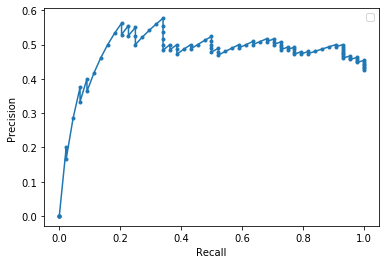

In [107]:
from matplotlib import pyplot
pyplot.plot(recall_list, precision_list, marker='.')
# axis labels
pyplot.xlabel('Recall')
pyplot.ylabel('Precision')
# show the legend
pyplot.legend()
# show the plot
pyplot.show()